In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## Clasificación de datos altamente dimensionales mediante CNN

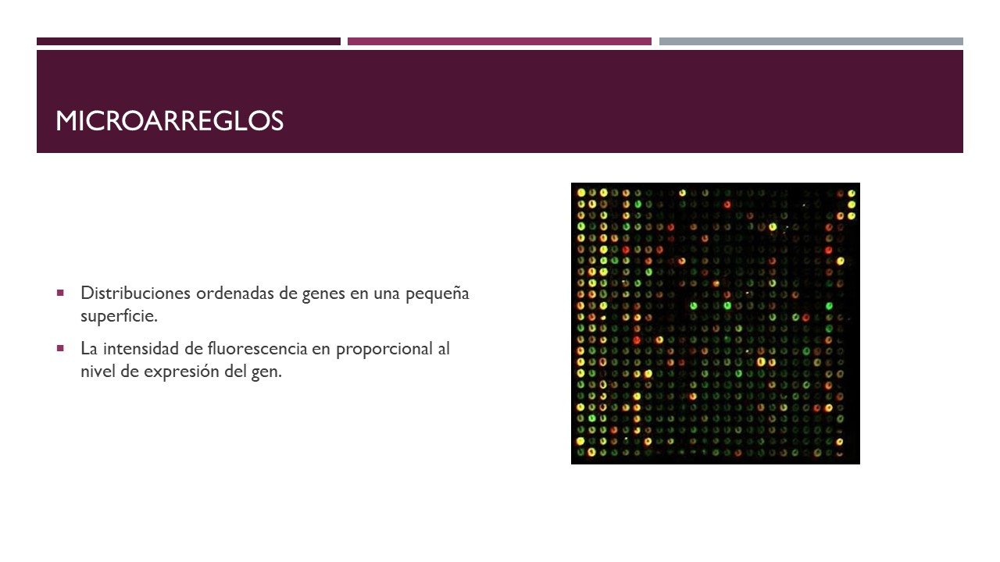

## Importar librerias

In [ ]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.neighbors import KNeighborsClassifier
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier
from sklearn.tree import DecisionTreeClassifier
from sklearn.svm import SVC
from sklearn.naive_bayes import GaussianNB
from sklearn.neural_network import MLPClassifier
from sklearn.metrics import accuracy_score, balanced_accuracy_score
import matplotlib.pyplot as plt
import numpy as np
import matplotlib.pyplot as plt
import random

import tensorflow as tf
from tensorflow import keras
# from tensorflow.keras.models import Sequential
from tensorflow.keras import Sequential
from tensorflow.keras import layers, Input, Model
from tensorflow.keras.layers import Conv2D, MaxPooling2D, Flatten, Dense, AvgPool2D, Dropout, BatchNormalization, Activation
from tensorflow.keras import optimizers, backend
from tensorflow.keras.utils import to_categorical
from tensorflow.keras.callbacks import ModelCheckpoint

from tensorflow.keras.applications.resnet50 import ResNet50
from tensorflow.keras.applications.xception import Xception
from tensorflow.keras.applications.efficientnet_v2 import EfficientNetV2B2
from tensorflow.keras.applications.mobilenet_v2 import MobileNetV2
from tensorflow.keras.applications.resnet50 import preprocess_input as preprocess_resnet
from tensorflow.keras.applications.xception import preprocess_input as preprocess_xception
from tensorflow.keras.applications.efficientnet_v2 import preprocess_input as preprocess_efficientnet
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input as preprocess_mobilenet

from scipy import stats as st
from matplotlib import pyplot as plt
from sklearn.metrics import accuracy_score,confusion_matrix, f1_score, roc_auc_score, balanced_accuracy_score
from imblearn.metrics import sensitivity_score, specificity_score, geometric_mean_score

# folder = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
folder_datasets_transformados = "/content/drive/MyDrive/experimentos de tesis/datasets transformados/"
folder_resultados = "/content/drive/MyDrive/experimentos de tesis/resultados/"
folder_datasets_originales = "/content/drive/MyDrive/experimentos de tesis/datasets originales/"
# folder = "/content/drive/MyDrive/experimentos de tesis/"

## Funciones para guardar/cargar datos

In [ ]:
def guardar_experimentos(forder, namefile, resultados):
  """
      Guarda resultados de experimentos en un archivo .npy
      args:
      folder: ruta donde se quiere almacenar
      namefile: nombre del archivo
      resultados: resultados a guardar
  """
  with open(f"{folder}{namefile}.npy", "wb") as f:
    np.save(f, resultados)

def cargar_resultados(folder, filename):
  """
  carga resultados de experimentos
  folder: path del archivo
  filename: nombre del archivo
  """
  with open(f'{folder}{filename}', 'rb') as f:
      data = np.load(f)
  return data

def cargar_dataset_transformado(path, filename, typee="_chi2"):
  """
  typee: _chi2, _f_classif, _mutual_info, _3nn, _5nn, _nb"""
  with open(f'{path}{filename.split(".")[0]}{typee}.npy', 'rb') as f:
      data = np.load(f)
      labels = np.load(f)
  return data, labels

## Funciones para ordenar atributos mediante Feature Selection y accuracy (por atributo)

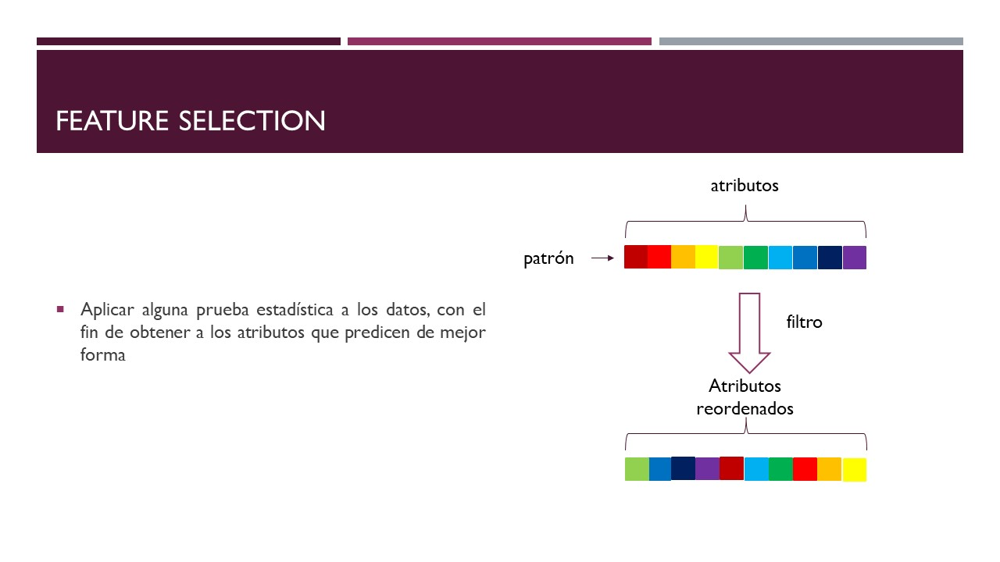

In [ ]:
from sklearn.feature_selection import SelectKBest, chi2, f_classif, mutual_info_classif
from sklearn.preprocessing import KBinsDiscretizer
from sklearn.model_selection import cross_val_score
from sklearn.pipeline import make_pipeline
from sklearn.linear_model import LogisticRegression

def aplicar_filtro(data, labels, fun=0):
  """
  Aplica un filter de feature selection a dataset para ordenar de mejor a mayor
  relevancia de acuerdo a una función evaluadora
  data: dataset
  labels: etiquetas de clase
  fun: tipo de función a aplicar (0-chi2,1-f_classif,2-mutual_info_classif)

  return: datos ordenados"""

  fncs = [chi2, f_classif, mutual_info_classif]
  fnc = fncs[fun]

  # Se aplica filter
  sel = SelectKBest(score_func=fnc)
  data_transform = sel.fit_transform(data, labels)

  # Se reordena el dataset descendentemente
  # del mejor atributo (primera col) al peor atributo (última col)
  new_order = np.argsort(sel.scores_)[::-1]
  ordered_data = data[:,new_order]
  return ordered_data

def b2w(data, labels, fun="3nn"):
  """
  Aplica un clasificador al dataset para ordenar de mejor a mayor
  relevancia de acuerdo a una función evaluadora (balanced accuracy)
  data: dataset
  labels: etiquetas de clase
  fun: clasificador (3nn, 5nn, nb, mlp, rf, dt)

  return: datos ordenados"""

  clfs = {"3nn": KNeighborsClassifier(n_neighbors=3),
          "5nn": KNeighborsClassifier(n_neighbors=5),
          "nb": GaussianNB(),
          "mlp": MLPClassifier(),
          "rf": RandomForestClassifier(),
          "dt": DecisionTreeClassifier()
          }

  # Validación de datos
  X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2)

  # se entrena y prueba cada uno de los atributos, obteniendo su balanced accuracy
  blc_accs = []
  clf = clfs[fun]
  for f in range(data.shape[1]):
    f_data = data[:,f]
    model = clf
    model.fit(X_train, y_train)
    predictions = model.predict(X_test)
    blc_acc = balanced_accuracy_score(y_test, predictions)
    blc_accs.append(blc_acc)

  # se ordenan los atributos deacuerdo a su balanced accuracy obtenido (desc)
  blc_accs = np.array(blc_accs)
  f_blc_accs_ordered = np.argsort(blc_accs)[::-1]

  return data[:,f_blc_accs_ordered]




## Función Zig-Zag
### Transformación de patrones en representaciones bidimensionales

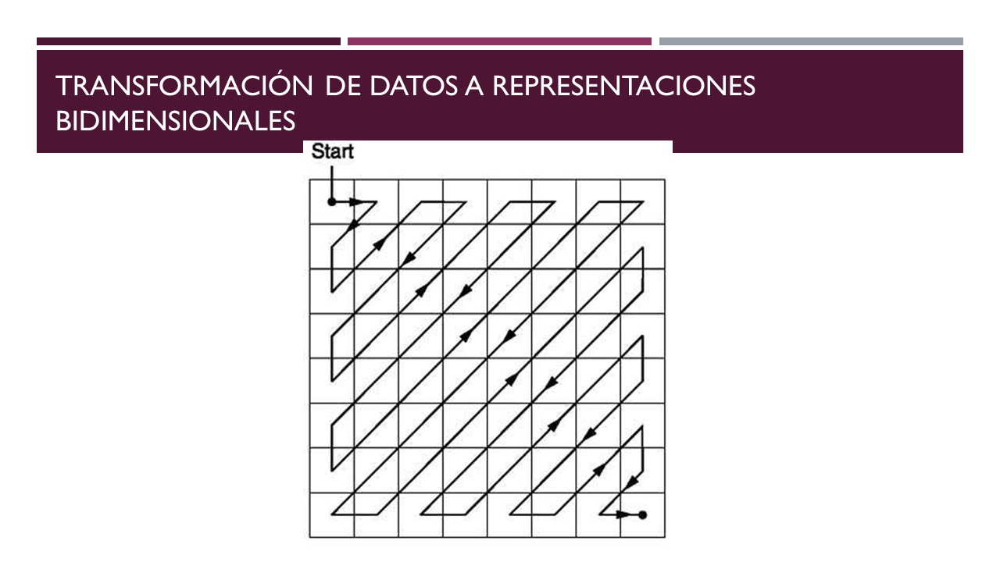

In [ ]:
def zigZag(data):
  """
  Aplica una transformación a arreglos unidimensionales, pasandolos a una representación
  bidimensional ordenando los atributos en forma de zig-zag.
  data: dataset a transformar (n. ejemplos x n. atributos)

  return: dataset transformado (n. ejemplos x altura x ancho)
  """
  data = pd.DataFrame(data)
  n_feat = data.shape[1] # Número de atributos
  sqrt_feat = np.sqrt(n_feat) # Raíz cuadrada de atributos

  # Si la raíz cuadrada del # de atributos es entero
  # Se crea matriz de ceros (temp)x(temp)
  if sqrt_feat - int(sqrt_feat) == 0: #
      temp = sqrt_feat
      template_2d = np.zeros(temp, temp)
  else: # Sino pues una matriz de (temp+1)x(temp+1)
      temp = int(sqrt_feat) + 1
      template_2d = np.zeros((temp,temp))

  ds = [] # array para guardar matrices
  for n in range(data.shape[0]): # para todos los patrones
    pat = data.iloc[n,:].values # patron n

    c = 0 # variable contador de indice del patron n
    pat_2d = template_2d # matriz molde
    d = 0 # variable de filas/columnas
    # for d in range(2*temp): # hasta la esquina
    while d < 2 * temp: # para que se pase por la matriz molde (por dos para pasar hasta la esquina inferior derecha)
      if c == n_feat: # si ya se copiaron todos los valores del patrón 1D ahí le paramos
              break
      if d % 2 == 0: # para arriba (dirección del zigzag)
        if d < temp: # primera mitad de matriz
          for i,j in zip(reversed(range(d+1)), range(d+1)): # filas disminuyen, columnas aumentan
            if c < n_feat: # si aún hay valores de patrón 1D por copiar pues se copia y se incrementa c
              pat_2d[i,j] = pat[c]
              c +=1
            else: # sino pues paramos
              break
        else: # segunda mitad de matriz
          for i,j in zip(reversed(range(d-temp+1, temp)), range(d-temp+1, temp)): # filas disminuyen, columnas aumentan
            if c < n_feat: # lo mismo pero para la segunda mitad de la matríx
              pat_2d[i,j] = pat[c]
              c +=1
            else:
              break
      else: # para abajo (dirección del zigzag)
        # es lo mismo que la parte anterior
        if d < temp: # primera mitad de matriz
          for i,j in zip(range(d+1), reversed(range(d+1))): # filas aumentan, columnas disminuyen
            if c < n_feat:
              pat_2d[i,j] = pat[c]
              c +=1
            else:
              break
        else: # segunda mitad de matriz
          for i,j in zip(range(d-temp+1, temp), reversed(range(d-temp+1, temp))): # filas disminuyen, columnas aumentan
            if c < n_feat:
              pat_2d[i,j] = pat[c]
              c +=1
            else:
              break
      d +=1 # se pasa a la siguiente fila/columna
    # if n < 10:
      # print(pat_2d.tolist())
    ds.append(pat_2d.tolist()) # se agrega la matriz del patrón al ds

  return np.array(ds) # se regresa el ds

def recortar_datos(data, p=0.15):
  """
  Aplica recortes de derecha a izquierda
  y de abajo hacia arriba amatrices (arreglos bidimensionales)
  data: dataset de matrices (n. ejemplos x altura x ancho)

  return: dataset recortado
  """
  out = int(data.shape[1] * (1-p))
  data = data[:,:out,:out]
  return data

## Transformar datasets y mostrarlos

In [ ]:
import time

In [1]:
# Código ejemplo para transformar los datasets

filenames = ['9tumors.csv','11tumors.csv','14tumors.csv','braintumor1.csv','braintumor2.csv',
             'dlbcl.csv','leukemia1.csv','leukemia2.csv','lungcancer.csv','prostate.csv','srbct.csv']
ti = time.time()
for filename in filenames:
  df = pd.read_csv(folder_datasets_originales+filename, header=None)
  n_feat = df.shape[1]-1
  labels = df[n_feat].values
  data = df.drop(n_feat, axis=1)
  scaler = MinMaxScaler()
  data = scaler.fit_transform(data)
  ordered_data_f = aplicar_filtro(data, labels, fun=2)
  # ordered_data_f = b2w(data, labels, "5nn")
  trans_data = zigZag(ordered_data_f)
  with open(f'{folder}{filename.split(".")[0]}_chi2.npy', 'wb') as f:
      np.save(f, trans_data)
      np.save(f, labels)
# print(time.time()-ti)

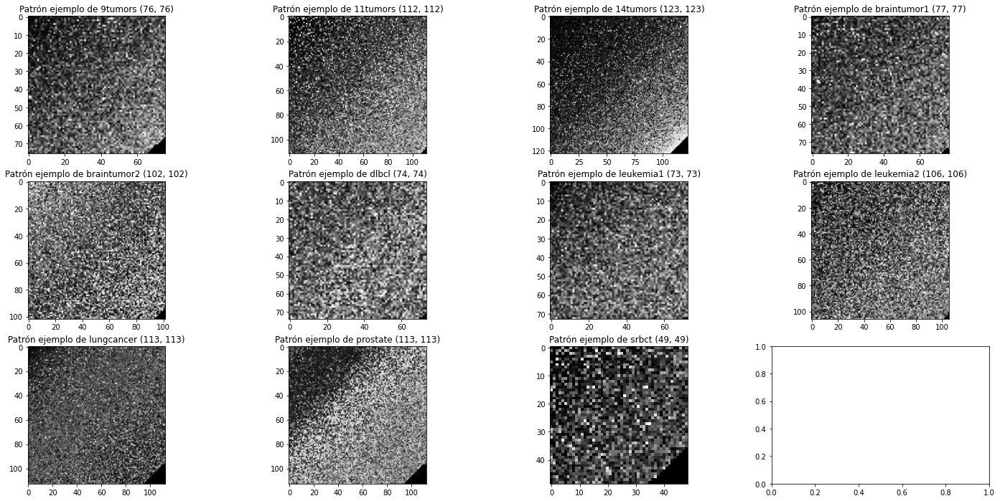

In [ ]:
# Ejemplos de patrones transformados (1D -> 2D)
fig, axs = plt.subplots(3,4, figsize=(25,12))
filenames = ['9tumors.csv', '11tumors.csv', '14tumors.csv', 'braintumor1.csv', 'braintumor2.csv',
             'dlbcl.csv', 'leukemia1.csv', 'leukemia2.csv', 'lungcancer.csv', 'prostate.csv', 'srbct.csv']
r = 0
c = 0
for filename in filenames:
  datos, labels = cargar_dataset_transformado(folder+"/", filename)
  idx = random.randint(0, datos.shape[0]-1)
  axs[r//4,c].imshow(datos[idx],cmap="gray")
  axs[r//4,c].set_title(f"Patrón ejemplo de {filename.split('.')[0]} {datos.shape[1:]}")
  c +=1
  r +=1
  if c > 3:
    c = 0


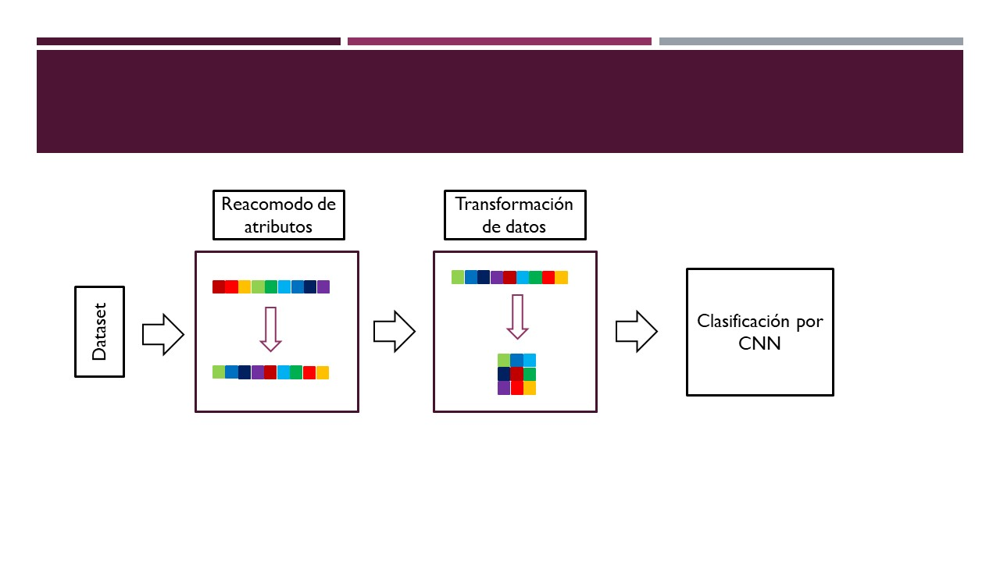

## Clasificación de datasets mediante clasificadores clásicos

In [ ]:
# Para probar la metodología propuesta se utilizarán algoritmos de clasificación clásicos

import time
import csv

def clasificadores_clasicos(folder):
  """
  Realiza clasificación de datasets con un grupo de clasificadores clásicos, los resultados
  se guardan en un archivo .csv
  folder: directorio donde se guardarán los resultados

  return: None
  """

  seeds = [54,12,8,22,79,90,5,2,11,77,46,20,38,44,59,66,72,81,95,101]

  filenames = ['9tumors.csv', '11tumors.csv', '14tumors.csv', 'braintumor1.csv',
              'braintumor2.csv', 'dlbcl.csv', 'leukemia1.csv', 'leukemia2.csv',
              'lungcancer.csv', 'prostate.csv', 'srbct.csv']

  datos = {'Indices':[], '3-NN':[],'5-NN':[],'NaiveBayes':[],'MLP':[],'RandomForest':[],'AdaBoost':[],
                'DecisionTree':[],'SVM-Linear':[]}
  indices = []

  for filename in filenames:
    for seed in seeds:
      ind = f"{filename[:-3]}_seed{seed}"
      datos['Indices'].append(ind)
      df2 = pd.read_csv(folder+filename, header=None)
      n_feat = df2.shape[1]-1
      labels = df2[n_feat]
      data = df2.drop(n_feat, axis=1)
      norm = False

      # Separa entrenamiento y prueba
      X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=seed)

      if norm:
        scaler = MinMaxScaler()
        scaler.fit(X_train)
        X_train = scaler.transform(X_train)
        X_test = scaler.transform(X_test)

      # Entrenar clasificadores
      clf1 = KNeighborsClassifier(n_neighbors=3)
      clf2 = KNeighborsClassifier(n_neighbors=5)
      clf3 = GaussianNB()
      clf4 = MLPClassifier()
      clf5 = RandomForestClassifier()
      clf6 = AdaBoostClassifier()
      clf7 = DecisionTreeClassifier()
      clf8 = SVC(kernel="linear")
      # clf9 = SVC(kernel="rbf")

      clf1.fit(X_train, y_train)
      clf2.fit(X_train, y_train)
      clf3.fit(X_train, y_train)
      clf4.fit(X_train, y_train)
      clf5.fit(X_train, y_train)
      clf6.fit(X_train, y_train)
      clf7.fit(X_train, y_train)
      clf8.fit(X_train, y_train)
      # clf9.fit(X_train, y_train)

      # CLASIFICAR

      acc3nn= balanced_accuracy_score(y_test, clf1.predict(X_test))
      datos["3-NN"].append(acc3nn)
      acc5nn= balanced_accuracy_score(y_test, clf2.predict(X_test))
      datos["5-NN"].append(acc5nn)
      accnb= balanced_accuracy_score(y_test, clf3.predict(X_test))
      datos["NaiveBayes"].append(accnb)
      accmlp= balanced_accuracy_score(y_test, clf4.predict(X_test))
      datos["MLP"].append(accmlp)
      accrf= balanced_accuracy_score(y_test, clf5.predict(X_test))
      datos["RandomForest"].append(accrf)
      accab= balanced_accuracy_score(y_test, clf6.predict(X_test))
      datos["AdaBoost"].append(accab)
      accdt= balanced_accuracy_score(y_test, clf7.predict(X_test))
      datos["DecisionTree"].append(accdt)
      accsvml= balanced_accuracy_score(y_test, clf8.predict(X_test))
      datos["SVM-Linear"].append(accsvml)

  df = pd.DataFrame(datos)
  df["Indices"] = indices
  df.to_csv(f"{folder}resultados/ba_clasificadores_clasicos.csv", index=False)


## Guardado de resultados de clasificadores clásicos

In [ ]:
# clasificadores_clasicos(folder=folder)

In [ ]:
# seeds = [54,12,8,22,79,90,5,2,11,77,46,20,38,44,59,66,72,81,95,101]

# filenames = ['9tumors.csv', '11tumors.csv', '14tumors.csv', 'braintumor1.csv',
#               'braintumor2.csv', 'dlbcl.csv', 'leukemia1.csv', 'leukemia2.csv',
#               'lungcancer.csv', 'prostate.csv', 'srbct.csv']

# indices = []

# for filename in filenames:
#   for seed in seeds:
#     ind = f"{filename[:-4]}_seed{seed}"
#     indices.append(ind)

In [ ]:
# ba_clasificadores_clasicos = pd.read_csv(f"{folder}resultados/ba_clasificadores_clasicos.csv")
# ba_clasificadores_clasicos["Indices"] = indices
# ba_clasificadores_clasicos.to_csv(f"{folder}resultados/ba_clasificadores_clasicos.csv", index=False)

In [ ]:
ba_clasificadores_clasicos = pd.read_csv(f"{folder_resultados}ba_clasificadores_clasicos.csv", index_col="Indices")
ba_clasificadores_clasicos

,3-NN,5-NN,NaiveBayes,MLP,RandomForest,AdaBoost,DecisionTree,SVM-Linear
Indices,,,,,,,,
9tumors_seed54,0.380952,0.380952,0.285714,0.428571,0.142857,0.000000,0.166667,0.428571
9tumors_seed12,0.428571,0.357143,0.428571,0.500000,0.285714,0.214286,0.142857,0.500000
9tumors_seed8,0.222222,0.444444,0.388889,0.277778,0.444444,0.166667,0.277778,0.555556
9tumors_seed22,0.738095,0.523810,0.619048,0.452381,0.666667,0.380952,0.404762,0.690476
9tumors_seed79,0.214286,0.166667,0.285714,0.285714,0.214286,0.142857,0.333333,0.523810
...,...,...,...,...,...,...,...,...
srbct_seed66,0.928571,0.892857,1.000000,1.000000,1.000000,0.628571,0.566071,1.000000
srbct_seed72,1.000000,1.000000,0.972222,1.000000,1.000000,0.875000,0.659722,1.000000
srbct_seed81,0.906250,0.875000,1.000000,1.000000,1.000000,0.822917,0.739583,1.000000


In [ ]:
ba_clasificadores_clasicos.mean().sort_values(ascending=False)

SVM-Linear      0.824524
3-NN            0.760106
RandomForest    0.753182
NaiveBayes      0.739157
5-NN            0.731837
MLP             0.682508
DecisionTree    0.654963
AdaBoost        0.597204
dtype: float64

## Modelo CNN propuesto

In [ ]:
# Para esta metodología se propone pasar los patrones de los datasets de prueba
# a una representación bidimensional para posteriormente se puedan clasificar mediante una
# CNN propuesta.
from sklearn.metrics import balanced_accuracy_score
import tensorflow as tf
from keras.utils import get_custom_objects

folder = "/content/drive/MyDrive/experimentos de tesis/"

# Dado que los datasets cuentan con desbalance en sus clases se utilizará
# balanced accuracy como métrica de desempeño
def balanced_accuracy(y_true, y_pred):
  y_true = tf.argmax(y_true, axis=1)
  y_true = tf.cast(y_true, tf.float32)
  y_pred = tf.argmax(y_pred, axis=1)
  y_pred = tf.cast(y_pred, tf.float32)
  balanced_acc = tf.py_function(balanced_accuracy_score, (y_true, y_pred), tf.float32)
  return balanced_acc

# Registra la función de métrica personalizada
get_custom_objects().update({'balanced_accuracy': balanced_accuracy})


def propuestas_cnn(input_shape, nclass, propuesta=1):
  """
  Inicializa el modelo propuesto.

  input_shape: tamaño patrones de dataset
  nclass: n. de clases en dataset
  propuesta: propuesta a utilizar

  return: modelo CNN
  """

  # Proposed model----------------------------------------------------------------
  backend.clear_session()
  if propuesta == 1:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(32, kernel_size=(5,5), input_shape=input_shape)) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(5,5))) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Flatten()) #Y
    modeloConv.add(layers.Dense(50, activation='relu')) #100
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y
  elif propuesta == 2:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3), input_shape=input_shape))
    modeloConv.add(layers.Activation('relu'))
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3)))
    modeloConv.add(layers.Activation('relu'))
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2))) #X
    modeloConv.add(layers.Flatten())
    modeloConv.add(layers.Dense(30, activation='relu'))
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y
  elif propuesta == 3:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3), input_shape=input_shape))
    modeloConv.add(layers.Activation('relu'))
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3)))
    modeloConv.add(layers.Activation('relu'))
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2))) # conv->conv->pool
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3), input_shape=input_shape))
    modeloConv.add(layers.Activation('relu'))
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3)))
    modeloConv.add(layers.Activation('relu'))
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2))) # conv->conv->pool
    modeloConv.add(layers.Flatten())
    modeloConv.add(layers.Dense(50, activation='relu'))
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y
  elif propuesta == 4:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(32, kernel_size=(5,5), input_shape=input_shape)) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(5,5))) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2))) # conv->conv->conv->conv->conv->pool
    modeloConv.add(layers.Flatten()) #Y
    modeloConv.add(layers.Dense(50, activation='relu')) #100
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y
  elif propuesta == 5:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(64, kernel_size=(3,3), input_shape=input_shape)) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(64, kernel_size=(3,3))) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2)))
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Flatten()) #Y
    modeloConv.add(layers.Dense(50, activation='relu')) #100
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y
  elif propuesta == 6:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(64, kernel_size=(3,3), input_shape=input_shape)) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(64, kernel_size=(3,3))) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2)))
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(32, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.MaxPooling2D(pool_size=(2,2)))
    modeloConv.add(layers.Flatten()) #Y
    modeloConv.add(layers.Dense(50, activation='relu')) #100
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y

  elif propuesta == 7:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(32, kernel_size=(5,5), input_shape=input_shape)) #8,(5,5)
    modeloConv.add(BatchNormalization())
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(5,5))) #8,(5,5)
    modeloConv.add(BatchNormalization())
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(BatchNormalization())
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(BatchNormalization())
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(BatchNormalization())
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Flatten()) #Y
    modeloConv.add(BatchNormalization())
    modeloConv.add(layers.Dense(50, activation='relu')) #100
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y

  elif propuesta == 8:
    modeloConv = Sequential()
    modeloConv.add(layers.Conv2D(32, kernel_size=(5,5), input_shape=input_shape)) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(Dropout(0.2))
    modeloConv.add(layers.Conv2D(16, kernel_size=(5,5))) #8,(5,5)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(Dropout(0.2))
    modeloConv.add(layers.Conv2D(16, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(Dropout(0.2))
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(Dropout(0.2))
    modeloConv.add(layers.Conv2D(8, kernel_size=(3,3))) #16, 8,(3,3)
    modeloConv.add(layers.Activation('relu')) #Y
    modeloConv.add(layers.Flatten()) #Y
    modeloConv.add(Dropout(0.2))
    modeloConv.add(layers.Dense(50, activation='relu')) #100
    modeloConv.add(layers.Dense(nclass, activation='softmax')) #Y

  return modeloConv


def prueba_cnn(data, labels, filename, seed=22, propuesta=1):
  """
  Se clasifica el dataset con el modelo propuesto elegido
  data: dataset a clasificar
  labels: etiquetas del dataset
  filename: nombre con el que se guardará el modelo
  seed: semilla aleatoria para validación de daatos
  propuesta: modelo propuesto con el que se clasificará

  return: mejor resultado obtenido en la fase de prueba"""

  version=2
  # aumentamos una dimensión al dataset
  data = np.expand_dims(data, axis=-1)
  # obtenemos número de clases antes del one hot encoding
  nclass=len(np.unique(labels))
  # one hot encoding de etiquetas de clase
  labels = to_categorical(labels)
  # validación de datos
  X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.2, random_state=seed)
  input_shape = X_train.shape[1:]

  # se elige el modelo con el que se entrenará
  modeloConv = propuestas_cnn(input_shape, nclass, propuesta)

  # configuración de modelo para su guardado
  mdl_name = folder+filename[:-3]+'v'+str(version)+'.h5'

  # se compila el modelo con optimizador Adam, y una loss function caategorical cross entropy
  adam = optimizers.Adam(learning_rate=0.001) #0.001
  modeloConv.compile(loss="categorical_crossentropy", optimizer=adam, metrics=['accuracy', balanced_accuracy])
  checkpointer = ModelCheckpoint(mdl_name, monitor='val_balanced_accuracy', save_best_only=True, mode='max', verbose=0)

  # MEntrenamiento del modelo
  epochs = 25
  batch_size = min(200, X_train.shape[0])

  history = modeloConv.fit(X_train, y_train, validation_data=(X_test, y_test),epochs=epochs,
                    batch_size=batch_size, callbacks=[checkpointer], verbose=True)

  # El mejor desempeño se muestra
  val_acc = np.array(history.history[checkpointer.monitor])
  best_epoch = np.argwhere(val_acc == checkpointer.best)[0][0]
  print('\nBest epoch:', best_epoch)
  print(f'accuracy: {history.history["accuracy"][best_epoch]} | val_balanced_accuracy {checkpointer.best}')

  # Graficas
  m_names = ['accuracy','loss', 'val_accuracy', 'val_loss']
  m_values = {m:history.history[m] for m in m_names}
  n_epochs = range(epochs)
  # plot_metrics(n_epochs, m_values, filename[:-4], best_epoch, folder)
  return checkpointer.best


In [ ]:
mod1 = propuestas_cnn((49,49,1), 4, 1)
mod1.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 45, 45, 32)        832       
                                                                 
 activation (Activation)     (None, 45, 45, 32)        0         
                                                                 
 conv2d_1 (Conv2D)           (None, 41, 41, 16)        12816     
                                                                 
 activation_1 (Activation)   (None, 41, 41, 16)        0         
                                                                 
 conv2d_2 (Conv2D)           (None, 39, 39, 16)        2320      
                                                                 
 activation_2 (Activation)   (None, 39, 39, 16)        0         
                                                                 
 conv2d_3 (Conv2D)           (None, 37, 37, 8)         1

## primeros experimentos (ya no se usan)

In [ ]:
# seeds = [54,12,8,22,79,90,5,2,11,77,46,20,38,44,59,66,72,81,95,101]
# filenames = ['9tumors.csv',
#               '11tumors.csv',
#               '14tumors.csv',
#               'braintumor1.csv',
#               'braintumor2.csv',
#               'dlbcl.csv',
#               'leukemia1.csv',
#               'leukemia2.csv',
#               'lungcancer.csv',
#               'prostate.csv',
#               'srbct.csv']
# nombres_clf = ['3-NN','5-NN','NaiveBayes','MLP','RandomForest','AdaBoost',
#                 'DecisionTree','SVM-Linear']


In [ ]:
# folder = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
# data, labels = cargar_dataset_transformado(folder, filenames[0], typee="_5nn")
# print(data.shape)
# data_crop = recortar_datos(data, p=0)
# print(data_crop.shape)

In [ ]:
# Se obtienen los accuracy de los experimentos realizados con cada una de las seeds en los datos (experimentos con seeds, datasets, clasificadores)
# se comentó porque ya se obtuvieron y guardaron los resultados obtenidos en archivo .npy
# resultados_clasicos = []
# for seed in seeds:
#   accs = clasificadores_clasicos(folder= folder+"Datasets Originales/",filenames=filenames, seed=seed)
#   resultados_clasicos.append(accs)
# resultados_clasicos = np.array(resultados_clasicos)
# resultados_clasicos.shape

# dimensiones de resultados_clasicos: (número de experimentos, datasets (filenames), algoritmos)
# guardar_experimentos(folder, "accuracy_20_experimentos_clasificadores_clasicos", resultados_clasicos)

## Experimentos cnn propuestos

Se realizan 20 experimentos (seeds) con el modelo propuesto y los datasets transformados con las diferentes propuestas

<ul>
  <li>11 Dataset
    <ol>
      <li>9tumors
      <li>11tumors
      <li>14tumors
      <li>leukemia1
      <li>leukemia2
      <li>braintumor1
      <li>braintumor2
      <li>lungcancer
      <li>prostate
      <li>srbct
      <li>dlbcl
    </ol>
  <li>6 filtros (feature selection)
    <ol>
      <li>Chi_2
      <li>Mutual information
      <li>Anova
      <li>3nn
      <li>5nn
      <li>nb
    </ol>
  <li> 2 Recortes de datos
    <ol>
      <li>patrones completos (%100)
      <li>patrones recortados (%90)
      <li>patrones recortados (%80)
      <li>patrones recortados (%70)
    </ol>
  <li> 20 semillas
</ul>



## primera versión de funcion experimentos de cnn propuestos

In [ ]:
# # Se obtienen los accuracy de los experimentos realizados con cada una de las seeds en los datos (experimentos con seeds, datasets, clasificadores)
# # se comentó porque ya se obtuvieron y guardaron los resultados obtenidos en archivo .npy
# def experimentos(name, recorte=0.3, permut="f", propuesta=1):
#   """
#   name: nombre del archivo
#   recorte: porcentaje de recorte ejmp(0, 0.1, 0.2)
#   permut: de que permutaciones se harán los experimentos:
#                 f: filters
#                 c: clasificadores
#                 a: ambos
#   """
#   filenames = ['9tumors.csv', '11tumors.csv', '14tumors.csv', 'braintumor1.csv', 'braintumor2.csv',
#               'dlbcl.csv', 'leukemia1.csv', 'leukemia2.csv', 'lungcancer.csv', 'prostate.csv', 'srbct.csv']
#   seeds = [54,12,8,22,79,90,5,2,11,77,46,20,38,44,59,66,72,81,95,101]
#   if permut == "f":
#     permutaciones = ["_chi2", "_f_classif", "_mutual_info"]
#   elif permut == "c":
#     permutaciones = ["_3nn", "_5nn", "_nb"]
#   else:
#     permutaciones = ["_chi2", "_f_classif", "_mutual_info", "_3nn", "_5nn", "_nb"]
#   contador = 0
#   recortes = [recorte]
#   print(f"permutaciones: {permutaciones}")
#   print(f"recortes: {recortes}")
#   folder_datasets = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
#   resultados_cnn = []
#   configuraciones = []
#   for permutacion in permutaciones:
#     for r in recortes:
#       configuraciones.append(f"{permutacion}/{1-r}")
#       conf = f"{permutacion}/{1-r}"
#       indices = []
#       acc_conf = [] # accuracy por configuración (n.seeds x n.filenames = 220)
#       for seed in seeds:
#         acc_exp = []  # accuracy por experimento (1 x n.filenames), 20 de estos se agregan a acc_conf
#         for filename in filenames:
#           data, labels = cargar_dataset_transformado(folder_datasets, filename, typee=permutacion)
#           data = recortar_datos(data, r)
#           val_acc = prueba_cnn(data, labels, filename, seed, propuesta)
#           acc_exp.append(val_acc)
#           contador +=1
#           print(f"Número de ejecuciones: {contador}")
#         acc_conf.append(acc_exp)
#       resultados_cnn.append(acc_conf)

#   resultados_cnn = np.array(resultados_cnn)
#   resultados_cnn.shape
#   resultados_cnn_t = np.transpose(resultados_cnn, (1,2,0))
#   resultados_cnn_reshape = resultados_cnn_t.reshape(len(seeds)*len(filenames),len(configuraciones))
#   df = pd.DataFrame(data=resultados_cnn_reshape, columns=configuraciones)

#   # resultados_cnn_t.shape
#   folder = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
#   df.to_csv(f"{folder}{name}_prop{propuesta}.csv", index=False)
#   guardar_experimentos(folder, f"{name}_prop{propuesta}", resultados_cnn_reshape)
#   return resultados_cnn_reshape, configuraciones

## Segunda versión de cnn propuestos (mejor estructura de resultados, es la que se utilizó)

In [ ]:
# Se obtienen los accuracy de los experimentos realizados con cada una de las seeds en los datos (experimentos con seeds, datasets, clasificadores)
# se comentó porque ya se obtuvieron y guardaron los resultados obtenidos en archivo .npy
def experimentos(name, recorte=[0.3], permut="f", propuesta=1):
  """
  Función para realizar los experimentos: 11 datasets con seis transformaciones
  diferentes a las cuales se les aplica tres recortes (0.1, 0.2, 0.3), para tener suficientes
  datos para realizar una análisis de los resultados obtenidos se casifica cada una de las configuraciones
  20 veces (20 semillas diferentes en validación de datos).

  name: nombre del archivo
  recorte: porcentaje de recorte ejmp(0, 0.1, 0.2)
  permut: de que permutaciones se harán los experimentos:
                f: filters
                c: clasificadores
                a: ambos
  propuesta: número de propuesta (CNN) a utilizar

  return: (dataframe de resultados, configuraciones que se probaron)
  """
  filenames = ['9tumors.csv', '11tumors.csv', '14tumors.csv', 'braintumor1.csv', 'braintumor2.csv',
              'dlbcl.csv', 'leukemia1.csv', 'leukemia2.csv', 'lungcancer.csv', 'prostate.csv', 'srbct.csv']


  seeds = [54,12,8,22,79,90,5,2,11,77,46,20,38,44,59,66,72,81,95,101]

  # se elige que experimentos se realizarán
  if permut == "f":
    permutaciones = ["_chi2", "_f_classif", "_mutual_info"]
  elif permut == "c":
    permutaciones = ["_3nn", "_5nn", "_nb"]
  else:
    permutaciones = ["_chi2", "_f_classif", "_mutual_info", "_3nn", "_5nn", "_nb"]
  contador = 0
  recortes = [r for r in recorte]
  print(f"permutaciones: {permutaciones}")
  print(f"recortes: {recortes}")

  # Se transformaron previamente los datasets, por lo que sólo se eligen los que se utilizarán
  folder_datasets = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"

  # Se realizan los experimentos
  resultados_cnn = []
  configuraciones = []
  indices = []
  for permutacion in permutaciones:
    for r in recortes:
      configuraciones.append(f"{permutacion}/{1-r}")
      conf = f"{permutacion}/{1-r}"
      acc_conf = [] # accuracy por configuración (n.seeds x n.filenames = 220)
      for filename in filenames:
        acc_exp = []  # accuracy por experimento (1 x n.filenames), 20 de estos se agregan a acc_conf
        for seed in seeds:
          ind = f"{filename}_seed{seed}"
          if ind not in indices:
            indices.append(ind)
          data, labels = cargar_dataset_transformado(f"{folder_datasets_transformados}", filename, typee=permutacion)
          data = recortar_datos(data, r)
          val_bal_acc = prueba_cnn(data, labels, filename, seed, propuesta)
          # acc_exp.append(val_acc)
          acc_conf.append(val_bal_acc)
          contador +=1
          print(f"Número de ejecuciones: {contador}")
        # acc_conf.append(acc_exp)
      resultados_cnn.append(acc_conf)

  # los reslutados se guardan en un Dataframe de pandas
  resultados_cnn = np.array(resultados_cnn).squeeze()
  resultados_cnn_reshape = resultados_cnn.transpose()
  df = pd.DataFrame(data=resultados_cnn_reshape, columns=configuraciones)
  df["Indices"] = indices
  # resultados_cnn_t.shape
  # folder = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
  df.to_csv(f"{folder_resultados}{name}_prop{propuesta}.csv", index=False)
  guardar_experimentos(folder_resultados, f"{name}_prop{propuesta}", resultados_cnn_reshape)

  return resultados_cnn_reshape, configuraciones

## Experimentos de CNNs propuestas

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_filtros_90", recorte=0.1, permut="f", propuesta=1)

In [ ]:
df_f90prop1 = pd.read_csv(f"{folder}resultados/cnn_filtros_90_prop1.csv", index_col="Indices")

In [ ]:
df_f90prop1.mean()

_chi2/0.9           0.813788
_f_classif/0.9      0.800008
_mutual_info/0.9    0.778705
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_clasif_90", recorte=0.1, permut="c", propuesta=1)

In [ ]:
df_c90prop1 = pd.read_csv(f"{folder}resultados/cnn_clasif_90_prop1.csv", index_col="Indices")

In [ ]:
df_c90prop1.mean()

_3nn/0.9    0.789001
_5nn/0.9    0.788803
_nb/0.9     0.791729
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_filtros_80", recorte=0.2, permut="f", propuesta=1)

In [ ]:
df_f80prop1 = pd.read_csv(f"{folder}resultados/cnn_filtros_80_prop1.csv", index_col="Indices")

In [ ]:
df_f80prop1.mean()

_chi2/0.8           0.821987
_f_classif/0.8      0.806875
_mutual_info/0.8    0.812110
dtype: float64

In [ ]:
resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_clasif_80", recorte=[0.2], permut="c", propuesta=1)

permutaciones: ['_3nn', '_5nn', '_nb']
recortes: [0.2]
Epoch 1/25
1/1 [==============================] - ETA: 0s - loss: 2.2168 - accuracy: 0.0833 - balanced_accuracy: 0.1333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 13s 13s/step - loss: 2.2168 - accuracy: 0.0833 - balanced_accuracy: 0.1333 - val_loss: 2.2652 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1350 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.6019 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 38ms/step - loss: 2.1214 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3523 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 111ms/step - loss: 2.0409 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2910 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0157 - accuracy: 0.5417 - balanced_accuracy: 0.4173

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 2.0157 - accuracy: 0.5417 - balanced_accuracy: 0.4173 - val_loss: 2.3603 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 6/25
1/1 [==============================] - 0s 48ms/step - loss: 1.9428 - accuracy: 0.5625 - balanced_accuracy: 0.4259 - val_loss: 2.4651 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 1.8571 - accuracy: 0.4792 - balanced_accuracy: 0.3556 - val_loss: 2.5110 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25
1/1 [==============================] - 0s 45ms/step - loss: 1.7408 - accuracy: 0.5417 - balanced_accuracy: 0.4175 - val_loss: 2.4804 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 41ms/step - loss: 1.6058 - accuracy: 0.6667 - balanced_accuracy: 0.5471 - val_loss: 2.4342 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 1.4055 - accuracy: 0.8542 - balanced_accuracy: 0.7444 - val_loss: 2.4599 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 11/25
1/1 [==============================] - 0s 40ms/step - loss: 1.1932 - accuracy: 0.8542 - balanced_accuracy: 0.7407 - val_loss: 2.5484 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - 0s 120ms/step - loss: 0.9566 - accuracy: 0.9375 - balanced_accuracy: 0.8481 - val_loss: 2.2291 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 0.7159 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.7159 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2013 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.4927 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3515 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 15/25
1/1 [==============================] - 0s 40ms/step - loss: 0.3153 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9822 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.1775 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.1775 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9211 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0905 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1049 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0430 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3079 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0222 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3113 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0117 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0453 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 21/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5190 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 109ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4126 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4762
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 8.5721e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3740 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4762
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 5.3072e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 5.3072e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3700 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5238

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.523809552192688
Número de ejecuciones: 1
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1981 - accuracy: 0.1042 - balanced_accuracy: 0.1270 - val_loss: 2.1996 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1606 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1997 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.0752 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2548 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 112ms/step - loss: 1.9925 - accuracy: 0.1458 - balanced_accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 0.3304 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.4048 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 13/25
1/1 [==============================] - 0s 37ms/step - loss: 0.1544 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2230 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0890 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3801 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - 0s 38ms/step - loss: 0.0311 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9225 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 55ms/step - loss: 0.0201 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1466 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2962 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 20/25
1/1 [==============================] - 0s 109ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1749 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.7143
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 9.4971e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1582 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6429
Epoch 22/25
1/1 [==============================] - 0s 38ms/step - loss: 4.7075e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2385 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6429
Epoch 23/25
1/1 [==============================] - 0s 39ms/step - loss: 2.0144e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3907 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 2.1613 - accuracy: 0.2917 - balanced_accuracy: 0.2481 - val_loss: 2.2167 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1006 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2879 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 123ms/step - loss: 2.0468 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2933 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 1.9595 - accuracy: 0.4167 - balanced_accuracy: 0.3148 - val_loss: 2.2803 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 49ms/step - loss: 1.8800 - accuracy: 0.4167 - balanced_accuracy: 0.3175 - val_loss: 2.2815 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 0.9246 - accuracy: 0.8958 - balanced_accuracy: 0.7989 - val_loss: 1.6829 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 12/25
1/1 [==============================] - 0s 259ms/step - loss: 0.6484 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.4294 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.8095
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.4342 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.3656 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2644 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.3634 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7381
Epoch 15/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1406 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4161 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7381
Epoch 16/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.0106 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8635 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8333
Epoch 19/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0043 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7604 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 20/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7954 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8813 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9822 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 2.1979 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2741 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1057 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2024 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 39ms/step - loss: 2.1203 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1989 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 38ms/step - loss: 2.1059 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2093 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 38ms/step - loss: 2.0662 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2500 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.4311 - accuracy: 0.8333 - balanced_accuracy: 0.7037 - val_loss: 2.4868 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 14/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2411 - accuracy: 0.8750 - balanced_accuracy: 0.7630 - val_loss: 2.3688 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.0260 - accuracy: 0.9375 - balanced_accuracy: 0.8444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.0260 - accuracy: 0.9375 - balanced_accuracy: 0.8444 - val_loss: 2.2909 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 43ms/step - loss: 0.8127 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3014 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 38ms/step - loss: 0.6186 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3687 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 109ms/step - loss: 0.4591 - accuracy: 0.9375 - balanced_accuracy: 0.8444 - val_loss: 2.3139 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.3262 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 0.3262 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.0789 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 20/25
1/1 [==============================] - 0s 40ms/step - loss: 0.2195 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7745 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1418 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.6578 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1905
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.0889 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0889 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6623 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1905
Epoch 23/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0532 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7836 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0285 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0660 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0140 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4238 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286

Best epoch: 18
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 5


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2051 - accuracy: 0.0833 - balanced_accuracy: 0.0889 - val_loss: 2.1823 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1811 - accuracy: 0.1667 - balanced_accuracy: 0.2000 - val_loss: 2.1647 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1462 - accuracy: 0.3333 - balanced_accuracy: 0.3222 - val_loss: 2.1669 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0999 - accuracy: 0.3333 - balanced_accuracy: 0.3111 - val_loss: 2.1649 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0342 - accuracy: 0.6458 - balanced_accuracy: 0.5397 - val_loss: 2.1453 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 1.8593 - accuracy: 0.5000 - balanced_accuracy: 0.4095 - val_loss: 2.0022 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 8/25
1/1 [==============================] - 0s 40ms/step - loss: 1.7316 - accuracy: 0.5417 - balanced_accuracy: 0.4413 - val_loss: 1.9968 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 9/25
1/1 [==============================] - 0s 38ms/step - loss: 1.5734 - accuracy: 0.7292 - balanced_accuracy: 0.6222 - val_loss: 2.0277 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 39ms/step - loss: 1.3969 - accuracy: 0.8333 - balanced_accuracy: 0.7333 - val_loss: 1.9585 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1758 - accuracy: 0.8542 - balanced_accuracy: 0.7556 - val_loss: 1.8083 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 12/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 108ms/step - loss: 0.4333 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4748 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5952
Epoch 15/25
1/1 [==============================] - 0s 40ms/step - loss: 0.2476 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4460 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3095
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.1268 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 0.1268 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4696 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 112ms/step - loss: 0.0584 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2797 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7024
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0206 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1669 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 19/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0079 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2162 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 20/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0040 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3470 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4643
Epoch 21/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 1.5425e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9881 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 40ms/step - loss: 7.1136e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2881 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 4.7324e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6097 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714

Best epoch: 16
accuracy: 1.0 | val_balanced_accuracy 0.7023809552192688
Número de ejecuciones: 6


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1982 - accuracy: 0.1042 - balanced_accuracy: 0.1333 - val_loss: 2.1948 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1879 - accuracy: 0.4583 - balanced_accuracy: 0.3679 - val_loss: 2.1952 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1544 - accuracy: 0.1250 - balanced_accuracy: 0.1393 - val_loss: 2.2107 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.0921 - accuracy: 0.1875 - balanced_accuracy: 0.1852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 2.0921 - accuracy: 0.1875 - balanced_accuracy: 0.1852 - val_loss: 2.2502 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0088 - accuracy: 0.2917 - balanced_accuracy: 0.2381 - val_loss: 2.2666 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 40ms/step - loss: 1.8914 - accuracy: 0.4167 - balanced_accuracy: 0.3333 - val_loss: 2.3412 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 40ms/step - loss: 1.7590 - accuracy: 0.5625 - balanced_accuracy: 0.4222 - val_loss: 2.4558 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 40ms/step - loss: 1.6181 - accuracy: 0.5833 - balanced_accuracy: 0.4444 - val_loss: 2.3443 - val_accuracy: 0.0000e+00 - val_balanc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 1.4285 - accuracy: 0.6875 - balanced_accuracy: 0.5630 - val_loss: 2.3028 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2324 - accuracy: 0.7500 - balanced_accuracy: 0.6315 - val_loss: 2.2839 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 1.0047 - accuracy: 0.9167 - balanced_accuracy: 0.8167 - val_loss: 2.2241 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 0.7732 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 0.7732 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1066 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 111ms/step - loss: 0.5589 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1047 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.3842 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.0234 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2381 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.0022 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.1483 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.1483 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8213 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 17/25
1/1 [==============================] - 0s 112ms/step - loss: 0.0795 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.6625 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4524
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0363 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5947 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4524
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.0157 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0157 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6380 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4524
Epoch 20/25
1/1 [==============================] - 0s 38ms/step - loss: 0.0067 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8449 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4048
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1973 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6050 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 23/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9821 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2786 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 25/25
1/1 [==============================] - 0s 38ms/step - loss: 8.0711e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4818 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286

Best epoch: 16
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.4523809552192688
Número de ejecuciones: 7


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1967 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.1976 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1383 - accuracy: 0.2500 - balanced_accuracy: 0.1968

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 2.1383 - accuracy: 0.2500 - balanced_accuracy: 0.1968 - val_loss: 2.2451 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0896 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2047 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 153ms/step - loss: 2.0390 - accuracy: 0.3750 - balanced_accuracy: 0.2857 - val_loss: 2.2035 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 40ms/step - loss: 1.9680 - accuracy: 0.5833 - balanced_accuracy: 0.4444 - val_loss: 2.2281 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.8870 - accuracy: 0.6042 - balanced_accuracy: 0.4667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 1.8870 - accuracy: 0.6042 - balanced_accuracy: 0.4667 - val_loss: 2.2205 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 54ms/step - loss: 1.7721 - accuracy: 0.6042 - balanced_accuracy: 0.4667 - val_loss: 2.1399 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 112ms/step - loss: 1.6211 - accuracy: 0.6667 - balanced_accuracy: 0.5333 - val_loss: 2.0254 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.4118 - accuracy: 0.7708 - balanced_accuracy: 0.6444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 1.4118 - accuracy: 0.7708 - balanced_accuracy: 0.6444 - val_loss: 1.8714 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 10/25
1/1 [==============================] - 0s 44ms/step - loss: 1.1678 - accuracy: 0.7917 - balanced_accuracy: 0.6815 - val_loss: 1.7702 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 0.9063 - accuracy: 0.8958 - balanced_accuracy: 0.7926 - val_loss: 1.7363 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 0.6839 - accuracy: 0.9375 - balanced_accuracy: 0.8852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.6839 - accuracy: 0.9375 - balanced_accuracy: 0.8852 - val_loss: 1.5509 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 13/25
1/1 [==============================] - 0s 44ms/step - loss: 0.4193 - accuracy: 0.9375 - balanced_accuracy: 0.8519 - val_loss: 1.4995 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 14/25
1/1 [==============================] - 0s 114ms/step - loss: 0.2785 - accuracy: 0.9583 - balanced_accuracy: 0.9074 - val_loss: 1.2270 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.1631 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 0.1631 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1352 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0733 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1551 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048
Epoch 17/25
1/1 [==============================] - 0s 111ms/step - loss: 0.0304 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2835 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0142 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2961 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.0052 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.0052 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3431 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4628 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 21/25
1/1 [==============================] - 0s 123ms/step - loss: 8.6334e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6883 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 5.9473e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 5.9473e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9891 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 23/25
1/1 [==============================] - 0s 40ms/step - loss: 4.4180e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2812 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 2.9617e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5284 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 1.6772e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7530 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238

Best epoch: 20
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 8


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1960 - accuracy: 0.1458 - balanced_accuracy: 0.1444 - val_loss: 2.2546 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1576 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.4326 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 39ms/step - loss: 2.1483 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2068 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 39ms/step - loss: 2.0966 - accuracy: 0.6250 - balanced_accuracy: 0.5556 - val_loss: 2.1746 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0693 - accuracy: 0.7500 - balanced_accuracy: 0.6772 - val_loss: 2.1505 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 1.9937 - accuracy: 0.7083 - balanced_accuracy: 0.6317 - val_loss: 2.1311 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 1.9131 - accuracy: 0.7708 - balanced_accuracy: 0.6667 - val_loss: 2.0965 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 39ms/step - loss: 1.8129 - accuracy: 0.7708 - balanced_accuracy: 0.6667 - val_loss: 2.0424 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 9/25
1/1 [==============================] - 0s 40ms/step - loss: 1.6993 - accuracy: 0.8125 - balanced_accuracy: 0.7111 - val_loss: 1.9061 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 40ms/step - loss: 1.5492 - accuracy: 0.8958 - balanced_accuracy: 0.8056 - val_loss: 1.7635 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 11/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.7023 - accuracy: 0.9375 - balanced_accuracy: 0.8981 - val_loss: 1.5385 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4583
Epoch 15/25
1/1 [==============================] - 0s 114ms/step - loss: 0.4893 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4481 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 16/25
1/1 [==============================] - 0s 45ms/step - loss: 0.3204 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4294 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 17/25
1/1 [==============================] - 0s 38ms/step - loss: 0.2073 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2463 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4167
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.0857 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.0857 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3025 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4167
Epoch 19/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0527 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4579 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0298 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5815 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0156 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4942 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0054 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4186 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1962 - accuracy: 0.2083 - balanced_accuracy: 0.1778 - val_loss: 2.1972 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1866 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.2328 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 39ms/step - loss: 2.0844 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.7056 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.0207 - accuracy: 0.2083 - balanced_accuracy: 0.1270

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 2.0207 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.6926 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 110ms/step - loss: 1.9608 - accuracy: 0.1667 - balanced_accuracy: 0.1235 - val_loss: 2.5238 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 6/25
1/1 [==============================] - 0s 40ms/step - loss: 1.8603 - accuracy: 0.6875 - balanced_accuracy: 0.5111 - val_loss: 2.4429 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 37ms/step - loss: 1.7646 - accuracy: 0.3958 - balanced_accuracy: 0.2825 - val_loss: 2.4862 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.6242 - accuracy: 0.3542 - balanced_accuracy: 0.2444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 1.6242 - accuracy: 0.3542 - balanced_accuracy: 0.2444 - val_loss: 2.4573 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 112ms/step - loss: 1.4405 - accuracy: 0.6042 - balanced_accuracy: 0.4659 - val_loss: 2.4421 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 10/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2533 - accuracy: 0.8542 - balanced_accuracy: 0.7183 - val_loss: 2.5830 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 39ms/step - loss: 1.0596 - accuracy: 0.7292 - balanced_accuracy: 0.5929 - val_loss: 2.2114 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 0.8435 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.8435 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8949 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.6484 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9499 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.4603 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 2.1143 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.3060 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 38ms/step - loss: 0.3060 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2040 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - 0s 39ms/step - loss: 0.2091 - accuracy: 0.9792 - balanced_accuracy: 0.9630 - val_loss: 1.9717 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 38ms/step - loss: 0.1109 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7727 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 37ms/step - loss: 0.0618 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6807 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 38ms/step - loss: 0.0335 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7076 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.0172 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7344 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 21/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0077 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8042 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 22/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0260 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3645 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 37ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6070 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7009 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286

Best epoch: 19
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 10


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1989 - accuracy: 0.0833 - balanced_accuracy: 0.1075 - val_loss: 2.2031 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1716 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.2440 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 38ms/step - loss: 2.1164 - accuracy: 0.1875 - balanced_accuracy: 0.1333 - val_loss: 2.3135 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.0218 - accuracy: 0.1875 - balanced_accuracy: 0.1333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 2.0218 - accuracy: 0.1875 - balanced_accuracy: 0.1333 - val_loss: 2.2925 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 112ms/step - loss: 1.9103 - accuracy: 0.5625 - balanced_accuracy: 0.4513 - val_loss: 2.2464 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.7596 - accuracy: 0.6875 - balanced_accuracy: 0.5556

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 1.7596 - accuracy: 0.6875 - balanced_accuracy: 0.5556 - val_loss: 2.1791 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 1.5683 - accuracy: 0.6875 - balanced_accuracy: 0.5593 - val_loss: 2.1462 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25
1/1 [==============================] - 0s 165ms/step - loss: 1.3334 - accuracy: 0.7917 - balanced_accuracy: 0.6667 - val_loss: 2.0310 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.0673 - accuracy: 0.8750 - balanced_accuracy: 0.7593

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 1.0673 - accuracy: 0.8750 - balanced_accuracy: 0.7593 - val_loss: 2.0236 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 10/25
1/1 [==============================] - 0s 41ms/step - loss: 0.7984 - accuracy: 0.8750 - balanced_accuracy: 0.7556 - val_loss: 1.9007 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 11/25
1/1 [==============================] - 0s 112ms/step - loss: 0.5476 - accuracy: 0.8958 - balanced_accuracy: 0.8148 - val_loss: 1.5486 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.3192 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4135 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 0.1752 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.1752 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5344 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0804 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5910 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - 0s 116ms/step - loss: 0.0365 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2043 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.7381
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.0119 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0119 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0859 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 17/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0067 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2017 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2692 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4146 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 7.9203e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6783 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 21

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 4.3411e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2478 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857

Best epoch: 14
accuracy: 1.0 | val_balanced_accuracy 0.738095223903656
Número de ejecuciones: 11


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2054 - accuracy: 0.0625 - balanced_accuracy: 0.0667 - val_loss: 2.1923 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 2/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1403 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2171 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 113ms/step - loss: 2.0961 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1513 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0572 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.1626 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 1.9930 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.2236 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 1.3303 - accuracy: 0.7708 - balanced_accuracy: 0.6889 - val_loss: 2.0322 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1875
Epoch 12/25
1/1 [==============================] - 0s 118ms/step - loss: 1.1523 - accuracy: 0.7083 - balanced_accuracy: 0.6333 - val_loss: 1.9921 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3125
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.9307 - accuracy: 0.7708 - balanced_accuracy: 0.6926 - val_loss: 1.9139 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.7673 - accuracy: 0.7917 - balanced_accuracy: 0.7111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 111ms/step - loss: 0.7673 - accuracy: 0.7917 - balanced_accuracy: 0.7111 - val_loss: 1.9503 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 15/25
1/1 [==============================] - 0s 41ms/step - loss: 0.5865 - accuracy: 0.9167 - balanced_accuracy: 0.8222 - val_loss: 1.7696 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 39ms/step - loss: 0.4574 - accuracy: 0.9375 - balanced_accuracy: 0.9370 - val_loss: 2.0079 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.3190 - accuracy: 0.9792 - balanced_accuracy: 0.9778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.3190 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.7457 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4167
Epoch 18/25
1/1 [==============================] - 0s 43ms/step - loss: 0.2719 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.7203 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4167
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.1483 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3302 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.1417 - accuracy: 0.9792 - balanced_accuracy: 0.9778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.1417 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.9085 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4167
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0455 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5182 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3125
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0429 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7754 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 23/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0352 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6612 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 24/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0186 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5933 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 0.0119 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6095 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5417

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.5416666865348816
Número de ejecuciones: 12
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1982 - accuracy: 0.0625 - balanced_accuracy: 0.0476 - val_loss: 2.2003 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1620 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 2.1620 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2411 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 3/25
1/1 [==============================] - 0s 112ms/step - loss: 2.1309 - accuracy: 0.2500 - balanced_accuracy: 0.2222 - val_loss: 2.1855 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0861 - accuracy: 0.3542 - balanced_accuracy: 0.2989 - val_loss: 2.1760 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 39ms/step - loss: 2.0400 - accuracy: 0.3542 - balanced_accuracy: 0.2884 - val_loss: 2.1791 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.9754 - accuracy: 0.2083 - balanced_accuracy: 0.1667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 1.9754 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.1426 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 7/25
1/1 [==============================] - 0s 110ms/step - loss: 1.8989 - accuracy: 0.5417 - balanced_accuracy: 0.4519 - val_loss: 2.0363 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.7914 - accuracy: 0.7917 - balanced_accuracy: 0.7056

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.7914 - accuracy: 0.7917 - balanced_accuracy: 0.7056 - val_loss: 1.9315 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5556
Epoch 9/25
1/1 [==============================] - 0s 43ms/step - loss: 1.6747 - accuracy: 0.8542 - balanced_accuracy: 0.7556 - val_loss: 1.9056 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4722
Epoch 10/25
1/1 [==============================] - 0s 40ms/step - loss: 1.5114 - accuracy: 0.8542 - balanced_accuracy: 0.7685 - val_loss: 1.9004 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3611
Epoch 11/25
1/1 [==============================] - 0s 40ms/step - loss: 1.3253 - accuracy: 0.8333 - balanced_accuracy: 0.7463 - val_loss: 1.7845 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3056
Epoch 12/25
1/1 [==============================] - 0s 38ms/step - loss: 1.1242 - accuracy: 0.8542 - balanced_accuracy: 0.7833 - val_loss: 1.7384 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2500
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.9408 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5577 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7500
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.8179 - accuracy: 0.9375 - balanced_accuracy: 0.8667 - val_loss: 1.6736 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.6033 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.8430 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 16/25
1/1 [==============================] - 0s 40ms/step - loss: 0.5159 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.3218 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3611
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.3502 - accuracy: 0.9583 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 0.3502 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.1849 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7778
Epoch 18/25
1/1 [==============================] - 0s 111ms/step - loss: 0.2721 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.1971 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8333
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.1515 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.5362 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722
Epoch 20/25
1/1 [==============================] - 0s 38ms/step - loss: 0.1042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7648 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.0763 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0763 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5110 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0403 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0994 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7222
Epoch 23/25
1/1 [==============================] - 0s 134ms/step - loss: 0.0185 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8639 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.8889
Epoch 24/25
1/1 [==============================] - 0s 47ms/step - loss: 0.0118 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8695 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0113 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8939 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667

Best epoch: 22
accuracy: 1.0 | val_balanced_accuracy 0.8888888955116272
Número de ejecuciones: 13
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1962 - accuracy: 0.1250 - balanced_accuracy: 0.1159 - val_loss: 2.1520 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1382 - accuracy: 0.3542 - balanced_accuracy: 0.3333 - val_loss: 2.1772 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0578 - accuracy: 0.3958 - balanced_accuracy: 0.3333 - val_loss: 2.1720 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 1.9868 - accuracy: 0.5417 - balanced_accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 1.5522 - accuracy: 0.6250 - balanced_accuracy: 0.5352 - val_loss: 2.0156 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 8/25
1/1 [==============================] - 0s 114ms/step - loss: 1.3053 - accuracy: 0.9167 - balanced_accuracy: 0.8519 - val_loss: 1.9916 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 9/25
1/1 [==============================] - 0s 43ms/step - loss: 1.0557 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.8648 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.7993 - accuracy: 0.9792 - balanced_accuracy: 0.9444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 0.7993 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.8614 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5357
Epoch 11/25
1/1 [==============================] - 0s 43ms/step - loss: 0.5209 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7466 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 40ms/step - loss: 0.3352 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3551 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3214
Epoch 13/25
1/1 [==============================] - 0s 40ms/step - loss: 0.2966 - accuracy: 0.9583 - balanced_accuracy: 0.9683 - val_loss: 1.7982 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1780 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1600 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 15/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.4331 - accuracy: 0.8125 - balanced_accuracy: 0.7185 - val_loss: 1.8255 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 114ms/step - loss: 1.2553 - accuracy: 0.8542 - balanced_accuracy: 0.7778 - val_loss: 1.9346 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 12/25
1/1 [==============================] - 0s 40ms/step - loss: 1.0652 - accuracy: 0.8333 - balanced_accuracy: 0.7407 - val_loss: 1.8420 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3889
Epoch 13/25
1/1 [==============================] - 0s 119ms/step - loss: 0.9001 - accuracy: 0.8750 - balanced_accuracy: 0.7704 - val_loss: 1.9102 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.7106 - accuracy: 0.8958 - balanced_accuracy: 0.8074 - val_loss: 1.8137 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 15/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3286 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 9.3472e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5078 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556

Best epoch: 15
accuracy: 1.0 | val_balanced_accuracy 0.6111111044883728
Número de ejecuciones: 15
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1977 - accuracy: 0.1667 - balanced_accuracy: 0.1593 - val_loss: 2.2558 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1504 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2184 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1374 - accuracy: 0.1875 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 2.0956 - accuracy: 0.1875 - balanced_accuracy: 0.1389 - val_loss: 2.2159 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 40ms/step - loss: 2.0164 - accuracy: 0.3333 - balanced_accuracy: 0.2460 - val_loss: 2.1733 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 43ms/step - loss: 1.9559 - accuracy: 0.5000 - balanced_accuracy: 0.4005 - val_loss: 2.1680 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.8447 - accuracy: 0.6042 - balanced_accuracy: 0.5016

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 1.8447 - accuracy: 0.6042 - balanced_accuracy: 0.5016 - val_loss: 2.1506 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 8/25
1/1 [==============================] - 0s 113ms/step - loss: 1.7231 - accuracy: 0.6667 - balanced_accuracy: 0.5608 - val_loss: 2.0018 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 9/25
1/1 [==============================] - 0s 116ms/step - loss: 1.5579 - accuracy: 0.8542 - balanced_accuracy: 0.7500 - val_loss: 1.8692 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 10/25
1/1 [==============================] - 0s 40ms/step - loss: 1.3540 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.8432 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 11/25
1/1 [==============================] - 0s 111ms/step - loss: 1.1368 - accuracy: 0.8958 - balanced_accuracy: 0.8241 - val_loss: 1.7574 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 41ms/step - loss: 0.9165 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7413 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 0.7165 - accuracy: 0.9375 - balanced_accuracy: 0.8611

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.7165 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.6041 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.5052 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5658 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 15/25
1/1 [==============================] - 0s 53ms/step - loss: 0.3387 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5571 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 16/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2174 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4572 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 40ms/step - loss: 0.1102 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4171 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0576 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4161 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0266 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4199 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0102 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4990 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 21/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0047 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6479 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 22/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8097 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3000
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9692 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3667
Epoch 24/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1142 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3667
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 5.9107e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 5.9107e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2322 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.46666666865348816
Número de ejecuciones: 16
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1973 - accuracy: 0.1250 - balanced_accuracy: 0.1095 - val_loss: 2.1787 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1742 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1671 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 113ms/step - loss: 2.1119 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1883 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0373 - accuracy: 0.2917 - balanced_acc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0188 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9122 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 17/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0071 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9768 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 18/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1228 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6905
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2964 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6905
Epoch 20/25
1/1 [==============================] - 0s 40ms/step - loss: 5.7367e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4785 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6905
Epoch 21

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 2.7190e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6549 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 22/25
1/1 [==============================] - 0s 38ms/step - loss: 1.2775e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8286 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 6.1144e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9843 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 3.0324e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1387 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 25/25
1/1 [==============================] - 0s 41ms/step - loss: 1.5587e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2851 - val_accuracy: 0.6667 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 1.3811 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.7549 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 42ms/step - loss: 1.1191 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.5801 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 0.8304 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.4959 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 11/25
1/1 [==============================] - 0s 40ms/step - loss: 0.5477 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7545 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 12/25
1/1 [==============================] - 0s 41ms/step - loss: 0.3146 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5164 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 13/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.1811 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4057 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 14/25
1/1 [==============================] - 0s 38ms/step - loss: 0.0821 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8780 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 15/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0352 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1311 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0109 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3687 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0052 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5161 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 38ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5632 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 19/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5844 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 43ms/step - loss: 4.7884e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6076 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.7458e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 1.7458e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6604 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7083
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 9.7350e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7817 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 23/25
1/1 [==============================] - 0s 40ms/step - loss: 8.2825e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9942 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 24/25
1/1 [==============================] - 0s 40ms/step - loss: 8.7833e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2891 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 1.0194e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6385 - val_accuracy: 0.5000 - val_balanced_accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1975 - accuracy: 0.1042 - balanced_accuracy: 0.0899 - val_loss: 2.2301 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1705 - accuracy: 0.2500 - balanced_accuracy: 0.1667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 2.1705 - accuracy: 0.2500 - balanced_accuracy: 0.1667 - val_loss: 2.3363 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0998 - accuracy: 0.3125 - balanced_accuracy: 0.2346 - val_loss: 2.6013 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0054 - accuracy: 0.4792 - balanced_accuracy: 0.3519 - val_loss: 2.9492 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.9364 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.9280 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 43ms/step - loss: 1.7987 - accuracy: 0.4167 - balanced_accuracy: 0.2963 - val_loss: 2.7507 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 1.4803 - accuracy: 0.8542 - balanced_accuracy: 0.7037 - val_loss: 2.7751 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 9/25
1/1 [==============================] - 0s 41ms/step - loss: 1.2574 - accuracy: 0.8750 - balanced_accuracy: 0.7315 - val_loss: 2.6433 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/1 [==============================] - 0s 113ms/step - loss: 1.0108 - accuracy: 0.9167 - balanced_accuracy: 0.7778 - val_loss: 2.5802 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.7464 - accuracy: 0.9167 - balanced_accuracy: 0.7778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.7464 - accuracy: 0.9167 - balanced_accuracy: 0.7778 - val_loss: 2.5002 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 12/25
1/1 [==============================] - 0s 39ms/step - loss: 0.4917 - accuracy: 0.9167 - balanced_accuracy: 0.7778 - val_loss: 2.2172 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2983 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.5737 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 14/25
1/1 [==============================] - 0s 40ms/step - loss: 0.1507 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2152 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.0764 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 0.0764 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3596 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4333
Epoch 16/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0424 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0333 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0195 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3268 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 18/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0064 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6722 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 19/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7086 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 20/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 6.6774e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7019 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 8.3686e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.9473 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.2428 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.4350 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 25/25
1/1 [==============================] - 0s 41ms/step - loss: 5.0780e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.6164 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 14
accuracy: 1.0 | val_balanced_accuracy 0.4333333373069763
Número de ejecuciones: 19
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1976 - accuracy: 0.1042 - balanced_accuracy: 0.1343 - val_loss: 2.2026 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1826 - accuracy: 0.2708 - balanced_accuracy: 0.1925 - val_loss: 2.2189 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1367 - accuracy: 0.2917 - balanced_accuracy: 0.2063 - val_loss: 2.2824 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.0719 - accuracy: 0.2083 - balanced_accuracy: 0.1429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 2.0719 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.3179 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.9919 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2046 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 109ms/step - loss: 1.8954 - accuracy: 0.3125 - balanced_accuracy: 0.2312 - val_loss: 2.1537 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 117ms/step - loss: 1.7206 - accuracy: 0.5833 - balanced_accuracy: 0.4825 - val_loss: 2.1152 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 8/25
1/1 [==============================] - 0s 41ms/step - loss: 1.5292 - accuracy: 0.7500 - balanced_accuracy: 0.6222 - val_loss: 1.9773 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 39ms/step - loss: 0.3005 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2317 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 14/25
1/1 [==============================] - 0s 39ms/step - loss: 0.1731 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9724 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0985 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9084 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 16/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0357 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1796 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 50ms/step - loss: 0.0212 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1836 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.0064 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7746 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 19/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0099 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2819 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.9028 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.6311 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0087 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9927 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 39ms/step - loss: 3.8871e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9486 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 8.4681e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9594 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286

Best epoch: 10
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 20


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.3994 - accuracy: 0.0791 - balanced_accuracy: 0.1100 - val_loss: 2.3491 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 55ms/step - loss: 2.3513 - accuracy: 0.2518 - balanced_accuracy: 0.1435 - val_loss: 2.2791 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 51ms/step - loss: 2.2914 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2435 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1143
Epoch 4/25
1/1 [==============================] - 0s 53ms/step - loss: 2.2428 - accuracy: 0.1942 - balanced_accuracy: 0.1080 - val_loss: 2.2149 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 52ms/step - loss: 2.1788 - accuracy: 0.1799 - balanced_accuracy: 0.0957 - val_loss: 2.1969 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 53ms/step - loss: 0.6915 - accuracy: 0.8633 - balanced_accuracy: 0.7909 - val_loss: 1.0088 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.4690
Epoch 15/25
1/1 [==============================] - 0s 53ms/step - loss: 0.6826 - accuracy: 0.8058 - balanced_accuracy: 0.7250 - val_loss: 1.1511 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4357
Epoch 16/25
1/1 [==============================] - 0s 197ms/step - loss: 0.5904 - accuracy: 0.7266 - balanced_accuracy: 0.6019 - val_loss: 0.9184 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7857
Epoch 17/25
1/1 [==============================] - 0s 54ms/step - loss: 0.3690 - accuracy: 0.9496 - balanced_accuracy: 0.9208 - val_loss: 0.9210 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6857
Epoch 18/25
1/1 [==============================] - 0s 161ms/step - loss: 0.3795 - accuracy: 0.9353 - balanced_accuracy: 0.9040 - val_loss: 0.6202 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8357
Epoch 19/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 52ms/step - loss: 2.2954 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.2763 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 8/25
1/1 [==============================] - 0s 51ms/step - loss: 2.3147 - accuracy: 0.1655 - balanced_accuracy: 0.0996 - val_loss: 2.2585 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 9/25
1/1 [==============================] - 0s 172ms/step - loss: 2.2603 - accuracy: 0.1583 - balanced_accuracy: 0.0952 - val_loss: 2.2711 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.2667
Epoch 10/25
1/1 [==============================] - 0s 53ms/step - loss: 2.2327 - accuracy: 0.4101 - balanced_accuracy: 0.2504 - val_loss: 2.2939 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1167
Epoch 11/25
1/1 [==============================] - 0s 53ms/step - loss: 2.2172 - accuracy: 0.1727 - balanced_accuracy: 0.1082 - val_loss: 2.3073 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 12/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 0.2326 - accuracy: 0.9568 - balanced_accuracy: 0.9287 - val_loss: 0.5877 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7972
Epoch 22/25
1/1 [==============================] - 0s 162ms/step - loss: 0.1653 - accuracy: 0.9640 - balanced_accuracy: 0.9439 - val_loss: 0.6289 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8639
Epoch 23/25
1/1 [==============================] - 0s 54ms/step - loss: 0.1108 - accuracy: 0.9712 - balanced_accuracy: 0.9590 - val_loss: 0.5372 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8189
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0669 - accuracy: 0.9784 - balanced_accuracy: 0.9742

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 0.0669 - accuracy: 0.9784 - balanced_accuracy: 0.9742 - val_loss: 0.5499 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7939
Epoch 25/25
1/1 [==============================] - 0s 160ms/step - loss: 0.0431 - accuracy: 0.9928 - balanced_accuracy: 0.9848 - val_loss: 0.5099 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8689

Best epoch: 24
accuracy: 0.9928057789802551 | val_balanced_accuracy 0.8688889145851135
Número de ejecuciones: 24
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3950 - accuracy: 0.0432 - balanced_accuracy: 0.0471 - val_loss: 2.3195 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 52ms/step - loss: 2.3431 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.2763 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 156ms/step - loss: 2.2655 - accuracy: 0.1583 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 55ms/step - loss: 0.7455 - accuracy: 0.8705 - balanced_accuracy: 0.7927 - val_loss: 1.2030 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5974
Epoch 15/25
1/1 [==============================] - 0s 51ms/step - loss: 0.6351 - accuracy: 0.8633 - balanced_accuracy: 0.7641 - val_loss: 1.0526 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6288
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.5493 - accuracy: 0.8777 - balanced_accuracy: 0.7814

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 0.5493 - accuracy: 0.8777 - balanced_accuracy: 0.7814 - val_loss: 0.9006 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7674
Epoch 17/25
1/1 [==============================] - 0s 55ms/step - loss: 0.3949 - accuracy: 0.9281 - balanced_accuracy: 0.8493 - val_loss: 0.8846 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7640
Epoch 18/25
1/1 [==============================] - 0s 160ms/step - loss: 0.3348 - accuracy: 0.9496 - balanced_accuracy: 0.8901 - val_loss: 0.7511 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8190
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.2477 - accuracy: 0.9424 - balanced_accuracy: 0.8687

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 157ms/step - loss: 0.2477 - accuracy: 0.9424 - balanced_accuracy: 0.8687 - val_loss: 0.5847 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8407
Epoch 20/25
1/1 [==============================] - 0s 51ms/step - loss: 0.1640 - accuracy: 0.9712 - balanced_accuracy: 0.9091 - val_loss: 0.5004 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8217
Epoch 21/25
1/1 [==============================] - 0s 158ms/step - loss: 0.1169 - accuracy: 0.9784 - balanced_accuracy: 0.9318 - val_loss: 0.2407 - val_accuracy: 0.9714 - val_balanced_accuracy: 0.9750
Epoch 22/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0754 - accuracy: 0.9928 - balanced_accuracy: 0.9870 - val_loss: 0.2093 - val_accuracy: 0.9714 - val_balanced_accuracy: 0.9750
Epoch 23/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0621 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.1901 - val_accuracy: 0.9714 - val_balanced_accuracy: 0.9750
Epoch 24/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 1.5012 - accuracy: 0.6403 - balanced_accuracy: 0.4286 - val_loss: 1.6823 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.3600
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 1.3589 - accuracy: 0.6403 - balanced_accuracy: 0.4286

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 156ms/step - loss: 1.3589 - accuracy: 0.6403 - balanced_accuracy: 0.4286 - val_loss: 1.5881 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3800
Epoch 19/25
1/1 [==============================] - 0s 182ms/step - loss: 1.2466 - accuracy: 0.6906 - balanced_accuracy: 0.4771 - val_loss: 1.5024 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4800
Epoch 20/25
1/1 [==============================] - 0s 51ms/step - loss: 1.1164 - accuracy: 0.6978 - balanced_accuracy: 0.4862 - val_loss: 1.4104 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4800
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.9860 - accuracy: 0.7698 - balanced_accuracy: 0.5712

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 0.9860 - accuracy: 0.7698 - balanced_accuracy: 0.5712 - val_loss: 1.3182 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4933
Epoch 22/25
1/1 [==============================] - 0s 55ms/step - loss: 0.8631 - accuracy: 0.7626 - balanced_accuracy: 0.5716 - val_loss: 1.2019 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4733
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 51ms/step - loss: 0.7403 - accuracy: 0.7698 - balanced_accuracy: 0.5799 - val_loss: 1.0384 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4933
Epoch 24/25
1/1 [==============================] - 0s 154ms/step - loss: 0.6205 - accuracy: 0.8489 - balanced_accuracy: 0.7028 - val_loss: 0.9112 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4983
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.5291 - accuracy: 0.8777 - balanced_accuracy: 0.7519

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 0.5291 - accuracy: 0.8777 - balanced_accuracy: 0.7519 - val_loss: 0.8238 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6467

Best epoch: 24
accuracy: 0.8776978254318237 | val_balanced_accuracy 0.6466666460037231
Número de ejecuciones: 28


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3948 - accuracy: 0.0504 - balanced_accuracy: 0.0707 - val_loss: 3.0242 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 52ms/step - loss: 3.2680 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3534 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 50ms/step - loss: 2.5034 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3094 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 50ms/step - loss: 2.3717 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3287 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 49ms/step - loss: 2.3556 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3516 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 458ms/step - loss: 0.2499 - accuracy: 0.9424 - balanced_accuracy: 0.8523 - val_loss: 0.9917 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.7000
Epoch 16/25
1/1 [==============================] - 0s 162ms/step - loss: 0.2033 - accuracy: 0.9640 - balanced_accuracy: 0.8909 - val_loss: 0.7856 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8000
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.1178 - accuracy: 0.9856 - balanced_accuracy: 0.9545

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 0.1178 - accuracy: 0.9856 - balanced_accuracy: 0.9545 - val_loss: 0.7155 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8250
Epoch 18/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0867 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.6710 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7250
Epoch 19/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0561 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.5344 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7917
Epoch 20/25
1/1 [==============================] - 0s 159ms/step - loss: 0.0283 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4722 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8667
Epoch 21/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0180 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5314 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8667
Epoch 22/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 160ms/step - loss: 0.3606 - accuracy: 0.9353 - balanced_accuracy: 0.8659 - val_loss: 1.1326 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7157
Epoch 16/25
1/1 [==============================] - 0s 54ms/step - loss: 0.2461 - accuracy: 0.9856 - balanced_accuracy: 0.9697 - val_loss: 1.3513 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4610
Epoch 17/25
1/1 [==============================] - 0s 54ms/step - loss: 0.2614 - accuracy: 0.9209 - balanced_accuracy: 0.8904 - val_loss: 1.0237 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7014
Epoch 18/25
1/1 [==============================] - 0s 51ms/step - loss: 0.1184 - accuracy: 0.9856 - balanced_accuracy: 0.9667 - val_loss: 1.3154 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.6481
Epoch 19/25
1/1 [==============================] - 0s 164ms/step - loss: 0.1480 - accuracy: 0.9784 - balanced_accuracy: 0.9870 - val_loss: 1.1090 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7205
Epoch 20/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 2.3005 - accuracy: 0.2950 - balanced_accuracy: 0.1818 - val_loss: 2.2479 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2222
Epoch 4/25
1/1 [==============================] - 0s 55ms/step - loss: 2.2225 - accuracy: 0.2950 - balanced_accuracy: 0.1818 - val_loss: 2.1913 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2222
Epoch 5/25
1/1 [==============================] - 0s 327ms/step - loss: 2.1570 - accuracy: 0.2950 - balanced_accuracy: 0.1818 - val_loss: 2.1207 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.3148
Epoch 6/25
1/1 [==============================] - 0s 166ms/step - loss: 2.0533 - accuracy: 0.4317 - balanced_accuracy: 0.2671 - val_loss: 2.0363 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.3852
Epoch 7/25
1/1 [==============================] - 0s 159ms/step - loss: 1.9392 - accuracy: 0.5827 - balanced_accuracy: 0.3962 - val_loss: 1.9408 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4037
Epoch 8/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.7642 - accuracy: 0.8489 - balanced_accuracy: 0.7059 - val_loss: 1.3257 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5630
Epoch 14/25
1/1 [==============================] - 0s 56ms/step - loss: 0.6875 - accuracy: 0.8561 - balanced_accuracy: 0.7305 - val_loss: 1.3017 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5111
Epoch 15/25
1/1 [==============================] - 0s 56ms/step - loss: 0.7081 - accuracy: 0.7770 - balanced_accuracy: 0.6283 - val_loss: 1.2797 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4704
Epoch 16/25
1/1 [==============================] - 0s 56ms/step - loss: 0.5666 - accuracy: 0.8417 - balanced_accuracy: 0.6926 - val_loss: 1.1428 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5296
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 0.5070 - accuracy: 0.8921 - balanced_accuracy: 0.7734 - val_loss: 0.9102 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6815
Epoch 18/25
1/1 [==============================] - 0s 63ms/step - loss: 0.3781 - accuracy: 0.9065 - balanced_accuracy: 0.7972 - val_loss: 0.8639 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6222
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.3006 - accuracy: 0.9137 - balanced_accuracy: 0.8008

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.3006 - accuracy: 0.9137 - balanced_accuracy: 0.8008 - val_loss: 0.9605 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5852
Epoch 20/25
1/1 [==============================] - 0s 53ms/step - loss: 0.2845 - accuracy: 0.8921 - balanced_accuracy: 0.7752 - val_loss: 0.9322 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6444
Epoch 21/25
1/1 [==============================] - 0s 53ms/step - loss: 0.2067 - accuracy: 0.9424 - balanced_accuracy: 0.8621 - val_loss: 0.9098 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6259
Epoch 22/25
1/1 [==============================] - 0s 51ms/step - loss: 0.1836 - accuracy: 0.9424 - balanced_accuracy: 0.8719 - val_loss: 0.8137 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6444
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.1320 - accuracy: 0.9496 - balanced_accuracy: 0.8773

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 56ms/step - loss: 0.1320 - accuracy: 0.9496 - balanced_accuracy: 0.8773 - val_loss: 0.8069 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5889
Epoch 24/25
1/1 [==============================] - 0s 63ms/step - loss: 0.1222 - accuracy: 0.9568 - balanced_accuracy: 0.9000 - val_loss: 0.7335 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6259
Epoch 25/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0823 - accuracy: 0.9712 - balanced_accuracy: 0.9167 - val_loss: 0.7791 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6259

Best epoch: 16
accuracy: 0.8920863270759583 | val_balanced_accuracy 0.6814814805984497
Número de ejecuciones: 34


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3990 - accuracy: 0.0719 - balanced_accuracy: 0.1048 - val_loss: 2.3723 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 53ms/step - loss: 2.3459 - accuracy: 0.1583 - balanced_accuracy: 0.0949 - val_loss: 2.3660 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.0800
Epoch 3/25
1/1 [==============================] - 0s 364ms/step - loss: 2.2438 - accuracy: 0.2590 - balanced_accuracy: 0.1591 - val_loss: 2.3092 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1467
Epoch 4/25
1/1 [==============================] - 0s 51ms/step - loss: 2.1807 - accuracy: 0.2734 - balanced_accuracy: 0.1670 - val_loss: 2.2066 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1450
Epoch 5/25
1/1 [==============================] - 0s 158ms/step - loss: 2.0632 - accuracy: 0.4245 - balanced_accuracy: 0.2530 - val_loss: 2.1547 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2000
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 365ms/step - loss: 1.3565 - accuracy: 0.6763 - balanced_accuracy: 0.5071 - val_loss: 1.4901 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4033
Epoch 10/25
1/1 [==============================] - 0s 161ms/step - loss: 1.0900 - accuracy: 0.8345 - balanced_accuracy: 0.6927 - val_loss: 1.3250 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6700
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.8197 - accuracy: 0.8993 - balanced_accuracy: 0.7813

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 0.8197 - accuracy: 0.8993 - balanced_accuracy: 0.7813 - val_loss: 1.1826 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6900
Epoch 12/25
1/1 [==============================] - 0s 53ms/step - loss: 0.6277 - accuracy: 0.9353 - balanced_accuracy: 0.8394 - val_loss: 1.1470 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6700
Epoch 13/25
1/1 [==============================] - 0s 164ms/step - loss: 0.4563 - accuracy: 0.9281 - balanced_accuracy: 0.8409 - val_loss: 0.8342 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7100
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.3400 - accuracy: 0.9568 - balanced_accuracy: 0.8909

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 0.3400 - accuracy: 0.9568 - balanced_accuracy: 0.8909 - val_loss: 0.5944 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.8800
Epoch 15/25
1/1 [==============================] - 0s 53ms/step - loss: 0.1933 - accuracy: 0.9712 - balanced_accuracy: 0.9227 - val_loss: 0.5253 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8600
Epoch 16/25
1/1 [==============================] - 0s 53ms/step - loss: 0.1267 - accuracy: 0.9784 - balanced_accuracy: 0.9606 - val_loss: 0.4319 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8300
Epoch 17/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0631 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.3756 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.8800
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.0349 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 0.0349 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3921 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.9050
Epoch 19/25
1/1 [==============================] - 0s 161ms/step - loss: 0.0275 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3942 - val_accuracy: 0.9429 - val_balanced_accuracy: 0.9300
Epoch 20/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0078 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4875 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.8800
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 53ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6418 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8600
Epoch 22/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8272 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8400
Epoch 23/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0038 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8200
Epoch 24/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0991 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8200
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 55ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1387 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8200

Best epoch: 18
accuracy: 1.0 | val_balanced_accuracy 0.9300000071525574
Número de ejecuciones: 35


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3991 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3879 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 53ms/step - loss: 2.3198 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.6998 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 158ms/step - loss: 2.3869 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3051 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2800
Epoch 4/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2066 - accuracy: 0.4460 - balanced_accuracy: 0.2609 - val_loss: 2.2718 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2092 - accuracy: 0.3094 - balanced_accuracy: 0.1854 - val_loss: 2.2303 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2000
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 157ms/step - loss: 0.7606 - accuracy: 0.7986 - balanced_accuracy: 0.6409 - val_loss: 1.1190 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6224
Epoch 13/25
1/1 [==============================] - 0s 160ms/step - loss: 0.5673 - accuracy: 0.8633 - balanced_accuracy: 0.7455 - val_loss: 1.0317 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6614
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.4444 - accuracy: 0.9424 - balanced_accuracy: 0.8959

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 160ms/step - loss: 0.4444 - accuracy: 0.9424 - balanced_accuracy: 0.8959 - val_loss: 0.9119 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6757
Epoch 15/25
1/1 [==============================] - 0s 54ms/step - loss: 0.3333 - accuracy: 0.9640 - balanced_accuracy: 0.9288 - val_loss: 0.8011 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6257
Epoch 16/25
1/1 [==============================] - 0s 159ms/step - loss: 0.2553 - accuracy: 0.9640 - balanced_accuracy: 0.9258 - val_loss: 0.6528 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8040
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.1593 - accuracy: 0.9856 - balanced_accuracy: 0.9667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 0.1593 - accuracy: 0.9856 - balanced_accuracy: 0.9667 - val_loss: 0.5906 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8440
Epoch 18/25
1/1 [==============================] - 0s 53ms/step - loss: 0.1050 - accuracy: 0.9928 - balanced_accuracy: 0.9848 - val_loss: 0.6389 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8440
Epoch 19/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0814 - accuracy: 0.9928 - balanced_accuracy: 0.9848 - val_loss: 0.6066 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8190
Epoch 20/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0419 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6723 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8024
Epoch 21/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0293 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7451 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7024
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5963 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8524
Epoch 25/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5768 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8524


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 1.0 | val_balanced_accuracy 0.8523809313774109
Número de ejecuciones: 39
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3964 - accuracy: 0.0719 - balanced_accuracy: 0.0570 - val_loss: 2.4744 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 158ms/step - loss: 2.2635 - accuracy: 0.1799 - balanced_accuracy: 0.0949 - val_loss: 2.3431 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 54ms/step - loss: 2.2061 - accuracy: 0.4460 - balanced_accuracy: 0.2452 - val_loss: 2.5894 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 163ms/step - loss: 2.1864 - accuracy: 0.2734 - balanced_accuracy: 0.1542 - val_loss: 2.2550 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.2333
Epoch 5/25
1/1 [==============================] - 0s 53ms/step - loss: 2.0359 - accuracy: 0.4173 - balanc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 0.3310 - accuracy: 0.9496 - balanced_accuracy: 0.8939 - val_loss: 0.8601 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6917
Epoch 18/25
1/1 [==============================] - 0s 165ms/step - loss: 0.2329 - accuracy: 0.9640 - balanced_accuracy: 0.9129 - val_loss: 0.8101 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7317
Epoch 19/25
1/1 [==============================] - 0s 56ms/step - loss: 0.1778 - accuracy: 0.9856 - balanced_accuracy: 0.9816 - val_loss: 0.7106 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7317
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.1054 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 53ms/step - loss: 0.1054 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6601 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7167
Epoch 21/25
1/1 [==============================] - 0s 170ms/step - loss: 0.0529 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7377 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7417
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.0357 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7228 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7417
Epoch 23/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0142 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6587 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7167
Epoch 24/25
1/1 [==============================] - 0s 50ms/step - loss: 0.0054 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6431 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7417
Epoch 25/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6612 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7317

Best epoch: 20
accuracy: 1.0 | val_balanced_accuracy 0.7416666746139526
Número de ejecuciones: 40
Epoch 1/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 7s 3s/step - loss: 3.2541 - accuracy: 0.0528 - balanced_accuracy: 0.0408 - val_loss: 3.2308 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 44ms/step - loss: 3.2023 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.1905 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1239 - accuracy: 0.1057 - balanced_accuracy: 0.0438 - val_loss: 3.1311 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 44ms/step - loss: 3.0726 - accuracy: 0.1179 - balanced_accuracy: 0.0668 - val_loss: 3.1954 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 168ms/step - loss: 3.0576 - accuracy: 0.1220 - balanced_accuracy: 0.0694 - val_loss: 3.0658 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1087
Epoch 6/25
2/2 [=

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 193ms/step - loss: 2.0854 - accuracy: 0.4268 - balanced_accuracy: 0.3479 - val_loss: 2.5205 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3370
Epoch 16/25
2/2 [==============================] - 0s 47ms/step - loss: 2.0141 - accuracy: 0.3902 - balanced_accuracy: 0.3046 - val_loss: 2.4001 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2645
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9006 - accuracy: 0.4431 - balanced_accuracy: 0.3794 - val_loss: 2.2544 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2971
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7419 - accuracy: 0.5200 - balanced_accuracy: 0.4596

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.7374 - accuracy: 0.5203 - balanced_accuracy: 0.4322 - val_loss: 2.3768 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4348
Epoch 19/25
2/2 [==============================] - 0s 44ms/step - loss: 1.6243 - accuracy: 0.5488 - balanced_accuracy: 0.4569 - val_loss: 2.2259 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3551
Epoch 20/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5699 - accuracy: 0.5122 - balanced_accuracy: 0.4705 - val_loss: 2.2648 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3116
Epoch 21/25
2/2 [==============================] - 0s 49ms/step - loss: 1.4632 - accuracy: 0.5528 - balanced_accuracy: 0.5178 - val_loss: 2.7500 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3051
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4985 - accuracy: 0.5300 - balanced_accuracy: 0.4550

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 1.4759 - accuracy: 0.5528 - balanced_accuracy: 0.5450 - val_loss: 1.8881 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4928
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 1.2544 - accuracy: 0.6789 - balanced_accuracy: 0.6213 - val_loss: 1.7999 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3826
Epoch 24/25
2/2 [==============================] - 0s 44ms/step - loss: 1.1603 - accuracy: 0.6789 - balanced_accuracy: 0.6071 - val_loss: 2.4501 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4710
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 1.1552 - accuracy: 0.7073 - balanced_accuracy: 0.6562 - val_loss: 2.2373 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4746

Best epoch: 21
accuracy: 0.5528455376625061 | val_balanced_accuracy 0.49275362491607666
Número de ejecuciones: 41


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 397ms/step - loss: 3.2296 - accuracy: 0.0407 - balanced_accuracy: 0.0455 - val_loss: 3.7783 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 48ms/step - loss: 3.4820 - accuracy: 0.0894 - balanced_accuracy: 0.0668 - val_loss: 3.2204 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 222ms/step - loss: 3.1697 - accuracy: 0.0732 - balanced_accuracy: 0.0412 - val_loss: 3.2184 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0909
Epoch 4/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1516 - accuracy: 0.1504 - balanced_accuracy: 0.0583 - val_loss: 3.2231 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0879 - accuracy: 0.1057 - balanced_accuracy: 0.0490 - val_loss: 3.1836 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0758
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 2.3495 - accuracy: 0.3089 - balanced_accuracy: 0.2041 - val_loss: 2.7492 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1485
Epoch 15/25
2/2 [==============================] - 0s 170ms/step - loss: 2.2684 - accuracy: 0.3455 - balanced_accuracy: 0.2992 - val_loss: 2.7478 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1856
Epoch 16/25
2/2 [==============================] - 0s 60ms/step - loss: 2.1801 - accuracy: 0.3699 - balanced_accuracy: 0.2893 - val_loss: 2.8498 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1485
Epoch 17/25
2/2 [==============================] - 0s 45ms/step - loss: 2.1554 - accuracy: 0.3699 - balanced_accuracy: 0.3050 - val_loss: 2.5664 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1727
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 2.1573 - accuracy: 0.3699 - balanced_accuracy: 0.3045 - val_loss: 2.5525 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1515
Epoch 19/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 1.9625 - accuracy: 0.3862 - balanced_accuracy: 0.3252 - val_loss: 2.5093 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2121
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8463 - accuracy: 0.4750 - balanced_accuracy: 0.3646

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 1.8547 - accuracy: 0.4756 - balanced_accuracy: 0.4240 - val_loss: 2.7434 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2197
Epoch 21/25
2/2 [==============================] - 0s 166ms/step - loss: 1.8143 - accuracy: 0.4715 - balanced_accuracy: 0.4270 - val_loss: 2.3945 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2538
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7439 - accuracy: 0.4850 - balanced_accuracy: 0.3754

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.7647 - accuracy: 0.4756 - balanced_accuracy: 0.4099 - val_loss: 2.6865 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2311
Epoch 23/25
2/2 [==============================] - 0s 169ms/step - loss: 1.8648 - accuracy: 0.4472 - balanced_accuracy: 0.3635 - val_loss: 2.2515 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2992
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6158 - accuracy: 0.5250 - balanced_accuracy: 0.4252

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.6230 - accuracy: 0.5081 - balanced_accuracy: 0.4104 - val_loss: 2.7090 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2689
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 1.7122 - accuracy: 0.5244 - balanced_accuracy: 0.4354 - val_loss: 2.8972 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2068

Best epoch: 22
accuracy: 0.4471544623374939 | val_balanced_accuracy 0.29924243688583374
Número de ejecuciones: 42


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 395ms/step - loss: 3.2597 - accuracy: 0.0407 - balanced_accuracy: 0.0461 - val_loss: 3.2078 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1972 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.1794 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 3/25
2/2 [==============================] - 0s 43ms/step - loss: 3.1604 - accuracy: 0.0894 - balanced_accuracy: 0.0410 - val_loss: 3.1342 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 4/25
2/2 [==============================] - 0s 173ms/step - loss: 3.1016 - accuracy: 0.0935 - balanced_accuracy: 0.0495 - val_loss: 3.1068 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1125
Epoch 5/25
2/2 [==============================] - 0s 168ms/step - loss: 3.0766 - accuracy: 0.1504 - balanced_accuracy: 0.0819 - val_loss: 3.0667 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1250
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.9186 - accuracy: 0.1829 - balanced_accuracy: 0.1172 - val_loss: 2.9998 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1583
Epoch 9/25
2/2 [==============================] - 0s 171ms/step - loss: 2.8908 - accuracy: 0.2602 - balanced_accuracy: 0.1714 - val_loss: 2.9143 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2000
Epoch 10/25
2/2 [==============================] - 0s 45ms/step - loss: 2.8011 - accuracy: 0.2886 - balanced_accuracy: 0.1808 - val_loss: 2.8495 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1458
Epoch 11/25
2/2 [==============================] - 0s 43ms/step - loss: 2.7193 - accuracy: 0.2520 - balanced_accuracy: 0.1430 - val_loss: 2.8222 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1625
Epoch 12/25
2/2 [==============================] - 0s 47ms/step - loss: 2.6325 - accuracy: 0.2439 - balanced_accuracy: 0.1287 - val_loss: 2.8164 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1875
Epoch 13/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 43ms/step - loss: 2.4398 - accuracy: 0.2683 - balanced_accuracy: 0.1843 - val_loss: 2.5536 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1917
Epoch 15/25
2/2 [==============================] - 0s 168ms/step - loss: 2.2889 - accuracy: 0.3293 - balanced_accuracy: 0.2663 - val_loss: 2.5425 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2542
Epoch 16/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1828 - accuracy: 0.3862 - balanced_accuracy: 0.2894 - val_loss: 2.6170 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2042
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 2.1527 - accuracy: 0.4309 - balanced_accuracy: 0.3000 - val_loss: 2.5788 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2167
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 2.0470 - accuracy: 0.3862 - balanced_accuracy: 0.3376 - val_loss: 2.7277 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2375
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 45ms/step - loss: 1.9881 - accuracy: 0.4553 - balanced_accuracy: 0.4007 - val_loss: 2.7009 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2417
Epoch 20/25
2/2 [==============================] - 0s 44ms/step - loss: 1.9020 - accuracy: 0.4675 - balanced_accuracy: 0.3671 - val_loss: 2.5575 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2375
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7811 - accuracy: 0.5150 - balanced_accuracy: 0.4193

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.7805 - accuracy: 0.5081 - balanced_accuracy: 0.4149 - val_loss: 2.4775 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2708
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6143 - accuracy: 0.5325 - balanced_accuracy: 0.4701 - val_loss: 2.7255 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2167
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4380 - accuracy: 0.6000 - balanced_accuracy: 0.5015

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 1.4843 - accuracy: 0.5854 - balanced_accuracy: 0.5223 - val_loss: 2.7697 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3083
Epoch 24/25
2/2 [==============================] - 0s 174ms/step - loss: 1.5297 - accuracy: 0.5488 - balanced_accuracy: 0.5288 - val_loss: 2.4286 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3167
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3287 - accuracy: 0.6450 - balanced_accuracy: 0.5255

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 54ms/step - loss: 1.3184 - accuracy: 0.6504 - balanced_accuracy: 0.5946 - val_loss: 2.6123 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2250

Best epoch: 23
accuracy: 0.5487805008888245 | val_balanced_accuracy 0.3166666626930237
Número de ejecuciones: 43


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 399ms/step - loss: 3.3568 - accuracy: 0.0285 - balanced_accuracy: 0.0353 - val_loss: 3.3062 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0818
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.2325 - accuracy: 0.1057 - balanced_accuracy: 0.0610 - val_loss: 3.2852 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.2053 - accuracy: 0.0366 - balanced_accuracy: 0.0455 - val_loss: 3.2309 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1757 - accuracy: 0.0488 - balanced_accuracy: 0.0627 - val_loss: 3.1734 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 175ms/step - loss: 3.1377 - accuracy: 0.1220 - balanced_accuracy: 0.0637 - val_loss: 3.1149 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0909
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.4247 - accuracy: 0.3374 - balanced_accuracy: 0.1960 - val_loss: 2.6093 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2159
Epoch 15/25
2/2 [==============================] - 0s 165ms/step - loss: 2.3047 - accuracy: 0.3455 - balanced_accuracy: 0.2370 - val_loss: 2.4972 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2466
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2924 - accuracy: 0.3600 - balanced_accuracy: 0.2928

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 44ms/step - loss: 2.2518 - accuracy: 0.3618 - balanced_accuracy: 0.3047 - val_loss: 2.5695 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2216
Epoch 17/25
2/2 [==============================] - 0s 44ms/step - loss: 2.1698 - accuracy: 0.4309 - balanced_accuracy: 0.3475 - val_loss: 2.6693 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1648
Epoch 18/25
2/2 [==============================] - 0s 45ms/step - loss: 2.0959 - accuracy: 0.4512 - balanced_accuracy: 0.3397 - val_loss: 2.3856 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2159
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9831 - accuracy: 0.4000 - balanced_accuracy: 0.2967

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.9630 - accuracy: 0.4187 - balanced_accuracy: 0.3142 - val_loss: 2.3779 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2765
Epoch 20/25
2/2 [==============================] - 0s 165ms/step - loss: 1.9095 - accuracy: 0.4756 - balanced_accuracy: 0.4136 - val_loss: 2.3902 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2841
Epoch 21/25
2/2 [==============================] - 0s 45ms/step - loss: 1.7956 - accuracy: 0.4959 - balanced_accuracy: 0.4219 - val_loss: 2.5008 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2765
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6981 - accuracy: 0.5500 - balanced_accuracy: 0.4481

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 1.7018 - accuracy: 0.5366 - balanced_accuracy: 0.4145 - val_loss: 2.2540 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3428
Epoch 23/25
2/2 [==============================] - 0s 44ms/step - loss: 1.5909 - accuracy: 0.5285 - balanced_accuracy: 0.5302 - val_loss: 2.2124 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3144
Epoch 24/25
2/2 [==============================] - 0s 43ms/step - loss: 1.4524 - accuracy: 0.5976 - balanced_accuracy: 0.4780 - val_loss: 2.5421 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2614
Epoch 25/25
2/2 [==============================] - 0s 44ms/step - loss: 1.5162 - accuracy: 0.5488 - balanced_accuracy: 0.4920 - val_loss: 2.4826 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2462

Best epoch: 21
accuracy: 0.5365853905677795 | val_balanced_accuracy 0.342803031206131
Número de ejecuciones: 44


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 381ms/step - loss: 3.2208 - accuracy: 0.0813 - balanced_accuracy: 0.0545 - val_loss: 3.2093 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 165ms/step - loss: 3.1577 - accuracy: 0.0813 - balanced_accuracy: 0.0505 - val_loss: 3.2180 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0783
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1026 - accuracy: 0.1870 - balanced_accuracy: 0.0971 - val_loss: 3.0895 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0696


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 4/25
2/2 [==============================] - 0s 167ms/step - loss: 2.9879 - accuracy: 0.1545 - balanced_accuracy: 0.0802 - val_loss: 2.9979 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0870
Epoch 5/25
2/2 [==============================] - 0s 168ms/step - loss: 2.8713 - accuracy: 0.1789 - balanced_accuracy: 0.0936 - val_loss: 2.9500 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1043
Epoch 6/25
2/2 [==============================] - 0s 162ms/step - loss: 2.7128 - accuracy: 0.2154 - balanced_accuracy: 0.1452 - val_loss: 2.8742 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1783
Epoch 7/25
2/2 [==============================] - 0s 167ms/step - loss: 2.6101 - accuracy: 0.3171 - balanced_accuracy: 0.2377 - val_loss: 2.6584 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2014
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4333 - accuracy: 0.3800 - balanced_accuracy: 0.2469

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 164ms/step - loss: 2.4499 - accuracy: 0.3577 - balanced_accuracy: 0.2227 - val_loss: 2.5585 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2130
Epoch 9/25
2/2 [==============================] - 0s 45ms/step - loss: 2.3177 - accuracy: 0.3740 - balanced_accuracy: 0.2657 - val_loss: 2.5407 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1812
Epoch 10/25
2/2 [==============================] - 0s 45ms/step - loss: 2.1761 - accuracy: 0.4431 - balanced_accuracy: 0.4173 - val_loss: 2.5579 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2101
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1041 - accuracy: 0.4200 - balanced_accuracy: 0.3055

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.0483 - accuracy: 0.4350 - balanced_accuracy: 0.3919 - val_loss: 2.4473 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3159
Epoch 12/25
2/2 [==============================] - 0s 47ms/step - loss: 1.8632 - accuracy: 0.5285 - balanced_accuracy: 0.3956 - val_loss: 2.5472 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2435
Epoch 13/25
2/2 [==============================] - 0s 44ms/step - loss: 1.8473 - accuracy: 0.4715 - balanced_accuracy: 0.4076 - val_loss: 2.3460 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2652
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6751 - accuracy: 0.5750 - balanced_accuracy: 0.4614

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.6997 - accuracy: 0.5610 - balanced_accuracy: 0.4412 - val_loss: 2.2915 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4986
Epoch 15/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5660 - accuracy: 0.6016 - balanced_accuracy: 0.5143 - val_loss: 2.3686 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3986
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 1.4809 - accuracy: 0.6057 - balanced_accuracy: 0.5426 - val_loss: 2.2373 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3326
Epoch 17/25
2/2 [==============================] - 0s 49ms/step - loss: 1.5183 - accuracy: 0.5935 - balanced_accuracy: 0.5020 - val_loss: 2.2253 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3841
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3282 - accuracy: 0.6200 - balanced_accuracy: 0.5656

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 51ms/step - loss: 1.2968 - accuracy: 0.6260 - balanced_accuracy: 0.5844 - val_loss: 2.4846 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3717
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.3053 - accuracy: 0.6585 - balanced_accuracy: 0.5705 - val_loss: 2.1999 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3159
Epoch 20/25
2/2 [==============================] - 0s 46ms/step - loss: 1.1300 - accuracy: 0.6707 - balanced_accuracy: 0.6229 - val_loss: 2.0847 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.3594
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9906 - accuracy: 0.7100 - balanced_accuracy: 0.6322

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 0.9776 - accuracy: 0.7195 - balanced_accuracy: 0.6608 - val_loss: 2.1329 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4696
Epoch 22/25
2/2 [==============================] - 0s 44ms/step - loss: 0.8605 - accuracy: 0.7561 - balanced_accuracy: 0.7491 - val_loss: 2.2721 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4348
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 0.8473 - accuracy: 0.7195 - balanced_accuracy: 0.6227 - val_loss: 2.2063 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3761
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0109 - accuracy: 0.7250 - balanced_accuracy: 0.6876

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 0.9654 - accuracy: 0.7317 - balanced_accuracy: 0.6681 - val_loss: 2.2823 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4290
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 0.7855 - accuracy: 0.7480 - balanced_accuracy: 0.6915 - val_loss: 2.2042 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4283

Best epoch: 13
accuracy: 0.5609756112098694 | val_balanced_accuracy 0.4985507130622864
Número de ejecuciones: 45


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 402ms/step - loss: 3.2531 - accuracy: 0.0569 - balanced_accuracy: 0.0612 - val_loss: 3.3151 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 168ms/step - loss: 3.1379 - accuracy: 0.1057 - balanced_accuracy: 0.0611 - val_loss: 3.2346 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - 0s 47ms/step - loss: 3.0920 - accuracy: 0.1707 - balanced_accuracy: 0.0902 - val_loss: 3.2308 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 4/25
2/2 [==============================] - 0s 171ms/step - loss: 2.9832 - accuracy: 0.1829 - balanced_accuracy: 0.1208 - val_loss: 3.2815 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1181
Epoch 5/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8127 - accuracy: 0.2350 - balanced_accuracy: 0.1202

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 347ms/step - loss: 2.8558 - accuracy: 0.2358 - balanced_accuracy: 0.1474 - val_loss: 3.1740 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1319
Epoch 6/25
2/2 [==============================] - 0s 47ms/step - loss: 2.7469 - accuracy: 0.2805 - balanced_accuracy: 0.1438 - val_loss: 3.1864 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0972
Epoch 7/25
2/2 [==============================] - 0s 171ms/step - loss: 2.6605 - accuracy: 0.2480 - balanced_accuracy: 0.1552 - val_loss: 2.9995 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4957 - accuracy: 0.3800 - balanced_accuracy: 0.2257

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.4996 - accuracy: 0.3780 - balanced_accuracy: 0.2215 - val_loss: 2.9465 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1979
Epoch 9/25
2/2 [==============================] - 0s 47ms/step - loss: 2.3742 - accuracy: 0.3740 - balanced_accuracy: 0.2842 - val_loss: 2.8605 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1910
Epoch 10/25
2/2 [==============================] - 0s 46ms/step - loss: 2.2436 - accuracy: 0.3211 - balanced_accuracy: 0.2231 - val_loss: 2.8114 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1910
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1571 - accuracy: 0.4050 - balanced_accuracy: 0.3060

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.1494 - accuracy: 0.4065 - balanced_accuracy: 0.2919 - val_loss: 2.7824 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1806
Epoch 12/25
2/2 [==============================] - 0s 45ms/step - loss: 1.9977 - accuracy: 0.4065 - balanced_accuracy: 0.3175 - val_loss: 3.0080 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2431
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1268 - accuracy: 0.4300 - balanced_accuracy: 0.2950

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.0964 - accuracy: 0.4350 - balanced_accuracy: 0.3493 - val_loss: 2.6776 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3160
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 1.8675 - accuracy: 0.5163 - balanced_accuracy: 0.3922 - val_loss: 2.7199 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2396
Epoch 15/25
2/2 [==============================] - 0s 46ms/step - loss: 1.7893 - accuracy: 0.4756 - balanced_accuracy: 0.3974 - val_loss: 2.3837 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2819
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6574 - accuracy: 0.5200 - balanced_accuracy: 0.4215

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.6932 - accuracy: 0.5325 - balanced_accuracy: 0.4720 - val_loss: 2.6363 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3177
Epoch 17/25
2/2 [==============================] - 0s 168ms/step - loss: 1.6129 - accuracy: 0.5203 - balanced_accuracy: 0.4508 - val_loss: 2.5165 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.4010
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5420 - accuracy: 0.5800 - balanced_accuracy: 0.4947

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.5502 - accuracy: 0.5691 - balanced_accuracy: 0.4590 - val_loss: 2.6740 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3524
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5135 - accuracy: 0.5488 - balanced_accuracy: 0.5096 - val_loss: 2.6374 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3646
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4869 - accuracy: 0.5650 - balanced_accuracy: 0.4906

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.4597 - accuracy: 0.5772 - balanced_accuracy: 0.5243 - val_loss: 2.3809 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.4306
Epoch 21/25
2/2 [==============================] - 0s 50ms/step - loss: 1.2436 - accuracy: 0.6463 - balanced_accuracy: 0.5789 - val_loss: 2.3454 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3795
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1929 - accuracy: 0.6150 - balanced_accuracy: 0.5629

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 165ms/step - loss: 1.2072 - accuracy: 0.6138 - balanced_accuracy: 0.5715 - val_loss: 2.3142 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4819
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 1.0730 - accuracy: 0.7439 - balanced_accuracy: 0.6422 - val_loss: 2.3904 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4396
Epoch 24/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0436 - accuracy: 0.7480 - balanced_accuracy: 0.6722 - val_loss: 2.3273 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.4285
Epoch 25/25
2/2 [==============================] - 0s 49ms/step - loss: 0.9825 - accuracy: 0.7276 - balanced_accuracy: 0.7097 - val_loss: 2.1497 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.4038


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.6138211488723755 | val_balanced_accuracy 0.4819444417953491
Número de ejecuciones: 46
Epoch 1/25
2/2 [==============================] - 3s 394ms/step - loss: 3.2461 - accuracy: 0.0122 - balanced_accuracy: 0.0227 - val_loss: 3.4958 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0833
Epoch 2/25
2/2 [==============================] - 0s 167ms/step - loss: 3.1667 - accuracy: 0.1341 - balanced_accuracy: 0.0698 - val_loss: 3.2246 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1250
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1037 - accuracy: 0.2154 - balanced_accuracy: 0.1062 - val_loss: 3.2694 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0278 - accuracy: 0.1382 - balanced_accuracy: 0.0575 - val_loss: 3.2059 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1083
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9215 - accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 2.7183 - accuracy: 0.2642 - balanced_accuracy: 0.1609 - val_loss: 2.9995 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1667
Epoch 8/25
2/2 [==============================] - 0s 46ms/step - loss: 2.5886 - accuracy: 0.3171 - balanced_accuracy: 0.1947 - val_loss: 2.9306 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1607
Epoch 9/25
2/2 [==============================] - 0s 45ms/step - loss: 2.4936 - accuracy: 0.3049 - balanced_accuracy: 0.1826 - val_loss: 3.0363 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1464
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4637 - accuracy: 0.3150 - balanced_accuracy: 0.1809

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 2.4341 - accuracy: 0.3293 - balanced_accuracy: 0.2117 - val_loss: 2.7671 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1756
Epoch 11/25
2/2 [==============================] - 0s 46ms/step - loss: 2.2802 - accuracy: 0.3902 - balanced_accuracy: 0.1948 - val_loss: 2.7749 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1756
Epoch 12/25
2/2 [==============================] - 0s 44ms/step - loss: 2.2273 - accuracy: 0.3740 - balanced_accuracy: 0.2629 - val_loss: 2.6359 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1667
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1529 - accuracy: 0.4050 - balanced_accuracy: 0.2949

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.1148 - accuracy: 0.4187 - balanced_accuracy: 0.3360 - val_loss: 2.5135 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1944
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9727 - accuracy: 0.5407 - balanced_accuracy: 0.4300 - val_loss: 2.7481 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1468
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9485 - accuracy: 0.4800 - balanced_accuracy: 0.3002

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 165ms/step - loss: 1.9748 - accuracy: 0.4593 - balanced_accuracy: 0.3080 - val_loss: 2.6467 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2927
Epoch 16/25
2/2 [==============================] - 0s 51ms/step - loss: 1.9267 - accuracy: 0.5285 - balanced_accuracy: 0.4897 - val_loss: 2.5485 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2118
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8420 - accuracy: 0.5122 - balanced_accuracy: 0.4707 - val_loss: 2.4406 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2693
Epoch 18/25
2/2 [==============================] - 0s 47ms/step - loss: 1.7481 - accuracy: 0.5163 - balanced_accuracy: 0.4032 - val_loss: 2.5680 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1826
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7275 - accuracy: 0.5350 - balanced_accuracy: 0.4133

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.6602 - accuracy: 0.5488 - balanced_accuracy: 0.4691 - val_loss: 2.3048 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2854
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6719 - accuracy: 0.5250 - balanced_accuracy: 0.4511

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 1.6076 - accuracy: 0.5610 - balanced_accuracy: 0.5676 - val_loss: 2.1943 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3194
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4889 - accuracy: 0.5610 - balanced_accuracy: 0.5133 - val_loss: 2.1991 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2347
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3695 - accuracy: 0.5750 - balanced_accuracy: 0.4719

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.3435 - accuracy: 0.5894 - balanced_accuracy: 0.4975 - val_loss: 2.1468 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3264
Epoch 23/25
2/2 [==============================] - 0s 171ms/step - loss: 1.3185 - accuracy: 0.6423 - balanced_accuracy: 0.5471 - val_loss: 2.2026 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3319
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1315 - accuracy: 0.6800 - balanced_accuracy: 0.5501

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.2238 - accuracy: 0.6585 - balanced_accuracy: 0.5334 - val_loss: 2.1753 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2649
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2951 - accuracy: 0.5850 - balanced_accuracy: 0.5204

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 1.2158 - accuracy: 0.6138 - balanced_accuracy: 0.5563 - val_loss: 2.0889 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3944

Best epoch: 24
accuracy: 0.6138211488723755 | val_balanced_accuracy 0.39444443583488464
Número de ejecuciones: 47
Epoch 1/25
2/2 [==============================] - 3s 390ms/step - loss: 3.2599 - accuracy: 0.0285 - balanced_accuracy: 0.0358 - val_loss: 3.2372 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.2192 - accuracy: 0.0732 - balanced_accuracy: 0.0571 - val_loss: 3.2099 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0507
Epoch 3/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1378 - accuracy: 0.0610 - balanced_accuracy: 0.0619 - val_loss: 3.2239 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0695 - accuracy: 0.1098 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 166ms/step - loss: 2.2953 - accuracy: 0.4512 - balanced_accuracy: 0.3423 - val_loss: 2.5225 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2500
Epoch 11/25
2/2 [==============================] - 0s 163ms/step - loss: 2.0945 - accuracy: 0.5000 - balanced_accuracy: 0.4133 - val_loss: 2.4955 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3659
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9734 - accuracy: 0.5300 - balanced_accuracy: 0.4456

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.9664 - accuracy: 0.5325 - balanced_accuracy: 0.4684 - val_loss: 2.4416 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3152
Epoch 13/25
2/2 [==============================] - 0s 44ms/step - loss: 1.7651 - accuracy: 0.5610 - balanced_accuracy: 0.4440 - val_loss: 2.2636 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2391
Epoch 14/25
2/2 [==============================] - 0s 44ms/step - loss: 1.7213 - accuracy: 0.4959 - balanced_accuracy: 0.4051 - val_loss: 2.1509 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3551
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4361 - accuracy: 0.6350 - balanced_accuracy: 0.5334

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 1.4967 - accuracy: 0.6098 - balanced_accuracy: 0.5167 - val_loss: 2.1266 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4058
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3578 - accuracy: 0.6450 - balanced_accuracy: 0.5831

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.3868 - accuracy: 0.6341 - balanced_accuracy: 0.5549 - val_loss: 1.9242 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4420
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1494 - accuracy: 0.7150 - balanced_accuracy: 0.6508

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.1841 - accuracy: 0.6992 - balanced_accuracy: 0.6258 - val_loss: 2.0912 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4348
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0870 - accuracy: 0.7400 - balanced_accuracy: 0.6748

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 166ms/step - loss: 1.0705 - accuracy: 0.7317 - balanced_accuracy: 0.6603 - val_loss: 1.9311 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4638
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 0.8975 - accuracy: 0.7724 - balanced_accuracy: 0.6994 - val_loss: 1.9065 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4493
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8540 - accuracy: 0.7550 - balanced_accuracy: 0.7118

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 0.9140 - accuracy: 0.7317 - balanced_accuracy: 0.7059 - val_loss: 1.8855 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4736
Epoch 21/25
2/2 [==============================] - 0s 48ms/step - loss: 0.8801 - accuracy: 0.7683 - balanced_accuracy: 0.6887 - val_loss: 2.2534 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3877
Epoch 22/25
2/2 [==============================] - 0s 45ms/step - loss: 0.9022 - accuracy: 0.7480 - balanced_accuracy: 0.7300 - val_loss: 2.0174 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4653
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 0.9179 - accuracy: 0.7073 - balanced_accuracy: 0.6785 - val_loss: 1.8439 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4120
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 0.7889 - accuracy: 0.7561 - balanced_accuracy: 0.7486 - val_loss: 1.6918 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.4984
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 0.6345 - accuracy: 0.8333 - balanced_accuracy: 0.7624 - val_loss: 2.0400 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4508

Best epoch: 23
accuracy: 0.7560975551605225 | val_balanced_accuracy 0.4984472095966339
Número de ejecuciones: 48


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 386ms/step - loss: 3.2492 - accuracy: 0.0447 - balanced_accuracy: 0.0321 - val_loss: 3.2773 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 164ms/step - loss: 3.2132 - accuracy: 0.0976 - balanced_accuracy: 0.0410 - val_loss: 3.1966 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 3/25
2/2 [==============================] - 0s 43ms/step - loss: 3.1640 - accuracy: 0.1138 - balanced_accuracy: 0.0574 - val_loss: 3.2030 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0899 - accuracy: 0.1057 - balanced_accuracy: 0.0631 - val_loss: 3.1057 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 5/25
2/2 [==============================] - 0s 171ms/step - loss: 2.9927 - accuracy: 0.1179 - balanced_accuracy: 0.0679 - val_loss: 2.9980 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1087
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.8871 - accuracy: 0.1789 - balanced_accuracy: 0.0870 - val_loss: 2.8969 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1000
Epoch 7/25
2/2 [==============================] - 0s 165ms/step - loss: 2.7861 - accuracy: 0.2276 - balanced_accuracy: 0.1417 - val_loss: 2.8520 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1522
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6679 - accuracy: 0.2700 - balanced_accuracy: 0.1639

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.6596 - accuracy: 0.2561 - balanced_accuracy: 0.1388 - val_loss: 2.8634 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1543
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5364 - accuracy: 0.2600 - balanced_accuracy: 0.1537

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 62ms/step - loss: 2.5579 - accuracy: 0.2642 - balanced_accuracy: 0.2044 - val_loss: 2.7194 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1217
Epoch 10/25
2/2 [==============================] - 0s 170ms/step - loss: 2.4756 - accuracy: 0.2724 - balanced_accuracy: 0.1667 - val_loss: 2.7961 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2196
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3222 - accuracy: 0.3250 - balanced_accuracy: 0.2236

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.3582 - accuracy: 0.3089 - balanced_accuracy: 0.2076 - val_loss: 2.8505 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2174
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3133 - accuracy: 0.3400 - balanced_accuracy: 0.2566

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.2684 - accuracy: 0.3537 - balanced_accuracy: 0.2700 - val_loss: 2.5921 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2522
Epoch 13/25
2/2 [==============================] - 0s 172ms/step - loss: 2.1375 - accuracy: 0.3659 - balanced_accuracy: 0.2744 - val_loss: 2.6945 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2558
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9929 - accuracy: 0.4650 - balanced_accuracy: 0.3475

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 2.0338 - accuracy: 0.4228 - balanced_accuracy: 0.2988 - val_loss: 2.7163 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2739
Epoch 15/25
2/2 [==============================] - 0s 45ms/step - loss: 1.9436 - accuracy: 0.4472 - balanced_accuracy: 0.3389 - val_loss: 2.5587 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2558
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 1.8872 - accuracy: 0.4390 - balanced_accuracy: 0.3868 - val_loss: 2.4563 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2413
Epoch 17/25
2/2 [==============================] - 0s 45ms/step - loss: 1.8360 - accuracy: 0.4715 - balanced_accuracy: 0.4165 - val_loss: 2.5560 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2558
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

1/2 [==============>...............] - ETA: 0s - loss: 1.6773 - accuracy: 0.5450 - balanced_accuracy: 0.4869

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 1s/step - loss: 1.6746 - accuracy: 0.5488 - balanced_accuracy: 0.5331 - val_loss: 2.5645 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2848
Epoch 19/25
2/2 [==============================] - 0s 45ms/step - loss: 1.6901 - accuracy: 0.5081 - balanced_accuracy: 0.3708 - val_loss: 2.8594 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2391
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6827 - accuracy: 0.5300 - balanced_accuracy: 0.4879

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.6817 - accuracy: 0.5366 - balanced_accuracy: 0.4793 - val_loss: 2.2659 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3971
Epoch 21/25
2/2 [==============================] - 0s 45ms/step - loss: 1.5999 - accuracy: 0.5610 - balanced_accuracy: 0.4638 - val_loss: 2.1653 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2362
Epoch 22/25
2/2 [==============================] - 0s 44ms/step - loss: 1.5157 - accuracy: 0.5407 - balanced_accuracy: 0.4947 - val_loss: 2.5023 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3587
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 1.4739 - accuracy: 0.5366 - balanced_accuracy: 0.5233 - val_loss: 2.1542 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3551
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 44ms/step - loss: 1.3104 - accuracy: 0.6382 - balanced_accuracy: 0.5484 - val_loss: 2.2720 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3391
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 1.3006 - accuracy: 0.6016 - balanced_accuracy: 0.5680 - val_loss: 2.1500 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3862

Best epoch: 19
accuracy: 0.5365853905677795 | val_balanced_accuracy 0.3971014618873596
Número de ejecuciones: 49


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 374ms/step - loss: 3.2619 - accuracy: 0.0569 - balanced_accuracy: 0.0443 - val_loss: 3.2207 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 164ms/step - loss: 3.1719 - accuracy: 0.0935 - balanced_accuracy: 0.0567 - val_loss: 3.2569 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0536
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1672 - accuracy: 0.1341 - balanced_accuracy: 0.0731 - val_loss: 3.1714 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1314 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1562 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1141 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.1471 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 13/25
2/2 [==============================] - 0s 46ms/step - loss: 2.8021 - accuracy: 0.1951 - balanced_accuracy: 0.1058 - val_loss: 2.9154 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0971
Epoch 14/25
2/2 [==============================] - 0s 44ms/step - loss: 2.7416 - accuracy: 0.2398 - balanced_accuracy: 0.1327 - val_loss: 2.8945 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0971
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.7037 - accuracy: 0.2500 - balanced_accuracy: 0.1386

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 2.6863 - accuracy: 0.2480 - balanced_accuracy: 0.1318 - val_loss: 2.8774 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1058
Epoch 16/25
2/2 [==============================] - 0s 167ms/step - loss: 2.6195 - accuracy: 0.2724 - balanced_accuracy: 0.2153 - val_loss: 2.7868 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1493
Epoch 17/25
2/2 [==============================] - 0s 45ms/step - loss: 2.5353 - accuracy: 0.3455 - balanced_accuracy: 0.2412 - val_loss: 2.7551 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1116
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 2.4760 - accuracy: 0.2561 - balanced_accuracy: 0.1663 - val_loss: 2.6989 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1116
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4107 - accuracy: 0.3200 - balanced_accuracy: 0.2171

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 2.4240 - accuracy: 0.3293 - balanced_accuracy: 0.2282 - val_loss: 2.6861 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1529
Epoch 20/25
2/2 [==============================] - 0s 171ms/step - loss: 2.3472 - accuracy: 0.3537 - balanced_accuracy: 0.2440 - val_loss: 2.7517 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1797
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3150 - accuracy: 0.3250 - balanced_accuracy: 0.2176

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.2656 - accuracy: 0.3455 - balanced_accuracy: 0.2513 - val_loss: 2.7515 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1435
Epoch 22/25
2/2 [==============================] - 0s 45ms/step - loss: 2.1702 - accuracy: 0.3943 - balanced_accuracy: 0.3021 - val_loss: 2.7340 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1565
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0961 - accuracy: 0.4400 - balanced_accuracy: 0.2854

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.1301 - accuracy: 0.4350 - balanced_accuracy: 0.2796 - val_loss: 2.6552 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1928
Epoch 24/25
2/2 [==============================] - 1s 633ms/step - loss: 2.0088 - accuracy: 0.4634 - balanced_accuracy: 0.3474 - val_loss: 2.5552 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2087
Epoch 25/25
2/2 [==============================] - 0s 177ms/step - loss: 1.9367 - accuracy: 0.4512 - balanced_accuracy: 0.3793 - val_loss: 2.4632 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2145

Best epoch: 24
accuracy: 0.45121949911117554 | val_balanced_accuracy 0.21449275314807892
Número de ejecuciones: 50
Epoch 1/25
1/2 [==============>...............] - ETA: 2s - loss: 3.2583 - accuracy: 0.0500 - balanced_accuracy: 0.0474

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 393ms/step - loss: 3.2504 - accuracy: 0.0447 - balanced_accuracy: 0.0275 - val_loss: 3.3194 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 43ms/step - loss: 3.1843 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2180 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1648 - accuracy: 0.1179 - balanced_accuracy: 0.0541 - val_loss: 3.1954 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1147 - accuracy: 0.1138 - balanced_accuracy: 0.0483 - val_loss: 3.1769 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
1/2 [==============>...............] - ETA: 0s - loss: 3.0434 - accuracy: 0.1050 - balanced_accuracy: 0.0414

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 3.0292 - accuracy: 0.1098 - balanced_accuracy: 0.0485 - val_loss: 3.1749 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0606
Epoch 6/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9556 - accuracy: 0.1260 - balanced_accuracy: 0.0497 - val_loss: 3.1324 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 175ms/step - loss: 2.8743 - accuracy: 0.1260 - balanced_accuracy: 0.0710 - val_loss: 3.0655 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0750
Epoch 8/25
2/2 [==============================] - 0s 181ms/step - loss: 2.7767 - accuracy: 0.2154 - balanced_accuracy: 0.1206 - val_loss: 3.0292 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1212
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/2 [==============>...............] - ETA: 0s - loss: 2.6975 - accuracy: 0.3050 - balanced_accuracy: 0.1755

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 296ms/step - loss: 2.6833 - accuracy: 0.3008 - balanced_accuracy: 0.1733 - val_loss: 2.9625 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1553
Epoch 10/25
2/2 [==============================] - 0s 231ms/step - loss: 2.5277 - accuracy: 0.3740 - balanced_accuracy: 0.2444 - val_loss: 2.9361 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1985
Epoch 11/25
2/2 [==============================] - 0s 44ms/step - loss: 2.4044 - accuracy: 0.4024 - balanced_accuracy: 0.3226 - val_loss: 3.0074 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1326
Epoch 12/25
2/2 [==============================] - 0s 52ms/step - loss: 2.2207 - accuracy: 0.4106 - balanced_accuracy: 0.3896 - val_loss: 3.2242 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1667
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2485 - accuracy: 0.3850 - balanced_accuracy: 0.2861

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 2.2105 - accuracy: 0.3943 - balanced_accuracy: 0.3381 - val_loss: 2.8673 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2227
Epoch 14/25
2/2 [==============================] - 0s 172ms/step - loss: 1.9852 - accuracy: 0.5163 - balanced_accuracy: 0.4713 - val_loss: 2.9303 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2568
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9123 - accuracy: 0.5200 - balanced_accuracy: 0.4272

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 1.9092 - accuracy: 0.5325 - balanced_accuracy: 0.4386 - val_loss: 2.9742 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3030
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7119 - accuracy: 0.5250 - balanced_accuracy: 0.4091

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.6952 - accuracy: 0.5366 - balanced_accuracy: 0.4650 - val_loss: 2.7519 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2826
Epoch 17/25
2/2 [==============================] - 0s 171ms/step - loss: 1.6043 - accuracy: 0.5935 - balanced_accuracy: 0.5007 - val_loss: 2.8501 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3235
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4670 - accuracy: 0.6200 - balanced_accuracy: 0.5096

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.4443 - accuracy: 0.6220 - balanced_accuracy: 0.5504 - val_loss: 2.8189 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2856
Epoch 19/25
2/2 [==============================] - 0s 49ms/step - loss: 1.3253 - accuracy: 0.6626 - balanced_accuracy: 0.6176 - val_loss: 2.8497 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2705
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2896 - accuracy: 0.6800 - balanced_accuracy: 0.5897

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.2264 - accuracy: 0.6911 - balanced_accuracy: 0.6282 - val_loss: 2.8721 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3432
Epoch 21/25
2/2 [==============================] - 0s 169ms/step - loss: 1.1574 - accuracy: 0.6707 - balanced_accuracy: 0.5903 - val_loss: 2.5909 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3530
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9620 - accuracy: 0.7700 - balanced_accuracy: 0.6872

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 0.9929 - accuracy: 0.7439 - balanced_accuracy: 0.6462 - val_loss: 2.7203 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3447
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1207 - accuracy: 0.6550 - balanced_accuracy: 0.6040

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 1.0975 - accuracy: 0.6789 - balanced_accuracy: 0.6694 - val_loss: 2.8035 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3606
Epoch 24/25
2/2 [==============================] - 0s 44ms/step - loss: 1.0262 - accuracy: 0.7236 - balanced_accuracy: 0.6668 - val_loss: 2.6388 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3311
Epoch 25/25
2/2 [==============================] - 0s 43ms/step - loss: 0.9472 - accuracy: 0.7317 - balanced_accuracy: 0.7268 - val_loss: 2.6075 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3545

Best epoch: 22
accuracy: 0.6788617968559265 | val_balanced_accuracy 0.3606060743331909
Número de ejecuciones: 51


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/2 [==============>...............] - ETA: 2s - loss: 3.2561 - accuracy: 0.0300 - balanced_accuracy: 0.0385

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 383ms/step - loss: 3.2844 - accuracy: 0.0244 - balanced_accuracy: 0.0192 - val_loss: 3.1799 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1988 - accuracy: 0.0691 - balanced_accuracy: 0.0432 - val_loss: 3.1802 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 165ms/step - loss: 3.1848 - accuracy: 0.0691 - balanced_accuracy: 0.0469 - val_loss: 3.1465 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0785
Epoch 4/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1529 - accuracy: 0.1220 - balanced_accuracy: 0.0747 - val_loss: 3.0815 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1517 - accuracy: 0.1016 - balanced_accuracy: 0.0679 - val_loss: 3.0910 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0785
Epoch 6/25
2/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 3.0232 - accuracy: 0.2520 - balanced_accuracy: 0.1411 - val_loss: 2.9699 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1019
Epoch 9/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9476 - accuracy: 0.2602 - balanced_accuracy: 0.1539 - val_loss: 2.9149 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0868
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8555 - accuracy: 0.2250 - balanced_accuracy: 0.1120

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.8966 - accuracy: 0.2114 - balanced_accuracy: 0.1041 - val_loss: 2.8956 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1095
Epoch 11/25
2/2 [==============================] - 0s 171ms/step - loss: 2.8304 - accuracy: 0.2358 - balanced_accuracy: 0.1407 - val_loss: 2.8343 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1550
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.7908 - accuracy: 0.2700 - balanced_accuracy: 0.1523

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.7387 - accuracy: 0.2886 - balanced_accuracy: 0.1952 - val_loss: 2.7367 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1209
Epoch 13/25
2/2 [==============================] - 0s 45ms/step - loss: 2.6576 - accuracy: 0.2561 - balanced_accuracy: 0.1497 - val_loss: 2.7050 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1436
Epoch 14/25
2/2 [==============================] - 0s 163ms/step - loss: 2.5384 - accuracy: 0.3211 - balanced_accuracy: 0.2137 - val_loss: 2.7303 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1671


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 15/25
2/2 [==============================] - 0s 45ms/step - loss: 2.4759 - accuracy: 0.3821 - balanced_accuracy: 0.3291 - val_loss: 2.5984 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1436
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3320 - accuracy: 0.3750 - balanced_accuracy: 0.2400

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 2.3560 - accuracy: 0.3496 - balanced_accuracy: 0.1950 - val_loss: 2.6299 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1890
Epoch 17/25
2/2 [==============================] - 0s 43ms/step - loss: 2.2505 - accuracy: 0.3374 - balanced_accuracy: 0.2115 - val_loss: 2.7029 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1508
Epoch 18/25
2/2 [==============================] - 0s 43ms/step - loss: 2.2139 - accuracy: 0.3984 - balanced_accuracy: 0.3120 - val_loss: 2.8036 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1550
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0942 - accuracy: 0.4100 - balanced_accuracy: 0.2968

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 2.1723 - accuracy: 0.4146 - balanced_accuracy: 0.3204 - val_loss: 2.6440 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1921
Epoch 20/25
2/2 [==============================] - 0s 164ms/step - loss: 2.0717 - accuracy: 0.3984 - balanced_accuracy: 0.3569 - val_loss: 2.6037 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2652
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9951 - accuracy: 0.4700 - balanced_accuracy: 0.3491

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.9940 - accuracy: 0.4553 - balanced_accuracy: 0.2912 - val_loss: 2.4683 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2307
Epoch 22/25
2/2 [==============================] - 0s 44ms/step - loss: 1.8548 - accuracy: 0.4878 - balanced_accuracy: 0.3744 - val_loss: 2.4467 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2269
Epoch 23/25
2/2 [==============================] - 0s 44ms/step - loss: 1.7227 - accuracy: 0.5163 - balanced_accuracy: 0.4447 - val_loss: 2.5278 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2045
Epoch 24/25
2/2 [==============================] - 0s 44ms/step - loss: 1.6385 - accuracy: 0.5203 - balanced_accuracy: 0.5180 - val_loss: 2.4230 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2633
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 44ms/step - loss: 1.5660 - accuracy: 0.5772 - balanced_accuracy: 0.4473 - val_loss: 2.5502 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2311

Best epoch: 19
accuracy: 0.3983739912509918 | val_balanced_accuracy 0.2651515007019043
Número de ejecuciones: 52


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 386ms/step - loss: 3.3408 - accuracy: 0.0407 - balanced_accuracy: 0.0420 - val_loss: 3.2292 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 228ms/step - loss: 3.2019 - accuracy: 0.0691 - balanced_accuracy: 0.0617 - val_loss: 3.2073 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0522
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1906 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.1262 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 42ms/step - loss: 3.1498 - accuracy: 0.0894 - balanced_accuracy: 0.0420 - val_loss: 3.1180 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 170ms/step - loss: 3.1240 - accuracy: 0.1016 - balanced_accuracy: 0.0707 - val_loss: 3.1226 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0696
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.6954 - accuracy: 0.2642 - balanced_accuracy: 0.1745 - val_loss: 2.7939 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1696
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6939 - accuracy: 0.2400 - balanced_accuracy: 0.1459

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.6313 - accuracy: 0.2480 - balanced_accuracy: 0.1619 - val_loss: 2.6963 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1152
Epoch 14/25
2/2 [==============================] - 0s 469ms/step - loss: 2.5156 - accuracy: 0.2561 - balanced_accuracy: 0.1668 - val_loss: 2.5860 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1739
Epoch 15/25
2/2 [==============================] - 0s 168ms/step - loss: 2.4201 - accuracy: 0.3537 - balanced_accuracy: 0.2254 - val_loss: 2.5029 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1848
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2891 - accuracy: 0.3500 - balanced_accuracy: 0.2455

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.2785 - accuracy: 0.3618 - balanced_accuracy: 0.3135 - val_loss: 2.6271 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2870
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2805 - accuracy: 0.3600 - balanced_accuracy: 0.2623

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.2447 - accuracy: 0.3780 - balanced_accuracy: 0.3136 - val_loss: 2.5179 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2033
Epoch 18/25
2/2 [==============================] - 0s 44ms/step - loss: 2.1309 - accuracy: 0.3780 - balanced_accuracy: 0.2436 - val_loss: 2.3778 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2185
Epoch 19/25
2/2 [==============================] - 0s 43ms/step - loss: 2.0107 - accuracy: 0.4837 - balanced_accuracy: 0.3454 - val_loss: 2.3039 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2754
Epoch 20/25
2/2 [==============================] - 0s 43ms/step - loss: 1.9153 - accuracy: 0.4593 - balanced_accuracy: 0.3534 - val_loss: 2.3147 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2413
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8135 - accuracy: 0.4550 - balanced_accuracy: 0.3425

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.8344 - accuracy: 0.4634 - balanced_accuracy: 0.3985 - val_loss: 2.3345 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2167
Epoch 22/25
2/2 [==============================] - 0s 44ms/step - loss: 1.7127 - accuracy: 0.5081 - balanced_accuracy: 0.4161 - val_loss: 2.1816 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2565
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5298 - accuracy: 0.5650 - balanced_accuracy: 0.4681

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 1.5652 - accuracy: 0.5569 - balanced_accuracy: 0.4722 - val_loss: 2.1783 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.3551
Epoch 24/25
2/2 [==============================] - 0s 165ms/step - loss: 1.5467 - accuracy: 0.5407 - balanced_accuracy: 0.4344 - val_loss: 2.2388 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4094
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3682 - accuracy: 0.6650 - balanced_accuracy: 0.5808

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.4286 - accuracy: 0.6504 - balanced_accuracy: 0.5840 - val_loss: 2.2944 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2993

Best epoch: 23
accuracy: 0.5406504273414612 | val_balanced_accuracy 0.40942028164863586
Número de ejecuciones: 53


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 411ms/step - loss: 3.2592 - accuracy: 0.0569 - balanced_accuracy: 0.0462 - val_loss: 3.2445 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.2242 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2545 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1574 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2692 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1178 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.1370 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 182ms/step - loss: 3.0576 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.0888 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0480
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.1572 - accuracy: 0.3943 - balanced_accuracy: 0.3450 - val_loss: 2.4524 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2178
Epoch 15/25
2/2 [==============================] - 0s 48ms/step - loss: 2.0514 - accuracy: 0.4593 - balanced_accuracy: 0.4278 - val_loss: 2.5293 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2067
Epoch 16/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8861 - accuracy: 0.4593 - balanced_accuracy: 0.3870 - val_loss: 2.8527 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2289
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9492 - accuracy: 0.4500 - balanced_accuracy: 0.3469

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 174ms/step - loss: 1.9603 - accuracy: 0.4431 - balanced_accuracy: 0.3937 - val_loss: 2.3603 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2489
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8678 - accuracy: 0.5050 - balanced_accuracy: 0.4452

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.8344 - accuracy: 0.5122 - balanced_accuracy: 0.4819 - val_loss: 2.5358 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1956
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 1.8022 - accuracy: 0.5000 - balanced_accuracy: 0.4808 - val_loss: 2.3427 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2022
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6096 - accuracy: 0.5500 - balanced_accuracy: 0.4354

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 438ms/step - loss: 1.5936 - accuracy: 0.5610 - balanced_accuracy: 0.4896 - val_loss: 2.6209 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3036
Epoch 21/25
2/2 [==============================] - 0s 172ms/step - loss: 1.5237 - accuracy: 0.5772 - balanced_accuracy: 0.4969 - val_loss: 2.3957 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3262
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4601 - accuracy: 0.5700 - balanced_accuracy: 0.4929

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.4612 - accuracy: 0.5650 - balanced_accuracy: 0.4865 - val_loss: 2.6499 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3222
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2752 - accuracy: 0.6400 - balanced_accuracy: 0.5428

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 1.2668 - accuracy: 0.6260 - balanced_accuracy: 0.5284 - val_loss: 2.5564 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3556
Epoch 24/25
2/2 [==============================] - 0s 174ms/step - loss: 1.2521 - accuracy: 0.6707 - balanced_accuracy: 0.6563 - val_loss: 2.2962 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.3862
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 1.1177 - accuracy: 0.6789 - balanced_accuracy: 0.6575 - val_loss: 2.7560 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3622

Best epoch: 23
accuracy: 0.6707317233085632 | val_balanced_accuracy 0.3862222135066986
Número de ejecuciones: 54


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 418ms/step - loss: 3.2344 - accuracy: 0.0407 - balanced_accuracy: 0.0494 - val_loss: 3.2321 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1823 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.4533 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 233ms/step - loss: 3.2340 - accuracy: 0.1220 - balanced_accuracy: 0.0748 - val_loss: 3.2265 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1272 - accuracy: 0.1789 - balanced_accuracy: 0.0857 - val_loss: 3.2786 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 44ms/step - loss: 3.0983 - accuracy: 0.1057 - balanced_accuracy: 0.0470 - val_loss: 3.2101 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0682
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.2096 - accuracy: 0.3699 - balanced_accuracy: 0.2450 - val_loss: 2.8303 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1977
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0824 - accuracy: 0.4050 - balanced_accuracy: 0.2835

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.0958 - accuracy: 0.4106 - balanced_accuracy: 0.2887 - val_loss: 2.9145 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1989
Epoch 18/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1078 - accuracy: 0.3618 - balanced_accuracy: 0.2255 - val_loss: 2.7608 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1909
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9103 - accuracy: 0.4500 - balanced_accuracy: 0.3382

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 1.9966 - accuracy: 0.4146 - balanced_accuracy: 0.2887 - val_loss: 2.6520 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2106
Epoch 20/25
2/2 [==============================] - 0s 168ms/step - loss: 1.9442 - accuracy: 0.4715 - balanced_accuracy: 0.3841 - val_loss: 2.7119 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2292
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8717 - accuracy: 0.4450 - balanced_accuracy: 0.3362

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.9472 - accuracy: 0.4350 - balanced_accuracy: 0.3537 - val_loss: 2.6842 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2386
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8312 - accuracy: 0.4553 - balanced_accuracy: 0.3819 - val_loss: 2.5494 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2318
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6016 - accuracy: 0.5450 - balanced_accuracy: 0.4454

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.5765 - accuracy: 0.5610 - balanced_accuracy: 0.5144 - val_loss: 2.6716 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2871
Epoch 24/25
2/2 [==============================] - 0s 45ms/step - loss: 1.4460 - accuracy: 0.5854 - balanced_accuracy: 0.5182 - val_loss: 3.1561 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2102
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3613 - accuracy: 0.6000 - balanced_accuracy: 0.4942

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.3724 - accuracy: 0.5976 - balanced_accuracy: 0.5116 - val_loss: 2.9214 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3106

Best epoch: 24
accuracy: 0.5975610017776489 | val_balanced_accuracy 0.31060606241226196
Número de ejecuciones: 55
Epoch 1/25
2/2 [==============================] - 3s 392ms/step - loss: 3.2625 - accuracy: 0.0569 - balanced_accuracy: 0.0442 - val_loss: 3.2527 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1771 - accuracy: 0.1138 - balanced_accuracy: 0.0486 - val_loss: 3.4068 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1283 - accuracy: 0.1138 - balanced_accuracy: 0.0392 - val_loss: 3.2934 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0573 - accuracy: 0.1138 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.9081 - accuracy: 0.1463 - balanced_accuracy: 0.1058 - val_loss: 3.2238 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1865
Epoch 7/25
2/2 [==============================] - 0s 168ms/step - loss: 2.7885 - accuracy: 0.2317 - balanced_accuracy: 0.1516 - val_loss: 3.1836 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1944
Epoch 8/25
2/2 [==============================] - 0s 173ms/step - loss: 2.6581 - accuracy: 0.2561 - balanced_accuracy: 0.1294 - val_loss: 2.9809 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2262
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4950 - accuracy: 0.3300 - balanced_accuracy: 0.1937

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 536ms/step - loss: 2.5161 - accuracy: 0.3252 - balanced_accuracy: 0.1821 - val_loss: 2.8776 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2738
Epoch 10/25
2/2 [==============================] - 0s 46ms/step - loss: 2.4484 - accuracy: 0.3374 - balanced_accuracy: 0.2179 - val_loss: 2.8480 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2579
Epoch 11/25
2/2 [==============================] - 0s 46ms/step - loss: 2.3069 - accuracy: 0.3659 - balanced_accuracy: 0.2316 - val_loss: 2.8901 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2540
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1680 - accuracy: 0.4200 - balanced_accuracy: 0.2659

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.2236 - accuracy: 0.3943 - balanced_accuracy: 0.2670 - val_loss: 2.7325 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.3095
Epoch 13/25
2/2 [==============================] - 0s 173ms/step - loss: 2.1385 - accuracy: 0.3984 - balanced_accuracy: 0.3014 - val_loss: 2.5818 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.3373
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9837 - accuracy: 0.4450 - balanced_accuracy: 0.3030

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 44ms/step - loss: 1.9933 - accuracy: 0.4350 - balanced_accuracy: 0.3479 - val_loss: 2.6723 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2579
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9246 - accuracy: 0.4400 - balanced_accuracy: 0.3024

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.9826 - accuracy: 0.4390 - balanced_accuracy: 0.3338 - val_loss: 2.7266 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3651
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 1.8785 - accuracy: 0.5081 - balanced_accuracy: 0.4248 - val_loss: 2.7749 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.3333
Epoch 17/25
2/2 [==============================] - 0s 44ms/step - loss: 1.8870 - accuracy: 0.4837 - balanced_accuracy: 0.4349 - val_loss: 2.5048 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.3294
Epoch 18/25
2/2 [==============================] - 0s 45ms/step - loss: 1.7707 - accuracy: 0.5122 - balanced_accuracy: 0.3997 - val_loss: 2.4661 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3571
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6900 - accuracy: 0.5950 - balanced_accuracy: 0.4805

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 1.7326 - accuracy: 0.5732 - balanced_accuracy: 0.4675 - val_loss: 2.5579 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3929
Epoch 20/25
2/2 [==============================] - 0s 44ms/step - loss: 1.6112 - accuracy: 0.5407 - balanced_accuracy: 0.4092 - val_loss: 2.6646 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.3016
Epoch 21/25
2/2 [==============================] - 0s 173ms/step - loss: 1.5269 - accuracy: 0.5935 - balanced_accuracy: 0.4543 - val_loss: 2.4821 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.4048
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5871 - accuracy: 0.5700 - balanced_accuracy: 0.4770

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.5543 - accuracy: 0.5976 - balanced_accuracy: 0.6002 - val_loss: 2.3146 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3413
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4609 - accuracy: 0.6138 - balanced_accuracy: 0.5895 - val_loss: 2.3809 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3889
Epoch 24/25
2/2 [==============================] - 0s 47ms/step - loss: 1.3403 - accuracy: 0.6585 - balanced_accuracy: 0.6038 - val_loss: 3.0017 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3968
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3365 - accuracy: 0.6350 - balanced_accuracy: 0.5099

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.3535 - accuracy: 0.6423 - balanced_accuracy: 0.5599 - val_loss: 2.6035 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3889

Best epoch: 20
accuracy: 0.5934959053993225 | val_balanced_accuracy 0.4047619104385376
Número de ejecuciones: 56


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 392ms/step - loss: 3.2368 - accuracy: 0.0488 - balanced_accuracy: 0.0495 - val_loss: 3.2959 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 175ms/step - loss: 3.2454 - accuracy: 0.0935 - balanced_accuracy: 0.0567 - val_loss: 3.2090 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.1131
Epoch 3/25
2/2 [==============================] - 0s 175ms/step - loss: 3.1718 - accuracy: 0.1016 - balanced_accuracy: 0.0554 - val_loss: 3.2056 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1190
Epoch 4/25
2/2 [==============================] - 0s 168ms/step - loss: 3.1350 - accuracy: 0.1463 - balanced_accuracy: 0.1085 - val_loss: 3.1801 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1369
Epoch 5/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0780 - accuracy: 0.1911 - balanced_accuracy: 0.1049 - val_loss: 3.1387 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1369
E

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.3210 - accuracy: 0.3577 - balanced_accuracy: 0.2661 - val_loss: 2.5394 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2321
Epoch 15/25
2/2 [==============================] - 0s 46ms/step - loss: 2.1772 - accuracy: 0.3902 - balanced_accuracy: 0.2913 - val_loss: 2.5332 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2179
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 2.0798 - accuracy: 0.4024 - balanced_accuracy: 0.3346 - val_loss: 2.6494 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2321
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9986 - accuracy: 0.4050 - balanced_accuracy: 0.2825

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 184ms/step - loss: 2.0260 - accuracy: 0.3862 - balanced_accuracy: 0.2963 - val_loss: 2.6249 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2417
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9138 - accuracy: 0.4228 - balanced_accuracy: 0.3432 - val_loss: 2.4307 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2179
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7999 - accuracy: 0.5100 - balanced_accuracy: 0.4157

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.8047 - accuracy: 0.5285 - balanced_accuracy: 0.4862 - val_loss: 2.2595 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2750
Epoch 20/25
2/2 [==============================] - 0s 171ms/step - loss: 1.7001 - accuracy: 0.5488 - balanced_accuracy: 0.4550 - val_loss: 2.4080 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3131
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5879 - accuracy: 0.5700 - balanced_accuracy: 0.4702

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.6248 - accuracy: 0.5488 - balanced_accuracy: 0.4660 - val_loss: 2.4527 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3190
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5898 - accuracy: 0.5150 - balanced_accuracy: 0.4515

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.5676 - accuracy: 0.5447 - balanced_accuracy: 0.5174 - val_loss: 2.6181 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3210
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4760 - accuracy: 0.6150 - balanced_accuracy: 0.5396

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 1s/step - loss: 1.5366 - accuracy: 0.5976 - balanced_accuracy: 0.4994 - val_loss: 2.5450 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3762
Epoch 24/25
2/2 [==============================] - 0s 173ms/step - loss: 1.4314 - accuracy: 0.6016 - balanced_accuracy: 0.5716 - val_loss: 2.2512 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4623
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2164 - accuracy: 0.6900 - balanced_accuracy: 0.6124

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.2621 - accuracy: 0.6585 - balanced_accuracy: 0.5439 - val_loss: 2.4118 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.4048

Best epoch: 23
accuracy: 0.6016260385513306 | val_balanced_accuracy 0.4623015820980072
Número de ejecuciones: 57


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 386ms/step - loss: 3.2533 - accuracy: 0.0813 - balanced_accuracy: 0.0705 - val_loss: 3.3974 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 172ms/step - loss: 3.2022 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2477 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0533
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1991 - accuracy: 0.1463 - balanced_accuracy: 0.0773 - val_loss: 3.2642 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1222 - accuracy: 0.1057 - balanced_accuracy: 0.0569 - val_loss: 3.3303 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 44ms/step - loss: 3.0714 - accuracy: 0.1220 - balanced_accuracy: 0.0671 - val_loss: 3.3459 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0533
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 2.8950 - accuracy: 0.2398 - balanced_accuracy: 0.1353 - val_loss: 3.3681 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 8/25
2/2 [==============================] - 0s 170ms/step - loss: 2.7962 - accuracy: 0.2561 - balanced_accuracy: 0.1149 - val_loss: 3.2548 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0733
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6680 - accuracy: 0.2900 - balanced_accuracy: 0.1533

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 2.6806 - accuracy: 0.2846 - balanced_accuracy: 0.1660 - val_loss: 3.1036 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0800
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5935 - accuracy: 0.2350 - balanced_accuracy: 0.1146

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.5587 - accuracy: 0.2317 - balanced_accuracy: 0.1208 - val_loss: 3.1137 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.1200
Epoch 11/25
2/2 [==============================] - 0s 46ms/step - loss: 2.4271 - accuracy: 0.3171 - balanced_accuracy: 0.2242 - val_loss: 3.2008 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1111
Epoch 12/25
2/2 [==============================] - 0s 44ms/step - loss: 2.3294 - accuracy: 0.3537 - balanced_accuracy: 0.2594 - val_loss: 3.1984 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1067
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2386 - accuracy: 0.3650 - balanced_accuracy: 0.2351

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 179ms/step - loss: 2.2749 - accuracy: 0.3537 - balanced_accuracy: 0.2326 - val_loss: 3.0872 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1511
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 2.1181 - accuracy: 0.4106 - balanced_accuracy: 0.2854 - val_loss: 3.0492 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1458
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0722 - accuracy: 0.4300 - balanced_accuracy: 0.2869

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.0708 - accuracy: 0.4309 - balanced_accuracy: 0.3518 - val_loss: 2.8165 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1836
Epoch 16/25
2/2 [==============================] - 0s 171ms/step - loss: 1.9617 - accuracy: 0.4472 - balanced_accuracy: 0.3195 - val_loss: 2.8773 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2244
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8848 - accuracy: 0.4100 - balanced_accuracy: 0.2877

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.8403 - accuracy: 0.4350 - balanced_accuracy: 0.3919 - val_loss: 2.9644 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2818
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8065 - accuracy: 0.5200 - balanced_accuracy: 0.4136

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.7816 - accuracy: 0.5366 - balanced_accuracy: 0.4714 - val_loss: 2.6757 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2471
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6499 - accuracy: 0.5650 - balanced_accuracy: 0.4636 - val_loss: 2.7544 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1658
Epoch 20/25
2/2 [==============================] - 0s 45ms/step - loss: 1.6052 - accuracy: 0.5447 - balanced_accuracy: 0.4859 - val_loss: 2.9902 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2489
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7240 - accuracy: 0.5750 - balanced_accuracy: 0.4601

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.6916 - accuracy: 0.5732 - balanced_accuracy: 0.4655 - val_loss: 2.7342 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3556
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3538 - accuracy: 0.5900 - balanced_accuracy: 0.4587

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.3722 - accuracy: 0.5854 - balanced_accuracy: 0.5116 - val_loss: 2.6836 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3236
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.2911 - accuracy: 0.6585 - balanced_accuracy: 0.6047 - val_loss: 2.7511 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2191
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2218 - accuracy: 0.6150 - balanced_accuracy: 0.4805

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.2303 - accuracy: 0.6301 - balanced_accuracy: 0.5680 - val_loss: 2.6097 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4342
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 1.0471 - accuracy: 0.7317 - balanced_accuracy: 0.6805 - val_loss: 2.8478 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2982

Best epoch: 23
accuracy: 0.630081295967102 | val_balanced_accuracy 0.4342222213745117
Número de ejecuciones: 58


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/2 [==============>...............] - ETA: 2s - loss: 3.2586 - accuracy: 0.0300 - balanced_accuracy: 0.0551

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 390ms/step - loss: 3.2566 - accuracy: 0.0407 - balanced_accuracy: 0.0539 - val_loss: 3.2059 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1996 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.1461 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 171ms/step - loss: 3.1292 - accuracy: 0.0732 - balanced_accuracy: 0.0470 - val_loss: 3.1509 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0483
Epoch 4/25
2/2 [==============================] - 0s 166ms/step - loss: 3.1001 - accuracy: 0.0894 - balanced_accuracy: 0.0535 - val_loss: 3.0525 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1425
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0167 - accuracy: 0.2236 - balanced_accuracy: 0.1478 - val_loss: 3.0310 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0942
Epoch 6/25
2/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.7509 - accuracy: 0.2805 - balanced_accuracy: 0.1748 - val_loss: 2.8239 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1957
Epoch 9/25
2/2 [==============================] - 0s 46ms/step - loss: 2.6251 - accuracy: 0.3496 - balanced_accuracy: 0.2419 - val_loss: 2.8758 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1703
Epoch 10/25
2/2 [==============================] - 0s 45ms/step - loss: 2.5640 - accuracy: 0.3089 - balanced_accuracy: 0.1960 - val_loss: 2.7965 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1739
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4314 - accuracy: 0.3200 - balanced_accuracy: 0.2141

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 550ms/step - loss: 2.4642 - accuracy: 0.3130 - balanced_accuracy: 0.2521 - val_loss: 2.7146 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2778
Epoch 12/25
2/2 [==============================] - 0s 173ms/step - loss: 2.2910 - accuracy: 0.4553 - balanced_accuracy: 0.3614 - val_loss: 2.6954 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2826
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3442 - accuracy: 0.3950 - balanced_accuracy: 0.3062

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 2.2792 - accuracy: 0.4228 - balanced_accuracy: 0.3674 - val_loss: 2.5608 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2174
Epoch 14/25
2/2 [==============================] - 0s 45ms/step - loss: 2.1764 - accuracy: 0.4146 - balanced_accuracy: 0.3197 - val_loss: 2.5789 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2340
Epoch 15/25
2/2 [==============================] - 0s 44ms/step - loss: 2.0417 - accuracy: 0.4593 - balanced_accuracy: 0.3871 - val_loss: 2.7974 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2609
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0087 - accuracy: 0.4700 - balanced_accuracy: 0.4052

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.9602 - accuracy: 0.4919 - balanced_accuracy: 0.4707 - val_loss: 2.6282 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2633
Epoch 17/25
2/2 [==============================] - 0s 44ms/step - loss: 1.8576 - accuracy: 0.4553 - balanced_accuracy: 0.3680 - val_loss: 2.3950 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2790
Epoch 18/25
2/2 [==============================] - 0s 44ms/step - loss: 1.7100 - accuracy: 0.5488 - balanced_accuracy: 0.4982 - val_loss: 2.4100 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2645
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5681 - accuracy: 0.5650 - balanced_accuracy: 0.4536

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.6453 - accuracy: 0.5407 - balanced_accuracy: 0.4514 - val_loss: 2.5467 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3264
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6583 - accuracy: 0.5200 - balanced_accuracy: 0.4617

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.5638 - accuracy: 0.5447 - balanced_accuracy: 0.5100 - val_loss: 2.4761 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3261
Epoch 21/25
2/2 [==============================] - 0s 45ms/step - loss: 1.4308 - accuracy: 0.5854 - balanced_accuracy: 0.5597 - val_loss: 2.5727 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3152
Epoch 22/25
2/2 [==============================] - 0s 44ms/step - loss: 1.3915 - accuracy: 0.5813 - balanced_accuracy: 0.5009 - val_loss: 2.7013 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2609
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2296 - accuracy: 0.6550 - balanced_accuracy: 0.5832

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 1.3356 - accuracy: 0.6179 - balanced_accuracy: 0.5242 - val_loss: 2.5083 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3442
Epoch 24/25
2/2 [==============================] - 0s 169ms/step - loss: 1.1360 - accuracy: 0.7317 - balanced_accuracy: 0.6918 - val_loss: 2.3032 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3551
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9699 - accuracy: 0.7650 - balanced_accuracy: 0.7112

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.0684 - accuracy: 0.7114 - balanced_accuracy: 0.6016 - val_loss: 2.3402 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2888

Best epoch: 23
accuracy: 0.7317073345184326 | val_balanced_accuracy 0.3550724685192108
Número de ejecuciones: 59
Epoch 1/25
2/2 [==============================] - 3s 388ms/step - loss: 3.9283 - accuracy: 0.0650 - balanced_accuracy: 0.0446 - val_loss: 3.4041 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/2 [==============>...............] - ETA: 0s - loss: 3.3698 - accuracy: 0.0100 - balanced_accuracy: 0.0385

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 166ms/step - loss: 3.3690 - accuracy: 0.0122 - balanced_accuracy: 0.0442 - val_loss: 3.2775 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 47ms/step - loss: 3.2664 - accuracy: 0.0447 - balanced_accuracy: 0.0430 - val_loss: 3.2259 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0091
Epoch 4/25
2/2 [==============================] - 0s 44ms/step - loss: 3.2364 - accuracy: 0.0569 - balanced_accuracy: 0.0514 - val_loss: 3.2000 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 43ms/step - loss: 3.2225 - accuracy: 0.0569 - balanced_accuracy: 0.0442 - val_loss: 3.1890 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 6/25
1/2 [==============>...............] - ETA: 0s - loss: 3.2028 - accuracy: 0.0550 - balanced_accuracy: 0.0385

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 3.2074 - accuracy: 0.0488 - balanced_accuracy: 0.0265 - val_loss: 3.1818 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0485
Epoch 7/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1911 - accuracy: 0.0610 - balanced_accuracy: 0.0449 - val_loss: 3.1848 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
2/2 [==============================] - 0s 43ms/step - loss: 3.1824 - accuracy: 0.0285 - balanced_accuracy: 0.0429 - val_loss: 3.1631 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 3.1339 - accuracy: 0.0350 - balanced_accuracy: 0.0402

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 3.1707 - accuracy: 0.0325 - balanced_accuracy: 0.0310 - val_loss: 3.1237 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0758
Epoch 10/25
2/2 [==============================] - 0s 175ms/step - loss: 3.1451 - accuracy: 0.1463 - balanced_accuracy: 0.0884 - val_loss: 3.1166 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0848
Epoch 11/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1455 - accuracy: 0.1748 - balanced_accuracy: 0.1217 - val_loss: 3.0804 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0545
Epoch 12/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1318 - accuracy: 0.1016 - balanced_accuracy: 0.0489 - val_loss: 3.0249 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0833
Epoch 13/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0797 - accuracy: 0.1504 - balanced_accuracy: 0.0738 - val_loss: 3.0415 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 14/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 3.0258 - accuracy: 0.1748 - balanced_accuracy: 0.0919 - val_loss: 2.9881 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0697
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 2.9983 - accuracy: 0.1700 - balanced_accuracy: 0.0958

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 3.0123 - accuracy: 0.1626 - balanced_accuracy: 0.1047 - val_loss: 2.9726 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1242
Epoch 18/25
2/2 [==============================] - 0s 168ms/step - loss: 2.9816 - accuracy: 0.2276 - balanced_accuracy: 0.1368 - val_loss: 2.9052 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1333
Epoch 19/25
2/2 [==============================] - 0s 44ms/step - loss: 2.9620 - accuracy: 0.2033 - balanced_accuracy: 0.1341 - val_loss: 2.8019 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1106
Epoch 20/25
2/2 [==============================] - 0s 173ms/step - loss: 2.8912 - accuracy: 0.1829 - balanced_accuracy: 0.0926 - val_loss: 2.7635 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1955
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8756 - accuracy: 0.3000 - balanced_accuracy: 0.2120

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 44ms/step - loss: 2.8481 - accuracy: 0.2967 - balanced_accuracy: 0.1785 - val_loss: 2.7815 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1455
Epoch 22/25
2/2 [==============================] - 0s 44ms/step - loss: 2.8104 - accuracy: 0.2276 - balanced_accuracy: 0.1557 - val_loss: 2.7501 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1106
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 2.7528 - accuracy: 0.1829 - balanced_accuracy: 0.1098 - val_loss: 2.7338 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1712
Epoch 24/25
2/2 [==============================] - 0s 45ms/step - loss: 2.7291 - accuracy: 0.2317 - balanced_accuracy: 0.1666 - val_loss: 2.6644 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1652
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 2.6729 - accuracy: 0.2480 - balanced_accuracy: 0.1688 - val_loss: 2.5632 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1742

Best epoch: 19
accuracy: 0.18292683362960815 | val_balanced_accuracy 0.19545455276966095
Número de ejecuciones: 60


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 1.6122 - accuracy: 0.1389 - balanced_accuracy: 0.2781 - val_loss: 1.5064 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4500 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.3533 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 39ms/step - loss: 1.0727 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 2.3529 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 40ms/step - loss: 1.4574 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.8033 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 39ms/step - loss: 1.0702 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.4878 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0932 - accuracy: 0.9583 - balanced_accuracy: 0.8800 - val_loss: 0.7620 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7788
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0770 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4882 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.6250
Epoch 24/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0854 - accuracy: 0.9583 - balanced_accuracy: 0.8800 - val_loss: 0.4797 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.6058
Epoch 25/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0287 - accuracy: 0.9861 - balanced_accuracy: 0.9600 - val_loss: 0.9513 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7788

Best epoch: 21
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.7788461446762085
Número de ejecuciones: 79


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6107 - accuracy: 0.0694 - balanced_accuracy: 0.1211 - val_loss: 1.0678 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 1.3001 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 0.7904 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 1.7541 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 0.7870 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1890 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 1.1176 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2823 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 1.2554 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 1.0939 - accuracy: 0.3500 - balanced_accuracy: 0.2857 - val_loss: 1.4004 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 137ms/step - loss: 0.9824 - accuracy: 0.5500 - balanced_accuracy: 0.4675 - val_loss: 1.3056 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 10/25
1/1 [==============================] - 0s 43ms/step - loss: 0.8526 - accuracy: 0.7500 - balanced_accuracy: 0.7063 - val_loss: 1.2668 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3889
Epoch 11/25
1/1 [==============================] - 0s 142ms/step - loss: 0.7061 - accuracy: 0.8750 - balanced_accuracy: 0.8662 - val_loss: 1.0146 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 12/25
1/1 [==============================] - 0s 43ms/step - loss: 0.5529 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9667 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 13/25
1/1 [==============================] - 0s 165ms/step - loss: 0.4042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7826 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 14/25
1/1 [==============================] - 0s 144ms/step - loss: 0.2754 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6822 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.8333
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1729 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5085 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8333
Epoch 16/25
1/1 [==============================] - 0s 137ms/step - loss: 0.1088 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6230 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0582 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5695 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.88

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 50ms/step - loss: 0.9580 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 1.1422 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5556
Epoch 9/25
1/1 [==============================] - 0s 45ms/step - loss: 0.7965 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 1.0698 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 0.6423 - accuracy: 0.8250 - balanced_accuracy: 0.7768 - val_loss: 1.1510 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.5423 - accuracy: 0.8000 - balanced_accuracy: 0.7500

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 0.5423 - accuracy: 0.8000 - balanced_accuracy: 0.7500 - val_loss: 0.7735 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.4076 - accuracy: 0.9000 - balanced_accuracy: 0.8750 - val_loss: 0.9386 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6111
Epoch 13/25
1/1 [==============================] - 0s 137ms/step - loss: 0.3366 - accuracy: 0.9000 - balanced_accuracy: 0.8750 - val_loss: 0.4894 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 14/25
1/1 [==============================] - 0s 47ms/step - loss: 0.2349 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.5975 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.8333
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 0.1911 - accuracy: 0.9250 - balanced_accuracy: 0.9062 - val_loss: 0.3706 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 16/25
1/1 [==============================] - 0s 44ms/step - loss: 0.1664 - accuracy: 0.9750 - balanced_accuracy: 0.9821 - val_loss: 1.0448 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1670 - accuracy: 0.9000 - balanced_accuracy: 0.8750 - val_loss: 0.5960 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0956 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7809 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7778
Epoch 19/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0674 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0793 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 20/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0285 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3503 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 22/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0255 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2991 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 23/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0221 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4295 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 24/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0112 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6699 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 25/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0144 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6276 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.7778


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 14
accuracy: 0.925000011920929 | val_balanced_accuracy 0.9444444179534912
Número de ejecuciones: 84
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3833 - accuracy: 0.2750 - balanced_accuracy: 0.2333 - val_loss: 1.4023 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 1.3131 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3255 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 146ms/step - loss: 1.2433 - accuracy: 0.5500 - balanced_accuracy: 0.4583 - val_loss: 1.2781 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3750
Epoch 4/25
1/1 [==============================] - 0s 138ms/step - loss: 1.1015 - accuracy: 0.6000 - balanced_accuracy: 0.5208 - val_loss: 1.1862 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 143ms/step - loss: 0.9375 - accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 0.2207 - accuracy: 0.9000 - balanced_accuracy: 0.9167 - val_loss: 0.6315 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8222
Epoch 13/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0879 - accuracy: 0.9750 - balanced_accuracy: 0.9792 - val_loss: 0.9988 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0993 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 1.2913 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 15/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1149 - accuracy: 0.9500 - balanced_accuracy: 0.9500 - val_loss: 1.0359 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6889
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0492 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8000 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7111
Epoch 17/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.0085 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3183 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0091 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5381 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 23/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0114 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4704 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0077 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1540 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 25/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7835 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 11
accuracy: 0.8999999761581421 | val_balanced_accuracy 0.8222222328186035
Número de ejecuciones: 88
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3897 - accuracy: 0.1500 - balanced_accuracy: 0.2500 - val_loss: 1.3835 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 45ms/step - loss: 1.3601 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3842 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 1.2583 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3603 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 145ms/step - loss: 1.1416 - accuracy: 0.3500 - balanced_accuracy: 0.2917 - val_loss: 1.1387 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 137ms/step - loss: 0.9683 - accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 56ms/step - loss: 0.1270 - accuracy: 0.9383 - balanced_accuracy: 0.8482 - val_loss: 0.5258 - val_accuracy: 0.8537 - val_balanced_accuracy: 0.7000
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 0.1295 - accuracy: 0.9568 - balanced_accuracy: 0.8958 - val_loss: 0.2110 - val_accuracy: 0.9024 - val_balanced_accuracy: 0.8000
Epoch 20/25
1/1 [==============================] - 0s 181ms/step - loss: 0.0359 - accuracy: 0.9877 - balanced_accuracy: 0.9815 - val_loss: 0.1114 - val_accuracy: 0.9756 - val_balanced_accuracy: 0.9500
Epoch 21/25
1/1 [==============================] - 0s 59ms/step - loss: 0.0573 - accuracy: 0.9877 - balanced_accuracy: 0.9964 - val_loss: 0.1124 - val_accuracy: 0.9756 - val_balanced_accuracy: 0.9500
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.0654 - accuracy: 0.9877 - balanced_accuracy: 0.9964 - val_loss: 0.1340 - val_accuracy: 0.9756 - val_balanced_accuracy: 0.9500
Epoch 23/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0264 - accuracy: 0.9938 - balanced_accuracy: 0.9982 - val_loss: 0.2541 - val_accuracy: 0.9268 - val_balanced_accuracy: 0.8500
Epoch 24/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0166 - accuracy: 0.9938 - balanced_accuracy: 0.9982 - val_loss: 0.4370 - val_accuracy: 0.8537 - val_balanced_accuracy: 0.7000
Epoch 25/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0266 - accuracy: 0.9938 - balanced_accuracy: 0.9875 - val_loss: 0.5223 - val_accuracy: 0.8537 - val_balanced_accuracy: 0.7000

Best epoch: 19
accuracy: 0.9876543283462524 | val_balanced_accuracy 0.949999988079071
Número de ejecuciones: 168
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6076 - accuracy: 0.1667 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.5283 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 3.1405 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 58ms/step - loss: 3.7394 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.4971 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 54ms/step - loss: 1.8638 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 0.9976 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 55ms/step - loss: 1.1902 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.1289 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 56ms/step - loss: 1.2115 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.2212 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.7246 - accuracy: 0.8939 - balanced_accuracy: 0.7500 - val_loss: 0.8785 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 10/25
1/1 [==============================] - 0s 103ms/step - loss: 0.5639 - accuracy: 0.8788 - balanced_accuracy: 0.7396 - val_loss: 0.7296 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.7500
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.4092 - accuracy: 0.9394 - balanced_accuracy: 0.8571

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 0.4092 - accuracy: 0.9394 - balanced_accuracy: 0.8571 - val_loss: 0.4365 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.2785 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4388 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 13/25
1/1 [==============================] - 0s 46ms/step - loss: 0.1779 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3202 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 14/25
1/1 [==============================] - 0s 46ms/step - loss: 0.1025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1629 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 15/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0616 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1295 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 16/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 1.3532 - accuracy: 0.5909 - balanced_accuracy: 0.5124 - val_loss: 1.3278 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 1.3131 - accuracy: 0.6364 - balanced_accuracy: 0.5526 - val_loss: 1.2874 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2610 - accuracy: 0.6212 - balanced_accuracy: 0.5395 - val_loss: 1.2429 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 104ms/step - loss: 1.2102 - accuracy: 0.7121 - balanced_accuracy: 0.6184 - val_loss: 1.1811 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.6296
Epoch 7/25
1/1 [==============================] - 0s 40ms/step - loss: 1.1421 - accuracy: 0.8333 - balanced_accuracy: 0.7243 - val_loss: 1.1130 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.6296
Epoch 8/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 3s 3s/step - loss: 2.1945 - accuracy: 0.1875 - balanced_accuracy: 0.1714 - val_loss: 2.2440 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1566 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4056 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1074 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.5384 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0594 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.5220 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0295 - accuracy: 0.3125 - balanced_accuracy: 0.2222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.0295 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.4839 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 43ms/step - loss: 1.9270 - accuracy: 0.3542 - balanced_accuracy: 0.2407 - val_loss: 2.4007 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 1.8328 - accuracy: 0.3958 - balanced_accuracy: 0.2831 - val_loss: 2.2788 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25
1/1 [==============================] - 0s 41ms/step - loss: 1.7220 - accuracy: 0.5208 - balanced_accuracy: 0.4196 - val_loss: 2.3067 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - 0s 40ms/step - loss: 1.5770 - accuracy: 0.5833 - balanced_accuracy: 0.4735 - val_loss: 2.3819 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 1.1801 - accuracy: 0.8125 - balanced_accuracy: 0.6852 - val_loss: 2.2789 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381
Epoch 12/25
1/1 [==============================] - 0s 47ms/step - loss: 0.9479 - accuracy: 0.8750 - balanced_accuracy: 0.7593 - val_loss: 2.1399 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.7266 - accuracy: 0.9583 - balanced_accuracy: 0.8519 - val_loss: 2.1349 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.5501 - accuracy: 0.9583 - balanced_accuracy: 0.8519

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 154ms/step - loss: 0.5501 - accuracy: 0.9583 - balanced_accuracy: 0.8519 - val_loss: 1.7347 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 44ms/step - loss: 0.4261 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4959 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.3796 - accuracy: 0.8750 - balanced_accuracy: 0.7852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.3796 - accuracy: 0.8750 - balanced_accuracy: 0.7852 - val_loss: 1.9586 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 44ms/step - loss: 0.2248 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.4589 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 115ms/step - loss: 0.1976 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.4214 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6190
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0967 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7074 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.0591 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0591 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0763 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 21/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0446 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0363 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0248 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8057 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0132 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6746 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0087 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6598 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 0.0069 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6370 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286

Best epoch: 17
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.6190476417541504
Número de ejecuciones: 221
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2004 - accuracy: 0.0625 - balanced_accuracy: 0.0741 - val_loss: 2.1992 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1484 - accuracy: 0.2500 - balanced_accuracy: 0.2063 - val_loss: 2.3193 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 110ms/step - loss: 2.1140 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2758 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 51ms/step - loss: 2.0438 - accuracy: 0.2917 - ba

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 1.8530 - accuracy: 0.4792 - balanced_accuracy: 0.3783 - val_loss: 2.3123 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 8/25
1/1 [==============================] - 0s 41ms/step - loss: 1.7627 - accuracy: 0.7708 - balanced_accuracy: 0.6296 - val_loss: 2.3131 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 [==============================] - 0s 40ms/step - loss: 1.6464 - accuracy: 0.7917 - balanced_accuracy: 0.6574 - val_loss: 2.2852 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 10/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4775 - accuracy: 0.7917 - balanced_accuracy: 0.6574 - val_loss: 2.3261 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2960 - accuracy: 0.7917 - balanced_accuracy: 0.6574 - val_loss: 2.2609 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 12/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.8458 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 1.8350 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 40ms/step - loss: 0.5974 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 1.8134 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 50ms/step - loss: 0.4393 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 1.5488 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - 0s 43ms/step - loss: 0.3169 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.5866 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1967 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7116 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0553 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5466 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0351 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5611 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0280 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4693 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0151 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3332 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0064 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2759 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 24/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 208ms/step - loss: 0.0160 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2603 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0103 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0836 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 21/25
1/1 [==============================] - 0s 120ms/step - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0663 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.8810
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1027 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.8810
Epoch 23/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1928 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.8810
Epoch 24/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 1.9051 - accuracy: 0.3542 - balanced_accuracy: 0.2667 - val_loss: 2.4144 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 47ms/step - loss: 1.8103 - accuracy: 0.5417 - balanced_accuracy: 0.4095 - val_loss: 2.4217 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 45ms/step - loss: 1.6816 - accuracy: 0.7292 - balanced_accuracy: 0.5778 - val_loss: 2.3497 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 123ms/step - loss: 1.5259 - accuracy: 0.8333 - balanced_accuracy: 0.7037 - val_loss: 2.2460 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.3265 - accuracy: 0.9583 - balanced_accuracy: 0.8667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 47ms/step - loss: 1.3265 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.2684 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 12/25
1/1 [==============================] - 0s 121ms/step - loss: 1.1073 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2033 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 13/25
1/1 [==============================] - 0s 47ms/step - loss: 0.8670 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1481 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.6326 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 47ms/step - loss: 0.6326 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8969 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 45ms/step - loss: 0.4252 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8951 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 47ms/step - loss: 0.2490 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7609 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.1260 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 0.1260 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6022 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 18/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0583 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6081 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 47ms/step - loss: 0.0244 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7023 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0109 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7373 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6737 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5929 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 23/25
1/1 [==============================] - 0s 44ms/step - loss: 4.8253e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5761 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3810
Epoch 24/25
1/1 [==============================] - 0s 54ms/step - loss: 2.2405e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6662 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3810
Epoch 25/25
1/1 [==============================] - 0s 46ms/step - loss: 1.4182e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8485 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4286

Best epoch: 16
accuracy: 1.0 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 225


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1955 - accuracy: 0.1458 - balanced_accuracy: 0.1175 - val_loss: 2.2144 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 2.1588 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2808 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0698 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3821 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 42ms/step - loss: 1.9842 - accuracy: 0.5000 - balanced_accuracy: 0.3778 - val_loss: 2.2898 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.8487 - accuracy: 0.5000 - balanced_accuracy: 0.3968 - val_loss: 2.2284 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.6959 - accuracy: 0.6667 - balanced_accuracy: 0.5556 - val_loss: 2.1978 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 42ms/step - loss: 1.4831 - accuracy: 0.6875 - balanced_accuracy: 0.5778 - val_loss: 2.1122 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 119ms/step - loss: 1.2202 - accuracy: 0.8333 - balanced_accuracy: 0.7444 - val_loss: 1.9426 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 9/25
1/1 [==============================] - 0s 43ms/step - loss: 0.9472 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.8974 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.6588 - accuracy: 0.9792 - balanced_accuracy: 0.9444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 47ms/step - loss: 0.6588 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 2.0701 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 0.4649 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9522 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.3158 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.7702 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1321 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3153 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.1167 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.1167 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9910 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 15/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0334 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9751 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0223 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1613 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 17/25
1/1 [==============================] - 0s 49ms/step - loss: 0.0189 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0733 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 18/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0055 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0476 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3616 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 9.0692e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1408 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1751 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8603 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0213 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 24

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 9/25
1/1 [==============================] - 0s 118ms/step - loss: 1.3739 - accuracy: 0.5625 - balanced_accuracy: 0.4291 - val_loss: 2.6911 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.1273 - accuracy: 0.9583 - balanced_accuracy: 0.8611

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.1273 - accuracy: 0.9583 - balanced_accuracy: 0.8611 - val_loss: 2.6542 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 11/25
1/1 [==============================] - 0s 43ms/step - loss: 0.9544 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 3.1130 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.7626 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.7384 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 13/25
1/1 [==============================] - 0s 45ms/step - loss: 0.5434 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.6600 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3095
Epoch 14/25
1/1 [==============================] - 0s 43ms/step - loss: 0.4530 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.7023 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 15/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 0.2501 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.8065 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1992 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.6647 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 18/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1566 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4376 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 19/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1256 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3945 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0928 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4252 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0737 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.5122 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0631 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.6933 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 23/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0553 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.8651 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0489 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.9841 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.0427 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0427 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 3.0818 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286

Best epoch: 24
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 227
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1985 - accuracy: 0.1250 - balanced_accuracy: 0.1439 - val_loss: 2.1981 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1453 - accuracy: 0.1667 - balanced_accuracy: 0.1333 - val_loss: 2.2360 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 114ms/step - loss: 2.0778 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2416 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 49ms/step - loss: 1.9906 - accuracy: 0.5208 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 1.7420 - accuracy: 0.5833 - balanced_accuracy: 0.4444 - val_loss: 2.2097 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 1.5513 - accuracy: 0.6250 - balanced_accuracy: 0.5037 - val_loss: 2.0430 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 8/25
1/1 [==============================] - 0s 118ms/step - loss: 1.3121 - accuracy: 0.7500 - balanced_accuracy: 0.6519 - val_loss: 1.7806 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.0609 - accuracy: 0.8542 - balanced_accuracy: 0.7778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.0609 - accuracy: 0.8542 - balanced_accuracy: 0.7778 - val_loss: 1.8330 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.8176 - accuracy: 0.8333 - balanced_accuracy: 0.7556

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 237ms/step - loss: 0.8176 - accuracy: 0.8333 - balanced_accuracy: 0.7556 - val_loss: 1.6656 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 11/25
1/1 [==============================] - 0s 137ms/step - loss: 0.5529 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.3489 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6905
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.3663 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4899 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1988 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8294 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.1035 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.1035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7151 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0425 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3750 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 16/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0177 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2068 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0070 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3161 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 18/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5275 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6716 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7886 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 3.0504e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9091 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5476
Epoch 22/25
1/1 [==============================] - 0s 51ms/step - loss: 9.0033e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0577 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 2.8788e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2391 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 10
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.6904761791229248
Número de ejecuciones: 228
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1983 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.1779 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1612 - accuracy: 0.2083 - balanced_accuracy: 0.1746 - val_loss: 2.2559 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1665 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1824 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.1156 - accuracy: 0.1875 - balanced_accuracy: 0.1481

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 2.1156 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.1690 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1047 - accuracy: 0.4792 - balanced_accuracy: 0.4074 - val_loss: 2.1482 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 6/25
1/1 [==============================] - 0s 114ms/step - loss: 2.0724 - accuracy: 0.5208 - balanced_accuracy: 0.4444 - val_loss: 2.1276 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 111ms/step - loss: 2.0218 - accuracy: 0.5625 - balanced_accuracy: 0.4815 - val_loss: 2.1198 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 43ms/step - loss: 1.9564 - accuracy: 0.5208 - balanced_accuracy: 0.4444 - val_loss: 2.0888 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 1.3527 - accuracy: 0.8125 - balanced_accuracy: 0.7222 - val_loss: 1.8737 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 14/25
1/1 [==============================] - 0s 43ms/step - loss: 1.1670 - accuracy: 0.8958 - balanced_accuracy: 0.8167 - val_loss: 1.7285 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - 0s 42ms/step - loss: 1.0215 - accuracy: 0.8333 - balanced_accuracy: 0.7519 - val_loss: 1.8660 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.8628 - accuracy: 0.8958 - balanced_accuracy: 0.8241 - val_loss: 1.5568 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.7353 - accuracy: 0.8333 - balanced_accuracy: 0.7556

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 0.7353 - accuracy: 0.8333 - balanced_accuracy: 0.7556 - val_loss: 1.4569 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 18/25
1/1 [==============================] - 0s 44ms/step - loss: 0.5751 - accuracy: 0.9375 - balanced_accuracy: 0.8667 - val_loss: 1.6006 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2083
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.4775 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5140 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.3493 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5125 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 21/25
1/1 [==============================] - 0s 45ms/step - loss: 0.2609 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.6734 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.1168 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5849 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 24/25
1/1 [==============================] - 0s 122ms/step - loss: 0.0771 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5699 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.0428 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0428 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7495 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.5416666865348816
Número de ejecuciones: 229
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1845 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 3.9655 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.7137 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.4969 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1190 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2452 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1522 - accuracy: 0.1875 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 2.1544 - accuracy: 0.2292 - balanced_accuracy: 0.1873 - val_loss: 2.2486 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 113ms/step - loss: 2.1288 - accuracy: 0.2500 - balanced_accuracy: 0.2222 - val_loss: 2.2936 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 [==============================] - 0s 49ms/step - loss: 2.0953 - accuracy: 0.3958 - balanced_accuracy: 0.3333 - val_loss: 2.3774 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0563 - accuracy: 0.2917 - balanced_accuracy: 0.2540 - val_loss: 2.5093 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0159 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.6624 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 55ms/step - loss: 1.5996 - accuracy: 0.7083 - balanced_accuracy: 0.5432 - val_loss: 2.5679 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - 0s 47ms/step - loss: 1.5078 - accuracy: 0.6875 - balanced_accuracy: 0.5309 - val_loss: 2.5836 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 1.4049 - accuracy: 0.6875 - balanced_accuracy: 0.5463 - val_loss: 2.5757 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2905 - accuracy: 0.7083 - balanced_accuracy: 0.5586 - val_loss: 2.4857 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1612 - accuracy: 0.7708 - balanced_accuracy: 0.6265 - val_loss: 2.4893 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 1.0245 - accuracy: 0.8125 - balanced_accuracy: 0.6667 - val_loss: 2.5831 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 0.9114 - accuracy: 0.8125 - balanced_accuracy: 0.6667 - val_loss: 2.6670 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286

Best epoch: 7
accuracy: 0.25 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 230


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1960 - accuracy: 0.1667 - balanced_accuracy: 0.1714 - val_loss: 2.2877 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1561 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.4530 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1324 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2800 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 49ms/step - loss: 2.0754 - accuracy: 0.4167 - balanced_accuracy: 0.3333 - val_loss: 2.2628 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 43ms/step - loss: 2.0403 - accuracy: 0.2917 - balanced_accuracy: 0.2381 - val_loss: 2.3320 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 1.7443 - accuracy: 0.5208 - balanced_accuracy: 0.4193 - val_loss: 2.2483 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 117ms/step - loss: 1.5859 - accuracy: 0.7917 - balanced_accuracy: 0.6787 - val_loss: 2.1578 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 10/25
1/1 [==============================] - 0s 116ms/step - loss: 1.4202 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 2.0545 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1932 - accuracy: 0.8750 - balanced_accuracy: 0.7639 - val_loss: 2.1347 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - 0s 41ms/step - loss: 0.9934 - accuracy: 0.8125 - balanced_accuracy: 0.6926 - val_loss: 2.1260 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 13/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 0.1960 - accuracy: 0.9583 - balanced_accuracy: 0.9259 - val_loss: 1.2582 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9813 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 18/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0510 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9929 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6429
Epoch 19/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0393 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8184 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6429
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0150 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7055 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5714
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8617 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6190
Epoch 22/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2980 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6190
Epoch 23/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8119 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6190
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2632 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6152 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 9
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.7142857313156128
Número de ejecuciones: 231
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1952 - accuracy: 0.1458 - balanced_accuracy: 0.1407 - val_loss: 2.2185 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 120ms/step - loss: 2.1591 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.2196 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2083
Epoch 3/25
1/1 [==============================] - 0s 51ms/step - loss: 2.1156 - accuracy: 0.2708 - balanced_accuracy: 0.2222 - val_loss: 2.1841 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 51ms/step - loss: 2.0669 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2026 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.9970 - accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.4781 - accuracy: 0.8542 - balanced_accuracy: 0.7630 - val_loss: 2.1451 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3542
Epoch 10/25
1/1 [==============================] - 0s 41ms/step - loss: 1.3012 - accuracy: 0.9167 - balanced_accuracy: 0.8259 - val_loss: 2.2124 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 119ms/step - loss: 1.1929 - accuracy: 0.7292 - balanced_accuracy: 0.6407 - val_loss: 2.0124 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4792
Epoch 12/25
1/1 [==============================] - 0s 43ms/step - loss: 0.9625 - accuracy: 0.9167 - balanced_accuracy: 0.8286 - val_loss: 2.0254 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4375
Epoch 13/25
1/1 [==============================] - 0s 174ms/step - loss: 0.8241 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 2.0055 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5625
Epoch 14/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.6600 - accuracy: 0.9167 - balanced_accuracy: 0.8360 - val_loss: 1.9673 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6042
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.5272 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 1.9796 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4792
Epoch 16/25
1/1 [==============================] - 0s 55ms/step - loss: 0.4088 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9552 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.3026 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8828 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4792
Epoch 18/25
1/1 [==============================] - 0s 47ms/step - loss: 0.2220 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8203 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 21/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0955 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8259 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0722 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.0140 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 23/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0596 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9420 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0466 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8342 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4792
Epoch 25/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0371 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7946 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4792


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 48ms/step - loss: 2.1049 - accuracy: 0.3333 - balanced_accuracy: 0.2778 - val_loss: 2.1726 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 4/25
1/1 [==============================] - 0s 49ms/step - loss: 2.0348 - accuracy: 0.5000 - balanced_accuracy: 0.4074 - val_loss: 2.1535 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 120ms/step - loss: 1.9587 - accuracy: 0.5833 - balanced_accuracy: 0.4815 - val_loss: 2.1501 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 49ms/step - loss: 1.8284 - accuracy: 0.5833 - balanced_accuracy: 0.4815 - val_loss: 2.1392 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.6674 - accuracy: 0.5833 - balanced_accuracy: 0.4852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 1.6674 - accuracy: 0.5833 - balanced_accuracy: 0.4852 - val_loss: 2.1000 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 8/25
1/1 [==============================] - 0s 51ms/step - loss: 1.4594 - accuracy: 0.8750 - balanced_accuracy: 0.7870 - val_loss: 2.0224 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1 [==============================] - 0s 124ms/step - loss: 1.1990 - accuracy: 0.8750 - balanced_accuracy: 0.7963 - val_loss: 1.9178 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4167
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.9081 - accuracy: 0.9583 - balanced_accuracy: 0.9259

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 48ms/step - loss: 0.9081 - accuracy: 0.9583 - balanced_accuracy: 0.9259 - val_loss: 1.8200 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 48ms/step - loss: 0.6077 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6775 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3889
Epoch 12/25
1/1 [==============================] - 0s 132ms/step - loss: 0.3452 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5115 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 48ms/step - loss: 0.1600 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5259 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 131ms/step - loss: 0.0628 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3808 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6111
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.0211 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0211 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1963 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0071 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0944 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0780 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667
Epoch 18/25
1/1 [==============================] - 0s 45ms/step - loss: 7.5853e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1264 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6111
Epoch 19/25
1/1 [==============================] - 0s 51ms/step - loss: 2.9032e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2349 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 1.5355e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4037 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4722
Epoch 21/25
1/1 [==============================] - 0s 56ms/step - loss: 1.1168e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6061 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4722
Epoch 22/25
1/1 [==============================] - 0s 48ms/step - loss: 9.3023e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8022 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4722
Epoch 23/25
1/1 [==============================] - 0s 49ms/step - loss: 7.2179e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9813 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4722
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 4.4901e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 49ms/step - loss: 4.4901e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1315 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 25/25
1/1 [==============================] - 0s 47ms/step - loss: 2.5685e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2328 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444

Best epoch: 14
accuracy: 1.0 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 233


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1987 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.2055 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 45ms/step - loss: 2.1746 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.2024 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 48ms/step - loss: 2.1273 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1995 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0502 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1929 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 40ms/step - loss: 1.9535 - accuracy: 0.3750 - balanced_accuracy: 0.3148 - val_loss: 2.0994 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.2142 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8328 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3214
Epoch 15/25
1/1 [==============================] - 0s 45ms/step - loss: 0.1032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9688 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3214
Epoch 16/25
1/1 [==============================] - 0s 123ms/step - loss: 0.0499 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8610 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5357
Epoch 17/25
1/1 [==============================] - 0s 116ms/step - loss: 0.0192 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9719 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6786
Epoch 18/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0098 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3042 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6786
Epoch 19/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2004 - accuracy: 0.1042 - balanced_accuracy: 0.1444 - val_loss: 2.2384 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1629 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.1980 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 120ms/step - loss: 2.1379 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.2570 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0971 - accuracy: 0.2708 - balanced_accuracy: 0.2222 - val_loss: 2.2699 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0287 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.3561 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 1.3987 - accuracy: 0.7917 - balanced_accuracy: 0.6767 - val_loss: 2.0937 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2778
Epoch 11/25
1/1 [==============================] - 0s 43ms/step - loss: 1.1464 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 1.9536 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.9086 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 2.0493 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.6620 - accuracy: 0.9583 - balanced_accuracy: 0.9074 - val_loss: 2.1139 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.4470 - accuracy: 0.9792 - balanced_accuracy: 0.9778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 0.4470 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.6714 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 45ms/step - loss: 0.2866 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.8409 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1638 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 2.1101 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0837 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3912 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0589 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0052 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.0172 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1557 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3889
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0127 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0877 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2118 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4912 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 24/25
1/1 [==============================] - 0s 42ms/step - loss: 9.7547e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8269 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 8.5713e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1645 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889

Best epoch: 13
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.5
Número de ejecuciones: 235


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1981 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2041 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 2.1754 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2649 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1512 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2309 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.1342 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 2.1342 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2017 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1172 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1904 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0922 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1831 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0639 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1562 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0209 - accuracy: 0.2500 - balanced_accuracy: 0.1852 - val_loss: 2.1462 - val_accuracy: 0.0000e+00 - val_balanc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 49ms/step - loss: 1.9613 - accuracy: 0.3333 - balanced_accuracy: 0.2540 - val_loss: 2.1503 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 117ms/step - loss: 1.8819 - accuracy: 0.4583 - balanced_accuracy: 0.3646 - val_loss: 2.1312 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 11/25
1/1 [==============================] - 0s 46ms/step - loss: 1.7820 - accuracy: 0.7083 - balanced_accuracy: 0.5926 - val_loss: 2.1230 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.6544 - accuracy: 0.7083 - balanced_accuracy: 0.5926

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 1.6544 - accuracy: 0.7083 - balanced_accuracy: 0.5926 - val_loss: 2.0505 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 13/25
1/1 [==============================] - 0s 144ms/step - loss: 1.4980 - accuracy: 0.7708 - balanced_accuracy: 0.6481 - val_loss: 1.9369 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.3110 - accuracy: 0.7708 - balanced_accuracy: 0.6481

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 1.3110 - accuracy: 0.7708 - balanced_accuracy: 0.6481 - val_loss: 1.8041 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 15/25
1/1 [==============================] - 0s 44ms/step - loss: 1.1100 - accuracy: 0.8125 - balanced_accuracy: 0.7037 - val_loss: 1.6921 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 16/25
1/1 [==============================] - 0s 44ms/step - loss: 0.8911 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.6698 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.7204 - accuracy: 0.9167 - balanced_accuracy: 0.8333 - val_loss: 1.6715 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.5539 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5114 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 0.4249 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.4343 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.3180 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5199 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2481 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.6151 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 22/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1855 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7495 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 23/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1410 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.8162 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 24/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 0.1152 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.9555 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1007 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.0601 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000

Best epoch: 23
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.4000000059604645
Número de ejecuciones: 236


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1958 - accuracy: 0.1458 - balanced_accuracy: 0.1413 - val_loss: 2.2099 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1562 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2354 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0811 - accuracy: 0.3958 - balanced_accuracy: 0.3016 - val_loss: 2.2332 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 116ms/step - loss: 2.0063 - accuracy: 0.2917 - balanced_accuracy: 0.2222 - val_loss: 2.1417 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 5/25
1/1 [==============================] - 0s 43ms/step - loss: 1.8875 - accuracy: 0.4375 - balanced_accuracy: 0.3333 - val_loss: 2.0696 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.6327 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.3320 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.8810
Epoch 11/25
1/1 [==============================] - 0s 44ms/step - loss: 0.3872 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5852 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2346 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6499 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2263 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1447 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7619
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0789 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8955 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 15/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0152 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2779 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0142 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6769 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0208 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8451 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 19/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0207 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7714 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 20/25
1/1 [==============================] - 0s 47ms/step - loss: 0.0106 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5950 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5952
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5545 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 22/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6313 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 23/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7520 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 42ms/step - loss: 8.7328e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8498 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 7.2288e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 51ms/step - loss: 7.2288e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8897 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667

Best epoch: 9
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.8809523582458496
Número de ejecuciones: 237
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1964 - accuracy: 0.0625 - balanced_accuracy: 0.0873 - val_loss: 2.2578 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 114ms/step - loss: 2.1697 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2588 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1335 - accuracy: 0.2917 - balanced_accuracy: 0.2407 - val_loss: 2.3246 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0887 - accuracy: 0.4792 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 1.4422 - accuracy: 0.8125 - balanced_accuracy: 0.7185 - val_loss: 2.0799 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 1.2666 - accuracy: 0.8125 - balanced_accuracy: 0.7222 - val_loss: 2.1946 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 12/25
1/1 [==============================] - 0s 40ms/step - loss: 1.1379 - accuracy: 0.7917 - balanced_accuracy: 0.7053 - val_loss: 1.8636 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.8404 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.0000 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.6764 - accuracy: 0.9583 - balanced_accuracy: 0.9167 - val_loss: 1.9815 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 0.5306 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.8198 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 40ms/step - loss: 0.3346 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6770 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2222 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5566 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.1122 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.1122 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6243 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0470 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2660 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0375 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4581 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0145 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4634 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 22/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0049 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6862 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0038 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0344 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 24/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1644 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 25/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0033 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0174 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167

Best epoch: 14
accuracy: 0.9375 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 238


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1946 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2750 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 54ms/step - loss: 2.1410 - accuracy: 0.2083 - balanced_accuracy: 0.1746 - val_loss: 2.5876 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0788 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4291 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 1.9904 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4457 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 119ms/step - loss: 1.8805 - accuracy: 0.4583 - balanced_accuracy: 0.3439 - val_loss: 2.5781 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 6/25
1/1 [==============================] - 0s 45ms/step - loss: 1.7420 - accuracy: 0.4792 - balanced_accuracy: 0.3624 - val_loss: 2.7381 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.5712 - accuracy: 0.4792 - balanced_accuracy: 0.3624

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 1.5712 - accuracy: 0.4792 - balanced_accuracy: 0.3624 - val_loss: 2.6551 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 8/25
1/1 [==============================] - 0s 44ms/step - loss: 1.3375 - accuracy: 0.7500 - balanced_accuracy: 0.5926 - val_loss: 2.3587 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 9/25
1/1 [==============================] - 0s 116ms/step - loss: 1.0904 - accuracy: 0.8125 - balanced_accuracy: 0.6481 - val_loss: 2.0960 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.8051 - accuracy: 0.9167 - balanced_accuracy: 0.8426

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.8051 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 2.1081 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 11/25
1/1 [==============================] - 0s 110ms/step - loss: 0.5444 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9973 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 12/25
1/1 [==============================] - 0s 45ms/step - loss: 0.3375 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1192 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 0.2373 - accuracy: 0.9583 - balanced_accuracy: 0.9321

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.2373 - accuracy: 0.9583 - balanced_accuracy: 0.9321 - val_loss: 3.2033 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 14/25
1/1 [==============================] - 0s 43ms/step - loss: 0.2069 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.9383 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 15/25
1/1 [==============================] - 0s 115ms/step - loss: 0.0523 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7281 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5333
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.0897 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.0897 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2620 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 17/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0144 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4793 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 18/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0201 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1402 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 19/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0196 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.2827 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 20/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0076 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.4063 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 21/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0045 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1916 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3000
Epoch 22/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7513 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3000
Epoch 23/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2377 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 24/25
1/1 [==============================] - 0s 43ms/step - loss: 8.8953e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7969 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 7.4829e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4939 - val_accuracy: 0.2500 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1973 - accuracy: 0.0833 - balanced_accuracy: 0.0873 - val_loss: 2.1751 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1731 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.1727 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1320 - accuracy: 0.2292 - balanced_accuracy: 0.1852 - val_loss: 2.1445 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0809 - accuracy: 0.2917 - balanced_accuracy: 0.2130 - val_loss: 2.1264 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0257 - accuracy: 0.2500 - balanced_accuracy: 0.1806 - val_loss: 2.1337 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.5653 - accuracy: 0.4583 - balanced_accuracy: 0.3513 - val_loss: 1.8766 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 1.3769 - accuracy: 0.8333 - balanced_accuracy: 0.7278 - val_loss: 1.7984 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 11/25
1/1 [==============================] - 0s 117ms/step - loss: 1.1569 - accuracy: 0.8542 - balanced_accuracy: 0.7500 - val_loss: 1.8095 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.9875 - accuracy: 0.7917 - balanced_accuracy: 0.6786 - val_loss: 1.7341 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.7612 - accuracy: 0.8542 - balanced_accuracy: 0.7500 - val_loss: 1.5588 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 14/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.5332 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.3960 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 41ms/step - loss: 0.3771 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4368 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2417 - accuracy: 0.9792 - balanced_accuracy: 0.9722 - val_loss: 1.4533 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1503 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3614 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.0711 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.0711 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2145 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 19/25
1/1 [==============================] - 0s 114ms/step - loss: 0.0344 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0420 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 20/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0181 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0274 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6429
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.0091 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0091 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2640 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5278 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 23/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7231 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5952
Epoch 24/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8464 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5952
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 6.4082e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9431 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5952

Best e

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 0.1187 - accuracy: 0.9712 - balanced_accuracy: 0.9409 - val_loss: 0.5255 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8050
Epoch 19/25
1/1 [==============================] - 0s 59ms/step - loss: 0.0481 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5700 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7217
Epoch 20/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0251 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5915 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6883
Epoch 21/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0132 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5656 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6883
Epoch 22/25
1/1 [==============================] - 0s 171ms/step - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4898 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8383
Epoch 23/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 0.2968 - accuracy: 0.9353 - balanced_accuracy: 0.8636 - val_loss: 0.8128 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7383
Epoch 21/25
1/1 [==============================] - 1s 513ms/step - loss: 0.2428 - accuracy: 0.9496 - balanced_accuracy: 0.8818 - val_loss: 0.6960 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7607
Epoch 22/25
1/1 [==============================] - 0s 54ms/step - loss: 0.1755 - accuracy: 0.9712 - balanced_accuracy: 0.9227 - val_loss: 0.5688 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7607
Epoch 23/25
1/1 [==============================] - 0s 164ms/step - loss: 0.1100 - accuracy: 0.9784 - balanced_accuracy: 0.9455 - val_loss: 0.5281 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7707
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0801 - accuracy: 0.9784 - balanced_accuracy: 0.9636

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 185ms/step - loss: 0.0801 - accuracy: 0.9784 - balanced_accuracy: 0.9636 - val_loss: 0.4618 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7957
Epoch 25/25
1/1 [==============================] - 0s 170ms/step - loss: 0.0555 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3247 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8850

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.8849999904632568
Número de ejecuciones: 245


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3985 - accuracy: 0.0576 - balanced_accuracy: 0.1212 - val_loss: 2.3105 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.1818
Epoch 2/25
1/1 [==============================] - 0s 54ms/step - loss: 2.3400 - accuracy: 0.2662 - balanced_accuracy: 0.1773 - val_loss: 2.2403 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1212
Epoch 3/25
1/1 [==============================] - 0s 164ms/step - loss: 2.3021 - accuracy: 0.2158 - balanced_accuracy: 0.1455 - val_loss: 2.2780 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2045
Epoch 4/25
1/1 [==============================] - 0s 164ms/step - loss: 2.2121 - accuracy: 0.3669 - balanced_accuracy: 0.2298 - val_loss: 2.2688 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2727
Epoch 5/25
1/1 [==============================] - 0s 168ms/step - loss: 2.1877 - accuracy: 0.4604 - balanced_accuracy: 0.2886 - val_loss: 2.1901 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.2955
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 1.2892 - accuracy: 0.7626 - balanced_accuracy: 0.6000 - val_loss: 1.4663 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 168ms/step - loss: 1.0993 - accuracy: 0.7842 - balanced_accuracy: 0.6258 - val_loss: 1.3934 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5267
Epoch 15/25
1/1 [==============================] - 0s 57ms/step - loss: 0.9833 - accuracy: 0.8201 - balanced_accuracy: 0.6682 - val_loss: 1.2308 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5217
Epoch 16/25
1/1 [==============================] - 0s 165ms/step - loss: 0.8512 - accuracy: 0.8417 - balanced_accuracy: 0.7275 - val_loss: 1.1231 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6133
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.6910 - accuracy: 0.8489 - balanced_accuracy: 0.7279

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 529ms/step - loss: 0.6910 - accuracy: 0.8489 - balanced_accuracy: 0.7279 - val_loss: 0.9234 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6667
Epoch 18/25
1/1 [==============================] - 0s 54ms/step - loss: 0.5596 - accuracy: 0.8705 - balanced_accuracy: 0.7451 - val_loss: 0.8665 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6017
Epoch 19/25
1/1 [==============================] - 0s 171ms/step - loss: 0.5128 - accuracy: 0.8705 - balanced_accuracy: 0.7626 - val_loss: 0.7373 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7400
Epoch 20/25
1/1 [==============================] - 0s 57ms/step - loss: 0.3762 - accuracy: 0.9137 - balanced_accuracy: 0.8229 - val_loss: 0.6992 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7300
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 0.3223 - accuracy: 0.9496 - balanced_accuracy: 0.8909 - val_loss: 0.6622 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8417
Epoch 22/25
1/1 [==============================] - 0s 57ms/step - loss: 0.2639 - accuracy: 0.9496 - balanced_accuracy: 0.9008 - val_loss: 0.5744 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8133
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 55ms/step - loss: 0.2062 - accuracy: 0.9568 - balanced_accuracy: 0.9091 - val_loss: 0.5181 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7933
Epoch 24/25
1/1 [==============================] - 0s 52ms/step - loss: 0.1629 - accuracy: 0.9568 - balanced_accuracy: 0.9091 - val_loss: 0.4888 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7333
Epoch 25/25
1/1 [==============================] - 0s 55ms/step - loss: 0.1261 - accuracy: 0.9640 - balanced_accuracy: 0.9242 - val_loss: 0.4660 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7333

Best epoch: 20
accuracy: 0.9496402740478516 | val_balanced_accuracy 0.8416666388511658
Número de ejecuciones: 248


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3980 - accuracy: 0.1151 - balanced_accuracy: 0.0909 - val_loss: 2.6532 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 167ms/step - loss: 2.5693 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3720 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1750
Epoch 3/25
1/1 [==============================] - 0s 55ms/step - loss: 2.4431 - accuracy: 0.2590 - balanced_accuracy: 0.1627 - val_loss: 2.3277 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 53ms/step - loss: 2.3442 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3622 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1500
Epoch 5/25
1/1 [==============================] - 0s 159ms/step - loss: 2.3556 - accuracy: 0.2806 - balanced_accuracy: 0.1761 - val_loss: 2.3446 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1850
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.2751 - accuracy: 0.9568 - balanced_accuracy: 0.9159 - val_loss: 0.9289 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7583
Epoch 18/25
1/1 [==============================] - 0s 57ms/step - loss: 0.1803 - accuracy: 0.9784 - balanced_accuracy: 0.9545 - val_loss: 0.8869 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6833
Epoch 19/25
1/1 [==============================] - 0s 169ms/step - loss: 0.1007 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.7663 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7750
Epoch 20/25
1/1 [==============================] - 0s 163ms/step - loss: 0.0465 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6515 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8750
Epoch 21/25
1/1 [==============================] - 0s 58ms/step - loss: 0.0221 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6246 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8750
Epoch 22/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.5270 - accuracy: 0.5180 - balanced_accuracy: 0.3342 - val_loss: 1.8731 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.3042
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.4310 - accuracy: 0.6115 - balanced_accuracy: 0.4369

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 1.4310 - accuracy: 0.6115 - balanced_accuracy: 0.4369 - val_loss: 1.7169 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3792
Epoch 13/25
1/1 [==============================] - 0s 57ms/step - loss: 1.2847 - accuracy: 0.7266 - balanced_accuracy: 0.5873 - val_loss: 1.6360 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.3667
Epoch 14/25
1/1 [==============================] - 0s 166ms/step - loss: 1.1496 - accuracy: 0.6331 - balanced_accuracy: 0.5080 - val_loss: 1.5813 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4708
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.9939 - accuracy: 0.7626 - balanced_accuracy: 0.6286

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 0.9939 - accuracy: 0.7626 - balanced_accuracy: 0.6286 - val_loss: 1.4582 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.5042
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.8252 - accuracy: 0.7986 - balanced_accuracy: 0.6722

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 0.8252 - accuracy: 0.7986 - balanced_accuracy: 0.6722 - val_loss: 1.2937 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.5167
Epoch 17/25
1/1 [==============================] - 0s 170ms/step - loss: 0.7038 - accuracy: 0.7986 - balanced_accuracy: 0.6999 - val_loss: 1.2623 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6000
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.6305 - accuracy: 0.8849 - balanced_accuracy: 0.7857

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 0.6305 - accuracy: 0.8849 - balanced_accuracy: 0.7857 - val_loss: 1.0251 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6333
Epoch 19/25
1/1 [==============================] - 0s 55ms/step - loss: 0.4688 - accuracy: 0.9209 - balanced_accuracy: 0.8523 - val_loss: 1.0207 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5750
Epoch 20/25
1/1 [==============================] - 0s 55ms/step - loss: 0.4298 - accuracy: 0.8705 - balanced_accuracy: 0.8033 - val_loss: 0.9188 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6333
Epoch 21/25
1/1 [==============================] - 0s 53ms/step - loss: 0.3002 - accuracy: 0.9353 - balanced_accuracy: 0.8626 - val_loss: 0.8455 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6333
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.2324 - accuracy: 0.9353 - balanced_accuracy: 0.8725

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 177ms/step - loss: 0.2324 - accuracy: 0.9353 - balanced_accuracy: 0.8725 - val_loss: 0.7929 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6708
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.1987 - accuracy: 0.9784 - balanced_accuracy: 0.9596

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 871ms/step - loss: 0.1987 - accuracy: 0.9784 - balanced_accuracy: 0.9596 - val_loss: 0.6823 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6833
Epoch 24/25
1/1 [==============================] - 0s 54ms/step - loss: 0.1194 - accuracy: 0.9784 - balanced_accuracy: 0.9596 - val_loss: 0.6917 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6833
Epoch 25/25
1/1 [==============================] - 0s 62ms/step - loss: 0.1056 - accuracy: 0.9784 - balanced_accuracy: 0.9535 - val_loss: 0.6057 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6833

Best epoch: 22
accuracy: 0.9784172773361206 | val_balanced_accuracy 0.6833333373069763
Número de ejecuciones: 253


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3995 - accuracy: 0.0504 - balanced_accuracy: 0.0545 - val_loss: 2.3844 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 169ms/step - loss: 2.3653 - accuracy: 0.2158 - balanced_accuracy: 0.1768 - val_loss: 2.3435 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 163ms/step - loss: 2.2925 - accuracy: 0.1583 - balanced_accuracy: 0.0963 - val_loss: 2.2889 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2222
Epoch 4/25
1/1 [==============================] - 0s 64ms/step - loss: 2.2203 - accuracy: 0.2806 - balanced_accuracy: 0.1727 - val_loss: 2.2111 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 164ms/step - loss: 2.1286 - accuracy: 0.2806 - balanced_accuracy: 0.1732 - val_loss: 2.1482 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.2481
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 0.1199 - accuracy: 0.9928 - balanced_accuracy: 0.9848 - val_loss: 0.4886 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8815
Epoch 19/25
1/1 [==============================] - 0s 62ms/step - loss: 0.0527 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4085 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8815
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0263 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3730 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8815
Epoch 21/25
1/1 [==============================] - 0s 165ms/step - loss: 0.0146 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3726 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.9000
Epoch 22/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0101 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3983 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8630
Epoch 23/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 1.3255 - accuracy: 0.6906 - balanced_accuracy: 0.5062 - val_loss: 1.3722 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.2867
Epoch 18/25
1/1 [==============================] - 0s 53ms/step - loss: 1.3370 - accuracy: 0.4317 - balanced_accuracy: 0.2833 - val_loss: 1.1874 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.4417
Epoch 19/25
1/1 [==============================] - 0s 167ms/step - loss: 1.1126 - accuracy: 0.7482 - balanced_accuracy: 0.5843 - val_loss: 1.0870 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7000
Epoch 20/25
1/1 [==============================] - 0s 55ms/step - loss: 1.0562 - accuracy: 0.8273 - balanced_accuracy: 0.7186 - val_loss: 1.0012 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6600
Epoch 21/25
1/1 [==============================] - 0s 51ms/step - loss: 0.9228 - accuracy: 0.8489 - balanced_accuracy: 0.7556 - val_loss: 1.0013 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5267
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4057 - accuracy: 0.0647 - balanced_accuracy: 0.1060 - val_loss: 2.3472 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 57ms/step - loss: 2.3419 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3601 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 51ms/step - loss: 2.3313 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3385 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 55ms/step - loss: 2.3106 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3205 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2804 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3217 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 0.4406 - accuracy: 0.8777 - balanced_accuracy: 0.7715 - val_loss: 1.2046 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6200
Epoch 22/25
1/1 [==============================] - 0s 176ms/step - loss: 0.3576 - accuracy: 0.9137 - balanced_accuracy: 0.8618 - val_loss: 1.0477 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7067
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.2228 - accuracy: 0.9712 - balanced_accuracy: 0.9552

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.2228 - accuracy: 0.9712 - balanced_accuracy: 0.9552 - val_loss: 1.0405 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7367
Epoch 24/25
1/1 [==============================] - 0s 163ms/step - loss: 0.1639 - accuracy: 0.9712 - balanced_accuracy: 0.9438 - val_loss: 1.0275 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7667
Epoch 25/25
1/1 [==============================] - 1s 1s/step - loss: 0.1322 - accuracy: 0.9928 - balanced_accuracy: 0.9773 - val_loss: 0.9503 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8267

Best epoch: 24
accuracy: 0.9928057789802551 | val_balanced_accuracy 0.8266666531562805
Número de ejecuciones: 256
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4022 - accuracy: 0.0647 - balanced_accuracy: 0.0984 - val_loss: 2.2484 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.0909
Epoch 2/25
1/1 [==============================] - 0s 53ms/step - loss: 2.3207 - accuracy: 0.1367 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.0391 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7944 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7083
Epoch 21/25
1/1 [==============================] - 0s 55ms/step - loss: 0.0199 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7534 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7333
Epoch 22/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0102 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7060 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7333
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7660 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7833
Epoch 24/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8113 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7333
Epoch 25/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8176 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6833

Best epoch: 22
accuracy: 1.0 | val_balanced_accuracy 0.7833333611488342
Número de ejecuciones: 260


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3121 - accuracy: 0.0569 - balanced_accuracy: 0.0455 - val_loss: 3.2237 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0761
Epoch 2/25
2/2 [==============================] - 0s 48ms/step - loss: 3.1443 - accuracy: 0.1220 - balanced_accuracy: 0.0506 - val_loss: 3.2242 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 48ms/step - loss: 3.1830 - accuracy: 0.0732 - balanced_accuracy: 0.0441 - val_loss: 3.2390 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 48ms/step - loss: 3.1615 - accuracy: 0.0854 - balanced_accuracy: 0.0600 - val_loss: 3.2610 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0725
Epoch 5/25
2/2 [==============================] - 0s 182ms/step - loss: 3.1418 - accuracy: 0.1301 - balanced_accuracy: 0.0599 - val_loss: 3.2176 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 3.1148 - accuracy: 0.1341 - balanced_accuracy: 0.0942 - val_loss: 3.1765 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 7/25
2/2 [==============================] - 0s 195ms/step - loss: 3.0939 - accuracy: 0.1463 - balanced_accuracy: 0.1345 - val_loss: 3.1536 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1145
Epoch 8/25
2/2 [==============================] - 0s 54ms/step - loss: 3.0601 - accuracy: 0.2276 - balanced_accuracy: 0.1104 - val_loss: 3.1386 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1109
Epoch 9/25
2/2 [==============================] - 0s 177ms/step - loss: 3.0074 - accuracy: 0.2276 - balanced_accuracy: 0.1314 - val_loss: 3.0995 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1341
Epoch 10/25
2/2 [==============================] - 0s 173ms/step - loss: 2.9382 - accuracy: 0.2561 - balanced_accuracy: 0.1622 - val_loss: 3.0331 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1775
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 15/25
2/2 [==============================] - 0s 178ms/step - loss: 2.5006 - accuracy: 0.2967 - balanced_accuracy: 0.1892 - val_loss: 2.8683 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1848
Epoch 16/25
2/2 [==============================] - 0s 49ms/step - loss: 2.3603 - accuracy: 0.3577 - balanced_accuracy: 0.2903 - val_loss: 2.7992 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1848
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3232 - accuracy: 0.3950 - balanced_accuracy: 0.2768

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 440ms/step - loss: 2.2821 - accuracy: 0.4024 - balanced_accuracy: 0.3051 - val_loss: 2.7946 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2319
Epoch 18/25
2/2 [==============================] - 0s 172ms/step - loss: 2.1750 - accuracy: 0.4065 - balanced_accuracy: 0.3359 - val_loss: 2.6540 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2428
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0954 - accuracy: 0.4350 - balanced_accuracy: 0.3260

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.0827 - accuracy: 0.4350 - balanced_accuracy: 0.3273 - val_loss: 2.5917 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2536
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9715 - accuracy: 0.4300 - balanced_accuracy: 0.3184

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.9517 - accuracy: 0.4431 - balanced_accuracy: 0.3397 - val_loss: 2.8151 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3152
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8099 - accuracy: 0.5000 - balanced_accuracy: 0.3727

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.8146 - accuracy: 0.4837 - balanced_accuracy: 0.3704 - val_loss: 2.5511 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3370
Epoch 22/25
2/2 [==============================] - 0s 48ms/step - loss: 1.6378 - accuracy: 0.5894 - balanced_accuracy: 0.4467 - val_loss: 3.0365 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2319
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9408 - accuracy: 0.4350 - balanced_accuracy: 0.3288

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.8118 - accuracy: 0.4634 - balanced_accuracy: 0.3708 - val_loss: 2.7932 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3768
Epoch 24/25
2/2 [==============================] - 0s 173ms/step - loss: 1.4944 - accuracy: 0.5691 - balanced_accuracy: 0.4424 - val_loss: 2.4006 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.4167
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4603 - accuracy: 0.5600 - balanced_accuracy: 0.4740

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.4720 - accuracy: 0.5732 - balanced_accuracy: 0.5634 - val_loss: 2.2628 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3370

Best epoch: 23
accuracy: 0.5691056847572327 | val_balanced_accuracy 0.4166666567325592
Número de ejecuciones: 261
Epoch 1/25
2/2 [==============================] - 3s 391ms/step - loss: 3.2795 - accuracy: 0.0407 - balanced_accuracy: 0.0562 - val_loss: 3.1703 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1953 - accuracy: 0.0285 - balanced_accuracy: 0.0430 - val_loss: 3.1781 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 184ms/step - loss: 3.1959 - accuracy: 0.1016 - balanced_accuracy: 0.0626 - val_loss: 3.1505 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0818
Epoch 4/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1478 - accuracy: 0.1260 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.9578 - accuracy: 0.2195 - balanced_accuracy: 0.1159 - val_loss: 3.0192 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1212
Epoch 9/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9082 - accuracy: 0.2073 - balanced_accuracy: 0.1062 - val_loss: 2.9919 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0909
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8301 - accuracy: 0.1650 - balanced_accuracy: 0.0781

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.8290 - accuracy: 0.1707 - balanced_accuracy: 0.0953 - val_loss: 2.9421 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1545
Epoch 11/25
2/2 [==============================] - 0s 46ms/step - loss: 2.7718 - accuracy: 0.2114 - balanced_accuracy: 0.1316 - val_loss: 2.8931 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1545
Epoch 12/25
2/2 [==============================] - 0s 47ms/step - loss: 2.6883 - accuracy: 0.2561 - balanced_accuracy: 0.1224 - val_loss: 2.8388 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0939
Epoch 13/25
2/2 [==============================] - 0s 45ms/step - loss: 2.6112 - accuracy: 0.2642 - balanced_accuracy: 0.1582 - val_loss: 2.7874 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1182
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 2.4910 - accuracy: 0.2886 - balanced_accuracy: 0.1707 - val_loss: 2.8040 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1318
Epoch 15/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.4302 - accuracy: 0.2480 - balanced_accuracy: 0.1809 - val_loss: 2.7073 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1977
Epoch 16/25
2/2 [==============================] - 0s 47ms/step - loss: 2.3212 - accuracy: 0.3415 - balanced_accuracy: 0.2570 - val_loss: 2.6518 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1894
Epoch 17/25
2/2 [==============================] - 0s 167ms/step - loss: 2.2061 - accuracy: 0.3780 - balanced_accuracy: 0.2497 - val_loss: 2.7101 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1985
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 2.1754 - accuracy: 0.3740 - balanced_accuracy: 0.2813 - val_loss: 2.5815 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1864
Epoch 19/25
2/2 [==============================] - 0s 168ms/step - loss: 2.0014 - accuracy: 0.3902 - balanced_accuracy: 0.2976 - val_loss: 2.5210 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2129
Epoch 20/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 1.9266 - accuracy: 0.4024 - balanced_accuracy: 0.3794 - val_loss: 2.3780 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2864
Epoch 21/25
2/2 [==============================] - 0s 45ms/step - loss: 1.7670 - accuracy: 0.5081 - balanced_accuracy: 0.4621 - val_loss: 2.3921 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2311
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6542 - accuracy: 0.5122 - balanced_accuracy: 0.4913 - val_loss: 2.5099 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2750
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 1.5468 - accuracy: 0.5447 - balanced_accuracy: 0.5082 - val_loss: 2.5157 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2462
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5996 - accuracy: 0.4850 - balanced_accuracy: 0.4060

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.5843 - accuracy: 0.4878 - balanced_accuracy: 0.4236 - val_loss: 2.2953 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3371
Epoch 25/25
2/2 [==============================] - 0s 44ms/step - loss: 1.4464 - accuracy: 0.5772 - balanced_accuracy: 0.4708 - val_loss: 2.5910 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2561

Best epoch: 23
accuracy: 0.4878048896789551 | val_balanced_accuracy 0.33712121844291687
Número de ejecuciones: 262


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 398ms/step - loss: 3.2423 - accuracy: 0.0325 - balanced_accuracy: 0.0455 - val_loss: 3.4945 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 235ms/step - loss: 3.3246 - accuracy: 0.0935 - balanced_accuracy: 0.0441 - val_loss: 3.2056 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0875
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1363 - accuracy: 0.1382 - balanced_accuracy: 0.0836 - val_loss: 3.1752 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0875
Epoch 4/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1218 - accuracy: 0.1301 - balanced_accuracy: 0.0617 - val_loss: 3.1405 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0875
Epoch 5/25
2/2 [==============================] - 0s 175ms/step - loss: 3.1167 - accuracy: 0.1301 - balanced_accuracy: 0.0631 - val_loss: 3.0778 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1125
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 2.3277 - accuracy: 0.3415 - balanced_accuracy: 0.2989 - val_loss: 2.5841 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2625
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2124 - accuracy: 0.4300 - balanced_accuracy: 0.3247

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 2.1575 - accuracy: 0.4390 - balanced_accuracy: 0.3474 - val_loss: 2.4039 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3125
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0857 - accuracy: 0.4400 - balanced_accuracy: 0.3533

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.0395 - accuracy: 0.4431 - balanced_accuracy: 0.3661 - val_loss: 2.2991 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2275
Epoch 17/25
2/2 [==============================] - 0s 47ms/step - loss: 2.0221 - accuracy: 0.4065 - balanced_accuracy: 0.3487 - val_loss: 2.4852 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2625
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9949 - accuracy: 0.4065 - balanced_accuracy: 0.3554 - val_loss: 2.5189 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2375
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9023 - accuracy: 0.4715 - balanced_accuracy: 0.4236 - val_loss: 2.3244 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2458
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 1.8095 - accuracy: 0.4797 - balanced_accuracy: 0.3703 - val_loss: 2.2133 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3325
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.6627 - accuracy: 0.5203 - balanced_accuracy: 0.3887 - val_loss: 2.3300 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3042
Epoch 22/25
2/2 [==============================] - 0s 56ms/step - loss: 1.6376 - accuracy: 0.5041 - balanced_accuracy: 0.4584 - val_loss: 2.4733 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2833
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6228 - accuracy: 0.5750 - balanced_accuracy: 0.4446

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.6725 - accuracy: 0.5528 - balanced_accuracy: 0.4462 - val_loss: 2.4070 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2625
Epoch 24/25
2/2 [==============================] - 0s 176ms/step - loss: 1.5208 - accuracy: 0.5976 - balanced_accuracy: 0.5287 - val_loss: 2.3097 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3542
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3369 - accuracy: 0.6050 - balanced_accuracy: 0.4728

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 50ms/step - loss: 1.3560 - accuracy: 0.6057 - balanced_accuracy: 0.5714 - val_loss: 2.6276 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3000

Best epoch: 23
accuracy: 0.5975610017776489 | val_balanced_accuracy 0.3541666567325592
Número de ejecuciones: 263


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 395ms/step - loss: 3.2976 - accuracy: 0.0528 - balanced_accuracy: 0.0413 - val_loss: 3.2136 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.2073 - accuracy: 0.0610 - balanced_accuracy: 0.0455 - val_loss: 3.2277 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 177ms/step - loss: 3.2200 - accuracy: 0.0610 - balanced_accuracy: 0.0192 - val_loss: 3.2079 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1212
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 3.1907 - accuracy: 0.2073 - balanced_accuracy: 0.1081 - val_loss: 3.1797 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1579 - accuracy: 0.1016 - balanced_accuracy: 0.0455 - val_loss: 3.1686 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1357 - accuracy: 0.1016 - balanced_accuracy: 0.0455 - val_loss: 3.1206 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1212
Epoch 7/25
2/2 [==============================] - 0s 172ms/step - loss: 3.0959 - accuracy: 0.1951 - balanced_accuracy: 0.1146 - val_loss: 3.0850 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1216
Epoch 8/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0537 - accuracy: 0.2073 - balanced_accuracy: 0.1107 - val_loss: 3.0580 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.9088 - accuracy: 0.2236 - balanced_accuracy: 0.0925 - val_loss: 2.8954 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1049
Epoch 12/25
2/2 [==============================] - 0s 173ms/step - loss: 2.8307 - accuracy: 0.1992 - balanced_accuracy: 0.1330 - val_loss: 2.8874 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1345
Epoch 13/25
2/2 [==============================] - 0s 173ms/step - loss: 2.7718 - accuracy: 0.2398 - balanced_accuracy: 0.1289 - val_loss: 2.8461 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1534
Epoch 14/25
2/2 [==============================] - 0s 45ms/step - loss: 2.6785 - accuracy: 0.2358 - balanced_accuracy: 0.1240 - val_loss: 2.7887 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1458
Epoch 15/25
2/2 [==============================] - 0s 173ms/step - loss: 2.6178 - accuracy: 0.2480 - balanced_accuracy: 0.1354 - val_loss: 2.7948 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1932
Epoch 16/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.5530 - accuracy: 0.2683 - balanced_accuracy: 0.1832 - val_loss: 2.7276 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2500
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 2.4359 - accuracy: 0.3089 - balanced_accuracy: 0.2038 - val_loss: 2.6540 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1307
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 2.3782 - accuracy: 0.2967 - balanced_accuracy: 0.2071 - val_loss: 2.6388 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2386
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 2.2610 - accuracy: 0.3333 - balanced_accuracy: 0.2209 - val_loss: 2.5034 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2159
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.1245 - accuracy: 0.4065 - balanced_accuracy: 0.3018 - val_loss: 2.4340 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2178
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 2.0754 - accuracy: 0.4553 - balanced_accuracy: 0.4088 - val_loss: 2.4596 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2045
Epoch 22/25
2/2 [==============================] - 0s 45ms/step - loss: 1.9713 - accuracy: 0.4593 - balanced_accuracy: 0.4072 - val_loss: 2.8376 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2273
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 44ms/step - loss: 2.0825 - accuracy: 0.4024 - balanced_accuracy: 0.3727 - val_loss: 2.3003 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2159
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8570 - accuracy: 0.4431 - balanced_accuracy: 0.3545 - val_loss: 2.1757 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2386
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7531 - accuracy: 0.5100 - balanced_accuracy: 0.4369

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 1.6981 - accuracy: 0.5203 - balanced_accuracy: 0.4434 - val_loss: 2.1104 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2917

Best epoch: 24
accuracy: 0.5203251838684082 | val_balanced_accuracy 0.2916666567325592
Número de ejecuciones: 264
Epoch 1/25
2/2 [==============================] - 3s 403ms/step - loss: 3.5026 - accuracy: 0.0488 - balanced_accuracy: 0.0426 - val_loss: 3.2326 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0783
Epoch 2/25
2/2 [==============================] - 0s 48ms/step - loss: 3.2124 - accuracy: 0.1260 - balanced_accuracy: 0.0859 - val_loss: 3.2612 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0522
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.2413 - accuracy: 0.0610 - balanced_accuracy: 0.0581 - val_loss: 3.2247 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 47ms/step - loss: 3.2178 - accuracy: 0.0610 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 3.0290 - accuracy: 0.2236 - balanced_accuracy: 0.1207 - val_loss: 3.0769 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1217
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 2.9940 - accuracy: 0.2317 - balanced_accuracy: 0.1192 - val_loss: 3.0802 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0957
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.9583 - accuracy: 0.1600 - balanced_accuracy: 0.0885

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.9437 - accuracy: 0.1667 - balanced_accuracy: 0.1026 - val_loss: 3.0352 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1304
Epoch 16/25
2/2 [==============================] - 0s 47ms/step - loss: 2.8692 - accuracy: 0.2358 - balanced_accuracy: 0.1560 - val_loss: 3.0056 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1043
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 2.8403 - accuracy: 0.2033 - balanced_accuracy: 0.1089 - val_loss: 3.0354 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1290
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 2.7112 - accuracy: 0.2850 - balanced_accuracy: 0.1580

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.7421 - accuracy: 0.2520 - balanced_accuracy: 0.1504 - val_loss: 2.9145 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1580
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 2.6762 - accuracy: 0.2602 - balanced_accuracy: 0.1507 - val_loss: 2.9420 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1043
Epoch 20/25
2/2 [==============================] - 0s 51ms/step - loss: 2.6779 - accuracy: 0.2358 - balanced_accuracy: 0.1596 - val_loss: 2.8545 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1580
Epoch 21/25
2/2 [==============================] - 0s 47ms/step - loss: 2.5801 - accuracy: 0.2967 - balanced_accuracy: 0.2116 - val_loss: 2.9093 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1413
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.5610 - accuracy: 0.2602 - balanced_accuracy: 0.1806 - val_loss: 2.8506 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1580
Epoch 23/25
2/2 [==============================] - 0s 52ms/step - loss: 2.4491 - accuracy: 0.3089 - balanced_accuracy: 0.2114 - val_loss: 2.8828 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1406
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5274 - accuracy: 0.3000 - balanced_accuracy: 0.1833

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.5490 - accuracy: 0.2846 - balanced_accuracy: 0.1917 - val_loss: 2.8374 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2058
Epoch 25/25
2/2 [==============================] - 0s 46ms/step - loss: 2.4383 - accuracy: 0.3293 - balanced_accuracy: 0.2157 - val_loss: 2.8962 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2029

Best epoch: 23
accuracy: 0.28455284237861633 | val_balanced_accuracy 0.20579710602760315
Número de ejecuciones: 265


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 400ms/step - loss: 3.2419 - accuracy: 0.0650 - balanced_accuracy: 0.0447 - val_loss: 3.3565 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 172ms/step - loss: 3.2227 - accuracy: 0.1057 - balanced_accuracy: 0.0668 - val_loss: 3.1916 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0861 - accuracy: 0.1626 - balanced_accuracy: 0.0703 - val_loss: 3.1442 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0038 - accuracy: 0.1301 - balanced_accuracy: 0.0783 - val_loss: 3.0938 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9137 - accuracy: 0.1667 - balanced_accuracy: 0.0811 - val_loss: 3.0402 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.1550 - accuracy: 0.3537 - balanced_accuracy: 0.2415 - val_loss: 2.8450 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3368
Epoch 13/25
2/2 [==============================] - 0s 49ms/step - loss: 2.0248 - accuracy: 0.4593 - balanced_accuracy: 0.3774 - val_loss: 2.8115 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3090
Epoch 14/25
2/2 [==============================] - 0s 168ms/step - loss: 1.9007 - accuracy: 0.4675 - balanced_accuracy: 0.4003 - val_loss: 2.7295 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3403
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8584 - accuracy: 0.4750 - balanced_accuracy: 0.3885

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.8039 - accuracy: 0.4837 - balanced_accuracy: 0.4116 - val_loss: 2.7929 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2917
Epoch 16/25
2/2 [==============================] - 0s 47ms/step - loss: 1.6704 - accuracy: 0.5325 - balanced_accuracy: 0.4602 - val_loss: 2.8655 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3125
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5601 - accuracy: 0.5050 - balanced_accuracy: 0.3888

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.5731 - accuracy: 0.5163 - balanced_accuracy: 0.4385 - val_loss: 2.8650 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4132
Epoch 18/25
2/2 [==============================] - 0s 53ms/step - loss: 1.4877 - accuracy: 0.5894 - balanced_accuracy: 0.4627 - val_loss: 2.6913 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4007
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.3591 - accuracy: 0.6789 - balanced_accuracy: 0.5281 - val_loss: 2.9576 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3243
Epoch 20/25
2/2 [==============================] - 0s 51ms/step - loss: 1.2933 - accuracy: 0.5813 - balanced_accuracy: 0.5204 - val_loss: 2.9856 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3576
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1961 - accuracy: 0.6400 - balanced_accuracy: 0.5384

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.1849 - accuracy: 0.6463 - balanced_accuracy: 0.5587 - val_loss: 3.0865 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.4132
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9683 - accuracy: 0.7600 - balanced_accuracy: 0.6804

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.0371 - accuracy: 0.7398 - balanced_accuracy: 0.6478 - val_loss: 2.6973 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4698
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0571 - accuracy: 0.7154 - balanced_accuracy: 0.6471 - val_loss: 2.7261 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.4042
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 1.0623 - accuracy: 0.7317 - balanced_accuracy: 0.7331 - val_loss: 2.8286 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.4042
Epoch 25/25
2/2 [==============================] - 0s 47ms/step - loss: 0.8881 - accuracy: 0.7724 - balanced_accuracy: 0.7144 - val_loss: 2.6531 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3972

Best epoch: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


21
accuracy: 0.7398374080657959 | val_balanced_accuracy 0.4697916805744171
Número de ejecuciones: 266
Epoch 1/25
2/2 [==============================] - 4s 428ms/step - loss: 3.2455 - accuracy: 0.0772 - balanced_accuracy: 0.0650 - val_loss: 3.6522 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0774
Epoch 2/25
2/2 [==============================] - 0s 180ms/step - loss: 3.2244 - accuracy: 0.1585 - balanced_accuracy: 0.0724 - val_loss: 3.2379 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - 0s 177ms/step - loss: 3.0864 - accuracy: 0.1301 - balanced_accuracy: 0.0735 - val_loss: 3.2514 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1111
Epoch 4/25
2/2 [==============================] - 0s 50ms/step - loss: 3.0091 - accuracy: 0.2317 - balanced_accuracy: 0.1191 - val_loss: 3.2661 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0917
Epoch 5/25
2/2 [==============================] - 0s 175ms/step - loss: 2.8878 - accuracy: 0.2154 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.7249 - accuracy: 0.2683 - balanced_accuracy: 0.1584 - val_loss: 3.0761 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1298
Epoch 7/25
2/2 [==============================] - 0s 53ms/step - loss: 2.6145 - accuracy: 0.3171 - balanced_accuracy: 0.1898 - val_loss: 2.9299 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1218
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4582 - accuracy: 0.3900 - balanced_accuracy: 0.2330

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 641ms/step - loss: 2.4681 - accuracy: 0.3699 - balanced_accuracy: 0.2034 - val_loss: 2.8636 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1357
Epoch 9/25
2/2 [==============================] - 0s 178ms/step - loss: 2.3386 - accuracy: 0.3130 - balanced_accuracy: 0.2067 - val_loss: 2.7280 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1556
Epoch 10/25
2/2 [==============================] - 0s 51ms/step - loss: 2.1758 - accuracy: 0.3740 - balanced_accuracy: 0.2750 - val_loss: 2.7046 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1417
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0407 - accuracy: 0.4400 - balanced_accuracy: 0.3405

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 179ms/step - loss: 2.0771 - accuracy: 0.4350 - balanced_accuracy: 0.3607 - val_loss: 2.6086 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1579
Epoch 12/25
2/2 [==============================] - 0s 174ms/step - loss: 1.9319 - accuracy: 0.4715 - balanced_accuracy: 0.3788 - val_loss: 2.4885 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1802
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8407 - accuracy: 0.4200 - balanced_accuracy: 0.3069

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 1.8243 - accuracy: 0.4472 - balanced_accuracy: 0.3799 - val_loss: 2.4084 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2903
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6612 - accuracy: 0.5650 - balanced_accuracy: 0.4852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 1.7083 - accuracy: 0.5285 - balanced_accuracy: 0.4027 - val_loss: 2.3316 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3309
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5507 - accuracy: 0.5500 - balanced_accuracy: 0.4316

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 52ms/step - loss: 1.5848 - accuracy: 0.5488 - balanced_accuracy: 0.4968 - val_loss: 2.5481 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2149
Epoch 16/25
2/2 [==============================] - 0s 51ms/step - loss: 1.5207 - accuracy: 0.5325 - balanced_accuracy: 0.4441 - val_loss: 2.2562 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2378
Epoch 17/25
2/2 [==============================] - 0s 53ms/step - loss: 1.4589 - accuracy: 0.6057 - balanced_accuracy: 0.5441 - val_loss: 2.1354 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3225
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3425 - accuracy: 0.6950 - balanced_accuracy: 0.6102

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 52ms/step - loss: 1.2995 - accuracy: 0.6911 - balanced_accuracy: 0.6119 - val_loss: 2.3503 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2674
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2324 - accuracy: 0.6450 - balanced_accuracy: 0.5461

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 1.2572 - accuracy: 0.6463 - balanced_accuracy: 0.5786 - val_loss: 2.0238 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3690
Epoch 20/25
2/2 [==============================] - 0s 50ms/step - loss: 1.1870 - accuracy: 0.6585 - balanced_accuracy: 0.5783 - val_loss: 2.1186 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3506
Epoch 21/25
2/2 [==============================] - 0s 50ms/step - loss: 1.1901 - accuracy: 0.6829 - balanced_accuracy: 0.6612 - val_loss: 2.1749 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3153
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1742 - accuracy: 0.6700 - balanced_accuracy: 0.6073

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 174ms/step - loss: 1.2083 - accuracy: 0.6585 - balanced_accuracy: 0.5799 - val_loss: 1.8168 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4142
Epoch 23/25
2/2 [==============================] - 0s 51ms/step - loss: 0.9924 - accuracy: 0.7846 - balanced_accuracy: 0.7281 - val_loss: 2.1934 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3309
Epoch 24/25
2/2 [==============================] - 0s 51ms/step - loss: 1.0409 - accuracy: 0.6911 - balanced_accuracy: 0.6480 - val_loss: 2.1420 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3472
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 0.7916 - accuracy: 0.7500 - balanced_accuracy: 0.6693

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 0.8280 - accuracy: 0.7358 - balanced_accuracy: 0.6430 - val_loss: 1.7447 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4642

Best epoch: 24
accuracy: 0.7357723712921143 | val_balanced_accuracy 0.46418651938438416
Número de ejecuciones: 267
Epoch 1/25
2/2 [==============================] - 3s 407ms/step - loss: 3.4097 - accuracy: 0.0285 - balanced_accuracy: 0.0385 - val_loss: 3.2061 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 170ms/step - loss: 3.2147 - accuracy: 0.0732 - balanced_accuracy: 0.0567 - val_loss: 3.2322 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0543
Epoch 3/25
2/2 [==============================] - 0s 47ms/step - loss: 3.2381 - accuracy: 0.0894 - balanced_accuracy: 0.0449 - val_loss: 3.2035 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0543
Epoch 4/25
2/2 [==============================] - 0s 177ms/step - loss: 3.2143 - accuracy: 0.097

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 51ms/step - loss: 3.1650 - accuracy: 0.1545 - balanced_accuracy: 0.0739 - val_loss: 3.1623 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0978
Epoch 6/25
2/2 [==============================] - 0s 347ms/step - loss: 3.1147 - accuracy: 0.1992 - balanced_accuracy: 0.1344 - val_loss: 3.1977 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1051
Epoch 7/25
2/2 [==============================] - 0s 48ms/step - loss: 3.0678 - accuracy: 0.2236 - balanced_accuracy: 0.1239 - val_loss: 3.2392 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0761
Epoch 8/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0362 - accuracy: 0.1585 - balanced_accuracy: 0.1048 - val_loss: 3.1324 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1051
Epoch 9/25
2/2 [==============================] - 0s 174ms/step - loss: 2.9707 - accuracy: 0.2236 - balanced_accuracy: 0.1177 - val_loss: 3.0810 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1159
Epoch 10/25
2/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 2.3957 - accuracy: 0.3211 - balanced_accuracy: 0.2018 - val_loss: 2.8252 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1449
Epoch 20/25
2/2 [==============================] - 0s 48ms/step - loss: 2.3163 - accuracy: 0.2886 - balanced_accuracy: 0.2054 - val_loss: 2.7491 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1341
Epoch 21/25
2/2 [==============================] - 0s 177ms/step - loss: 2.2371 - accuracy: 0.3171 - balanced_accuracy: 0.2603 - val_loss: 2.8172 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1703
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2483 - accuracy: 0.4150 - balanced_accuracy: 0.2881

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 737ms/step - loss: 2.2370 - accuracy: 0.4106 - balanced_accuracy: 0.3167 - val_loss: 2.7474 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2101
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1465 - accuracy: 0.4106 - balanced_accuracy: 0.3298 - val_loss: 2.7190 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1558
Epoch 24/25
2/2 [==============================] - 0s 49ms/step - loss: 2.0520 - accuracy: 0.3333 - balanced_accuracy: 0.2250 - val_loss: 2.5421 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2101
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9489 - accuracy: 0.4300 - balanced_accuracy: 0.3255

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 1.9558 - accuracy: 0.4350 - balanced_accuracy: 0.3338 - val_loss: 2.4879 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2862

Best epoch: 24
accuracy: 0.434959352016449 | val_balanced_accuracy 0.2862318754196167
Número de ejecuciones: 268
Epoch 1/25
2/2 [==============================] - 3s 420ms/step - loss: 3.2540 - accuracy: 0.0407 - balanced_accuracy: 0.0457 - val_loss: 3.1670 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1882 - accuracy: 0.1138 - balanced_accuracy: 0.0975 - val_loss: 3.0850 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0873 - accuracy: 0.1341 - balanced_accuracy: 0.0744 - val_loss: 3.0338 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 4/25
2/2 [==============================] - 0s 47ms/step - loss: 3.0055 - accuracy: 0.1463 - 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.6204 - accuracy: 0.2846 - balanced_accuracy: 0.2026 - val_loss: 2.5880 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1543
Epoch 8/25
2/2 [==============================] - 0s 47ms/step - loss: 2.4601 - accuracy: 0.3211 - balanced_accuracy: 0.2033 - val_loss: 2.5485 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1739
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3086 - accuracy: 0.3550 - balanced_accuracy: 0.2456

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.3190 - accuracy: 0.3618 - balanced_accuracy: 0.2778 - val_loss: 2.5413 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2413
Epoch 10/25
2/2 [==============================] - 0s 171ms/step - loss: 2.1257 - accuracy: 0.3780 - balanced_accuracy: 0.2893 - val_loss: 2.4056 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3138
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0466 - accuracy: 0.4550 - balanced_accuracy: 0.3904

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 2.0057 - accuracy: 0.4675 - balanced_accuracy: 0.4167 - val_loss: 2.6031 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3174
Epoch 12/25
2/2 [==============================] - 0s 186ms/step - loss: 1.8987 - accuracy: 0.4675 - balanced_accuracy: 0.3965 - val_loss: 2.1557 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3469
Epoch 13/25
2/2 [==============================] - 0s 46ms/step - loss: 1.7513 - accuracy: 0.4878 - balanced_accuracy: 0.4037 - val_loss: 2.2062 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2681
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 1.7005 - accuracy: 0.5325 - balanced_accuracy: 0.4677 - val_loss: 2.3030 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3442
Epoch 15/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4996 - accuracy: 0.5528 - balanced_accuracy: 0.4778 - val_loss: 1.9097 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.3442
Epoch 16/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 1.3974 - accuracy: 0.5976 - balanced_accuracy: 0.5340 - val_loss: 1.9762 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3592
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3071 - accuracy: 0.6150 - balanced_accuracy: 0.5349

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 1.2679 - accuracy: 0.6260 - balanced_accuracy: 0.5972 - val_loss: 1.9480 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3640
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.1420 - accuracy: 0.6911 - balanced_accuracy: 0.6166 - val_loss: 2.7887 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2837
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4880 - accuracy: 0.5900 - balanced_accuracy: 0.5253

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.3947 - accuracy: 0.6179 - balanced_accuracy: 0.6271 - val_loss: 1.7589 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4401
Epoch 20/25
2/2 [==============================] - 0s 46ms/step - loss: 1.0135 - accuracy: 0.7114 - balanced_accuracy: 0.7196 - val_loss: 1.5618 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.3949
Epoch 21/25
2/2 [==============================] - 0s 47ms/step - loss: 0.9420 - accuracy: 0.7398 - balanced_accuracy: 0.6925 - val_loss: 1.7972 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3478
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8817 - accuracy: 0.7550 - balanced_accuracy: 0.7437

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 0.8943 - accuracy: 0.7520 - balanced_accuracy: 0.7656 - val_loss: 1.9650 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4410
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 0.7986 - accuracy: 0.7602 - balanced_accuracy: 0.7211 - val_loss: 1.6810 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.4249
Epoch 24/25
2/2 [==============================] - 0s 176ms/step - loss: 0.7695 - accuracy: 0.7398 - balanced_accuracy: 0.6973 - val_loss: 1.6595 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.5088
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 0.7364 - accuracy: 0.7650 - balanced_accuracy: 0.7213

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 0.6923 - accuracy: 0.7846 - balanced_accuracy: 0.8076 - val_loss: 1.8607 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3424

Best epoch: 23
accuracy: 0.7398374080657959 | val_balanced_accuracy 0.5087991952896118
Número de ejecuciones: 269
Epoch 1/25
2/2 [==============================] - 3s 391ms/step - loss: 3.2629 - accuracy: 0.0610 - balanced_accuracy: 0.0460 - val_loss: 3.1924 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1837 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.1603 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1237 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.1050 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 171ms/step - loss: 3.0531 - accuracy: 0.0976 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 541ms/step - loss: 2.7078 - accuracy: 0.2073 - balanced_accuracy: 0.0933 - val_loss: 2.8211 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 9/25
2/2 [==============================] - 0s 48ms/step - loss: 2.5921 - accuracy: 0.3049 - balanced_accuracy: 0.2058 - val_loss: 2.7161 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0986
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4819 - accuracy: 0.2900 - balanced_accuracy: 0.1902

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.4397 - accuracy: 0.3089 - balanced_accuracy: 0.2232 - val_loss: 2.6229 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2051
Epoch 11/25
2/2 [==============================] - 0s 60ms/step - loss: 2.2872 - accuracy: 0.3618 - balanced_accuracy: 0.2547 - val_loss: 2.6118 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2029
Epoch 12/25
2/2 [==============================] - 0s 51ms/step - loss: 2.1393 - accuracy: 0.4065 - balanced_accuracy: 0.3662 - val_loss: 2.5600 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1783
Epoch 13/25
2/2 [==============================] - 0s 49ms/step - loss: 2.0344 - accuracy: 0.4472 - balanced_accuracy: 0.3557 - val_loss: 2.4888 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1435
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9202 - accuracy: 0.4300 - balanced_accuracy: 0.3378

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 179ms/step - loss: 1.9293 - accuracy: 0.4309 - balanced_accuracy: 0.3882 - val_loss: 2.3997 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2210
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8210 - accuracy: 0.4650 - balanced_accuracy: 0.3734

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 52ms/step - loss: 1.7814 - accuracy: 0.4797 - balanced_accuracy: 0.4259 - val_loss: 2.3774 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2210
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6707 - accuracy: 0.5500 - balanced_accuracy: 0.4591

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 235ms/step - loss: 1.6700 - accuracy: 0.5569 - balanced_accuracy: 0.4920 - val_loss: 2.2618 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2246
Epoch 17/25
2/2 [==============================] - 0s 172ms/step - loss: 1.5049 - accuracy: 0.5650 - balanced_accuracy: 0.4283 - val_loss: 2.1897 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3551
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3800 - accuracy: 0.5850 - balanced_accuracy: 0.4896

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.3736 - accuracy: 0.6057 - balanced_accuracy: 0.5761 - val_loss: 2.2310 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3623
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3228 - accuracy: 0.6450 - balanced_accuracy: 0.5893

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.2226 - accuracy: 0.6707 - balanced_accuracy: 0.6301 - val_loss: 2.4843 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2087
Epoch 20/25
2/2 [==============================] - 0s 48ms/step - loss: 1.2611 - accuracy: 0.6504 - balanced_accuracy: 0.6553 - val_loss: 2.2358 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2754
Epoch 21/25
2/2 [==============================] - 0s 50ms/step - loss: 1.2273 - accuracy: 0.6301 - balanced_accuracy: 0.6314 - val_loss: 2.2148 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3478
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0689 - accuracy: 0.6950 - balanced_accuracy: 0.6240

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 0.9898 - accuracy: 0.7195 - balanced_accuracy: 0.7234 - val_loss: 2.0744 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4167
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8839 - accuracy: 0.7700 - balanced_accuracy: 0.7264

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 58ms/step - loss: 0.8840 - accuracy: 0.7683 - balanced_accuracy: 0.7132 - val_loss: 2.1526 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.4043
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8028 - accuracy: 0.7600 - balanced_accuracy: 0.7024

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 0.8379 - accuracy: 0.7439 - balanced_accuracy: 0.6656 - val_loss: 1.9862 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4565
Epoch 25/25
2/2 [==============================] - 0s 170ms/step - loss: 0.7434 - accuracy: 0.8008 - balanced_accuracy: 0.7565 - val_loss: 1.8294 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4638

Best epoch: 24
accuracy: 0.8008130192756653 | val_balanced_accuracy 0.4637681245803833
Número de ejecuciones: 270


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 408ms/step - loss: 3.2577 - accuracy: 0.0407 - balanced_accuracy: 0.0472 - val_loss: 3.2207 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 177ms/step - loss: 3.1872 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.1677 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0765 - accuracy: 0.1789 - balanced_accuracy: 0.0811 - val_loss: 3.1398 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 4/25
2/2 [==============================] - 0s 172ms/step - loss: 3.0404 - accuracy: 0.1829 - balanced_accuracy: 0.0872 - val_loss: 3.0814 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1023
Epoch 5/25
2/2 [==============================] - 0s 169ms/step - loss: 2.9333 - accuracy: 0.2195 - balanced_accuracy: 0.1273 - val_loss: 3.0496 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1250
E

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 2.6922 - accuracy: 0.2805 - balanced_accuracy: 0.1854 - val_loss: 2.8838 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1061
Epoch 8/25
2/2 [==============================] - 0s 168ms/step - loss: 2.5681 - accuracy: 0.2642 - balanced_accuracy: 0.1592 - val_loss: 2.7657 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1818
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4659 - accuracy: 0.3350 - balanced_accuracy: 0.2105

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.4113 - accuracy: 0.3374 - balanced_accuracy: 0.2083 - val_loss: 2.7691 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1591
Epoch 10/25
2/2 [==============================] - 0s 166ms/step - loss: 2.2900 - accuracy: 0.3537 - balanced_accuracy: 0.2281 - val_loss: 2.7046 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2545


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 11/25
2/2 [==============================] - 0s 171ms/step - loss: 2.2241 - accuracy: 0.4268 - balanced_accuracy: 0.3449 - val_loss: 2.6459 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2720
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0535 - accuracy: 0.4550 - balanced_accuracy: 0.3367

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.0813 - accuracy: 0.4350 - balanced_accuracy: 0.3241 - val_loss: 2.6012 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2606
Epoch 13/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9612 - accuracy: 0.4390 - balanced_accuracy: 0.3211 - val_loss: 2.7469 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2402
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8635 - accuracy: 0.4390 - balanced_accuracy: 0.3940 - val_loss: 2.7220 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2189
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8420 - accuracy: 0.4250 - balanced_accuracy: 0.3363

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.8381 - accuracy: 0.4390 - balanced_accuracy: 0.3606 - val_loss: 2.6386 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2492
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7037 - accuracy: 0.4950 - balanced_accuracy: 0.3984

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.7135 - accuracy: 0.5000 - balanced_accuracy: 0.4784 - val_loss: 2.4736 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2818
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4874 - accuracy: 0.6000 - balanced_accuracy: 0.4896

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 935ms/step - loss: 1.5014 - accuracy: 0.5894 - balanced_accuracy: 0.5138 - val_loss: 2.6587 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2871
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4736 - accuracy: 0.5650 - balanced_accuracy: 0.4500 - val_loss: 2.4684 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2780
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3630 - accuracy: 0.6000 - balanced_accuracy: 0.5102

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.3344 - accuracy: 0.6057 - balanced_accuracy: 0.5301 - val_loss: 2.5414 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2955
Epoch 20/25
2/2 [==============================] - 0s 48ms/step - loss: 1.2464 - accuracy: 0.6463 - balanced_accuracy: 0.5437 - val_loss: 2.5613 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2811
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1092 - accuracy: 0.6500 - balanced_accuracy: 0.5749

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.1577 - accuracy: 0.6585 - balanced_accuracy: 0.5918 - val_loss: 2.8133 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3129
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.1575 - accuracy: 0.6667 - balanced_accuracy: 0.6023 - val_loss: 2.5169 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2962
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0194 - accuracy: 0.7050 - balanced_accuracy: 0.6452

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.0155 - accuracy: 0.7033 - balanced_accuracy: 0.6901 - val_loss: 2.3532 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3697
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 0.9669 - accuracy: 0.7439 - balanced_accuracy: 0.6706 - val_loss: 2.7701 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2947
Epoch 25/25
2/2 [==============================] - 0s 47ms/step - loss: 0.9931 - accuracy: 0.6992 - balanced_accuracy: 0.6676 - val_loss: 2.5102 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3295

Best epoch: 22
accuracy: 0.7032520174980164 | val_balanced_accuracy 0.3696969747543335
Número de ejecuciones: 271


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 398ms/step - loss: 3.2587 - accuracy: 0.0772 - balanced_accuracy: 0.0449 - val_loss: 3.1625 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1916 - accuracy: 0.0772 - balanced_accuracy: 0.0442 - val_loss: 3.1450 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1544 - accuracy: 0.0813 - balanced_accuracy: 0.0587 - val_loss: 3.0910 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 4/25
1/2 [==============>...............] - ETA: 0s - loss: 3.1003 - accuracy: 0.1350 - balanced_accuracy: 0.0721

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 3.0679 - accuracy: 0.1545 - balanced_accuracy: 0.0911 - val_loss: 3.0308 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0565
Epoch 5/25
2/2 [==============================] - 0s 176ms/step - loss: 2.9923 - accuracy: 0.1829 - balanced_accuracy: 0.0942 - val_loss: 2.9698 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 6/25
2/2 [==============================] - 0s 46ms/step - loss: 2.9068 - accuracy: 0.2114 - balanced_accuracy: 0.1184 - val_loss: 2.9337 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 7/25
2/2 [==============================] - 0s 46ms/step - loss: 2.8058 - accuracy: 0.2033 - balanced_accuracy: 0.1082 - val_loss: 3.0104 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8477 - accuracy: 0.2150 - balanced_accuracy: 0.1174

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.8020 - accuracy: 0.2276 - balanced_accuracy: 0.1508 - val_loss: 2.8905 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1331
Epoch 9/25
2/2 [==============================] - 0s 168ms/step - loss: 2.6302 - accuracy: 0.3089 - balanced_accuracy: 0.1856 - val_loss: 2.7779 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1413
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5496 - accuracy: 0.2950 - balanced_accuracy: 0.1635

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.5419 - accuracy: 0.3008 - balanced_accuracy: 0.1796 - val_loss: 2.7112 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1413
Epoch 11/25
2/2 [==============================] - 0s 177ms/step - loss: 2.4469 - accuracy: 0.2805 - balanced_accuracy: 0.1676 - val_loss: 2.6864 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1777
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3097 - accuracy: 0.3350 - balanced_accuracy: 0.2226

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 2.3118 - accuracy: 0.3455 - balanced_accuracy: 0.2399 - val_loss: 2.6886 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1928
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2472 - accuracy: 0.4200 - balanced_accuracy: 0.2821

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 2.2548 - accuracy: 0.4146 - balanced_accuracy: 0.3236 - val_loss: 2.5342 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2095
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1364 - accuracy: 0.4146 - balanced_accuracy: 0.3428 - val_loss: 2.5430 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1550
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0168 - accuracy: 0.4000 - balanced_accuracy: 0.2770

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 2.0508 - accuracy: 0.3943 - balanced_accuracy: 0.2968 - val_loss: 2.5563 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2156
Epoch 16/25
2/2 [==============================] - 0s 170ms/step - loss: 1.9241 - accuracy: 0.4593 - balanced_accuracy: 0.3828 - val_loss: 2.5113 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2739
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8112 - accuracy: 0.5150 - balanced_accuracy: 0.4623

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 1.8102 - accuracy: 0.5122 - balanced_accuracy: 0.4415 - val_loss: 2.3195 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2981
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7628 - accuracy: 0.5100 - balanced_accuracy: 0.4074

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.7143 - accuracy: 0.5244 - balanced_accuracy: 0.4823 - val_loss: 2.3879 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2231
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 1.6247 - accuracy: 0.5163 - balanced_accuracy: 0.3742 - val_loss: 2.3339 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2686
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5834 - accuracy: 0.5700 - balanced_accuracy: 0.5039

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 168ms/step - loss: 1.5352 - accuracy: 0.5772 - balanced_accuracy: 0.5020 - val_loss: 2.3216 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3042
Epoch 21/25
2/2 [==============================] - 0s 171ms/step - loss: 1.3880 - accuracy: 0.6341 - balanced_accuracy: 0.5460 - val_loss: 2.5452 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3610
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3740 - accuracy: 0.5800 - balanced_accuracy: 0.5122

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 1s/step - loss: 1.3522 - accuracy: 0.5813 - balanced_accuracy: 0.5101 - val_loss: 2.4027 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3709
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 1.2296 - accuracy: 0.6585 - balanced_accuracy: 0.5837 - val_loss: 2.1358 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3701
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1949 - accuracy: 0.6750 - balanced_accuracy: 0.6159

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.1533 - accuracy: 0.6911 - balanced_accuracy: 0.6746 - val_loss: 2.1389 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.4538
Epoch 25/25
2/2 [==============================] - 0s 48ms/step - loss: 1.1138 - accuracy: 0.7236 - balanced_accuracy: 0.6830 - val_loss: 2.1437 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3951

Best epoch: 23
accuracy: 0.6910569071769714 | val_balanced_accuracy 0.4537878930568695
Número de ejecuciones: 272


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 385ms/step - loss: 3.3028 - accuracy: 0.0285 - balanced_accuracy: 0.0455 - val_loss: 3.1883 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 44ms/step - loss: 3.2204 - accuracy: 0.0488 - balanced_accuracy: 0.0651 - val_loss: 3.1885 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 172ms/step - loss: 3.2053 - accuracy: 0.0407 - balanced_accuracy: 0.0410 - val_loss: 3.1586 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0978
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1792 - accuracy: 0.1382 - balanced_accuracy: 0.0827 - val_loss: 3.0844 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1286 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.0402 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.9238 - accuracy: 0.1707 - balanced_accuracy: 0.0941 - val_loss: 2.8834 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1420
Epoch 11/25
2/2 [==============================] - 0s 47ms/step - loss: 2.8463 - accuracy: 0.2602 - balanced_accuracy: 0.1576 - val_loss: 2.7967 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1272
Epoch 12/25
2/2 [==============================] - 0s 182ms/step - loss: 2.7819 - accuracy: 0.2195 - balanced_accuracy: 0.1487 - val_loss: 2.7307 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1562
Epoch 13/25
2/2 [==============================] - 0s 44ms/step - loss: 2.6885 - accuracy: 0.2764 - balanced_accuracy: 0.1596 - val_loss: 2.6962 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1500
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 2.6067 - accuracy: 0.2927 - balanced_accuracy: 0.1759 - val_loss: 2.6219 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1529
Epoch 15/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.2929 - accuracy: 0.3496 - balanced_accuracy: 0.2448 - val_loss: 2.4302 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1500
Epoch 18/25
2/2 [==============================] - 0s 45ms/step - loss: 2.1681 - accuracy: 0.3821 - balanced_accuracy: 0.3328 - val_loss: 2.4105 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1507
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0444 - accuracy: 0.4400 - balanced_accuracy: 0.2842

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 2.0485 - accuracy: 0.4228 - balanced_accuracy: 0.3213 - val_loss: 2.3466 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1946
Epoch 20/25
2/2 [==============================] - 0s 388ms/step - loss: 2.0470 - accuracy: 0.3496 - balanced_accuracy: 0.2407 - val_loss: 2.2674 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2870
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9106 - accuracy: 0.5000 - balanced_accuracy: 0.4221 - val_loss: 2.3490 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2065
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8541 - accuracy: 0.4553 - balanced_accuracy: 0.3596 - val_loss: 2.2148 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1993
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.7370 - accuracy: 0.4309 - balanced_accuracy: 0.3626 - val_loss: 2.1869 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2500
Epoch 24/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.6623 - accuracy: 0.5285 - balanced_accuracy: 0.5127 - val_loss: 2.0933 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2993
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5544 - accuracy: 0.5900 - balanced_accuracy: 0.5082

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 1.5454 - accuracy: 0.5854 - balanced_accuracy: 0.5481 - val_loss: 2.2403 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3043

Best epoch: 24
accuracy: 0.5853658318519592 | val_balanced_accuracy 0.30434781312942505
Número de ejecuciones: 273
Epoch 1/25
2/2 [==============================] - 3s 391ms/step - loss: 3.2575 - accuracy: 0.0488 - balanced_accuracy: 0.0637 - val_loss: 3.2181 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0700
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1971 - accuracy: 0.1748 - balanced_accuracy: 0.1377 - val_loss: 3.1532 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0700
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.0948 - accuracy: 0.1463 - balanced_accuracy: 0.0966 - val_loss: 3.1344 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
1/2 [==============>...............] - ETA: 0s - loss: 2.9734 - accuracy: 0.1200 - bal

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.9985 - accuracy: 0.1138 - balanced_accuracy: 0.0521 - val_loss: 2.9904 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1160
Epoch 5/25
2/2 [==============================] - 0s 171ms/step - loss: 2.8808 - accuracy: 0.2317 - balanced_accuracy: 0.1434 - val_loss: 2.9203 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1853
Epoch 6/25
1/2 [==============>...............] - ETA: 0s - loss: 2.7571 - accuracy: 0.2800 - balanced_accuracy: 0.1970

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 55ms/step - loss: 2.7268 - accuracy: 0.2967 - balanced_accuracy: 0.2254 - val_loss: 2.9157 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1467
Epoch 7/25
2/2 [==============================] - 0s 45ms/step - loss: 2.5488 - accuracy: 0.3333 - balanced_accuracy: 0.2501 - val_loss: 2.8581 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1284
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4149 - accuracy: 0.3650 - balanced_accuracy: 0.2628

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.3979 - accuracy: 0.3496 - balanced_accuracy: 0.2640 - val_loss: 2.7933 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1889
Epoch 9/25
2/2 [==============================] - 0s 168ms/step - loss: 2.2633 - accuracy: 0.4024 - balanced_accuracy: 0.3743 - val_loss: 2.6630 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2422
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1104 - accuracy: 0.4300 - balanced_accuracy: 0.3335

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.0254 - accuracy: 0.4593 - balanced_accuracy: 0.4167 - val_loss: 2.7709 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2133
Epoch 11/25
2/2 [==============================] - 0s 171ms/step - loss: 1.9523 - accuracy: 0.4837 - balanced_accuracy: 0.4568 - val_loss: 2.4434 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3791
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7144 - accuracy: 0.5750 - balanced_accuracy: 0.4968

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.6655 - accuracy: 0.5854 - balanced_accuracy: 0.5420 - val_loss: 2.5158 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3191
Epoch 13/25
2/2 [==============================] - 0s 49ms/step - loss: 1.5089 - accuracy: 0.6301 - balanced_accuracy: 0.5855 - val_loss: 2.3751 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3578
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4260 - accuracy: 0.6450 - balanced_accuracy: 0.5606

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.4078 - accuracy: 0.6545 - balanced_accuracy: 0.6097 - val_loss: 2.7646 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4311
Epoch 15/25
2/2 [==============================] - 0s 46ms/step - loss: 1.1664 - accuracy: 0.6911 - balanced_accuracy: 0.5783 - val_loss: 3.0301 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3160
Epoch 16/25
2/2 [==============================] - 0s 46ms/step - loss: 1.2855 - accuracy: 0.6301 - balanced_accuracy: 0.5954 - val_loss: 2.2874 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.3751
Epoch 17/25
2/2 [==============================] - 0s 45ms/step - loss: 1.3068 - accuracy: 0.6220 - balanced_accuracy: 0.5726 - val_loss: 3.2148 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3000
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4749 - accuracy: 0.6050 - balanced_accuracy: 0.5588

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.3792 - accuracy: 0.6260 - balanced_accuracy: 0.6430 - val_loss: 2.0562 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.5516
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 0.8903 - accuracy: 0.7642 - balanced_accuracy: 0.7507 - val_loss: 2.0866 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.4689
Epoch 20/25
2/2 [==============================] - 0s 54ms/step - loss: 0.9034 - accuracy: 0.7520 - balanced_accuracy: 0.7254 - val_loss: 2.6670 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4502
Epoch 21/25
2/2 [==============================] - 0s 55ms/step - loss: 0.7726 - accuracy: 0.7764 - balanced_accuracy: 0.7677 - val_loss: 2.2590 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.4751
Epoch 22/25
2/2 [==============================] - 0s 54ms/step - loss: 0.7824 - accuracy: 0.7764 - balanced_accuracy: 0.6940 - val_loss: 2.5492 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.5116
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 0.7583 - accuracy: 0.7886 - balanced_accuracy: 0.7055 - val_loss: 2.0199 - val_accuracy: 0.6290 - val_balanced_accuracy: 0.5956
Epoch 24/25
2/2 [==============================] - 0s 47ms/step - loss: 0.7424 - accuracy: 0.7805 - balanced_accuracy: 0.7544 - val_loss: 2.5667 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.5449
Epoch 25/25
2/2 [==============================] - 0s 44ms/step - loss: 0.7419 - accuracy: 0.7967 - balanced_accuracy: 0.7565 - val_loss: 1.9728 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.4569

Best epoch: 22
accuracy: 0.7886179089546204 | val_balanced_accuracy 0.5955555438995361
Número de ejecuciones: 274


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/2 [==============>...............] - ETA: 2s - loss: 3.2610 - accuracy: 0.0200 - balanced_accuracy: 0.0385

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 401ms/step - loss: 3.2654 - accuracy: 0.0163 - balanced_accuracy: 0.0192 - val_loss: 3.2373 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 170ms/step - loss: 3.2048 - accuracy: 0.0854 - balanced_accuracy: 0.0609 - val_loss: 3.2173 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1403 - accuracy: 0.1626 - balanced_accuracy: 0.0612 - val_loss: 3.2202 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0314 - accuracy: 0.1138 - balanced_accuracy: 0.0631 - val_loss: 3.1783 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 5/25
2/2 [==============================] - 0s 47ms/step - loss: 2.9851 - accuracy: 0.1748 - balanced_accuracy: 0.0801 - val_loss: 3.1702 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 6/25
2/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 169ms/step - loss: 2.4333 - accuracy: 0.3252 - balanced_accuracy: 0.2462 - val_loss: 2.7637 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1932
Epoch 11/25
2/2 [==============================] - 0s 48ms/step - loss: 2.3358 - accuracy: 0.3780 - balanced_accuracy: 0.2474 - val_loss: 2.7963 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1534
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2271 - accuracy: 0.3700 - balanced_accuracy: 0.2936

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 2.1969 - accuracy: 0.3862 - balanced_accuracy: 0.3016 - val_loss: 2.7456 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2595
Epoch 13/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1407 - accuracy: 0.4065 - balanced_accuracy: 0.2762 - val_loss: 2.6574 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1739
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9709 - accuracy: 0.4106 - balanced_accuracy: 0.3017 - val_loss: 2.6313 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8893 - accuracy: 0.4500 - balanced_accuracy: 0.3494

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 1.9154 - accuracy: 0.4634 - balanced_accuracy: 0.3781 - val_loss: 2.5855 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2973
Epoch 16/25
2/2 [==============================] - 0s 46ms/step - loss: 1.7493 - accuracy: 0.5407 - balanced_accuracy: 0.4347 - val_loss: 2.4366 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2758
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6215 - accuracy: 0.5325 - balanced_accuracy: 0.4916 - val_loss: 2.6890 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1909
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5521 - accuracy: 0.5800 - balanced_accuracy: 0.4651

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.5550 - accuracy: 0.5854 - balanced_accuracy: 0.5192 - val_loss: 2.3797 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3045
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 1.4035 - accuracy: 0.5772 - balanced_accuracy: 0.5493 - val_loss: 2.3180 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2909
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3310 - accuracy: 0.6050 - balanced_accuracy: 0.5355

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.2780 - accuracy: 0.6220 - balanced_accuracy: 0.5704 - val_loss: 2.2802 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3758
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 1.1842 - accuracy: 0.6545 - balanced_accuracy: 0.6445 - val_loss: 2.7043 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2477
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1560 - accuracy: 0.6500 - balanced_accuracy: 0.5388

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.1441 - accuracy: 0.6667 - balanced_accuracy: 0.6160 - val_loss: 2.3639 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4235
Epoch 23/25
2/2 [==============================] - 0s 169ms/step - loss: 0.9780 - accuracy: 0.7683 - balanced_accuracy: 0.7357 - val_loss: 2.0586 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4530
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8555 - accuracy: 0.7750 - balanced_accuracy: 0.7263

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 0.8509 - accuracy: 0.7886 - balanced_accuracy: 0.7818 - val_loss: 2.4419 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3795
Epoch 25/25
2/2 [==============================] - 0s 47ms/step - loss: 0.8515 - accuracy: 0.7805 - balanced_accuracy: 0.7794 - val_loss: 2.4494 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4061

Best epoch: 22
accuracy: 0.7682926654815674 | val_balanced_accuracy 0.4530302882194519
Número de ejecuciones: 275


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 432ms/step - loss: 3.2670 - accuracy: 0.0325 - balanced_accuracy: 0.0430 - val_loss: 3.2575 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 178ms/step - loss: 3.1898 - accuracy: 0.0732 - balanced_accuracy: 0.0430 - val_loss: 3.2587 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0714
Epoch 3/25
2/2 [==============================] - 0s 49ms/step - loss: 3.1203 - accuracy: 0.1301 - balanced_accuracy: 0.0501 - val_loss: 3.5703 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 178ms/step - loss: 3.1811 - accuracy: 0.1179 - balanced_accuracy: 0.0627 - val_loss: 3.2407 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0952
Epoch 5/25
2/2 [==============================] - 0s 50ms/step - loss: 3.0542 - accuracy: 0.1870 - balanced_accuracy: 0.0839 - val_loss: 3.2124 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0952
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 737ms/step - loss: 2.4146 - accuracy: 0.3455 - balanced_accuracy: 0.1811 - val_loss: 2.8981 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2421
Epoch 16/25
2/2 [==============================] - 0s 52ms/step - loss: 2.3289 - accuracy: 0.3699 - balanced_accuracy: 0.2629 - val_loss: 2.8261 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.2103
Epoch 17/25
2/2 [==============================] - 0s 50ms/step - loss: 2.2404 - accuracy: 0.3821 - balanced_accuracy: 0.2321 - val_loss: 2.8051 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.2024
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1830 - accuracy: 0.3100 - balanced_accuracy: 0.1844

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 2.1765 - accuracy: 0.3374 - balanced_accuracy: 0.3224 - val_loss: 2.8508 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2817
Epoch 19/25
2/2 [==============================] - 0s 178ms/step - loss: 2.1632 - accuracy: 0.4512 - balanced_accuracy: 0.2995 - val_loss: 2.8348 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0363 - accuracy: 0.4900 - balanced_accuracy: 0.3593

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 50ms/step - loss: 2.0712 - accuracy: 0.4756 - balanced_accuracy: 0.3284 - val_loss: 2.7660 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.3016
Epoch 21/25
2/2 [==============================] - 0s 49ms/step - loss: 2.0289 - accuracy: 0.4309 - balanced_accuracy: 0.3624 - val_loss: 2.8632 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.3016
Epoch 22/25
2/2 [==============================] - 0s 173ms/step - loss: 2.0134 - accuracy: 0.4187 - balanced_accuracy: 0.3203 - val_loss: 2.5841 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.3492
Epoch 23/25
2/2 [==============================] - 0s 50ms/step - loss: 1.8798 - accuracy: 0.5244 - balanced_accuracy: 0.4006 - val_loss: 2.6271 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.3333
Epoch 24/25
2/2 [==============================] - 0s 49ms/step - loss: 1.8623 - accuracy: 0.5285 - balanced_accuracy: 0.4465 - val_loss: 2.5913 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2540
Epoch 25/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 414ms/step - loss: 3.2563 - accuracy: 0.0569 - balanced_accuracy: 0.0758 - val_loss: 3.2048 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0635
Epoch 2/25
2/2 [==============================] - 0s 47ms/step - loss: 3.2266 - accuracy: 0.1260 - balanced_accuracy: 0.0533 - val_loss: 3.1125 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 175ms/step - loss: 3.1632 - accuracy: 0.0976 - balanced_accuracy: 0.0723 - val_loss: 3.1023 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1845
Epoch 4/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0923 - accuracy: 0.2561 - balanced_accuracy: 0.1686 - val_loss: 3.0414 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1369
Epoch 5/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0258 - accuracy: 0.2154 - balanced_accuracy: 0.1107 - val_loss: 2.9424 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1369
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 506ms/step - loss: 2.3422 - accuracy: 0.3496 - balanced_accuracy: 0.2226 - val_loss: 2.3305 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2480
Epoch 11/25
2/2 [==============================] - 0s 173ms/step - loss: 2.1139 - accuracy: 0.4065 - balanced_accuracy: 0.3188 - val_loss: 2.1622 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.4044
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0249 - accuracy: 0.4800 - balanced_accuracy: 0.3976

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.9435 - accuracy: 0.5122 - balanced_accuracy: 0.4738 - val_loss: 2.1483 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3056
Epoch 13/25
2/2 [==============================] - 0s 47ms/step - loss: 1.8432 - accuracy: 0.4634 - balanced_accuracy: 0.4042 - val_loss: 2.1744 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3036
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 1.6676 - accuracy: 0.5203 - balanced_accuracy: 0.4292 - val_loss: 2.3377 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2536
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 46ms/step - loss: 1.5909 - accuracy: 0.5285 - balanced_accuracy: 0.5199 - val_loss: 2.2397 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2742
Epoch 16/25
2/2 [==============================] - 0s 48ms/step - loss: 1.4873 - accuracy: 0.5447 - balanced_accuracy: 0.4957 - val_loss: 2.1881 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3234
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4737 - accuracy: 0.5569 - balanced_accuracy: 0.5327 - val_loss: 2.1231 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3520
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3232 - accuracy: 0.6250 - balanced_accuracy: 0.5660

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.3119 - accuracy: 0.6341 - balanced_accuracy: 0.5806 - val_loss: 2.1501 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2421
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 1.1842 - accuracy: 0.6341 - balanced_accuracy: 0.5872 - val_loss: 2.6037 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3036
Epoch 20/25
2/2 [==============================] - 0s 46ms/step - loss: 1.2336 - accuracy: 0.5935 - balanced_accuracy: 0.5444 - val_loss: 2.2167 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3405
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0802 - accuracy: 0.7100 - balanced_accuracy: 0.6582

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 50ms/step - loss: 1.0763 - accuracy: 0.7114 - balanced_accuracy: 0.6661 - val_loss: 2.2226 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3750
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1788 - accuracy: 0.6450 - balanced_accuracy: 0.6184

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.2154 - accuracy: 0.6301 - balanced_accuracy: 0.5699 - val_loss: 1.9276 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4425
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 0.9713 - accuracy: 0.7683 - balanced_accuracy: 0.7492 - val_loss: 1.8663 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4171
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9139 - accuracy: 0.7700 - balanced_accuracy: 0.7473

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 0.8686 - accuracy: 0.7927 - balanced_accuracy: 0.7727 - val_loss: 1.8982 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.5298
Epoch 25/25
2/2 [==============================] - 0s 48ms/step - loss: 0.8485 - accuracy: 0.7561 - balanced_accuracy: 0.7984 - val_loss: 1.9688 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4639

Best epoch: 23
accuracy: 0.792682945728302 | val_balanced_accuracy 0.5297619104385376
Número de ejecuciones: 277


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 408ms/step - loss: 3.2715 - accuracy: 0.0732 - balanced_accuracy: 0.0455 - val_loss: 3.2996 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 47ms/step - loss: 3.2012 - accuracy: 0.1138 - balanced_accuracy: 0.0692 - val_loss: 3.2337 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0267
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1806 - accuracy: 0.1626 - balanced_accuracy: 0.0911 - val_loss: 3.2734 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0267
Epoch 4/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1351 - accuracy: 0.1423 - balanced_accuracy: 0.0601 - val_loss: 3.3656 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 48ms/step - loss: 3.0852 - accuracy: 0.1098 - balanced_accuracy: 0.0442 - val_loss: 3.3185 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.6083 - accuracy: 0.3293 - balanced_accuracy: 0.2134 - val_loss: 3.2282 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0911
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5026 - accuracy: 0.2850 - balanced_accuracy: 0.1584

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.5084 - accuracy: 0.2764 - balanced_accuracy: 0.1792 - val_loss: 3.2442 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0778
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3481 - accuracy: 0.3050 - balanced_accuracy: 0.1684

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.3906 - accuracy: 0.2927 - balanced_accuracy: 0.1967 - val_loss: 2.9611 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1244
Epoch 16/25
2/2 [==============================] - 0s 55ms/step - loss: 2.3408 - accuracy: 0.3577 - balanced_accuracy: 0.2358 - val_loss: 2.7911 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1156
Epoch 17/25
2/2 [==============================] - 0s 55ms/step - loss: 2.2416 - accuracy: 0.3780 - balanced_accuracy: 0.2658 - val_loss: 2.9274 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1236
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1508 - accuracy: 0.3650 - balanced_accuracy: 0.2275

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.1941 - accuracy: 0.3455 - balanced_accuracy: 0.2325 - val_loss: 3.0184 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1133
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0208 - accuracy: 0.3900 - balanced_accuracy: 0.2436

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.0414 - accuracy: 0.3902 - balanced_accuracy: 0.3115 - val_loss: 2.7933 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1800
Epoch 20/25
2/2 [==============================] - 0s 175ms/step - loss: 1.9758 - accuracy: 0.4146 - balanced_accuracy: 0.3530 - val_loss: 2.7788 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2502
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7665 - accuracy: 0.5250 - balanced_accuracy: 0.3825

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.8047 - accuracy: 0.5041 - balanced_accuracy: 0.3929 - val_loss: 3.0202 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2311
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6746 - accuracy: 0.5203 - balanced_accuracy: 0.4004 - val_loss: 3.1879 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2222
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6022 - accuracy: 0.5400 - balanced_accuracy: 0.4547

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 184ms/step - loss: 1.6317 - accuracy: 0.5447 - balanced_accuracy: 0.4949 - val_loss: 2.8746 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3069
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4920 - accuracy: 0.5850 - balanced_accuracy: 0.4870

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 939ms/step - loss: 1.5282 - accuracy: 0.5854 - balanced_accuracy: 0.5018 - val_loss: 2.8791 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3689
Epoch 25/25
2/2 [==============================] - 0s 47ms/step - loss: 1.4674 - accuracy: 0.5772 - balanced_accuracy: 0.5286 - val_loss: 3.1438 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3513

Best epoch: 23
accuracy: 0.5853658318519592 | val_balanced_accuracy 0.36888888478279114
Número de ejecuciones: 278
Epoch 1/25
2/2 [==============================] - 3s 408ms/step - loss: 3.2555 - accuracy: 0.0366 - balanced_accuracy: 0.0420 - val_loss: 3.1997 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1997 - accuracy: 0.0772 - balanced_accuracy: 0.0533 - val_loss: 3.2213 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 180ms/step - loss: 3.1512 - accuracy: 0.073

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.7219 - accuracy: 0.2561 - balanced_accuracy: 0.1540 - val_loss: 2.7804 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1618
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6434 - accuracy: 0.3200 - balanced_accuracy: 0.1915

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.6487 - accuracy: 0.3089 - balanced_accuracy: 0.1796 - val_loss: 2.7558 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1051
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6345 - accuracy: 0.2350 - balanced_accuracy: 0.1218

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.6234 - accuracy: 0.2480 - balanced_accuracy: 0.1680 - val_loss: 2.6367 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1667
Epoch 12/25
2/2 [==============================] - 0s 173ms/step - loss: 2.4288 - accuracy: 0.3577 - balanced_accuracy: 0.3163 - val_loss: 2.6017 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2174
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3413 - accuracy: 0.4150 - balanced_accuracy: 0.3141

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.3161 - accuracy: 0.4024 - balanced_accuracy: 0.2579 - val_loss: 2.4942 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1848
Epoch 14/25
2/2 [==============================] - 0s 48ms/step - loss: 2.1619 - accuracy: 0.4268 - balanced_accuracy: 0.3116 - val_loss: 2.4814 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2029
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1176 - accuracy: 0.3800 - balanced_accuracy: 0.2593

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 2.0764 - accuracy: 0.4024 - balanced_accuracy: 0.3190 - val_loss: 2.4020 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2826
Epoch 16/25
2/2 [==============================] - 0s 49ms/step - loss: 1.8885 - accuracy: 0.4268 - balanced_accuracy: 0.3438 - val_loss: 2.4218 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2681
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7849 - accuracy: 0.5550 - balanced_accuracy: 0.4508

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 1.8076 - accuracy: 0.5569 - balanced_accuracy: 0.4587 - val_loss: 2.3324 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3007
Epoch 18/25
2/2 [==============================] - 0s 179ms/step - loss: 1.6635 - accuracy: 0.5488 - balanced_accuracy: 0.4663 - val_loss: 2.3735 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3468
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.5677 - accuracy: 0.5894 - balanced_accuracy: 0.5248 - val_loss: 2.2975 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2899
Epoch 20/25
2/2 [==============================] - 0s 48ms/step - loss: 1.5058 - accuracy: 0.5691 - balanced_accuracy: 0.5288 - val_loss: 2.3996 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3442
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3040 - accuracy: 0.6450 - balanced_accuracy: 0.5419

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 186ms/step - loss: 1.3050 - accuracy: 0.6504 - balanced_accuracy: 0.5916 - val_loss: 2.3125 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.5290
Epoch 22/25
2/2 [==============================] - 0s 48ms/step - loss: 1.2496 - accuracy: 0.6138 - balanced_accuracy: 0.5772 - val_loss: 2.2498 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3913
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.2278 - accuracy: 0.6585 - balanced_accuracy: 0.6907 - val_loss: 2.1901 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4638
Epoch 24/25
2/2 [==============================] - 0s 48ms/step - loss: 1.0221 - accuracy: 0.7114 - balanced_accuracy: 0.6378 - val_loss: 2.3781 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4565
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 50ms/step - loss: 0.9344 - accuracy: 0.7683 - balanced_accuracy: 0.7095 - val_loss: 2.6054 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3442

Best epoch: 20
accuracy: 0.6504064798355103 | val_balanced_accuracy 0.5289855003356934
Número de ejecuciones: 279


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 400ms/step - loss: 3.2497 - accuracy: 0.0366 - balanced_accuracy: 0.0380 - val_loss: 3.1873 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0818
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.2011 - accuracy: 0.0894 - balanced_accuracy: 0.0507 - val_loss: 3.1413 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.2252 - accuracy: 0.0894 - balanced_accuracy: 0.0726 - val_loss: 3.1481 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1123 - accuracy: 0.1016 - balanced_accuracy: 0.0700 - val_loss: 3.1633 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0937 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.0663 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0727
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.8405 - accuracy: 0.2398 - balanced_accuracy: 0.1177 - val_loss: 2.9036 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1652
Epoch 9/25
2/2 [==============================] - 0s 46ms/step - loss: 2.7855 - accuracy: 0.2236 - balanced_accuracy: 0.1486 - val_loss: 2.8908 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1652
Epoch 10/25
2/2 [==============================] - 0s 174ms/step - loss: 2.6846 - accuracy: 0.2683 - balanced_accuracy: 0.1868 - val_loss: 2.9381 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1970
Epoch 11/25
2/2 [==============================] - 0s 47ms/step - loss: 2.6871 - accuracy: 0.2602 - balanced_accuracy: 0.1582 - val_loss: 2.8613 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1515
Epoch 12/25
2/2 [==============================] - 0s 171ms/step - loss: 2.5716 - accuracy: 0.2805 - balanced_accuracy: 0.1965 - val_loss: 2.7297 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2030
Epoch 13/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.4001 - accuracy: 0.3252 - balanced_accuracy: 0.2831 - val_loss: 2.7516 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2242
Epoch 15/25
2/2 [==============================] - 0s 48ms/step - loss: 2.2798 - accuracy: 0.3130 - balanced_accuracy: 0.2309 - val_loss: 2.5984 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1803
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1616 - accuracy: 0.4000 - balanced_accuracy: 0.3082

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 190ms/step - loss: 2.1600 - accuracy: 0.3902 - balanced_accuracy: 0.2791 - val_loss: 2.6395 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2545
Epoch 17/25
2/2 [==============================] - 0s 47ms/step - loss: 2.2441 - accuracy: 0.3374 - balanced_accuracy: 0.2626 - val_loss: 2.5405 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2348
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9991 - accuracy: 0.4000 - balanced_accuracy: 0.2984

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 845ms/step - loss: 2.0101 - accuracy: 0.3862 - balanced_accuracy: 0.3436 - val_loss: 2.6339 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2788
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 1.8852 - accuracy: 0.4512 - balanced_accuracy: 0.3657 - val_loss: 2.7796 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2485
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0643 - accuracy: 0.3800 - balanced_accuracy: 0.3617

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.9666 - accuracy: 0.4228 - balanced_accuracy: 0.4250 - val_loss: 2.6443 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2939
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 1.7548 - accuracy: 0.4959 - balanced_accuracy: 0.4221 - val_loss: 2.6718 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2258
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.7377 - accuracy: 0.4675 - balanced_accuracy: 0.4069 - val_loss: 2.8166 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2561
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6393 - accuracy: 0.5366 - balanced_accuracy: 0.5751 - val_loss: 2.7684 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2485
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4720 - accuracy: 0.6000 - balanced_accuracy: 0.5760

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.4432 - accuracy: 0.6057 - balanced_accuracy: 0.5837 - val_loss: 2.9397 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2712
Epoch 25/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4336 - accuracy: 0.5732 - balanced_accuracy: 0.5660 - val_loss: 3.0284 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2939

Best epoch: 19
accuracy: 0.42276424169540405 | val_balanced_accuracy 0.29393938183784485
Número de ejecuciones: 280


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6137 - accuracy: 0.0694 - balanced_accuracy: 0.2000 - val_loss: 1.4594 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 1.1299 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 2.6229 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4245 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 2.0659 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1331 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.6116 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 47ms/step - loss: 1.0657 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.5251 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 0.1430 - accuracy: 0.9722 - balanced_accuracy: 0.9417 - val_loss: 0.5685 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.8558

Best epoch: 24
accuracy: 0.9722222089767456 | val_balanced_accuracy 0.8557692170143127
Número de ejecuciones: 282
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6086 - accuracy: 0.2778 - balanced_accuracy: 0.2792 - val_loss: 1.5134 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 1.5122 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.2436 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 43ms/step - loss: 1.2498 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.1584 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 44ms/step - loss: 1.2126 - accuracy: 0.6667 - ba

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 13
accuracy: 0.8194444179534912 | val_balanced_accuracy 0.75
Número de ejecuciones: 300
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.3863 - accuracy: 0.3500 - balanced_accuracy: 0.3042 - val_loss: 3.4122 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 3.2038 - accuracy: 0.3250 - balanced_accuracy: 0.2500 - val_loss: 1.5162 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4075 - accuracy: 0.1750 - balanced_accuracy: 0.2500 - val_loss: 1.4516 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 44ms/step - loss: 1.4244 - accuracy: 0.1750 - balanced_accuracy: 0.2500 - val_loss: 1.4483 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4074 - a

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 1.3355 - accuracy: 0.5250 - balanced_accuracy: 0.4578 - val_loss: 1.4259 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2925 - accuracy: 0.3250 - balanced_accuracy: 0.2500 - val_loss: 1.5375 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 41ms/step - loss: 1.2864 - accuracy: 0.3250 - balanced_accuracy: 0.2500 - val_loss: 1.4600 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2053 - accuracy: 0.3250 - balanced_accuracy: 0.2500 - val_loss: 1.4108 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 42ms/step - loss: 1.1511 - accuracy: 0.6000 - balanced_accuracy: 0.5519 - val_loss: 1.4356 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 0.3839 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 0.6224 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.8333
Epoch 10/25
1/1 [==============================] - 0s 45ms/step - loss: 0.3474 - accuracy: 0.9250 - balanced_accuracy: 0.8973 - val_loss: 0.6414 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 11/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2384 - accuracy: 0.9000 - balanced_accuracy: 0.8750 - val_loss: 0.5819 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7778
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.1803 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0463 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7222
Epoch 13/25
1/1 [==============================] - 0s 45ms/step - loss: 0.1194 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.9212 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7222
Epoch 14/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.0454 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5209 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 16/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0234 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2986 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.0115 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 0.0115 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2101 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 18/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0054 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2076 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2369 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 20/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2550 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 21/25
1/1 [==============================] - 0s 46ms/step - loss: 7.2378e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2525 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 146ms/step - loss: 0.2036 - accuracy: 0.9750 - balanced_accuracy: 0.9792 - val_loss: 0.9943 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 10/25
1/1 [==============================] - 0s 143ms/step - loss: 0.1269 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 0.8468 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5889
Epoch 11/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0676 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8207 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0538 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1386 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1234 - accuracy: 0.9000 - balanced_accuracy: 0.9000 - val_loss: 1.2081 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 14/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0312 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1578 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 18/25
1/1 [==============================] - 0s 145ms/step - loss: 0.0181 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7023 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4802 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4889
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6131 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 21/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0108 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6681 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0071 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6795 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8043 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3778
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Se truncaron las últimas líneas 5000 del resultado de transmisión.
1/1 [==============================] - 3s 3s/step - loss: 0.7664 - accuracy: 0.1967 - balanced_accuracy: 0.5000 - val_loss: 0.7258 - val_accuracy: 0.5625 - val_balanced_accuracy: 0.5000
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 0.5083 - accuracy: 0.8033 - balanced_accuracy: 0.5000 - val_loss: 1.2049 - val_accuracy: 0.5625 - val_balanced_accuracy: 0.5000
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 0.5583 - accuracy: 0.8033 - balanced_accuracy: 0.5000 - val_loss: 0.9464 - val_accuracy: 0.5625 - val_balanced_accuracy: 0.5000
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 0.4892 - accuracy: 0.8033 - balanced_accuracy: 0.5000 - val_loss: 0.7289 - val_accuracy: 0.5625 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 39ms/step - loss: 0.4901 - accuracy: 0.8033 - balanced_accuracy: 0.5000 - val_loss: 0.7138 - val_

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 109ms/step - loss: 0.8784 - accuracy: 0.8636 - balanced_accuracy: 0.7206 - val_loss: 1.0781 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5417
Epoch 17/25
1/1 [==============================] - 0s 50ms/step - loss: 0.7847 - accuracy: 0.8939 - balanced_accuracy: 0.7500 - val_loss: 0.9946 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 0.6724 - accuracy: 0.8939 - balanced_accuracy: 0.7500 - val_loss: 0.9562 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.5000
Epoch 19/25
1/1 [==============================] - 0s 100ms/step - loss: 0.5662 - accuracy: 0.8788 - balanced_accuracy: 0.7353 - val_loss: 0.8479 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.4537 - accuracy: 0.8939 - balanced_accuracy: 0.7500

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 105ms/step - loss: 0.4537 - accuracy: 0.8939 - balanced_accuracy: 0.7500 - val_loss: 0.6717 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6250
Epoch 21/25
1/1 [==============================] - 0s 101ms/step - loss: 0.3496 - accuracy: 0.9091 - balanced_accuracy: 0.8110 - val_loss: 0.5691 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8750
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.2609 - accuracy: 0.9848 - balanced_accuracy: 0.9643 - val_loss: 0.4316 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8750
Epoch 23/25
1/1 [==============================] - 0s 108ms/step - loss: 0.1857 - accuracy: 0.9848 - balanced_accuracy: 0.9643 - val_loss: 0.3795 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 24/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1258 - accuracy: 0.9848 - balanced_accuracy: 0.9643 - val_loss: 0.2526 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 25/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 109ms/step - loss: 1.1355 - accuracy: 0.8182 - balanced_accuracy: 0.7125 - val_loss: 1.0857 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.6667
Epoch 7/25
1/1 [==============================] - 0s 101ms/step - loss: 1.0450 - accuracy: 0.8636 - balanced_accuracy: 0.7500 - val_loss: 0.9765 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.7222
Epoch 8/25
1/1 [==============================] - 0s 126ms/step - loss: 0.9381 - accuracy: 0.9091 - balanced_accuracy: 0.8480 - val_loss: 0.9389 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074
Epoch 9/25
1/1 [==============================] - 0s 102ms/step - loss: 0.8058 - accuracy: 0.9697 - balanced_accuracy: 0.9597 - val_loss: 0.8889 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.6644 - accuracy: 0.9242 - balanced_accuracy: 0.9069 - val_loss: 0.6165 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 11/25
1/1 [==============================] - 0s 42ms/step - loss: 0.5183 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5404 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 12/25
1/1 [==============================] - 0s 43ms/step - loss: 0.3765 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5260 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2859 - accuracy: 0.9697 - balanced_accuracy: 0.9750 - val_loss: 0.3359 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8889
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1877 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2012 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 15/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0409 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1244 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 18/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0235 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0696 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0120 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0725 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0075 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0782 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0037 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0798 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 8.3767e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0812 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444

Best epoch: 9
accuracy: 0.9242424368858337 | val_balanced_accuracy 1.0
Número de ejecuciones: 439
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3930 - accuracy: 0.2424 - balanced_accuracy: 0.2500 - val_loss: 1.3847 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.2917
Epoch 2/25
1/1 [==============================] - 0s 98ms/step - loss: 1.3713 - accuracy: 0.4545 - balanced_accuracy: 0.3736 - val_loss: 1.3843 - val_accuracy: 0.4118 - val_balanced_accuracy: 0.3750
Epoch 3/25
1/1 [==============================] - 0s 51ms/step - loss: 1.3382 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.4164 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2919 - accuracy: 0.3485 - balanced_accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 2.1980 - accuracy: 0.1458 - balanced_accuracy: 0.1444 - val_loss: 2.2362 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1550 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4065 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1057 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4597 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0744 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3789 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0447 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3425 - val_accuracy: 0.0000e+00 - val_balanced

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 1.9550 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.5331 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 116ms/step - loss: 1.9052 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.5161 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - 0s 48ms/step - loss: 1.8212 - accuracy: 0.3750 - balanced_accuracy: 0.2788 - val_loss: 2.4422 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.7427 - accuracy: 0.5833 - balanced_accuracy: 0.4635

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 1.7427 - accuracy: 0.5833 - balanced_accuracy: 0.4635 - val_loss: 2.4259 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 1.6247 - accuracy: 0.6250 - balanced_accuracy: 0.4952 - val_loss: 2.4930 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 1.4810 - accuracy: 0.6250 - balanced_accuracy: 0.4989 - val_loss: 2.5114 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.3325 - accuracy: 0.6458 - balanced_accuracy: 0.5148

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.3325 - accuracy: 0.6458 - balanced_accuracy: 0.5148 - val_loss: 2.4397 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 120ms/step - loss: 1.1402 - accuracy: 0.7500 - balanced_accuracy: 0.6185 - val_loss: 2.3532 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 15/25
1/1 [==============================] - 0s 48ms/step - loss: 0.9500 - accuracy: 0.8333 - balanced_accuracy: 0.6926 - val_loss: 2.3443 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.7717 - accuracy: 0.8333 - balanced_accuracy: 0.7815

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.7717 - accuracy: 0.8333 - balanced_accuracy: 0.7815 - val_loss: 2.2402 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381
Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.5735 - accuracy: 0.8958 - balanced_accuracy: 0.8741 - val_loss: 2.2684 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 18/25
1/1 [==============================] - 0s 39ms/step - loss: 0.4076 - accuracy: 0.9375 - balanced_accuracy: 0.9333 - val_loss: 2.0612 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 19/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2774 - accuracy: 0.9375 - balanced_accuracy: 0.9333 - val_loss: 1.9403 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.1825 - accuracy: 0.9792 - balanced_accuracy: 0.9778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 0.1825 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 2.0941 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1069 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0420 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0566 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8765 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0277 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0603 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0112 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4255 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 25/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7431 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.380952388048172
Número de ejecuciones: 441
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1959 - accuracy: 0.1250 - balanced_accuracy: 0.0979 - val_loss: 2.1866 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1591 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1985 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 39ms/step - loss: 2.0945 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2524 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 40ms/step - loss: 2.0318 - accuracy: 0.1458 - balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.7158 - accuracy: 0.7500 - balanced_accuracy: 0.6164 - val_loss: 2.3095 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 8/25
1/1 [==============================] - 0s 42ms/step - loss: 1.5563 - accuracy: 0.7917 - balanced_accuracy: 0.6481 - val_loss: 2.2773 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 9/25
1/1 [==============================] - 0s 43ms/step - loss: 1.3366 - accuracy: 0.8333 - balanced_accuracy: 0.7037 - val_loss: 2.2354 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 10/25
1/1 [==============================] - 0s 43ms/step - loss: 1.0885 - accuracy: 0.8750 - balanced_accuracy: 0.7593 - val_loss: 2.1540 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.8293 - accuracy: 0.9583 - balanced_accuracy: 0.8704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.8293 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 2.0722 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 12/25
1/1 [==============================] - 0s 41ms/step - loss: 0.6147 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1303 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.4482 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1529 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 14/25
1/1 [==============================] - 0s 115ms/step - loss: 0.3116 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 2.0439 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.2078 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9258 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 16/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.1288 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.0224 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0811 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2670 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0551 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4371 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0314 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4470 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0170 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4624 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0105 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5300 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0067 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5949 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6039 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 24/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5883 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 8.8977e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5946 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 13
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 442
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1955 - accuracy: 0.0833 - balanced_accuracy: 0.0807 - val_loss: 2.2007 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1502 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2876 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 43ms/step - loss: 2.0532 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3508 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 113ms/step - loss: 1.9503 - accuracy: 0.2917 - balanced_accuracy: 0.2202 - val_loss: 2.2566 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 1.8225 - accuracy: 0.4375 - balanc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 0.7620 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 1.5444 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7381
Epoch 12/25
1/1 [==============================] - 0s 52ms/step - loss: 0.5087 - accuracy: 0.9583 - balanced_accuracy: 0.9074 - val_loss: 1.3748 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - 0s 124ms/step - loss: 0.2941 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1084 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7619
Epoch 14/25
1/1 [==============================] - 0s 49ms/step - loss: 0.1441 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1502 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7381
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.0637 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 0.0637 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1439 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7857
Epoch 16/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0244 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1510 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7143
Epoch 17/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0109 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0320 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 18/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9507 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7857
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 150ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9505 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8333
Epoch 20/25
1/1 [==============================] - 0s 59ms/step - loss: 6.0347e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0302 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7857
Epoch 21/25
1/1 [==============================] - 0s 50ms/step - loss: 3.7828e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1748 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 22/25
1/1 [==============================] - 0s 51ms/step - loss: 4.6435e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3078 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 23/25
1/1 [==============================] - 0s 49ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1541 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 51ms/step - loss: 3.3863e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0291 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 25/25
1/1 [==============================] - 0s 51ms/step - loss: 9.1470e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0098 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143

Best epoch: 18
accuracy: 1.0 | val_balanced_accuracy 0.8333333134651184
Número de ejecuciones: 444


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2007 - accuracy: 0.0208 - balanced_accuracy: 0.1111 - val_loss: 2.1872 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 2/25
1/1 [==============================] - 0s 45ms/step - loss: 2.1750 - accuracy: 0.2083 - balanced_accuracy: 0.1778 - val_loss: 2.2038 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 47ms/step - loss: 2.1185 - accuracy: 0.1875 - balanced_accuracy: 0.1556 - val_loss: 2.3527 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 45ms/step - loss: 2.0688 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.5121 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 45ms/step - loss: 2.0318 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.4549 - val_accuracy: 0.0000e+00 - val_balanced_accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 48ms/step - loss: 1.8788 - accuracy: 0.4167 - balanced_accuracy: 0.3016 - val_loss: 2.3906 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 46ms/step - loss: 1.7602 - accuracy: 0.6667 - balanced_accuracy: 0.5302 - val_loss: 2.3658 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 56ms/step - loss: 1.6420 - accuracy: 0.7292 - balanced_accuracy: 0.6222 - val_loss: 2.2994 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.4701 - accuracy: 0.8750 - balanced_accuracy: 0.7397

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.4701 - accuracy: 0.8750 - balanced_accuracy: 0.7397 - val_loss: 2.2812 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 11/25
1/1 [==============================] - 0s 52ms/step - loss: 1.2834 - accuracy: 0.8542 - balanced_accuracy: 0.7111 - val_loss: 2.1714 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 126ms/step - loss: 1.0533 - accuracy: 0.9375 - balanced_accuracy: 0.8148 - val_loss: 1.9160 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 47ms/step - loss: 0.8209 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.6734 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.5874 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 47ms/step - loss: 0.5874 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.6419 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 45ms/step - loss: 0.4147 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 1.3355 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 46ms/step - loss: 0.2476 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4812 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 45ms/step - loss: 0.1348 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8470 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.0840 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 0.0840 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4282 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0275 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0441 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3095
Epoch 20/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0130 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0871 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0137 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0845 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0049 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0829 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3810
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2647 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 46ms/step - loss: 6.3458e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6410 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 46ms/step - loss: 3.3943e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1357 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286

Best epoch: 22
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 445


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1959 - accuracy: 0.0833 - balanced_accuracy: 0.0742 - val_loss: 2.1837 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 2.1671 - accuracy: 0.2708 - balanced_accuracy: 0.2127 - val_loss: 2.2094 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0925 - accuracy: 0.3542 - balanced_accuracy: 0.2849 - val_loss: 2.2658 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 1.9828 - accuracy: 0.4375 - balanced_accuracy: 0.3278

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.9828 - accuracy: 0.4375 - balanced_accuracy: 0.3278 - val_loss: 2.1680 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 5/25
1/1 [==============================] - 0s 128ms/step - loss: 1.8387 - accuracy: 0.4792 - balanced_accuracy: 0.3873 - val_loss: 1.9878 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 6/25
1/1 [==============================] - 0s 47ms/step - loss: 1.6895 - accuracy: 0.7917 - balanced_accuracy: 0.6944 - val_loss: 2.0885 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4785 - accuracy: 0.6667 - balanced_accuracy: 0.5619 - val_loss: 1.9050 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.2447 - accuracy: 0.8750 - balanced_accuracy: 0.7889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 1.2447 - accuracy: 0.8750 - balanced_accuracy: 0.7889 - val_loss: 1.8814 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 [==============================] - 0s 122ms/step - loss: 1.0307 - accuracy: 0.9583 - balanced_accuracy: 0.9222 - val_loss: 1.8679 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 10/25
1/1 [==============================] - 0s 43ms/step - loss: 0.7657 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6843 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.5698 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.5698 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6694 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.3697 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5448 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 13/25
1/1 [==============================] - 0s 43ms/step - loss: 0.2253 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6071 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 14/25
1/1 [==============================] - 0s 44ms/step - loss: 0.1191 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7648 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 15/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0524 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9532 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 16/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0317 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8745 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5119
Epoch 17/25
1/1 [==============================] - 0s 127ms/step - loss: 0.0161 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6643 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 18/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0065 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6327 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 50ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7438 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 20/25
1/1 [==============================] - 0s 47ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9374 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 21/25
1/1 [==============================] - 0s 45ms/step - loss: 8.2844e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1897 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 22/25
1/1 [==============================] - 0s 44ms/step - loss: 4.6364e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4910 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 23/25
1/1 [==============================] - 0s 44ms/step - loss: 2.4078e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8478 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 50ms/step - loss: 1.5592 - accuracy: 0.4792 - balanced_accuracy: 0.3333 - val_loss: 2.5290 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 42ms/step - loss: 1.3829 - accuracy: 0.7083 - balanced_accuracy: 0.5667 - val_loss: 2.4954 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 43ms/step - loss: 1.1640 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 2.6499 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.9355 - accuracy: 0.9167 - balanced_accuracy: 0.8056

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 0.9355 - accuracy: 0.9167 - balanced_accuracy: 0.8056 - val_loss: 2.6938 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.7236 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.5180 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 125ms/step - loss: 0.5173 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.5442 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.3408 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.7434 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.2303 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.2303 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.6841 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1392 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4841 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0638 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2915 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.0252 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.0252 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2461 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 19/25
1/1 [==============================] - 0s 45ms/step - loss: 0.0142 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4913 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0112 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8818 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 21/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0095 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1412 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0062 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2557 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4529 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 25/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6304 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810

Best epoch: 17
accuracy: 1.0 | val_balanced_accuracy 0.4761904776096344
Número de ejecuciones: 447


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1965 - accuracy: 0.1042 - balanced_accuracy: 0.1005 - val_loss: 2.2020 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1703 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2413 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0982 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2331 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0002 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1453 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 119ms/step - loss: 1.8760 - accuracy: 0.3750 - balanced_accuracy: 0.3111 - val_loss: 2.1021 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 0.8159 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5601 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 0.5049 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6646 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4524
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2670 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3026 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1274 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2970 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 13/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0666 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9352 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048
Epoch 14/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0099 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1077 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6190
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0065 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0187 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2116 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 18/25
1/1 [==============================] - 0s 40ms/step - loss: 3.7595e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6998 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 2.6887e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4186 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 9.1502e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2125 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 4.2064e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1205 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 1.2163e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0745 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 24/25
1/1 [==============================] - 0s 41ms/step - loss: 4.4299e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0881 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 25/25
1/1 [==============================] - 0s 52ms/step - loss: 1.9645e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1826 - val_accuracy: 0.3333 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 8
accuracy: 1.0 | val_balanced_accuracy 0.6428571343421936
Número de ejecuciones: 448
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1985 - accuracy: 0.0833 - balanced_accuracy: 0.0741 - val_loss: 2.1943 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 44ms/step - loss: 2.1873 - accuracy: 0.2083 - balanced_accuracy: 0.1852 - val_loss: 2.1892 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 51ms/step - loss: 2.1571 - accuracy: 0.2500 - balanced_accuracy: 0.2222 - val_loss: 2.1865 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1111 - accuracy: 0.2500 - balanced_accuracy: 0.2222 - val_loss: 2.1932 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 119ms/step - loss: 2.0517 - accuracy: 0.2500 - balance

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.8431 - accuracy: 0.6875 - balanced_accuracy: 0.5963 - val_loss: 2.1143 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 44ms/step - loss: 1.6778 - accuracy: 0.7708 - balanced_accuracy: 0.6741 - val_loss: 2.0412 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1 [==============================] - 0s 42ms/step - loss: 1.4718 - accuracy: 0.8750 - balanced_accuracy: 0.7778 - val_loss: 1.9458 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 47ms/step - loss: 1.2351 - accuracy: 0.9167 - balanced_accuracy: 0.8333 - val_loss: 1.8102 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 11/25
1/1 [==============================] - 0s 42ms/step - loss: 0.9467 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.6081 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 12/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.4451 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.2261 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2605 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5565 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 15/25
1/1 [==============================] - 0s 49ms/step - loss: 0.1194 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8711 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0542 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7545 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0310 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4586 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.0098 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3236 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 19/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3779 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5417
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5146 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3750
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5911 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3750
Epoch 22/25
1/1 [==============================] - 0s 118ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6500 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 9.8154e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0948 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4167

Best epoch: 21
accuracy: 1.0 | val_balanced_accuracy 0.5833333134651184
Número de ejecuciones: 449


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1956 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.7936 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1486 - accuracy: 0.2083 - balanced_accuracy: 0.1481 - val_loss: 2.4013 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0866 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3154 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0917 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3398 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0571 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4391 - val_accuracy: 0.0000e+00 - val_balan

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 1.9421 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.6584 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 41ms/step - loss: 1.8795 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.6139 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 42ms/step - loss: 1.7999 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.5208 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 39ms/step - loss: 1.6939 - accuracy: 0.3542 - balanced_accuracy: 0.2444 - val_loss: 2.4007 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 42ms/step - loss: 1.5580 - accuracy: 0.6250 - balanced_accuracy: 0.4635 - val_loss: 2.4402 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 1.4071 - accuracy: 0.5833 - balanced_accuracy: 0.4254 - val_loss: 2.5006 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 127ms/step - loss: 1.2455 - accuracy: 0.6458 - balanced_accuracy: 0.4984 - val_loss: 2.3862 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.0722 - accuracy: 0.8542 - balanced_accuracy: 0.7212

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.0722 - accuracy: 0.8542 - balanced_accuracy: 0.7212 - val_loss: 2.3833 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 118ms/step - loss: 0.8887 - accuracy: 0.9375 - balanced_accuracy: 0.8333 - val_loss: 2.4668 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.7351 - accuracy: 0.9375 - balanced_accuracy: 0.8333 - val_loss: 2.9617 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.6745 - accuracy: 0.9583 - balanced_accuracy: 0.8667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.6745 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.1584 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 0.5735 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3798 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.3994 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 3.0823 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.3544 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.9641 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2791 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4453 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.1875 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4294 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 23/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1571 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.7635 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 24/25
1/1 [==============================] - 0s 44ms/step - loss: 0.1144 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 3.2185 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0836 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 3.4378 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762

Best epoch: 21
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 450


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1928 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.5569 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 50ms/step - loss: 2.3077 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1652 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 2.1575 - accuracy: 0.2083 - balanced_accuracy: 0.1429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 2.1575 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.1658 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1752 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1717 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 40ms/step - loss: 2.1742 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1775 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1629 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.1809 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1411 - accuracy: 0.4167 - balanced_accuracy: 0.3148 - val_loss: 2.1839 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 1.9887 - accuracy: 0.1875 - balanced_accuracy: 0.1296 - val_loss: 2.2967 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 114ms/step - loss: 1.9311 - accuracy: 0.3750 - balanced_accuracy: 0.2831 - val_loss: 2.2250 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 1.8594 - accuracy: 0.5000 - balanced_accuracy: 0.3956 - val_loss: 2.1715 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.7822 - accuracy: 0.6875 - balanced_accuracy: 0.5639

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 1.7822 - accuracy: 0.6875 - balanced_accuracy: 0.5639 - val_loss: 2.1731 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - 0s 49ms/step - loss: 1.6816 - accuracy: 0.6667 - balanced_accuracy: 0.5370 - val_loss: 2.1639 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 1.5510 - accuracy: 0.7083 - balanced_accuracy: 0.5778 - val_loss: 2.1203 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4070 - accuracy: 0.8333 - balanced_accuracy: 0.7111 - val_loss: 2.1079 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2506 - accuracy: 0.7708 - balanced_accuracy: 0.6762 - val_loss: 2.0234 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 1.0500 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 1.9473 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 43ms/step - loss: 0.8538 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 1.9472 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.6948 - accuracy: 0.9167 - balanced_accuracy: 0.8148 - val_loss: 1.8047 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.5392 - accuracy: 0.8958 - balanced_accuracy: 0.8009

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.5392 - accuracy: 0.8958 - balanced_accuracy: 0.8009 - val_loss: 2.1313 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.5010 - accuracy: 0.9167 - balanced_accuracy: 0.8148 - val_loss: 1.9597 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 119ms/step - loss: 0.5642 - accuracy: 0.8958 - balanced_accuracy: 0.8241 - val_loss: 1.7216 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.2604 - accuracy: 0.9583 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.2604 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.3442 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429

Best epoch: 23
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 451


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1934 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2115 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1469 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 2.1469 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1957 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1089 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.1951 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 40ms/step - loss: 2.0597 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2230 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 40ms/step - loss: 1.9967 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1969 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 6/25
1/1 [==============================] - 0s 43ms/step - loss: 1.9118 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.2197 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 271ms/step - loss: 1.8125 - accuracy: 0.4583 - balanced_accuracy: 0.3926 - val_loss: 2.2486 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 8/25
1/1 [==============================] - 0s 118ms/step - loss: 1.6706 - accuracy: 0.6458 - balanced_accuracy: 0.5630 - val_loss: 2.2448 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 9/25
1/1 [==============================] - 0s 113ms/step - loss: 1.4831 - accuracy: 0.6667 - balanced_accuracy: 0.5815 - val_loss: 2.1707 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2620 - accuracy: 0.8958 - balanced_accuracy: 0.8000 - val_loss: 2.1275 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3542
Epoch 11/25
1/1 [==============================] - 0s 41ms/step - loss: 1.0247 - accuracy: 0.9167 - balanced_accuracy: 0.8222 - val_loss: 2.1181 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 12/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 51ms/step - loss: 2.1296 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2689 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 52ms/step - loss: 2.0694 - accuracy: 0.3125 - balanced_accuracy: 0.2407 - val_loss: 2.2461 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 50ms/step - loss: 1.9915 - accuracy: 0.3542 - balanced_accuracy: 0.2778 - val_loss: 2.2375 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.8789 - accuracy: 0.5625 - balanced_accuracy: 0.4704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.8789 - accuracy: 0.5625 - balanced_accuracy: 0.4704 - val_loss: 2.1859 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 50ms/step - loss: 1.7383 - accuracy: 0.6250 - balanced_accuracy: 0.5370 - val_loss: 2.1380 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 8/25
1/1 [==============================] - 0s 49ms/step - loss: 1.5451 - accuracy: 0.6667 - balanced_accuracy: 0.5741 - val_loss: 2.0875 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 9/25
1/1 [==============================] - 0s 51ms/step - loss: 1.3170 - accuracy: 0.7292 - balanced_accuracy: 0.6389 - val_loss: 1.9784 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.0476 - accuracy: 0.8750 - balanced_accuracy: 0.7833

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.0476 - accuracy: 0.8750 - balanced_accuracy: 0.7833 - val_loss: 1.7959 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5278
Epoch 11/25
1/1 [==============================] - 0s 50ms/step - loss: 0.7618 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.5957 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3611
Epoch 12/25
1/1 [==============================] - 0s 49ms/step - loss: 0.4937 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.4717 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4722
Epoch 13/25
1/1 [==============================] - 0s 49ms/step - loss: 0.2670 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.3355 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4722
Epoch 14/25
1/1 [==============================] - 0s 49ms/step - loss: 0.1238 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1952 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 15/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0491 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1114 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5833
Epoch 16/25
1/1 [==============================] - 0s 50ms/step - loss: 0.0155 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1032 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1553 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6111
Epoch 18/25
1/1 [==============================] - 0s 55ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2528 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 19/25
1/1 [==============================] - 0s 50ms/step - loss: 7.0971e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3809 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 20/25
1/1 [==============================] - 0s 47ms/step - loss: 3.6810e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5367 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 21/25
1/1 [==============================] - 0s 51ms/step - loss: 2.1189e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7066 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 50ms/step - loss: 1.2563e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9006 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 23/25
1/1 [==============================] - 0s 51ms/step - loss: 7.4382e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1092 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 24/25
1/1 [==============================] - 0s 51ms/step - loss: 4.3706e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3235 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 25/25
1/1 [==============================] - 0s 53ms/step - loss: 2.5872e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5500 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 16
accuracy: 1.0 | val_balanced_accuracy 0.6111111044883728
Número de ejecuciones: 453
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2005 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1901 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 47ms/step - loss: 2.1736 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1770 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 44ms/step - loss: 2.1596 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1779 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 122ms/step - loss: 2.1524 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1816 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 47ms/step - loss: 2.1372 - accuracy: 0.2917 - balanc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.6231 - accuracy: 0.7708 - balanced_accuracy: 0.6481 - val_loss: 2.0713 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 7/25
1/1 [==============================] - 0s 43ms/step - loss: 1.3325 - accuracy: 0.8750 - balanced_accuracy: 0.7556 - val_loss: 1.9099 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 8/25
1/1 [==============================] - 0s 127ms/step - loss: 1.0466 - accuracy: 0.8750 - balanced_accuracy: 0.7619 - val_loss: 1.8353 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 44ms/step - loss: 0.7239 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.5961 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.4442 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 0.4442 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6669 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.6111
Epoch 11/25
1/1 [==============================] - 0s 52ms/step - loss: 0.2467 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6345 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 0.2208 - accuracy: 0.9792 - balanced_accuracy: 0.9444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.2208 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 2.3849 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2219 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.7491 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 14/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0396 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1539 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0510 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0343 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556
Epoch 16/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0314 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7507 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0138 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7561 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 18/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0093 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8659 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 19/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0072 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9885 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 20/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0056 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0979 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 21/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0045 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1767 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 22/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2235 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2560 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 24/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2861 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - 0s 43ms/step - loss: 6.6413e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3194 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000

Best epoch: 9
accuracy: 1.0 | val_balanced_accuracy 0.6111111044883728
Número de ejecuciones: 455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1985 - accuracy: 0.0625 - balanced_accuracy: 0.0595 - val_loss: 2.1969 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1651 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2624 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 2.1083 - accuracy: 0.1667 - balanced_accuracy: 0.1250 - val_loss: 2.2042 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 4/25
1/1 [==============================] - 0s 43ms/step - loss: 2.0465 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.2048 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 42ms/step - loss: 1.9651 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.2052 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 121ms/step - loss: 1.8580 - accuracy: 0.3125 - balanced_accuracy: 0.2312 - val_loss: 2.1072 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.7234 - accuracy: 0.6250 - balanced_accuracy: 0.5185

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.7234 - accuracy: 0.6250 - balanced_accuracy: 0.5185 - val_loss: 2.0467 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 8/25
1/1 [==============================] - 0s 44ms/step - loss: 1.5495 - accuracy: 0.7292 - balanced_accuracy: 0.6204 - val_loss: 1.9763 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 9/25
1/1 [==============================] - 0s 42ms/step - loss: 1.3461 - accuracy: 0.8542 - balanced_accuracy: 0.7593 - val_loss: 1.8414 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.0938 - accuracy: 0.8750 - balanced_accuracy: 0.7778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.0938 - accuracy: 0.8750 - balanced_accuracy: 0.7778 - val_loss: 1.7641 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.8255 - accuracy: 0.8958 - balanced_accuracy: 0.8056

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.8255 - accuracy: 0.8958 - balanced_accuracy: 0.8056 - val_loss: 1.6941 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 12/25
1/1 [==============================] - 0s 118ms/step - loss: 0.5475 - accuracy: 0.9583 - balanced_accuracy: 0.9167 - val_loss: 1.3027 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5667
Epoch 13/25
1/1 [==============================] - 0s 46ms/step - loss: 0.3563 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 2.4053 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.4128 - accuracy: 0.9375 - balanced_accuracy: 0.9407 - val_loss: 1.5200 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5333
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.1849 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 0.1849 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2731 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4333
Epoch 16/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1705 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4996 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0675 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1336 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0623 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0202 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 19/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0297 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8985 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4333
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0282 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9995 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4333
Epoch 22/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0102 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0876 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5333
Epoch 23/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3604 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7089 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 25/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0033 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9563 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 11
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.5666666626930237
Número de ejecuciones: 456
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1954 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1962 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1365 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2311 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 122ms/step - loss: 2.0420 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2355 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 4/25
1/1 [==============================] - 0s 43ms/step - loss: 1.9249 - accuracy: 0.4792 - balanced_accuracy: 0.3730 - val_loss: 2.2176 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 5/25
1/1 [==============================] - 0s 128ms/step - loss: 1.7813 - accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.5755 - accuracy: 0.7083 - balanced_accuracy: 0.5841 - val_loss: 1.9728 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 7/25
1/1 [==============================] - 0s 42ms/step - loss: 1.3202 - accuracy: 0.8542 - balanced_accuracy: 0.7500 - val_loss: 1.8654 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 8/25
1/1 [==============================] - 0s 114ms/step - loss: 1.0250 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.6536 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6190
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 0.6872 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.6872 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5086 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 10/25
1/1 [==============================] - 0s 42ms/step - loss: 0.4047 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5654 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6190
Epoch 11/25
1/1 [==============================] - 0s 124ms/step - loss: 0.2168 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0947 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.7857
Epoch 12/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1210 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3903 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6190
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 0.0344 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 45ms/step - loss: 0.0344 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9974 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6429
Epoch 14/25
1/1 [==============================] - 0s 123ms/step - loss: 0.0268 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0943 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8095
Epoch 15/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0043 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8846 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8095
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 40ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0182 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8095
Epoch 17/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2355 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 9.6564e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5119 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 19/25
1/1 [==============================] - 0s 43ms/step - loss: 3.9873e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8375 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 2.0724e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1984 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 202ms/step - loss: 1.5037 - accuracy: 0.8958 - balanced_accuracy: 0.8294 - val_loss: 1.9146 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 1.2997 - accuracy: 0.9375 - balanced_accuracy: 0.8730 - val_loss: 1.7921 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 1.0778 - accuracy: 0.9375 - balanced_accuracy: 0.8730 - val_loss: 1.8570 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.8285 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.7328 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 15/25
1/1 [==============================] - 0s 42ms/step - loss: 0.5864 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2698 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 16/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 41ms/step - loss: 0.2428 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0249 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 0.1443 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4291 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0757 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1324 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 20/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0403 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3829 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6250
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0219 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7935 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0073 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3717 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 23/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0040 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9489 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 24/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0046 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0624 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2206 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000

Best epoch: 10
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 458


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1987 - accuracy: 0.0208 - balanced_accuracy: 0.0278 - val_loss: 2.2287 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.1723 - accuracy: 0.2292 - balanced_accuracy: 0.1481 - val_loss: 2.3614 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 44ms/step - loss: 2.1005 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.5157 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.0192 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 2.0192 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4603 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 43ms/step - loss: 1.9324 - accuracy: 0.2292 - balanced_accuracy: 0.1481 - val_loss: 2.4966 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 42ms/step - loss: 1.7955 - accuracy: 0.2708 - balanced_accuracy: 0.1852 - val_loss: 2.5948 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.6438 - accuracy: 0.3750 - balanced_accuracy: 0.2778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.6438 - accuracy: 0.3750 - balanced_accuracy: 0.2778 - val_loss: 2.5915 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 8/25
1/1 [==============================] - 0s 41ms/step - loss: 1.4274 - accuracy: 0.6875 - balanced_accuracy: 0.5370 - val_loss: 2.6030 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 9/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1969 - accuracy: 0.7708 - balanced_accuracy: 0.6111 - val_loss: 2.6319 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 10/25
1/1 [==============================] - 0s 135ms/step - loss: 0.9373 - accuracy: 0.8125 - balanced_accuracy: 0.6574 - val_loss: 2.5425 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3000
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.6629 - accuracy: 0.9167 - balanced_accuracy: 0.7778 - val_loss: 2.4175 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 12/25
1/1 [==============================] - 0s 44ms/step - loss: 0.4138 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.2515 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2045 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2459 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.0919 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.0919 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4936 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 15/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0407 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7318 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 16/25
1/1 [==============================] - 0s 118ms/step - loss: 0.0128 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0983 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4333
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.0047 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0047 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6755 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 18/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.2648 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 19/25
1/1 [==============================] - 0s 43ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.5867 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 7.8015e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.7772 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 21/25
1/1 [==============================] - 0s 41ms/step - loss: 3.2434e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9472 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 44ms/step - loss: 3.9722e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9755 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 23/25
1/1 [==============================] - 0s 40ms/step - loss: 4.1650e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8238 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 24/25
1/1 [==============================] - 0s 44ms/step - loss: 1.2616e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.7427 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 25/25
1/1 [==============================] - 0s 40ms/step - loss: 3.8340e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9048 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667

Best epoch: 15
accuracy: 1.0 | val_balanced_accuracy 0.4333333373069763
Número de ejecuciones: 459


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1991 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2043 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 42ms/step - loss: 2.1594 - accuracy: 0.1667 - balanced_accuracy: 0.1429 - val_loss: 2.2884 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 2.1203 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 2.1203 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2341 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0669 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.1972 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 2.0269 - accuracy: 0.3750 - balanced_accuracy: 0.2889 - val_loss: 2.1855 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 6/25
1/1 [==============================] - 0s 51ms/step - loss: 1.9589 - accuracy: 0.3750 - balanced_accuracy: 0.2762 - val_loss: 2.1880 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 40ms/step - loss: 1.8767 - accuracy: 0.4583 - balanced_accuracy: 0.3397 - val_loss: 2.1652 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 10/25
1/1 [==============================] - 0s 43ms/step - loss: 1.4566 - accuracy: 0.8125 - balanced_accuracy: 0.6944 - val_loss: 1.8903 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 11/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2186 - accuracy: 0.8542 - balanced_accuracy: 0.7500 - val_loss: 1.9663 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 1.0023 - accuracy: 0.8333 - balanced_accuracy: 0.7397 - val_loss: 1.7849 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 42ms/step - loss: 0.7403 - accuracy: 0.9167 - balanced_accuracy: 0.8333 - val_loss: 1.5190 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 42ms/step - loss: 0.5719 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7230 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.4044 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7040 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6190
Epoch 17/25
1/1 [==============================] - 0s 42ms/step - loss: 0.2061 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7795 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 18/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2245 - accuracy: 0.9583 - balanced_accuracy: 0.9306 - val_loss: 1.4779 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 19/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4227 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5476
Epoch 20/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0559 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5868 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 43ms/step - loss: 0.0229 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7499 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0076 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7900 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286

Best epoch: 8
accuracy: 0.7916666865348816 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 460


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.4025 - accuracy: 0.1079 - balanced_accuracy: 0.0852 - val_loss: 2.5953 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 52ms/step - loss: 2.4685 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3043 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2806 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2729 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2780 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2243 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2397 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.1924 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 767ms/step - loss: 0.5545 - accuracy: 0.9137 - balanced_accuracy: 0.8400 - val_loss: 1.2163 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6357
Epoch 19/25
1/1 [==============================] - 0s 167ms/step - loss: 0.5825 - accuracy: 0.8993 - balanced_accuracy: 0.8535 - val_loss: 0.8801 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6857
Epoch 20/25
1/1 [==============================] - 0s 54ms/step - loss: 0.3875 - accuracy: 0.9353 - balanced_accuracy: 0.8751 - val_loss: 0.9405 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6357
Epoch 21/25
1/1 [==============================] - 0s 161ms/step - loss: 0.3863 - accuracy: 0.9065 - balanced_accuracy: 0.8348 - val_loss: 0.8917 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7524
Epoch 22/25
1/1 [==============================] - 0s 51ms/step - loss: 0.2266 - accuracy: 0.9640 - balanced_accuracy: 0.9286 - val_loss: 1.0435 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7524
Epoch 23/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 0.0839 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.6808 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8024

Best epoch: 24
accuracy: 0.9928057789802551 | val_balanced_accuracy 0.8023809790611267
Número de ejecuciones: 461
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3928 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 4.7534 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 60ms/step - loss: 4.2179 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.7188 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 172ms/step - loss: 2.4681 - accuracy: 0.0935 - balanced_accuracy: 0.0909 - val_loss: 2.4321 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1333
Epoch 4/25
1/1 [==============================] - 0s 60ms/step - loss: 2.3760 - accuracy: 0.0719 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 1.6314 - accuracy: 0.7050 - balanced_accuracy: 0.5118 - val_loss: 1.6656 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4133
Epoch 10/25
1/1 [==============================] - 0s 62ms/step - loss: 1.4398 - accuracy: 0.7914 - balanced_accuracy: 0.6052 - val_loss: 1.4923 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4133
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.2009 - accuracy: 0.8273 - balanced_accuracy: 0.6504

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 403ms/step - loss: 1.2009 - accuracy: 0.8273 - balanced_accuracy: 0.6504 - val_loss: 1.2653 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.4883
Epoch 12/25
1/1 [==============================] - 0s 57ms/step - loss: 0.9694 - accuracy: 0.8489 - balanced_accuracy: 0.7164 - val_loss: 1.1551 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.4633
Epoch 13/25
1/1 [==============================] - 0s 167ms/step - loss: 0.7930 - accuracy: 0.8849 - balanced_accuracy: 0.7720 - val_loss: 1.0121 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6050
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.6756 - accuracy: 0.8921 - balanced_accuracy: 0.7851

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.6756 - accuracy: 0.8921 - balanced_accuracy: 0.7851 - val_loss: 1.1621 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4467
Epoch 15/25
1/1 [==============================] - 0s 55ms/step - loss: 0.6380 - accuracy: 0.8561 - balanced_accuracy: 0.7766 - val_loss: 0.8290 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.5550
Epoch 16/25
1/1 [==============================] - 0s 63ms/step - loss: 0.4162 - accuracy: 0.9209 - balanced_accuracy: 0.8424 - val_loss: 0.7526 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.5383
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.3376 - accuracy: 0.9209 - balanced_accuracy: 0.8511

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 0.3376 - accuracy: 0.9209 - balanced_accuracy: 0.8511 - val_loss: 0.8033 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6883
Epoch 18/25
1/1 [==============================] - 0s 58ms/step - loss: 0.2769 - accuracy: 0.9353 - balanced_accuracy: 0.8584 - val_loss: 0.7479 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.6550
Epoch 19/25
1/1 [==============================] - 0s 171ms/step - loss: 0.2093 - accuracy: 0.9568 - balanced_accuracy: 0.8991 - val_loss: 0.5854 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7050
Epoch 20/25
1/1 [==============================] - 0s 58ms/step - loss: 0.1256 - accuracy: 0.9784 - balanced_accuracy: 0.9591 - val_loss: 0.5319 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6883
Epoch 21/25
1/1 [==============================] - 0s 171ms/step - loss: 0.1001 - accuracy: 0.9784 - balanced_accuracy: 0.9719 - val_loss: 0.4922 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7883
Epoch 22/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 0.3046 - accuracy: 0.9353 - balanced_accuracy: 0.8947 - val_loss: 0.5068 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8439
Epoch 20/25
1/1 [==============================] - 0s 53ms/step - loss: 0.2200 - accuracy: 0.9712 - balanced_accuracy: 0.9520 - val_loss: 0.4387 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7889
Epoch 21/25
1/1 [==============================] - 0s 52ms/step - loss: 0.1921 - accuracy: 0.9640 - balanced_accuracy: 0.9369 - val_loss: 0.4450 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7639
Epoch 22/25
1/1 [==============================] - 0s 53ms/step - loss: 0.1541 - accuracy: 0.9712 - balanced_accuracy: 0.9482 - val_loss: 0.4183 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8139
Epoch 23/25
1/1 [==============================] - 0s 165ms/step - loss: 0.0711 - accuracy: 0.9928 - balanced_accuracy: 0.9848 - val_loss: 0.4629 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8939
Epoch 24/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3956 - accuracy: 0.1439 - balanced_accuracy: 0.0866 - val_loss: 2.2666 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1333
Epoch 2/25
1/1 [==============================] - 0s 54ms/step - loss: 2.2924 - accuracy: 0.2446 - balanced_accuracy: 0.1604 - val_loss: 2.2403 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1200
Epoch 3/25
1/1 [==============================] - 0s 53ms/step - loss: 2.2352 - accuracy: 0.2590 - balanced_accuracy: 0.1602 - val_loss: 2.1518 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 300ms/step - loss: 2.1370 - accuracy: 0.1871 - balanced_accuracy: 0.1169 - val_loss: 2.0846 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2833
Epoch 5/25
1/1 [==============================] - 0s 56ms/step - loss: 2.0037 - accuracy: 0.4388 - balanced_accuracy: 0.2765 - val_loss: 2.0368 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2750
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 0.3884 - accuracy: 0.9353 - balanced_accuracy: 0.8688 - val_loss: 0.6624 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7950
Epoch 15/25
1/1 [==============================] - 0s 54ms/step - loss: 0.2051 - accuracy: 0.9568 - balanced_accuracy: 0.9062 - val_loss: 0.7706 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7450
Epoch 16/25
1/1 [==============================] - 0s 169ms/step - loss: 0.2008 - accuracy: 0.9712 - balanced_accuracy: 0.9748 - val_loss: 0.4136 - val_accuracy: 0.9714 - val_balanced_accuracy: 0.9750
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.0679 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7911 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6988
Epoch 18/25
1/1 [==============================] - 0s 60ms/step - loss: 0.1504 - accuracy: 0.9496 - balanced_accuracy: 0.9500 - val_loss: 0.4673 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8233
Epoch 19/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0329 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8011 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.8000
Epoch 20/25
1/1 [==============================] - 0s 54ms/step - loss: 0.1345 - accuracy: 0.9496 - balanced_accuracy: 0.9658 - val_loss: 0.7886 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6693
Epoch 21/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0853 - accuracy: 0.9928 - balanced_accuracy: 0.9917 - val_loss: 1.0315 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.8250
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.1973 - accuracy: 0.9353 - balanced_accuracy: 0.9591 - val_loss: 0.3385 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8333
Epoch 23/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0270 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5410 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7433
Epoch 24/25
1/1 [==============================] - 0s 61ms/step - loss: 0.0462 - accuracy: 0.9928 - balanced_accuracy: 0.9909 - val_loss: 0.6899 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7283
Epoch 25/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0554 - accuracy: 0.9856 - balanced_accuracy: 0.9818 - val_loss: 0.2985 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8933

Best epoch: 15
accuracy: 0.971222996711731 | val_balanced_accuracy 0.9750000238418579
Número de ejecuciones: 465
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3915 - accuracy: 0.1655 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 0.4916 - accuracy: 0.8633 - balanced_accuracy: 0.8029 - val_loss: 0.7914 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7617
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.4384 - accuracy: 0.9424 - balanced_accuracy: 0.9306

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.4384 - accuracy: 0.9424 - balanced_accuracy: 0.9306 - val_loss: 0.4743 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.8917
Epoch 22/25
1/1 [==============================] - 0s 53ms/step - loss: 0.2465 - accuracy: 0.9928 - balanced_accuracy: 0.9886 - val_loss: 0.5185 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7250
Epoch 23/25
1/1 [==============================] - 0s 53ms/step - loss: 0.2430 - accuracy: 0.9784 - balanced_accuracy: 0.9762 - val_loss: 0.4094 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.7667
Epoch 24/25
1/1 [==============================] - 0s 55ms/step - loss: 0.1355 - accuracy: 0.9928 - balanced_accuracy: 0.9917 - val_loss: 0.4178 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.8550
Epoch 25/25
1/1 [==============================] - 0s 51ms/step - loss: 0.1249 - accuracy: 0.9784 - balanced_accuracy: 0.9523 - val_loss: 0.3402 - val_accuracy: 0.9143 - val_balanced_accuracy: 0.8550

Best epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4146 - accuracy: 0.0576 - balanced_accuracy: 0.0808 - val_loss: 2.3950 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 166ms/step - loss: 2.3640 - accuracy: 0.1871 - balanced_accuracy: 0.1126 - val_loss: 2.3035 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 165ms/step - loss: 2.2711 - accuracy: 0.2878 - balanced_accuracy: 0.1818 - val_loss: 2.2990 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.2800
Epoch 4/25
1/1 [==============================] - 0s 54ms/step - loss: 2.2424 - accuracy: 0.4245 - balanced_accuracy: 0.2641 - val_loss: 2.2537 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.2050
Epoch 5/25
1/1 [==============================] - 0s 53ms/step - loss: 2.1756 - accuracy: 0.3525 - balanced_accuracy: 0.2153 - val_loss: 2.2257 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1800
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.7543 - accuracy: 0.7986 - balanced_accuracy: 0.6474 - val_loss: 1.6644 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.5333
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.6310 - accuracy: 0.8201 - balanced_accuracy: 0.6951

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 0.6310 - accuracy: 0.8201 - balanced_accuracy: 0.6951 - val_loss: 1.2905 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.6000
Epoch 16/25
1/1 [==============================] - 0s 170ms/step - loss: 0.4628 - accuracy: 0.8921 - balanced_accuracy: 0.7909 - val_loss: 1.2261 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.3581 - accuracy: 0.9353 - balanced_accuracy: 0.8640

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 862ms/step - loss: 0.3581 - accuracy: 0.9353 - balanced_accuracy: 0.8640 - val_loss: 1.2670 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7083
Epoch 18/25
1/1 [==============================] - 0s 160ms/step - loss: 0.2516 - accuracy: 0.9424 - balanced_accuracy: 0.8750 - val_loss: 1.1050 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7750
Epoch 19/25
1/1 [==============================] - 0s 54ms/step - loss: 0.1668 - accuracy: 0.9712 - balanced_accuracy: 0.9227 - val_loss: 0.9234 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6917
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.1178 - accuracy: 0.9856 - balanced_accuracy: 0.9682

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 52ms/step - loss: 0.1178 - accuracy: 0.9856 - balanced_accuracy: 0.9682 - val_loss: 0.8329 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7667
Epoch 21/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0626 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8328 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7417
Epoch 22/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0361 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8506 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7250
Epoch 23/25
1/1 [==============================] - 0s 51ms/step - loss: 0.0237 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8222 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7250
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0142 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 52ms/step - loss: 0.0142 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7643 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7667
Epoch 25/25
1/1 [==============================] - 0s 161ms/step - loss: 0.0082 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6918 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7917

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.7916666865348816
Número de ejecuciones: 470
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3987 - accuracy: 0.0360 - balanced_accuracy: 0.0769 - val_loss: 2.3720 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1600
Epoch 2/25
1/1 [==============================] - 0s 59ms/step - loss: 2.3170 - accuracy: 0.2302 - balanced_accuracy: 0.1342 - val_loss: 2.6072 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 169ms/step - loss: 2.3049 - accuracy: 0.2086 - balanced_accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 198ms/step - loss: 1.2455 - accuracy: 0.7266 - balanced_accuracy: 0.5310 - val_loss: 1.7473 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.3395
Epoch 14/25
1/1 [==============================] - 0s 173ms/step - loss: 1.0681 - accuracy: 0.7914 - balanced_accuracy: 0.6220 - val_loss: 1.6333 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.5229
Epoch 15/25
1/1 [==============================] - 0s 58ms/step - loss: 0.8901 - accuracy: 0.8345 - balanced_accuracy: 0.6765 - val_loss: 1.4726 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4538
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 0.7260 - accuracy: 0.8633 - balanced_accuracy: 0.7282 - val_loss: 1.5037 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.5405
Epoch 17/25
1/1 [==============================] - 0s 171ms/step - loss: 0.5956 - accuracy: 0.8849 - balanced_accuracy: 0.7621 - val_loss: 1.3260 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5814
Epoch 18/25
1/1 [==============================] - 0s 61ms/step - loss: 0.5955 - accuracy: 0.9281 - balanced_accuracy: 0.8658 - val_loss: 1.6645 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.4705
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 0.4665 - accuracy: 0.8777 - balanced_accuracy: 0.7878 - val_loss: 1.3691 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5848
Epoch 20/25
1/1 [==============================] - 0s 59ms/step - loss: 0.3379 - accuracy: 0.9353 - balanced_accuracy: 0.8455 - val_loss: 1.0227 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5324
Epoch 21/25
1/1 [==============================] - 0s 58ms/step - loss: 0.2501 - accuracy: 0.9496 - balanced_accuracy: 0.8758 - val_loss: 0.9902 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5681
Epoch 22/25
1/1 [==============================] - 0s 186ms/step - loss: 0.2203 - accuracy: 0.9568 - balanced_accuracy: 0.8939 - val_loss: 0.9882 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.7181
Epoch 23/25
1/1 [==============================] - 0s 58ms/step - loss: 0.1395 - accuracy: 0.9856 - balanced_accuracy: 0.9636 - val_loss: 1.0743 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6514
Epoch 24/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.5989 - accuracy: 0.8561 - balanced_accuracy: 0.7481 - val_loss: 1.0245 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7042
Epoch 19/25
1/1 [==============================] - 0s 55ms/step - loss: 0.4583 - accuracy: 0.9137 - balanced_accuracy: 0.8453 - val_loss: 0.8695 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6333
Epoch 20/25
1/1 [==============================] - 0s 55ms/step - loss: 0.3166 - accuracy: 0.9424 - balanced_accuracy: 0.8993 - val_loss: 0.7258 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6833
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.2022 - accuracy: 0.9640 - balanced_accuracy: 0.9232

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.2022 - accuracy: 0.9640 - balanced_accuracy: 0.9232 - val_loss: 0.5887 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7167
Epoch 22/25
1/1 [==============================] - 0s 169ms/step - loss: 0.1271 - accuracy: 0.9856 - balanced_accuracy: 0.9838 - val_loss: 0.4713 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8167
Epoch 23/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0745 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5899 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7000
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 55ms/step - loss: 0.0494 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4519 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7500
Epoch 25/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0278 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3182 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.7833

Best epoch: 21
accuracy: 0.9856114983558655 | val_balanced_accuracy 0.8166666626930237
Número de ejecuciones: 473
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3966 - accuracy: 0.1223 - balanced_accuracy: 0.0921 - val_loss: 2.2782 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 163ms/step - loss: 2.2997 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.1425 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1333
Epoch 3/25
1/1 [==============================] - 0s 168ms/step - loss: 2.1747 - accuracy: 0.2734 - 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 1.3526 - accuracy: 0.7914 - balanced_accuracy: 0.6084 - val_loss: 1.3677 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.4333
Epoch 15/25
1/1 [==============================] - 0s 171ms/step - loss: 1.1139 - accuracy: 0.7842 - balanced_accuracy: 0.6166 - val_loss: 1.1860 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.4767
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.8441 - accuracy: 0.8561 - balanced_accuracy: 0.7203

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 0.8441 - accuracy: 0.8561 - balanced_accuracy: 0.7203 - val_loss: 1.0681 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6367
Epoch 17/25
1/1 [==============================] - 0s 54ms/step - loss: 0.7254 - accuracy: 0.9353 - balanced_accuracy: 0.8612 - val_loss: 1.2267 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.4467
Epoch 18/25
1/1 [==============================] - 0s 52ms/step - loss: 0.7536 - accuracy: 0.7626 - balanced_accuracy: 0.5781 - val_loss: 0.7623 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.5767
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.5004 - accuracy: 0.8849 - balanced_accuracy: 0.8181

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 0.5004 - accuracy: 0.8849 - balanced_accuracy: 0.8181 - val_loss: 0.7398 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7567
Epoch 20/25
1/1 [==============================] - 0s 55ms/step - loss: 0.4462 - accuracy: 0.9137 - balanced_accuracy: 0.9316 - val_loss: 0.7474 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6300
Epoch 21/25
1/1 [==============================] - 0s 55ms/step - loss: 0.3396 - accuracy: 0.9496 - balanced_accuracy: 0.9147 - val_loss: 0.8278 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.5600
Epoch 22/25
1/1 [==============================] - 0s 54ms/step - loss: 0.3126 - accuracy: 0.9281 - balanced_accuracy: 0.8756 - val_loss: 0.7750 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6867
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.2328 - accuracy: 0.9424 - balanced_accuracy: 0.8948

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 931ms/step - loss: 0.2328 - accuracy: 0.9424 - balanced_accuracy: 0.8948 - val_loss: 0.5690 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7867
Epoch 24/25
1/1 [==============================] - 0s 55ms/step - loss: 0.1580 - accuracy: 0.9856 - balanced_accuracy: 0.9844 - val_loss: 0.5264 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7617
Epoch 25/25
1/1 [==============================] - 0s 53ms/step - loss: 0.1350 - accuracy: 0.9928 - balanced_accuracy: 0.9935 - val_loss: 0.5611 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7200

Best epoch: 22
accuracy: 0.9424460530281067 | val_balanced_accuracy 0.7866666913032532
Número de ejecuciones: 475


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3976 - accuracy: 0.1439 - balanced_accuracy: 0.0866 - val_loss: 2.6879 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3747 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3093 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1200
Epoch 3/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2979 - accuracy: 0.2158 - balanced_accuracy: 0.1212 - val_loss: 2.3014 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 54ms/step - loss: 2.3072 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.2797 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 169ms/step - loss: 2.2631 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.2619 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1800
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 2.3176 - accuracy: 0.1583 - balanced_accuracy: 0.0955 - val_loss: 2.2911 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1167
Epoch 6/25
1/1 [==============================] - 0s 289ms/step - loss: 2.3045 - accuracy: 0.2086 - balanced_accuracy: 0.1273 - val_loss: 2.2665 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2000
Epoch 7/25
1/1 [==============================] - 0s 54ms/step - loss: 2.2786 - accuracy: 0.2950 - balanced_accuracy: 0.1818 - val_loss: 2.2346 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2000
Epoch 8/25
1/1 [==============================] - 0s 53ms/step - loss: 2.2432 - accuracy: 0.2950 - balanced_accuracy: 0.1818 - val_loss: 2.1987 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2000
Epoch 9/25
1/1 [==============================] - 0s 52ms/step - loss: 2.2027 - accuracy: 0.2950 - balanced_accuracy: 0.1818 - val_loss: 2.1767 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 53ms/step - loss: 0.1770 - accuracy: 0.9784 - balanced_accuracy: 0.9733 - val_loss: 1.0934 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - 0s 287ms/step - loss: 0.1135 - accuracy: 0.9712 - balanced_accuracy: 0.9475 - val_loss: 1.0175 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6817
Epoch 20/25
1/1 [==============================] - 0s 168ms/step - loss: 0.0788 - accuracy: 0.9784 - balanced_accuracy: 0.9667 - val_loss: 0.7136 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6983
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.0274 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 0.0274 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7625 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7150
Epoch 22/25
1/1 [==============================] - 0s 171ms/step - loss: 0.0469 - accuracy: 0.9856 - balanced_accuracy: 0.9870 - val_loss: 0.7806 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7250
Epoch 23/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0274 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8072 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6833
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0117 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 0.0117 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9249 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6583
Epoch 25/25
1/1 [==============================] - 0s 52ms/step - loss: 0.0105 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0289 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6833

Best epoch: 21
accuracy: 0.9856114983558655 | val_balanced_accuracy 0.7250000238418579
Número de ejecuciones: 480
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2485 - accuracy: 0.0528 - balanced_accuracy: 0.0436 - val_loss: 3.3209 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 177ms/step - loss: 3.1916 - accuracy: 0.1301 - balanced_accuracy: 0.0774 - val_loss: 3.2564 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0978
Epoch 3/25
2/2 [==============================] - 0s 177ms/step - loss: 3.1345 - accuracy: 0.1870 - 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.4541 - accuracy: 0.3374 - balanced_accuracy: 0.2731 - val_loss: 2.6116 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2609
Epoch 10/25
2/2 [==============================] - 0s 50ms/step - loss: 2.2620 - accuracy: 0.3862 - balanced_accuracy: 0.2708 - val_loss: 2.5797 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2174
Epoch 11/25
2/2 [==============================] - 0s 49ms/step - loss: 2.1049 - accuracy: 0.3902 - balanced_accuracy: 0.2925 - val_loss: 2.6001 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2391
Epoch 12/25
2/2 [==============================] - 0s 50ms/step - loss: 1.9692 - accuracy: 0.4634 - balanced_accuracy: 0.3846 - val_loss: 2.7352 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2536
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9491 - accuracy: 0.4800 - balanced_accuracy: 0.4309

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.9190 - accuracy: 0.4756 - balanced_accuracy: 0.4217 - val_loss: 2.5215 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2826
Epoch 14/25
2/2 [==============================] - 0s 177ms/step - loss: 1.7308 - accuracy: 0.4675 - balanced_accuracy: 0.3699 - val_loss: 2.3810 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3913
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5448 - accuracy: 0.6100 - balanced_accuracy: 0.5482

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 51ms/step - loss: 1.5381 - accuracy: 0.6016 - balanced_accuracy: 0.5078 - val_loss: 2.5308 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3406
Epoch 16/25
2/2 [==============================] - 0s 50ms/step - loss: 1.4996 - accuracy: 0.5854 - balanced_accuracy: 0.5473 - val_loss: 2.6782 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3804
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4999 - accuracy: 0.5850 - balanced_accuracy: 0.5295

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 1.4246 - accuracy: 0.6057 - balanced_accuracy: 0.5849 - val_loss: 2.7724 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4891
Epoch 18/25
2/2 [==============================] - 0s 175ms/step - loss: 1.2828 - accuracy: 0.6423 - balanced_accuracy: 0.6018 - val_loss: 2.3992 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5145
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1414 - accuracy: 0.7100 - balanced_accuracy: 0.6369

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 1.1700 - accuracy: 0.6911 - balanced_accuracy: 0.5747 - val_loss: 2.1574 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.5507
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0241 - accuracy: 0.7500 - balanced_accuracy: 0.6755

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 52ms/step - loss: 1.0057 - accuracy: 0.7480 - balanced_accuracy: 0.6794 - val_loss: 2.4281 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.5217
Epoch 21/25
2/2 [==============================] - 0s 50ms/step - loss: 0.9728 - accuracy: 0.7317 - balanced_accuracy: 0.6403 - val_loss: 2.8595 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5254
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9997 - accuracy: 0.7400 - balanced_accuracy: 0.6939

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 776ms/step - loss: 0.9868 - accuracy: 0.7398 - balanced_accuracy: 0.6827 - val_loss: 2.6286 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.5870
Epoch 23/25
2/2 [==============================] - 0s 175ms/step - loss: 0.8350 - accuracy: 0.7561 - balanced_accuracy: 0.6840 - val_loss: 2.4970 - val_accuracy: 0.5806 - val_balanced_accuracy: 0.6159
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.6558 - accuracy: 0.8500 - balanced_accuracy: 0.7982

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 50ms/step - loss: 0.6977 - accuracy: 0.8333 - balanced_accuracy: 0.7758 - val_loss: 2.7616 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.5652
Epoch 25/25
2/2 [==============================] - 0s 48ms/step - loss: 0.7658 - accuracy: 0.8252 - balanced_accuracy: 0.7400 - val_loss: 2.6172 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5362

Best epoch: 22
accuracy: 0.7560975551605225 | val_balanced_accuracy 0.6159420013427734
Número de ejecuciones: 481
Epoch 1/25
1/2 [==============>...............] - ETA: 2s - loss: 3.2575 - accuracy: 0.0550 - balanced_accuracy: 0.0463

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 406ms/step - loss: 3.2525 - accuracy: 0.0528 - balanced_accuracy: 0.0470 - val_loss: 3.1840 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
1/2 [==============>...............] - ETA: 0s - loss: 3.1753 - accuracy: 0.0900 - balanced_accuracy: 0.0400

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 446ms/step - loss: 3.1449 - accuracy: 0.1016 - balanced_accuracy: 0.0494 - val_loss: 3.1391 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0909
Epoch 3/25
2/2 [==============================] - 0s 179ms/step - loss: 3.0098 - accuracy: 0.1829 - balanced_accuracy: 0.1280 - val_loss: 3.0806 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1159
Epoch 4/25
2/2 [==============================] - 0s 173ms/step - loss: 2.8698 - accuracy: 0.2520 - balanced_accuracy: 0.1764 - val_loss: 3.0658 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1371
Epoch 5/25
1/2 [==============>...............] - ETA: 0s - loss: 2.7818 - accuracy: 0.2650 - balanced_accuracy: 0.1449

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 2.7384 - accuracy: 0.2764 - balanced_accuracy: 0.1901 - val_loss: 2.9919 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1667
Epoch 6/25
2/2 [==============================] - 0s 49ms/step - loss: 2.5719 - accuracy: 0.3049 - balanced_accuracy: 0.2204 - val_loss: 2.8995 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1667
Epoch 7/25
2/2 [==============================] - 0s 176ms/step - loss: 2.4549 - accuracy: 0.3171 - balanced_accuracy: 0.2318 - val_loss: 2.8274 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2386
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2966 - accuracy: 0.4250 - balanced_accuracy: 0.3083

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.2761 - accuracy: 0.4187 - balanced_accuracy: 0.3129 - val_loss: 2.7639 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3303
Epoch 9/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1484 - accuracy: 0.4512 - balanced_accuracy: 0.3194 - val_loss: 2.6818 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2197
Epoch 10/25
2/2 [==============================] - 0s 47ms/step - loss: 1.9461 - accuracy: 0.4350 - balanced_accuracy: 0.3095 - val_loss: 2.6095 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2371
Epoch 11/25
2/2 [==============================] - 0s 48ms/step - loss: 1.8362 - accuracy: 0.4919 - balanced_accuracy: 0.4090 - val_loss: 2.6500 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2348
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 1.7211 - accuracy: 0.4959 - balanced_accuracy: 0.3840 - val_loss: 2.5383 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3561
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 55ms/step - loss: 1.5781 - accuracy: 0.5813 - balanced_accuracy: 0.4995 - val_loss: 2.4635 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3182
Epoch 14/25
2/2 [==============================] - 0s 49ms/step - loss: 1.5102 - accuracy: 0.5732 - balanced_accuracy: 0.4961 - val_loss: 2.2874 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3258
Epoch 15/25
2/2 [==============================] - 0s 47ms/step - loss: 1.3166 - accuracy: 0.6260 - balanced_accuracy: 0.5901 - val_loss: 2.6819 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3030
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3153 - accuracy: 0.6700 - balanced_accuracy: 0.5567

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 1.3676 - accuracy: 0.6423 - balanced_accuracy: 0.5216 - val_loss: 2.2522 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4280
Epoch 17/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0868 - accuracy: 0.6789 - balanced_accuracy: 0.6270 - val_loss: 2.3150 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3598
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0554 - accuracy: 0.7050 - balanced_accuracy: 0.6592

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 192ms/step - loss: 1.0892 - accuracy: 0.6992 - balanced_accuracy: 0.6358 - val_loss: 2.2842 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4356
Epoch 19/25
2/2 [==============================] - 0s 172ms/step - loss: 0.9621 - accuracy: 0.7561 - balanced_accuracy: 0.7118 - val_loss: 2.2362 - val_accuracy: 0.5645 - val_balanced_accuracy: 0.4773
Epoch 20/25
2/2 [==============================] - 0s 57ms/step - loss: 0.9164 - accuracy: 0.7317 - balanced_accuracy: 0.7257 - val_loss: 2.6355 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3636
Epoch 21/25
2/2 [==============================] - 0s 48ms/step - loss: 1.0735 - accuracy: 0.6545 - balanced_accuracy: 0.6182 - val_loss: 2.1105 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4167
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8166 - accuracy: 0.7600 - balanced_accuracy: 0.7191

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 0.8242 - accuracy: 0.7561 - balanced_accuracy: 0.7127 - val_loss: 2.2616 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 23/25
2/2 [==============================] - 0s 58ms/step - loss: 0.7807 - accuracy: 0.7642 - balanced_accuracy: 0.7623 - val_loss: 2.2368 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4432
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.6295 - accuracy: 0.8300 - balanced_accuracy: 0.8379

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 179ms/step - loss: 0.6723 - accuracy: 0.8211 - balanced_accuracy: 0.7885 - val_loss: 2.1637 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4795
Epoch 25/25
2/2 [==============================] - 0s 181ms/step - loss: 0.6089 - accuracy: 0.8862 - balanced_accuracy: 0.8521 - val_loss: 2.0082 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4811

Best epoch: 24
accuracy: 0.8861788511276245 | val_balanced_accuracy 0.48106059432029724
Número de ejecuciones: 482
Epoch 1/25
2/2 [==============================] - 3s 403ms/step - loss: 3.2545 - accuracy: 0.0447 - balanced_accuracy: 0.0591 - val_loss: 3.1575 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 169ms/step - loss: 3.1892 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.1623 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1437
Epoch 3/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1047 - accuracy: 0.17

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.4490 - accuracy: 0.3415 - balanced_accuracy: 0.2567 - val_loss: 2.6609 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2250
Epoch 12/25
2/2 [==============================] - 0s 47ms/step - loss: 2.3285 - accuracy: 0.3862 - balanced_accuracy: 0.2936 - val_loss: 2.6435 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1750
Epoch 13/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1581 - accuracy: 0.3862 - balanced_accuracy: 0.2732 - val_loss: 2.6293 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1875
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0835 - accuracy: 0.4150 - balanced_accuracy: 0.3279

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 737ms/step - loss: 2.0710 - accuracy: 0.4065 - balanced_accuracy: 0.3048 - val_loss: 2.5907 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2542
Epoch 15/25
2/2 [==============================] - 0s 172ms/step - loss: 1.9122 - accuracy: 0.4593 - balanced_accuracy: 0.3670 - val_loss: 2.5592 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3042
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8900 - accuracy: 0.4400 - balanced_accuracy: 0.3539

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.8817 - accuracy: 0.4512 - balanced_accuracy: 0.4249 - val_loss: 2.6018 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2688
Epoch 17/25
2/2 [==============================] - 0s 177ms/step - loss: 1.8241 - accuracy: 0.5041 - balanced_accuracy: 0.4303 - val_loss: 2.3602 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3458
Epoch 18/25
2/2 [==============================] - 0s 50ms/step - loss: 1.6111 - accuracy: 0.5528 - balanced_accuracy: 0.5205 - val_loss: 2.5176 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2458
Epoch 19/25
2/2 [==============================] - 0s 57ms/step - loss: 1.5014 - accuracy: 0.5650 - balanced_accuracy: 0.5119 - val_loss: 2.2828 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3208
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3570 - accuracy: 0.6500 - balanced_accuracy: 0.5507

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.2977 - accuracy: 0.6585 - balanced_accuracy: 0.5968 - val_loss: 2.6084 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3000
Epoch 21/25
2/2 [==============================] - 0s 47ms/step - loss: 1.4220 - accuracy: 0.5569 - balanced_accuracy: 0.4536 - val_loss: 2.6638 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2125
Epoch 22/25
2/2 [==============================] - 0s 47ms/step - loss: 1.3083 - accuracy: 0.6057 - balanced_accuracy: 0.5791 - val_loss: 2.3446 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3083
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.1388 - accuracy: 0.7114 - balanced_accuracy: 0.7102 - val_loss: 2.3068 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3458
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1122 - accuracy: 0.7100 - balanced_accuracy: 0.6373

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.0820 - accuracy: 0.7154 - balanced_accuracy: 0.6460 - val_loss: 2.3554 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3458
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9780 - accuracy: 0.7050 - balanced_accuracy: 0.6276

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 1.0205 - accuracy: 0.7033 - balanced_accuracy: 0.6244 - val_loss: 2.2615 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3917

Best epoch: 24
accuracy: 0.7032520174980164 | val_balanced_accuracy 0.3916666805744171
Número de ejecuciones: 483
Epoch 1/25
2/2 [==============================] - 3s 416ms/step - loss: 3.2603 - accuracy: 0.0407 - balanced_accuracy: 0.0674 - val_loss: 3.2168 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 47ms/step - loss: 3.2132 - accuracy: 0.1016 - balanced_accuracy: 0.0430 - val_loss: 3.1813 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1529 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.1718 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 174ms/step - loss: 3.1334 - accuracy: 0.1016 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.5137 - accuracy: 0.2642 - balanced_accuracy: 0.2158 - val_loss: 2.6679 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1894
Epoch 11/25
2/2 [==============================] - 0s 172ms/step - loss: 2.3596 - accuracy: 0.3780 - balanced_accuracy: 0.2764 - val_loss: 2.5234 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2481
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2808 - accuracy: 0.3650 - balanced_accuracy: 0.2666

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.2675 - accuracy: 0.3821 - balanced_accuracy: 0.3309 - val_loss: 2.4695 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2803
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 2.0952 - accuracy: 0.3984 - balanced_accuracy: 0.3344 - val_loss: 2.4474 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2633
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9473 - accuracy: 0.4797 - balanced_accuracy: 0.4244 - val_loss: 2.3334 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2542
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7324 - accuracy: 0.4500 - balanced_accuracy: 0.3639

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 1.7793 - accuracy: 0.4593 - balanced_accuracy: 0.4090 - val_loss: 2.1818 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2936
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6869 - accuracy: 0.5500 - balanced_accuracy: 0.5029

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 417ms/step - loss: 1.6928 - accuracy: 0.5366 - balanced_accuracy: 0.4621 - val_loss: 2.3012 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2992
Epoch 17/25
2/2 [==============================] - 0s 171ms/step - loss: 1.5683 - accuracy: 0.5488 - balanced_accuracy: 0.5040 - val_loss: 2.0728 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3826
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4011 - accuracy: 0.6423 - balanced_accuracy: 0.6441 - val_loss: 2.1503 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3754
Epoch 19/25
2/2 [==============================] - 0s 48ms/step - loss: 1.3767 - accuracy: 0.6301 - balanced_accuracy: 0.6140 - val_loss: 2.1101 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3299
Epoch 20/25
2/2 [==============================] - 0s 46ms/step - loss: 1.3300 - accuracy: 0.5935 - balanced_accuracy: 0.5578 - val_loss: 2.0785 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3371
Epoch 21/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.1256 - accuracy: 0.6829 - balanced_accuracy: 0.6622 - val_loss: 1.9542 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3864
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1932 - accuracy: 0.6950 - balanced_accuracy: 0.6590

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 55ms/step - loss: 1.1379 - accuracy: 0.7073 - balanced_accuracy: 0.6866 - val_loss: 1.9403 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3390
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0370 - accuracy: 0.7000 - balanced_accuracy: 0.6429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 1.0348 - accuracy: 0.7114 - balanced_accuracy: 0.6806 - val_loss: 1.7112 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4337
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 0.8401 - accuracy: 0.7520 - balanced_accuracy: 0.7033 - val_loss: 1.6758 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4189
Epoch 25/25
2/2 [==============================] - 0s 48ms/step - loss: 0.8028 - accuracy: 0.7805 - balanced_accuracy: 0.7306 - val_loss: 1.9969 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3811

Best epoch: 22
accuracy: 0.7113820910453796 | val_balanced_accuracy 0.4337121248245239
Número de ejecuciones: 484


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 412ms/step - loss: 3.2655 - accuracy: 0.0772 - balanced_accuracy: 0.0517 - val_loss: 3.1442 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 1s 503ms/step - loss: 3.1557 - accuracy: 0.1016 - balanced_accuracy: 0.0517 - val_loss: 3.1369 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1439 - accuracy: 0.1179 - balanced_accuracy: 0.0574 - val_loss: 3.0577 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0522
Epoch 4/25
2/2 [==============================] - 0s 175ms/step - loss: 3.0731 - accuracy: 0.1504 - balanced_accuracy: 0.0980 - val_loss: 2.9816 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0870
Epoch 5/25
2/2 [==============================] - 0s 46ms/step - loss: 2.9909 - accuracy: 0.1829 - balanced_accuracy: 0.0982 - val_loss: 2.9086 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0870
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 2.4060 - accuracy: 0.4146 - balanced_accuracy: 0.2927 - val_loss: 2.4280 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1870
Epoch 11/25
2/2 [==============================] - 0s 49ms/step - loss: 2.2429 - accuracy: 0.4106 - balanced_accuracy: 0.3525 - val_loss: 2.6868 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1246
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3819 - accuracy: 0.3400 - balanced_accuracy: 0.2216

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.3058 - accuracy: 0.3699 - balanced_accuracy: 0.3117 - val_loss: 2.4145 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2217
Epoch 13/25
2/2 [==============================] - 0s 182ms/step - loss: 2.1413 - accuracy: 0.3943 - balanced_accuracy: 0.3334 - val_loss: 2.3438 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2594
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.0491 - accuracy: 0.4756 - balanced_accuracy: 0.3866 - val_loss: 2.2509 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2362
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9446 - accuracy: 0.4600 - balanced_accuracy: 0.3485

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.9422 - accuracy: 0.4593 - balanced_accuracy: 0.3909 - val_loss: 2.3281 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2739
Epoch 16/25
2/2 [==============================] - 0s 171ms/step - loss: 1.8168 - accuracy: 0.5122 - balanced_accuracy: 0.4210 - val_loss: 2.2193 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2971
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5741 - accuracy: 0.6200 - balanced_accuracy: 0.4950

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.6524 - accuracy: 0.5813 - balanced_accuracy: 0.4366 - val_loss: 2.3007 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3449
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6792 - accuracy: 0.5550 - balanced_accuracy: 0.4463

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.6475 - accuracy: 0.5569 - balanced_accuracy: 0.4957 - val_loss: 2.4044 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3014
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5436 - accuracy: 0.6057 - balanced_accuracy: 0.5297 - val_loss: 2.2569 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3159
Epoch 20/25
2/2 [==============================] - 0s 47ms/step - loss: 1.4727 - accuracy: 0.5813 - balanced_accuracy: 0.4927 - val_loss: 2.2751 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2638
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.3804 - accuracy: 0.6500 - balanced_accuracy: 0.5611

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 1.4003 - accuracy: 0.6423 - balanced_accuracy: 0.5469 - val_loss: 2.2513 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3833
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1936 - accuracy: 0.7000 - balanced_accuracy: 0.6322

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.2419 - accuracy: 0.6789 - balanced_accuracy: 0.6078 - val_loss: 2.1290 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4536
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.2511 - accuracy: 0.6748 - balanced_accuracy: 0.6258 - val_loss: 2.0320 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4203
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 1.0308 - accuracy: 0.7398 - balanced_accuracy: 0.7118 - val_loss: 2.2841 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2964
Epoch 25/25
2/2 [==============================] - 0s 49ms/step - loss: 1.0551 - accuracy: 0.6626 - balanced_accuracy: 0.5968 - val_loss: 2.6579 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2710


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.6788617968559265 | val_balanced_accuracy 0.4536231756210327
Número de ejecuciones: 485
Epoch 1/25
2/2 [==============================] - 3s 393ms/step - loss: 3.2549 - accuracy: 0.0569 - balanced_accuracy: 0.0575 - val_loss: 3.2212 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 174ms/step - loss: 3.1792 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2428 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1029 - accuracy: 0.1585 - balanced_accuracy: 0.0867 - val_loss: 3.2712 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0439 - accuracy: 0.1626 - balanced_accuracy: 0.0801 - val_loss: 3.2190 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0764
Epoch 5/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9275 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.6717 - accuracy: 0.2195 - balanced_accuracy: 0.1396 - val_loss: 2.9842 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1458
Epoch 8/25
2/2 [==============================] - 0s 176ms/step - loss: 2.5535 - accuracy: 0.2520 - balanced_accuracy: 0.1686 - val_loss: 2.8154 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1736
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4586 - accuracy: 0.2800 - balanced_accuracy: 0.1653

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 2.4335 - accuracy: 0.2846 - balanced_accuracy: 0.1963 - val_loss: 2.7801 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1681
Epoch 10/25
2/2 [==============================] - 0s 183ms/step - loss: 2.3040 - accuracy: 0.3252 - balanced_accuracy: 0.2662 - val_loss: 2.8197 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2708
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1743 - accuracy: 0.4100 - balanced_accuracy: 0.2983

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.1544 - accuracy: 0.4106 - balanced_accuracy: 0.2702 - val_loss: 2.6137 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2948
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0498 - accuracy: 0.4650 - balanced_accuracy: 0.3342

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.0673 - accuracy: 0.4472 - balanced_accuracy: 0.3438 - val_loss: 2.6552 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3594
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9535 - accuracy: 0.4750 - balanced_accuracy: 0.3513

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.9725 - accuracy: 0.4715 - balanced_accuracy: 0.3491 - val_loss: 2.7107 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.3000
Epoch 14/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8793 - accuracy: 0.4593 - balanced_accuracy: 0.4056 - val_loss: 2.5745 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3292
Epoch 15/25
2/2 [==============================] - 0s 49ms/step - loss: 1.7160 - accuracy: 0.5447 - balanced_accuracy: 0.4993 - val_loss: 2.3708 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3361
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 1.5911 - accuracy: 0.6057 - balanced_accuracy: 0.4932 - val_loss: 2.3232 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3229
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5465 - accuracy: 0.5700 - balanced_accuracy: 0.4593

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.5443 - accuracy: 0.5610 - balanced_accuracy: 0.4228 - val_loss: 2.5456 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4778 - accuracy: 0.5900 - balanced_accuracy: 0.5095

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 1.4444 - accuracy: 0.5935 - balanced_accuracy: 0.5418 - val_loss: 2.5372 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3993
Epoch 19/25
2/2 [==============================] - 0s 45ms/step - loss: 1.3355 - accuracy: 0.6545 - balanced_accuracy: 0.5495 - val_loss: 2.5847 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3986
Epoch 20/25
2/2 [==============================] - 0s 179ms/step - loss: 1.3092 - accuracy: 0.6545 - balanced_accuracy: 0.6361 - val_loss: 2.4145 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4986
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.1630 - accuracy: 0.7358 - balanced_accuracy: 0.6091 - val_loss: 2.7870 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3667
Epoch 22/25
2/2 [==============================] - 0s 45ms/step - loss: 1.1816 - accuracy: 0.6626 - balanced_accuracy: 0.6273 - val_loss: 2.9667 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3174
Epoch 23/25
2/2 [==============================] - 0s 45ms/step - loss: 1.1836 - accuracy: 0.6220 - balanced_accuracy: 0.6195 - val_loss: 2.5874 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3691
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.0790 - accuracy: 0.7073 - balanced_accuracy: 0.6774 - val_loss: 2.5860 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.4354
Epoch 25/25
2/2 [==============================] - 0s 48ms/step - loss: 1.0341 - accuracy: 0.7154 - balanced_accuracy: 0.6003 - val_loss: 2.4962 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.4146

Best epoch: 19
accuracy: 0.6544715166091919 | val_balanced_accuracy 0.49861112236976624
Número de ejecuciones: 486


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 406ms/step - loss: 3.2511 - accuracy: 0.0732 - balanced_accuracy: 0.0617 - val_loss: 3.2937 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1102 - accuracy: 0.1138 - balanced_accuracy: 0.0455 - val_loss: 3.3306 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0289 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2607 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 181ms/step - loss: 2.9401 - accuracy: 0.1260 - balanced_accuracy: 0.0753 - val_loss: 3.1164 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0917
Epoch 5/25
2/2 [==============================] - 0s 180ms/step - loss: 2.8307 - accuracy: 0.2033 - balanced_accuracy: 0.0974 - val_loss: 3.1012 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1139
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 56ms/step - loss: 2.6929 - accuracy: 0.2439 - balanced_accuracy: 0.1452 - val_loss: 3.0677 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 7/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6129 - accuracy: 0.2000 - balanced_accuracy: 0.1121

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 2.6050 - accuracy: 0.2154 - balanced_accuracy: 0.1344 - val_loss: 2.8908 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1278
Epoch 8/25
2/2 [==============================] - 0s 174ms/step - loss: 2.4338 - accuracy: 0.3455 - balanced_accuracy: 0.2082 - val_loss: 2.9140 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1385
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3827 - accuracy: 0.3200 - balanced_accuracy: 0.2118

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.3143 - accuracy: 0.3496 - balanced_accuracy: 0.2408 - val_loss: 2.7734 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1375
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1808 - accuracy: 0.4100 - balanced_accuracy: 0.2736

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 2.1651 - accuracy: 0.4106 - balanced_accuracy: 0.3026 - val_loss: 2.7314 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1486
Epoch 11/25
2/2 [==============================] - 0s 176ms/step - loss: 2.0546 - accuracy: 0.4268 - balanced_accuracy: 0.3418 - val_loss: 2.6886 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1639
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8066 - accuracy: 0.5150 - balanced_accuracy: 0.3583

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 1.8790 - accuracy: 0.4837 - balanced_accuracy: 0.3654 - val_loss: 2.6186 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1604
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7520 - accuracy: 0.4850 - balanced_accuracy: 0.3999

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 184ms/step - loss: 1.7619 - accuracy: 0.4797 - balanced_accuracy: 0.3736 - val_loss: 2.4331 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2500
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 1.6424 - accuracy: 0.5813 - balanced_accuracy: 0.4463 - val_loss: 2.3208 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2285
Epoch 15/25
2/2 [==============================] - 0s 45ms/step - loss: 1.4872 - accuracy: 0.5732 - balanced_accuracy: 0.4888 - val_loss: 2.5685 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2260
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5567 - accuracy: 0.4850 - balanced_accuracy: 0.3944

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 186ms/step - loss: 1.5101 - accuracy: 0.5041 - balanced_accuracy: 0.4451 - val_loss: 2.5798 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2704
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4470 - accuracy: 0.5900 - balanced_accuracy: 0.5302

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 732ms/step - loss: 1.3910 - accuracy: 0.6057 - balanced_accuracy: 0.5804 - val_loss: 2.0997 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4211
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.0687 - accuracy: 0.7114 - balanced_accuracy: 0.7020 - val_loss: 2.1438 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.3576
Epoch 19/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0735 - accuracy: 0.6707 - balanced_accuracy: 0.6821 - val_loss: 2.3758 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3472
Epoch 20/25
2/2 [==============================] - 0s 47ms/step - loss: 0.9284 - accuracy: 0.7154 - balanced_accuracy: 0.6982 - val_loss: 1.9846 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3684
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 194ms/step - loss: 0.9039 - accuracy: 0.7398 - balanced_accuracy: 0.7178 - val_loss: 2.3632 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4972
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 0.7607 - accuracy: 0.7642 - balanced_accuracy: 0.7358 - val_loss: 1.8269 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.4653
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 0.6530 - accuracy: 0.8211 - balanced_accuracy: 0.7882 - val_loss: 1.6227 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4961
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.6011 - accuracy: 0.8200 - balanced_accuracy: 0.8058

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 185ms/step - loss: 0.6164 - accuracy: 0.8171 - balanced_accuracy: 0.7938 - val_loss: 2.1327 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.5110
Epoch 25/25
2/2 [==============================] - 0s 47ms/step - loss: 0.5489 - accuracy: 0.8455 - balanced_accuracy: 0.7996 - val_loss: 2.0363 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4163

Best epoch: 23
accuracy: 0.8170731663703918 | val_balanced_accuracy 0.5110118985176086
Número de ejecuciones: 487


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 395ms/step - loss: 3.2583 - accuracy: 0.0285 - balanced_accuracy: 0.0340 - val_loss: 3.1952 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1919 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.1483 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 44ms/step - loss: 3.1189 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.1371 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 180ms/step - loss: 3.0728 - accuracy: 0.1016 - balanced_accuracy: 0.0543 - val_loss: 3.0717 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 5/25
2/2 [==============================] - 0s 171ms/step - loss: 3.0542 - accuracy: 0.1667 - balanced_accuracy: 0.0944 - val_loss: 3.0441 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1051
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.1600 - accuracy: 0.3821 - balanced_accuracy: 0.3288 - val_loss: 2.5111 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1739
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1652 - accuracy: 0.3450 - balanced_accuracy: 0.2493

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.1173 - accuracy: 0.3780 - balanced_accuracy: 0.3559 - val_loss: 2.3758 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2065
Epoch 17/25
2/2 [==============================] - 0s 182ms/step - loss: 1.9729 - accuracy: 0.4146 - balanced_accuracy: 0.3430 - val_loss: 2.3048 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2246
Epoch 18/25
2/2 [==============================] - 0s 170ms/step - loss: 1.8276 - accuracy: 0.5122 - balanced_accuracy: 0.4684 - val_loss: 2.2079 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2557
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8412 - accuracy: 0.4150 - balanced_accuracy: 0.3139

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.8240 - accuracy: 0.4268 - balanced_accuracy: 0.3589 - val_loss: 2.3044 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3007
Epoch 20/25
2/2 [==============================] - 0s 179ms/step - loss: 1.7147 - accuracy: 0.5081 - balanced_accuracy: 0.4294 - val_loss: 2.1264 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3375
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 1.6200 - accuracy: 0.5285 - balanced_accuracy: 0.4821 - val_loss: 2.1165 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2862
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4806 - accuracy: 0.5550 - balanced_accuracy: 0.4805

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.4540 - accuracy: 0.5732 - balanced_accuracy: 0.5200 - val_loss: 2.3869 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3587
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5025 - accuracy: 0.5610 - balanced_accuracy: 0.5245 - val_loss: 2.0396 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3478
Epoch 24/25
2/2 [==============================] - 0s 47ms/step - loss: 1.3529 - accuracy: 0.6341 - balanced_accuracy: 0.6182 - val_loss: 2.0233 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3432
Epoch 25/25
2/2 [==============================] - 0s 46ms/step - loss: 1.2072 - accuracy: 0.6707 - balanced_accuracy: 0.6956 - val_loss: 2.0168 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3514

Best epoch: 21
accuracy: 0.5731707215309143 | val_balanced_accuracy 0.3586956560611725
Número de ejecuciones: 488


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 389ms/step - loss: 3.2670 - accuracy: 0.0163 - balanced_accuracy: 0.0420 - val_loss: 3.2185 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.2135 - accuracy: 0.0528 - balanced_accuracy: 0.0468 - val_loss: 3.1901 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 172ms/step - loss: 3.1767 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2049 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0761
Epoch 4/25
2/2 [==============================] - 0s 174ms/step - loss: 3.1519 - accuracy: 0.1626 - balanced_accuracy: 0.0750 - val_loss: 3.1789 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1043
Epoch 5/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1360 - accuracy: 0.1829 - balanced_accuracy: 0.0876 - val_loss: 3.1348 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0826
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 179ms/step - loss: 2.7067 - accuracy: 0.2602 - balanced_accuracy: 0.1528 - val_loss: 2.9381 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1522
Epoch 13/25
2/2 [==============================] - 0s 177ms/step - loss: 2.5826 - accuracy: 0.2846 - balanced_accuracy: 0.1952 - val_loss: 2.7550 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1616
Epoch 14/25
2/2 [==============================] - 0s 47ms/step - loss: 2.4244 - accuracy: 0.3252 - balanced_accuracy: 0.1934 - val_loss: 2.6862 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1326
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 2.3266 - accuracy: 0.3150 - balanced_accuracy: 0.1820

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 2.3654 - accuracy: 0.3171 - balanced_accuracy: 0.2047 - val_loss: 2.6247 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2246
Epoch 16/25
2/2 [==============================] - 0s 46ms/step - loss: 2.2505 - accuracy: 0.3902 - balanced_accuracy: 0.2511 - val_loss: 2.5782 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1580
Epoch 17/25
2/2 [==============================] - 0s 48ms/step - loss: 2.1610 - accuracy: 0.3821 - balanced_accuracy: 0.2703 - val_loss: 2.4218 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2210
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9614 - accuracy: 0.4700 - balanced_accuracy: 0.3464

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 179ms/step - loss: 1.9959 - accuracy: 0.4472 - balanced_accuracy: 0.3368 - val_loss: 2.7610 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3116
Epoch 19/25
2/2 [==============================] - 0s 48ms/step - loss: 1.9740 - accuracy: 0.4390 - balanced_accuracy: 0.3691 - val_loss: 2.6412 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1942
Epoch 20/25
2/2 [==============================] - 0s 46ms/step - loss: 1.8660 - accuracy: 0.4187 - balanced_accuracy: 0.3701 - val_loss: 2.3716 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2754
Epoch 21/25
2/2 [==============================] - 0s 45ms/step - loss: 1.7236 - accuracy: 0.5122 - balanced_accuracy: 0.4575 - val_loss: 2.5053 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2609
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 1.7716 - accuracy: 0.4919 - balanced_accuracy: 0.4299 - val_loss: 2.5735 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3986
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4710 - accuracy: 0.5700 - balanced_accuracy: 0.4584

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.4856 - accuracy: 0.5691 - balanced_accuracy: 0.4867 - val_loss: 2.8970 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3116
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4706 - accuracy: 0.6179 - balanced_accuracy: 0.5936 - val_loss: 2.5521 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2924
Epoch 25/25
2/2 [==============================] - 0s 45ms/step - loss: 1.3635 - accuracy: 0.5935 - balanced_accuracy: 0.5505 - val_loss: 2.1830 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3121

Best epoch: 21
accuracy: 0.4918699264526367 | val_balanced_accuracy 0.39855071902275085
Número de ejecuciones: 489


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 4s 467ms/step - loss: 3.2615 - accuracy: 0.0203 - balanced_accuracy: 0.0343 - val_loss: 3.2070 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 54ms/step - loss: 3.1955 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1550 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 53ms/step - loss: 3.1289 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1231 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 228ms/step - loss: 3.0659 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.0897 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1029
Epoch 5/25
2/2 [==============================] - 0s 182ms/step - loss: 3.0105 - accuracy: 0.1707 - balanced_accuracy: 0.1205 - val_loss: 3.0121 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1116
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 53ms/step - loss: 2.9067 - accuracy: 0.2276 - balanced_accuracy: 0.0946 - val_loss: 2.9594 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0580
Epoch 7/25
1/2 [==============>...............] - ETA: 0s - loss: 2.7970 - accuracy: 0.1300 - balanced_accuracy: 0.0545

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 2.7917 - accuracy: 0.1504 - balanced_accuracy: 0.1145 - val_loss: 2.8660 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1493
Epoch 8/25
2/2 [==============================] - 0s 54ms/step - loss: 2.6735 - accuracy: 0.3049 - balanced_accuracy: 0.2086 - val_loss: 2.7433 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1478
Epoch 9/25
2/2 [==============================] - 0s 54ms/step - loss: 2.4817 - accuracy: 0.3211 - balanced_accuracy: 0.2346 - val_loss: 2.7134 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1362
Epoch 10/25
2/2 [==============================] - 0s 53ms/step - loss: 2.3627 - accuracy: 0.3659 - balanced_accuracy: 0.2786 - val_loss: 2.6607 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1348
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1825 - accuracy: 0.4100 - balanced_accuracy: 0.2890

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 53ms/step - loss: 2.2238 - accuracy: 0.3902 - balanced_accuracy: 0.2936 - val_loss: 2.5481 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1399
Epoch 12/25
2/2 [==============================] - 0s 188ms/step - loss: 2.0905 - accuracy: 0.3902 - balanced_accuracy: 0.2504 - val_loss: 2.5329 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2087
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 2.0306 - accuracy: 0.4228 - balanced_accuracy: 0.4121 - val_loss: 2.7543 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2101
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 185ms/step - loss: 2.0549 - accuracy: 0.4350 - balanced_accuracy: 0.3782 - val_loss: 2.3430 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2536
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 52ms/step - loss: 1.7668 - accuracy: 0.5285 - balanced_accuracy: 0.4563 - val_loss: 2.3021 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1942
Epoch 16/25
2/2 [==============================] - 0s 52ms/step - loss: 1.7054 - accuracy: 0.5488 - balanced_accuracy: 0.4709 - val_loss: 2.2915 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2464
Epoch 17/25
2/2 [==============================] - 0s 186ms/step - loss: 1.6280 - accuracy: 0.5285 - balanced_accuracy: 0.5245 - val_loss: 2.3000 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2681
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 54ms/step - loss: 1.4779 - accuracy: 0.5772 - balanced_accuracy: 0.4480 - val_loss: 2.1414 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2536
Epoch 19/25
2/2 [==============================] - 0s 54ms/step - loss: 1.3434 - accuracy: 0.6341 - balanced_accuracy: 0.5489 - val_loss: 2.1930 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2594
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2311 - accuracy: 0.7050 - balanced_accuracy: 0.6349

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 187ms/step - loss: 1.2456 - accuracy: 0.6870 - balanced_accuracy: 0.5521 - val_loss: 2.1395 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3913
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2142 - accuracy: 0.6750 - balanced_accuracy: 0.5987

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 55ms/step - loss: 1.1789 - accuracy: 0.6789 - balanced_accuracy: 0.6164 - val_loss: 1.8894 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2609
Epoch 22/25
2/2 [==============================] - 0s 53ms/step - loss: 0.9836 - accuracy: 0.7724 - balanced_accuracy: 0.7209 - val_loss: 1.8064 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3623
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8737 - accuracy: 0.7750 - balanced_accuracy: 0.7126

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 0.9011 - accuracy: 0.7724 - balanced_accuracy: 0.7223 - val_loss: 1.9523 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4420
Epoch 24/25
2/2 [==============================] - 0s 53ms/step - loss: 0.7887 - accuracy: 0.7927 - balanced_accuracy: 0.7891 - val_loss: 2.8955 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2667
Epoch 25/25
2/2 [==============================] - 0s 53ms/step - loss: 1.4034 - accuracy: 0.6179 - balanced_accuracy: 0.6553 - val_loss: 2.6530 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3804

Best epoch: 22
accuracy: 0.772357702255249 | val_balanced_accuracy 0.4420289993286133
Número de ejecuciones: 490


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 426ms/step - loss: 3.2622 - accuracy: 0.0203 - balanced_accuracy: 0.0464 - val_loss: 3.2566 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0795
Epoch 2/25
2/2 [==============================] - 0s 50ms/step - loss: 3.2535 - accuracy: 0.1423 - balanced_accuracy: 0.0546 - val_loss: 3.2388 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 59ms/step - loss: 3.2114 - accuracy: 0.1057 - balanced_accuracy: 0.0470 - val_loss: 3.2972 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 49ms/step - loss: 3.2168 - accuracy: 0.1057 - balanced_accuracy: 0.0470 - val_loss: 3.2551 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 50ms/step - loss: 3.1693 - accuracy: 0.1057 - balanced_accuracy: 0.0410 - val_loss: 3.2595 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 2.6246 - accuracy: 0.1992 - balanced_accuracy: 0.1389 - val_loss: 2.9914 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1439
Epoch 16/25
2/2 [==============================] - 0s 328ms/step - loss: 2.5368 - accuracy: 0.3008 - balanced_accuracy: 0.2203 - val_loss: 2.8785 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2121
Epoch 17/25
2/2 [==============================] - 0s 49ms/step - loss: 2.4231 - accuracy: 0.3455 - balanced_accuracy: 0.2422 - val_loss: 2.7369 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1288
Epoch 18/25
2/2 [==============================] - 0s 172ms/step - loss: 2.3480 - accuracy: 0.3211 - balanced_accuracy: 0.2233 - val_loss: 2.7553 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2273
Epoch 19/25
2/2 [==============================] - 0s 177ms/step - loss: 2.2508 - accuracy: 0.4024 - balanced_accuracy: 0.3493 - val_loss: 2.7352 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2795
Epoch 20

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 58ms/step - loss: 2.1099 - accuracy: 0.4593 - balanced_accuracy: 0.3541 - val_loss: 2.7871 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2386
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9819 - accuracy: 0.4050 - balanced_accuracy: 0.2837

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 179ms/step - loss: 2.0206 - accuracy: 0.3862 - balanced_accuracy: 0.2593 - val_loss: 2.6893 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2841
Epoch 22/25
2/2 [==============================] - 0s 51ms/step - loss: 1.8959 - accuracy: 0.5163 - balanced_accuracy: 0.4603 - val_loss: 2.6236 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2500
Epoch 23/25
2/2 [==============================] - 0s 49ms/step - loss: 1.7954 - accuracy: 0.4959 - balanced_accuracy: 0.4208 - val_loss: 3.1019 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2568
Epoch 24/25
2/2 [==============================] - 0s 49ms/step - loss: 1.7070 - accuracy: 0.5244 - balanced_accuracy: 0.4236 - val_loss: 3.1939 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2045


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 25/25
2/2 [==============================] - 0s 177ms/step - loss: 1.6769 - accuracy: 0.5203 - balanced_accuracy: 0.4527 - val_loss: 2.6598 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3068

Best epoch: 24
accuracy: 0.5203251838684082 | val_balanced_accuracy 0.3068181872367859
Número de ejecuciones: 491


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 422ms/step - loss: 3.2511 - accuracy: 0.0325 - balanced_accuracy: 0.0453 - val_loss: 3.2070 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 179ms/step - loss: 3.2006 - accuracy: 0.0976 - balanced_accuracy: 0.0723 - val_loss: 3.1601 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0482
Epoch 3/25
1/2 [==============>...............] - ETA: 0s - loss: 3.1409 - accuracy: 0.1950 - balanced_accuracy: 0.0958

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 230ms/step - loss: 3.1341 - accuracy: 0.1829 - balanced_accuracy: 0.0942 - val_loss: 3.1023 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 3.0527 - accuracy: 0.2276 - balanced_accuracy: 0.1202 - val_loss: 3.0015 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 5/25
2/2 [==============================] - 0s 47ms/step - loss: 2.9589 - accuracy: 0.2439 - balanced_accuracy: 0.1531 - val_loss: 2.8510 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 6/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8329 - accuracy: 0.2150 - balanced_accuracy: 0.1076

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 172ms/step - loss: 2.8292 - accuracy: 0.2236 - balanced_accuracy: 0.1245 - val_loss: 2.7475 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0876
Epoch 7/25
2/2 [==============================] - 0s 171ms/step - loss: 2.7001 - accuracy: 0.2317 - balanced_accuracy: 0.1306 - val_loss: 2.7128 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1395
Epoch 8/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6269 - accuracy: 0.2700 - balanced_accuracy: 0.1648

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 170ms/step - loss: 2.5495 - accuracy: 0.3008 - balanced_accuracy: 0.2403 - val_loss: 2.6682 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1436
Epoch 9/25
2/2 [==============================] - 0s 171ms/step - loss: 2.4178 - accuracy: 0.3130 - balanced_accuracy: 0.2251 - val_loss: 2.6014 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1508
Epoch 10/25
2/2 [==============================] - 0s 171ms/step - loss: 2.3885 - accuracy: 0.2967 - balanced_accuracy: 0.2212 - val_loss: 2.5866 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1807
Epoch 11/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1869 - accuracy: 0.3950 - balanced_accuracy: 0.2951

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 2.2222 - accuracy: 0.3943 - balanced_accuracy: 0.3225 - val_loss: 2.5098 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1694
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0801 - accuracy: 0.3900 - balanced_accuracy: 0.2757

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 2.0718 - accuracy: 0.3862 - balanced_accuracy: 0.3128 - val_loss: 2.4152 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2156
Epoch 13/25
2/2 [==============================] - 0s 172ms/step - loss: 1.9451 - accuracy: 0.4268 - balanced_accuracy: 0.3533 - val_loss: 2.4125 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3065
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7904 - accuracy: 0.5050 - balanced_accuracy: 0.4091

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.8180 - accuracy: 0.4837 - balanced_accuracy: 0.3990 - val_loss: 2.3254 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2656
Epoch 15/25
2/2 [==============================] - 0s 48ms/step - loss: 1.7300 - accuracy: 0.5325 - balanced_accuracy: 0.4465 - val_loss: 2.1877 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2800
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 1.5683 - accuracy: 0.5244 - balanced_accuracy: 0.4681 - val_loss: 2.3141 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3001
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5188 - accuracy: 0.5550 - balanced_accuracy: 0.4696

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.5180 - accuracy: 0.5610 - balanced_accuracy: 0.5110 - val_loss: 2.1761 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3292
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2552 - accuracy: 0.6400 - balanced_accuracy: 0.5856

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.3146 - accuracy: 0.6179 - balanced_accuracy: 0.5367 - val_loss: 2.2854 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.2837
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4341 - accuracy: 0.5700 - balanced_accuracy: 0.5260

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 1.4025 - accuracy: 0.5732 - balanced_accuracy: 0.5505 - val_loss: 2.1889 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3712
Epoch 20/25
2/2 [==============================] - 0s 48ms/step - loss: 1.1017 - accuracy: 0.6911 - balanced_accuracy: 0.6675 - val_loss: 2.3290 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3001
Epoch 21/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0999 - accuracy: 0.6341 - balanced_accuracy: 0.6256 - val_loss: 2.2678 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3103
Epoch 22/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0227 - accuracy: 0.6707 - balanced_accuracy: 0.6356 - val_loss: 2.0087 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3057
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 0.8310 - accuracy: 0.7700 - balanced_accuracy: 0.7351

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 185ms/step - loss: 0.8467 - accuracy: 0.7358 - balanced_accuracy: 0.6691 - val_loss: 1.8794 - val_accuracy: 0.5645 - val_balanced_accuracy: 0.4368
Epoch 24/25
2/2 [==============================] - 0s 48ms/step - loss: 0.7898 - accuracy: 0.7764 - balanced_accuracy: 0.7282 - val_loss: 2.4383 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3103
Epoch 25/25
2/2 [==============================] - 0s 46ms/step - loss: 0.8433 - accuracy: 0.7439 - balanced_accuracy: 0.7502 - val_loss: 1.9588 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.3667

Best epoch: 22
accuracy: 0.7357723712921143 | val_balanced_accuracy 0.4367768466472626
Número de ejecuciones: 492


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 405ms/step - loss: 3.2553 - accuracy: 0.0610 - balanced_accuracy: 0.0445 - val_loss: 3.1972 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1736 - accuracy: 0.1179 - balanced_accuracy: 0.0532 - val_loss: 3.1346 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 238ms/step - loss: 3.1333 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.0880 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0522
Epoch 4/25
2/2 [==============================] - 0s 168ms/step - loss: 3.0962 - accuracy: 0.1341 - balanced_accuracy: 0.0862 - val_loss: 3.0354 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0870
Epoch 5/25
2/2 [==============================] - 0s 171ms/step - loss: 3.0337 - accuracy: 0.1667 - balanced_accuracy: 0.0998 - val_loss: 2.9700 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0899
E

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.5433 - accuracy: 0.2642 - balanced_accuracy: 0.1839 - val_loss: 2.5842 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.1957
Epoch 11/25
2/2 [==============================] - 0s 176ms/step - loss: 2.3940 - accuracy: 0.3740 - balanced_accuracy: 0.2832 - val_loss: 2.4708 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2011
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2343 - accuracy: 0.4100 - balanced_accuracy: 0.2679

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.2525 - accuracy: 0.4065 - balanced_accuracy: 0.3527 - val_loss: 2.4905 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1576
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1488 - accuracy: 0.4800 - balanced_accuracy: 0.3650

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 848ms/step - loss: 2.1342 - accuracy: 0.4797 - balanced_accuracy: 0.4212 - val_loss: 2.4951 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2033
Epoch 14/25
2/2 [==============================] - 0s 171ms/step - loss: 2.0509 - accuracy: 0.4431 - balanced_accuracy: 0.3667 - val_loss: 2.3280 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2196
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9254 - accuracy: 0.4700 - balanced_accuracy: 0.4008

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.8924 - accuracy: 0.4837 - balanced_accuracy: 0.4030 - val_loss: 2.2890 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2442
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7047 - accuracy: 0.5800 - balanced_accuracy: 0.5050

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 1.7570 - accuracy: 0.5407 - balanced_accuracy: 0.4260 - val_loss: 2.2285 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.2844
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7095 - accuracy: 0.4950 - balanced_accuracy: 0.4381

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.6632 - accuracy: 0.5244 - balanced_accuracy: 0.5310 - val_loss: 2.1717 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2681
Epoch 18/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5142 - accuracy: 0.5691 - balanced_accuracy: 0.5217 - val_loss: 2.2495 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2496
Epoch 19/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4679 - accuracy: 0.5850 - balanced_accuracy: 0.5182

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.4488 - accuracy: 0.6098 - balanced_accuracy: 0.6027 - val_loss: 2.0595 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3587
Epoch 20/25
2/2 [==============================] - 0s 48ms/step - loss: 1.2430 - accuracy: 0.6707 - balanced_accuracy: 0.6328 - val_loss: 2.2607 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3330
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1753 - accuracy: 0.6300 - balanced_accuracy: 0.5851

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 188ms/step - loss: 1.1455 - accuracy: 0.6382 - balanced_accuracy: 0.6196 - val_loss: 2.1581 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4022
Epoch 22/25
2/2 [==============================] - 0s 48ms/step - loss: 1.0625 - accuracy: 0.6870 - balanced_accuracy: 0.6913 - val_loss: 2.1096 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3605
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.0185 - accuracy: 0.6911 - balanced_accuracy: 0.6741 - val_loss: 2.0950 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2688
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 0.8796 - accuracy: 0.7480 - balanced_accuracy: 0.7122 - val_loss: 2.4690 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3931
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 46ms/step - loss: 0.9359 - accuracy: 0.7439 - balanced_accuracy: 0.7246 - val_loss: 2.2974 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3717

Best epoch: 20
accuracy: 0.6382113695144653 | val_balanced_accuracy 0.4021739065647125
Número de ejecuciones: 493


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 401ms/step - loss: 3.3371 - accuracy: 0.0610 - balanced_accuracy: 0.0514 - val_loss: 3.2990 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0800
Epoch 2/25
2/2 [==============================] - 0s 54ms/step - loss: 3.1973 - accuracy: 0.1098 - balanced_accuracy: 0.0613 - val_loss: 3.2331 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1745 - accuracy: 0.1098 - balanced_accuracy: 0.0452 - val_loss: 3.1784 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1858 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.1673 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1406 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.1899 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0560
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 3.0433 - accuracy: 0.1098 - balanced_accuracy: 0.0471 - val_loss: 3.2037 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9964 - accuracy: 0.1138 - balanced_accuracy: 0.0624 - val_loss: 3.1495 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0693
Epoch 11/25
2/2 [==============================] - 0s 48ms/step - loss: 2.9542 - accuracy: 0.1382 - balanced_accuracy: 0.0577 - val_loss: 3.1188 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0760
Epoch 12/25
2/2 [==============================] - 0s 46ms/step - loss: 2.9181 - accuracy: 0.1382 - balanced_accuracy: 0.0732 - val_loss: 3.1039 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0640
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8644 - accuracy: 0.1600 - balanced_accuracy: 0.0759

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.8758 - accuracy: 0.1626 - balanced_accuracy: 0.0879 - val_loss: 3.0840 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1333
Epoch 14/25
2/2 [==============================] - 0s 183ms/step - loss: 2.8160 - accuracy: 0.2276 - balanced_accuracy: 0.1363 - val_loss: 3.0655 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1400
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.7585 - accuracy: 0.2358 - balanced_accuracy: 0.1420 - val_loss: 3.0379 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1320
Epoch 16/25
2/2 [==============================] - 0s 45ms/step - loss: 2.6969 - accuracy: 0.2398 - balanced_accuracy: 0.1625 - val_loss: 3.0683 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1400
Epoch 17/25
2/2 [==============================] - 0s 46ms/step - loss: 2.6249 - accuracy: 0.2602 - balanced_accuracy: 0.2019 - val_loss: 3.1433 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1164
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5993 - accuracy: 0.2500 - balanced_accuracy: 0.1812

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 184ms/step - loss: 2.6115 - accuracy: 0.2480 - balanced_accuracy: 0.1676 - val_loss: 2.8869 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1911
Epoch 19/25
2/2 [==============================] - 0s 185ms/step - loss: 2.4861 - accuracy: 0.3211 - balanced_accuracy: 0.2115 - val_loss: 2.8013 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2280
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 2.4873 - accuracy: 0.3130 - balanced_accuracy: 0.2316 - val_loss: 2.7518 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1778
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 2.3557 - accuracy: 0.3333 - balanced_accuracy: 0.2508 - val_loss: 2.8442 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1889
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2600 - accuracy: 0.3500 - balanced_accuracy: 0.2506

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 186ms/step - loss: 2.3252 - accuracy: 0.3374 - balanced_accuracy: 0.2376 - val_loss: 2.7432 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2844
Epoch 23/25
2/2 [==============================] - 0s 48ms/step - loss: 2.2274 - accuracy: 0.3780 - balanced_accuracy: 0.3342 - val_loss: 2.6519 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2378
Epoch 24/25
2/2 [==============================] - 0s 47ms/step - loss: 2.1473 - accuracy: 0.3821 - balanced_accuracy: 0.3022 - val_loss: 2.6052 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2791
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0850 - accuracy: 0.3600 - balanced_accuracy: 0.2703

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 2.0705 - accuracy: 0.3902 - balanced_accuracy: 0.3693 - val_loss: 2.6387 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2178

Best epoch: 21
accuracy: 0.33739838004112244 | val_balanced_accuracy 0.2844444513320923
Número de ejecuciones: 494
Epoch 1/25
2/2 [==============================] - 3s 395ms/step - loss: 3.2520 - accuracy: 0.0447 - balanced_accuracy: 0.0434 - val_loss: 3.2165 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 55ms/step - loss: 3.1496 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2769 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.0737 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2839 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 174ms/step - loss: 3.0347 - accuracy: 0.1057 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 171ms/step - loss: 2.0999 - accuracy: 0.4024 - balanced_accuracy: 0.2741 - val_loss: 2.8163 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2205
Epoch 15/25
2/2 [==============================] - 0s 47ms/step - loss: 2.0481 - accuracy: 0.4146 - balanced_accuracy: 0.2746 - val_loss: 2.7703 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1591
Epoch 16/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9413 - accuracy: 0.4065 - balanced_accuracy: 0.2713 - val_loss: 2.6948 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1780
Epoch 17/25
2/2 [==============================] - 0s 45ms/step - loss: 1.8204 - accuracy: 0.4715 - balanced_accuracy: 0.4329 - val_loss: 2.9634 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2064
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 752ms/step - loss: 1.7836 - accuracy: 0.4919 - balanced_accuracy: 0.4345 - val_loss: 2.9983 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2500
Epoch 19/25
2/2 [==============================] - 0s 49ms/step - loss: 1.6626 - accuracy: 0.4715 - balanced_accuracy: 0.3053 - val_loss: 2.8968 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2500
Epoch 20/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5097 - accuracy: 0.5750 - balanced_accuracy: 0.4290

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.5555 - accuracy: 0.5569 - balanced_accuracy: 0.4446 - val_loss: 2.6529 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2697
Epoch 21/25
2/2 [==============================] - 0s 172ms/step - loss: 1.4810 - accuracy: 0.6016 - balanced_accuracy: 0.5642 - val_loss: 2.6983 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3670
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2868 - accuracy: 0.6950 - balanced_accuracy: 0.6010

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.2823 - accuracy: 0.6829 - balanced_accuracy: 0.5880 - val_loss: 3.1004 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3159
Epoch 23/25
2/2 [==============================] - 0s 47ms/step - loss: 1.2098 - accuracy: 0.7073 - balanced_accuracy: 0.6079 - val_loss: 3.0873 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2250
Epoch 24/25
2/2 [==============================] - 0s 44ms/step - loss: 1.1175 - accuracy: 0.6829 - balanced_accuracy: 0.6195 - val_loss: 3.0635 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2856
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.0284 - accuracy: 0.7050 - balanced_accuracy: 0.6140

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 45ms/step - loss: 1.1009 - accuracy: 0.7114 - balanced_accuracy: 0.6619 - val_loss: 2.8548 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3106

Best epoch: 20
accuracy: 0.6016260385513306 | val_balanced_accuracy 0.36704546213150024
Número de ejecuciones: 495


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 391ms/step - loss: 3.2583 - accuracy: 0.0285 - balanced_accuracy: 0.0299 - val_loss: 3.2477 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1981 - accuracy: 0.1138 - balanced_accuracy: 0.0420 - val_loss: 3.3060 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 47ms/step - loss: 3.1312 - accuracy: 0.1138 - balanced_accuracy: 0.0430 - val_loss: 3.3065 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.0558 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.4059 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 5/25
2/2 [==============================] - 0s 170ms/step - loss: 2.9936 - accuracy: 0.1301 - balanced_accuracy: 0.0577 - val_loss: 3.3705 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0952
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 181ms/step - loss: 2.3361 - accuracy: 0.3252 - balanced_accuracy: 0.2248 - val_loss: 3.0707 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2103
Epoch 13/25
2/2 [==============================] - 0s 173ms/step - loss: 2.1848 - accuracy: 0.4106 - balanced_accuracy: 0.3123 - val_loss: 2.7947 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.2579
Epoch 14/25
1/2 [==============>...............] - ETA: 0s - loss: 2.0433 - accuracy: 0.4550 - balanced_accuracy: 0.3104

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 2.0609 - accuracy: 0.4512 - balanced_accuracy: 0.3219 - val_loss: 2.8449 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8693 - accuracy: 0.5050 - balanced_accuracy: 0.3922

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 183ms/step - loss: 1.9055 - accuracy: 0.4919 - balanced_accuracy: 0.3588 - val_loss: 3.0040 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.3016
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8833 - accuracy: 0.5250 - balanced_accuracy: 0.4107

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.7940 - accuracy: 0.5488 - balanced_accuracy: 0.4992 - val_loss: 3.1882 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7221 - accuracy: 0.5350 - balanced_accuracy: 0.4277

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.6989 - accuracy: 0.5447 - balanced_accuracy: 0.4826 - val_loss: 2.8174 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.3135
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.6836 - accuracy: 0.5650 - balanced_accuracy: 0.4744

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 872ms/step - loss: 1.6321 - accuracy: 0.5813 - balanced_accuracy: 0.5141 - val_loss: 2.6660 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.4008
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.5198 - accuracy: 0.6220 - balanced_accuracy: 0.5698 - val_loss: 2.7714 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3333
Epoch 20/25
2/2 [==============================] - 0s 47ms/step - loss: 1.4693 - accuracy: 0.6179 - balanced_accuracy: 0.5543 - val_loss: 2.6382 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3770
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2147 - accuracy: 0.6750 - balanced_accuracy: 0.6164

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_clas

2/2 [==============================] - 0s 180ms/step - loss: 1.2263 - accuracy: 0.6667 - balanced_accuracy: 0.6437 - val_loss: 2.7125 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.4365
Epoch 22/25
2/2 [==============================] - 0s 46ms/step - loss: 1.1576 - accuracy: 0.6992 - balanced_accuracy: 0.6488 - val_loss: 2.8885 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3611
Epoch 23/25
2/2 [==============================] - 0s 46ms/step - loss: 1.2997 - accuracy: 0.6179 - balanced_accuracy: 0.5575 - val_loss: 2.5982 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.3611
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 0.9090 - accuracy: 0.7950 - balanced_accuracy: 0.7481

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 175ms/step - loss: 0.9049 - accuracy: 0.7927 - balanced_accuracy: 0.7126 - val_loss: 2.8455 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.4484
Epoch 25/25
2/2 [==============================] - 0s 46ms/step - loss: 1.0110 - accuracy: 0.7520 - balanced_accuracy: 0.7483 - val_loss: 2.4957 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.4444

Best epoch: 23
accuracy: 0.792682945728302 | val_balanced_accuracy 0.44841268658638
Número de ejecuciones: 496


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 394ms/step - loss: 3.2602 - accuracy: 0.0528 - balanced_accuracy: 0.0501 - val_loss: 3.1982 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0714
Epoch 2/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1601 - accuracy: 0.1260 - balanced_accuracy: 0.0694 - val_loss: 3.1878 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 1s 543ms/step - loss: 3.1219 - accuracy: 0.0854 - balanced_accuracy: 0.0571 - val_loss: 3.0816 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0893
Epoch 4/25
2/2 [==============================] - 0s 177ms/step - loss: 3.0370 - accuracy: 0.2073 - balanced_accuracy: 0.1148 - val_loss: 2.9966 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1048
Epoch 5/25
2/2 [==============================] - 0s 47ms/step - loss: 2.9637 - accuracy: 0.1423 - balanced_accuracy: 0.0876 - val_loss: 2.9567 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0952
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 2.7101 - accuracy: 0.2480 - balanced_accuracy: 0.1980 - val_loss: 2.8039 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2159
Epoch 9/25
2/2 [==============================] - 0s 47ms/step - loss: 2.6190 - accuracy: 0.3537 - balanced_accuracy: 0.2265 - val_loss: 2.8022 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1702
Epoch 10/25
2/2 [==============================] - 0s 45ms/step - loss: 2.5112 - accuracy: 0.3089 - balanced_accuracy: 0.2390 - val_loss: 2.6440 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2004
Epoch 11/25
2/2 [==============================] - 0s 46ms/step - loss: 2.3557 - accuracy: 0.3537 - balanced_accuracy: 0.2271 - val_loss: 2.5643 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1623
Epoch 12/25
2/2 [==============================] - 0s 45ms/step - loss: 2.2023 - accuracy: 0.4024 - balanced_accuracy: 0.3112 - val_loss: 2.6086 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2063
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 2.1626 - accuracy: 0.4106 - balanced_accuracy: 0.3147 - val_loss: 2.5710 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2349
Epoch 14/25
2/2 [==============================] - 0s 172ms/step - loss: 1.9984 - accuracy: 0.4919 - balanced_accuracy: 0.3664 - val_loss: 2.6784 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3230
Epoch 15/25
2/2 [==============================] - 0s 173ms/step - loss: 1.9729 - accuracy: 0.5000 - balanced_accuracy: 0.3171 - val_loss: 2.5921 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3254
Epoch 16/25
2/2 [==============================] - 0s 174ms/step - loss: 1.8372 - accuracy: 0.5610 - balanced_accuracy: 0.4704 - val_loss: 2.5099 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7294 - accuracy: 0.5700 - balanced_accuracy: 0.4797

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 55ms/step - loss: 1.8025 - accuracy: 0.5447 - balanced_accuracy: 0.4464 - val_loss: 2.6127 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3286
Epoch 18/25
2/2 [==============================] - 0s 47ms/step - loss: 1.7153 - accuracy: 0.5285 - balanced_accuracy: 0.4575 - val_loss: 2.4637 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3095
Epoch 19/25
2/2 [==============================] - 0s 190ms/step - loss: 1.5923 - accuracy: 0.5854 - balanced_accuracy: 0.4865 - val_loss: 2.4023 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3778
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 55ms/step - loss: 1.5190 - accuracy: 0.6504 - balanced_accuracy: 0.5559 - val_loss: 2.5164 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3552
Epoch 21/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4912 - accuracy: 0.6382 - balanced_accuracy: 0.6012 - val_loss: 2.5735 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4269 - accuracy: 0.5750 - balanced_accuracy: 0.4991

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.3923 - accuracy: 0.5976 - balanced_accuracy: 0.5829 - val_loss: 2.4767 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4556
Epoch 23/25
2/2 [==============================] - 0s 175ms/step - loss: 1.2955 - accuracy: 0.6382 - balanced_accuracy: 0.5409 - val_loss: 2.3676 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5032
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.1777 - accuracy: 0.7350 - balanced_accuracy: 0.6526

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.1964 - accuracy: 0.7276 - balanced_accuracy: 0.6502 - val_loss: 2.3391 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4468
Epoch 25/25
1/2 [==============>...............] - ETA: 0s - loss: 1.2313 - accuracy: 0.7300 - balanced_accuracy: 0.6715

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 1.1281 - accuracy: 0.7561 - balanced_accuracy: 0.7246 - val_loss: 2.4030 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5067

Best epoch: 24
accuracy: 0.7560975551605225 | val_balanced_accuracy 0.5067460536956787
Número de ejecuciones: 497
Epoch 1/25
2/2 [==============================] - 3s 407ms/step - loss: 3.2322 - accuracy: 0.0528 - balanced_accuracy: 0.0604 - val_loss: 3.5422 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 49ms/step - loss: 3.3328 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2107 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1611 - accuracy: 0.1220 - balanced_accuracy: 0.0602 - val_loss: 3.2095 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 176ms/step - loss: 3.1194 - accuracy: 0.1382 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 50ms/step - loss: 3.0275 - accuracy: 0.2398 - balanced_accuracy: 0.1500 - val_loss: 3.2353 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0467
Epoch 7/25
2/2 [==============================] - 0s 54ms/step - loss: 2.9791 - accuracy: 0.2439 - balanced_accuracy: 0.1179 - val_loss: 3.2674 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0267
Epoch 8/25
2/2 [==============================] - 0s 46ms/step - loss: 2.8901 - accuracy: 0.1789 - balanced_accuracy: 0.1018 - val_loss: 3.3952 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 9/25
1/2 [==============>...............] - ETA: 0s - loss: 2.8159 - accuracy: 0.1700 - balanced_accuracy: 0.0731

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 2.8194 - accuracy: 0.1667 - balanced_accuracy: 0.0763 - val_loss: 3.2467 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 10/25
1/2 [==============>...............] - ETA: 0s - loss: 2.6822 - accuracy: 0.2600 - balanced_accuracy: 0.1227

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 2.6984 - accuracy: 0.2642 - balanced_accuracy: 0.1580 - val_loss: 3.1533 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1144
Epoch 11/25
2/2 [==============================] - 0s 184ms/step - loss: 2.6114 - accuracy: 0.2764 - balanced_accuracy: 0.1337 - val_loss: 3.1643 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1167
Epoch 12/25
1/2 [==============>...............] - ETA: 0s - loss: 2.5145 - accuracy: 0.3000 - balanced_accuracy: 0.1590

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.5061 - accuracy: 0.3130 - balanced_accuracy: 0.2212 - val_loss: 3.1932 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1211
Epoch 13/25
1/2 [==============>...............] - ETA: 0s - loss: 2.4178 - accuracy: 0.3550 - balanced_accuracy: 0.1998

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 2.4121 - accuracy: 0.3537 - balanced_accuracy: 0.1984 - val_loss: 3.1938 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1747
Epoch 14/25
2/2 [==============================] - 0s 51ms/step - loss: 2.3375 - accuracy: 0.3537 - balanced_accuracy: 0.2427 - val_loss: 3.3275 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0880
Epoch 15/25
2/2 [==============================] - 0s 47ms/step - loss: 2.2794 - accuracy: 0.2846 - balanced_accuracy: 0.2090 - val_loss: 2.9907 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1544
Epoch 16/25
2/2 [==============================] - 0s 46ms/step - loss: 2.1752 - accuracy: 0.3415 - balanced_accuracy: 0.2402 - val_loss: 2.9169 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1411
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 48ms/step - loss: 2.0240 - accuracy: 0.4228 - balanced_accuracy: 0.2898 - val_loss: 2.9939 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1236
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 1.9980 - accuracy: 0.4200 - balanced_accuracy: 0.2826

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 842ms/step - loss: 1.9415 - accuracy: 0.4431 - balanced_accuracy: 0.3437 - val_loss: 2.8282 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1769
Epoch 19/25
2/2 [==============================] - 0s 171ms/step - loss: 1.7579 - accuracy: 0.4959 - balanced_accuracy: 0.3766 - val_loss: 3.0860 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1913
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.7213 - accuracy: 0.4553 - balanced_accuracy: 0.3838 - val_loss: 2.9456 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2149
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 1.6085 - accuracy: 0.5528 - balanced_accuracy: 0.4445 - val_loss: 2.9624 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1422
Epoch 22/25
1/2 [==============>...............] - ETA: 0s - loss: 1.7349 - accuracy: 0.4850 - balanced_accuracy: 0.3812

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 176ms/step - loss: 1.6279 - accuracy: 0.5203 - balanced_accuracy: 0.4823 - val_loss: 2.5514 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2522
Epoch 23/25
2/2 [==============================] - 0s 171ms/step - loss: 1.5559 - accuracy: 0.5244 - balanced_accuracy: 0.4810 - val_loss: 2.6813 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.3453
Epoch 24/25
1/2 [==============>...............] - ETA: 0s - loss: 1.4419 - accuracy: 0.5850 - balanced_accuracy: 0.5179

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 46ms/step - loss: 1.3947 - accuracy: 0.5894 - balanced_accuracy: 0.5393 - val_loss: 2.7312 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2356
Epoch 25/25
2/2 [==============================] - 0s 44ms/step - loss: 1.2994 - accuracy: 0.6341 - balanced_accuracy: 0.5582 - val_loss: 2.6571 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2996

Best epoch: 22
accuracy: 0.5243902206420898 | val_balanced_accuracy 0.3453333377838135
Número de ejecuciones: 498


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 399ms/step - loss: 3.2883 - accuracy: 0.0325 - balanced_accuracy: 0.0430 - val_loss: 3.1910 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 171ms/step - loss: 3.2364 - accuracy: 0.0447 - balanced_accuracy: 0.0420 - val_loss: 3.2198 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0543
Epoch 3/25
2/2 [==============================] - 0s 46ms/step - loss: 3.2065 - accuracy: 0.0854 - balanced_accuracy: 0.0563 - val_loss: 3.2196 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 45ms/step - loss: 3.1835 - accuracy: 0.0772 - balanced_accuracy: 0.0488 - val_loss: 3.2002 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 46ms/step - loss: 3.1369 - accuracy: 0.0772 - balanced_accuracy: 0.0452 - val_loss: 3.2030 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 180ms/step - loss: 3.1067 - accuracy: 0.0732 - balanced_accuracy: 0.0455 - val_loss: 3.1757 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 8/25
2/2 [==============================] - 0s 173ms/step - loss: 3.0549 - accuracy: 0.1138 - balanced_accuracy: 0.0649 - val_loss: 3.1154 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1377
Epoch 9/25
2/2 [==============================] - 0s 264ms/step - loss: 2.9916 - accuracy: 0.2561 - balanced_accuracy: 0.1489 - val_loss: 3.0460 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1522
Epoch 10/25
2/2 [==============================] - 0s 45ms/step - loss: 2.9227 - accuracy: 0.2236 - balanced_accuracy: 0.1271 - val_loss: 3.0677 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0870
Epoch 11/25
2/2 [==============================] - 0s 45ms/step - loss: 2.8485 - accuracy: 0.1545 - balanced_accuracy: 0.0776 - val_loss: 2.9591 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1522
Epoch 12/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 173ms/step - loss: 2.5172 - accuracy: 0.2561 - balanced_accuracy: 0.1490 - val_loss: 2.8955 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1957
Epoch 15/25
2/2 [==============================] - 0s 174ms/step - loss: 2.4359 - accuracy: 0.3415 - balanced_accuracy: 0.2595 - val_loss: 2.7820 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/2 [==============>...............] - ETA: 0s - loss: 2.2418 - accuracy: 0.4250 - balanced_accuracy: 0.3316

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 47ms/step - loss: 2.2724 - accuracy: 0.4106 - balanced_accuracy: 0.2952 - val_loss: 2.6418 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1304
Epoch 17/25
2/2 [==============================] - 0s 47ms/step - loss: 2.2844 - accuracy: 0.3211 - balanced_accuracy: 0.2646 - val_loss: 2.6280 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1594
Epoch 18/25
1/2 [==============>...............] - ETA: 0s - loss: 2.1160 - accuracy: 0.4050 - balanced_accuracy: 0.3270

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 174ms/step - loss: 2.1155 - accuracy: 0.4146 - balanced_accuracy: 0.3661 - val_loss: 2.5280 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2681
Epoch 19/25
2/2 [==============================] - 0s 46ms/step - loss: 1.9888 - accuracy: 0.4715 - balanced_accuracy: 0.3233 - val_loss: 2.5398 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2319
Epoch 20/25
2/2 [==============================] - 0s 45ms/step - loss: 1.8759 - accuracy: 0.4431 - balanced_accuracy: 0.3675 - val_loss: 2.7783 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1848
Epoch 21/25
1/2 [==============>...............] - ETA: 0s - loss: 1.8137 - accuracy: 0.4700 - balanced_accuracy: 0.3699

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 193ms/step - loss: 1.7773 - accuracy: 0.4797 - balanced_accuracy: 0.4046 - val_loss: 2.8049 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2717
Epoch 22/25
2/2 [==============================] - 0s 171ms/step - loss: 1.7478 - accuracy: 0.5203 - balanced_accuracy: 0.4471 - val_loss: 2.5404 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2971
Epoch 23/25
1/2 [==============>...............] - ETA: 0s - loss: 1.5064 - accuracy: 0.6050 - balanced_accuracy: 0.5038

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 177ms/step - loss: 1.5101 - accuracy: 0.5894 - balanced_accuracy: 0.4331 - val_loss: 2.7563 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3442
Epoch 24/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4679 - accuracy: 0.5569 - balanced_accuracy: 0.5168 - val_loss: 2.2604 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2790
Epoch 25/25
2/2 [==============================] - 0s 46ms/step - loss: 1.4429 - accuracy: 0.5569 - balanced_accuracy: 0.5452 - val_loss: 2.8815 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2319

Best epoch: 22
accuracy: 0.5894308686256409 | val_balanced_accuracy 0.3442029058933258
Número de ejecuciones: 499


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 4s 435ms/step - loss: 3.3781 - accuracy: 0.0691 - balanced_accuracy: 0.0442 - val_loss: 3.3302 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 50ms/step - loss: 3.2969 - accuracy: 0.0407 - balanced_accuracy: 0.0192 - val_loss: 3.2540 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
1/2 [==============>...............] - ETA: 0s - loss: 3.2217 - accuracy: 0.1050 - balanced_accuracy: 0.0629

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 178ms/step - loss: 3.2203 - accuracy: 0.1179 - balanced_accuracy: 0.0712 - val_loss: 3.2225 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0833
Epoch 4/25
2/2 [==============================] - 0s 49ms/step - loss: 3.1855 - accuracy: 0.1463 - balanced_accuracy: 0.0786 - val_loss: 3.1511 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0818
Epoch 5/25
2/2 [==============================] - 0s 49ms/step - loss: 3.1291 - accuracy: 0.1301 - balanced_accuracy: 0.0522 - val_loss: 3.1109 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0545
Epoch 6/25
2/2 [==============================] - 0s 49ms/step - loss: 3.1079 - accuracy: 0.1098 - balanced_accuracy: 0.0481 - val_loss: 3.0772 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0833
Epoch 7/25
2/2 [==============================] - 0s 340ms/step - loss: 3.0600 - accuracy: 0.1707 - balanced_accuracy: 0.0977 - val_loss: 3.0347 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1106
Epoch 8/25
2/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 50ms/step - loss: 2.3248 - accuracy: 0.3252 - balanced_accuracy: 0.2738 - val_loss: 2.4761 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2311
Epoch 20/25
2/2 [==============================] - 0s 51ms/step - loss: 2.1937 - accuracy: 0.3577 - balanced_accuracy: 0.2694 - val_loss: 2.5644 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2197
Epoch 21/25
2/2 [==============================] - 0s 181ms/step - loss: 2.1576 - accuracy: 0.3821 - balanced_accuracy: 0.2643 - val_loss: 2.5526 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2409
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 2.1017 - accuracy: 0.3943 - balanced_accuracy: 0.3328 - val_loss: 2.3723 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2765
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 182ms/step - loss: 2.0166 - accuracy: 0.4390 - balanced_accuracy: 0.3014 - val_loss: 2.3487 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2841
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 49ms/step - loss: 1.9367 - accuracy: 0.4146 - balanced_accuracy: 0.3383 - val_loss: 2.4461 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2295
Epoch 25/25
2/2 [==============================] - 0s 176ms/step - loss: 1.8520 - accuracy: 0.4715 - balanced_accuracy: 0.4136 - val_loss: 2.2971 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3432

Best epoch: 24
accuracy: 0.47154471278190613 | val_balanced_accuracy 0.3431818187236786
Número de ejecuciones: 500
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.6117 - accuracy: 0.0694 - balanced_accuracy: 0.2000 - val_loss: 1.3854 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 1.2104 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.9254 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 43ms/step - loss: 1.3073 - accuracy: 0.6944 - 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.2079 - accuracy: 0.9444 - balanced_accuracy: 0.8750 - val_loss: 0.4348 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.7500
Epoch 23/25
1/1 [==============================] - 0s 117ms/step - loss: 0.1722 - accuracy: 0.9444 - balanced_accuracy: 0.8750 - val_loss: 0.4291 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.8558
Epoch 24/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1299 - accuracy: 0.9444 - balanced_accuracy: 0.8750 - val_loss: 0.4632 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.8558
Epoch 25/25
1/1 [==============================] - 0s 44ms/step - loss: 0.1055 - accuracy: 0.9722 - balanced_accuracy: 0.9333 - val_loss: 0.4192 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.8558

Best epoch: 22
accuracy: 0.9444444179534912 | val_balanced_accuracy 0.8557692170143127
Número de ejecuciones: 502
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6100 - accuracy: 0.1389 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.3660 - accuracy: 0.9028 - balanced_accuracy: 0.7248 - val_loss: 0.5212 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 45ms/step - loss: 0.3117 - accuracy: 0.9167 - balanced_accuracy: 0.7648 - val_loss: 0.4485 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.6474
Epoch 25/25
1/1 [==============================] - 0s 43ms/step - loss: 0.2537 - accuracy: 0.9306 - balanced_accuracy: 0.7848 - val_loss: 0.4229 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.6474

Best epoch: 22
accuracy: 0.9027777910232544 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 511


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.5710 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.2342 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 45ms/step - loss: 1.2818 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.1693 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 41ms/step - loss: 1.1680 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.1923 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 42ms/step - loss: 1.1561 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.1703 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 45ms/step - loss: 1.1044 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.1852 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.5692 - accuracy: 0.4028 - balanced_accuracy: 0.1644 - val_loss: 0.8904 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 43ms/step - loss: 2.2201 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 0.7678 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 40ms/step - loss: 1.2299 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 1.2295 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 43ms/step - loss: 1.3569 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 1.1517 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.3165 - accuracy: 0.6250 - balanced_accuracy: 0.2000 - val_loss: 0.8570 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 42ms/step - loss: 0.3857 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 0.5223 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 11/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1892 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5134 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7778
Epoch 12/25
1/1 [==============================] - 0s 43ms/step - loss: 0.1868 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1137 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 13/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1613 - accuracy: 0.9250 - balanced_accuracy: 0.9062 - val_loss: 0.8565 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.1138 - accuracy: 0.9500 - balanced_accuracy: 0.9375

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 143ms/step - loss: 0.1138 - accuracy: 0.9500 - balanced_accuracy: 0.9375 - val_loss: 0.2380 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 15/25
1/1 [==============================] - 0s 44ms/step - loss: 0.0726 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1709 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 16/25
1/1 [==============================] - 0s 40ms/step - loss: 0.0712 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3903 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 17/25
1/1 [==============================] - 0s 41ms/step - loss: 0.0275 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8057 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 18/25
1/1 [==============================] - 0s 42ms/step - loss: 0.0487 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6247 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.8333
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.2117 - accuracy: 0.7500 - balanced_accuracy: 0.7523 - val_loss: 1.2715 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 5/25
1/1 [==============================] - 0s 46ms/step - loss: 1.0843 - accuracy: 0.6500 - balanced_accuracy: 0.6071 - val_loss: 1.2385 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3889
Epoch 6/25
1/1 [==============================] - 0s 46ms/step - loss: 0.9247 - accuracy: 0.6750 - balanced_accuracy: 0.6429 - val_loss: 1.1933 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2778
Epoch 7/25
1/1 [==============================] - 0s 46ms/step - loss: 0.7266 - accuracy: 0.8250 - balanced_accuracy: 0.8250 - val_loss: 1.1386 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444
Epoch 8/25
1/1 [==============================] - 0s 46ms/step - loss: 0.5463 - accuracy: 0.8750 - balanced_accuracy: 0.8750 - val_loss: 0.9587 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 9/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 48ms/step - loss: 0.2711 - accuracy: 0.9750 - balanced_accuracy: 0.9792 - val_loss: 1.2097 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 11/25
1/1 [==============================] - 0s 47ms/step - loss: 0.1984 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 0.7929 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 12/25
1/1 [==============================] - 0s 147ms/step - loss: 0.1374 - accuracy: 0.9750 - balanced_accuracy: 0.9792 - val_loss: 0.9905 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6222
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 0.0980 - accuracy: 0.9750 - balanced_accuracy: 0.9750

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 155ms/step - loss: 0.0980 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 0.7800 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 14/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0390 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8377 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 15/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0440 - accuracy: 0.9750 - balanced_accuracy: 0.9792 - val_loss: 1.1324 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7111
Epoch 16/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0125 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8021 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 17/25
1/1 [==============================] - 0s 47ms/step - loss: 0.0203 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7416 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444
Epoch 18/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 46ms/step - loss: 0.0058 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6925 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5444
Epoch 19/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8258 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 20/25
1/1 [==============================] - 0s 48ms/step - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9254 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 21/25
1/1 [==============================] - 0s 46ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9701 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5444
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 9.5982e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 48ms/step - loss: 9.5982e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0802 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5444
Epoch 23/25
1/1 [==============================] - 0s 46ms/step - loss: 2.7660e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2566 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5444
Epoch 24/25
1/1 [==============================] - 0s 45ms/step - loss: 1.3171e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4963 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7111
Epoch 25/25
1/1 [==============================] - 0s 46ms/step - loss: 1.2668e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7798 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778

Best epoch: 12
accuracy: 0.9750000238418579 | val_balanced_accuracy 0.7555555701255798
Número de ejecuciones: 528


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Se truncaron las últimas líneas 5000 del resultado de transmisión.
1/1 [==============================] - 0s 45ms/step - loss: 0.2979 - accuracy: 0.8421 - balanced_accuracy: 0.6508 - val_loss: 0.2155 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 46ms/step - loss: 0.2279 - accuracy: 0.8596 - balanced_accuracy: 0.6925 - val_loss: 0.1763 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 45ms/step - loss: 0.1795 - accuracy: 0.9474 - balanced_accuracy: 0.8750 - val_loss: 0.1394 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.6667
Epoch 18/25
1/1 [==============================] - 0s 123ms/step - loss: 0.1316 - accuracy: 0.9825 - balanced_accuracy: 0.9583 - val_loss: 0.1050 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 19/25
1/1 [==============================] - 0s 47ms/step - loss: 0.0854 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0662

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 1.3524 - accuracy: 0.6970 - balanced_accuracy: 0.6111 - val_loss: 1.3154 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5556
Epoch 4/25
1/1 [==============================] - 0s 40ms/step - loss: 1.3201 - accuracy: 0.7727 - balanced_accuracy: 0.6681 - val_loss: 1.2663 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.5556
Epoch 5/25
1/1 [==============================] - 0s 41ms/step - loss: 1.2885 - accuracy: 0.7121 - balanced_accuracy: 0.6148 - val_loss: 1.2167 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 39ms/step - loss: 1.2531 - accuracy: 0.5303 - balanced_accuracy: 0.4547 - val_loss: 1.1891 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5000
Epoch 7/25
1/1 [==============================] - 0s 38ms/step - loss: 1.1904 - accuracy: 0.7424 - balanced_accuracy: 0.6447 - val_loss: 1.1698 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.4444
Epoch 8/25
1/1 [

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 0.8178 - accuracy: 0.8939 - balanced_accuracy: 0.8056 - val_loss: 0.8148 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9259
Epoch 12/25
1/1 [==============================] - 0s 42ms/step - loss: 0.6770 - accuracy: 0.9848 - balanced_accuracy: 0.9722 - val_loss: 0.7264 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9259
Epoch 13/25
1/1 [==============================] - 0s 40ms/step - loss: 0.5414 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6021 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9259
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.4025 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 0.4025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4642 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 15/25
1/1 [==============================] - 0s 41ms/step - loss: 0.2864 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3662 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 16/25
1/1 [==============================] - 0s 41ms/step - loss: 0.1911 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2822 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 17/25
1/1 [==============================] - 0s 39ms/step - loss: 0.1165 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2334 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9259
Epoch 18/25
1/1 [==============================] - 0s 39ms/step - loss: 0.0704 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1961 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9259
Epoch 19/25

In [ ]:
df_c80prop1 = pd.read_csv(f"{folder}resultados/cnn_clasif_80_prop1.csv", index_col="Indices")

In [ ]:
df_c80prop1.mean().sort_values(ascending=False)

_3nn/0.8    0.778756
_5nn/0.8    0.774398
_nb/0.8     0.770538
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_filtros_70", recorte=0.3, permut="f", propuesta=1)

In [ ]:
df_f70prop1 = pd.read_csv(f"{folder}resultados/cnn_filtros_70_prop1.csv", index_col="Indices")

In [ ]:
df_f70prop1.mean().sort_values(ascending=False)

_chi2/0.7           0.827784
_f_classif/0.7      0.816283
_mutual_info/0.7    0.808138
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_clasif_70", recorte=0.3, permut="c", propuesta=1)

In [ ]:
df_c70prop1 = pd.read_csv(f"{folder_resultados}cnn_clasif_70_prop1.csv", index_col="Indices")

In [ ]:
df_c70prop1.mean().sort_values(ascending=False)

_5nn/0.7    0.766094
_nb/0.7     0.759523
_3nn/0.7    0.748477
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_todos_100", recorte=0, permut="a", propuesta=1)

In [ ]:
df_t100prop1 = pd.read_csv(f"{folder_resultados}cnn_todos_100_prop1.csv", index_col="Indices")
df_t100prop1

,_chi2/1,_f_classif/1,_mutual_info/1,_3nn/1,_5nn/1,_nb/1
Indices,,,,,,
9tumors.csv_seed54,0.476190,0.428571,0.476190,0.523810,0.619048,0.476190
9tumors.csv_seed12,0.500000,0.428571,0.500000,0.571429,0.428571,0.642857
9tumors.csv_seed8,0.611111,0.555556,0.722222,0.666667,0.777778,0.611111
9tumors.csv_seed22,0.714286,0.809524,0.571429,0.595238,0.857143,0.857143
9tumors.csv_seed79,0.428571,0.500000,0.523810,0.500000,0.428571,0.428571
...,...,...,...,...,...,...
srbct.csv_seed66,0.964286,0.964286,0.900000,1.000000,1.000000,1.000000
srbct.csv_seed72,0.944444,1.000000,1.000000,1.000000,0.972222,1.000000
srbct.csv_seed81,1.000000,1.000000,1.000000,1.000000,1.000000,0.916667


In [ ]:
df_t100prop1.mean().sort_values(ascending=False)

_nb/1             0.797296
_5nn/1            0.796211
_3nn/1            0.792664
_mutual_info/1    0.779639
_chi2/1           0.776840
_f_classif/1      0.772979
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_todos_100", recorte=[0], permut="a", propuesta=4)

In [ ]:
df_t100prop4 = pd.read_csv(f"{folder_resultados}cnn_todos_100_prop4.csv", index_col="Indices")
df_t100prop4

,_chi2/1,_f_classif/1,_mutual_info/1,_3nn/1,_5nn/1,_nb/1
Indices,,,,,,
9tumors.csv_seed54,0.404762,0.428571,0.214286,0.285714,0.333333,0.285714
9tumors.csv_seed12,0.428571,0.428571,0.357143,0.428571,0.571429,0.500000
9tumors.csv_seed8,0.388889,0.444444,0.666667,0.722222,0.555556,0.555556
9tumors.csv_seed22,0.666667,0.666667,0.809524,0.738095,0.642857,0.761905
9tumors.csv_seed79,0.214286,0.380952,0.333333,0.404762,0.357143,0.428571
...,...,...,...,...,...,...
srbct.csv_seed66,0.866071,0.664286,0.664286,1.000000,0.964286,1.000000
srbct.csv_seed72,0.875000,1.000000,0.819444,0.972222,0.972222,0.944444
srbct.csv_seed81,0.781250,0.781250,0.625000,0.791667,0.760417,0.697917


In [ ]:
df_t100prop4.mean().sort_values(ascending=False)

_5nn/1            0.612426
_3nn/1            0.609154
_nb/1             0.607378
_mutual_info/1    0.593584
_f_classif/1      0.592034
_chi2/1           0.586980
dtype: float64

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_todos_100", recorte=[0], permut="a", propuesta=5)

In [ ]:
df_c100prop5 = pd.read_csv(f"{folder_resultados}cnn_todos_100_prop5.csv", index_col="Indices")
df_c100prop5

,_chi2/1,_f_classif/1,_mutual_info/1,_3nn/1,_5nn/1,_nb/1
Indices,,,,,,
9tumors.csv_seed54,0.333333,0.285714,0.285714,0.523810,0.214286,0.285714
9tumors.csv_seed12,0.285714,0.357143,0.285714,0.571429,0.500000,0.428571
9tumors.csv_seed8,0.222222,0.388889,0.388889,0.222222,0.388889,0.444444
9tumors.csv_seed22,0.428571,0.642857,0.476190,0.428571,0.547619,0.571429
9tumors.csv_seed79,0.404762,0.380952,0.428571,0.285714,0.428571,0.357143
...,...,...,...,...,...,...
srbct.csv_seed66,0.830357,0.792857,0.616071,0.842857,0.857143,0.892857
srbct.csv_seed72,0.847222,0.819444,0.847222,0.944444,0.819444,0.791667
srbct.csv_seed81,0.729167,0.635417,0.677083,0.666667,0.854167,0.697917


In [ ]:
df_c100prop5.mean().sort_values(ascending=False)

_5nn/1            0.541955
_chi2/1           0.538857
_nb/1             0.530915
_3nn/1            0.527263
_mutual_info/1    0.517447
_f_classif/1      0.512828
dtype: float64

In [ ]:
resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_filters_100_Dropout", recorte=[0], permut="f", propuesta=8)

permutaciones: ['_chi2', '_f_classif', '_mutual_info']
recortes: [0]
Epoch 1/25
1/1 [==============================] - ETA: 0s - loss: 2.2125 - accuracy: 0.1250 - balanced_accuracy: 0.1198

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 14s 14s/step - loss: 2.2125 - accuracy: 0.1250 - balanced_accuracy: 0.1198 - val_loss: 2.2852 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 63ms/step - loss: 2.1504 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2478 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 53ms/step - loss: 2.1046 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3006 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.1004 - accuracy: 0.2083 - balanced_accuracy: 0.1296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 2.1004 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.2891 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 55ms/step - loss: 2.0428 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.3845 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 53ms/step - loss: 2.0182 - accuracy: 0.2292 - balanced_accuracy: 0.1481 - val_loss: 2.4886 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 54ms/step - loss: 2.0043 - accuracy: 0.2708 - balanced_accuracy: 0.1852 - val_loss: 2.4570 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.9350 - accuracy: 0.4375 - balanced_accuracy: 0.3148

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 149ms/step - loss: 1.9350 - accuracy: 0.4375 - balanced_accuracy: 0.3148 - val_loss: 2.3941 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 9/25
1/1 [==============================] - 0s 54ms/step - loss: 1.8549 - accuracy: 0.5000 - balanced_accuracy: 0.3704 - val_loss: 2.3295 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25
1/1 [==============================] - 0s 51ms/step - loss: 1.7872 - accuracy: 0.5625 - balanced_accuracy: 0.4259 - val_loss: 2.3473 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 11/25
1/1 [==============================] - 0s 52ms/step - loss: 1.6832 - accuracy: 0.4583 - balanced_accuracy: 0.3529 - val_loss: 2.3628 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - 0s 53ms/step - loss: 1.5059 - accuracy: 0.7292 - balanced_accuracy: 0.6016 - val_loss: 2.3931 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 1.2976 - accuracy: 0.7500 - balanced_accuracy: 0.6185 - val_loss: 2.3090 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 14/25
1/1 [==============================] - 0s 53ms/step - loss: 1.0611 - accuracy: 0.9167 - balanced_accuracy: 0.7778 - val_loss: 2.2582 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - 0s 54ms/step - loss: 0.7846 - accuracy: 0.9375 - balanced_accuracy: 0.8360 - val_loss: 2.2281 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.7113 - accuracy: 0.8333 - balanced_accuracy: 0.7222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 0.7113 - accuracy: 0.8333 - balanced_accuracy: 0.7222 - val_loss: 2.2001 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 56ms/step - loss: 0.6388 - accuracy: 0.8333 - balanced_accuracy: 0.7714 - val_loss: 1.9200 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381
Epoch 18/25
1/1 [==============================] - 0s 55ms/step - loss: 0.3683 - accuracy: 0.9375 - balanced_accuracy: 0.9524 - val_loss: 1.7668 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 19/25
1/1 [==============================] - 0s 54ms/step - loss: 0.1887 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8884 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.2842 - accuracy: 0.8958 - balanced_accuracy: 0.8778

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 384ms/step - loss: 0.2842 - accuracy: 0.8958 - balanced_accuracy: 0.8778 - val_loss: 1.3799 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5238
Epoch 21/25
1/1 [==============================] - 0s 139ms/step - loss: 0.0553 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5553 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.5714
Epoch 22/25
1/1 [==============================] - 0s 57ms/step - loss: 0.0747 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9912 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0793 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3052 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4762
Epoch 24/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0215 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7258 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 25/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 2.1247 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1981 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1131 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.2009 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0827 - accuracy: 0.2500 - balanced_accuracy: 0.1931

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 2.0827 - accuracy: 0.2500 - balanced_accuracy: 0.1931 - val_loss: 2.2423 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 6/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0463 - accuracy: 0.3125 - balanced_accuracy: 0.2460 - val_loss: 2.3010 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 7/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0239 - accuracy: 0.2708 - balanced_accuracy: 0.2222 - val_loss: 2.2616 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 155ms/step - loss: 1.9758 - accuracy: 0.3542 - balanced_accuracy: 0.2963 - val_loss: 2.2005 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 152ms/step - loss: 1.9335 - accuracy: 0.4167 - balanced_accuracy: 0.3519 - val_loss: 2.1807 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 10/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 1.7496 - accuracy: 0.6458 - balanced_accuracy: 0.5291 - val_loss: 2.1723 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - 0s 62ms/step - loss: 1.6191 - accuracy: 0.7917 - balanced_accuracy: 0.6931 - val_loss: 2.2527 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 13/25
1/1 [==============================] - 0s 64ms/step - loss: 1.4900 - accuracy: 0.5833 - balanced_accuracy: 0.5053 - val_loss: 2.2421 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.6076 - accuracy: 0.5417 - balanced_accuracy: 0.5304

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 1.6076 - accuracy: 0.5417 - balanced_accuracy: 0.5304 - val_loss: 2.3254 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 64ms/step - loss: 1.3066 - accuracy: 0.7083 - balanced_accuracy: 0.6098 - val_loss: 2.2401 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 61ms/step - loss: 1.2363 - accuracy: 0.7292 - balanced_accuracy: 0.6243 - val_loss: 1.8504 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 17/25
1/1 [==============================] - 0s 62ms/step - loss: 1.0413 - accuracy: 0.6667 - balanced_accuracy: 0.5622 - val_loss: 1.6785 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 18/25
1/1 [==============================] - 0s 153ms/step - loss: 0.9155 - accuracy: 0.7917 - balanced_accuracy: 0.7077 - val_loss: 1.5673 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.6811 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 1.6221 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 62ms/step - loss: 0.5284 - accuracy: 0.9375 - balanced_accuracy: 0.8452 - val_loss: 1.4892 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 61ms/step - loss: 0.3814 - accuracy: 0.9375 - balanced_accuracy: 0.8545 - val_loss: 1.5237 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.3171 - accuracy: 0.9375 - balanced_accuracy: 0.9471

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 0.3171 - accuracy: 0.9375 - balanced_accuracy: 0.9471 - val_loss: 1.8397 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 0.2375 - accuracy: 0.9583 - balanced_accuracy: 0.9537 - val_loss: 1.8262 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 24/25
1/1 [==============================] - 0s 148ms/step - loss: 0.2370 - accuracy: 0.9167 - balanced_accuracy: 0.9220 - val_loss: 1.2346 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7143
Epoch 25/25
1/1 [==============================] - 0s 62ms/step - loss: 0.0941 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9355 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.9166666865348816 | val_balanced_accuracy 0.7142857313156128
Número de ejecuciones: 2
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2040 - accuracy: 0.0833 - balanced_accuracy: 0.0661 - val_loss: 2.2380 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 2/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1271 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2518 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 3/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0985 - accuracy: 0.1667 - balanced_accuracy: 0.1171 - val_loss: 2.2291 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 4/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0733 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.2253 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 5/25
1/1 [==============================] - 0s 61ms/step - loss: 2.0609 - accuracy: 0.2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 158ms/step - loss: 1.8900 - accuracy: 0.5000 - balanced_accuracy: 0.3915 - val_loss: 2.1014 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 11/25
1/1 [==============================] - 0s 158ms/step - loss: 1.7681 - accuracy: 0.6458 - balanced_accuracy: 0.5397 - val_loss: 2.0159 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5952
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 1.6151 - accuracy: 0.7708 - balanced_accuracy: 0.6593 - val_loss: 1.9195 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5952
Epoch 13/25
1/1 [==============================] - 0s 147ms/step - loss: 1.4125 - accuracy: 0.7917 - balanced_accuracy: 0.6815 - val_loss: 1.8455 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6905
Epoch 14/25
1/1 [==============================] - 0s 156ms/step - loss: 1.2081 - accuracy: 0.8333 - balanced_accuracy: 0.7212 - val_loss: 1.6976 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7381
Epoch 15

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 156ms/step - loss: 2.1453 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3141 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1241 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2955 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0984 - accuracy: 0.2708 - balanced_accuracy: 0.2063 - val_loss: 2.2627 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0702 - accuracy: 0.2500 - balanced_accuracy: 0.1885 - val_loss: 2.2567 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0401 - accuracy: 0.2292 - balanced_accuracy: 0.1746

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.0401 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2665 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0032 - accuracy: 0.2917 - balanced_accuracy: 0.2202 - val_loss: 2.2874 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9553 - accuracy: 0.4167 - balanced_accuracy: 0.3139 - val_loss: 2.3011 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.8728 - accuracy: 0.6458 - balanced_accuracy: 0.5016

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 1.8728 - accuracy: 0.6458 - balanced_accuracy: 0.5016 - val_loss: 2.2675 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 10/25
1/1 [==============================] - 0s 149ms/step - loss: 1.7556 - accuracy: 0.6875 - balanced_accuracy: 0.5651 - val_loss: 2.1898 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.6277 - accuracy: 0.7292 - balanced_accuracy: 0.5988

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.6277 - accuracy: 0.7292 - balanced_accuracy: 0.5988 - val_loss: 2.1241 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 63ms/step - loss: 1.4485 - accuracy: 0.7500 - balanced_accuracy: 0.6402 - val_loss: 2.0431 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 13/25
1/1 [==============================] - 0s 62ms/step - loss: 1.2785 - accuracy: 0.9167 - balanced_accuracy: 0.8286 - val_loss: 2.0775 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.0385 - accuracy: 0.8542 - balanced_accuracy: 0.7534

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 148ms/step - loss: 1.0385 - accuracy: 0.8542 - balanced_accuracy: 0.7534 - val_loss: 1.9521 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 65ms/step - loss: 0.8818 - accuracy: 0.9167 - balanced_accuracy: 0.8452 - val_loss: 2.0252 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 64ms/step - loss: 0.6490 - accuracy: 0.8750 - balanced_accuracy: 0.7905 - val_loss: 2.0476 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 17/25
1/1 [==============================] - 0s 65ms/step - loss: 0.8694 - accuracy: 0.6458 - balanced_accuracy: 0.6214 - val_loss: 2.2748 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3810
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8648 - accuracy: 0.7917 - balanced_accuracy: 0.7333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 0.8648 - accuracy: 0.7917 - balanced_accuracy: 0.7333 - val_loss: 2.1824 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 59ms/step - loss: 0.8634 - accuracy: 0.7500 - balanced_accuracy: 0.6889 - val_loss: 1.9395 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.4100 - accuracy: 0.9167 - balanced_accuracy: 0.8413

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 152ms/step - loss: 0.4100 - accuracy: 0.9167 - balanced_accuracy: 0.8413 - val_loss: 1.8425 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 21/25
1/1 [==============================] - 0s 62ms/step - loss: 0.3070 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 2.0374 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 60ms/step - loss: 0.4433 - accuracy: 0.9167 - balanced_accuracy: 0.7989 - val_loss: 2.0429 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 59ms/step - loss: 0.3105 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 1.8963 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 63ms/step - loss: 0.1208 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9745 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 25/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.0576 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1178 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381

Best epoch: 19
accuracy: 0.9166666865348816 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 5
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1997 - accuracy: 0.1042 - balanced_accuracy: 0.0861 - val_loss: 2.3136 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1731 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2432 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 153ms/step - loss: 2.1505 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2207 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1349 - accuracy: 0.1667 - bala

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 1.7313 - accuracy: 0.4167 - balanced_accuracy: 0.3206 - val_loss: 2.0197 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 18/25
1/1 [==============================] - 0s 59ms/step - loss: 1.5835 - accuracy: 0.5417 - balanced_accuracy: 0.4306 - val_loss: 1.9934 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.4228 - accuracy: 0.5000 - balanced_accuracy: 0.3905

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 156ms/step - loss: 1.4228 - accuracy: 0.5000 - balanced_accuracy: 0.3905 - val_loss: 1.8521 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 20/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2400 - accuracy: 0.7292 - balanced_accuracy: 0.6472 - val_loss: 2.1552 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 21/25
1/1 [==============================] - 0s 64ms/step - loss: 1.2344 - accuracy: 0.4583 - balanced_accuracy: 0.3651 - val_loss: 1.7737 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 58ms/step - loss: 1.2096 - accuracy: 0.6458 - balanced_accuracy: 0.6290 - val_loss: 2.0507 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 23/25
1/1 [==============================] - 0s 59ms/step - loss: 0.8054 - accuracy: 0.7917 - balanced_accuracy: 0.7183 - val_loss: 2.4858 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 24/25
1/1 [==============================] - 0s 61ms/step - loss: 0.8401 - accuracy: 0.6250 - balanced_accuracy: 0.5294 - val_loss: 1.7423 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 25/25
1/1 [==============================] - 0s 149ms/step - loss: 0.5666 - accuracy: 0.8958 - balanced_accuracy: 0.8222 - val_loss: 1.4402 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4524

Best epoch: 24
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.4523809552192688
Número de ejecuciones: 6


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1980 - accuracy: 0.2083 - balanced_accuracy: 0.2771 - val_loss: 2.4121 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1398 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 2.1398 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2330 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1297 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2210 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1206 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2283 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0882 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2604 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0526 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3313 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.9586 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.2587 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 173ms/step - loss: 1.9179 - accuracy: 0.3750 - balanced_accuracy: 0.2593 - val_loss: 2.2472 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 1.8799 - accuracy: 0.3542 - balanced_accuracy: 0.2690 - val_loss: 2.2583 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 1.8066 - accuracy: 0.4167 - balanced_accuracy: 0.3025 - val_loss: 2.3112 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.6832 - accuracy: 0.4583 - balanced_accuracy: 0.3426 - val_loss: 2.4041 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 1.5954 - accuracy: 0.3958 - balanced_accuracy: 0.2804 - val_loss: 2.3552 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.4210 - accuracy: 0.7708 - balanced_accuracy: 0.6543

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.4210 - accuracy: 0.7708 - balanced_accuracy: 0.6543 - val_loss: 2.3360 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5476
Epoch 16/25
1/1 [==============================] - 0s 75ms/step - loss: 1.2394 - accuracy: 0.8958 - balanced_accuracy: 0.7778 - val_loss: 2.4819 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 77ms/step - loss: 1.0513 - accuracy: 0.8542 - balanced_accuracy: 0.7608 - val_loss: 2.7235 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 18/25
1/1 [==============================] - 0s 77ms/step - loss: 1.0855 - accuracy: 0.7500 - balanced_accuracy: 0.6855 - val_loss: 2.6052 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 1.0229 - accuracy: 0.6250 - balanced_accuracy: 0.5537 - val_loss: 2.1676 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.7404 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 2.2374 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 21/25
1/1 [==============================] - 0s 63ms/step - loss: 0.6105 - accuracy: 0.9167 - balanced_accuracy: 0.8420 - val_loss: 2.3706 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 62ms/step - loss: 0.6057 - accuracy: 0.8333 - balanced_accuracy: 0.7531 - val_loss: 2.2569 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.3992 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.3992 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1946 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 24/25
1/1 [==============================] - 0s 66ms/step - loss: 0.3809 - accuracy: 0.9375 - balanced_accuracy: 0.8452 - val_loss: 1.9261 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 25/25
1/1 [==============================] - 0s 62ms/step - loss: 0.2752 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8734 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762

Best epoch: 18
accuracy: 0.625 | val_balanced_accuracy 0.6190476417541504
Número de ejecuciones: 7


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1966 - accuracy: 0.1667 - balanced_accuracy: 0.1524 - val_loss: 2.2442 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1759 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2057 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 156ms/step - loss: 2.1388 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2076 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1326 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2298 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.1138 - accuracy: 0.2917 - balanced_accuracy: 0.2222 - val_loss: 2.2300 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0992 - accuracy: 0.3958 - balanced_accuracy: 0.3016 - val_loss: 2.2009 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0891 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_loss: 2.1749 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 317ms/step - loss: 2.0490 - accuracy: 0.2917 - balanced_accuracy: 0.2222 - val_loss: 2.1594 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0039 - accuracy: 0.4375 - balanced_accuracy: 0.3333 - val_loss: 2.1473 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 1.1467 - accuracy: 0.8542 - balanced_accuracy: 0.7545 - val_loss: 1.6277 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4524
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 0.9179 - accuracy: 0.9167 - balanced_accuracy: 0.8296 - val_loss: 1.5979 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3095
Epoch 18/25
1/1 [==============================] - 0s 62ms/step - loss: 0.7673 - accuracy: 0.8958 - balanced_accuracy: 0.8286 - val_loss: 1.9741 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 60ms/step - loss: 0.9702 - accuracy: 0.6250 - balanced_accuracy: 0.5757 - val_loss: 1.7024 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3095
Epoch 20/25
1/1 [==============================] - 0s 60ms/step - loss: 0.8636 - accuracy: 0.6667 - balanced_accuracy: 0.5926 - val_loss: 1.8450 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 21/25
1/1 [==============================] - 0s 152ms/step - loss: 0.4986 - accuracy: 0.8750 - balanced_accuracy: 0.8667 - val_loss: 1.7109 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 22/25
1/1 [==============================] - 0s 62ms/step - loss: 0.3425 - accuracy: 0.9583 - balanced_accuracy: 0.9683 - val_loss: 1.8055 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.4173 - accuracy: 0.8750 - balanced_accuracy: 0.8984

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 152ms/step - loss: 0.4173 - accuracy: 0.8750 - balanced_accuracy: 0.8984 - val_loss: 1.0568 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 61ms/step - loss: 0.1691 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0192 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5238
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.1442 - accuracy: 0.9792 - balanced_accuracy: 0.9841

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 0.1442 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.1971 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4048

Best epoch: 22
accuracy: 0.875 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 8
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1966 - accuracy: 0.1042 - balanced_accuracy: 0.1019 - val_loss: 2.1919 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1801 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1978 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1504 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1910 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 154ms/step - loss: 2.1247 - accuracy: 0.2917 - balanced_accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 2.1033 - accuracy: 0.1875 - balanced_accuracy: 0.1778 - val_loss: 2.1303 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0493 - accuracy: 0.3958 - balanced_accuracy: 0.3407 - val_loss: 2.0954 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 2.0043 - accuracy: 0.3750 - balanced_accuracy: 0.3148 - val_loss: 2.0513 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 8/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9192 - accuracy: 0.6458 - balanced_accuracy: 0.5593 - val_loss: 2.0063 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 9/25
1/1 [==============================] - 0s 67ms/step - loss: 1.7967 - accuracy: 0.7292 - balanced_accuracy: 0.6360 - val_loss: 1.9848 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 10/25
1/1 [==============================] - 0s 67ms/step - loss: 1.6511 - accuracy: 0.7917 - balanced_accuracy: 0.6926 - val_loss: 1.9661 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 169ms/step - loss: 1.4353 - accuracy: 0.8125 - balanced_accuracy: 0.7185 - val_loss: 2.0161 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.1313 - accuracy: 0.6458 - balanced_accuracy: 0.5741 - val_loss: 1.7263 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - 0s 65ms/step - loss: 0.9632 - accuracy: 0.7292 - balanced_accuracy: 0.6788 - val_loss: 1.4812 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 15/25
1/1 [==============================] - 0s 64ms/step - loss: 0.6008 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5766 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.6724 - accuracy: 0.7292 - balanced_accuracy: 0.6537

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.6724 - accuracy: 0.7292 - balanced_accuracy: 0.6537 - val_loss: 1.8770 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 63ms/step - loss: 0.5869 - accuracy: 0.8542 - balanced_accuracy: 0.8862 - val_loss: 1.6380 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4167
Epoch 18/25
1/1 [==============================] - 0s 73ms/step - loss: 0.5017 - accuracy: 0.8542 - balanced_accuracy: 0.8706 - val_loss: 1.2169 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4167
Epoch 19/25
1/1 [==============================] - 0s 68ms/step - loss: 0.3560 - accuracy: 0.9375 - balanced_accuracy: 0.9370 - val_loss: 1.1139 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.1754 - accuracy: 0.9583 - balanced_accuracy: 0.9537 - val_loss: 1.6460 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 21/25
1/1 [==============================] - 0s 70ms/step - loss: 0.1739 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7928 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 63ms/step - loss: 0.1272 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5477 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 23/25
1/1 [==============================] - 0s 73ms/step - loss: 0.0545 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4702 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 74ms/step - loss: 0.0796 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0341 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4167
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 160ms/step - loss: 0.0446 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8044 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.6667

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 9
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1941 - accuracy: 0.1250 - balanced_accuracy: 0.1072 - val_loss: 2.2522 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1353 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4922 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.0910 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.5523 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 154ms/step - loss: 2.0821 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4319 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.0531 - accuracy: 0.2500 - balanced_accuracy: 0.1728 - val_loss: 2.3618 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0332 - accuracy: 0.2500 - balanced_accuracy: 0.1728 - val_loss: 2.3636 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0147 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.4014 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 69ms/step - loss: 1.9809 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.4561 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.9554 - accuracy: 0.3333 - balanced_accuracy: 0.2222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 1.9554 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.4802 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 62ms/step - loss: 1.8975 - accuracy: 0.3542 - balanced_accuracy: 0.2381 - val_loss: 2.4597 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 61ms/step - loss: 1.8244 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.4092 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.7277 - accuracy: 0.5417 - balanced_accuracy: 0.4127

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 151ms/step - loss: 1.7277 - accuracy: 0.5417 - balanced_accuracy: 0.4127 - val_loss: 2.3630 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 62ms/step - loss: 1.6249 - accuracy: 0.8125 - balanced_accuracy: 0.6508 - val_loss: 2.3314 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 61ms/step - loss: 1.4450 - accuracy: 0.8333 - balanced_accuracy: 0.6667 - val_loss: 2.4035 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 61ms/step - loss: 1.2275 - accuracy: 0.7917 - balanced_accuracy: 0.6349 - val_loss: 2.3909 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.9949 - accuracy: 0.8542 - balanced_accuracy: 0.7185

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.9949 - accuracy: 0.8542 - balanced_accuracy: 0.7185 - val_loss: 2.2855 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 149ms/step - loss: 0.8482 - accuracy: 0.9167 - balanced_accuracy: 0.8056 - val_loss: 2.2544 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 18/25
1/1 [==============================] - 0s 64ms/step - loss: 0.6316 - accuracy: 0.9167 - balanced_accuracy: 0.8364 - val_loss: 2.7684 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.6032 - accuracy: 0.8750 - balanced_accuracy: 0.7738

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 151ms/step - loss: 0.6032 - accuracy: 0.8750 - balanced_accuracy: 0.7738 - val_loss: 2.0861 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 20/25
1/1 [==============================] - 0s 66ms/step - loss: 0.4643 - accuracy: 0.8958 - balanced_accuracy: 0.8395 - val_loss: 2.0707 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.3138 - accuracy: 0.9375 - balanced_accuracy: 0.8642

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 60ms/step - loss: 0.3138 - accuracy: 0.9375 - balanced_accuracy: 0.8642 - val_loss: 2.0761 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 65ms/step - loss: 0.2002 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2767 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 60ms/step - loss: 0.1734 - accuracy: 0.9583 - balanced_accuracy: 0.8611 - val_loss: 2.3612 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0750 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 0.0750 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.4627 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 25/25
1/1 [==============================] - 0s 60ms/step - loss: 0.0656 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1575 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762

Best epoch: 18
accuracy: 0.875 | val_balanced_accuracy 0.5476190447807312
Número de ejecuciones: 10


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1966 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.2398 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1522 - accuracy: 0.1250 - balanced_accuracy: 0.1250 - val_loss: 2.3302 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1182 - accuracy: 0.1458 - balanced_accuracy: 0.1250 - val_loss: 2.3560 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0972 - accuracy: 0.1667 - balanced_accuracy: 0.1131 - val_loss: 2.2723 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0704 - accuracy: 0.2917 - balanced_accuracy: 0.2103 - val_loss: 2.2092 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.0505 - accuracy: 0.3125 - balanced_accuracy: 0.2269 - val_loss: 2.1998 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 7/25
1/1 [==============================] - 0s 63ms/step - loss: 2.0099 - accuracy: 0.2917 - balanced_accuracy: 0.2143 - val_loss: 2.2319 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25
1/1 [==============================] - 0s 65ms/step - loss: 1.9638 - accuracy: 0.2500 - balanced_accuracy: 0.1852 - val_loss: 2.2276 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.8834 - accuracy: 0.3333 - balanced_accuracy: 0.2513

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.8834 - accuracy: 0.3333 - balanced_accuracy: 0.2513 - val_loss: 2.1539 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 156ms/step - loss: 1.8028 - accuracy: 0.5833 - balanced_accuracy: 0.4735 - val_loss: 2.0711 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.6906 - accuracy: 0.6042 - balanced_accuracy: 0.4954 - val_loss: 2.1418 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.5204 - accuracy: 0.7083 - balanced_accuracy: 0.5841

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 213ms/step - loss: 1.5204 - accuracy: 0.7083 - balanced_accuracy: 0.5841 - val_loss: 2.1925 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 13/25
1/1 [==============================] - 0s 65ms/step - loss: 1.3898 - accuracy: 0.6875 - balanced_accuracy: 0.5810 - val_loss: 2.0150 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - 0s 62ms/step - loss: 1.1483 - accuracy: 0.7292 - balanced_accuracy: 0.6204 - val_loss: 2.4093 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - 0s 60ms/step - loss: 0.9653 - accuracy: 0.7500 - balanced_accuracy: 0.6708 - val_loss: 1.8832 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.9068 - accuracy: 0.7708 - balanced_accuracy: 0.7783

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.9068 - accuracy: 0.7708 - balanced_accuracy: 0.7783 - val_loss: 2.9099 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 17/25
1/1 [==============================] - 0s 61ms/step - loss: 0.9653 - accuracy: 0.6875 - balanced_accuracy: 0.6267 - val_loss: 2.5501 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 18/25
1/1 [==============================] - 0s 61ms/step - loss: 0.7184 - accuracy: 0.7708 - balanced_accuracy: 0.6735 - val_loss: 1.8684 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 62ms/step - loss: 0.6287 - accuracy: 0.8542 - balanced_accuracy: 0.8148 - val_loss: 1.7528 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.5544 - accuracy: 0.8958 - balanced_accuracy: 0.8926

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.5544 - accuracy: 0.8958 - balanced_accuracy: 0.8926 - val_loss: 1.9361 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 61ms/step - loss: 0.3928 - accuracy: 0.9583 - balanced_accuracy: 0.9639 - val_loss: 2.2305 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 60ms/step - loss: 0.3557 - accuracy: 0.9167 - balanced_accuracy: 0.8611 - val_loss: 2.0124 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - 0s 60ms/step - loss: 0.1649 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9865 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 24/25
1/1 [==============================] - 0s 59ms/step - loss: 0.1332 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 2.0401 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 11
accuracy: 0.7083333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 11
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2011 - accuracy: 0.1042 - balanced_accuracy: 0.0884 - val_loss: 2.1868 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1638 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2063 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1448 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1937 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1192 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1848 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 62ms/step - loss: 2.1102 - accuracy: 0.1458 - balanced

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 152ms/step - loss: 1.4205 - accuracy: 0.7500 - balanced_accuracy: 0.6630 - val_loss: 2.1508 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3542
Epoch 15/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2445 - accuracy: 0.8958 - balanced_accuracy: 0.8037 - val_loss: 2.0561 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3542
Epoch 16/25
1/1 [==============================] - 0s 147ms/step - loss: 1.0238 - accuracy: 0.8750 - balanced_accuracy: 0.7889 - val_loss: 1.9843 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3958
Epoch 17/25
1/1 [==============================] - 0s 62ms/step - loss: 0.8129 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 2.0112 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3542
Epoch 18/25
1/1 [==============================] - 0s 146ms/step - loss: 0.7082 - accuracy: 0.8958 - balanced_accuracy: 0.8000 - val_loss: 2.4503 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5208
Epoch 19/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 0.3779 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3158 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3958
Epoch 21/25
1/1 [==============================] - 0s 60ms/step - loss: 0.3855 - accuracy: 0.9375 - balanced_accuracy: 0.8481 - val_loss: 2.2290 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3542
Epoch 22/25
1/1 [==============================] - 0s 62ms/step - loss: 0.1812 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.3592 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4375
Epoch 23/25
1/1 [==============================] - 0s 60ms/step - loss: 0.1981 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2704 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4375
Epoch 24/25
1/1 [==============================] - 0s 58ms/step - loss: 0.1363 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1573 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4792
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.1591 - accuracy: 0.2292 - balanced_accuracy: 0.1878 - val_loss: 2.2080 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1458 - accuracy: 0.2917 - balanced_accuracy: 0.2407 - val_loss: 2.2170 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 65ms/step - loss: 2.1412 - accuracy: 0.2083 - balanced_accuracy: 0.1640 - val_loss: 2.2301 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 61ms/step - loss: 2.1266 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.2425 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 61ms/step - loss: 2.1086 - accuracy: 0.2083 - balanced_accuracy: 0.1640 - val_loss: 2.2237 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 13/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 1.8675 - accuracy: 0.6667 - balanced_accuracy: 0.5757 - val_loss: 2.1454 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 20/25
1/1 [==============================] - 0s 157ms/step - loss: 1.7850 - accuracy: 0.4375 - balanced_accuracy: 0.3556 - val_loss: 2.0424 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4167
Epoch 21/25
1/1 [==============================] - 0s 155ms/step - loss: 1.6440 - accuracy: 0.6667 - balanced_accuracy: 0.5878 - val_loss: 1.8353 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 1.5165 - accuracy: 0.7500 - balanced_accuracy: 0.6656 - val_loss: 1.8022 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5278
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 154ms/step - loss: 1.3472 - accuracy: 0.7708 - balanced_accuracy: 0.7119 - val_loss: 1.6847 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6944
Epoch 24/25
1/1 [==============================] - 0s 64ms/step - loss: 1.1616 - accuracy: 0.8750 - balanced_accuracy: 0.8138 - val_loss: 1.5897 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.9182 - accuracy: 0.9583 - balanced_accuracy: 0.9630

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 0.9182 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.6213 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5278

Best epoch: 22
accuracy: 0.7708333134651184 | val_balanced_accuracy 0.6944444179534912
Número de ejecuciones: 13
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2018 - accuracy: 0.0417 - balanced_accuracy: 0.0463 - val_loss: 2.1570 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1603 - accuracy: 0.1458 - balanced_accuracy: 0.1190 - val_loss: 2.1629 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1522 - accuracy: 0.1458 - balanced_accuracy: 0.1270 - val_loss: 2.1607 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 161ms/step - loss: 2.1374 - accuracy: 0.1250 - bal

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.0436 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_loss: 2.2366 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9947 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_loss: 2.2584 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9423 - accuracy: 0.3125 - balanced_accuracy: 0.2434 - val_loss: 2.2779 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 157ms/step - loss: 1.8635 - accuracy: 0.5000 - balanced_accuracy: 0.3968 - val_loss: 2.2484 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.7596 - accuracy: 0.5833 - balanced_accuracy: 0.4820 - val_loss: 2.1148 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 14/25
1/1 [==============================] - 0s 64ms/step - loss: 1.5809 - accuracy: 0.7292 - balanced_accuracy: 0.6074 - val_loss: 2.1073 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 15/25
1/1 [==============================] - 0s 61ms/step - loss: 1.4869 - accuracy: 0.6458 - balanced_accuracy: 0.5439 - val_loss: 2.2961 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.3160 - accuracy: 0.7292 - balanced_accuracy: 0.6175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 239ms/step - loss: 1.3160 - accuracy: 0.7292 - balanced_accuracy: 0.6175 - val_loss: 2.0890 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2778
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 1.0340 - accuracy: 0.8125 - balanced_accuracy: 0.6926 - val_loss: 2.1688 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 18/25
1/1 [==============================] - 0s 62ms/step - loss: 0.8540 - accuracy: 0.7500 - balanced_accuracy: 0.6423 - val_loss: 2.5273 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.0200 - accuracy: 0.7500 - balanced_accuracy: 0.6899

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 160ms/step - loss: 1.0200 - accuracy: 0.7500 - balanced_accuracy: 0.6899 - val_loss: 2.4270 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 0.7187 - accuracy: 0.7917 - balanced_accuracy: 0.6667 - val_loss: 2.8523 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 63ms/step - loss: 0.9152 - accuracy: 0.6250 - balanced_accuracy: 0.5767 - val_loss: 2.1871 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2778
Epoch 22/25
1/1 [==============================] - 0s 65ms/step - loss: 0.4793 - accuracy: 0.9375 - balanced_accuracy: 0.9407 - val_loss: 2.0571 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.5445 - accuracy: 0.8958 - balanced_accuracy: 0.8693

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 156ms/step - loss: 0.5445 - accuracy: 0.8958 - balanced_accuracy: 0.8693 - val_loss: 1.8695 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3889
Epoch 24/25
1/1 [==============================] - 0s 67ms/step - loss: 0.3532 - accuracy: 0.9375 - balanced_accuracy: 0.9037 - val_loss: 1.9593 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2778
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.2989 - accuracy: 0.9167 - balanced_accuracy: 0.8481 - val_loss: 2.1456 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.3888888955116272
Número de ejecuciones: 15
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1982 - accuracy: 0.1250 - balanced_accuracy: 0.0959 - val_loss: 2.2037 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1615 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2503 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.1478 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1952 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1235 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1951 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1081 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2091 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0748 - accuracy: 0.1875 - balanced_accuracy: 0.1270

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.0748 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2498 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0358 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.2595 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0120 - accuracy: 0.3125 - balanced_accuracy: 0.2222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 186ms/step - loss: 2.0120 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.1230 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 9/25
1/1 [==============================] - 0s 175ms/step - loss: 1.9192 - accuracy: 0.6875 - balanced_accuracy: 0.5593 - val_loss: 2.0513 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 10/25
1/1 [==============================] - 0s 73ms/step - loss: 1.8243 - accuracy: 0.7292 - balanced_accuracy: 0.6111 - val_loss: 2.0633 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.7309 - accuracy: 0.5417 - balanced_accuracy: 0.4685 - val_loss: 1.7887 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 69ms/step - loss: 1.5903 - accuracy: 0.7708 - balanced_accuracy: 0.7110 - val_loss: 2.2861 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.4675 - accuracy: 0.4792 - balanced_accuracy: 0.4000 - val_loss: 1.7163 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 14/25
1/1 [==============================] - 0s 65ms/step - loss: 1.5715 - accuracy: 0.3958 - balanced_accuracy: 0.3603 - val_loss: 2.0863 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 1.2003 - accuracy: 0.6875 - balanced_accuracy: 0.6019 - val_loss: 2.2462 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.2734 - accuracy: 0.5000 - balanced_accuracy: 0.4487

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 1.2734 - accuracy: 0.5000 - balanced_accuracy: 0.4487 - val_loss: 1.4251 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5333
Epoch 17/25
1/1 [==============================] - 0s 70ms/step - loss: 0.9997 - accuracy: 0.8333 - balanced_accuracy: 0.7646 - val_loss: 1.3376 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 18/25
1/1 [==============================] - 0s 72ms/step - loss: 1.0141 - accuracy: 0.7917 - balanced_accuracy: 0.7619 - val_loss: 1.6951 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 19/25
1/1 [==============================] - 0s 65ms/step - loss: 0.6702 - accuracy: 0.8750 - balanced_accuracy: 0.8148 - val_loss: 2.0483 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 0.6189 - accuracy: 0.8542 - balanced_accuracy: 0.7685 - val_loss: 1.4866 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4333
Epoch 21/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.3271 - accuracy: 0.9583 - balanced_accuracy: 0.9167 - val_loss: 1.2649 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 22/25
1/1 [==============================] - 0s 167ms/step - loss: 0.2124 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5707 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6333
Epoch 23/25
1/1 [==============================] - 0s 66ms/step - loss: 0.1547 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9704 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4333
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.1879 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.8879 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3667
Epoch 25/25
1/1 [==============================] - 0s 69ms/step - loss: 0.0936 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7903 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3667

Best epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1932 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2034 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1588 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.2151 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1295 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2180 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 159ms/step - loss: 2.0991 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1936 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0528 - accuracy: 0.3542 - balanced_accuracy: 0.2751 - val_loss: 2.1571 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 154ms/step - loss: 1.9500 - accuracy: 0.6042 - balanced_accuracy: 0.4905 - val_loss: 2.0661 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 8/25
1/1 [==============================] - 0s 66ms/step - loss: 1.8653 - accuracy: 0.5833 - balanced_accuracy: 0.4910 - val_loss: 1.9919 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 65ms/step - loss: 1.7661 - accuracy: 0.6250 - balanced_accuracy: 0.5148 - val_loss: 1.9182 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 10/25
1/1 [==============================] - 0s 64ms/step - loss: 1.6160 - accuracy: 0.7083 - balanced_accuracy: 0.6045 - val_loss: 1.8339 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.4200 - accuracy: 0.8125 - balanced_accuracy: 0.7423

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 1.4200 - accuracy: 0.8125 - balanced_accuracy: 0.7423 - val_loss: 1.7322 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 12/25
1/1 [==============================] - 0s 162ms/step - loss: 1.1398 - accuracy: 0.8750 - balanced_accuracy: 0.7963 - val_loss: 1.5794 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - 0s 65ms/step - loss: 0.9937 - accuracy: 0.8750 - balanced_accuracy: 0.8135 - val_loss: 2.3398 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.4717 - accuracy: 0.5208 - balanced_accuracy: 0.4389 - val_loss: 1.8695 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 15/25
1/1 [==============================] - 0s 64ms/step - loss: 1.2269 - accuracy: 0.6875 - balanced_accuracy: 0.7262 - val_loss: 1.6548 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 16/25
1/1 [==============================] - 0s 62ms/step - loss: 0.8529 - accuracy: 0.7708 - balanced_accuracy: 0.8045 - val_loss: 1.6547 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 0.6971 - accuracy: 0.8542 - balanced_accuracy: 0.8074 - val_loss: 1.7588 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.6373 - accuracy: 0.8125 - balanced_accuracy: 0.7370

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.6373 - accuracy: 0.8125 - balanced_accuracy: 0.7370 - val_loss: 1.6928 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 19/25
1/1 [==============================] - 0s 64ms/step - loss: 0.5073 - accuracy: 0.8750 - balanced_accuracy: 0.8426 - val_loss: 1.5747 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6190
Epoch 20/25
1/1 [==============================] - 0s 157ms/step - loss: 0.4143 - accuracy: 0.9167 - balanced_accuracy: 0.8849 - val_loss: 1.5074 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7619
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 155ms/step - loss: 0.4062 - accuracy: 0.9583 - balanced_accuracy: 0.9286 - val_loss: 1.2697 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8095
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 0.2122 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1939 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.1492 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 0.1492 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2752 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 63ms/step - loss: 0.1003 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.4167 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 64ms/step - loss: 0.0798 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4615 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667

Best epoch: 20
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.8095238208770752
Número de ejecuciones: 17


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2010 - accuracy: 0.1250 - balanced_accuracy: 0.1481 - val_loss: 2.1891 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 155ms/step - loss: 2.1677 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2107 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1604 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1941 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 65ms/step - loss: 2.1311 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1900 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1292 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1875 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.9802 - accuracy: 0.5208 - balanced_accuracy: 0.4481 - val_loss: 2.0681 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/1 [==============================] - 0s 63ms/step - loss: 1.9282 - accuracy: 0.7708 - balanced_accuracy: 0.6852 - val_loss: 2.0000 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 12/25
1/1 [==============================] - 0s 64ms/step - loss: 1.8345 - accuracy: 0.6458 - balanced_accuracy: 0.5741 - val_loss: 1.9422 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.6714 - accuracy: 0.7917 - balanced_accuracy: 0.7037

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.6714 - accuracy: 0.7917 - balanced_accuracy: 0.7037 - val_loss: 1.9244 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 14/25
1/1 [==============================] - 0s 151ms/step - loss: 1.5327 - accuracy: 0.8542 - balanced_accuracy: 0.7685 - val_loss: 1.8624 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.3143 - accuracy: 0.8333 - balanced_accuracy: 0.7646 - val_loss: 1.6947 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 65ms/step - loss: 1.1477 - accuracy: 0.6667 - balanced_accuracy: 0.6111 - val_loss: 1.9138 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 62ms/step - loss: 1.1995 - accuracy: 0.7083 - balanced_accuracy: 0.7447 - val_loss: 1.8384 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 64ms/step - loss: 0.9648 - accuracy: 0.7500 - balanced_accuracy: 0.7778 - val_loss: 2.1171 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.7891 - accuracy: 0.7500 - balanced_accuracy: 0.7593

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 0.7891 - accuracy: 0.7500 - balanced_accuracy: 0.7593 - val_loss: 2.0992 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 59ms/step - loss: 0.5566 - accuracy: 0.9167 - balanced_accuracy: 0.9127 - val_loss: 2.0168 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 60ms/step - loss: 0.6520 - accuracy: 0.7292 - balanced_accuracy: 0.7235 - val_loss: 1.6140 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6250
Epoch 22/25
1/1 [==============================] - 0s 62ms/step - loss: 0.3155 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.7551 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - 0s 61ms/step - loss: 0.3662 - accuracy: 0.8958 - balanced_accuracy: 0.9074 - val_loss: 1.7621 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5417


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 24/25
1/1 [==============================] - 0s 61ms/step - loss: 0.1999 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 2.0805 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 25/25
1/1 [==============================] - 0s 60ms/step - loss: 0.0959 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8035 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000

Best epoch: 13
accuracy: 0.8541666865348816 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 18


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1912 - accuracy: 0.0625 - balanced_accuracy: 0.0529 - val_loss: 3.6103 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 69ms/step - loss: 3.1275 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2086 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 2.1579 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1973 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.2043 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2038 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 67ms/step - loss: 2.2005 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2124 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.1929 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 2.1929 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2221 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1868 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2312 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1810 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2426 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 2.1755 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 2.1755 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2594 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1514 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2901 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 63ms/step - loss: 2.1435 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.3341 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 2.1190 - accuracy: 0.2500 - balanced_accuracy: 0.2222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.1190 - accuracy: 0.2500 - balanced_accuracy: 0.2222 - val_loss: 2.3977 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1143 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.4653 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0957 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.5198 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 2.0922 - accuracy: 0.2500 - balanced_accuracy: 0.1852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.0922 - accuracy: 0.2500 - balanced_accuracy: 0.1852 - val_loss: 2.5196 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 61ms/step - loss: 2.0916 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4747 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 62ms/step - loss: 2.0823 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4282 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 60ms/step - loss: 2.0712 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3919 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 19/25
1/1 [==============================] - 0s 61ms/step - loss: 2.0673 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3635 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 59ms/step - loss: 2.0545 - accuracy: 0.2500 - balanced_accuracy: 0.1728 - val_loss: 2.3575 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 60ms/step - loss: 2.0519 - accuracy: 0.2708 - balanced_accuracy: 0.1914 - val_loss: 2.3685 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 60ms/step - loss: 2.0426 - accuracy: 0.3750 - balanced_accuracy: 0.2698 - val_loss: 2.4018 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 2.0164 - accuracy: 0.3958 - balanced_accuracy: 0.2840 - val_loss: 2.4597 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 60ms/step - loss: 2.0095 - accuracy: 0.3750 - balanced_accuracy: 0.2681 - val_loss: 2.5393 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 59ms/step - loss: 1.9962 - accuracy: 0.3958 - balanced_accuracy: 0.2840 - val_loss: 2.6038 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.0625 | val_balanced_accuracy 0.0
Número de ejecuciones: 19


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2015 - accuracy: 0.0833 - balanced_accuracy: 0.0661 - val_loss: 2.2151 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1514 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 2.1514 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2765 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1421 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2222 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1285 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2019 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1281 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1948 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 65ms/step - loss: 2.1149 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1918 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.0091 - accuracy: 0.2917 - balanced_accuracy: 0.2063 - val_loss: 2.1437 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 150ms/step - loss: 1.9815 - accuracy: 0.2500 - balanced_accuracy: 0.1746 - val_loss: 2.1269 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 68ms/step - loss: 1.9223 - accuracy: 0.2917 - balanced_accuracy: 0.2127 - val_loss: 2.1034 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7798 - accuracy: 0.5417 - balanced_accuracy: 0.4286 - val_loss: 2.0627 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 68ms/step - loss: 1.6937 - accuracy: 0.5417 - balanced_accuracy: 0.4398 - val_loss: 2.0371 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 16/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 1.5395 - accuracy: 0.5833 - balanced_accuracy: 0.5233 - val_loss: 2.1684 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 17/25
1/1 [==============================] - 0s 62ms/step - loss: 1.5433 - accuracy: 0.4375 - balanced_accuracy: 0.3737 - val_loss: 2.7696 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0536 - accuracy: 0.2500 - balanced_accuracy: 0.2659 - val_loss: 2.0773 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.4361 - accuracy: 0.4167 - balanced_accuracy: 0.3675

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 1.4361 - accuracy: 0.4167 - balanced_accuracy: 0.3675 - val_loss: 2.1185 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 65ms/step - loss: 1.6830 - accuracy: 0.4375 - balanced_accuracy: 0.4131 - val_loss: 1.8468 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 153ms/step - loss: 1.5078 - accuracy: 0.5833 - balanced_accuracy: 0.5389 - val_loss: 1.7990 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3691 - accuracy: 0.5833 - balanced_accuracy: 0.5312 - val_loss: 1.8765 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 23/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2961 - accuracy: 0.4792 - balanced_accuracy: 0.4230 - val_loss: 1.9297 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 24/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 20
accuracy: 0.5833333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 20
Epoch 1/25
1/1 [==============================] - 7s 7s/step - loss: 2.3997 - accuracy: 0.0935 - balanced_accuracy: 0.1062 - val_loss: 2.3546 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 164ms/step - loss: 2.3060 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2815 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 308ms/step - loss: 2.3430 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2692 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.1857
Epoch 4/25
1/1 [==============================] - 0s 305ms/step - loss: 2.2656 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.2835 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 163ms/step - loss: 2.2630 - accuracy: 0.2878 - bala

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 317ms/step - loss: 1.7740 - accuracy: 0.6043 - balanced_accuracy: 0.4113 - val_loss: 1.6974 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3883
Epoch 20/25
1/1 [==============================] - 0s 313ms/step - loss: 1.6365 - accuracy: 0.6331 - balanced_accuracy: 0.4567 - val_loss: 1.5266 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.4250
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 160ms/step - loss: 1.4544 - accuracy: 0.6331 - balanced_accuracy: 0.4784 - val_loss: 1.3875 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4083
Epoch 22/25
1/1 [==============================] - 0s 166ms/step - loss: 1.3097 - accuracy: 0.6331 - balanced_accuracy: 0.5042 - val_loss: 1.2773 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4133
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 1.1329 - accuracy: 0.6906 - balanced_accuracy: 0.5281

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 329ms/step - loss: 1.1329 - accuracy: 0.6906 - balanced_accuracy: 0.5281 - val_loss: 1.1237 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.5750
Epoch 24/25
1/1 [==============================] - 0s 169ms/step - loss: 0.9997 - accuracy: 0.7194 - balanced_accuracy: 0.5814 - val_loss: 1.0995 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.4967
Epoch 25/25
1/1 [==============================] - 0s 168ms/step - loss: 0.9561 - accuracy: 0.7914 - balanced_accuracy: 0.6727 - val_loss: 1.0097 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5050


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 0.6906474828720093 | val_balanced_accuracy 0.574999988079071
Número de ejecuciones: 23
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4022 - accuracy: 0.0935 - balanced_accuracy: 0.0799 - val_loss: 2.3302 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 228ms/step - loss: 2.3795 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3306 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 165ms/step - loss: 2.3326 - accuracy: 0.1223 - balanced_accuracy: 0.0909 - val_loss: 2.3613 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 379ms/step - loss: 2.3385 - accuracy: 0.1223 - balanced_accuracy: 0.0909 - val_loss: 2.3625 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1533
Epoch 5/25
1/1 [==============================] - 0s 307ms/step - loss: 2.3228 - accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 0.3496 - accuracy: 0.9137 - balanced_accuracy: 0.8713 - val_loss: 0.6033 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.8150
Epoch 25/25
1/1 [==============================] - 0s 169ms/step - loss: 0.2291 - accuracy: 0.9640 - balanced_accuracy: 0.9519 - val_loss: 0.4789 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8150

Best epoch: 20
accuracy: 0.7050359845161438 | val_balanced_accuracy 0.8349999785423279
Número de ejecuciones: 29
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4098 - accuracy: 0.0360 - balanced_accuracy: 0.0455 - val_loss: 2.3339 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 227ms/step - loss: 2.3342 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.2887 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 310ms/step - loss: 2.2658 - accuracy: 0.1439 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 1.5537 - accuracy: 0.5827 - balanced_accuracy: 0.3690 - val_loss: 1.8400 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.3083
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.4156 - accuracy: 0.6331 - balanced_accuracy: 0.4156

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 447ms/step - loss: 1.4156 - accuracy: 0.6331 - balanced_accuracy: 0.4156 - val_loss: 1.7347 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.3833
Epoch 16/25
1/1 [==============================] - 0s 335ms/step - loss: 1.2924 - accuracy: 0.6331 - balanced_accuracy: 0.4204 - val_loss: 1.6423 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.4083
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.0925 - accuracy: 0.7050 - balanced_accuracy: 0.5277 - val_loss: 1.6001 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.4083
Epoch 18/25
1/1 [==============================] - 0s 172ms/step - loss: 1.0162 - accuracy: 0.6475 - balanced_accuracy: 0.4871 - val_loss: 1.6185 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.4083
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 341ms/step - loss: 0.9463 - accuracy: 0.7122 - balanced_accuracy: 0.5598 - val_loss: 1.6321 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4583
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 316ms/step - loss: 0.8046 - accuracy: 0.7194 - balanced_accuracy: 0.5504 - val_loss: 1.4594 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.4750
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.7144 - accuracy: 0.7770 - balanced_accuracy: 0.6067 - val_loss: 1.5226 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4583
Epoch 22/25
1/1 [==============================] - 0s 326ms/step - loss: 0.7672 - accuracy: 0.7410 - balanced_accuracy: 0.5627 - val_loss: 1.3441 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.4833
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.7062 - accuracy: 0.7698 - balanced_accuracy: 0.6606 - val_loss: 1.4331 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.4833
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.6526 - accuracy: 0.7626 - balanced_accuracy: 0.6735

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 318ms/step - loss: 0.6526 - accuracy: 0.7626 - balanced_accuracy: 0.6735 - val_loss: 1.2096 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.5583
Epoch 25/25
1/1 [==============================] - 0s 318ms/step - loss: 0.4486 - accuracy: 0.8705 - balanced_accuracy: 0.7402 - val_loss: 1.0427 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7333

Best epoch: 24
accuracy: 0.8705036044120789 | val_balanced_accuracy 0.7333333492279053
Número de ejecuciones: 30
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3820 - accuracy: 0.1583 - balanced_accuracy: 0.1289 - val_loss: 5.0207 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 224ms/step - loss: 4.0727 - accuracy: 0.1583 - balanced_accuracy: 0.0909 - val_loss: 3.0905 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 168ms/step - loss: 3.5215 - accuracy: 0.1439 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 317ms/step - loss: 1.4342 - accuracy: 0.6043 - balanced_accuracy: 0.4211 - val_loss: 1.1934 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6300
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 312ms/step - loss: 1.0992 - accuracy: 0.7698 - balanced_accuracy: 0.6303 - val_loss: 1.0299 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6633
Epoch 12/25
1/1 [==============================] - 0s 324ms/step - loss: 0.8896 - accuracy: 0.7914 - balanced_accuracy: 0.6878 - val_loss: 1.1509 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7100
Epoch 13/25
1/1 [==============================] - 0s 328ms/step - loss: 0.7796 - accuracy: 0.8489 - balanced_accuracy: 0.7618 - val_loss: 0.9351 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7967
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 0.5531 - accuracy: 0.8921 - balanced_accuracy: 0.8025 - val_loss: 0.8976 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6767
Epoch 15/25
1/1 [==============================] - 0s 170ms/step - loss: 0.4086 - accuracy: 0.9281 - balanced_accuracy: 0.8362 - val_loss: 0.8585 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7600
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 0.2793 - accuracy: 0.9353 - balanced_accuracy: 0.8531 - val_loss: 0.6980 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7600
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.1282 - accuracy: 0.9784 - balanced_accuracy: 0.9520

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 319ms/step - loss: 0.1282 - accuracy: 0.9784 - balanced_accuracy: 0.9520 - val_loss: 0.7227 - val_accuracy: 0.8857 - val_balanced_accuracy: 0.8600
Epoch 18/25
1/1 [==============================] - 0s 179ms/step - loss: 0.0868 - accuracy: 0.9856 - balanced_accuracy: 0.9872 - val_loss: 0.8454 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8067
Epoch 19/25
1/1 [==============================] - 0s 176ms/step - loss: 0.0412 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0747 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8200
Epoch 20/25
1/1 [==============================] - 0s 174ms/step - loss: 0.0454 - accuracy: 0.9928 - balanced_accuracy: 0.9935 - val_loss: 1.1792 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8200
Epoch 21/25
1/1 [==============================] - 0s 176ms/step - loss: 0.0125 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2492 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7700
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5335 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8100

Best epoch: 16
accuracy: 0.9784172773361206 | val_balanced_accuracy 0.8600000143051147
Número de ejecuciones: 35


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3951 - accuracy: 0.1583 - balanced_accuracy: 0.1032 - val_loss: 3.3167 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 231ms/step - loss: 3.7888 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.4143 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 183ms/step - loss: 2.5615 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3745 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 330ms/step - loss: 2.4616 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3736 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1500
Epoch 5/25
1/1 [==============================] - 0s 168ms/step - loss: 2.4135 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3480 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 1.6261 - accuracy: 0.6691 - balanced_accuracy: 0.4788 - val_loss: 1.5975 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3714
Epoch 13/25
1/1 [==============================] - 0s 168ms/step - loss: 1.3474 - accuracy: 0.7194 - balanced_accuracy: 0.5136 - val_loss: 1.3622 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3714
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 325ms/step - loss: 1.1236 - accuracy: 0.7050 - balanced_accuracy: 0.5348 - val_loss: 1.3885 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6448
Epoch 15/25
1/1 [==============================] - 0s 168ms/step - loss: 0.9168 - accuracy: 0.7842 - balanced_accuracy: 0.6643 - val_loss: 1.2472 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5714
Epoch 16/25
1/1 [==============================] - 0s 173ms/step - loss: 0.8135 - accuracy: 0.7554 - balanced_accuracy: 0.6082 - val_loss: 1.3509 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6440
Epoch 17/25
1/1 [==============================] - 0s 321ms/step - loss: 0.6401 - accuracy: 0.8489 - balanced_accuracy: 0.7470 - val_loss: 1.1998 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7990
Epoch 18/25
1/1 [==============================] - 0s 168ms/step - loss: 0.4947 - accuracy: 0.8993 - balanced_accuracy: 0.8355 - val_loss: 0.9809 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5464
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 0.2579 - accuracy: 0.9281 - balanced_accuracy: 0.8671 - val_loss: 1.1365 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.7321
Epoch 21/25
1/1 [==============================] - 0s 172ms/step - loss: 0.2003 - accuracy: 0.9640 - balanced_accuracy: 0.9416 - val_loss: 1.4504 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.7240
Epoch 22/25
1/1 [==============================] - 0s 169ms/step - loss: 0.1604 - accuracy: 0.9496 - balanced_accuracy: 0.9455 - val_loss: 1.0597 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7690
Epoch 23/25
1/1 [==============================] - 0s 166ms/step - loss: 0.0620 - accuracy: 0.9928 - balanced_accuracy: 0.9818 - val_loss: 0.9162 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6524
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 330ms/step - loss: 0.1073 - accuracy: 0.9712 - balanced_accuracy: 0.9597 - val_loss: 0.7380 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.8357
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 0.0161 - accuracy: 0.9928 - balanced_accuracy: 0.9870 - val_loss: 0.8525 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7738

Best epoch: 23
accuracy: 0.971222996711731 | val_balanced_accuracy 0.8357142806053162
Número de ejecuciones: 39
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4038 - accuracy: 0.0432 - balanced_accuracy: 0.0608 - val_loss: 2.4102 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 397ms/step - loss: 2.2952 - accuracy: 0.1583 - balanced_accuracy: 0.0909 - val_loss: 2.4800 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1333
Epoch 3/25
1/1 [==============================] - 0s 200ms/step - loss: 2.2777 - accuracy: 0.1655 - balanced_accuracy: 0.0947 - val_loss: 2.3412 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 358ms/step - loss: 2.2194 - accuracy: 0.1727 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 1.1394 - accuracy: 0.7914 - balanced_accuracy: 0.6275 - val_loss: 1.6053 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4650
Epoch 16/25
1/1 [==============================] - 0s 168ms/step - loss: 0.9265 - accuracy: 0.8129 - balanced_accuracy: 0.6458 - val_loss: 1.5738 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.3867
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.8581 - accuracy: 0.7410 - balanced_accuracy: 0.5954

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 330ms/step - loss: 0.8581 - accuracy: 0.7410 - balanced_accuracy: 0.5954 - val_loss: 1.5518 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4917
Epoch 18/25
1/1 [==============================] - 0s 168ms/step - loss: 0.9945 - accuracy: 0.7050 - balanced_accuracy: 0.5692 - val_loss: 1.3617 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4750
Epoch 19/25
1/1 [==============================] - 0s 170ms/step - loss: 0.6260 - accuracy: 0.8201 - balanced_accuracy: 0.6916 - val_loss: 1.3776 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.4317
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 544ms/step - loss: 0.8072 - accuracy: 0.7410 - balanced_accuracy: 0.6171 - val_loss: 1.1979 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5417
Epoch 21/25
1/1 [==============================] - 0s 168ms/step - loss: 0.4894 - accuracy: 0.8633 - balanced_accuracy: 0.7182 - val_loss: 1.2740 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4917
Epoch 22/25
1/1 [==============================] - 0s 165ms/step - loss: 0.6142 - accuracy: 0.8058 - balanced_accuracy: 0.6512 - val_loss: 1.1600 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5417
Epoch 23/25
1/1 [==============================] - 0s 310ms/step - loss: 0.4261 - accuracy: 0.8921 - balanced_accuracy: 0.7808 - val_loss: 1.1322 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5733
Epoch 24/25
1/1 [==============================] - 0s 170ms/step - loss: 0.3028 - accuracy: 0.9209 - balanced_accuracy: 0.8242 - val_loss: 1.1999 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4983
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1669 - accuracy: 0.1057 - balanced_accuracy: 0.0427 - val_loss: 3.2588 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 1s 272ms/step - loss: 3.1592 - accuracy: 0.1220 - balanced_accuracy: 0.0593 - val_loss: 3.2438 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0543
Epoch 6/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1340 - accuracy: 0.1341 - balanced_accuracy: 0.0645 - val_loss: 3.2318 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 1s 278ms/step - loss: 3.1064 - accuracy: 0.1382 - balanced_accuracy: 0.0699 - val_loss: 3.2202 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 8/25
2/2 [==============================] - 1s 275ms/step - loss: 3.0934 - accuracy: 0.1626 - balanced_accuracy: 0.0917 - val_loss: 3.2057 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0761
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.9321 - accuracy: 0.1382 - balanced_accuracy: 0.0803 - val_loss: 3.2255 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0500
Epoch 18/25
2/2 [==============================] - 1s 279ms/step - loss: 2.8960 - accuracy: 0.1260 - balanced_accuracy: 0.0627 - val_loss: 3.2076 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1225
Epoch 19/25
2/2 [==============================] - 0s 106ms/step - loss: 2.8975 - accuracy: 0.1870 - balanced_accuracy: 0.1001 - val_loss: 3.1735 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 20/25
2/2 [==============================] - 0s 104ms/step - loss: 2.8611 - accuracy: 0.1748 - balanced_accuracy: 0.0880 - val_loss: 3.1860 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0761
Epoch 21/25
2/2 [==============================] - 0s 106ms/step - loss: 2.8403 - accuracy: 0.1585 - balanced_accuracy: 0.0799 - val_loss: 3.2279 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0761
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 280ms/step - loss: 2.7847 - accuracy: 0.1626 - balanced_accuracy: 0.0988 - val_loss: 3.1517 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1239
Epoch 24/25
2/2 [==============================] - 0s 103ms/step - loss: 2.7678 - accuracy: 0.2033 - balanced_accuracy: 0.1126 - val_loss: 3.0501 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0884
Epoch 25/25
2/2 [==============================] - 0s 103ms/step - loss: 2.7406 - accuracy: 0.1911 - balanced_accuracy: 0.1181 - val_loss: 3.0557 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0906

Best epoch: 22
accuracy: 0.16260161995887756 | val_balanced_accuracy 0.12391304224729538
Número de ejecuciones: 41
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.4497 - accuracy: 0.0244 - balanced_accuracy: 0.0268 - val_loss: 3.2755 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 102ms/step - loss: 3.3080 - accuracy: 0.040

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 328ms/step - loss: 3.1172 - accuracy: 0.0772 - balanced_accuracy: 0.0474 - val_loss: 3.1594 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0909
Epoch 22/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1050 - accuracy: 0.0854 - balanced_accuracy: 0.0582 - val_loss: 3.1530 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0682
Epoch 23/25
2/2 [==============================] - 1s 710ms/step - loss: 3.0661 - accuracy: 0.1220 - balanced_accuracy: 0.0716 - val_loss: 3.1342 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1061
Epoch 24/25
2/2 [==============================] - 0s 110ms/step - loss: 3.0182 - accuracy: 0.0976 - balanced_accuracy: 0.0608 - val_loss: 3.0919 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1061
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 302ms/step - loss: 2.9834 - accuracy: 0.1098 - balanced_accuracy: 0.0649 - val_loss: 3.0473 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1273

Best epoch: 24
accuracy: 0.10975609719753265 | val_balanced_accuracy 0.12727272510528564
Número de ejecuciones: 42
Epoch 1/25
2/2 [==============================] - 4s 994ms/step - loss: 3.2712 - accuracy: 0.0528 - balanced_accuracy: 0.0558 - val_loss: 3.1957 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1713 - accuracy: 0.0894 - balanced_accuracy: 0.0486 - val_loss: 3.1330 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 3/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1382 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.0863 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1232 - accuracy: 0.08

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 3.0841 - accuracy: 0.1098 - balanced_accuracy: 0.0609 - val_loss: 3.0908 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1208
Epoch 9/25
2/2 [==============================] - 0s 104ms/step - loss: 3.0300 - accuracy: 0.1301 - balanced_accuracy: 0.0583 - val_loss: 3.1329 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 10/25
2/2 [==============================] - 0s 104ms/step - loss: 3.0221 - accuracy: 0.1341 - balanced_accuracy: 0.0759 - val_loss: 3.0400 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1125
Epoch 11/25
2/2 [==============================] - 0s 107ms/step - loss: 2.9832 - accuracy: 0.1341 - balanced_accuracy: 0.0814 - val_loss: 2.9851 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1208
Epoch 12/25
2/2 [==============================] - 0s 106ms/step - loss: 2.9638 - accuracy: 0.1341 - balanced_accuracy: 0.0937 - val_loss: 3.0019 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1208
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 276ms/step - loss: 2.9143 - accuracy: 0.1585 - balanced_accuracy: 0.1127 - val_loss: 2.9585 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1375
Epoch 14/25
2/2 [==============================] - 1s 274ms/step - loss: 2.8882 - accuracy: 0.1911 - balanced_accuracy: 0.1106 - val_loss: 2.8552 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1417
Epoch 15/25
2/2 [==============================] - 0s 102ms/step - loss: 2.8475 - accuracy: 0.2195 - balanced_accuracy: 0.1334 - val_loss: 2.8368 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1250
Epoch 16/25
2/2 [==============================] - 0s 103ms/step - loss: 2.7687 - accuracy: 0.2073 - balanced_accuracy: 0.1103 - val_loss: 2.8330 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1250
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.7051 - accuracy: 0.1951 - balanced_accuracy: 0.1332 - val_loss: 2.8266 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1417
Epoch 18/25
2/2 [==============================] - 1s 274ms/step - loss: 2.6454 - accuracy: 0.2398 - balanced_accuracy: 0.1483 - val_loss: 2.6875 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1500
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 2.5391 - accuracy: 0.2805 - balanced_accuracy: 0.1916 - val_loss: 2.6113 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1750
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4295 - accuracy: 0.3211 - balanced_accuracy: 0.2669

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.4295 - accuracy: 0.3211 - balanced_accuracy: 0.2669 - val_loss: 2.5984 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2333
Epoch 21/25
2/2 [==============================] - 0s 102ms/step - loss: 2.3364 - accuracy: 0.3374 - balanced_accuracy: 0.2206 - val_loss: 2.6006 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2083
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.2321 - accuracy: 0.3618 - balanced_accuracy: 0.3187 - val_loss: 2.5582 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1750
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 2.1442 - accuracy: 0.3577 - balanced_accuracy: 0.3283 - val_loss: 2.5803 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3000
Epoch 24/25
2/2 [==============================] - 0s 105ms/step - loss: 2.0768 - accuracy: 0.4187 - balanced_accuracy: 0.2877 - val_loss: 2.5994 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2375
Epoch 25/25
2/2 [==============================] - 0s 107ms/step - loss: 1.9823 - accuracy: 0.3821 - balanced_accuracy: 0.3045 - val_loss: 2.4671 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2417

Best epoch: 22
accuracy: 0.35772356390953064 | val_balanced_accuracy 0.30000001192092896
Número de ejecuciones: 43


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 525ms/step - loss: 3.2397 - accuracy: 0.0691 - balanced_accuracy: 0.0524 - val_loss: 3.1840 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 1s 285ms/step - loss: 3.1567 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.2059 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1468 - accuracy: 0.1260 - balanced_accuracy: 0.0531 - val_loss: 3.1607 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1008 - accuracy: 0.1016 - balanced_accuracy: 0.0430 - val_loss: 3.1078 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 103ms/step - loss: 3.0569 - accuracy: 0.1057 - balanced_accuracy: 0.0563 - val_loss: 3.1150 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 6/25
2/2 [==============================] - 0s 108ms/step - loss: 3.0204 - accuracy: 0.1341 - balanced_accuracy: 0.0559 - val_loss: 3.0629 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 7/25
2/2 [==============================] - 1s 277ms/step - loss: 2.9736 - accuracy: 0.1463 - balanced_accuracy: 0.0840 - val_loss: 2.9774 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1242
Epoch 8/25
2/2 [==============================] - 1s 289ms/step - loss: 2.9206 - accuracy: 0.1707 - balanced_accuracy: 0.0871 - val_loss: 2.8975 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1761
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.3309 - accuracy: 0.3577 - balanced_accuracy: 0.3162 - val_loss: 2.4645 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1477
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.1566 - accuracy: 0.3984 - balanced_accuracy: 0.3251 - val_loss: 2.3471 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1572
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.9661 - accuracy: 0.3984 - balanced_accuracy: 0.3579 - val_loss: 2.1956 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2008
Epoch 16/25
2/2 [==============================] - ETA: 0s - loss: 1.7167 - accuracy: 0.5366 - balanced_accuracy: 0.4346

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 323ms/step - loss: 1.7167 - accuracy: 0.5366 - balanced_accuracy: 0.4346 - val_loss: 2.1560 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2330
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 1.6015 - accuracy: 0.5366 - balanced_accuracy: 0.5021

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 1.6015 - accuracy: 0.5366 - balanced_accuracy: 0.5021 - val_loss: 2.0054 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.2841
Epoch 18/25
2/2 [==============================] - 1s 278ms/step - loss: 1.3983 - accuracy: 0.6220 - balanced_accuracy: 0.5553 - val_loss: 2.2768 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2864
Epoch 19/25
2/2 [==============================] - 1s 285ms/step - loss: 1.2231 - accuracy: 0.6260 - balanced_accuracy: 0.6200 - val_loss: 2.0808 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3561
Epoch 20/25
2/2 [==============================] - ETA: 0s - loss: 1.2389 - accuracy: 0.6829 - balanced_accuracy: 0.7086

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 292ms/step - loss: 1.2389 - accuracy: 0.6829 - balanced_accuracy: 0.7086 - val_loss: 1.8761 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.4470
Epoch 21/25
2/2 [==============================] - 0s 105ms/step - loss: 0.8648 - accuracy: 0.7764 - balanced_accuracy: 0.7452 - val_loss: 2.0142 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.3773
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.8004 - accuracy: 0.7683 - balanced_accuracy: 0.7751 - val_loss: 1.9899 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3848
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.7355 - accuracy: 0.7642 - balanced_accuracy: 0.7665 - val_loss: 1.7558 - val_accuracy: 0.5323 - val_balanced_accuracy: 0.4076
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 0.7237 - accuracy: 0.7602 - balanced_accuracy: 0.7300 - val_loss: 1.6940 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.4455
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.4897 - accuracy: 0.8374 - balanced_accuracy: 0.8061

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 0.4897 - accuracy: 0.8374 - balanced_accuracy: 0.8061 - val_loss: 1.6994 - val_accuracy: 0.5968 - val_balanced_accuracy: 0.5250

Best epoch: 24
accuracy: 0.8373983502388 | val_balanced_accuracy 0.5249999761581421
Número de ejecuciones: 44
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3703 - accuracy: 0.0325 - balanced_accuracy: 0.0346 - val_loss: 3.2412 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2221 - accuracy: 0.0854 - balanced_accuracy: 0.0542 - val_loss: 3.2468 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 3.2122 - accuracy: 0.0528 - balanced_accuracy: 0.0470 - val_loss: 3.2426 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0217
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.2029 - accuracy: 0.0528 - balanced_accuracy: 0.0420 - val_loss: 3.2362 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 3.1889 - accuracy: 0.0488 - balanced_accuracy: 0.0413 - val_loss: 3.2226 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1731 - accuracy: 0.0528 - balanced_accuracy: 0.0420 - val_loss: 3.1972 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0087
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1585 - accuracy: 0.0366 - balanced_accuracy: 0.0355 - val_loss: 3.1742 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0261
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 100ms/step - loss: 3.1553 - accuracy: 0.0325 - balanced_accuracy: 0.0333 - val_loss: 3.1607 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0261
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 274ms/step - loss: 3.1314 - accuracy: 0.0366 - balanced_accuracy: 0.0150 - val_loss: 3.1616 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0522
Epoch 10/25
2/2 [==============================] - 0s 100ms/step - loss: 3.1189 - accuracy: 0.1016 - balanced_accuracy: 0.0486 - val_loss: 3.1652 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1131 - accuracy: 0.0976 - balanced_accuracy: 0.0455 - val_loss: 3.1547 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0522
Epoch 12/25
2/2 [==============================] - 0s 99ms/step - loss: 3.1011 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1316 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0522
Epoch 13/25
2/2 [==============================] - 1s 270ms/step - loss: 3.0925 - accuracy: 0.1016 - balanced_accuracy: 0.0488 - val_loss: 3.1260 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 14

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 272ms/step - loss: 3.0843 - accuracy: 0.1382 - balanced_accuracy: 0.1001 - val_loss: 3.1405 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0957
Epoch 17/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0503 - accuracy: 0.1382 - balanced_accuracy: 0.0717 - val_loss: 3.0881 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0783
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 100ms/step - loss: 3.0289 - accuracy: 0.1463 - balanced_accuracy: 0.0955 - val_loss: 3.0772 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0783
Epoch 19/25
2/2 [==============================] - 0s 103ms/step - loss: 3.0019 - accuracy: 0.1504 - balanced_accuracy: 0.0877 - val_loss: 3.0877 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0957
Epoch 20/25
2/2 [==============================] - 0s 104ms/step - loss: 2.9949 - accuracy: 0.1545 - balanced_accuracy: 0.0737 - val_loss: 3.0828 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0957
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.9887 - accuracy: 0.1707 - balanced_accuracy: 0.0968

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.9887 - accuracy: 0.1707 - balanced_accuracy: 0.0968 - val_loss: 3.0416 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 22/25
2/2 [==============================] - 0s 100ms/step - loss: 2.9497 - accuracy: 0.1870 - balanced_accuracy: 0.1344 - val_loss: 3.0032 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0826
Epoch 23/25
2/2 [==============================] - 0s 102ms/step - loss: 2.9143 - accuracy: 0.1951 - balanced_accuracy: 0.1370 - val_loss: 2.9845 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0957
Epoch 24/25
2/2 [==============================] - 1s 272ms/step - loss: 2.8855 - accuracy: 0.1667 - balanced_accuracy: 0.1006 - val_loss: 2.9516 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1174
Epoch 25/25
2/2 [==============================] - 0s 103ms/step - loss: 2.8433 - accuracy: 0.1748 - balanced_accuracy: 0.0989 - val_loss: 2.9310 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1174

Best e

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 278ms/step - loss: 3.0338 - accuracy: 0.1789 - balanced_accuracy: 0.1172 - val_loss: 3.2352 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 3.0121 - accuracy: 0.1992 - balanced_accuracy: 0.1311 - val_loss: 3.2273 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.9833 - accuracy: 0.1911 - balanced_accuracy: 0.0934 - val_loss: 3.2195 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.9679 - accuracy: 0.1545 - balanced_accuracy: 0.0853 - val_loss: 3.2156 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.9380 - accuracy: 0.1951 - balanced_accuracy: 0.1256 - val_loss: 3.2071 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0694
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9034 - accuracy: 0.2033 - balanced_accuracy: 0.0999 - val_loss: 3.1867 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 100ms/step - loss: 2.8644 - accuracy: 0.1992 - balanced_accuracy: 0.1253 - val_loss: 3.1548 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0469
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.8298 - accuracy: 0.1992 - balanced_accuracy: 0.1290 - val_loss: 3.1318 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.7977 - accuracy: 0.1870 - balanced_accuracy: 0.0815 - val_loss: 3.0988 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.7089 - accuracy: 0.2276 - balanced_accuracy: 0.1276 - val_loss: 3.0840 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 100ms/step - loss: 2.6753 - accuracy: 0.2398 - balanced_accuracy: 0.1263 - val_loss: 3.0209 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5842 - accuracy: 0.2602 - balanced_accuracy: 0.1542

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.5842 - accuracy: 0.2602 - balanced_accuracy: 0.1542 - val_loss: 2.9489 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1042
Epoch 20/25
2/2 [==============================] - ETA: 0s - loss: 2.5120 - accuracy: 0.2520 - balanced_accuracy: 0.1217

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 442ms/step - loss: 2.5120 - accuracy: 0.2520 - balanced_accuracy: 0.1217 - val_loss: 2.9027 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1771
Epoch 21/25
2/2 [==============================] - 0s 105ms/step - loss: 2.4071 - accuracy: 0.3008 - balanced_accuracy: 0.1976 - val_loss: 2.8808 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1510
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.2616 - accuracy: 0.3293 - balanced_accuracy: 0.2205 - val_loss: 2.8344 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1458
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1966 - accuracy: 0.3293 - balanced_accuracy: 0.2486

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.1966 - accuracy: 0.3293 - balanced_accuracy: 0.2486 - val_loss: 2.7808 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.2292
Epoch 24/25
2/2 [==============================] - 0s 105ms/step - loss: 2.0489 - accuracy: 0.4309 - balanced_accuracy: 0.3537 - val_loss: 2.7460 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1597
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 272ms/step - loss: 1.9074 - accuracy: 0.4350 - balanced_accuracy: 0.3111 - val_loss: 3.0777 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2604


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.434959352016449 | val_balanced_accuracy 0.2604166567325592
Número de ejecuciones: 46
Epoch 1/25
2/2 [==============================] - 3s 538ms/step - loss: 3.2485 - accuracy: 0.0569 - balanced_accuracy: 0.0361 - val_loss: 3.2459 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1216 - accuracy: 0.1138 - balanced_accuracy: 0.0420 - val_loss: 3.2464 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1110 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2411 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0982 - accuracy: 0.1138 - balanced_accuracy: 0.0430 - val_loss: 3.2271 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 1s 270ms/step - loss: 3.0780 - accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 286ms/step - loss: 2.7629 - accuracy: 0.1667 - balanced_accuracy: 0.0653 - val_loss: 3.0475 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1377
Epoch 14/25
2/2 [==============================] - 1s 277ms/step - loss: 2.6781 - accuracy: 0.2358 - balanced_accuracy: 0.1439 - val_loss: 2.9792 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1460
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.5899 - accuracy: 0.2927 - balanced_accuracy: 0.1888 - val_loss: 2.8808 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1206
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.4615 - accuracy: 0.2764 - balanced_accuracy: 0.1735 - val_loss: 2.8376 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1345
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.3359 - accuracy: 0.2927 - balanced_accuracy: 0.1905 - val_loss: 2.7562 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1242
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 276ms/step - loss: 2.1535 - accuracy: 0.3537 - balanced_accuracy: 0.2447 - val_loss: 2.6198 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1867
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 278ms/step - loss: 1.9966 - accuracy: 0.3902 - balanced_accuracy: 0.2784 - val_loss: 2.4744 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2103
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 1.8611 - accuracy: 0.4715 - balanced_accuracy: 0.4171 - val_loss: 2.5597 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2228
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.6434 - accuracy: 0.4919 - balanced_accuracy: 0.4195 - val_loss: 2.5586 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1721
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.5297 - accuracy: 0.5691 - balanced_accuracy: 0.4634

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 286ms/step - loss: 1.5297 - accuracy: 0.5691 - balanced_accuracy: 0.4634 - val_loss: 2.3115 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2812
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 1.4692 - accuracy: 0.5772 - balanced_accuracy: 0.5117

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 1.4692 - accuracy: 0.5772 - balanced_accuracy: 0.5117 - val_loss: 2.1691 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3437
Epoch 24/25
2/2 [==============================] - 0s 110ms/step - loss: 1.3812 - accuracy: 0.5691 - balanced_accuracy: 0.4850 - val_loss: 2.1754 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2624
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.2251 - accuracy: 0.6260 - balanced_accuracy: 0.5960

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 293ms/step - loss: 1.2251 - accuracy: 0.6260 - balanced_accuracy: 0.5960 - val_loss: 1.9445 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3818

Best epoch: 24
accuracy: 0.6260162591934204 | val_balanced_accuracy 0.38184523582458496
Número de ejecuciones: 47
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2552 - accuracy: 0.0488 - balanced_accuracy: 0.0513 - val_loss: 3.2120 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0580
Epoch 2/25
2/2 [==============================] - 1s 299ms/step - loss: 3.1766 - accuracy: 0.1057 - balanced_accuracy: 0.0454 - val_loss: 3.2119 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0725
Epoch 3/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1627 - accuracy: 0.1220 - balanced_accuracy: 0.0523 - val_loss: 3.1956 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0725
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1331 - accuracy: 0.1382 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.2946 - accuracy: 0.3089 - balanced_accuracy: 0.2011 - val_loss: 2.4211 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2101
Epoch 16/25
2/2 [==============================] - 0s 109ms/step - loss: 2.1868 - accuracy: 0.3496 - balanced_accuracy: 0.2599 - val_loss: 2.4338 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2101
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 2.0487 - accuracy: 0.4106 - balanced_accuracy: 0.2816 - val_loss: 2.3941 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2464
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 1.9484 - accuracy: 0.4878 - balanced_accuracy: 0.3936 - val_loss: 2.1667 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2852
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.7870 - accuracy: 0.4878 - balanced_accuracy: 0.4295 - val_loss: 2.0876 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2671
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6166 - accuracy: 0.5285 - balanced_accuracy: 0.4245

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 293ms/step - loss: 1.6166 - accuracy: 0.5285 - balanced_accuracy: 0.4245 - val_loss: 2.0618 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3033
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 1.5058 - accuracy: 0.5366 - balanced_accuracy: 0.4176

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 1.5058 - accuracy: 0.5366 - balanced_accuracy: 0.4176 - val_loss: 2.0778 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.4306
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 1.4034 - accuracy: 0.6016 - balanced_accuracy: 0.5475 - val_loss: 1.9842 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4042
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 1.2619 - accuracy: 0.6341 - balanced_accuracy: 0.5570 - val_loss: 1.7831 - val_accuracy: 0.5161 - val_balanced_accuracy: 0.4824
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.0917 - accuracy: 0.7236 - balanced_accuracy: 0.7245 - val_loss: 2.0088 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4710
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 1.0281 - accuracy: 0.7154 - balanced_accuracy: 0.6640 - val_loss: 2.0032 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4928

Best epoch: 24
accuracy: 0.7154471278190613 | val_balanced_accuracy 0.49275362491607666
Número de ejecuciones: 48
Epoch 1/25
2/2 [==============================] - 3s 481ms/step - loss: 3.2995 - accuracy: 0.0528 - balanced_accuracy: 0.0367 - val_loss: 3.2038 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1816 - accuracy: 0.0976 - balanced_accuracy: 0.0567 - val_loss: 3.1680 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1730 - accuracy: 0.1016 - balanced_accuracy: 0.0445 - val_loss: 3.1455 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 1s 275ms/step - loss: 3.1333 - accuracy: 0.097

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 3.1351 - accuracy: 0.1260 - balanced_accuracy: 0.0664 - val_loss: 3.1536 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 6/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1182 - accuracy: 0.1260 - balanced_accuracy: 0.0641 - val_loss: 3.1329 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 7/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0782 - accuracy: 0.1138 - balanced_accuracy: 0.0512 - val_loss: 3.0761 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 106ms/step - loss: 3.0380 - accuracy: 0.1016 - balanced_accuracy: 0.0482 - val_loss: 3.0307 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 9/25
2/2 [==============================] - 0s 105ms/step - loss: 2.9920 - accuracy: 0.1138 - balanced_accuracy: 0.0506 - val_loss: 2.9947 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.5503 - accuracy: 0.2846 - balanced_accuracy: 0.1915 - val_loss: 2.6379 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0913
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3962 - accuracy: 0.3415 - balanced_accuracy: 0.2010

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 366ms/step - loss: 2.3962 - accuracy: 0.3415 - balanced_accuracy: 0.2010 - val_loss: 2.5994 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2087
Epoch 18/25
2/2 [==============================] - 0s 106ms/step - loss: 2.2368 - accuracy: 0.3618 - balanced_accuracy: 0.2703 - val_loss: 2.4531 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1801
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 278ms/step - loss: 2.1773 - accuracy: 0.3496 - balanced_accuracy: 0.2798 - val_loss: 2.6894 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2159
Epoch 20/25
2/2 [==============================] - ETA: 0s - loss: 2.0314 - accuracy: 0.4187 - balanced_accuracy: 0.3560

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 276ms/step - loss: 2.0314 - accuracy: 0.4187 - balanced_accuracy: 0.3560 - val_loss: 2.4499 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2439
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 1.9040 - accuracy: 0.5244 - balanced_accuracy: 0.4219

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 1.9040 - accuracy: 0.5244 - balanced_accuracy: 0.4219 - val_loss: 2.2040 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3613
Epoch 22/25
2/2 [==============================] - 0s 103ms/step - loss: 1.8287 - accuracy: 0.5122 - balanced_accuracy: 0.5285 - val_loss: 2.3382 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2900
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.6801 - accuracy: 0.5203 - balanced_accuracy: 0.4146 - val_loss: 2.3488 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3323
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.5394 - accuracy: 0.5407 - balanced_accuracy: 0.4515

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 300ms/step - loss: 1.5394 - accuracy: 0.5407 - balanced_accuracy: 0.4515 - val_loss: 2.1721 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3628
Epoch 25/25
2/2 [==============================] - 0s 107ms/step - loss: 1.4975 - accuracy: 0.5285 - balanced_accuracy: 0.4572 - val_loss: 2.5414 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2978

Best epoch: 23
accuracy: 0.5406504273414612 | val_balanced_accuracy 0.36283645033836365
Número de ejecuciones: 49


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 489ms/step - loss: 3.3292 - accuracy: 0.0528 - balanced_accuracy: 0.0626 - val_loss: 3.2266 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 1s 274ms/step - loss: 3.1830 - accuracy: 0.1016 - balanced_accuracy: 0.0668 - val_loss: 3.2445 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0725
Epoch 3/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1725 - accuracy: 0.1341 - balanced_accuracy: 0.0952 - val_loss: 3.2396 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0290
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1302 - accuracy: 0.1220 - balanced_accuracy: 0.0498 - val_loss: 3.2150 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1347 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2283 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0667
Epoch 6/25
2/2 [==============================] - 1s 278ms/step - loss: 3.0955 - accuracy: 0.1098 - balanced_accuracy: 0.0553 - val_loss: 3.2344 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0870
Epoch 7/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0813 - accuracy: 0.1220 - balanced_accuracy: 0.0613 - val_loss: 3.2283 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0870
Epoch 8/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0693 - accuracy: 0.1016 - balanced_accuracy: 0.0460 - val_loss: 3.1988 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0870
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 3.0220 - accuracy: 0.1057 - balanced_accuracy: 0.0529 - val_loss: 3.1554 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1116
Epoch 11/25
2/2 [==============================] - 1s 271ms/step - loss: 2.9945 - accuracy: 0.1463 - balanced_accuracy: 0.0767 - val_loss: 3.1138 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1203
Epoch 12/25
2/2 [==============================] - 0s 103ms/step - loss: 2.9491 - accuracy: 0.1870 - balanced_accuracy: 0.0960 - val_loss: 3.0115 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1043
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.9117 - accuracy: 0.1789 - balanced_accuracy: 0.0991 - val_loss: 2.9494 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1116
Epoch 14/25
2/2 [==============================] - ETA: 0s - loss: 2.8759 - accuracy: 0.2073 - balanced_accuracy: 0.1507

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 2.8759 - accuracy: 0.2073 - balanced_accuracy: 0.1507 - val_loss: 2.9252 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1348
Epoch 15/25
2/2 [==============================] - 0s 104ms/step - loss: 2.7995 - accuracy: 0.2398 - balanced_accuracy: 0.1378 - val_loss: 2.8808 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1275
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 100ms/step - loss: 2.7385 - accuracy: 0.2602 - balanced_accuracy: 0.1584 - val_loss: 2.8136 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1290
Epoch 17/25
2/2 [==============================] - 0s 110ms/step - loss: 2.6388 - accuracy: 0.2764 - balanced_accuracy: 0.1625 - val_loss: 2.7458 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1275
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5361 - accuracy: 0.3415 - balanced_accuracy: 0.2486

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 278ms/step - loss: 2.5361 - accuracy: 0.3415 - balanced_accuracy: 0.2486 - val_loss: 2.6880 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1891
Epoch 19/25
2/2 [==============================] - 0s 108ms/step - loss: 2.4397 - accuracy: 0.3496 - balanced_accuracy: 0.2379 - val_loss: 2.6036 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1580
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.2403 - accuracy: 0.3862 - balanced_accuracy: 0.2868 - val_loss: 2.6035 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1435
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.1191 - accuracy: 0.4146 - balanced_accuracy: 0.3635 - val_loss: 2.5160 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1812
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.0001 - accuracy: 0.3740 - balanced_accuracy: 0.2503 - val_loss: 2.6486 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1275
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8449 - accuracy: 0.4878 - balanced_accuracy: 0.4337

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 297ms/step - loss: 1.8449 - accuracy: 0.4878 - balanced_accuracy: 0.4337 - val_loss: 2.5698 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2667
Epoch 24/25
2/2 [==============================] - 0s 112ms/step - loss: 1.8215 - accuracy: 0.4959 - balanced_accuracy: 0.4568 - val_loss: 2.6633 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1884
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 1.6682 - accuracy: 0.4919 - balanced_accuracy: 0.4259 - val_loss: 2.5349 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2754


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.4918699264526367 | val_balanced_accuracy 0.2753623127937317
Número de ejecuciones: 50
Epoch 1/25
2/2 [==============================] - 3s 485ms/step - loss: 3.4000 - accuracy: 0.0447 - balanced_accuracy: 0.0408 - val_loss: 3.2609 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2447 - accuracy: 0.0732 - balanced_accuracy: 0.0344 - val_loss: 3.2282 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2203 - accuracy: 0.0447 - balanced_accuracy: 0.0410 - val_loss: 3.2202 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1465 - accuracy: 0.1138 - balanced_accuracy: 0.0414 - val_loss: 3.2594 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1316 - accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 3.1669 - accuracy: 0.0772 - balanced_accuracy: 0.0410 - val_loss: 3.2185 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 4/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1483 - accuracy: 0.1138 - balanced_accuracy: 0.0705 - val_loss: 3.1977 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0606
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.1247 - accuracy: 0.1545 - balanced_accuracy: 0.0882 - val_loss: 3.1733 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1081 - accuracy: 0.1585 - balanced_accuracy: 0.0995 - val_loss: 3.1727 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0620
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0917 - accuracy: 0.1301 - balanced_accuracy: 0.0573 - val_loss: 3.1890 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0661
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0705 - accuracy: 0.0813 - balanced_accuracy: 0.0410 - val_loss: 3.2140 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0702
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 3.0600 - accuracy: 0.1057 - balanced_accuracy: 0.0619 - val_loss: 3.2104 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0933
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.0514 - accuracy: 0.1585 - balanced_accuracy: 0.0704 - val_loss: 3.1527 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0634
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.0198 - accuracy: 0.1748 - balanced_accuracy: 0.0860 - val_loss: 3.0655 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0482
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.9999 - accuracy: 0.1911 - balanced_accuracy: 0.1193 - val_loss: 3.0477 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1240
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.9540 - accuracy: 0.2073 - balanced_accuracy: 0.1141 - val_loss: 3.0343 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1171
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9207 - accuracy: 0.2195 - balanced_accuracy: 0.1230 - val_loss: 2.9689 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0868
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.8760 - accuracy: 0.2236 - balanced_accuracy: 0.1360 - val_loss: 2.9247 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0868
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.8164 - accuracy: 0.2154 - balanced_accuracy: 0.1190 - val_loss: 2.8977 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1337
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 274ms/step - loss: 2.7624 - accuracy: 0.2480 - balanced_accuracy: 0.1893 - val_loss: 2.7894 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1436
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.6574 - accuracy: 0.2805 - balanced_accuracy: 0.1789 - val_loss: 2.6300 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1436
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.5256 - accuracy: 0.3252 - balanced_accuracy: 0.2270 - val_loss: 2.5549 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1436
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3957 - accuracy: 0.3740 - balanced_accuracy: 0.2870

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.3957 - accuracy: 0.3740 - balanced_accuracy: 0.2870 - val_loss: 2.4554 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2345
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 2.2213 - accuracy: 0.4146 - balanced_accuracy: 0.3293

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 2.2213 - accuracy: 0.4146 - balanced_accuracy: 0.3293 - val_loss: 2.3645 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2497
Epoch 22/25
2/2 [==============================] - 1s 280ms/step - loss: 2.0137 - accuracy: 0.4431 - balanced_accuracy: 0.4063 - val_loss: 2.3683 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2913
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.8911 - accuracy: 0.5000 - balanced_accuracy: 0.4052 - val_loss: 2.2406 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2614
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.7152 - accuracy: 0.5203 - balanced_accuracy: 0.4189 - val_loss: 2.2777 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2231
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6807 - accuracy: 0.5163 - balanced_accuracy: 0.4338

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 300ms/step - loss: 1.6807 - accuracy: 0.5163 - balanced_accuracy: 0.4338 - val_loss: 2.3757 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3182

Best epoch: 24
accuracy: 0.5162601470947266 | val_balanced_accuracy 0.3181818127632141
Número de ejecuciones: 52
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.2623 - accuracy: 0.0325 - balanced_accuracy: 0.0370

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 509ms/step - loss: 3.2623 - accuracy: 0.0325 - balanced_accuracy: 0.0370 - val_loss: 3.1902 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0783
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1707 - accuracy: 0.1057 - balanced_accuracy: 0.0532 - val_loss: 3.2051 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 3.1629 - accuracy: 0.0894 - balanced_accuracy: 0.0192

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 307ms/step - loss: 3.1629 - accuracy: 0.0894 - balanced_accuracy: 0.0192 - val_loss: 3.1872 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0870
Epoch 4/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1273 - accuracy: 0.1260 - balanced_accuracy: 0.0734 - val_loss: 3.2052 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0870
Epoch 5/25
2/2 [==============================] - 1s 301ms/step - loss: 3.1231 - accuracy: 0.0650 - balanced_accuracy: 0.0429 - val_loss: 3.1834 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0957
Epoch 6/25
2/2 [==============================] - ETA: 0s - loss: 3.1002 - accuracy: 0.0894 - balanced_accuracy: 0.0584

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 308ms/step - loss: 3.1002 - accuracy: 0.0894 - balanced_accuracy: 0.0584 - val_loss: 3.1276 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1123
Epoch 7/25
2/2 [==============================] - 0s 103ms/step - loss: 3.0469 - accuracy: 0.1585 - balanced_accuracy: 0.0865 - val_loss: 3.0335 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0978
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.9951 - accuracy: 0.1748 - balanced_accuracy: 0.0916 - val_loss: 2.9583 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0522
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.9348 - accuracy: 0.1260 - balanced_accuracy: 0.0784 - val_loss: 2.9265 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0891
Epoch 10/25
2/2 [==============================] - 0s 105ms/step - loss: 2.8659 - accuracy: 0.1789 - balanced_accuracy: 0.1411 - val_loss: 2.7702 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0971
Epoch 11/25
2/2 [==============================] - 0s 104ms/step - loss: 2.7853 - accuracy: 0.2764 - balanced_accuracy: 0.1930 - val_loss: 2.6570 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1116
Epoch 12/25
2/2 [==============================] - ETA: 0s - loss: 2.6533 - accuracy: 0.3008 - balanced_accuracy: 0.2123

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.6533 - accuracy: 0.3008 - balanced_accuracy: 0.2123 - val_loss: 2.6027 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1152
Epoch 13/25
2/2 [==============================] - 1s 284ms/step - loss: 2.5164 - accuracy: 0.2967 - balanced_accuracy: 0.2209 - val_loss: 2.4771 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1239
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3695 - accuracy: 0.3252 - balanced_accuracy: 0.2244

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 440ms/step - loss: 2.3695 - accuracy: 0.3252 - balanced_accuracy: 0.2244 - val_loss: 2.3907 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2109
Epoch 15/25
2/2 [==============================] - 0s 106ms/step - loss: 2.1880 - accuracy: 0.3415 - balanced_accuracy: 0.2630 - val_loss: 2.3719 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1870
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.0537 - accuracy: 0.3862 - balanced_accuracy: 0.3448 - val_loss: 2.3040 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2717
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 1.8366 - accuracy: 0.4675 - balanced_accuracy: 0.4049 - val_loss: 2.4822 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2312
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.7648 - accuracy: 0.4959 - balanced_accuracy: 0.4308 - val_loss: 2.4187 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2377
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6623 - accuracy: 0.4756 - balanced_accuracy: 0.4770

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 1.6623 - accuracy: 0.4756 - balanced_accuracy: 0.4770 - val_loss: 2.3625 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2739
Epoch 20/25
2/2 [==============================] - 0s 104ms/step - loss: 1.6447 - accuracy: 0.5203 - balanced_accuracy: 0.5027 - val_loss: 2.4524 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2312
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.5132 - accuracy: 0.5772 - balanced_accuracy: 0.5385

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 1.5132 - accuracy: 0.5772 - balanced_accuracy: 0.5385 - val_loss: 2.0241 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3225
Epoch 22/25
2/2 [==============================] - 0s 103ms/step - loss: 1.2871 - accuracy: 0.6504 - balanced_accuracy: 0.5445 - val_loss: 1.9862 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2935
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 1.2014 - accuracy: 0.6545 - balanced_accuracy: 0.6151 - val_loss: 2.1223 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3478
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 299ms/step - loss: 1.1528 - accuracy: 0.6504 - balanced_accuracy: 0.6138 - val_loss: 1.9324 - val_accuracy: 0.4839 - val_balanced_accuracy: 0.4275


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 25/25
2/2 [==============================] - 0s 110ms/step - loss: 0.9311 - accuracy: 0.7520 - balanced_accuracy: 0.7633 - val_loss: 1.9421 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3768


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.6504064798355103 | val_balanced_accuracy 0.4275362193584442
Número de ejecuciones: 53
Epoch 1/25
2/2 [==============================] - 3s 519ms/step - loss: 3.2618 - accuracy: 0.0488 - balanced_accuracy: 0.0407 - val_loss: 3.2134 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1607 - accuracy: 0.1057 - balanced_accuracy: 0.0455 - val_loss: 3.2218 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1511 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.1939 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1545 - accuracy: 0.1057 - balanced_accuracy: 0.0455 - val_loss: 3.2211 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1308 - accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.7362 - accuracy: 0.2195 - balanced_accuracy: 0.1078 - val_loss: 2.8504 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1031
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 2.7037 - accuracy: 0.1789 - balanced_accuracy: 0.0969

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.7037 - accuracy: 0.1789 - balanced_accuracy: 0.0969 - val_loss: 2.8696 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1311
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.6492 - accuracy: 0.2480 - balanced_accuracy: 0.1465

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 288ms/step - loss: 2.6492 - accuracy: 0.2480 - balanced_accuracy: 0.1465 - val_loss: 2.8045 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1467
Epoch 23/25
2/2 [==============================] - 0s 103ms/step - loss: 2.5579 - accuracy: 0.2317 - balanced_accuracy: 0.1264 - val_loss: 2.7308 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1111
Epoch 24/25
2/2 [==============================] - ETA: 0s - loss: 2.5124 - accuracy: 0.2439 - balanced_accuracy: 0.1691

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.5124 - accuracy: 0.2439 - balanced_accuracy: 0.1691 - val_loss: 2.6400 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1778
Epoch 25/25
2/2 [==============================] - 0s 102ms/step - loss: 2.3799 - accuracy: 0.2927 - balanced_accuracy: 0.1978 - val_loss: 2.5879 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1453

Best epoch: 23
accuracy: 0.24390244483947754 | val_balanced_accuracy 0.17777778208255768
Número de ejecuciones: 54
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.4845 - accuracy: 0.0610 - balanced_accuracy: 0.0541 - val_loss: 3.3257 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.5179 - accuracy: 0.0488 - balanced_accuracy: 0.0442 - val_loss: 3.2369 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0057
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.2560 - accuracy: 0.0528 - balanced_accuracy: 0.0477 - val_loss: 3.2513 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.2179 - accuracy: 0.0447 - balanced_accuracy: 0.0430 - val_loss: 3.2653 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 1s 301ms/step - loss: 3.1920 - accuracy: 0.1138 - balanced_accuracy: 0.0509 - val_loss: 3.2637 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 6/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1714 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2378 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 1s 387ms/step - loss: 3.1582 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2272 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1250
Epoch 8/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1483 - accuracy: 0.1301 - balanced_accuracy: 0.0656 - val_loss: 3.2284 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1250
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9408 - accuracy: 0.1626 - balanced_accuracy: 0.0643 - val_loss: 3.1176 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1023
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.9204 - accuracy: 0.1829 - balanced_accuracy: 0.1020 - val_loss: 3.1271 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682

Best epoch: 6
accuracy: 0.10569106042385101 | val_balanced_accuracy 0.125
Número de ejecuciones: 55
Epoch 1/25
2/2 [==============================] - 4s 929ms/step - loss: 3.2618 - accuracy: 0.0732 - balanced_accuracy: 0.0520 - val_loss: 3.2494 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1484 - accuracy: 0.1138 - balanced_accuracy: 0.0420 - val_loss: 3.2428 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1395 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2493 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1020 - accuracy: 0.1138 - balanced_a

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.5438 - accuracy: 0.2886 - balanced_accuracy: 0.1528 - val_loss: 2.9070 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1627
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 280ms/step - loss: 2.4335 - accuracy: 0.3171 - balanced_accuracy: 0.2046 - val_loss: 2.8041 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2024
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.3833 - accuracy: 0.3252 - balanced_accuracy: 0.1852 - val_loss: 2.8292 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1944
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.2529 - accuracy: 0.3537 - balanced_accuracy: 0.2051 - val_loss: 2.8329 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2024
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.0833 - accuracy: 0.3902 - balanced_accuracy: 0.3099

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 288ms/step - loss: 2.0833 - accuracy: 0.3902 - balanced_accuracy: 0.3099 - val_loss: 2.7682 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2579
Epoch 23/25
2/2 [==============================] - 0s 105ms/step - loss: 1.9899 - accuracy: 0.4106 - balanced_accuracy: 0.3142 - val_loss: 3.1186 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1746
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8902 - accuracy: 0.4228 - balanced_accuracy: 0.3354

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 280ms/step - loss: 1.8902 - accuracy: 0.4228 - balanced_accuracy: 0.3354 - val_loss: 2.9114 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.3016
Epoch 25/25
2/2 [==============================] - 0s 101ms/step - loss: 1.9537 - accuracy: 0.4065 - balanced_accuracy: 0.3237 - val_loss: 3.0835 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1905

Best epoch: 23
accuracy: 0.42276424169540405 | val_balanced_accuracy 0.30158731341362
Número de ejecuciones: 56


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 501ms/step - loss: 3.2721 - accuracy: 0.0650 - balanced_accuracy: 0.0553 - val_loss: 3.1590 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 1s 278ms/step - loss: 3.1732 - accuracy: 0.1098 - balanced_accuracy: 0.0590 - val_loss: 3.1854 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0774
Epoch 3/25
2/2 [==============================] - 1s 281ms/step - loss: 3.1574 - accuracy: 0.0854 - balanced_accuracy: 0.0589 - val_loss: 3.1402 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833
Epoch 4/25
2/2 [==============================] - 1s 282ms/step - loss: 3.1386 - accuracy: 0.1016 - balanced_accuracy: 0.0699 - val_loss: 3.1280 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0893
Epoch 5/25
2/2 [==============================] - 1s 283ms/step - loss: 3.1041 - accuracy: 0.1504 - balanced_accuracy: 0.0796 - val_loss: 3.1571 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1238
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.2538 - accuracy: 0.3171 - balanced_accuracy: 0.2529 - val_loss: 2.2736 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1766
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.0699 - accuracy: 0.3902 - balanced_accuracy: 0.3053 - val_loss: 2.3179 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1984
Epoch 20/25
2/2 [==============================] - ETA: 0s - loss: 2.0140 - accuracy: 0.3902 - balanced_accuracy: 0.3310

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 379ms/step - loss: 2.0140 - accuracy: 0.3902 - balanced_accuracy: 0.3310 - val_loss: 2.1027 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2540
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 1.8728 - accuracy: 0.4187 - balanced_accuracy: 0.2871

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 1.8728 - accuracy: 0.4187 - balanced_accuracy: 0.2871 - val_loss: 2.1526 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2810
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 1.7952 - accuracy: 0.4228 - balanced_accuracy: 0.3625 - val_loss: 2.2125 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2183
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 1.6081 - accuracy: 0.4797 - balanced_accuracy: 0.4190 - val_loss: 2.4666 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2853
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 1.6615 - accuracy: 0.5081 - balanced_accuracy: 0.5174 - val_loss: 2.3410 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3389
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.5342 - accuracy: 0.5041 - balanced_accuracy: 0.3943

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 286ms/step - loss: 1.5342 - accuracy: 0.5041 - balanced_accuracy: 0.3943 - val_loss: 2.1880 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3984

Best epoch: 24
accuracy: 0.5040650367736816 | val_balanced_accuracy 0.39841270446777344
Número de ejecuciones: 57
Epoch 1/25
2/2 [==============================] - 3s 512ms/step - loss: 3.2568 - accuracy: 0.0407 - balanced_accuracy: 0.0282 - val_loss: 3.2584 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1744 - accuracy: 0.1098 - balanced_accuracy: 0.0442 - val_loss: 3.2656 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1483 - accuracy: 0.1098 - balanced_accuracy: 0.0430 - val_loss: 3.2623 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1138 - accuracy: 0.109

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 3.0335 - accuracy: 0.1179 - balanced_accuracy: 0.0668 - val_loss: 3.2024 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0644
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 301ms/step - loss: 2.9868 - accuracy: 0.1829 - balanced_accuracy: 0.1005 - val_loss: 3.1657 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0889


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 8/25
2/2 [==============================] - 0s 108ms/step - loss: 2.9504 - accuracy: 0.2236 - balanced_accuracy: 0.1246 - val_loss: 3.1563 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0644
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.8897 - accuracy: 0.2114 - balanced_accuracy: 0.1040 - val_loss: 3.1522 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0689
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.8384 - accuracy: 0.1992 - balanced_accuracy: 0.1102 - val_loss: 3.1190 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0689
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.8065 - accuracy: 0.2439 - balanced_accuracy: 0.1555 - val_loss: 3.0603 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0822
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7549 - accuracy: 0.2683 - balanced_accuracy: 0.1490

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 304ms/step - loss: 2.7549 - accuracy: 0.2683 - balanced_accuracy: 0.1490 - val_loss: 2.9867 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 13/25
2/2 [==============================] - 1s 287ms/step - loss: 2.6449 - accuracy: 0.2764 - balanced_accuracy: 0.1412 - val_loss: 3.0132 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1089
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.5695 - accuracy: 0.2683 - balanced_accuracy: 0.1243 - val_loss: 2.8676 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0867
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.4611 - accuracy: 0.3171 - balanced_accuracy: 0.2039 - val_loss: 2.8185 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1933
Epoch 16/25
2/2 [==============================] - 0s 105ms/step - loss: 2.3365 - accuracy: 0.3699 - balanced_accuracy: 0.2612 - val_loss: 2.9050 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1133
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.2793 - accuracy: 0.3293 - balanced_accuracy: 0.2170 - val_loss: 2.9029 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1133
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.1456 - accuracy: 0.4106 - balanced_accuracy: 0.2977 - val_loss: 3.2326 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2467
Epoch 19/25
2/2 [==============================] - 0s 102ms/step - loss: 2.1016 - accuracy: 0.4187 - balanced_accuracy: 0.3136 - val_loss: 2.5978 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2302
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 1.9541 - accuracy: 0.3902 - balanced_accuracy: 0.3389 - val_loss: 2.5310 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2756
Epoch 21/25
2/2 [==============================] - 0s 106ms/step - loss: 1.8996 - accuracy: 0.4634 - balanced_accuracy: 0.3385 - val_loss: 2.4882 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2756
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.7351 - accuracy: 0.4959 - balanced_accuracy: 0.4379 - val_loss: 2.4412 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2267
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6565 - accuracy: 0.5122 - balanced_accuracy: 0.4634

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 1.6565 - accuracy: 0.5122 - balanced_accuracy: 0.4634 - val_loss: 2.4762 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3662
Epoch 24/25
2/2 [==============================] - 0s 103ms/step - loss: 1.5290 - accuracy: 0.5691 - balanced_accuracy: 0.5418 - val_loss: 2.3979 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3253
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.4873 - accuracy: 0.5691 - balanced_accuracy: 0.4951 - val_loss: 2.8878 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3169

Best epoch: 22
accuracy: 0.5121951103210449 | val_balanced_accuracy 0.36622223258018494
Número de ejecuciones: 58


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 498ms/step - loss: 3.2611 - accuracy: 0.0528 - balanced_accuracy: 0.0424 - val_loss: 3.2292 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 1s 281ms/step - loss: 3.1559 - accuracy: 0.0732 - balanced_accuracy: 0.0442 - val_loss: 3.2204 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0652
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1325 - accuracy: 0.1220 - balanced_accuracy: 0.0595 - val_loss: 3.1608 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1161 - accuracy: 0.0894 - balanced_accuracy: 0.0609 - val_loss: 3.1606 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 107ms/step - loss: 3.0763 - accuracy: 0.1301 - balanced_accuracy: 0.0800 - val_loss: 3.1197 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0580


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.8637 - accuracy: 0.1585 - balanced_accuracy: 0.1100

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 320ms/step - loss: 2.8637 - accuracy: 0.1585 - balanced_accuracy: 0.1100 - val_loss: 2.9151 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1087
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 2.8042 - accuracy: 0.2886 - balanced_accuracy: 0.1756 - val_loss: 2.8488 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0918
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7055 - accuracy: 0.2764 - balanced_accuracy: 0.1901

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 304ms/step - loss: 2.7055 - accuracy: 0.2764 - balanced_accuracy: 0.1901 - val_loss: 2.7797 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1208
Epoch 12/25
2/2 [==============================] - ETA: 0s - loss: 2.6135 - accuracy: 0.2724 - balanced_accuracy: 0.1627

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 2.6135 - accuracy: 0.2724 - balanced_accuracy: 0.1627 - val_loss: 2.6881 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2484
Epoch 13/25
2/2 [==============================] - 0s 107ms/step - loss: 2.5108 - accuracy: 0.3333 - balanced_accuracy: 0.2396 - val_loss: 2.5457 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2360
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.3959 - accuracy: 0.3171 - balanced_accuracy: 0.2181 - val_loss: 2.4530 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1739
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.2142 - accuracy: 0.3374 - balanced_accuracy: 0.2415 - val_loss: 2.3557 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2267
Epoch 16/25
2/2 [==============================] - 1s 285ms/step - loss: 2.0781 - accuracy: 0.3984 - balanced_accuracy: 0.3444 - val_loss: 2.2438 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3199
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 1.9293 - accuracy: 0.4309 - balanced_accuracy: 0.3668 - val_loss: 2.1147 - val_accuracy: 0.4677 - val_balanced_accuracy: 0.3344
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.7304 - accuracy: 0.4634 - balanced_accuracy: 0.4009 - val_loss: 2.3583 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2743
Epoch 19/25
2/2 [==============================] - 0s 102ms/step - loss: 1.7044 - accuracy: 0.4593 - balanced_accuracy: 0.4158 - val_loss: 2.3141 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2754
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.4930 - accuracy: 0.5163 - balanced_accuracy: 0.4789 - val_loss: 2.2054 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2743
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 1.3652 - accuracy: 0.5772 - balanced_accuracy: 0.5186 - val_loss: 2.0631 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3302
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 1.2564 - accuracy: 0.6626 - balanced_accuracy: 0.6205 - val_loss: 2.2230 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3478
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.0451 - accuracy: 0.7195 - balanced_accuracy: 0.6369

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 280ms/step - loss: 1.0451 - accuracy: 0.7195 - balanced_accuracy: 0.6369 - val_loss: 2.2459 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3587
Epoch 24/25
2/2 [==============================] - ETA: 0s - loss: 0.9317 - accuracy: 0.7398 - balanced_accuracy: 0.6874

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 0.9317 - accuracy: 0.7398 - balanced_accuracy: 0.6874 - val_loss: 2.2632 - val_accuracy: 0.4516 - val_balanced_accuracy: 0.4529
Epoch 25/25
2/2 [==============================] - 0s 106ms/step - loss: 0.8052 - accuracy: 0.7480 - balanced_accuracy: 0.6440 - val_loss: 2.2991 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4301

Best epoch: 23
accuracy: 0.7398374080657959 | val_balanced_accuracy 0.4528985619544983
Número de ejecuciones: 59


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 509ms/step - loss: 3.2805 - accuracy: 0.0325 - balanced_accuracy: 0.0496 - val_loss: 3.2495 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2093 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2502 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2140 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2504 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2218 - accuracy: 0.0976 - balanced_accuracy: 0.0455 - val_loss: 3.2046 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 118ms/step - loss: 3.1859 - accuracy: 0.0976 - balanced_accuracy: 0.0410 - val_loss: 3.1822 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 274ms/step - loss: 2.5209 - accuracy: 0.2764 - balanced_accuracy: 0.1921 - val_loss: 2.6462 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2076
Epoch 25/25
2/2 [==============================] - 0s 103ms/step - loss: 2.4364 - accuracy: 0.3130 - balanced_accuracy: 0.2422 - val_loss: 2.6467 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1955

Best epoch: 23
accuracy: 0.27642276883125305 | val_balanced_accuracy 0.2075757533311844
Número de ejecuciones: 60


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 1.5920 - accuracy: 0.4028 - balanced_accuracy: 0.2126 - val_loss: 1.4881 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 1.3999 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.3862 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 1.0925 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.4603 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 70ms/step - loss: 1.1393 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.4490 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 1.0685 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.4212 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.4048 - accuracy: 0.3500 - balanced_accuracy: 0.4444 - val_loss: 1.3783 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 1.3785 - accuracy: 0.3750 - balanced_accuracy: 0.4722 - val_loss: 1.3784 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3624 - accuracy: 0.3750 - balanced_accuracy: 0.4722 - val_loss: 1.3782 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.3499 - accuracy: 0.4000 - balanced_accuracy: 0.5000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.3499 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3777 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 191ms/step - loss: 1.3393 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3772 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.6667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 12/25
1/1 [==============================] - 0s 75ms/step - loss: 1.3322 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3763 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 1.3227 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3743 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6111
Epoch 14/25
1/1 [==============================] - 0s 70ms/step - loss: 1.3066 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3693 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.2878 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3556 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 68ms/step - loss: 1.2604 - accuracy: 0.4000 - balanced_accuracy: 0.5000 - val_loss: 1.3296 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.1667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.1993 - accuracy: 0.3500 - balanced_accuracy: 0.4444 - val_loss: 1.2673 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.1667
Epoch 19/25
1/1 [==============================] - 0s 70ms/step - loss: 1.1529 - accuracy: 0.3750 - balanced_accuracy: 0.4637 - val_loss: 1.2253 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0556
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 1.0941 - accuracy: 0.4750 - balanced_accuracy: 0.4905 - val_loss: 1.1676 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0556
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.0145 - accuracy: 0.4750 - balanced_accuracy: 0.4440

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.0145 - accuracy: 0.4750 - balanced_accuracy: 0.4440 - val_loss: 1.0993 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 78ms/step - loss: 0.9534 - accuracy: 0.5250 - balanced_accuracy: 0.4635 - val_loss: 1.0320 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 23/25
1/1 [==============================] - 0s 76ms/step - loss: 0.9045 - accuracy: 0.5750 - balanced_accuracy: 0.4959 - val_loss: 0.9903 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 68ms/step - loss: 0.8504 - accuracy: 0.5500 - balanced_accuracy: 0.4580 - val_loss: 0.9956 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 70ms/step - loss: 0.7972 - accuracy: 0.6000 - balanced_accuracy: 0.5165 - val_loss: 1.0395 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333

Best epoch:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3870 - accuracy: 0.2250 - balanced_accuracy: 0.2140 - val_loss: 1.3688 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 88ms/step - loss: 1.3059 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3531 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 87ms/step - loss: 1.3189 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3212 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 219ms/step - loss: 1.3640 - accuracy: 0.4500 - balanced_accuracy: 0.4091 - val_loss: 1.3452 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4167
Epoch 5/25
1/1 [==============================] - 0s 84ms/step - loss: 1.3399 - accuracy: 0.4750 - balanced_accuracy: 0.4697 - val_loss: 1.3539 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4167
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 212ms/step - loss: 0.6751 - accuracy: 0.7750 - balanced_accuracy: 0.7273 - val_loss: 0.4281 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 8/25
1/1 [==============================] - 0s 78ms/step - loss: 0.7483 - accuracy: 0.5000 - balanced_accuracy: 0.5045 - val_loss: 2.3425 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 73ms/step - loss: 1.3869 - accuracy: 0.5250 - balanced_accuracy: 0.5000 - val_loss: 0.9284 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 10/25
1/1 [==============================] - 0s 72ms/step - loss: 0.4876 - accuracy: 0.7500 - balanced_accuracy: 0.6871 - val_loss: 0.5774 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 0.7016 - accuracy: 0.7250 - balanced_accuracy: 0.6518

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.7016 - accuracy: 0.7250 - balanced_accuracy: 0.6518 - val_loss: 0.6262 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 12/25
1/1 [==============================] - 0s 71ms/step - loss: 0.6693 - accuracy: 0.6250 - balanced_accuracy: 0.6250 - val_loss: 0.7965 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8333
Epoch 13/25
1/1 [==============================] - 0s 71ms/step - loss: 0.5345 - accuracy: 0.8000 - balanced_accuracy: 0.8080 - val_loss: 0.9764 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6111
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 0.4763 - accuracy: 0.9500 - balanced_accuracy: 0.9375 - val_loss: 1.1397 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.4933 - accuracy: 0.7750 - balanced_accuracy: 0.7443

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.4933 - accuracy: 0.7750 - balanced_accuracy: 0.7443 - val_loss: 1.2668 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 0.4774 - accuracy: 0.7750 - balanced_accuracy: 0.7358 - val_loss: 1.2973 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 17/25
1/1 [==============================] - 0s 71ms/step - loss: 0.4498 - accuracy: 0.8000 - balanced_accuracy: 0.7500 - val_loss: 1.1914 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5556
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.3723 - accuracy: 0.8250 - balanced_accuracy: 0.7812

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.3723 - accuracy: 0.8250 - balanced_accuracy: 0.7812 - val_loss: 0.9884 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5556
Epoch 19/25
1/1 [==============================] - 0s 69ms/step - loss: 0.2738 - accuracy: 0.9000 - balanced_accuracy: 0.8750 - val_loss: 0.7506 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.7778
Epoch 20/25
1/1 [==============================] - 0s 73ms/step - loss: 0.2074 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5461 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.9444
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.2073 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.2073 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4331 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8333
Epoch 22/25
1/1 [==============================] - 0s 70ms/step - loss: 0.2002 - accuracy: 0.9750 - balanced_accuracy: 0.9821 - val_loss: 0.4647 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 23/25
1/1 [==============================] - 0s 70ms/step - loss: 0.1067 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6391 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0911 - accuracy: 0.9750 - balanced_accuracy: 0.9688

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.0911 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.8531 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0946 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.9240 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6667

Best epoch: 6
accuracy: 0.7749999761581421 | val_balanced_accuracy 1.0
Número de ejecuciones: 84


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3929 - accuracy: 0.3250 - balanced_accuracy: 0.2792 - val_loss: 1.5279 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 226ms/step - loss: 1.4746 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3435 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5000
Epoch 3/25
1/1 [==============================] - 0s 92ms/step - loss: 1.2985 - accuracy: 0.6000 - balanced_accuracy: 0.6042 - val_loss: 1.3524 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3000
Epoch 4/25
1/1 [==============================] - 0s 90ms/step - loss: 1.3137 - accuracy: 0.5250 - balanced_accuracy: 0.5250 - val_loss: 1.3533 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 83ms/step - loss: 1.2804 - accuracy: 0.4750 - balanced_accuracy: 0.5208 - val_loss: 1.3453 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 230ms/step - loss: 1.2469 - accuracy: 0.5000 - balanced_accuracy: 0.5227 - val_loss: 1.1981 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 5/25
1/1 [==============================] - 0s 85ms/step - loss: 1.0905 - accuracy: 0.5500 - balanced_accuracy: 0.4792 - val_loss: 1.0329 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 6/25
1/1 [==============================] - 0s 83ms/step - loss: 0.9367 - accuracy: 0.5500 - balanced_accuracy: 0.4792 - val_loss: 1.3091 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2667
Epoch 7/25
1/1 [==============================] - 0s 79ms/step - loss: 0.9468 - accuracy: 0.5250 - balanced_accuracy: 0.5750 - val_loss: 1.0104 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 8/25
1/1 [==============================] - 0s 74ms/step - loss: 0.8410 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 0.9422 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.2444
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.6352 - accuracy: 0.7250 - balanced_accuracy: 0.6542 - val_loss: 1.3759 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2667
Epoch 10/25
1/1 [==============================] - 0s 75ms/step - loss: 0.8136 - accuracy: 0.5000 - balanced_accuracy: 0.5625 - val_loss: 0.9905 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444
Epoch 11/25
1/1 [==============================] - 0s 74ms/step - loss: 0.6046 - accuracy: 0.6500 - balanced_accuracy: 0.5857 - val_loss: 0.9834 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.6283 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 1.0947 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 75ms/step - loss: 0.5154 - accuracy: 0.8000 - balanced_accuracy: 0.7893 - val_loss: 1.1990 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4667
Epoch 14/25
1/1 [==============================] - 0s 75ms/step - loss: 0.5198 - accuracy: 0.9000 - balanced_accuracy: 0.9087 - val_loss: 1.1253 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4667
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 202ms/step - loss: 0.4684 - accuracy: 0.9750 - balanced_accuracy: 0.9792 - val_loss: 1.0179 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.4244 - accuracy: 0.8750 - balanced_accuracy: 0.8470

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 0.4244 - accuracy: 0.8750 - balanced_accuracy: 0.8470 - val_loss: 1.0497 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 17/25
1/1 [==============================] - 0s 75ms/step - loss: 0.3817 - accuracy: 0.8750 - balanced_accuracy: 0.8429 - val_loss: 1.2818 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4000
Epoch 18/25
1/1 [==============================] - 0s 74ms/step - loss: 0.2836 - accuracy: 0.9000 - balanced_accuracy: 0.8893 - val_loss: 1.5388 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4667
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.2444 - accuracy: 0.9250 - balanced_accuracy: 0.9295 - val_loss: 1.2883 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 20/25
1/1 [==============================] - 0s 73ms/step - loss: 0.2036 - accuracy: 0.9250 - balanced_accuracy: 0.9185 - val_loss: 1.5238 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.1809 - accuracy: 0.9500 - balanced_accuracy: 0.9500

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 205ms/step - loss: 0.1809 - accuracy: 0.9500 - balanced_accuracy: 0.9500 - val_loss: 1.5806 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7111
Epoch 22/25
1/1 [==============================] - 0s 81ms/step - loss: 0.1209 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 1.3815 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444
Epoch 23/25
1/1 [==============================] - 0s 74ms/step - loss: 0.1626 - accuracy: 0.9250 - balanced_accuracy: 0.9077 - val_loss: 2.6295 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4667
Epoch 24/25
1/1 [==============================] - 0s 74ms/step - loss: 0.2320 - accuracy: 0.9250 - balanced_accuracy: 0.9295 - val_loss: 1.7213 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 0.0739 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4569 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7111

Best epoch: 20
accuracy: 0.949999988079071 | val_balanced_accuracy 0.7111111283302307
Número de ejecuciones: 88


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Streaming output truncated to the last 5000 lines.
Epoch 5/25
1/1 [==============================] - 0s 79ms/step - loss: 0.5755 - accuracy: 0.7869 - balanced_accuracy: 0.5000 - val_loss: 0.6774 - val_accuracy: 0.6250 - val_balanced_accuracy: 0.5000
Epoch 6/25
1/1 [==============================] - 0s 73ms/step - loss: 0.5865 - accuracy: 0.7869 - balanced_accuracy: 0.5000 - val_loss: 0.6767 - val_accuracy: 0.6250 - val_balanced_accuracy: 0.5000
Epoch 7/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5764 - accuracy: 0.7869 - balanced_accuracy: 0.5000 - val_loss: 0.6738 - val_accuracy: 0.6250 - val_balanced_accuracy: 0.5000
Epoch 8/25
1/1 [==============================] - 0s 74ms/step - loss: 0.5579 - accuracy: 0.7869 - balanced_accuracy: 0.5000 - val_loss: 0.6685 - val_accuracy: 0.6250 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5329 - accuracy: 0.7869 - balanced_accuracy: 0.5000 - val_loss: 0.6607 - val_acc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 0.3992 - accuracy: 0.8788 - balanced_accuracy: 0.8958 - val_loss: 0.5172 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9524
Epoch 21/25
1/1 [==============================] - 0s 56ms/step - loss: 0.3168 - accuracy: 0.9848 - balanced_accuracy: 0.9808 - val_loss: 0.5533 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8667
Epoch 22/25
1/1 [==============================] - 0s 53ms/step - loss: 0.4853 - accuracy: 0.8333 - balanced_accuracy: 0.7991 - val_loss: 0.5097 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8667
Epoch 23/25
1/1 [==============================] - 0s 60ms/step - loss: 0.3878 - accuracy: 0.9091 - balanced_accuracy: 0.8899 - val_loss: 0.4394 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9524
Epoch 24/25
1/1 [==============================] - 0s 60ms/step - loss: 0.2587 - accuracy: 0.9848 - balanced_accuracy: 0.9808 - val_loss: 0.4195 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9524
Epoch 25/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 1.2690 - accuracy: 0.3939 - balanced_accuracy: 0.2812 - val_loss: 1.4424 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 51ms/step - loss: 1.2530 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4625 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 54ms/step - loss: 1.2553 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4419 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 55ms/step - loss: 1.2322 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4011 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 72ms/step - loss: 1.2061 - accuracy: 0.3788 - balanced_accuracy: 0.2639 - val_loss: 1.3758 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.1261 - accuracy: 0.6212 - balanced_accuracy: 0.4861 - val_loss: 1.3424 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.0707 - accuracy: 0.6364 - balanced_accuracy: 0.5000 - val_loss: 1.3275 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.0031 - accuracy: 0.6212 - balanced_accuracy: 0.4896

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.0031 - accuracy: 0.6212 - balanced_accuracy: 0.4896 - val_loss: 1.2784 - val_accuracy: 0.4118 - val_balanced_accuracy: 0.4167
Epoch 17/25
1/1 [==============================] - 0s 129ms/step - loss: 0.9507 - accuracy: 0.6515 - balanced_accuracy: 0.5198 - val_loss: 1.2202 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.4750
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8750 - accuracy: 0.7727 - balanced_accuracy: 0.6366

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 0.8750 - accuracy: 0.7727 - balanced_accuracy: 0.6366 - val_loss: 1.1592 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - 0s 69ms/step - loss: 0.7653 - accuracy: 0.7576 - balanced_accuracy: 0.6219 - val_loss: 1.1268 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 20/25
1/1 [==============================] - 0s 66ms/step - loss: 0.7012 - accuracy: 0.8030 - balanced_accuracy: 0.6703 - val_loss: 1.0580 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.6392 - accuracy: 0.7879 - balanced_accuracy: 0.6513

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 148ms/step - loss: 0.6392 - accuracy: 0.7879 - balanced_accuracy: 0.6513 - val_loss: 0.9400 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6250
Epoch 22/25
1/1 [==============================] - 0s 65ms/step - loss: 0.5556 - accuracy: 0.8333 - balanced_accuracy: 0.6955 - val_loss: 0.8260 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6250
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 0.4953 - accuracy: 0.8485 - balanced_accuracy: 0.7110 - val_loss: 0.8007 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5583
Epoch 24/25
1/1 [==============================] - 0s 64ms/step - loss: 0.4512 - accuracy: 0.8182 - balanced_accuracy: 0.6893 - val_loss: 0.6676 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6250
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.4145 - accuracy: 0.8485 - balanced_accuracy: 0.7102

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.4145 - accuracy: 0.8485 - balanced_accuracy: 0.7102 - val_loss: 0.6354 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6250

Best epoch: 20
accuracy: 0.7878788113594055 | val_balanced_accuracy 0.625
Número de ejecuciones: 208


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3898 - accuracy: 0.2121 - balanced_accuracy: 0.1929 - val_loss: 1.4269 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 60ms/step - loss: 1.3089 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.6215 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 58ms/step - loss: 1.3339 - accuracy: 0.3636 - balanced_accuracy: 0.2609 - val_loss: 1.4035 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 58ms/step - loss: 1.2773 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3598 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 54ms/step - loss: 1.2904 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3590 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 59ms/step - loss: 1.2436 - accuracy: 0.7273 - balanced_accuracy: 0.6320 - val_loss: 1.2004 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.3889
Epoch 8/25
1/1 [==============================] - 0s 65ms/step - loss: 1.2085 - accuracy: 0.6061 - balanced_accuracy: 0.5232 - val_loss: 1.1393 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.3889
Epoch 9/25
1/1 [==============================] - 0s 54ms/step - loss: 1.1363 - accuracy: 0.6061 - balanced_accuracy: 0.5234 - val_loss: 1.0868 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.3889
Epoch 10/25
1/1 [==============================] - 0s 54ms/step - loss: 1.0567 - accuracy: 0.7424 - balanced_accuracy: 0.6440 - val_loss: 1.0432 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5185
Epoch 11/25
1/1 [==============================] - 0s 55ms/step - loss: 0.9451 - accuracy: 0.7879 - balanced_accuracy: 0.6835 - val_loss: 0.9626 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5185
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 0.8276 - accuracy: 0.8182 - balanced_accuracy: 0.7118 - val_loss: 0.8290 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 13/25
1/1 [==============================] - 0s 54ms/step - loss: 0.6907 - accuracy: 0.8485 - balanced_accuracy: 0.7938 - val_loss: 0.7276 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8889
Epoch 14/25
1/1 [==============================] - 0s 57ms/step - loss: 0.5952 - accuracy: 0.9091 - balanced_accuracy: 0.9064 - val_loss: 0.7145 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.8148
Epoch 15/25
1/1 [==============================] - 0s 56ms/step - loss: 0.4391 - accuracy: 0.8939 - balanced_accuracy: 0.9112 - val_loss: 0.3977 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8333
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.3702 - accuracy: 0.9091 - balanced_accuracy: 0.9057

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 0.3702 - accuracy: 0.9091 - balanced_accuracy: 0.9057 - val_loss: 0.4110 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 17/25
1/1 [==============================] - 0s 57ms/step - loss: 0.2598 - accuracy: 0.9091 - balanced_accuracy: 0.9230 - val_loss: 0.3528 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074
Epoch 18/25
1/1 [==============================] - 0s 63ms/step - loss: 0.1987 - accuracy: 0.9394 - balanced_accuracy: 0.9487 - val_loss: 0.2120 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8889
Epoch 19/25
1/1 [==============================] - 0s 121ms/step - loss: 0.1659 - accuracy: 0.9545 - balanced_accuracy: 0.9598 - val_loss: 0.1115 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 20/25
1/1 [==============================] - 0s 61ms/step - loss: 0.1463 - accuracy: 0.9697 - balanced_accuracy: 0.9736 - val_loss: 0.1232 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 21/25
1/1 [==============================] - 0s 57ms/step - loss: 0.0867 - accuracy: 0.9848 - balanced_accuracy: 0.9868 - val_loss: 0.1173 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 22/25
1/1 [==============================] - 0s 61ms/step - loss: 0.0314 - accuracy: 0.9848 - balanced_accuracy: 0.9868 - val_loss: 0.0960 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 23/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0415 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0273 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 24/25
1/1 [==============================] - 0s 66ms/step - loss: 0.0144 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0188 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.0596 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3001 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 77ms/step - loss: 2.0420 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3838 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 7/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0027 - accuracy: 0.3125 - balanced_accuracy: 0.2116 - val_loss: 2.4410 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 1.9660 - accuracy: 0.3333 - balanced_accuracy: 0.2354 - val_loss: 2.3589 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8917 - accuracy: 0.3750 - balanced_accuracy: 0.2698 - val_loss: 2.3266 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8262 - accuracy: 0.5417 - balanced_accuracy: 0.4270 - val_loss: 2.3592 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.7081 - accuracy: 0.5417 - balanced_accuracy: 0.4217

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.7081 - accuracy: 0.5417 - balanced_accuracy: 0.4217 - val_loss: 2.4163 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - 0s 71ms/step - loss: 1.5567 - accuracy: 0.8125 - balanced_accuracy: 0.6741 - val_loss: 2.5372 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.4218 - accuracy: 0.7708 - balanced_accuracy: 0.6444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 1.4218 - accuracy: 0.7708 - balanced_accuracy: 0.6444 - val_loss: 2.4530 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 14/25
1/1 [==============================] - 0s 70ms/step - loss: 1.2896 - accuracy: 0.7708 - balanced_accuracy: 0.7192 - val_loss: 3.9802 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - 0s 73ms/step - loss: 1.6446 - accuracy: 0.4167 - balanced_accuracy: 0.3042 - val_loss: 2.5084 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 1.6842 - accuracy: 0.5208 - balanced_accuracy: 0.4815 - val_loss: 2.1632 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.6005 - accuracy: 0.5833 - balanced_accuracy: 0.5884 - val_loss: 1.8819 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 65ms/step - loss: 1.3332 - accuracy: 0.5625 - balanced_accuracy: 0.5889 - val_loss: 1.9050 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 19/25
1/1 [==============================] - 0s 65ms/step - loss: 1.2682 - accuracy: 0.8333 - balanced_accuracy: 0.7813 - val_loss: 2.0377 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 20/25
1/1 [==============================] - 0s 65ms/step - loss: 1.2197 - accuracy: 0.7500 - balanced_accuracy: 0.6974 - val_loss: 2.1847 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 1.2459 - accuracy: 0.5000 - balanced_accuracy: 0.4185 - val_loss: 2.3187 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.1626 - accuracy: 0.4583 - balanced_accuracy: 0.3593 - val_loss: 2.3092 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 23/25
1/1 [==============================] - 0s 63ms/step - loss: 0.9028 - accuracy: 0.7292 - balanced_accuracy: 0.6164 - val_loss: 2.1724 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 66ms/step - loss: 0.6547 - accuracy: 0.9167 - balanced_accuracy: 0.8074 - val_loss: 2.1002 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.6067 - accuracy: 0.9583 - balanced_accuracy: 0.8765

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.6067 - accuracy: 0.9583 - balanced_accuracy: 0.8765 - val_loss: 2.0713 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571

Best epoch: 12
accuracy: 0.7708333134651184 | val_balanced_accuracy 0.3571428656578064
Número de ejecuciones: 221


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1963 - accuracy: 0.1250 - balanced_accuracy: 0.1085 - val_loss: 2.3334 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1484 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 179ms/step - loss: 2.1484 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2105 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 166ms/step - loss: 2.1282 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2149 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1147 - accuracy: 0.2708 - balanced_accuracy: 0.2169 - val_loss: 2.2415 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0907 - accuracy: 0.2292 - balanced_accuracy: 0.1852 - val_loss: 2.2631 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0685 - accuracy: 0.1667 - balanced_accuracy: 0.1429 - val_loss: 2.2650 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 1.9923 - accuracy: 0.3750 - balanced_accuracy: 0.3016 - val_loss: 2.3036 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9537 - accuracy: 0.3542 - balanced_accuracy: 0.2857 - val_loss: 2.3316 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8937 - accuracy: 0.5417 - balanced_accuracy: 0.4339 - val_loss: 2.3587 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 64ms/step - loss: 1.8148 - accuracy: 0.5208 - balanced_accuracy: 0.4233 - val_loss: 2.3578 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.7066 - accuracy: 0.5625 - balanced_accuracy: 0.4630

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.7066 - accuracy: 0.5625 - balanced_accuracy: 0.4630 - val_loss: 2.3369 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 1.5408 - accuracy: 0.7083 - balanced_accuracy: 0.5767 - val_loss: 2.3547 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 72ms/step - loss: 1.3765 - accuracy: 0.7708 - balanced_accuracy: 0.6296 - val_loss: 2.3145 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.1627 - accuracy: 0.7708 - balanced_accuracy: 0.6296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.1627 - accuracy: 0.7708 - balanced_accuracy: 0.6296 - val_loss: 2.3007 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 63ms/step - loss: 0.9816 - accuracy: 0.8125 - balanced_accuracy: 0.6759 - val_loss: 2.2132 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 65ms/step - loss: 0.8601 - accuracy: 0.8125 - balanced_accuracy: 0.7143 - val_loss: 2.6750 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.9260 - accuracy: 0.6875 - balanced_accuracy: 0.6058

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.9260 - accuracy: 0.6875 - balanced_accuracy: 0.6058 - val_loss: 2.2018 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 19/25
1/1 [==============================] - 0s 63ms/step - loss: 0.5848 - accuracy: 0.8750 - balanced_accuracy: 0.7712 - val_loss: 2.1199 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 150ms/step - loss: 0.5713 - accuracy: 0.8750 - balanced_accuracy: 0.7500 - val_loss: 1.9608 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 70ms/step - loss: 0.3880 - accuracy: 0.9375 - balanced_accuracy: 0.8333 - val_loss: 2.0048 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 0.2968 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2214 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.1369 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.5285 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.1160 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.5494 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000

Best epoch: 19
accuracy: 0.875 | val_balanced_accuracy 0.5
Número de ejecuciones: 222


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2015 - accuracy: 0.1250 - balanced_accuracy: 0.1196 - val_loss: 2.2453 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1733 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2331 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1290 - accuracy: 0.2292 - balanced_accuracy: 0.1627 - val_loss: 2.2279 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1326 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2241 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1177 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2279 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 2.0869 - accuracy: 0.1875 - balanced_accuracy: 0.1389 - val_loss: 2.3000 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0438 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.3537 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0413 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.3335 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0140 - accuracy: 0.2083 - balanced_accuracy: 0.1429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 2.0140 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.2753 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9623 - accuracy: 0.4792 - balanced_accuracy: 0.3937 - val_loss: 2.2819 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1190
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.9276 - accuracy: 0.5000 - balanced_accuracy: 0.3905 - val_loss: 2.3261 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 11/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8690 - accuracy: 0.4792 - balanced_accuracy: 0.3683 - val_loss: 2.3642 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.7896 - accuracy: 0.6458 - balanced_accuracy: 0.5016

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 1.7896 - accuracy: 0.6458 - balanced_accuracy: 0.5016 - val_loss: 2.3286 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 13/25
1/1 [==============================] - 0s 68ms/step - loss: 1.6872 - accuracy: 0.6875 - balanced_accuracy: 0.5734 - val_loss: 2.2971 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - 0s 167ms/step - loss: 1.5306 - accuracy: 0.7083 - balanced_accuracy: 0.5810 - val_loss: 2.2191 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.4409 - accuracy: 0.7708 - balanced_accuracy: 0.6497 - val_loss: 2.6288 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 155ms/step - loss: 1.4842 - accuracy: 0.5417 - balanced_accuracy: 0.4413 - val_loss: 2.5842 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.7012 - accuracy: 0.3333 - balanced_accuracy: 0.3661 - val_loss: 2.3027 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 18/25
1/1 [==============================] - 0s 69ms/step - loss: 1.4497 - accuracy: 0.6250 - balanced_accuracy: 0.5556 - val_loss: 2.3682 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 19/25
1/1 [==============================] - 0s 71ms/step - loss: 1.4462 - accuracy: 0.6875 - balanced_accuracy: 0.5608 - val_loss: 2.2483 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.3953 - accuracy: 0.5625 - balanced_accuracy: 0.4381

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.3953 - accuracy: 0.5625 - balanced_accuracy: 0.4381 - val_loss: 2.1057 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 1.2559 - accuracy: 0.7292 - balanced_accuracy: 0.5989 - val_loss: 2.0506 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 1.1776 - accuracy: 0.8125 - balanced_accuracy: 0.7026 - val_loss: 2.0210 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 1.0281 - accuracy: 0.9167 - balanced_accuracy: 0.8286

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.0281 - accuracy: 0.9167 - balanced_accuracy: 0.8286 - val_loss: 1.9992 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 24/25
1/1 [==============================] - 0s 63ms/step - loss: 0.8829 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 1.9786 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.6572 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 1.9269 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143

Best epoch: 15
accuracy: 0.5416666865348816 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 225


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1966 - accuracy: 0.1042 - balanced_accuracy: 0.1048 - val_loss: 2.2150 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1665 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2328 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1480 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2032 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1365 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2007 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1203 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2070 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 2.0989 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2081 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0553 - accuracy: 0.3542 - balanced_accuracy: 0.2540 - val_loss: 2.1981 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0271 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.1873 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.9913 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 1.9913 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1700 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9126 - accuracy: 0.2917 - balanced_accuracy: 0.2254 - val_loss: 2.1494 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 75ms/step - loss: 1.8041 - accuracy: 0.7292 - balanced_accuracy: 0.6349 - val_loss: 2.1650 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.6880 - accuracy: 0.5625 - balanced_accuracy: 0.4698

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 1.6880 - accuracy: 0.5625 - balanced_accuracy: 0.4698 - val_loss: 2.1752 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 76ms/step - loss: 1.5151 - accuracy: 0.5833 - balanced_accuracy: 0.5048 - val_loss: 1.9961 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 15/25
1/1 [==============================] - 0s 88ms/step - loss: 1.3437 - accuracy: 0.8125 - balanced_accuracy: 0.7111 - val_loss: 2.0581 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 1.1245 - accuracy: 0.7292 - balanced_accuracy: 0.6222 - val_loss: 1.9028 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 0.8817 - accuracy: 0.7708 - balanced_accuracy: 0.7087 - val_loss: 1.7316 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 0.8951 - accuracy: 0.8333 - balanced_accuracy: 0.7722 - val_loss: 4.5551 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - 0s 79ms/step - loss: 1.7830 - accuracy: 0.3125 - balanced_accuracy: 0.2476 - val_loss: 2.0649 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 273ms/step - loss: 1.0125 - accuracy: 0.6042 - balanced_accuracy: 0.5730 - val_loss: 1.8317 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 21/25
1/1 [==============================] - 0s 179ms/step - loss: 1.6090 - accuracy: 0.4583 - balanced_accuracy: 0.4444 - val_loss: 1.7090 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 22/25
1/1 [==============================] - 0s 86ms/step - loss: 0.9730 - accuracy: 0.6250 - balanced_accuracy: 0.5960 - val_loss: 1.9136 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 23/25
1/1 [==============================] - 0s 80ms/step - loss: 0.8276 - accuracy: 0.8750 - balanced_accuracy: 0.8722 - val_loss: 2.1670 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 24/25
1/1 [==============================] - 0s 76ms/step - loss: 0.8603 - accuracy: 0.8750 - balanced_accuracy: 0.8556 - val_loss: 2.3811 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 25/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.0856 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3522 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0776 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3009 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0667 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.2709 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0533 - accuracy: 0.2917 - balanced_accuracy: 0.1975

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 2.0533 - accuracy: 0.2917 - balanced_accuracy: 0.1975 - val_loss: 2.2642 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0356 - accuracy: 0.2917 - balanced_accuracy: 0.1975 - val_loss: 2.2814 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0227 - accuracy: 0.2708 - balanced_accuracy: 0.1852 - val_loss: 2.2954 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.9935 - accuracy: 0.3125 - balanced_accuracy: 0.2099

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.9935 - accuracy: 0.3125 - balanced_accuracy: 0.2099 - val_loss: 2.2998 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9437 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.3182 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9076 - accuracy: 0.3333 - balanced_accuracy: 0.2257 - val_loss: 2.3393 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.8340 - accuracy: 0.4583 - balanced_accuracy: 0.3175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.8340 - accuracy: 0.4583 - balanced_accuracy: 0.3175 - val_loss: 2.3482 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 155ms/step - loss: 1.7548 - accuracy: 0.5417 - balanced_accuracy: 0.3989 - val_loss: 2.3432 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 158ms/step - loss: 1.6257 - accuracy: 0.6250 - balanced_accuracy: 0.4857 - val_loss: 2.3774 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 70ms/step - loss: 1.4635 - accuracy: 0.7083 - balanced_accuracy: 0.5683 - val_loss: 2.4272 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 1.2530 - accuracy: 0.7708 - balanced_accuracy: 0.6432 - val_loss: 2.3329 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4048
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0747 - accuracy: 0.7708 - balanced_accuracy: 0.6709 - val_loss: 2.8961 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 1.2150 - accuracy: 0.6250 - balanced_accuracy: 0.5644 - val_loss: 2.5350 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 21/25
1/1 [==============================] - 0s 166ms/step - loss: 0.9222 - accuracy: 0.7708 - balanced_accuracy: 0.6839 - val_loss: 2.2831 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.5867 - accuracy: 0.8958 - balanced_accuracy: 0.8016 - val_loss: 2.6000 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 23/25
1/1 [==============================] - 0s 70ms/step - loss: 0.5730 - accuracy: 0.8750 - balanced_accuracy: 0.7765 - val_loss: 2.3454 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.3523 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1068 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.2362 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.2362 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9018 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286

Best epoch: 20
accuracy: 0.7708333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 227


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1883 - accuracy: 0.1250 - balanced_accuracy: 0.1164 - val_loss: 2.2341 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1548 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2628 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1223 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2753 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1115 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2756 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0896 - accuracy: 0.2083 - balanced_accuracy: 0.1587 - val_loss: 2.2806 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 2.0311 - accuracy: 0.5417 - balanced_accuracy: 0.4127 - val_loss: 2.2341 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 8/25
1/1 [==============================] - 0s 75ms/step - loss: 1.9961 - accuracy: 0.6042 - balanced_accuracy: 0.4794 - val_loss: 2.2389 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9299 - accuracy: 0.6042 - balanced_accuracy: 0.4667 - val_loss: 2.2060 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 65ms/step - loss: 1.8513 - accuracy: 0.7292 - balanced_accuracy: 0.6063 - val_loss: 2.1255 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.7633 - accuracy: 0.8125 - balanced_accuracy: 0.6952

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.7633 - accuracy: 0.8125 - balanced_accuracy: 0.6952 - val_loss: 2.0742 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 160ms/step - loss: 1.5915 - accuracy: 0.8333 - balanced_accuracy: 0.7111 - val_loss: 2.0242 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.3912 - accuracy: 0.8750 - balanced_accuracy: 0.7556 - val_loss: 2.0199 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 1.1478 - accuracy: 0.8333 - balanced_accuracy: 0.7238 - val_loss: 1.9242 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - 0s 63ms/step - loss: 1.0126 - accuracy: 0.8125 - balanced_accuracy: 0.6889 - val_loss: 2.4112 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.4164 - accuracy: 0.4792 - balanced_accuracy: 0.4540

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.4164 - accuracy: 0.4792 - balanced_accuracy: 0.4540 - val_loss: 2.4198 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 17/25
1/1 [==============================] - 0s 66ms/step - loss: 1.1392 - accuracy: 0.7500 - balanced_accuracy: 0.6556 - val_loss: 2.8455 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 71ms/step - loss: 1.3609 - accuracy: 0.6042 - balanced_accuracy: 0.5254 - val_loss: 1.9664 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.8298 - accuracy: 0.8125 - balanced_accuracy: 0.7556

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.8298 - accuracy: 0.8125 - balanced_accuracy: 0.7556 - val_loss: 1.7692 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 20/25
1/1 [==============================] - 0s 65ms/step - loss: 0.7529 - accuracy: 0.9583 - balanced_accuracy: 0.9471 - val_loss: 1.7985 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4524
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.7878 - accuracy: 0.8958 - balanced_accuracy: 0.8995 - val_loss: 1.7155 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.6692 - accuracy: 0.9167 - balanced_accuracy: 0.9153

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 189ms/step - loss: 0.6692 - accuracy: 0.9167 - balanced_accuracy: 0.9153 - val_loss: 1.4045 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7143
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.3234 - accuracy: 0.9792 - balanced_accuracy: 0.9444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.3234 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4665 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.2453 - accuracy: 0.9583 - balanced_accuracy: 0.9222 - val_loss: 1.8399 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 76ms/step - loss: 0.2265 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9908 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.9166666865348816 | val_balanced_accuracy 0.7142857313156128
Número de ejecuciones: 228
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1924 - accuracy: 0.1042 - balanced_accuracy: 0.0926 - val_loss: 2.1590 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1667 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 2.1667 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2239 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 3/25
1/1 [==============================] - 0s 169ms/step - loss: 2.1449 - accuracy: 0.1875 - balanced_accuracy: 0.1508 - val_loss: 2.2471 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 168ms/step - loss: 2.1265 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1971 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 82ms/step - loss: 2.1199 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.1591 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0924 - accuracy: 0.2292 - balanced_accuracy: 0.2021 - val_loss: 2.1334 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 1.8319 - accuracy: 0.6667 - balanced_accuracy: 0.5987 - val_loss: 2.0135 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 1.7111 - accuracy: 0.6458 - balanced_accuracy: 0.5704 - val_loss: 2.0758 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 65ms/step - loss: 1.5715 - accuracy: 0.6458 - balanced_accuracy: 0.5735 - val_loss: 2.1793 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0156 - accuracy: 0.2708 - balanced_accuracy: 0.2222 - val_loss: 2.0887 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.5392 - accuracy: 0.6042 - balanced_accuracy: 0.5611

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.5392 - accuracy: 0.6042 - balanced_accuracy: 0.5611 - val_loss: 2.1210 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 1.6576 - accuracy: 0.5417 - balanced_accuracy: 0.5000 - val_loss: 1.9538 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 16/25
1/1 [==============================] - 0s 74ms/step - loss: 1.5574 - accuracy: 0.6458 - balanced_accuracy: 0.6204 - val_loss: 1.8479 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.4048 - accuracy: 0.8125 - balanced_accuracy: 0.7725

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 1.4048 - accuracy: 0.8125 - balanced_accuracy: 0.7725 - val_loss: 1.7889 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 18/25
1/1 [==============================] - 0s 68ms/step - loss: 1.2505 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.6716 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0481 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 1.5633 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 20/25
1/1 [==============================] - 0s 64ms/step - loss: 0.8170 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.6301 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 21/25
1/1 [==============================] - 0s 70ms/step - loss: 0.6922 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 1.5281 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 553ms/step - loss: 0.4085 - accuracy: 0.9167 - balanced_accuracy: 0.8452 - val_loss: 1.3579 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6250
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 0.3124 - accuracy: 0.9583 - balanced_accuracy: 0.9259 - val_loss: 1.3963 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833
Epoch 25/25
1/1 [==============================] - 0s 69ms/step - loss: 0.1617 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.3355 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833

Best epoch: 22
accuracy: 0.9166666865348816 | val_balanced_accuracy 0.625
Número de ejecuciones: 229


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1989 - accuracy: 0.0833 - balanced_accuracy: 0.0698 - val_loss: 2.2272 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1610 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3127 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1073 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.5005 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1008 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3831 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0503 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3233 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 2.0085 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.3339 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9682 - accuracy: 0.4375 - balanced_accuracy: 0.3016 - val_loss: 2.3602 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 73ms/step - loss: 1.9019 - accuracy: 0.4583 - balanced_accuracy: 0.3175 - val_loss: 2.3564 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.8367 - accuracy: 0.4167 - balanced_accuracy: 0.2857

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.8367 - accuracy: 0.4167 - balanced_accuracy: 0.2857 - val_loss: 2.3688 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 161ms/step - loss: 1.7224 - accuracy: 0.5417 - balanced_accuracy: 0.3873 - val_loss: 2.3824 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 1.6114 - accuracy: 0.6042 - balanced_accuracy: 0.4476 - val_loss: 2.4481 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 67ms/step - loss: 1.4402 - accuracy: 0.6875 - balanced_accuracy: 0.5175 - val_loss: 2.3284 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 157ms/step - loss: 1.2093 - accuracy: 0.7917 - balanced_accuracy: 0.6426 - val_loss: 2.1747 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 15/25
1/1 [==============================] - 0s 68ms/step - loss: 0.9846 - accuracy: 0.9375 - balanced_accuracy: 0.8543 - val_loss: 2.3694 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.8920 - accuracy: 0.7917 - balanced_accuracy: 0.6772 - val_loss: 2.8016 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 159ms/step - loss: 1.2196 - accuracy: 0.4792 - balanced_accuracy: 0.4165 - val_loss: 1.7923 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.7101 - accuracy: 0.8958 - balanced_accuracy: 0.8254 - val_loss: 2.5839 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 1.0031 - accuracy: 0.7083 - balanced_accuracy: 0.6101 - val_loss: 2.1392 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 0.5613 - accuracy: 0.9167 - balanced_accuracy: 0.8413 - val_loss: 1.6117 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.3730 - accuracy: 0.9583 - balanced_accuracy: 0.8765

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.3730 - accuracy: 0.9583 - balanced_accuracy: 0.8765 - val_loss: 1.7098 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 0.4384 - accuracy: 0.9375 - balanced_accuracy: 0.8642 - val_loss: 1.8475 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 66ms/step - loss: 0.4339 - accuracy: 0.9375 - balanced_accuracy: 0.8642 - val_loss: 1.8573 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.1862 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.1862 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2076 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 70ms/step - loss: 0.1954 - accuracy: 0.9792 - balanced_accuracy: 0.9630 - val_loss: 2.4109 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286

Best epoch: 16
accuracy: 0.4791666567325592 | val_balanced_accuracy 0.6428571343421936
Número de ejecuciones: 230


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2048 - accuracy: 0.0625 - balanced_accuracy: 0.0833 - val_loss: 2.3295 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1858 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2147 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1260 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2140 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1123 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2392 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0992 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2562 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0673 - accuracy: 0.1875 - balanced_accuracy: 0.1296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 2.0673 - accuracy: 0.1875 - balanced_accuracy: 0.1296 - val_loss: 2.2306 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0509 - accuracy: 0.2083 - balanced_accuracy: 0.1455 - val_loss: 2.1943 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 2.0153 - accuracy: 0.3125 - balanced_accuracy: 0.2354 - val_loss: 2.1726 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.9585 - accuracy: 0.4583 - balanced_accuracy: 0.3575

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 1.9585 - accuracy: 0.4583 - balanced_accuracy: 0.3575 - val_loss: 2.1801 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 70ms/step - loss: 1.8578 - accuracy: 0.5417 - balanced_accuracy: 0.4120 - val_loss: 2.1424 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 11/25
1/1 [==============================] - 0s 76ms/step - loss: 1.7639 - accuracy: 0.6042 - balanced_accuracy: 0.4851 - val_loss: 2.0200 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 71ms/step - loss: 1.6366 - accuracy: 0.7292 - balanced_accuracy: 0.6312 - val_loss: 2.2414 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.5690 - accuracy: 0.5625 - balanced_accuracy: 0.4893

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.5690 - accuracy: 0.5625 - balanced_accuracy: 0.4893 - val_loss: 2.3171 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 1.7782 - accuracy: 0.3333 - balanced_accuracy: 0.3102 - val_loss: 2.9530 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - 0s 74ms/step - loss: 1.6970 - accuracy: 0.4375 - balanced_accuracy: 0.3386 - val_loss: 2.6790 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7593 - accuracy: 0.2708 - balanced_accuracy: 0.2593 - val_loss: 2.0877 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 1.4392 - accuracy: 0.5000 - balanced_accuracy: 0.5164 - val_loss: 2.0339 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.3154 - accuracy: 0.6667 - balanced_accuracy: 0.5926 - val_loss: 2.1993 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - 0s 170ms/step - loss: 1.3061 - accuracy: 0.6042 - balanced_accuracy: 0.5148 - val_loss: 2.0928 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.1443 - accuracy: 0.7500 - balanced_accuracy: 0.6323 - val_loss: 1.9308 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 0.9375 - accuracy: 0.8333 - balanced_accuracy: 0.7639 - val_loss: 1.8218 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 23/25
1/1 [==============================] - 0s 67ms/step - loss: 0.8299 - accuracy: 0.8958 - balanced_accuracy: 0.8306 - val_loss: 1.6756 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.6296 - accuracy: 0.9583 - balanced_accuracy: 0.9722

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 0.6296 - accuracy: 0.9583 - balanced_accuracy: 0.9722 - val_loss: 1.6150 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 25/25
1/1 [==============================] - 0s 66ms/step - loss: 0.4125 - accuracy: 0.9583 - balanced_accuracy: 0.9593 - val_loss: 1.9967 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.4761904776096344
Número de ejecuciones: 231
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1923 - accuracy: 0.1250 - balanced_accuracy: 0.1058 - val_loss: 2.2287 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1724 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 2.1724 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1978 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1289 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1940 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1178 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1894 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1050 - accuracy: 0.2083 - balanced_accuracy: 0.1746 - val_loss: 2.1906 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 6/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0816 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.1972 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 1.9489 - accuracy: 0.4583 - balanced_accuracy: 0.3889 - val_loss: 2.1815 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2708
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.8465 - accuracy: 0.5417 - balanced_accuracy: 0.4630

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.8465 - accuracy: 0.5417 - balanced_accuracy: 0.4630 - val_loss: 2.2018 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 11/25
1/1 [==============================] - 0s 162ms/step - loss: 1.7339 - accuracy: 0.5417 - balanced_accuracy: 0.4630 - val_loss: 2.2432 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3958
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.5794 - accuracy: 0.7917 - balanced_accuracy: 0.6963

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 491ms/step - loss: 1.5794 - accuracy: 0.7917 - balanced_accuracy: 0.6963 - val_loss: 2.2727 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 13/25
1/1 [==============================] - 0s 183ms/step - loss: 1.4063 - accuracy: 0.8333 - balanced_accuracy: 0.7508 - val_loss: 2.2949 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4792
Epoch 14/25
1/1 [==============================] - 0s 73ms/step - loss: 1.1980 - accuracy: 0.8750 - balanced_accuracy: 0.7926 - val_loss: 2.2985 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2083
Epoch 15/25
1/1 [==============================] - 0s 71ms/step - loss: 1.1468 - accuracy: 0.7083 - balanced_accuracy: 0.6302 - val_loss: 3.0799 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3832 - accuracy: 0.6042 - balanced_accuracy: 0.5397 - val_loss: 3.0738 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 17/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.7792 - accuracy: 0.9167 - balanced_accuracy: 0.8360 - val_loss: 1.7530 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2292
Epoch 20/25
1/1 [==============================] - 0s 75ms/step - loss: 0.6430 - accuracy: 0.9167 - balanced_accuracy: 0.8323 - val_loss: 1.8904 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3125
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5891 - accuracy: 0.9167 - balanced_accuracy: 0.8360 - val_loss: 1.8520 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3125
Epoch 22/25
1/1 [==============================] - 0s 68ms/step - loss: 0.3573 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.9319 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4375
Epoch 23/25
1/1 [==============================] - 0s 69ms/step - loss: 0.2716 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.0903 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 2.0753 - accuracy: 0.4583 - balanced_accuracy: 0.3794 - val_loss: 2.1479 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0342 - accuracy: 0.4583 - balanced_accuracy: 0.3831 - val_loss: 2.1188 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/1 [==============================] - 0s 76ms/step - loss: 1.9921 - accuracy: 0.4167 - balanced_accuracy: 0.3413 - val_loss: 2.0714 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 1.8844 - accuracy: 0.5417 - balanced_accuracy: 0.4481 - val_loss: 2.0119 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 10/25
1/1 [==============================] - 0s 75ms/step - loss: 1.8016 - accuracy: 0.5833 - balanced_accuracy: 0.4989 - val_loss: 1.9500 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.6112 - accuracy: 0.8750 - balanced_accuracy: 0.8019 - val_loss: 1.8455 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 12/25
1/1 [==============================] - 0s 83ms/step - loss: 1.4557 - accuracy: 0.7500 - balanced_accuracy: 0.6722 - val_loss: 1.7268 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722
Epoch 13/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2364 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.8297 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 0.9429 - accuracy: 0.8542 - balanced_accuracy: 0.7926 - val_loss: 1.5585 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6111
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 0.9435 - accuracy: 0.7500 - balanced_accuracy: 0.6720 - val_loss: 2.6779 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.5303 - accuracy: 0.5000 - balanced_accuracy: 0.4598 - val_loss: 2.3579 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 17/25
1/1 [==============================] - 0s 72ms/step - loss: 1.3614 - accuracy: 0.5208 - balanced_accuracy: 0.4989 - val_loss: 1.6994 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 18/25
1/1 [==============================] - 0s 71ms/step - loss: 1.1390 - accuracy: 0.7292 - balanced_accuracy: 0.6444 - val_loss: 1.6840 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.1203 - accuracy: 0.5417 - balanced_accuracy: 0.4889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.1203 - accuracy: 0.5417 - balanced_accuracy: 0.4889 - val_loss: 1.8067 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 0.7448 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9980 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 73ms/step - loss: 0.7273 - accuracy: 0.9167 - balanced_accuracy: 0.8852 - val_loss: 1.9100 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.6557 - accuracy: 0.9375 - balanced_accuracy: 0.9444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 0.6557 - accuracy: 0.9375 - balanced_accuracy: 0.9444 - val_loss: 1.6688 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722
Epoch 23/25
1/1 [==============================] - 0s 86ms/step - loss: 0.4204 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.4603 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 24/25
1/1 [==============================] - 0s 68ms/step - loss: 0.2729 - accuracy: 0.9792 - balanced_accuracy: 0.9722 - val_loss: 1.4289 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.2864 - accuracy: 0.9583 - balanced_accuracy: 0.9444 - val_loss: 1.2969 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444

Best epoch: 13
accuracy: 0.8541666865348816 | val_balanced_accuracy 0.6111111044883728
Número de ejecuciones: 233


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1994 - accuracy: 0.1042 - balanced_accuracy: 0.1032 - val_loss: 2.1823 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1817 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1771 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1652 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1902 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1505 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1905 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1301 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1782 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 2.0629 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2692 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0416 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2661 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0193 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2515 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 18/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9763 - accuracy: 0.3125 - balanced_accuracy: 0.2381 - val_loss: 2.2268 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 19/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9443 - accuracy: 0.4583 - balanced_accuracy: 0.3709 - val_loss: 2.1932 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.8589 - accuracy: 0.5417 - balanced_accuracy: 0.4508 - val_loss: 2.1512 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 21/25
1/1 [==============================] - 0s 164ms/step - loss: 1.7756 - accuracy: 0.6458 - balanced_accuracy: 0.5407 - val_loss: 2.1218 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.6700 - accuracy: 0.7917 - balanced_accuracy: 0.6741 - val_loss: 2.1282 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 23/25
1/1 [==============================] - 0s 67ms/step - loss: 1.5271 - accuracy: 0.7708 - balanced_accuracy: 0.6582 - val_loss: 2.0533 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3887 - accuracy: 0.7292 - balanced_accuracy: 0.6185 - val_loss: 2.1228 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 1.2157 - accuracy: 0.7917 - balanced_accuracy: 0.6767

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.2157 - accuracy: 0.7917 - balanced_accuracy: 0.6767 - val_loss: 2.0894 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667

Best epoch: 20
accuracy: 0.6458333134651184 | val_balanced_accuracy 0.2222222238779068
Número de ejecuciones: 235


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1965 - accuracy: 0.1667 - balanced_accuracy: 0.1574 - val_loss: 2.1786 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1702 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2245 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1449 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1677 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1244 - accuracy: 0.2917 - balanced_accuracy: 0.2083 - val_loss: 2.1499 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.1022 - accuracy: 0.2292 - balanced_accuracy: 0.1750

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 2.1022 - accuracy: 0.2292 - balanced_accuracy: 0.1750 - val_loss: 2.1568 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 6/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0703 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.1759 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0324 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1482 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.9646 - accuracy: 0.3333 - balanced_accuracy: 0.2407

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.9646 - accuracy: 0.3333 - balanced_accuracy: 0.2407 - val_loss: 2.1163 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 9/25
1/1 [==============================] - 0s 74ms/step - loss: 1.8847 - accuracy: 0.4792 - balanced_accuracy: 0.3852 - val_loss: 2.0999 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 10/25
1/1 [==============================] - 0s 161ms/step - loss: 1.8033 - accuracy: 0.5208 - balanced_accuracy: 0.4259 - val_loss: 2.0021 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.6699 - accuracy: 0.6250 - balanced_accuracy: 0.5241 - val_loss: 1.9715 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 12/25
1/1 [==============================] - 0s 168ms/step - loss: 1.4727 - accuracy: 0.5625 - balanced_accuracy: 0.4722 - val_loss: 1.9704 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.4372 - accuracy: 0.5417 - balanced_accuracy: 0.4709 - val_loss: 2.0095 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 14/25
1/1 [==============================] - 0s 160ms/step - loss: 1.4141 - accuracy: 0.4583 - balanced_accuracy: 0.4167 - val_loss: 1.7381 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.0744 - accuracy: 0.9167 - balanced_accuracy: 0.8519 - val_loss: 1.7173 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 0.9759 - accuracy: 0.8125 - balanced_accuracy: 0.7460 - val_loss: 1.7488 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 17/25
1/1 [==============================] - 0s 70ms/step - loss: 0.7386 - accuracy: 0.8125 - balanced_accuracy: 0.7434 - val_loss: 1.5658 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.6056 - accuracy: 0.9167 - balanced_accuracy: 0.8426

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.6056 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 1.6409 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 64ms/step - loss: 0.4887 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 2.0670 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.4114 - accuracy: 0.8958 - balanced_accuracy: 0.8241

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 0.4114 - accuracy: 0.8958 - balanced_accuracy: 0.8241 - val_loss: 1.3431 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667
Epoch 21/25
1/1 [==============================] - 0s 69ms/step - loss: 0.3077 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.5018 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 0.1635 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7352 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 23/25
1/1 [==============================] - 0s 68ms/step - loss: 0.1496 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7844 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.1145 - accuracy: 0.9583 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.1145 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.6412 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3000
Epoch 25/25
1/1 [==============================] - 0s 63ms/step - loss: 0.0751 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5321 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667

Best epoch: 19
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.46666666865348816
Número de ejecuciones: 236


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1964 - accuracy: 0.0833 - balanced_accuracy: 0.0714 - val_loss: 2.2159 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1746 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2228 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 185ms/step - loss: 2.1437 - accuracy: 0.1458 - balanced_accuracy: 0.1243 - val_loss: 2.1947 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 82ms/step - loss: 2.1446 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1810 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1314 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1805 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1261 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.1836 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1200 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.1907 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 1.8880 - accuracy: 0.4583 - balanced_accuracy: 0.3841 - val_loss: 2.0893 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 185ms/step - loss: 1.8049 - accuracy: 0.5833 - balanced_accuracy: 0.4923 - val_loss: 2.0487 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 78ms/step - loss: 1.7268 - accuracy: 0.7083 - balanced_accuracy: 0.6071 - val_loss: 2.0110 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 18/25
1/1 [==============================] - 0s 178ms/step - loss: 1.5590 - accuracy: 0.7708 - balanced_accuracy: 0.6720 - val_loss: 1.9606 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 1.3599 - accuracy: 0.7917 - balanced_accuracy: 0.6878 - val_loss: 1.9060 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 72ms/step - loss: 1.2118 - accuracy: 0.7292 - balanced_accuracy: 0.6257 - val_loss: 1.7847 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.9709 - accuracy: 0.7917 - balanced_accuracy: 0.6971 - val_loss: 1.7571 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 74ms/step - loss: 0.8458 - accuracy: 0.8333 - balanced_accuracy: 0.7434 - val_loss: 1.6330 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.7690 - accuracy: 0.7292 - balanced_accuracy: 0.6442

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 0.7690 - accuracy: 0.7292 - balanced_accuracy: 0.6442 - val_loss: 1.5210 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5952
Epoch 24/25
1/1 [==============================] - 0s 181ms/step - loss: 0.5108 - accuracy: 0.8750 - balanced_accuracy: 0.8108 - val_loss: 1.4606 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 77ms/step - loss: 0.4132 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.4627 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667

Best epoch: 23
accuracy: 0.875 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 237
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2046 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2312 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1693 - accuracy: 0.1250 - balanced_acc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 1.7925 - accuracy: 0.5000 - balanced_accuracy: 0.4259 - val_loss: 2.0695 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 13/25
1/1 [==============================] - 0s 65ms/step - loss: 1.6712 - accuracy: 0.5208 - balanced_accuracy: 0.4444 - val_loss: 2.0784 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 67ms/step - loss: 1.6084 - accuracy: 0.7708 - balanced_accuracy: 0.7016 - val_loss: 1.8657 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.5483 - accuracy: 0.3958 - balanced_accuracy: 0.3611

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.5483 - accuracy: 0.3958 - balanced_accuracy: 0.3611 - val_loss: 2.4264 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 154ms/step - loss: 1.5763 - accuracy: 0.6458 - balanced_accuracy: 0.5725 - val_loss: 1.8261 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.4207 - accuracy: 0.8542 - balanced_accuracy: 0.8095 - val_loss: 1.6486 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 64ms/step - loss: 1.2662 - accuracy: 0.8333 - balanced_accuracy: 0.7648 - val_loss: 1.9556 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 69ms/step - loss: 1.1405 - accuracy: 0.5625 - balanced_accuracy: 0.4852 - val_loss: 2.5912 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 63ms/step - loss: 1.0516 - accuracy: 0.7500 - balanced_accuracy: 0.6481 - val_loss: 2.2047 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 63ms/step - loss: 0.8374 - accuracy: 0.8333 - balanced_accuracy: 0.7389 - val_loss: 1.5760 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 158ms/step - loss: 0.7541 - accuracy: 0.8542 - balanced_accuracy: 0.7926 - val_loss: 1.4051 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7083
Epoch 23/25
1/1 [==============================] - 0s 69ms/step - loss: 0.5309 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.0637 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 0.4370 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.4564 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.3301 - accuracy: 0.9583 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 0.3301 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.8155 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7500

Best epoch: 24
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.75
Número de ejecuciones: 238
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2026 - accuracy: 0.1042 - balanced_accuracy: 0.1574 - val_loss: 2.2219 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1697 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3316 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 2.1356 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4033 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1151 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3532 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1054 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3085 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0942 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.0942 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3409 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0755 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4268 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0551 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4528 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 2.0305 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.0305 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4470 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 68ms/step - loss: 1.9887 - accuracy: 0.2292 - balanced_accuracy: 0.1481 - val_loss: 2.5030 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9423 - accuracy: 0.3958 - balanced_accuracy: 0.2831 - val_loss: 2.5058 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.8739 - accuracy: 0.4583 - balanced_accuracy: 0.3360

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.8739 - accuracy: 0.4583 - balanced_accuracy: 0.3360 - val_loss: 2.4662 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.7961 - accuracy: 0.4375 - balanced_accuracy: 0.3280

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.7961 - accuracy: 0.4375 - balanced_accuracy: 0.3280 - val_loss: 2.4645 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 14/25
1/1 [==============================] - 0s 78ms/step - loss: 1.6552 - accuracy: 0.6458 - balanced_accuracy: 0.5026 - val_loss: 2.4763 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 15/25
1/1 [==============================] - 0s 66ms/step - loss: 1.5389 - accuracy: 0.8125 - balanced_accuracy: 0.6543 - val_loss: 2.3920 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.3841 - accuracy: 0.6250 - balanced_accuracy: 0.4841

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.3841 - accuracy: 0.6250 - balanced_accuracy: 0.4841 - val_loss: 2.3558 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3000
Epoch 17/25
1/1 [==============================] - 0s 72ms/step - loss: 1.2211 - accuracy: 0.5833 - balanced_accuracy: 0.4506 - val_loss: 2.1382 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 18/25
1/1 [==============================] - 0s 70ms/step - loss: 0.9642 - accuracy: 0.7917 - balanced_accuracy: 0.7831 - val_loss: 2.1381 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3000
Epoch 19/25
1/1 [==============================] - 0s 68ms/step - loss: 0.7968 - accuracy: 0.8542 - balanced_accuracy: 0.7407 - val_loss: 2.1098 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.7850 - accuracy: 0.8542 - balanced_accuracy: 0.8704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.7850 - accuracy: 0.8542 - balanced_accuracy: 0.8704 - val_loss: 2.5935 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3000
Epoch 21/25
1/1 [==============================] - 0s 78ms/step - loss: 0.5999 - accuracy: 0.8958 - balanced_accuracy: 0.8148 - val_loss: 2.0633 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.5583 - accuracy: 0.8542 - balanced_accuracy: 0.8704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 193ms/step - loss: 0.5583 - accuracy: 0.8542 - balanced_accuracy: 0.8704 - val_loss: 1.9254 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2585 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6363 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 0.2895 - accuracy: 0.9375 - balanced_accuracy: 0.8981 - val_loss: 2.7670 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 25/25
1/1 [==============================] - 0s 80ms/step - loss: 0.1927 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 2.2207 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.8541666865348816 | val_balanced_accuracy 0.5
Número de ejecuciones: 239
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1969 - accuracy: 0.1042 - balanced_accuracy: 0.1224 - val_loss: 2.2095 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1609 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2574 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1464 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2466 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1184 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2244 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1028 - accuracy: 0.1667 - balance

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.0580 - accuracy: 0.1667 - balanced_accuracy: 0.1250 - val_loss: 2.2171 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0284 - accuracy: 0.1667 - balanced_accuracy: 0.1250 - val_loss: 2.2047 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 167ms/step - loss: 1.9968 - accuracy: 0.2917 - balanced_accuracy: 0.2143 - val_loss: 2.1869 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.9414 - accuracy: 0.4583 - balanced_accuracy: 0.3333 - val_loss: 2.1720 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8633 - accuracy: 0.4792 - balanced_accuracy: 0.3556 - val_loss: 2.1634 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 12/25
1/1 [==============================] - 0s 64ms/step - loss: 1.7623 - accuracy: 0.6667 - balanced_accuracy: 0.5370 - val_loss: 2.1629 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.6248 - accuracy: 0.6250 - balanced_accuracy: 0.5139

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.6248 - accuracy: 0.6250 - balanced_accuracy: 0.5139 - val_loss: 2.1475 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 1.4765 - accuracy: 0.6250 - balanced_accuracy: 0.5139 - val_loss: 2.0439 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.2601 - accuracy: 0.7500 - balanced_accuracy: 0.6417

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 1.2601 - accuracy: 0.7500 - balanced_accuracy: 0.6417 - val_loss: 1.9669 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 165ms/step - loss: 1.0314 - accuracy: 0.7917 - balanced_accuracy: 0.6778 - val_loss: 2.0809 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 66ms/step - loss: 0.7783 - accuracy: 0.8750 - balanced_accuracy: 0.8194 - val_loss: 1.8669 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.7094 - accuracy: 0.8958 - balanced_accuracy: 0.8508 - val_loss: 2.0069 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 19/25
1/1 [==============================] - 0s 78ms/step - loss: 0.4697 - accuracy: 0.8542 - balanced_accuracy: 0.8056 - val_loss: 2.0971 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 64ms/step - loss: 0.2658 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.9897 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.1738 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.1738 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6456 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4048
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 0.0751 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6938 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 23/25
1/1 [==============================] - 0s 73ms/step - loss: 0.0641 - accuracy: 0.9792 - balanced_accuracy: 0.9861 - val_loss: 2.2677 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0487 - accuracy: 0.9792 - balanced_accuracy: 0.9815

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.0487 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.8238 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 25/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0222 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.5464 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857

Best epoch: 15
accuracy: 0.7916666865348816 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 240


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.4011 - accuracy: 0.0647 - balanced_accuracy: 0.0755 - val_loss: 2.3598 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 233ms/step - loss: 2.3232 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2965 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 175ms/step - loss: 2.3378 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3225 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 330ms/step - loss: 2.2643 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3331 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1286
Epoch 5/25
1/1 [==============================] - 0s 368ms/step - loss: 2.2646 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3228 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2024
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 2.4007 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4089 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3968 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4067 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 2.3930 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4080 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3898 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4087 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 2.3858 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4081 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 169ms/step - loss: 2.3813 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4061 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 2.3739 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.4027 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 166ms/step - loss: 2.3678 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.3976 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 2.3578 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.3895 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 2.3473 - accuracy: 0.1007 - balanced_accuracy: 0.0909

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 321ms/step - loss: 2.3473 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.3781 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1833
Epoch 16/25
1/1 [==============================] - 0s 177ms/step - loss: 2.3366 - accuracy: 0.1295 - balanced_accuracy: 0.1091 - val_loss: 2.3662 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 17/25
1/1 [==============================] - 0s 169ms/step - loss: 2.3240 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3567 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 18/25
1/1 [==============================] - 0s 167ms/step - loss: 2.3161 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3556 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 19/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3178 - accuracy: 0.2014 - balanced_accuracy: 0.1255 - val_loss: 2.3598 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 1.0050 - accuracy: 0.7554 - balanced_accuracy: 0.5727 - val_loss: 1.6456 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.3833
Epoch 23/25
1/1 [==============================] - 0s 168ms/step - loss: 1.1295 - accuracy: 0.6547 - balanced_accuracy: 0.4356 - val_loss: 1.5595 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.4417
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 325ms/step - loss: 0.9662 - accuracy: 0.7338 - balanced_accuracy: 0.5234 - val_loss: 1.5338 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.5583
Epoch 25/25
1/1 [==============================] - 0s 171ms/step - loss: 0.8890 - accuracy: 0.7626 - balanced_accuracy: 0.5774 - val_loss: 1.5084 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.5250

Best epoch: 23
accuracy: 0.7338129281997681 | val_balanced_accuracy 0.5583333373069763
Número de ejecuciones: 250
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3888 - accuracy: 0.1511 - balanced_accuracy: 0.1156 - val_loss: 4.5274 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 221ms/step - loss: 4.3569 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 3.2065 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 173ms/step - loss: 2.9141 - accuracy: 0.1583 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 0.7890 - accuracy: 0.7770 - balanced_accuracy: 0.6488 - val_loss: 1.1433 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5037
Epoch 17/25
1/1 [==============================] - 0s 171ms/step - loss: 1.0797 - accuracy: 0.6619 - balanced_accuracy: 0.5666 - val_loss: 1.0824 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4926
Epoch 18/25
1/1 [==============================] - 0s 169ms/step - loss: 0.7484 - accuracy: 0.8129 - balanced_accuracy: 0.7275 - val_loss: 1.0526 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4370
Epoch 19/25
1/1 [==============================] - 0s 327ms/step - loss: 0.6009 - accuracy: 0.8777 - balanced_accuracy: 0.8439 - val_loss: 0.9770 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5852
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 0.4480 - accuracy: 0.9209 - balanced_accuracy: 0.8815 - val_loss: 1.0101 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5667
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.5371 - accuracy: 0.7842 - balanced_accuracy: 0.6770

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 628ms/step - loss: 0.5371 - accuracy: 0.7842 - balanced_accuracy: 0.6770 - val_loss: 0.7890 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6963
Epoch 22/25
1/1 [==============================] - 0s 322ms/step - loss: 0.3644 - accuracy: 0.9065 - balanced_accuracy: 0.8496 - val_loss: 0.5560 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7889
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 0.2310 - accuracy: 0.9353 - balanced_accuracy: 0.8773 - val_loss: 0.5017 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7333
Epoch 24/25
1/1 [==============================] - 0s 171ms/step - loss: 0.2329 - accuracy: 0.9568 - balanced_accuracy: 0.9394 - val_loss: 0.5321 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7185
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 0.2213 - accuracy: 0.9568 - balanced_accuracy: 0.9394 - val_loss: 0.4514 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7741


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.9064748287200928 | val_balanced_accuracy 0.7888888716697693
Número de ejecuciones: 254
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4012 - accuracy: 0.0719 - balanced_accuracy: 0.0632 - val_loss: 4.3151 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 231ms/step - loss: 4.3163 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.5738 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 168ms/step - loss: 2.7379 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.4012 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 168ms/step - loss: 2.4278 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3944 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 170ms/step - loss: 2.3914 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 2.3610 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3848 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 13/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3527 - accuracy: 0.1151 - balanced_accuracy: 0.0942 - val_loss: 2.3785 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 14/25
1/1 [==============================] - 0s 167ms/step - loss: 2.3464 - accuracy: 0.1511 - balanced_accuracy: 0.0974 - val_loss: 2.3702 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 15/25
1/1 [==============================] - 0s 169ms/step - loss: 2.3412 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3659 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 16/25
1/1 [==============================] - 0s 168ms/step - loss: 2.3411 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3646 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 314ms/step - loss: 2.3251 - accuracy: 0.1871 - balanced_accuracy: 0.1320 - val_loss: 2.3738 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1800
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 2.3244 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3726 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1133
Epoch 24/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3210 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3703 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1333
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 2.3195 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3669 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1333

Best epoch: 21
accuracy: 0.18705035746097565 | val_balanced_accuracy 0.18000000715255737
Número de ejecuciones: 255


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4106 - accuracy: 0.0432 - balanced_accuracy: 0.0539 - val_loss: 2.4620 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 388ms/step - loss: 2.3854 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3688 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1333
Epoch 3/25
1/1 [==============================] - 0s 185ms/step - loss: 2.2835 - accuracy: 0.2662 - balanced_accuracy: 0.1530 - val_loss: 2.3610 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 170ms/step - loss: 2.2855 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3488 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 323ms/step - loss: 2.2827 - accuracy: 0.1583 - balanced_accuracy: 0.0949 - val_loss: 2.3474 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.2000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 2.3376 - accuracy: 0.2086 - balanced_accuracy: 0.1682 - val_loss: 2.3714 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 6/25
1/1 [==============================] - 0s 167ms/step - loss: 2.3282 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3641 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 7/25
1/1 [==============================] - 0s 322ms/step - loss: 2.3098 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3519 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2000
Epoch 8/25
1/1 [==============================] - 0s 170ms/step - loss: 2.2841 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3377 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 167ms/step - loss: 2.2749 - accuracy: 0.2878 - balanced_accuracy: 0.1773 - val_loss: 2.3307 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 323ms/step - loss: 1.0134 - accuracy: 0.7554 - balanced_accuracy: 0.6717 - val_loss: 1.6556 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.4567
Epoch 19/25
1/1 [==============================] - 0s 174ms/step - loss: 0.8662 - accuracy: 0.7410 - balanced_accuracy: 0.6039 - val_loss: 1.4744 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.4500
Epoch 20/25
1/1 [==============================] - 0s 320ms/step - loss: 0.6755 - accuracy: 0.8345 - balanced_accuracy: 0.6990 - val_loss: 1.3938 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5300
Epoch 21/25
1/1 [==============================] - 0s 172ms/step - loss: 0.6092 - accuracy: 0.8921 - balanced_accuracy: 0.7869 - val_loss: 1.3859 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 335ms/step - loss: 0.4780 - accuracy: 0.9137 - balanced_accuracy: 0.8189 - val_loss: 1.4422 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5750
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 324ms/step - loss: 0.3345 - accuracy: 0.9568 - balanced_accuracy: 0.8826 - val_loss: 1.1857 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5800
Epoch 25/25
1/1 [==============================] - 0s 327ms/step - loss: 0.2766 - accuracy: 0.9640 - balanced_accuracy: 0.9021 - val_loss: 1.0982 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.6300

Best epoch: 24
accuracy: 0.9640287756919861 | val_balanced_accuracy 0.6299999952316284
Número de ejecuciones: 260
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.4140 - accuracy: 0.1057 - balanced_accuracy: 0.0497 - val_loss: 3.3433 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 3.3279 - accuracy: 0.0772 - balanced_accuracy: 0.0442 - val_loss: 3.2748 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 116ms/step - loss: 3.2856 - accuracy: 0.0325 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.2474 - accuracy: 0.0610 - balanced_accuracy: 0.0442 - val_loss: 3.2648 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2419 - accuracy: 0.0325 - balanced_accuracy: 0.0442 - val_loss: 3.2667 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 8/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2358 - accuracy: 0.0325 - balanced_accuracy: 0.0192 - val_loss: 3.2694 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.2308 - accuracy: 0.0325 - balanced_accuracy: 0.0442 - val_loss: 3.2735 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2295 - accuracy: 0.0325 - balanced_accuracy: 0.0427 - val_loss: 3.2801 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2288 - accuracy: 0.0325 - balanced_accuracy: 0.0420 - val_loss: 3.2815 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2260 - accuracy: 0.0325 - balanced_accuracy: 0.0420 - val_loss: 3.2743 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2209 - accuracy: 0.0325 - balanced_accuracy: 0.0420 - val_loss: 3.2625 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 3.2050 - accuracy: 0.0325 - balanced_accuracy: 0.0438 - val_loss: 3.2509 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0652
Epoch 19/25
2/2 [==============================] - ETA: 0s - loss: 3.2019 - accuracy: 0.0325 - balanced_accuracy: 0.0192

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 280ms/step - loss: 3.2019 - accuracy: 0.0325 - balanced_accuracy: 0.0192 - val_loss: 3.2507 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0761
Epoch 20/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1969 - accuracy: 0.0488 - balanced_accuracy: 0.0281 - val_loss: 3.2511 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0761
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1921 - accuracy: 0.1098 - balanced_accuracy: 0.0781 - val_loss: 3.2506 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0725
Epoch 22/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1893 - accuracy: 0.1341 - balanced_accuracy: 0.0793 - val_loss: 3.2505 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0725
Epoch 23/25
2/2 [==============================] - 1s 270ms/step - loss: 3.1859 - accuracy: 0.1382 - balanced_accuracy: 0.0851 - val_loss: 3.2502 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1815 - accuracy: 0.1341 - balanced_accuracy: 0.0848 - val_loss: 3.2496 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 25/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1765 - accuracy: 0.1423 - balanced_accuracy: 0.0725 - val_loss: 3.2510 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0725

Best e

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 274ms/step - loss: 3.0498 - accuracy: 0.1667 - balanced_accuracy: 0.0836 - val_loss: 3.1758 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1212
Epoch 11/25
2/2 [==============================] - 1s 272ms/step - loss: 3.0210 - accuracy: 0.1992 - balanced_accuracy: 0.1343 - val_loss: 3.1299 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1364
Epoch 12/25
2/2 [==============================] - 0s 105ms/step - loss: 2.9786 - accuracy: 0.1992 - balanced_accuracy: 0.1389 - val_loss: 3.0777 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1364
Epoch 13/25
2/2 [==============================] - 0s 100ms/step - loss: 2.9286 - accuracy: 0.2073 - balanced_accuracy: 0.1272 - val_loss: 3.0662 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1242
Epoch 14/25
2/2 [==============================] - 0s 105ms/step - loss: 2.8678 - accuracy: 0.1911 - balanced_accuracy: 0.1160 - val_loss: 3.0740 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1152
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 298ms/step - loss: 2.7565 - accuracy: 0.2114 - balanced_accuracy: 0.1237 - val_loss: 2.9996 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1636
Epoch 17/25
2/2 [==============================] - 1s 273ms/step - loss: 2.7040 - accuracy: 0.2480 - balanced_accuracy: 0.1575 - val_loss: 2.9202 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1818
Epoch 18/25
2/2 [==============================] - 0s 101ms/step - loss: 2.6050 - accuracy: 0.2764 - balanced_accuracy: 0.1587 - val_loss: 2.9181 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1818
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 100ms/step - loss: 2.5207 - accuracy: 0.3130 - balanced_accuracy: 0.1956 - val_loss: 2.9447 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1061
Epoch 20/25
2/2 [==============================] - ETA: 0s - loss: 2.4981 - accuracy: 0.2683 - balanced_accuracy: 0.2219

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.4981 - accuracy: 0.2683 - balanced_accuracy: 0.2219 - val_loss: 2.6857 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2091
Epoch 21/25
2/2 [==============================] - 1s 286ms/step - loss: 2.3308 - accuracy: 0.3415 - balanced_accuracy: 0.2268 - val_loss: 2.6203 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2538
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.2307 - accuracy: 0.3211 - balanced_accuracy: 0.2006

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.2307 - accuracy: 0.3211 - balanced_accuracy: 0.2006 - val_loss: 2.7312 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2712
Epoch 23/25
2/2 [==============================] - 0s 109ms/step - loss: 2.2010 - accuracy: 0.3943 - balanced_accuracy: 0.2984 - val_loss: 2.6772 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2030
Epoch 24/25
2/2 [==============================] - 0s 109ms/step - loss: 2.1015 - accuracy: 0.3943 - balanced_accuracy: 0.3153 - val_loss: 2.8980 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1182
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.1786 - accuracy: 0.3293 - balanced_accuracy: 0.2679 - val_loss: 2.5692 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2045

Best epoch: 21
accuracy: 0.3211382031440735 | val_balanced_accuracy 0.2712121307849884
Número de ejecuciones: 262


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 538ms/step - loss: 3.2494 - accuracy: 0.0569 - balanced_accuracy: 0.0418 - val_loss: 3.2197 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 115ms/step - loss: 3.2036 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2193 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 3/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1870 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2170 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1756 - accuracy: 0.0894 - balanced_accuracy: 0.0192 - val_loss: 3.1732 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 3.1480 - accuracy: 0.0894 - balanced_accuracy: 0.0455 - val_loss: 3.1524 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0750
Epoch 6/25
2/2 [==============================] - 1s 275ms/step - loss: 3.1150 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.1598 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1500
Epoch 7/25
2/2 [==============================] - 0s 103ms/step - loss: 3.0964 - accuracy: 0.1423 - balanced_accuracy: 0.0736 - val_loss: 3.1463 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1375
Epoch 8/25
2/2 [==============================] - 0s 109ms/step - loss: 3.0835 - accuracy: 0.1301 - balanced_accuracy: 0.0884 - val_loss: 3.0957 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1500
Epoch 9/25
2/2 [==============================] - 0s 107ms/step - loss: 3.0703 - accuracy: 0.1707 - balanced_accuracy: 0.1043 - val_loss: 3.0694 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1500
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 2.7354 - accuracy: 0.3049 - balanced_accuracy: 0.2109 - val_loss: 2.8303 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1750
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 269ms/step - loss: 2.6186 - accuracy: 0.2927 - balanced_accuracy: 0.2374 - val_loss: 2.7344 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2167
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.4984 - accuracy: 0.2927 - balanced_accuracy: 0.1991 - val_loss: 2.7097 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1813
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.3663 - accuracy: 0.3496 - balanced_accuracy: 0.1983 - val_loss: 2.6287 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1813
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.1206 - accuracy: 0.4146 - balanced_accuracy: 0.2831 - val_loss: 2.6259 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2062
Epoch 18/25
2/2 [==============================] - 1s 282ms/step - loss: 2.1220 - accuracy: 0.3984 - balanced_accuracy: 0.3244 - val_loss: 2.4790 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2646
Epoch 19/25
2/2 [==============================] - 1s 282ms/step - loss: 2.0237 - accuracy: 0.4187 - balanced_accuracy: 0.3562 - val_loss: 2.6047 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2700
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.9792 - accuracy: 0.4390 - balanced_accuracy: 0.3411 - val_loss: 3.1752 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1667
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.2278 - accuracy: 0.3862 - balanced_accuracy: 0.3724 - val_loss: 2.5780 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2667
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 1.8333 - accuracy: 0.5000 - balanced_accuracy: 0.3651 - val_loss: 2.3466 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2688
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6807 - accuracy: 0.5447 - balanced_accuracy: 0.4420

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 1.6807 - accuracy: 0.5447 - balanced_accuracy: 0.4420 - val_loss: 2.4095 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2746
Epoch 24/25
2/2 [==============================] - 0s 105ms/step - loss: 1.6992 - accuracy: 0.4919 - balanced_accuracy: 0.4281 - val_loss: 2.4746 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2396
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.5141 - accuracy: 0.5650 - balanced_accuracy: 0.4714

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 288ms/step - loss: 1.5141 - accuracy: 0.5650 - balanced_accuracy: 0.4714 - val_loss: 2.5467 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3417

Best epoch: 24
accuracy: 0.565040647983551 | val_balanced_accuracy 0.34166666865348816
Número de ejecuciones: 263
Epoch 1/25
2/2 [==============================] - 4s 940ms/step - loss: 3.2785 - accuracy: 0.0528 - balanced_accuracy: 0.0504 - val_loss: 3.2540 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2107 - accuracy: 0.1016 - balanced_accuracy: 0.0430 - val_loss: 3.2512 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1869 - accuracy: 0.1016 - balanced_accuracy: 0.0442 - val_loss: 3.2419 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1684 - accuracy: 0.101

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.7047 - accuracy: 0.2642 - balanced_accuracy: 0.1354 - val_loss: 2.8099 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1152
Epoch 20/25
2/2 [==============================] - 0s 107ms/step - loss: 2.6889 - accuracy: 0.2236 - balanced_accuracy: 0.1315 - val_loss: 2.7574 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1152
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6010 - accuracy: 0.2561 - balanced_accuracy: 0.1764

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 2.6010 - accuracy: 0.2561 - balanced_accuracy: 0.1764 - val_loss: 2.7765 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1536
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.5351 - accuracy: 0.3130 - balanced_accuracy: 0.1937

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 2.5351 - accuracy: 0.3130 - balanced_accuracy: 0.1937 - val_loss: 2.6819 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1819
Epoch 23/25
2/2 [==============================] - 1s 275ms/step - loss: 2.4348 - accuracy: 0.3211 - balanced_accuracy: 0.2063 - val_loss: 2.5815 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1833
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.3340 - accuracy: 0.3211 - balanced_accuracy: 0.2095 - val_loss: 2.7126 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1500
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.4394 - accuracy: 0.3049 - balanced_accuracy: 0.2269 - val_loss: 2.6002 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1428

Best epoch: 22
accuracy: 0.3211382031440735 | val_balanced_accuracy 0.18333333730697632
Número de ejecuciones: 265


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 521ms/step - loss: 3.2679 - accuracy: 0.0325 - balanced_accuracy: 0.0305 - val_loss: 3.2528 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1459 - accuracy: 0.1138 - balanced_accuracy: 0.0705 - val_loss: 3.2529 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1441 - accuracy: 0.0732 - balanced_accuracy: 0.0430 - val_loss: 3.2562 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1227 - accuracy: 0.0935 - balanced_accuracy: 0.0610 - val_loss: 3.2529 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1029 - accuracy: 0.1220 - balanced_accuracy: 0.0610 - val_loss: 3.2379 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.0591 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2431 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 8/25
2/2 [==============================] - 1s 279ms/step - loss: 3.0604 - accuracy: 0.1016 - balanced_accuracy: 0.0448 - val_loss: 3.2355 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 9/25
2/2 [==============================] - 0s 103ms/step - loss: 3.0310 - accuracy: 0.1260 - balanced_accuracy: 0.0685 - val_loss: 3.2350 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0694
Epoch 10/25
2/2 [==============================] - 0s 110ms/step - loss: 3.0149 - accuracy: 0.1626 - balanced_accuracy: 0.0875 - val_loss: 3.2289 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 11/25
2/2 [==============================] - 0s 104ms/step - loss: 3.0053 - accuracy: 0.1545 - balanced_accuracy: 0.0767 - val_loss: 3.2093 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0694
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 2.6172 - accuracy: 0.2642 - balanced_accuracy: 0.1551 - val_loss: 2.8557 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1681
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.5481 - accuracy: 0.2846 - balanced_accuracy: 0.1506

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 2.5481 - accuracy: 0.2846 - balanced_accuracy: 0.1506 - val_loss: 2.8095 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2292
Epoch 23/25
2/2 [==============================] - 0s 110ms/step - loss: 2.4586 - accuracy: 0.2764 - balanced_accuracy: 0.1598 - val_loss: 2.7929 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.2153
Epoch 24/25
2/2 [==============================] - 0s 103ms/step - loss: 2.4370 - accuracy: 0.3293 - balanced_accuracy: 0.2001 - val_loss: 2.6750 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2292
Epoch 25/25
2/2 [==============================] - 1s 296ms/step - loss: 2.2853 - accuracy: 0.3496 - balanced_accuracy: 0.2758 - val_loss: 2.6901 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3167


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.34959349036216736 | val_balanced_accuracy 0.3166666626930237
Número de ejecuciones: 266
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.4804 - accuracy: 0.0488 - balanced_accuracy: 0.0449

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 692ms/step - loss: 3.4804 - accuracy: 0.0488 - balanced_accuracy: 0.0449 - val_loss: 3.3376 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 3.2386 - accuracy: 0.0569 - balanced_accuracy: 0.0455

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 3.2386 - accuracy: 0.0569 - balanced_accuracy: 0.0455 - val_loss: 3.2692 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2416 - accuracy: 0.0528 - balanced_accuracy: 0.0455 - val_loss: 3.2618 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.2498 - accuracy: 0.0528 - balanced_accuracy: 0.0427 - val_loss: 3.2599 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 102ms/step - loss: 3.2453 - accuracy: 0.0488 - balanced_accuracy: 0.0556 - val_loss: 3.2573 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 6/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2315 - accuracy: 0.0366 - balanced_accuracy: 0.0532 - val_loss: 3.2559 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.2060 - accuracy: 0.0732 - balanced_accuracy: 0.0471 - val_loss: 3.2558 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1788 - accuracy: 0.0691 - balanced_accuracy: 0.0435 - val_loss: 3.2609 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1648 - accuracy: 0.0569 - balanced_accuracy: 0.0427 - val_loss: 3.2643 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1583 - accuracy: 0.0569 - balanced_accuracy: 0.0430 - val_loss: 3.2561 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.1540 - accuracy: 0.0569 - balanced_accuracy: 0.0420 - val_loss: 3.2529 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1536 - accuracy: 0.0569 - balanced_accuracy: 0.0455 - val_loss: 3.2517 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1543 - accuracy: 0.0569 - balanced_accuracy: 0.0410 - val_loss: 3.2514 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1489 - accuracy: 0.0569 - balanced_accuracy: 0.0455 - val_loss: 3.2505 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 3.1447 - accuracy: 0.0569 - balanced_accuracy: 0.0420 - val_loss: 3.2499 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.1384 - accuracy: 0.0569 - balanced_accuracy: 0.0438 - val_loss: 3.2483 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1301 - accuracy: 0.0610 - balanced_accuracy: 0.0439 - val_loss: 3.2468 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 278ms/step - loss: 3.1203 - accuracy: 0.1098 - balanced_accuracy: 0.0722 - val_loss: 3.2450 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0833
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1157 - accuracy: 0.0772 - balanced_accuracy: 0.0501 - val_loss: 3.2434 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0833
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1116 - accuracy: 0.0894 - balanced_accuracy: 0.0798 - val_loss: 3.2394 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0625
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.1112 - accuracy: 0.1057 - balanced_accuracy: 0.0578 - val_loss: 3.2340 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0625
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.0989 - accuracy: 0.1423 - balanced_accuracy: 0.0886 - val_loss: 3.2288 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0833
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 286ms/step - loss: 3.0886 - accuracy: 0.1870 - balanced_accuracy: 0.1057 - val_loss: 3.2230 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1028
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0771 - accuracy: 0.1382 - balanced_accuracy: 0.0552 - val_loss: 3.2165 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 3.0678 - accuracy: 0.1301 - balanced_accuracy: 0.0854 - val_loss: 3.2080 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 0.1869918704032898 | val_balanced_accuracy 0.10277777910232544
Número de ejecuciones: 267
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2496 - accuracy: 0.0488 - balanced_accuracy: 0.0606 - val_loss: 3.2440 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 1s 272ms/step - loss: 3.2007 - accuracy: 0.0650 - balanced_accuracy: 0.0514 - val_loss: 3.2287 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0761
Epoch 3/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1776 - accuracy: 0.0813 - balanced_accuracy: 0.0595 - val_loss: 3.1858 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1523 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.1971 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1255 - accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9141 - accuracy: 0.1951 - balanced_accuracy: 0.1255 - val_loss: 3.0476 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0906
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.8169 - accuracy: 0.2358 - balanced_accuracy: 0.1503 - val_loss: 2.9791 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0978
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.7235 - accuracy: 0.2520 - balanced_accuracy: 0.1742 - val_loss: 3.0199 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1558
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.6165 - accuracy: 0.3049 - balanced_accuracy: 0.2279 - val_loss: 2.8224 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.2101
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.4410 - accuracy: 0.3415 - balanced_accuracy: 0.2454 - val_loss: 2.8237 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1848
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.3517 - accuracy: 0.3455 - balanced_accuracy: 0.2945 - val_loss: 2.7640 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1304
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.2120 - accuracy: 0.3659 - balanced_accuracy: 0.2336 - val_loss: 2.8259 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1558
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 300ms/step - loss: 2.1191 - accuracy: 0.4228 - balanced_accuracy: 0.3416 - val_loss: 2.6833 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2717


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 18/25
2/2 [==============================] - 0s 110ms/step - loss: 2.0427 - accuracy: 0.4268 - balanced_accuracy: 0.3536 - val_loss: 2.8457 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1703
Epoch 19/25
2/2 [==============================] - 0s 105ms/step - loss: 2.2245 - accuracy: 0.3699 - balanced_accuracy: 0.3745 - val_loss: 2.7280 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1232
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 1.9935 - accuracy: 0.4431 - balanced_accuracy: 0.3888 - val_loss: 2.5686 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2029
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.8363 - accuracy: 0.4837 - balanced_accuracy: 0.3635 - val_loss: 2.6753 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1920
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9025 - accuracy: 0.4553 - balanced_accuracy: 0.4160

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 1.9025 - accuracy: 0.4553 - balanced_accuracy: 0.4160 - val_loss: 2.5363 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2899
Epoch 23/25
2/2 [==============================] - 0s 103ms/step - loss: 1.6621 - accuracy: 0.5447 - balanced_accuracy: 0.4292 - val_loss: 2.6248 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2246
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 1.6629 - accuracy: 0.5000 - balanced_accuracy: 0.4020 - val_loss: 2.6232 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2899
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 1.6257 - accuracy: 0.5325 - balanced_accuracy: 0.4886 - val_loss: 2.5821 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2464

Best epoch: 21
accuracy: 0.45528456568717957 | val_balanced_accuracy 0.28985506296157837
Número de ejecuciones: 268


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 499ms/step - loss: 3.2501 - accuracy: 0.0488 - balanced_accuracy: 0.0485 - val_loss: 3.1987 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1709 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1674 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 1s 279ms/step - loss: 3.1340 - accuracy: 0.0976 - balanced_accuracy: 0.0401 - val_loss: 3.0976 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 4/25
2/2 [==============================] - 1s 286ms/step - loss: 3.1173 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.0679 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 5/25
2/2 [==============================] - 1s 282ms/step - loss: 3.0713 - accuracy: 0.1179 - balanced_accuracy: 0.0870 - val_loss: 3.0259 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1435


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.8829 - accuracy: 0.2358 - balanced_accuracy: 0.1481 - val_loss: 2.7864 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1543
Epoch 9/25
2/2 [==============================] - 0s 103ms/step - loss: 2.7577 - accuracy: 0.2480 - balanced_accuracy: 0.1532 - val_loss: 2.6786 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1326
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.6265 - accuracy: 0.2846 - balanced_accuracy: 0.2256 - val_loss: 2.6116 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1326
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4964 - accuracy: 0.2764 - balanced_accuracy: 0.1804

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.4964 - accuracy: 0.2764 - balanced_accuracy: 0.1804 - val_loss: 2.4780 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1870
Epoch 12/25
2/2 [==============================] - ETA: 0s - loss: 2.3865 - accuracy: 0.3171 - balanced_accuracy: 0.1866

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 636ms/step - loss: 2.3865 - accuracy: 0.3171 - balanced_accuracy: 0.1866 - val_loss: 2.4232 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2196
Epoch 13/25
2/2 [==============================] - 1s 281ms/step - loss: 2.2474 - accuracy: 0.3659 - balanced_accuracy: 0.2477 - val_loss: 2.3125 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2341
Epoch 14/25
2/2 [==============================] - 1s 280ms/step - loss: 2.1910 - accuracy: 0.3943 - balanced_accuracy: 0.2541 - val_loss: 2.1738 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2464
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.0105 - accuracy: 0.4146 - balanced_accuracy: 0.3187 - val_loss: 2.3151 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2123
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.0396 - accuracy: 0.3780 - balanced_accuracy: 0.3245 - val_loss: 2.2230 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1761
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 1.8146 - accuracy: 0.4431 - balanced_accuracy: 0.4119 - val_loss: 2.4023 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3080
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6991 - accuracy: 0.4675 - balanced_accuracy: 0.3979

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 333ms/step - loss: 1.6991 - accuracy: 0.4675 - balanced_accuracy: 0.3979 - val_loss: 2.0101 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3116
Epoch 19/25
2/2 [==============================] - ETA: 0s - loss: 1.6305 - accuracy: 0.5081 - balanced_accuracy: 0.4470

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 307ms/step - loss: 1.6305 - accuracy: 0.5081 - balanced_accuracy: 0.4470 - val_loss: 1.8613 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3400
Epoch 20/25
2/2 [==============================] - 0s 111ms/step - loss: 1.6089 - accuracy: 0.5081 - balanced_accuracy: 0.4327 - val_loss: 2.0065 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2572
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.4864 - accuracy: 0.5528 - balanced_accuracy: 0.5008

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 322ms/step - loss: 1.4864 - accuracy: 0.5528 - balanced_accuracy: 0.5008 - val_loss: 1.9419 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3406
Epoch 22/25
2/2 [==============================] - 0s 105ms/step - loss: 1.3152 - accuracy: 0.5894 - balanced_accuracy: 0.5912 - val_loss: 2.1531 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2884
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 1.3038 - accuracy: 0.5691 - balanced_accuracy: 0.5035 - val_loss: 1.9841 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3540
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.0774 - accuracy: 0.6301 - balanced_accuracy: 0.5713

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 293ms/step - loss: 1.0774 - accuracy: 0.6301 - balanced_accuracy: 0.5713 - val_loss: 2.1353 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.4482
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 1.2519 - accuracy: 0.6220 - balanced_accuracy: 0.6029

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 1.2519 - accuracy: 0.6220 - balanced_accuracy: 0.6029 - val_loss: 1.5975 - val_accuracy: 0.5484 - val_balanced_accuracy: 0.4712

Best epoch: 24
accuracy: 0.6219512224197388 | val_balanced_accuracy 0.47122153639793396
Número de ejecuciones: 269
Epoch 1/25
2/2 [==============================] - 3s 527ms/step - loss: 3.2667 - accuracy: 0.0447 - balanced_accuracy: 0.0400 - val_loss: 3.2082 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0725
Epoch 2/25
2/2 [==============================] - 0s 104ms/step - loss: 3.2088 - accuracy: 0.0650 - balanced_accuracy: 0.0441 - val_loss: 3.2359 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1939 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.1876 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1672 - accuracy: 0.09

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 3.0036 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.0693 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0797
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.9777 - accuracy: 0.1260 - balanced_accuracy: 0.0771 - val_loss: 3.0648 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.9419 - accuracy: 0.1667 - balanced_accuracy: 0.0999 - val_loss: 2.9701 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.8938 - accuracy: 0.1504 - balanced_accuracy: 0.0940 - val_loss: 2.8945 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.8445 - accuracy: 0.1748 - balanced_accuracy: 0.0975 - val_loss: 2.8988 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1203
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 2.7982 - accuracy: 0.1707 - balanced_accuracy: 0.1195 - val_loss: 2.8548 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1348
Epoch 23/25
2/2 [==============================] - 1s 284ms/step - loss: 2.7485 - accuracy: 0.1829 - balanced_accuracy: 0.1363 - val_loss: 2.7734 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1420
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 2.7539 - accuracy: 0.1951 - balanced_accuracy: 0.1215 - val_loss: 2.7923 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1819
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.6439 - accuracy: 0.2439 - balanced_accuracy: 0.1231 - val_loss: 2.8415 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0899

Best epoch: 23
accuracy: 0.19512194395065308 | val_balanced_accuracy 0.1818840652704239
Número de ejecuciones: 270


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 506ms/step - loss: 3.3204 - accuracy: 0.0528 - balanced_accuracy: 0.0426 - val_loss: 3.2045 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1770 - accuracy: 0.0854 - balanced_accuracy: 0.0470 - val_loss: 3.2346 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 1s 442ms/step - loss: 3.1930 - accuracy: 0.0772 - balanced_accuracy: 0.0420 - val_loss: 3.2304 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1364
Epoch 4/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1788 - accuracy: 0.1057 - balanced_accuracy: 0.0719 - val_loss: 3.2152 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1607 - accuracy: 0.1057 - balanced_accuracy: 0.0455 - val_loss: 3.2095 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.9786 - accuracy: 0.1341 - balanced_accuracy: 0.0694 - val_loss: 3.0644 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0947
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.9295 - accuracy: 0.1626 - balanced_accuracy: 0.0776 - val_loss: 3.0010 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1280
Epoch 18/25
2/2 [==============================] - 1s 282ms/step - loss: 2.8592 - accuracy: 0.1789 - balanced_accuracy: 0.0837 - val_loss: 2.9837 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1523
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.7797 - accuracy: 0.2317 - balanced_accuracy: 0.1293 - val_loss: 2.9773 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1303
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.6632 - accuracy: 0.2439 - balanced_accuracy: 0.1569 - val_loss: 2.9133 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1364
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 273ms/step - loss: 2.5832 - accuracy: 0.2439 - balanced_accuracy: 0.1550 - val_loss: 2.8654 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1697
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.4796 - accuracy: 0.2724 - balanced_accuracy: 0.1457 - val_loss: 2.8848 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1636
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 2.3942 - accuracy: 0.3252 - balanced_accuracy: 0.2297 - val_loss: 3.1982 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1795
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.3965 - accuracy: 0.3089 - balanced_accuracy: 0.1891 - val_loss: 2.9128 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1659
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.2606 - accuracy: 0.3415 - balanced_accuracy: 0.2294 - val_loss: 2.8940 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1227

Best epoch: 22
accuracy: 0.3252032399177551 | val_balanced_accuracy 0.17954544723033905
Número de ejecuciones: 271


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 524ms/step - loss: 3.2678 - accuracy: 0.0488 - balanced_accuracy: 0.0476 - val_loss: 3.2324 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1891 - accuracy: 0.0813 - balanced_accuracy: 0.0486 - val_loss: 3.2275 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.1734 - accuracy: 0.0813 - balanced_accuracy: 0.0420 - val_loss: 3.2079 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 3.1544 - accuracy: 0.0813 - balanced_accuracy: 0.0410 - val_loss: 3.2274 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0303
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 3.1448 - accuracy: 0.0813 - balanced_accuracy: 0.0463 - val_loss: 3.2161 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 3.1397 - accuracy: 0.0894 - balanced_accuracy: 0.0446 - val_loss: 3.2032 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0496
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 274ms/step - loss: 3.1222 - accuracy: 0.1138 - balanced_accuracy: 0.0720 - val_loss: 3.2045 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0620
Epoch 8/25
2/2 [==============================] - 1s 284ms/step - loss: 3.1061 - accuracy: 0.1138 - balanced_accuracy: 0.0597 - val_loss: 3.1890 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0661
Epoch 9/25
2/2 [==============================] - 1s 290ms/step - loss: 3.0895 - accuracy: 0.1382 - balanced_accuracy: 0.0755 - val_loss: 3.1725 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0702
Epoch 10/25
2/2 [==============================] - 0s 105ms/step - loss: 3.0687 - accuracy: 0.1707 - balanced_accuracy: 0.0914 - val_loss: 3.1337 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0702
Epoch 11/25
2/2 [==============================] - 1s 279ms/step - loss: 3.0446 - accuracy: 0.1829 - balanced_accuracy: 0.1033 - val_loss: 3.1159 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0785
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.9809 - accuracy: 0.1870 - balanced_accuracy: 0.1038 - val_loss: 3.0179 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0785
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 2.9323 - accuracy: 0.1829 - balanced_accuracy: 0.1009 - val_loss: 2.9262 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0826
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.8751 - accuracy: 0.1951 - balanced_accuracy: 0.1113 - val_loss: 2.8825 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0826
Epoch 16/25
2/2 [==============================] - 1s 292ms/step - loss: 2.7980 - accuracy: 0.1992 - balanced_accuracy: 0.1092 - val_loss: 2.7736 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1126
Epoch 17/25
2/2 [==============================] - 1s 303ms/step - loss: 2.7424 - accuracy: 0.2236 - balanced_accuracy: 0.1396 - val_loss: 2.7165 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1413
Epoch 18/25
2/2 [==============================] - ETA: 0s - loss: 2.6302 - accuracy: 0.2967 - balanced_accuracy: 0.1959

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 324ms/step - loss: 2.6302 - accuracy: 0.2967 - balanced_accuracy: 0.1959 - val_loss: 2.6358 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2004
Epoch 19/25
2/2 [==============================] - 0s 114ms/step - loss: 2.5131 - accuracy: 0.3130 - balanced_accuracy: 0.1980 - val_loss: 2.6300 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1322
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.4687 - accuracy: 0.2764 - balanced_accuracy: 0.2371 - val_loss: 2.5825 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1550
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.2832 - accuracy: 0.3740 - balanced_accuracy: 0.2620 - val_loss: 2.5452 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2497
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.2216 - accuracy: 0.3659 - balanced_accuracy: 0.2922 - val_loss: 2.6305 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2080
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.2293 - accuracy: 0.3740 - balanced_accuracy: 0.2751 - val_loss: 2.5473 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2800
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.0952 - accuracy: 0.4146 - balanced_accuracy: 0.3702 - val_loss: 2.4056 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2322
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 1.9315 - accuracy: 0.4268 - balanced_accuracy: 0.2892 - val_loss: 2.4712 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2383

Best epoch: 22
accuracy: 0.3739837408065796 | val_balanced_accuracy 0.27995866537094116
Número de ejecuciones: 272


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 521ms/step - loss: 3.2644 - accuracy: 0.0732 - balanced_accuracy: 0.0416 - val_loss: 3.2135 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1928 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.2125 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1781 - accuracy: 0.0894 - balanced_accuracy: 0.0417 - val_loss: 3.1841 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1570 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.1897 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1520 - accuracy: 0.0894 - balanced_accuracy: 0.0455 - val_loss: 3.1813 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 322ms/step - loss: 2.8322 - accuracy: 0.1911 - balanced_accuracy: 0.1252 - val_loss: 2.8132 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1841
Epoch 16/25
2/2 [==============================] - 0s 110ms/step - loss: 2.7421 - accuracy: 0.2276 - balanced_accuracy: 0.1569 - val_loss: 2.7374 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1478
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.6394 - accuracy: 0.2967 - balanced_accuracy: 0.1598 - val_loss: 2.6427 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1565
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.5257 - accuracy: 0.3049 - balanced_accuracy: 0.1906 - val_loss: 2.6256 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1804
Epoch 19/25
2/2 [==============================] - 0s 107ms/step - loss: 2.4841 - accuracy: 0.3089 - balanced_accuracy: 0.2453 - val_loss: 2.4711 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1667
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.3932 - accuracy: 0.2927 - balanced_accuracy: 0.2255 - val_loss: 2.4609 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1424
Epoch 21/25
2/2 [==============================] - 1s 288ms/step - loss: 2.2629 - accuracy: 0.3577 - balanced_accuracy: 0.3217 - val_loss: 2.3028 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.2920
Epoch 22/25
2/2 [==============================] - 0s 105ms/step - loss: 2.1807 - accuracy: 0.3821 - balanced_accuracy: 0.3191 - val_loss: 2.4034 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2254
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.9953 - accuracy: 0.4756 - balanced_accuracy: 0.4168 - val_loss: 2.2504 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2268
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.7752 - accuracy: 0.5041 - balanced_accuracy: 0.4518 - val_loss: 2.3752 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2464
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8823 - accuracy: 0.4634 - balanced_accuracy: 0.4493

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 1.8823 - accuracy: 0.4634 - balanced_accuracy: 0.4493 - val_loss: 2.2379 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.2986

Best epoch: 24
accuracy: 0.46341463923454285 | val_balanced_accuracy 0.29855072498321533
Número de ejecuciones: 273
Epoch 1/25
2/2 [==============================] - 4s 931ms/step - loss: 3.4924 - accuracy: 0.0732 - balanced_accuracy: 0.0446 - val_loss: 3.2325 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2941 - accuracy: 0.0488 - balanced_accuracy: 0.0192 - val_loss: 3.2581 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0400
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.2824 - accuracy: 0.0569 - balanced_accuracy: 0.0325 - val_loss: 3.2490 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.2502 - accuracy: 0.0691 - balanced_accuracy: 0.0493 - val_loss: 3.2488 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2385 - accuracy: 0.0528 - balanced_accuracy: 0.0401 - val_loss: 3.2476 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 6/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2289 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.2402 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 7/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2162 - accuracy: 0.0528 - balanced_accuracy: 0.0192 - val_loss: 3.2224 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1942 - accuracy: 0.0569 - balanced_accuracy: 0.0465 - val_loss: 3.1995 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 9/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1895 - accuracy: 0.0528 - balanced_accuracy: 0.0478 - val_loss: 3.1868 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2040 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.1744 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 11/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1870 - accuracy: 0.0528 - balanced_accuracy: 0.0420 - val_loss: 3.1812 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 12/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1753 - accuracy: 0.0528 - balanced_accuracy: 0.0442 - val_loss: 3.1994 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.8501 - accuracy: 0.2114 - balanced_accuracy: 0.1117 - val_loss: 3.1262 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1136
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.8076 - accuracy: 0.2439 - balanced_accuracy: 0.1214 - val_loss: 3.0965 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0966
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 2.7095 - accuracy: 0.2602 - balanced_accuracy: 0.1140 - val_loss: 3.0280 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1080
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 292ms/step - loss: 2.6030 - accuracy: 0.2805 - balanced_accuracy: 0.1691 - val_loss: 2.9459 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1250
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.5055 - accuracy: 0.2927 - balanced_accuracy: 0.1776 - val_loss: 2.8716 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1023
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.3849 - accuracy: 0.3130 - balanced_accuracy: 0.2275 - val_loss: 3.0046 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1136
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.3215 - accuracy: 0.3049 - balanced_accuracy: 0.2151 - val_loss: 2.7840 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1932


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.3048780560493469 | val_balanced_accuracy 0.1931818127632141
Número de ejecuciones: 275
Epoch 1/25
2/2 [==============================] - 3s 499ms/step - loss: 3.8489 - accuracy: 0.0488 - balanced_accuracy: 0.0511 - val_loss: 3.2093 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2811 - accuracy: 0.0691 - balanced_accuracy: 0.0470 - val_loss: 3.2435 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2768 - accuracy: 0.0447 - balanced_accuracy: 0.0442 - val_loss: 3.2480 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.2493 - accuracy: 0.0569 - balanced_accuracy: 0.0420 - val_loss: 3.2408 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2261 - accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.2071 - accuracy: 0.0569 - balanced_accuracy: 0.0442 - val_loss: 3.2604 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 7/25
2/2 [==============================] - 0s 113ms/step - loss: 3.2049 - accuracy: 0.0813 - balanced_accuracy: 0.0507 - val_loss: 3.2695 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 8/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2022 - accuracy: 0.0732 - balanced_accuracy: 0.0410 - val_loss: 3.2617 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 9/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1970 - accuracy: 0.0732 - balanced_accuracy: 0.0455 - val_loss: 3.2550 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 10/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1990 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2516 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 11/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1565 - accuracy: 0.0691 - balanced_accuracy: 0.0508 - val_loss: 3.2395 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 25/25
2/2 [==============================] - 1s 278ms/step - loss: 3.1603 - accuracy: 0.0813 - balanced_accuracy: 0.0622 - val_loss: 3.2387 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0833

Best epoch: 24
accuracy: 0.08130080997943878 | val_balanced_accuracy 0.0833333358168602
Número de ejecuciones: 276
Epoch 1/25
2/2 [==============================] - 3s 495ms/step - loss: 3.2393 - accuracy: 0.0447 - balanced_accuracy: 0.0455 - val_loss: 3.1714 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2311 - accuracy: 0.0854 - balanced_accuracy: 0.0410 - val_loss: 3.1876 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1648 - accuracy: 0.0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 281ms/step - loss: 2.9915 - accuracy: 0.1382 - balanced_accuracy: 0.0580 - val_loss: 3.0186 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1528
Epoch 11/25
2/2 [==============================] - 1s 280ms/step - loss: 2.9548 - accuracy: 0.0976 - balanced_accuracy: 0.0551 - val_loss: 2.9453 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2083
Epoch 12/25
2/2 [==============================] - 0s 105ms/step - loss: 2.8932 - accuracy: 0.1707 - balanced_accuracy: 0.0960 - val_loss: 2.9020 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2004
Epoch 13/25
2/2 [==============================] - 0s 107ms/step - loss: 2.8441 - accuracy: 0.2236 - balanced_accuracy: 0.1466 - val_loss: 2.8050 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1528
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.7717 - accuracy: 0.1951 - balanced_accuracy: 0.1090 - val_loss: 2.6847 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1528
Epoch 15/25
2/2 [==============================] - 1s 322ms/step - loss: 2.6931 - accuracy: 0.1951 - balanced_accuracy: 0.1197 - val_loss: 2.6504 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2480
Epoch 16/25
2/2 [==============================] - 0s 119ms/step - loss: 2.6092 - accuracy: 0.2520 - balanced_accuracy: 0.1664 - val_loss: 2.6163 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2480
Epoch 17/25
2/2 [==============================] - 0s 115ms/step - loss: 2.5198 - accuracy: 0.2967 - balanced_accuracy: 0.1984 - val_loss: 2.4692 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2123
Epoch 18/25
2/2 [==============================] - 0s 105ms/step - loss: 2.3881 - accuracy: 0.3130 - balanced_accuracy: 0.2392 - val_loss: 2.4669 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1647
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 317ms/step - loss: 2.2994 - accuracy: 0.3780 - balanced_accuracy: 0.2654 - val_loss: 2.4811 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2933
Epoch 20/25
2/2 [==============================] - 0s 105ms/step - loss: 2.3290 - accuracy: 0.3415 - balanced_accuracy: 0.2218 - val_loss: 2.3523 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2833
Epoch 21/25
2/2 [==============================] - 0s 107ms/step - loss: 2.1133 - accuracy: 0.4390 - balanced_accuracy: 0.3510 - val_loss: 2.3736 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2262
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.0755 - accuracy: 0.4065 - balanced_accuracy: 0.3301 - val_loss: 2.4392 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2242
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9961 - accuracy: 0.4065 - balanced_accuracy: 0.3480

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 1.9961 - accuracy: 0.4065 - balanced_accuracy: 0.3480 - val_loss: 2.4785 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3091
Epoch 24/25
2/2 [==============================] - 0s 106ms/step - loss: 1.7717 - accuracy: 0.4553 - balanced_accuracy: 0.3359 - val_loss: 2.4629 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3071
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.6761 - accuracy: 0.5163 - balanced_accuracy: 0.4175 - val_loss: 2.3078 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2619

Best epoch: 22
accuracy: 0.4065040647983551 | val_balanced_accuracy 0.30912697315216064
Número de ejecuciones: 277


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.2647 - accuracy: 0.0407 - balanced_accuracy: 0.0492

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 503ms/step - loss: 3.2647 - accuracy: 0.0407 - balanced_accuracy: 0.0492 - val_loss: 3.2460 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1487 - accuracy: 0.1098 - balanced_accuracy: 0.0470 - val_loss: 3.2459 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1236 - accuracy: 0.1098 - balanced_accuracy: 0.0430 - val_loss: 3.2418 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 103ms/step - loss: 3.0915 - accuracy: 0.1098 - balanced_accuracy: 0.0442 - val_loss: 3.2339 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 107ms/step - loss: 3.0843 - accuracy: 0.1098 - balanced_accuracy: 0.0442 - val_loss: 3.2292 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 3.0362 - accuracy: 0.1138 - balanced_accuracy: 0.0516 - val_loss: 3.2446 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0110 - accuracy: 0.1138 - balanced_accuracy: 0.0563 - val_loss: 3.2366 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.9815 - accuracy: 0.1545 - balanced_accuracy: 0.0781 - val_loss: 3.2139 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.9385 - accuracy: 0.1829 - balanced_accuracy: 0.0885 - val_loss: 3.1882 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.8882 - accuracy: 0.1829 - balanced_accuracy: 0.0839 - val_loss: 3.1640 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.8251 - accuracy: 0.1951 - balanced_accuracy: 0.0944 - val_loss: 3.1298 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.7587 - accuracy: 0.2033 - balanced_accuracy: 0.1035 - val_loss: 3.0883 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.6823 - accuracy: 0.2154 - balanced_accuracy: 0.1073 - val_loss: 3.0554 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1089
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5461 - accuracy: 0.2886 - balanced_accuracy: 0.1740

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 325ms/step - loss: 2.5461 - accuracy: 0.2886 - balanced_accuracy: 0.1740 - val_loss: 3.0434 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2191
Epoch 16/25
2/2 [==============================] - 0s 109ms/step - loss: 2.4665 - accuracy: 0.3374 - balanced_accuracy: 0.2393 - val_loss: 3.0986 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1747
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.3541 - accuracy: 0.3537 - balanced_accuracy: 0.2282 - val_loss: 3.0025 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1800
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.2783 - accuracy: 0.3577 - balanced_accuracy: 0.2146 - val_loss: 2.8826 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1444
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.2393 - accuracy: 0.3537 - balanced_accuracy: 0.2461 - val_loss: 2.8979 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1489
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.1910 - accuracy: 0.4024 - balanced_accuracy: 0.2807 - val_loss: 2.8171 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1769
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.9953 - accuracy: 0.4390 - balanced_accuracy: 0.3043 - val_loss: 3.1190 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1822
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.9501 - accuracy: 0.4390 - balanced_accuracy: 0.3249 - val_loss: 2.8870 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1689
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8860 - accuracy: 0.4268 - balanced_accuracy: 0.3276

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 1.8860 - accuracy: 0.4268 - balanced_accuracy: 0.3276 - val_loss: 2.7607 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2578
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 1.8142 - accuracy: 0.4715 - balanced_accuracy: 0.4226 - val_loss: 2.6094 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2489
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.7122 - accuracy: 0.4959 - balanced_accuracy: 0.3640

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 1.7122 - accuracy: 0.4959 - balanced_accuracy: 0.3640 - val_loss: 2.6872 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2889

Best epoch: 24
accuracy: 0.49593496322631836 | val_balanced_accuracy 0.2888889014720917
Número de ejecuciones: 278
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.3550 - accuracy: 0.0407 - balanced_accuracy: 0.0591

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 1s/step - loss: 3.3550 - accuracy: 0.0407 - balanced_accuracy: 0.0591 - val_loss: 3.2576 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - 1s 436ms/step - loss: 3.2617 - accuracy: 0.0569 - balanced_accuracy: 0.0410 - val_loss: 3.2447 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2266 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2395 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2153 - accuracy: 0.0732 - balanced_accuracy: 0.0455 - val_loss: 3.2439 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2039 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2525 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 3.1863 - accuracy: 0.0732 - balanced_accuracy: 0.0430 - val_loss: 3.2114 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0580
Epoch 8/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1906 - accuracy: 0.1057 - balanced_accuracy: 0.0657 - val_loss: 3.2073 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0580
Epoch 9/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1810 - accuracy: 0.0732 - balanced_accuracy: 0.0442 - val_loss: 3.1942 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0483
Epoch 10/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1630 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.1819 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1495 - accuracy: 0.0732 - balanced_accuracy: 0.0455 - val_loss: 3.1743 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 292ms/step - loss: 2.7865 - accuracy: 0.2276 - balanced_accuracy: 0.1330 - val_loss: 2.8978 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1220
Epoch 21/25
2/2 [==============================] - 0s 105ms/step - loss: 2.7326 - accuracy: 0.2561 - balanced_accuracy: 0.2008 - val_loss: 2.8936 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1014
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.7333 - accuracy: 0.2683 - balanced_accuracy: 0.1824 - val_loss: 2.8420 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1135
Epoch 23/25
2/2 [==============================] - 0s 104ms/step - loss: 2.6378 - accuracy: 0.2195 - balanced_accuracy: 0.1270 - val_loss: 2.8561 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1184
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.6766 - accuracy: 0.1870 - balanced_accuracy: 0.1694 - val_loss: 2.7902 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1691
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.5671 - accuracy: 0.2480 - balanced_accuracy: 0.1733 - val_loss: 2.7288 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1473

Best epoch: 23
accuracy: 0.1869918704032898 | val_balanced_accuracy 0.16908212006092072
Número de ejecuciones: 279
Epoch 1/25
2/2 [==============================] - 3s 499ms/step - loss: 3.2996 - accuracy: 0.0569 - balanced_accuracy: 0.0506 - val_loss: 3.2150 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2029 - accuracy: 0.0610 - balanced_accuracy: 0.0455 - val_loss: 3.2307 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1963 - accuracy: 0.0610 - balanced_accuracy: 0.0192 - val_loss: 3.2320 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 3.1876 - accuracy: 0.0610 - balanced_accuracy: 0.0401 - val_loss: 3.2290 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 1s 287ms/step - loss: 3.1757 - accuracy: 0.0610 - balanced_accuracy: 0.0430 - val_loss: 3.2206 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0758
Epoch 6/25
2/2 [==============================] - 1s 279ms/step - loss: 3.1603 - accuracy: 0.0610 - balanced_accuracy: 0.0420 - val_loss: 3.2005 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1197
Epoch 7/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1517 - accuracy: 0.0854 - balanced_accuracy: 0.0836 - val_loss: 3.1888 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0924
Epoch 8/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1352 - accuracy: 0.1585 - balanced_accuracy: 0.0840 - val_loss: 3.2032 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0924
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 301ms/step - loss: 2.9555 - accuracy: 0.1789 - balanced_accuracy: 0.1475 - val_loss: 2.9876 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1530
Epoch 17/25
2/2 [==============================] - 1s 295ms/step - loss: 2.9083 - accuracy: 0.1951 - balanced_accuracy: 0.1314 - val_loss: 2.9302 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1621
Epoch 18/25
2/2 [==============================] - 1s 275ms/step - loss: 2.8423 - accuracy: 0.1789 - balanced_accuracy: 0.1215 - val_loss: 2.8844 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1652
Epoch 19/25
2/2 [==============================] - ETA: 0s - loss: 2.7630 - accuracy: 0.2561 - balanced_accuracy: 0.1699

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 2.7630 - accuracy: 0.2561 - balanced_accuracy: 0.1699 - val_loss: 2.7774 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1841
Epoch 20/25
2/2 [==============================] - 0s 105ms/step - loss: 2.6125 - accuracy: 0.2724 - balanced_accuracy: 0.1910 - val_loss: 2.6119 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1652
Epoch 21/25
2/2 [==============================] - 0s 109ms/step - loss: 2.4933 - accuracy: 0.3049 - balanced_accuracy: 0.1710 - val_loss: 2.6270 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1500
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 2.4102 - accuracy: 0.3455 - balanced_accuracy: 0.2682 - val_loss: 2.6342 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2432
Epoch 23/25
2/2 [==============================] - 0s 104ms/step - loss: 2.2543 - accuracy: 0.3374 - balanced_accuracy: 0.2573 - val_loss: 2.8708 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1727
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.4924 - accuracy: 0.2927 - balanced_accuracy: 0.2275 - val_loss: 2.5780 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2038
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 274ms/step - loss: 2.3130 - accuracy: 0.2886 - balanced_accuracy: 0.2260 - val_loss: 2.4723 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2788

Best epoch: 24
accuracy: 0.288617879152298 | val_balanced_accuracy 0.27878788113594055
Número de ejecuciones: 280
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6895 - accuracy: 0.0972 - balanced_accuracy: 0.1556 - val_loss: 1.5025 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 91ms/step - loss: 1.3614 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.3658 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 95ms/step - loss: 1.2029 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.3627 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 96ms/step - loss: 1.1384 - accuracy: 0.6944 - ba

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 217ms/step - loss: 0.9090 - accuracy: 0.7000 - balanced_accuracy: 0.6888 - val_loss: 1.0579 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 10/25
1/1 [==============================] - 1s 732ms/step - loss: 0.7672 - accuracy: 0.6750 - balanced_accuracy: 0.6236 - val_loss: 0.8890 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8333
Epoch 11/25
1/1 [==============================] - 0s 84ms/step - loss: 0.6369 - accuracy: 0.7500 - balanced_accuracy: 0.6990 - val_loss: 0.9102 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 80ms/step - loss: 0.7224 - accuracy: 0.5750 - balanced_accuracy: 0.6416 - val_loss: 0.8045 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - 0s 79ms/step - loss: 1.1451 - accuracy: 0.5750 - balanced_accuracy: 0.4808 - val_loss: 0.7516 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.7778
Epoch 14/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.5570 - accuracy: 0.7000 - balanced_accuracy: 0.6514 - val_loss: 0.8312 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3889
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 0.7941 - accuracy: 0.7000 - balanced_accuracy: 0.7622 - val_loss: 0.7428 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5000
Epoch 16/25
1/1 [==============================] - 0s 77ms/step - loss: 0.4883 - accuracy: 0.9000 - balanced_accuracy: 0.9161 - val_loss: 0.7206 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.4735 - accuracy: 0.8750 - balanced_accuracy: 0.8639 - val_loss: 0.7247 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 18/25
1/1 [==============================] - 0s 205ms/step - loss: 0.5269 - accuracy: 0.8500 - balanced_accuracy: 0.8152 - val_loss: 0.7245 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 19/25
1/1 [==============================] - 0s 79ms/step - loss: 0.4470 - accuracy: 0.8750 - balanced_accuracy: 0.8379 - val_loss: 0.7007 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 20/25
1/1 [==============================] - 0s 70ms/step - loss: 0.3738 - accuracy: 0.8750 - balanced_accuracy: 0.8588 - val_loss: 0.6539 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 0.3085 - accuracy: 0.9250 - balanced_accuracy: 0.9353 - val_loss: 0.6063 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 0.5574 - accuracy: 0.7750 - balanced_accuracy: 0.7098 - val_loss: 1.0861 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2778
Epoch 12/25
1/1 [==============================] - 0s 80ms/step - loss: 0.4965 - accuracy: 0.7750 - balanced_accuracy: 0.7358 - val_loss: 0.3608 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - 0s 74ms/step - loss: 0.8830 - accuracy: 0.5500 - balanced_accuracy: 0.6023 - val_loss: 1.5044 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0556
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.6508 - accuracy: 0.7250 - balanced_accuracy: 0.6903 - val_loss: 1.0728 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - 0s 74ms/step - loss: 0.4641 - accuracy: 0.7750 - balanced_accuracy: 0.7273 - val_loss: 0.4820 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 73ms/step - loss: 0.3415 - accuracy: 0.9250 - balanced_accuracy: 0.8973 - val_loss: 0.3950 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.4327 - accuracy: 0.7250 - balanced_accuracy: 0.7679 - val_loss: 0.5586 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.5556
Epoch 18/25
1/1 [==============================] - 0s 80ms/step - loss: 0.2917 - accuracy: 0.9250 - balanced_accuracy: 0.9464 - val_loss: 0.7815 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.4444
Epoch 19/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2627 - accuracy: 0.9250 - balanced_accuracy: 0.9062 - val_loss: 0.9493 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.2222
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.2919 - accuracy: 0.8750 - balanced_accuracy: 0.8438 - val_loss: 0.9172 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 73ms/step - loss: 0.2765 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 0.7254 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 0.2144 - accuracy: 0.9000 - balanced_accuracy: 0.8750 - val_loss: 0.5258 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.5556
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.1604 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4111 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.5556
Epoch 24/25
1/1 [==============================] - 0s 73ms/step - loss: 0.1607 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3560 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 74ms/step - loss: 0.1367 - accuracy: 0.9750 - balanced_accuracy: 0.9821 - val_loss: 0.3233 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 4
accuracy: 0.6000000238418579 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 304
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3815 - accuracy: 0.2000 - balanced_accuracy: 0.1875 - val_loss: 1.5378 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 89ms/step - loss: 1.6073 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3672 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 312ms/step - loss: 1.3402 - accuracy: 0.3250 - balanced_accuracy: 0.2750 - val_loss: 1.3621 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3750
Epoch 4/25
1/1 [==============================] - 0s 97ms/step - loss: 1.3664 - accuracy: 0.3500 - balanced_accuracy: 0.3333 - val_loss: 1.3617 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 92ms/step - loss: 1.3345 - accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 1.4045 - accuracy: 0.4750 - balanced_accuracy: 0.5000 - val_loss: 1.3929 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 86ms/step - loss: 1.3666 - accuracy: 0.4750 - balanced_accuracy: 0.5000 - val_loss: 1.3792 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 237ms/step - loss: 1.3537 - accuracy: 0.4500 - balanced_accuracy: 0.4643 - val_loss: 1.3704 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.6000
Epoch 7/25
1/1 [==============================] - 0s 89ms/step - loss: 1.3426 - accuracy: 0.4500 - balanced_accuracy: 0.3958 - val_loss: 1.3613 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667
Epoch 8/25
1/1 [==============================] - 0s 86ms/step - loss: 1.3279 - accuracy: 0.3000 - balanced_accuracy: 0.2708 - val_loss: 1.3489 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/25
1/1 [==============================] - 0s 231ms/step - loss: 0.8241 - accuracy: 0.5250 - balanced_accuracy: 0.5000 - val_loss: 1.0150 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 18/25
1/1 [==============================] - 0s 86ms/step - loss: 0.7411 - accuracy: 0.7250 - balanced_accuracy: 0.6625 - val_loss: 1.5708 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 79ms/step - loss: 0.8742 - accuracy: 0.4750 - balanced_accuracy: 0.5000 - val_loss: 0.9737 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 20/25
1/1 [==============================] - 0s 74ms/step - loss: 0.8074 - accuracy: 0.6750 - balanced_accuracy: 0.6250 - val_loss: 1.1184 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.6157 - accuracy: 0.7000 - balanced_accuracy: 0.6417 - val_loss: 1.6505 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 72ms/step - loss: 0.8153 - accuracy: 0.5000 - balanced_accuracy: 0.5250 - val_loss: 1.1635 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 23/25
1/1 [==============================] - 0s 71ms/step - loss: 0.4895 - accuracy: 0.8750 - balanced_accuracy: 0.8875 - val_loss: 0.8608 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6889
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.7212 - accuracy: 0.7250 - balanced_accuracy: 0.6625

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.7212 - accuracy: 0.7250 - balanced_accuracy: 0.6625 - val_loss: 0.9203 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 25/25
1/1 [==============================] - 0s 72ms/step - loss: 0.4951 - accuracy: 0.8000 - balanced_accuracy: 0.7357 - val_loss: 1.1114 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 16
accuracy: 0.5249999761581421 | val_balanced_accuracy 0.8888888955116272
Número de ejecuciones: 308
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3922 - accuracy: 0.2000 - balanced_accuracy: 0.1917 - val_loss: 1.4016 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 221ms/step - loss: 1.4089 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3678 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.3500
Epoch 3/25
1/1 [==============================] - 0s 212ms/step - loss: 1.3445 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3635 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6250
Epoch 4/25
1/1 [==============================] - 0s 88ms/step - loss: 1.3322 - accuracy: 0.4500 - balanced_accuracy: 0.4000 - val_loss: 1.3483 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4250
Epoch 5/25
1/1 [==============================] - 0s 95ms/step - loss: 1.2792 - accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 0.3167 - accuracy: 0.8704 - balanced_accuracy: 0.5774

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 469ms/step - loss: 0.3167 - accuracy: 0.8704 - balanced_accuracy: 0.5774 - val_loss: 0.4174 - val_accuracy: 0.9024 - val_balanced_accuracy: 0.8939
Epoch 25/25
1/1 [==============================] - 0s 210ms/step - loss: 0.2312 - accuracy: 0.9383 - balanced_accuracy: 0.8101 - val_loss: 0.3973 - val_accuracy: 0.8780 - val_balanced_accuracy: 0.8826

Best epoch: 23
accuracy: 0.8703703880310059 | val_balanced_accuracy 0.8939393758773804
Número de ejecuciones: 382


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6120 - accuracy: 0.1235 - balanced_accuracy: 0.2097 - val_loss: 1.3196 - val_accuracy: 0.6341 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 255ms/step - loss: 1.6235 - accuracy: 0.6975 - balanced_accuracy: 0.2000 - val_loss: 1.3322 - val_accuracy: 0.6341 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 204ms/step - loss: 1.0518 - accuracy: 0.6975 - balanced_accuracy: 0.2000 - val_loss: 1.4711 - val_accuracy: 0.6341 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 199ms/step - loss: 1.0676 - accuracy: 0.6975 - balanced_accuracy: 0.2000 - val_loss: 1.4258 - val_accuracy: 0.6341 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 210ms/step - loss: 1.0610 - accuracy: 0.6975 - balanced_accuracy: 0.2000 - val_loss: 1.3393 - val_accuracy: 0.6341 - val_balanced_accuracy: 0.2000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 212ms/step - loss: 0.2096 - accuracy: 0.8704 - balanced_accuracy: 0.6732 - val_loss: 0.3311 - val_accuracy: 0.8780 - val_balanced_accuracy: 0.7500
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.1665 - accuracy: 0.9012 - balanced_accuracy: 0.7649

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 367ms/step - loss: 0.1665 - accuracy: 0.9012 - balanced_accuracy: 0.7649 - val_loss: 0.3032 - val_accuracy: 0.9024 - val_balanced_accuracy: 0.8000
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 363ms/step - loss: 0.1280 - accuracy: 0.9506 - balanced_accuracy: 0.9107 - val_loss: 0.2668 - val_accuracy: 0.9512 - val_balanced_accuracy: 0.9000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.9506173133850098 | val_balanced_accuracy 0.8999999761581421
Número de ejecuciones: 388
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6031 - accuracy: 0.2284 - balanced_accuracy: 0.1407 - val_loss: 1.0457 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 256ms/step - loss: 2.0522 - accuracy: 0.6728 - balanced_accuracy: 0.2000 - val_loss: 1.3726 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 201ms/step - loss: 1.1380 - accuracy: 0.6728 - balanced_accuracy: 0.2000 - val_loss: 1.4953 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 204ms/step - loss: 1.2020 - accuracy: 0.6728 - balanced_accuracy: 0.2000 - val_loss: 1.4808 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 204ms/step - loss: 1.2285 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 23/25
1/1 [==============================] - 0s 58ms/step - loss: 0.2058 - accuracy: 0.9091 - balanced_accuracy: 0.9113 - val_loss: 0.3648 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8381
Epoch 24/25
1/1 [==============================] - 0s 62ms/step - loss: 0.1295 - accuracy: 0.9697 - balanced_accuracy: 0.9757 - val_loss: 0.1530 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9333
Epoch 25/25
1/1 [==============================] - 0s 133ms/step - loss: 0.1186 - accuracy: 0.9697 - balanced_accuracy: 0.9704 - val_loss: 0.1173 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 24
accuracy: 0.9696969985961914 | val_balanced_accuracy 1.0
Número de ejecuciones: 426
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3917 - accuracy: 0.1818 - balanced_accuracy: 0.2555 - val_loss: 1.3703 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 62ms/step - loss: 1.3443 - accuracy: 0.3485 - bal

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2815 - accuracy: 0.6515 - balanced_accuracy: 0.5455 - val_loss: 1.3848 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.4333
Epoch 8/25
1/1 [==============================] - 0s 57ms/step - loss: 1.2736 - accuracy: 0.6061 - balanced_accuracy: 0.4790 - val_loss: 1.3843 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 57ms/step - loss: 1.2417 - accuracy: 0.4394 - balanced_accuracy: 0.3194 - val_loss: 1.3907 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 56ms/step - loss: 1.2165 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4045 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2092 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.3799 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 12/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 139ms/step - loss: 1.0535 - accuracy: 0.6970 - balanced_accuracy: 0.5596 - val_loss: 1.2472 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5167
Epoch 15/25
1/1 [==============================] - 0s 63ms/step - loss: 0.9777 - accuracy: 0.8333 - balanced_accuracy: 0.6955 - val_loss: 1.1765 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5167
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.8988 - accuracy: 0.7727 - balanced_accuracy: 0.6375

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 0.8988 - accuracy: 0.7727 - balanced_accuracy: 0.6375 - val_loss: 1.0724 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 17/25
1/1 [==============================] - 0s 68ms/step - loss: 0.7683 - accuracy: 0.8030 - balanced_accuracy: 0.6618 - val_loss: 0.9914 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5417
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.6886 - accuracy: 0.7576 - balanced_accuracy: 0.6219

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.6886 - accuracy: 0.7576 - balanced_accuracy: 0.6219 - val_loss: 0.9613 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.4917
Epoch 19/25
1/1 [==============================] - 0s 63ms/step - loss: 0.5962 - accuracy: 0.8333 - balanced_accuracy: 0.7040 - val_loss: 0.9204 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5167
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.4717 - accuracy: 0.8485 - balanced_accuracy: 0.7059

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 205ms/step - loss: 0.4717 - accuracy: 0.8485 - balanced_accuracy: 0.7059 - val_loss: 0.6883 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 64ms/step - loss: 0.4359 - accuracy: 0.8485 - balanced_accuracy: 0.7067 - val_loss: 0.6993 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5583
Epoch 22/25
1/1 [==============================] - 0s 68ms/step - loss: 0.3654 - accuracy: 0.8636 - balanced_accuracy: 0.7249 - val_loss: 0.7506 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5417
Epoch 23/25
1/1 [==============================] - 0s 66ms/step - loss: 0.3952 - accuracy: 0.8030 - balanced_accuracy: 0.6661 - val_loss: 0.5289 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6000
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.3652 - accuracy: 0.8485 - balanced_accuracy: 0.7118

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 0.3652 - accuracy: 0.8485 - balanced_accuracy: 0.7118 - val_loss: 0.5078 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.7500
Epoch 25/25
1/1 [==============================] - 0s 58ms/step - loss: 0.2581 - accuracy: 0.8788 - balanced_accuracy: 0.7396 - val_loss: 0.7596 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.5000

Best epoch: 23
accuracy: 0.8484848737716675 | val_balanced_accuracy 0.75
Número de ejecuciones: 428


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3696 - accuracy: 0.3636 - balanced_accuracy: 0.3116 - val_loss: 1.7791 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 62ms/step - loss: 1.4056 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3981 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 1.3043 - accuracy: 0.3636 - balanced_accuracy: 0.2609 - val_loss: 1.3765 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 57ms/step - loss: 1.3431 - accuracy: 0.3939 - balanced_accuracy: 0.3125 - val_loss: 1.3744 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 62ms/step - loss: 1.3322 - accuracy: 0.4091 - balanced_accuracy: 0.3433 - val_loss: 1.3761 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.3655 - accuracy: 0.3182 - balanced_accuracy: 0.2822 - val_loss: 1.3608 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 60ms/step - loss: 1.3453 - accuracy: 0.2879 - balanced_accuracy: 0.2500 - val_loss: 1.3330 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 52ms/step - loss: 1.3343 - accuracy: 0.2879 - balanced_accuracy: 0.2500 - val_loss: 1.3013 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 131ms/step - loss: 1.3291 - accuracy: 0.3182 - balanced_accuracy: 0.2750 - val_loss: 1.2864 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.6667
Epoch 6/25
1/1 [==============================] - 0s 55ms/step - loss: 1.3082 - accuracy: 0.4848 - balanced_accuracy: 0.4099 - val_loss: 1.2764 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.4444
Epoch 7/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 54ms/step - loss: 1.1451 - accuracy: 0.7121 - balanced_accuracy: 0.6170 - val_loss: 1.1352 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5185
Epoch 12/25
1/1 [==============================] - 0s 124ms/step - loss: 1.0692 - accuracy: 0.7424 - balanced_accuracy: 0.6467 - val_loss: 1.0743 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074
Epoch 13/25
1/1 [==============================] - 0s 56ms/step - loss: 0.9482 - accuracy: 0.7576 - balanced_accuracy: 0.6585 - val_loss: 1.0090 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 14/25
1/1 [==============================] - 0s 62ms/step - loss: 0.8542 - accuracy: 0.8939 - balanced_accuracy: 0.8792 - val_loss: 0.9571 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8704
Epoch 15/25
1/1 [==============================] - 0s 61ms/step - loss: 0.7472 - accuracy: 0.9242 - balanced_accuracy: 0.9348 - val_loss: 0.8575 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8704
Epoch 16/25
1/1 [==============================] - 0s 61ms/step - loss: 0.5564 - accuracy: 0.8939 - balanced_accuracy: 0.9112 - val_loss: 0.5622 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074
Epoch 17/25
1/1 [==============================] - 0s 54ms/step - loss: 0.4496 - accuracy: 0.8788 - balanced_accuracy: 0.8793 - val_loss: 0.9296 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.7037
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 0.3853 - accuracy: 0.9091 - balanced_accuracy: 0.9230 - val_loss: 0.5241 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.7593
Epoch 19/25
1/1 [==============================] - 0s 58ms/step - loss: 0.4496 - accuracy: 0.8333 - balanced_accuracy: 0.8537 - val_loss: 0.3505 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8704
Epoch 20/25
1/1 [==============================] - 0s 61ms/step - loss: 0.2745 - accuracy: 0.9394 - balanced_accuracy: 0.9472 - val_loss: 0.6593 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8519
Epoch 21/25
1/1 [==============================] - 0s 55ms/step - loss: 0.2717 - accuracy: 0.9242 - balanced_accuracy: 0.9355 - val_loss: 0.4871 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8889


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 22/25
1/1 [==============================] - 0s 144ms/step - loss: 0.1630 - accuracy: 0.9394 - balanced_accuracy: 0.9474 - val_loss: 0.2377 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 23/25
1/1 [==============================] - 0s 64ms/step - loss: 0.1359 - accuracy: 0.9697 - balanced_accuracy: 0.9583 - val_loss: 0.1786 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0986 - accuracy: 0.9697 - balanced_accuracy: 0.9736

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 0.0986 - accuracy: 0.9697 - balanced_accuracy: 0.9736 - val_loss: 0.2055 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074
Epoch 25/25
1/1 [==============================] - 0s 54ms/step - loss: 0.0878 - accuracy: 0.9848 - balanced_accuracy: 0.9861 - val_loss: 0.2811 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074

Best epoch: 21
accuracy: 0.939393937587738 | val_balanced_accuracy 0.9444444179534912
Número de ejecuciones: 439


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3653 - accuracy: 0.3636 - balanced_accuracy: 0.2736 - val_loss: 1.4201 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 55ms/step - loss: 1.3122 - accuracy: 0.2727 - balanced_accuracy: 0.2234 - val_loss: 1.4173 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 1.3051 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3851 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2936 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3656 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2885 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3534 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 2.0844 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3597 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0797 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3252 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0705 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3029 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 2.0501 - accuracy: 0.2917 - balanced_accuracy: 0.1958 - val_loss: 2.3116 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 9/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0277 - accuracy: 0.2708 - balanced_accuracy: 0.1799 - val_loss: 2.3493 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 1.9931 - accuracy: 0.3958 - balanced_accuracy: 0.2937 - val_loss: 2.3714 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 82ms/step - loss: 1.9905 - accuracy: 0.3333 - balanced_accuracy: 0.2407 - val_loss: 2.3064 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 70ms/step - loss: 1.9221 - accuracy: 0.3750 - balanced_accuracy: 0.2778 - val_loss: 2.2861 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.8613 - accuracy: 0.4583 - balanced_accuracy: 0.3413 - val_loss: 2.2973 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 14/25
1/1 [==============================] - 0s 177ms/step - loss: 1.8070 - accuracy: 0.5417 - balanced_accuracy: 0.4201 - val_loss: 2.2963 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.7351 - accuracy: 0.6250 - balanced_accuracy: 0.4926 - val_loss: 2.1901 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381
Epoch 16/25
1/1 [==============================] - 0s 74ms/step - loss: 1.6297 - accuracy: 0.7292 - balanced_accuracy: 0.5952 - val_loss: 2.1179 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 1.4424 - accuracy: 0.8542 - balanced_accuracy: 0.7111 - val_loss: 2.1347 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.2838 - accuracy: 0.7708 - balanced_accuracy: 0.6397 - val_loss: 2.0584 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1190
Epoch 19/25
1/1 [==============================] - 0s 71ms/step - loss: 1.0614 - accuracy: 0.8333 - balanced_accuracy: 0.6963 - val_loss: 1.7873 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 20/25
1/1 [==============================] - 0s 75ms/step - loss: 0.8348 - accuracy: 0.8958 - balanced_accuracy: 0.7926 - val_loss: 2.0036 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.7301 - accuracy: 0.7292 - balanced_accuracy: 0.6476 - val_loss: 1.6550 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2619
Epoch 22/25
1/1 [==============================] - 0s 78ms/step - loss: 1.2822 - accuracy: 0.7292 - balanced_accuracy: 0.7212 - val_loss: 1.5246 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2619
Epoch 23/25
1/1 [==============================] - 0s 81ms/step - loss: 0.6423 - accuracy: 0.7708 - balanced_accuracy: 0.7173 - val_loss: 2.3071 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.7960 - accuracy: 0.6250 - balanced_accuracy: 0.5254 - val_loss: 1.8491 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1190
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 0.4893 - accuracy: 0.8750 - balanced_accuracy: 0.7815 - val_loss: 1.6658 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571

Best epoch: 24
accuracy: 0.875 | val_balanced_accuracy 0.3571428656578064
Número de ejecuciones: 441
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2047 - accuracy: 0.0833 - balanced_accuracy: 0.0661 - val_loss: 2.1927 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 88ms/step - loss: 2.1481 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2321 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1109 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2867 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0874 - accuracy: 0.2292 - balanced_accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 2.0860 - accuracy: 0.2292 - balanced_accuracy: 0.1878 - val_loss: 2.2301 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0860 - accuracy: 0.3750 - balanced_accuracy: 0.3148

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 2.0860 - accuracy: 0.3750 - balanced_accuracy: 0.3148 - val_loss: 2.2094 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0564 - accuracy: 0.3542 - balanced_accuracy: 0.2937 - val_loss: 2.2118 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 8/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0419 - accuracy: 0.2292 - balanced_accuracy: 0.1905 - val_loss: 2.2288 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 9/25
1/1 [==============================] - 0s 170ms/step - loss: 2.0049 - accuracy: 0.3125 - balanced_accuracy: 0.2593 - val_loss: 2.2619 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 10/25
1/1 [==============================] - 0s 74ms/step - loss: 1.9625 - accuracy: 0.5000 - balanced_accuracy: 0.3995 - val_loss: 2.2697 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 11/25
1/1 [==============================] - 0s 77ms/step - loss: 1.9014 - accuracy: 0.6250 - balanced_accuracy: 0.5053 - val_loss: 2.2757 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 12/25
1/1 [==============================] - 0s 72ms/step - loss: 1.8246 - accuracy: 0.7083 - balanced_accuracy: 0.5741 - val_loss: 2.2503 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.7187 - accuracy: 0.7917 - balanced_accuracy: 0.6693 - val_loss: 2.2138 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.6014 - accuracy: 0.7708 - balanced_accuracy: 0.6746

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.6014 - accuracy: 0.7708 - balanced_accuracy: 0.6746 - val_loss: 2.2163 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 1.4153 - accuracy: 0.8542 - balanced_accuracy: 0.7222 - val_loss: 2.1677 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - 0s 71ms/step - loss: 1.2553 - accuracy: 0.7917 - balanced_accuracy: 0.6601 - val_loss: 2.4167 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.2551 - accuracy: 0.6667 - balanced_accuracy: 0.5423

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.2551 - accuracy: 0.6667 - balanced_accuracy: 0.5423 - val_loss: 2.4298 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 18/25
1/1 [==============================] - 0s 163ms/step - loss: 1.4668 - accuracy: 0.4375 - balanced_accuracy: 0.4074 - val_loss: 1.8524 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.1381 - accuracy: 0.6250 - balanced_accuracy: 0.5754 - val_loss: 2.2393 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 1.3371 - accuracy: 0.5417 - balanced_accuracy: 0.4444 - val_loss: 2.0905 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 96ms/step - loss: 1.0423 - accuracy: 0.6458 - balanced_accuracy: 0.5344 - val_loss: 1.8318 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 86ms/step - loss: 0.7776 - accuracy: 0.8333 - balanced_accuracy: 0.6944 - val_loss: 1.9440 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 82ms/step - loss: 0.8715 - accuracy: 0.7500 - balanced_accuracy: 0.6164 - val_loss: 1.9086 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.6499 - accuracy: 0.9375 - balanced_accuracy: 0.8426 - val_loss: 1.6255 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000

Best epoch: 17
accuracy: 0.4375 | val_balanced_accuracy 0.5
Número de ejecuciones: 442
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2149 - accuracy: 0.0417 - balanced_accuracy: 0.0324 - val_loss: 2.2085 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1626 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2066 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1397 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2197 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 165ms/step - loss: 2.1162 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - v

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.6180 - accuracy: 0.8542 - balanced_accuracy: 0.7963 - val_loss: 1.6345 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 0.7330 - accuracy: 0.6875 - balanced_accuracy: 0.6693 - val_loss: 1.3865 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 70ms/step - loss: 0.6090 - accuracy: 0.7917 - balanced_accuracy: 0.7526 - val_loss: 1.4494 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.7025 - accuracy: 0.7292 - balanced_accuracy: 0.7175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 0.7025 - accuracy: 0.7292 - balanced_accuracy: 0.7175 - val_loss: 1.1614 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.7143
Epoch 23/25
1/1 [==============================] - 0s 67ms/step - loss: 0.3632 - accuracy: 0.9375 - balanced_accuracy: 0.9444 - val_loss: 1.2187 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5238
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 0.2489 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5194 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 68ms/step - loss: 0.2075 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9587 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333

Best epoch: 12
accuracy: 0.7291666865348816 | val_balanced_accuracy 0.738095223903656
Número de ejecuciones: 444


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1973 - accuracy: 0.0625 - balanced_accuracy: 0.0603 - val_loss: 2.2777 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1481 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2629 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1203 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3101 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0950 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3547 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0908 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.0908 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3278 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0667 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3280 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0469 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3564 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0224 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 2.0224 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3878 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 64ms/step - loss: 1.9915 - accuracy: 0.2917 - balanced_accuracy: 0.2063 - val_loss: 2.3811 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 1.9250 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.3951 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.8742 - accuracy: 0.2917 - balanced_accuracy: 0.2063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.8742 - accuracy: 0.2917 - balanced_accuracy: 0.2063 - val_loss: 2.3989 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7722 - accuracy: 0.5833 - balanced_accuracy: 0.4476 - val_loss: 2.3970 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.6222 - accuracy: 0.7083 - balanced_accuracy: 0.5619

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.6222 - accuracy: 0.7083 - balanced_accuracy: 0.5619 - val_loss: 2.3392 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 76ms/step - loss: 1.4767 - accuracy: 0.7917 - balanced_accuracy: 0.6739 - val_loss: 2.2164 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 1.2724 - accuracy: 0.8750 - balanced_accuracy: 0.7988 - val_loss: 2.4260 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 72ms/step - loss: 1.0403 - accuracy: 0.8542 - balanced_accuracy: 0.7619 - val_loss: 2.0474 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.7881 - accuracy: 0.9583 - balanced_accuracy: 0.8730

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.7881 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 2.3831 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5517 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 2.0185 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 68ms/step - loss: 0.4735 - accuracy: 0.9375 - balanced_accuracy: 0.8591 - val_loss: 2.5844 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.3846 - accuracy: 0.9167 - balanced_accuracy: 0.8413

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 0.3846 - accuracy: 0.9167 - balanced_accuracy: 0.8413 - val_loss: 2.1939 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 171ms/step - loss: 0.1505 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2597 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 0.0937 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 325ms/step - loss: 0.0937 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6126 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 23/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0846 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5054 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 0.0419 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3299 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - 0s 66ms/step - loss: 0.0334 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1100 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 445
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1755 - accuracy: 0.1667 - balanced_accuracy: 0.1278 - val_loss: 2.4810 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 80ms/step - loss: 2.4662 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3309 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 2.4582 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1516 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.2809 - accuracy: 0.1875 - balanced_accuracy: 0.1667 - val_loss: 2.1487 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 86ms/step - loss: 2.2146 - accuracy: 0.0833 - balance

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 2.1424 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3772 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 87ms/step - loss: 2.1218 - accuracy: 0.1667 - balanced_accuracy: 0.0988 - val_loss: 2.3202 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 84ms/step - loss: 2.0771 - accuracy: 0.2083 - balanced_accuracy: 0.1305 - val_loss: 2.2688 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 211ms/step - loss: 2.0576 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.2617 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0125 - accuracy: 0.3125 - balanced_accuracy: 0.2063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 93ms/step - loss: 2.0125 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.3963 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.9741 - accuracy: 0.3125 - balanced_accuracy: 0.2063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 191ms/step - loss: 1.9741 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.2697 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9283 - accuracy: 0.5625 - balanced_accuracy: 0.4101 - val_loss: 2.2526 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 79ms/step - loss: 1.8635 - accuracy: 0.6458 - balanced_accuracy: 0.5142 - val_loss: 2.3183 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25
1/1 [==============================] - 0s 76ms/step - loss: 1.7541 - accuracy: 0.6042 - balanced_accuracy: 0.4556 - val_loss: 2.5085 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 1.6503 - accuracy: 0.4167 - balanced_accuracy: 0.2984 - val_loss: 2.3829 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 187ms/step - loss: 1.4882 - accuracy: 0.7500 - balanced_accuracy: 0.6238 - val_loss: 2.3354 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 13/25
1/1 [==============================] - 0s 76ms/step - loss: 1.3205 - accuracy: 0.8958 - balanced_accuracy: 0.8043 - val_loss: 2.5639 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 74ms/step - loss: 1.0887 - accuracy: 0.8958 - balanced_accuracy: 0.7952 - val_loss: 2.3406 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 79ms/step - loss: 0.9086 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.3718 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 0.6481 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.5722 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.4768 - accuracy: 0.9375 - balanced_accuracy: 0.8508

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 191ms/step - loss: 0.4768 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 2.0619 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 18/25
1/1 [==============================] - 0s 86ms/step - loss: 0.5624 - accuracy: 0.8542 - balanced_accuracy: 0.8148 - val_loss: 3.7804 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - 0s 70ms/step - loss: 0.5508 - accuracy: 0.8333 - balanced_accuracy: 0.7471 - val_loss: 3.0241 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 0.3586 - accuracy: 0.8958 - balanced_accuracy: 0.8043 - val_loss: 2.3024 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.1949 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.1949 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1520 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 22/25
1/1 [==============================] - 0s 74ms/step - loss: 0.1859 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2885 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 75ms/step - loss: 0.1819 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.4230 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.0893 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5886 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 25/25
1/1 [==============================] - 0s 80ms/step - loss: 0.0439 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8591 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857

Best epoch: 16
accuracy: 0.9375 | val_balanced_accuracy 0.380952388048172
Número de ejecuciones: 447


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1984 - accuracy: 0.1458 - balanced_accuracy: 0.1323 - val_loss: 2.1944 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1655 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.1966 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1374 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2392 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 177ms/step - loss: 2.1344 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2350 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 92ms/step - loss: 2.1339 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.2171 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.0883 - accuracy: 0.4375 - balanced_accuracy: 0.3333 - val_loss: 2.2108 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0736 - accuracy: 0.3125 - balanced_accuracy: 0.2381 - val_loss: 2.2127 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0532 - accuracy: 0.2917 - balanced_accuracy: 0.2222 - val_loss: 2.2126 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 2.0113 - accuracy: 0.3958 - balanced_accuracy: 0.3016 - val_loss: 2.2058 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 78ms/step - loss: 1.9677 - accuracy: 0.4792 - balanced_accuracy: 0.3651 - val_loss: 2.1827 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 170ms/step - loss: 1.9049 - accuracy: 0.3750 - balanced_accuracy: 0.2921 - val_loss: 2.1444 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 14/25
1/1 [==============================] - 0s 74ms/step - loss: 1.8242 - accuracy: 0.5417 - balanced_accuracy: 0.4254 - val_loss: 2.0789 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - 0s 71ms/step - loss: 1.7110 - accuracy: 0.6667 - balanced_accuracy: 0.5460 - val_loss: 1.9910 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 16/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.3869 - accuracy: 0.8542 - balanced_accuracy: 0.7905 - val_loss: 1.8224 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 71ms/step - loss: 1.2841 - accuracy: 0.5417 - balanced_accuracy: 0.4974 - val_loss: 2.2442 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - 0s 79ms/step - loss: 1.4614 - accuracy: 0.4792 - balanced_accuracy: 0.4646 - val_loss: 1.7090 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.1216 - accuracy: 0.5833 - balanced_accuracy: 0.5376 - val_loss: 2.1765 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 173ms/step - loss: 1.1959 - accuracy: 0.4583 - balanced_accuracy: 0.3873 - val_loss: 1.6710 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.7454 - accuracy: 0.9375 - balanced_accuracy: 0.9460 - val_loss: 1.6877 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 23/25
1/1 [==============================] - 0s 68ms/step - loss: 0.7640 - accuracy: 0.8542 - balanced_accuracy: 0.8825 - val_loss: 1.6702 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 24/25
1/1 [==============================] - 0s 177ms/step - loss: 0.6874 - accuracy: 0.8958 - balanced_accuracy: 0.9206 - val_loss: 1.3121 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - 0s 71ms/step - loss: 0.3769 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3922 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 448
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1947 - accuracy: 0.1250 - balanced_accuracy: 0.1241 - val_loss: 2.1483 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 83ms/step - loss: 2.1530 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.1177 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 84ms/step - loss: 2.1615 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1316 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 188ms/step - loss: 2.1171 - accuracy: 0.1875 - balanced_accuracy: 0.1508 - val_loss: 2.1434 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 85ms/step - loss: 2.1043 - accuracy: 0.2708 - balanc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 195ms/step - loss: 2.0439 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.0937 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 77ms/step - loss: 1.9705 - accuracy: 0.3125 - balanced_accuracy: 0.2593 - val_loss: 2.0391 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 78ms/step - loss: 1.8913 - accuracy: 0.4583 - balanced_accuracy: 0.3889 - val_loss: 1.9825 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 82ms/step - loss: 1.7563 - accuracy: 0.7083 - balanced_accuracy: 0.6148 - val_loss: 1.9553 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 73ms/step - loss: 1.6046 - accuracy: 0.7500 - balanced_accuracy: 0.6619 - val_loss: 1.8508 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 12/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.3761 - accuracy: 0.5625 - balanced_accuracy: 0.5077 - val_loss: 1.9896 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 70ms/step - loss: 1.4941 - accuracy: 0.3958 - balanced_accuracy: 0.3519 - val_loss: 1.7074 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - 0s 75ms/step - loss: 1.2363 - accuracy: 0.5833 - balanced_accuracy: 0.5185 - val_loss: 1.8434 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 71ms/step - loss: 1.3121 - accuracy: 0.5833 - balanced_accuracy: 0.5185 - val_loss: 1.6747 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 17/25
1/1 [==============================] - 0s 75ms/step - loss: 0.8741 - accuracy: 0.8958 - balanced_accuracy: 0.8500 - val_loss: 1.7377 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.9296 - accuracy: 0.6667 - balanced_accuracy: 0.6278 - val_loss: 1.4620 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 174ms/step - loss: 0.7433 - accuracy: 0.8750 - balanced_accuracy: 0.8426 - val_loss: 1.1700 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 70ms/step - loss: 0.6291 - accuracy: 0.8333 - balanced_accuracy: 0.8201 - val_loss: 1.1651 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.3593 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.5475 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 76ms/step - loss: 0.2632 - accuracy: 0.9375 - balanced_accuracy: 0.9222 - val_loss: 2.0084 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.1121 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0967 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 172ms/step - loss: 0.1769 - accuracy: 0.9375 - balanced_accuracy: 0.9524 - val_loss: 1.1074 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.7500

Best epoch: 24
accuracy: 0.9375 | val_balanced_accuracy 0.75
Número de ejecuciones: 449
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2100 - accuracy: 0.1042 - balanced_accuracy: 0.0921 - val_loss: 2.2188 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1686 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2153 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1221 - accuracy: 0.2292 - balanced_accuracy: 0.1570 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 2.0613 - accuracy: 0.2083 - balanced_accuracy: 0.1411 - val_loss: 2.4560 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 173ms/step - loss: 2.0381 - accuracy: 0.2708 - balanced_accuracy: 0.1781 - val_loss: 2.4691 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 2.0341 - accuracy: 0.4167 - balanced_accuracy: 0.2892 - val_loss: 2.3734 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9911 - accuracy: 0.4792 - balanced_accuracy: 0.3439 - val_loss: 2.3159 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9706 - accuracy: 0.3333 - balanced_accuracy: 0.2257 - val_loss: 2.3148 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.9363 - accuracy: 0.3125 - balanced_accuracy: 0.2063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.9363 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.3629 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 67ms/step - loss: 1.8885 - accuracy: 0.2708 - balanced_accuracy: 0.1781 - val_loss: 2.4334 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 68ms/step - loss: 1.8031 - accuracy: 0.3750 - balanced_accuracy: 0.2540 - val_loss: 2.4721 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.7507 - accuracy: 0.5833 - balanced_accuracy: 0.4162

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.7507 - accuracy: 0.5833 - balanced_accuracy: 0.4162 - val_loss: 2.4641 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 189ms/step - loss: 1.6001 - accuracy: 0.7083 - balanced_accuracy: 0.5397 - val_loss: 2.4798 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 1.4482 - accuracy: 0.7708 - balanced_accuracy: 0.6190 - val_loss: 2.4980 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - 0s 69ms/step - loss: 1.2825 - accuracy: 0.8542 - balanced_accuracy: 0.7175 - val_loss: 2.4931 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 69ms/step - loss: 1.1050 - accuracy: 0.8958 - balanced_accuracy: 0.7712 - val_loss: 2.4402 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8998 - accuracy: 0.8542 - balanced_accuracy: 0.7275

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.8998 - accuracy: 0.8542 - balanced_accuracy: 0.7275 - val_loss: 2.1280 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 75ms/step - loss: 0.6761 - accuracy: 0.9167 - balanced_accuracy: 0.8483 - val_loss: 2.4675 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 65ms/step - loss: 0.5592 - accuracy: 0.8958 - balanced_accuracy: 0.7593 - val_loss: 2.2697 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.3457 - accuracy: 0.9792 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.3457 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.1904 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 0.2854 - accuracy: 0.9375 - balanced_accuracy: 0.8395 - val_loss: 2.4289 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.2090 - accuracy: 0.9167 - balanced_accuracy: 0.7870

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.2090 - accuracy: 0.9167 - balanced_accuracy: 0.7870 - val_loss: 1.6918 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 24/25
1/1 [==============================] - 0s 178ms/step - loss: 0.0976 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4599 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.0889 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.0889 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6859 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714

Best epoch: 23
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 450
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1960 - accuracy: 0.1250 - balanced_accuracy: 0.1667 - val_loss: 2.1937 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 83ms/step - loss: 2.1585 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2084 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 128ms/step - loss: 2.1393 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2012 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 87ms/step - loss: 2.1223 - accuracy: 0.1667 - balanced_

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 2.1129 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2062 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 79ms/step - loss: 2.0989 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2053 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 82ms/step - loss: 2.0838 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2147 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 2.0606 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2531 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 89ms/step - loss: 2.0410 - accuracy: 0.1875 - balanced_accuracy: 0.1296 - val_loss: 2.2738 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 78ms/step - loss: 2.0197 - accuracy: 0.2917 - balanced_accuracy: 0.2233 - val_loss: 2.2490 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.9649 - accuracy: 0.3542 - balanced_accuracy: 0.2799 - val_loss: 2.2290 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 77ms/step - loss: 1.9090 - accuracy: 0.2708 - balanced_accuracy: 0.2048 - val_loss: 2.2113 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.8216 - accuracy: 0.3125 - balanced_accuracy: 0.2466

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 198ms/step - loss: 1.8216 - accuracy: 0.3125 - balanced_accuracy: 0.2466 - val_loss: 2.1340 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 214ms/step - loss: 1.6679 - accuracy: 0.7083 - balanced_accuracy: 0.5878 - val_loss: 1.9910 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.5041 - accuracy: 0.7500 - balanced_accuracy: 0.6433

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 1.5041 - accuracy: 0.7500 - balanced_accuracy: 0.6433 - val_loss: 1.8890 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 16/25
1/1 [==============================] - 0s 77ms/step - loss: 1.3649 - accuracy: 0.7708 - balanced_accuracy: 0.7116 - val_loss: 2.0466 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 76ms/step - loss: 1.4167 - accuracy: 0.4167 - balanced_accuracy: 0.3751 - val_loss: 2.9819 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.6949 - accuracy: 0.3125 - balanced_accuracy: 0.2376 - val_loss: 2.1304 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 196ms/step - loss: 1.4676 - accuracy: 0.4375 - balanced_accuracy: 0.4709 - val_loss: 1.7466 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 69ms/step - loss: 1.2986 - accuracy: 0.7500 - balanced_accuracy: 0.8037 - val_loss: 1.7967 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 76ms/step - loss: 1.4238 - accuracy: 0.6042 - balanced_accuracy: 0.6063 - val_loss: 1.8217 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 68ms/step - loss: 1.3365 - accuracy: 0.5833 - balanced_accuracy: 0.5341 - val_loss: 1.8577 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 18
accuracy: 0.4375 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 451
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1966 - accuracy: 0.1458 - balanced_accuracy: 0.1370 - val_loss: 2.1639 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1250
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1447 - accuracy: 0.1667 - balanced_accuracy: 0.1429 - val_loss: 2.2057 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1042 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.2114 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 164ms/step - loss: 2.0871 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2209 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0552 - accuracy: 0.2083 - bal

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 2.1217 - accuracy: 0.2292 - balanced_accuracy: 0.1852 - val_loss: 2.1604 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0997 - accuracy: 0.2500 - balanced_accuracy: 0.2011 - val_loss: 2.1482 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 7/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0727 - accuracy: 0.3333 - balanced_accuracy: 0.2815 - val_loss: 2.1351 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0316 - accuracy: 0.4375 - balanced_accuracy: 0.3624

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 2.0316 - accuracy: 0.4375 - balanced_accuracy: 0.3624 - val_loss: 2.1321 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1 [==============================] - 0s 172ms/step - loss: 1.9806 - accuracy: 0.5000 - balanced_accuracy: 0.4127 - val_loss: 2.1141 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 1.9425 - accuracy: 0.4792 - balanced_accuracy: 0.3952 - val_loss: 2.0617 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/1 [==============================] - 0s 73ms/step - loss: 1.8641 - accuracy: 0.5625 - balanced_accuracy: 0.4905 - val_loss: 1.9925 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7619 - accuracy: 0.6667 - balanced_accuracy: 0.5778 - val_loss: 1.9576 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 13/25
1/1 [==============================] - 0s 74ms/step - loss: 1.5605 - accuracy: 0.8333 - balanced_accuracy: 0.7333 - val_loss: 1.9497 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3733 - accuracy: 0.7917 - balanced_accuracy: 0.7185 - val_loss: 1.8851 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.2264 - accuracy: 0.7292 - balanced_accuracy: 0.6434

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.2264 - accuracy: 0.7292 - balanced_accuracy: 0.6434 - val_loss: 1.7285 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3889
Epoch 16/25
1/1 [==============================] - 0s 71ms/step - loss: 1.2069 - accuracy: 0.6667 - balanced_accuracy: 0.6087 - val_loss: 2.1498 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 68ms/step - loss: 1.1370 - accuracy: 0.6042 - balanced_accuracy: 0.5683 - val_loss: 1.7617 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1944
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8047 - accuracy: 0.9375 - balanced_accuracy: 0.9407

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 201ms/step - loss: 0.8047 - accuracy: 0.9375 - balanced_accuracy: 0.9407 - val_loss: 1.5141 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.7616 - accuracy: 0.8750 - balanced_accuracy: 0.8968

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 0.7616 - accuracy: 0.8750 - balanced_accuracy: 0.8968 - val_loss: 1.5807 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 20/25
1/1 [==============================] - 0s 80ms/step - loss: 0.4761 - accuracy: 0.9375 - balanced_accuracy: 0.9259 - val_loss: 1.8088 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 73ms/step - loss: 0.5147 - accuracy: 0.8542 - balanced_accuracy: 0.7685 - val_loss: 1.6270 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2778
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.3182 - accuracy: 0.9583 - balanced_accuracy: 0.9500 - val_loss: 1.3534 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.2047 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 495ms/step - loss: 0.2047 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2623 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7222
Epoch 24/25
1/1 [==============================] - 0s 84ms/step - loss: 0.1701 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.1285 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6111
Epoch 25/25
1/1 [==============================] - 0s 75ms/step - loss: 0.0927 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2448 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3611

Best epoch: 22
accuracy: 1.0 | val_balanced_accuracy 0.7222222089767456
Número de ejecuciones: 453


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2002 - accuracy: 0.1667 - balanced_accuracy: 0.1397 - val_loss: 2.1660 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 91ms/step - loss: 2.1629 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1727 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1368 - accuracy: 0.2083 - balanced_accuracy: 0.1587 - val_loss: 2.1888 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1193 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.1905 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 168ms/step - loss: 2.0875 - accuracy: 0.3958 - balanced_accuracy: 0.3201 - val_loss: 2.1920 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2144 - accuracy: 0.0833 - balanced_accuracy: 0.0698 - val_loss: 2.2305 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1529 - accuracy: 0.2083 - balanced_accuracy: 0.1640 - val_loss: 2.2275 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1265 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2320 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1213 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2241 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1145 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2210 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 2.0641 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2341 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0433 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2326 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0091 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2161 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 85ms/step - loss: 1.9679 - accuracy: 0.3125 - balanced_accuracy: 0.2434 - val_loss: 2.2141 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 1.9039 - accuracy: 0.4583 - balanced_accuracy: 0.3624 - val_loss: 2.2086 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 13/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.7241 - accuracy: 0.5208 - balanced_accuracy: 0.4101 - val_loss: 2.1399 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 1.5602 - accuracy: 0.6458 - balanced_accuracy: 0.5397 - val_loss: 2.0062 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 70ms/step - loss: 1.3953 - accuracy: 0.7500 - balanced_accuracy: 0.6593 - val_loss: 2.1114 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.2454 - accuracy: 0.6042 - balanced_accuracy: 0.5413

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.2454 - accuracy: 0.6042 - balanced_accuracy: 0.5413 - val_loss: 1.9268 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 1.1753 - accuracy: 0.6875 - balanced_accuracy: 0.6402

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.1753 - accuracy: 0.6875 - balanced_accuracy: 0.6402 - val_loss: 2.0453 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 19/25
1/1 [==============================] - 0s 75ms/step - loss: 0.9165 - accuracy: 0.6875 - balanced_accuracy: 0.5942 - val_loss: 2.6414 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 169ms/step - loss: 1.0002 - accuracy: 0.6250 - balanced_accuracy: 0.5608 - val_loss: 1.8746 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.9661 - accuracy: 0.7917 - balanced_accuracy: 0.8254 - val_loss: 2.4490 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.0463 - accuracy: 0.6250 - balanced_accuracy: 0.5974 - val_loss: 2.0901 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 23/25
1/1 [==============================] - 0s 73ms/step - loss: 0.5780 - accuracy: 0.9167 - balanced_accuracy: 0.9259 - val_loss: 2.4879 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2778
Epoch 24/25
1/1 [==============================] - 0s 73ms/step - loss: 0.7930 - accuracy: 0.7292 - balanced_accuracy: 0.6550 - val_loss: 1.9995 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.6080 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.7619 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444

Best epoch: 19
accuracy: 0.625 | val_balanced_accuracy 0.5
Número de ejecuciones: 455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.2014 - accuracy: 0.0833 - balanced_accuracy: 0.0741 - val_loss: 2.2002 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1752 - accuracy: 0.1667 - balanced_accuracy: 0.1402

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 2.1752 - accuracy: 0.1667 - balanced_accuracy: 0.1402 - val_loss: 2.2259 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 82ms/step - loss: 2.1477 - accuracy: 0.2500 - balanced_accuracy: 0.1746 - val_loss: 2.2595 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1290 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2358 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 83ms/step - loss: 2.0914 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.2242 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 2.0594 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.2218 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 80ms/step - loss: 2.0098 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.2184 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.9533 - accuracy: 0.3958 - balanced_accuracy: 0.2963

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 1.9533 - accuracy: 0.3958 - balanced_accuracy: 0.2963 - val_loss: 2.1512 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 9/25
1/1 [==============================] - 0s 183ms/step - loss: 1.8594 - accuracy: 0.4792 - balanced_accuracy: 0.3815 - val_loss: 2.0684 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 80ms/step - loss: 1.7372 - accuracy: 0.6875 - balanced_accuracy: 0.5741 - val_loss: 2.0050 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 11/25
1/1 [==============================] - 0s 78ms/step - loss: 1.5533 - accuracy: 0.7708 - balanced_accuracy: 0.6667 - val_loss: 1.9775 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 87ms/step - loss: 1.3231 - accuracy: 0.7708 - balanced_accuracy: 0.6815 - val_loss: 1.8047 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 13/25
1/1 [==============================] - 0s 83ms/step - loss: 1.1378 - accuracy: 0.8125 - balanced_accuracy: 0.7454 - val_loss: 2.3373 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 1.4870 - accuracy: 0.5208 - balanced_accuracy: 0.4537 - val_loss: 1.6782 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - 0s 83ms/step - loss: 0.9967 - accuracy: 0.7500 - balanced_accuracy: 0.7765 - val_loss: 2.0496 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.1871 - accuracy: 0.4583 - balanced_accuracy: 0.4824

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 190ms/step - loss: 1.1871 - accuracy: 0.4583 - balanced_accuracy: 0.4824 - val_loss: 1.6302 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3667
Epoch 17/25
1/1 [==============================] - 0s 81ms/step - loss: 0.6772 - accuracy: 0.9375 - balanced_accuracy: 0.9259 - val_loss: 1.9835 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 74ms/step - loss: 0.7314 - accuracy: 0.7917 - balanced_accuracy: 0.7505 - val_loss: 2.1207 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.5945 - accuracy: 0.8542 - balanced_accuracy: 0.8257

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 185ms/step - loss: 0.5945 - accuracy: 0.8542 - balanced_accuracy: 0.8257 - val_loss: 1.8040 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5333
Epoch 20/25
1/1 [==============================] - 0s 74ms/step - loss: 0.2888 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.9114 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.2916 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.7632 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.2146 - accuracy: 0.9792 - balanced_accuracy: 0.9815

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 182ms/step - loss: 0.2146 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.0222 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5667
Epoch 23/25
1/1 [==============================] - 0s 87ms/step - loss: 0.0691 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0877 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5667
Epoch 24/25
1/1 [==============================] - 0s 79ms/step - loss: 0.0691 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2560 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5667
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.1017 - accuracy: 0.9375 - balanced_accuracy: 0.9524

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 187ms/step - loss: 0.1017 - accuracy: 0.9375 - balanced_accuracy: 0.9524 - val_loss: 1.3578 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6000

Best epoch: 24
accuracy: 0.9375 | val_balanced_accuracy 0.6000000238418579
Número de ejecuciones: 456
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1967 - accuracy: 0.0625 - balanced_accuracy: 0.0873 - val_loss: 2.2033 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 84ms/step - loss: 2.1603 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2394 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1434 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2158 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1173 - accuracy: 0.1458 - balanced_accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 209ms/step - loss: 2.0609 - accuracy: 0.3333 - balanced_accuracy: 0.2751 - val_loss: 2.1689 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 7/25
1/1 [==============================] - 0s 77ms/step - loss: 2.0156 - accuracy: 0.3958 - balanced_accuracy: 0.3201 - val_loss: 2.1300 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 1.9634 - accuracy: 0.3750 - balanced_accuracy: 0.3042 - val_loss: 2.0684 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 9/25
1/1 [==============================] - 0s 170ms/step - loss: 1.9006 - accuracy: 0.4167 - balanced_accuracy: 0.3307 - val_loss: 2.0062 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 10/25
1/1 [==============================] - 0s 170ms/step - loss: 1.7687 - accuracy: 0.5000 - balanced_accuracy: 0.4167 - val_loss: 1.9839 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.4375 - accuracy: 0.7708 - balanced_accuracy: 0.6656 - val_loss: 1.7165 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6429
Epoch 13/25
1/1 [==============================] - 0s 174ms/step - loss: 1.3053 - accuracy: 0.8750 - balanced_accuracy: 0.7989 - val_loss: 1.6015 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 14/25
1/1 [==============================] - 0s 85ms/step - loss: 1.0626 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.4506 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 0.8375 - accuracy: 0.8958 - balanced_accuracy: 0.8230 - val_loss: 1.6930 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 16/25
1/1 [==============================] - 0s 70ms/step - loss: 0.9054 - accuracy: 0.7292 - balanced_accuracy: 0.6854 - val_loss: 1.6443 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 17/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 0.3380 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.0523 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 21/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2349 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.1228 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 22/25
1/1 [==============================] - 0s 176ms/step - loss: 0.2353 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.1267 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.8095
Epoch 23/25
1/1 [==============================] - 0s 76ms/step - loss: 0.1107 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4206 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7381
Epoch 24/25
1/1 [==============================] - 0s 77ms/step - loss: 0.0921 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.7928 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6429
Epoch 25/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 2.1068 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1991 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 77ms/step - loss: 2.0646 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1703 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0112 - accuracy: 0.3958 - balanced_accuracy: 0.3460 - val_loss: 2.1252 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.9104 - accuracy: 0.5833 - balanced_accuracy: 0.5090 - val_loss: 2.0730 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.7478 - accuracy: 0.7292 - balanced_accuracy: 0.6434

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 1.7478 - accuracy: 0.7292 - balanced_accuracy: 0.6434 - val_loss: 2.0432 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 10/25
1/1 [==============================] - 0s 77ms/step - loss: 1.5355 - accuracy: 0.8542 - balanced_accuracy: 0.7593 - val_loss: 2.0497 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 11/25
1/1 [==============================] - 0s 65ms/step - loss: 1.3215 - accuracy: 0.8125 - balanced_accuracy: 0.7222 - val_loss: 2.1820 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 1.1981 - accuracy: 0.6042 - balanced_accuracy: 0.5529 - val_loss: 2.0211 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.1664 - accuracy: 0.6250 - balanced_accuracy: 0.5526

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.1664 - accuracy: 0.6250 - balanced_accuracy: 0.5526 - val_loss: 1.9583 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 81ms/step - loss: 0.7547 - accuracy: 0.8542 - balanced_accuracy: 0.8241 - val_loss: 2.0463 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 0.7157 - accuracy: 0.7917 - balanced_accuracy: 0.8016 - val_loss: 1.5856 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.4270 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.7289 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 0.3392 - accuracy: 0.9375 - balanced_accuracy: 0.9497 - val_loss: 1.8672 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 71ms/step - loss: 0.1626 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8747 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.0598 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.0598 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0241 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 74ms/step - loss: 0.0440 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6667 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0504 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9429 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.0222 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.0222 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9487 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 23/25
1/1 [==============================] - 0s 66ms/step - loss: 0.0103 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9747 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2280 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 9.9423e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 9.9423e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6998 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833

Best epoch: 8
accuracy: 0.7291666865348816 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 458
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1947 - accuracy: 0.1042 - balanced_accuracy: 0.0617 - val_loss: 2.3049 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1184 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3325 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 79ms/step - loss: 2.0953 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3228 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0790 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3252 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 89ms/step - loss: 2.0772 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3500 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 2.0594 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3628 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 184ms/step - loss: 2.0344 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.3724 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0002 - accuracy: 0.2917 - balanced_accuracy: 0.2037 - val_loss: 2.3825 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 9/25
1/1 [==============================] - 0s 73ms/step - loss: 1.9518 - accuracy: 0.2917 - balanced_accuracy: 0.2037 - val_loss: 2.3983 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 10/25
1/1 [==============================] - 0s 76ms/step - loss: 1.9025 - accuracy: 0.3333 - balanced_accuracy: 0.2381 - val_loss: 2.4197 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 1.8171 - accuracy: 0.4167 - balanced_accuracy: 0.3042 - val_loss: 2.4253 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 12/25
1/1 [==============================] - 0s 178ms/step - loss: 1.7138 - accuracy: 0.5833 - balanced_accuracy: 0.4471 - val_loss: 2.3754 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4000
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.5653 - accuracy: 0.6875 - balanced_accuracy: 0.5370 - val_loss: 2.3319 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4000
Epoch 14/25
1/1 [==============================] - 0s 74ms/step - loss: 1.3708 - accuracy: 0.7917 - balanced_accuracy: 0.6389 - val_loss: 2.4004 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.1984 - accuracy: 0.7708 - balanced_accuracy: 0.6296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.1984 - accuracy: 0.7708 - balanced_accuracy: 0.6296 - val_loss: 2.1394 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 16/25
1/1 [==============================] - 0s 68ms/step - loss: 0.9880 - accuracy: 0.8125 - balanced_accuracy: 0.6821 - val_loss: 2.0741 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 69ms/step - loss: 0.7678 - accuracy: 0.9167 - balanced_accuracy: 0.8148 - val_loss: 1.7940 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5229 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.1471 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.3808 - accuracy: 0.9375 - balanced_accuracy: 0.8765

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.3808 - accuracy: 0.9375 - balanced_accuracy: 0.8765 - val_loss: 2.9276 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.2868 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 2.1291 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 21/25
1/1 [==============================] - 0s 64ms/step - loss: 0.2627 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.7572 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.1247 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.1247 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1977 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 23/25
1/1 [==============================] - 0s 70ms/step - loss: 0.0847 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8351 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 0.0354 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8873 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.0887 - accuracy: 0.9375 - balanced_accuracy: 0.8704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.0887 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 3.3582 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 14
accuracy: 0.7708333134651184 | val_balanced_accuracy 0.46666666865348816
Número de ejecuciones: 459
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1973 - accuracy: 0.1250 - balanced_accuracy: 0.1206 - val_loss: 2.1956 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1622 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2313 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 2.1292 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2960 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1259 - accuracy: 0.3125 - balanced_accuracy: 0.2242 - val_loss: 2.2109 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0973 - accuracy: 0.2500 - balanced_accuracy: 0.1786 - val_loss: 2.1803 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0817 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.1682 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 2.0488 - accuracy: 0.2292 - balanced_accuracy: 0.1587

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.0488 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.1620 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0115 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.1548 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 70ms/step - loss: 1.9436 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.1429 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 66ms/step - loss: 1.8590 - accuracy: 0.4375 - balanced_accuracy: 0.3175 - val_loss: 2.1308 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.7819 - accuracy: 0.5625 - balanced_accuracy: 0.4406

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 1.7819 - accuracy: 0.5625 - balanced_accuracy: 0.4406 - val_loss: 2.0806 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.6438 - accuracy: 0.6667 - balanced_accuracy: 0.5452

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 182ms/step - loss: 1.6438 - accuracy: 0.6667 - balanced_accuracy: 0.5452 - val_loss: 1.9718 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.4537 - accuracy: 0.8750 - balanced_accuracy: 0.7778 - val_loss: 1.9164 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 1.2337 - accuracy: 0.9167 - balanced_accuracy: 0.8508 - val_loss: 1.9353 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 1.0099 - accuracy: 0.7708 - balanced_accuracy: 0.6804 - val_loss: 2.1036 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.9300 - accuracy: 0.7500 - balanced_accuracy: 0.7056

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 416ms/step - loss: 0.9300 - accuracy: 0.7500 - balanced_accuracy: 0.7056 - val_loss: 2.1049 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 17/25
1/1 [==============================] - 0s 71ms/step - loss: 0.8181 - accuracy: 0.7500 - balanced_accuracy: 0.7235 - val_loss: 1.7914 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 18/25
1/1 [==============================] - 0s 81ms/step - loss: 0.4655 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.9976 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.4019 - accuracy: 0.9583 - balanced_accuracy: 0.9702

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 0.4019 - accuracy: 0.9583 - balanced_accuracy: 0.9702 - val_loss: 1.9460 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 0.1651 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3495 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 74ms/step - loss: 0.1847 - accuracy: 0.9583 - balanced_accuracy: 0.9259 - val_loss: 2.2474 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 0.0612 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4494 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 0.0379 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8402 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5476
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0668 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 2.8368 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4048
Epoch 25/25
1/1 [==============================] - 0s 75ms/step - loss: 0.0141 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0480 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 18
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.5476190447807312
Número de ejecuciones: 460
Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.4097 - accuracy: 0.0863 - balanced_accuracy: 0.1295 - val_loss: 2.4478 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 243ms/step - loss: 2.4204 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3404 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 198ms/step - loss: 2.3273 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3356 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 184ms/step - loss: 2.3425 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3270 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 179ms/step - loss: 2.3333 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3974 - accuracy: 0.0863 - balanced_accuracy: 0.1072 - val_loss: 2.2730 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 225ms/step - loss: 2.3188 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3209 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 181ms/step - loss: 2.2642 - accuracy: 0.1583 - balanced_accuracy: 0.0909 - val_loss: 2.3109 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 323ms/step - loss: 2.2545 - accuracy: 0.1583 - balanced_accuracy: 0.0909 - val_loss: 2.2710 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1286
Epoch 5/25
1/1 [==============================] - 0s 338ms/step - loss: 2.2203 - accuracy: 0.1583 - balanced_accuracy: 0.0909 - val_loss: 2.2155 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2214
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 1.1101 - accuracy: 0.6763 - balanced_accuracy: 0.6175 - val_loss: 1.1955 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.5079
Epoch 17/25
1/1 [==============================] - 0s 173ms/step - loss: 0.6352 - accuracy: 0.8489 - balanced_accuracy: 0.7556 - val_loss: 1.0980 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5650
Epoch 18/25
1/1 [==============================] - 0s 341ms/step - loss: 0.7860 - accuracy: 0.6691 - balanced_accuracy: 0.5694 - val_loss: 1.1898 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.6448
Epoch 19/25
1/1 [==============================] - 0s 326ms/step - loss: 0.5374 - accuracy: 0.8489 - balanced_accuracy: 0.7528 - val_loss: 1.1999 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.7076
Epoch 20/25
1/1 [==============================] - 0s 332ms/step - loss: 0.6025 - accuracy: 0.8345 - balanced_accuracy: 0.7827 - val_loss: 1.0471 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.7436
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3943 - accuracy: 0.1295 - balanced_accuracy: 0.1370 - val_loss: 2.3294 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1400
Epoch 2/25
1/1 [==============================] - 0s 236ms/step - loss: 2.3231 - accuracy: 0.2230 - balanced_accuracy: 0.1342 - val_loss: 2.3348 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 329ms/step - loss: 2.2716 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3100 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1800
Epoch 4/25
1/1 [==============================] - 0s 324ms/step - loss: 2.2330 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.2562 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 168ms/step - loss: 2.2035 - accuracy: 0.2014 - balanced_accuracy: 0.1212 - val_loss: 2.1991 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1850
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.8500000238418579
Número de ejecuciones: 469
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3989 - accuracy: 0.0719 - balanced_accuracy: 0.0734 - val_loss: 2.3685 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 225ms/step - loss: 2.3395 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3883 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 348ms/step - loss: 2.2720 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3924 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1833
Epoch 4/25
1/1 [==============================] - 0s 175ms/step - loss: 2.2582 - accuracy: 0.1727 - balanced_accuracy: 0.0955 - val_loss: 2.3926 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1750
Epoch 5/25
1/1 [==============================] - 0s 361ms/step - loss: 2.2375 - accuracy: 0.2878 - bal

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 336ms/step - loss: 0.9515 - accuracy: 0.7770 - balanced_accuracy: 0.5965 - val_loss: 1.8139 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.5000
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 332ms/step - loss: 0.7889 - accuracy: 0.8058 - balanced_accuracy: 0.6648 - val_loss: 1.7863 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.5333
Epoch 23/25
1/1 [==============================] - 0s 341ms/step - loss: 0.6748 - accuracy: 0.7914 - balanced_accuracy: 0.6330 - val_loss: 1.7499 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.6167
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 639ms/step - loss: 0.5579 - accuracy: 0.8705 - balanced_accuracy: 0.7640 - val_loss: 1.4880 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6500
Epoch 25/25
1/1 [==============================] - 0s 330ms/step - loss: 0.4196 - accuracy: 0.8993 - balanced_accuracy: 0.8023 - val_loss: 1.2187 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.6750

Best epoch: 24
accuracy: 0.8992805480957031 | val_balanced_accuracy 0.675000011920929
Número de ejecuciones: 470
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4051 - accuracy: 0.0216 - balanced_accuracy: 0.0236 - val_loss: 2.4056 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 387ms/step - loss: 2.3132 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3776 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1800
Epoch 3/25
1/1 [==============================] - 0s 340ms/step - loss: 2.2865 - accuracy: 0.1583 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 351ms/step - loss: 0.2834 - accuracy: 0.9137 - balanced_accuracy: 0.8283 - val_loss: 1.2068 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.6562

Best epoch: 24
accuracy: 0.9136690497398376 | val_balanced_accuracy 0.6561904549598694
Número de ejecuciones: 471
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3979 - accuracy: 0.0863 - balanced_accuracy: 0.1128 - val_loss: 2.5247 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.0909
Epoch 2/25
1/1 [==============================] - 0s 234ms/step - loss: 2.4337 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3752 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.0909
Epoch 3/25
1/1 [==============================] - 0s 173ms/step - loss: 2.3183 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3710 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.0909
Epoch 4/25
1/1 [==============================] - 0s 179ms/step - loss: 2.3034 - accuracy: 0.1727 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 2.8287 - accuracy: 0.1870 - balanced_accuracy: 0.1083 - val_loss: 3.0221 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1812
Epoch 19/25
2/2 [==============================] - ETA: 0s - loss: 2.7525 - accuracy: 0.2276 - balanced_accuracy: 0.1471

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 296ms/step - loss: 2.7525 - accuracy: 0.2276 - balanced_accuracy: 0.1471 - val_loss: 3.0030 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1920
Epoch 20/25
2/2 [==============================] - 1s 286ms/step - loss: 2.6542 - accuracy: 0.2236 - balanced_accuracy: 0.1319 - val_loss: 2.9913 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2536
Epoch 21/25
2/2 [==============================] - 0s 115ms/step - loss: 2.5985 - accuracy: 0.2724 - balanced_accuracy: 0.2197 - val_loss: 2.9970 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1739
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.5499 - accuracy: 0.2886 - balanced_accuracy: 0.1581 - val_loss: 3.0001 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1957
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.5172 - accuracy: 0.2927 - balanced_accuracy: 0.2278 - val_loss: 2.8819 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1601
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.4500 - accuracy: 0.2967 - balanced_accuracy: 0.2014 - val_loss: 2.8517 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2065
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 2.3810 - accuracy: 0.3130 - balanced_accuracy: 0.2779 - val_loss: 2.8910 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2754

Best epoch: 24
accuracy: 0.3130081295967102 | val_balanced_accuracy 0.2753623127937317
Número de ejecuciones: 481
Epoch 1/25
2/2 [==============================] - 3s 559ms/step - loss: 3.2569 - accuracy: 0.0569 - balanced_accuracy: 0.0460 - val_loss: 3.2304 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1934 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.2243 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1748 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.2120 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1536 - accuracy: 0.101

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 2.9006 - accuracy: 0.2398 - balanced_accuracy: 0.1306 - val_loss: 3.0064 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0970
Epoch 14/25
2/2 [==============================] - 1s 298ms/step - loss: 2.8510 - accuracy: 0.2236 - balanced_accuracy: 0.1147 - val_loss: 2.9932 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1424
Epoch 15/25
2/2 [==============================] - 1s 332ms/step - loss: 2.7718 - accuracy: 0.2642 - balanced_accuracy: 0.1501 - val_loss: 2.9866 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1485
Epoch 16/25
2/2 [==============================] - ETA: 0s - loss: 2.7212 - accuracy: 0.2927 - balanced_accuracy: 0.1480

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 301ms/step - loss: 2.7212 - accuracy: 0.2927 - balanced_accuracy: 0.1480 - val_loss: 2.8907 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1750
Epoch 17/25
2/2 [==============================] - 0s 107ms/step - loss: 2.5997 - accuracy: 0.2642 - balanced_accuracy: 0.1444 - val_loss: 2.7636 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1667
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4918 - accuracy: 0.2398 - balanced_accuracy: 0.1570

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 313ms/step - loss: 2.4918 - accuracy: 0.2398 - balanced_accuracy: 0.1570 - val_loss: 2.7875 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1765
Epoch 19/25
2/2 [==============================] - 1s 289ms/step - loss: 2.4499 - accuracy: 0.3171 - balanced_accuracy: 0.2534 - val_loss: 2.7602 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1992
Epoch 20/25
2/2 [==============================] - 0s 113ms/step - loss: 2.3458 - accuracy: 0.3537 - balanced_accuracy: 0.2179 - val_loss: 2.8291 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1894
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3093 - accuracy: 0.2886 - balanced_accuracy: 0.2083

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 299ms/step - loss: 2.3093 - accuracy: 0.2886 - balanced_accuracy: 0.2083 - val_loss: 2.6828 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2614
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 2.1816 - accuracy: 0.3577 - balanced_accuracy: 0.2919 - val_loss: 2.6612 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2295
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.0850 - accuracy: 0.3333 - balanced_accuracy: 0.2539 - val_loss: 2.7603 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2235
Epoch 24/25
2/2 [==============================] - ETA: 0s - loss: 2.0081 - accuracy: 0.3780 - balanced_accuracy: 0.2899

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 295ms/step - loss: 2.0081 - accuracy: 0.3780 - balanced_accuracy: 0.2899 - val_loss: 2.5746 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2803
Epoch 25/25
2/2 [==============================] - 0s 108ms/step - loss: 1.8875 - accuracy: 0.4187 - balanced_accuracy: 0.4074 - val_loss: 2.9313 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1788

Best epoch: 23
accuracy: 0.37804877758026123 | val_balanced_accuracy 0.280303031206131
Número de ejecuciones: 482


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 540ms/step - loss: 3.2796 - accuracy: 0.0366 - balanced_accuracy: 0.0421 - val_loss: 3.2095 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2389 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2514 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 3/25
2/2 [==============================] - 1s 288ms/step - loss: 3.2140 - accuracy: 0.0894 - balanced_accuracy: 0.0470 - val_loss: 3.2563 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2155 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.2530 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 5/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1971 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2386 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 304ms/step - loss: 3.0471 - accuracy: 0.0976 - balanced_accuracy: 0.0474 - val_loss: 3.1373 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1562
Epoch 20/25
2/2 [==============================] - 0s 106ms/step - loss: 3.0239 - accuracy: 0.1098 - balanced_accuracy: 0.0632 - val_loss: 3.0517 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0958
Epoch 21/25
2/2 [==============================] - 0s 108ms/step - loss: 3.0116 - accuracy: 0.1098 - balanced_accuracy: 0.0595 - val_loss: 3.0218 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1250
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 2.9785 - accuracy: 0.1220 - balanced_accuracy: 0.0719 - val_loss: 3.0544 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1125
Epoch 23/25
2/2 [==============================] - 0s 111ms/step - loss: 2.9416 - accuracy: 0.1829 - balanced_accuracy: 0.1022 - val_loss: 3.0003 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1312
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.2751 - accuracy: 0.0407 - balanced_accuracy: 0.0470 - val_loss: 3.2727 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 3.2665 - accuracy: 0.0407 - balanced_accuracy: 0.0420 - val_loss: 3.2678 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 102ms/step - loss: 3.2568 - accuracy: 0.0407 - balanced_accuracy: 0.0430 - val_loss: 3.2627 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2513 - accuracy: 0.0407 - balanced_accuracy: 0.0455 - val_loss: 3.2593 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 121ms/step - loss: 3.2492 - accuracy: 0.0407 - balanced_accuracy: 0.0295 - val_loss: 3.2576 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.2394 - accuracy: 0.0528 - balanced_accuracy: 0.0486 - val_loss: 3.2538 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.2386 - accuracy: 0.0488 - balanced_accuracy: 0.0432 - val_loss: 3.2531 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.2364 - accuracy: 0.0610 - balanced_accuracy: 0.0420 - val_loss: 3.2533 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2341 - accuracy: 0.0610 - balanced_accuracy: 0.0430 - val_loss: 3.2532 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2303 - accuracy: 0.0610 - balanced_accuracy: 0.0430 - val_loss: 3.2530 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.2278 - accuracy: 0.0732 - balanced_accuracy: 0.0561

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 3.2278 - accuracy: 0.0732 - balanced_accuracy: 0.0561 - val_loss: 3.2528 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 18/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2266 - accuracy: 0.0569 - balanced_accuracy: 0.0569 - val_loss: 3.2526 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0818
Epoch 19/25
2/2 [==============================] - 0s 112ms/step - loss: 3.2229 - accuracy: 0.0447 - balanced_accuracy: 0.0496 - val_loss: 3.2522 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0545
Epoch 20/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2236 - accuracy: 0.0732 - balanced_accuracy: 0.0903 - val_loss: 3.2517 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.2210 - accuracy: 0.0569 - balanced_accuracy: 0.0494 - val_loss: 3.2511 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0636
Epoch 22/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2185 - accuracy: 0.0488 - balanced_accuracy: 0.0237 - val_loss: 3.2503 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0727
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 3.2158 - accuracy: 0.0447 - balanced_accuracy: 0.0472 - val_loss: 3.2495 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0727
Epoch 24/25
2/2 [==============================] - 0s 109ms/step - loss: 3.2108 - accuracy: 0.0569 - balanced_accuracy: 0.0364 - val_loss: 3.2491 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0727
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.2069 - accuracy: 0.0813 - balanced_accuracy: 0.0701 - val_loss: 3.2490 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0818

Best epoch: 16
accuracy: 0.0731707289814949 | val_balanced_accuracy 0.09090909361839294
Número de ejecuciones: 484
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2574 - accuracy: 0.0528 - balanced_accuracy: 0.0448 - val_loss: 3.2138 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1815 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2241 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1765 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2267 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1608 - accuracy: 0.0976 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6837 - accuracy: 0.2317 - balanced_accuracy: 0.1309

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.6837 - accuracy: 0.2317 - balanced_accuracy: 0.1309 - val_loss: 2.9558 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1652
Epoch 19/25
2/2 [==============================] - 0s 102ms/step - loss: 2.6996 - accuracy: 0.2602 - balanced_accuracy: 0.1515 - val_loss: 2.8020 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1174
Epoch 20/25
2/2 [==============================] - 0s 109ms/step - loss: 2.6419 - accuracy: 0.2398 - balanced_accuracy: 0.1698 - val_loss: 2.8692 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 21/25
2/2 [==============================] - 0s 103ms/step - loss: 2.5430 - accuracy: 0.3211 - balanced_accuracy: 0.2615 - val_loss: 2.9181 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1478
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4569 - accuracy: 0.2967 - balanced_accuracy: 0.1808

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 2.4569 - accuracy: 0.2967 - balanced_accuracy: 0.1808 - val_loss: 2.8558 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1783
Epoch 23/25
2/2 [==============================] - 0s 107ms/step - loss: 2.4495 - accuracy: 0.3577 - balanced_accuracy: 0.2501 - val_loss: 2.6933 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1275
Epoch 24/25
2/2 [==============================] - 0s 106ms/step - loss: 2.4605 - accuracy: 0.3171 - balanced_accuracy: 0.2259 - val_loss: 2.7838 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1275
Epoch 25/25
2/2 [==============================] - 0s 112ms/step - loss: 2.3067 - accuracy: 0.3374 - balanced_accuracy: 0.2571 - val_loss: 2.9352 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1623

Best epoch: 21
accuracy: 0.29674795269966125 | val_balanced_accuracy 0.17826086282730103
Número de ejecuciones: 485


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 496ms/step - loss: 3.4498 - accuracy: 0.0407 - balanced_accuracy: 0.0406 - val_loss: 3.2962 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 101ms/step - loss: 3.2603 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2832 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.2085 - accuracy: 0.0569 - balanced_accuracy: 0.0524 - val_loss: 3.2810 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1920 - accuracy: 0.0447 - balanced_accuracy: 0.0438 - val_loss: 3.2854 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1786 - accuracy: 0.0488 - balanced_accuracy: 0.0351 - val_loss: 3.2841 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 6/25
2/2 [==============================] - 1s 277ms/step - loss: 3.1694 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2761 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 7/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1634 - accuracy: 0.0976 - balanced_accuracy: 0.0401 - val_loss: 3.2638 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 8/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1600 - accuracy: 0.0976 - balanced_accuracy: 0.0478 - val_loss: 3.2584 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 9/25
2/2 [==============================] - 0s 115ms/step - loss: 3.1593 - accuracy: 0.0976 - balanced_accuracy: 0.0192 - val_loss: 3.2582 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 3.1516 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2631 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 11/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1442 - accuracy: 0.0976 - balanced_accuracy: 0.0427 - val_loss: 3.2742 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0556
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1371 - accuracy: 0.0976 - balanced_accuracy: 0.0455 - val_loss: 3.2852 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0556
Epoch 13/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1377 - accuracy: 0.0976 - balanced_accuracy: 0.0450 - val_loss: 3.2814 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0694
Epoch 14/25
2/2 [==============================] - 1s 286ms/step - loss: 3.1313 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2585 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1250
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.7506 - accuracy: 0.2236 - balanced_accuracy: 0.1333 - val_loss: 3.0418 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1381
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.6961 - accuracy: 0.2886 - balanced_accuracy: 0.1733 - val_loss: 2.9938 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1402
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.6506 - accuracy: 0.2561 - balanced_accuracy: 0.1545 - val_loss: 2.9472 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1387
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.5384 - accuracy: 0.3252 - balanced_accuracy: 0.2206 - val_loss: 2.9482 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1266
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.4293 - accuracy: 0.3415 - balanced_accuracy: 0.1997 - val_loss: 2.7574 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2089
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.2772 - accuracy: 0.3659 - balanced_accuracy: 0.2476 - val_loss: 2.6305 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1815
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.2136 - accuracy: 0.3659 - balanced_accuracy: 0.2697 - val_loss: 2.6879 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2000

Best epoch: 22
accuracy: 0.3414634168148041 | val_balanced_accuracy 0.20892857015132904
Número de ejecuciones: 487


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 506ms/step - loss: 3.3090 - accuracy: 0.0285 - balanced_accuracy: 0.0576 - val_loss: 3.2348 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 1s 284ms/step - loss: 3.1938 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2431 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0543
Epoch 3/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1996 - accuracy: 0.0976 - balanced_accuracy: 0.0455 - val_loss: 3.2411 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1924 - accuracy: 0.0976 - balanced_accuracy: 0.0410 - val_loss: 3.2360 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1783 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2366 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 293ms/step - loss: 2.7112 - accuracy: 0.1667 - balanced_accuracy: 0.0869 - val_loss: 2.8435 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1558
Epoch 24/25
2/2 [==============================] - 1s 286ms/step - loss: 2.6047 - accuracy: 0.2846 - balanced_accuracy: 0.2194 - val_loss: 2.9323 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1812
Epoch 25/25
2/2 [==============================] - 1s 289ms/step - loss: 2.6226 - accuracy: 0.2683 - balanced_accuracy: 0.1672 - val_loss: 2.7748 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1884

Best epoch: 24
accuracy: 0.26829269528388977 | val_balanced_accuracy 0.18840579688549042
Número de ejecuciones: 488
Epoch 1/25
2/2 [==============================] - 4s 2s/step - loss: 3.2593 - accuracy: 0.0285 - balanced_accuracy: 0.0389 - val_loss: 3.1946 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1988 - accuracy: 0.06

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 3.1013 - accuracy: 0.1992 - balanced_accuracy: 0.1146 - val_loss: 3.0316 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1217
Epoch 9/25
2/2 [==============================] - 0s 114ms/step - loss: 3.0754 - accuracy: 0.2073 - balanced_accuracy: 0.1081 - val_loss: 2.9768 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0978
Epoch 10/25
2/2 [==============================] - 1s 319ms/step - loss: 3.0452 - accuracy: 0.1382 - balanced_accuracy: 0.0827 - val_loss: 2.9810 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1413
Epoch 11/25
2/2 [==============================] - 1s 276ms/step - loss: 2.9950 - accuracy: 0.1423 - balanced_accuracy: 0.0841 - val_loss: 2.9728 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1543
Epoch 12/25
2/2 [==============================] - 1s 292ms/step - loss: 2.9428 - accuracy: 0.2114 - balanced_accuracy: 0.1247 - val_loss: 2.8925 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1797
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7996 - accuracy: 0.2033 - balanced_accuracy: 0.0892

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.7996 - accuracy: 0.2033 - balanced_accuracy: 0.0892 - val_loss: 2.7379 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2159
Epoch 15/25
2/2 [==============================] - 0s 112ms/step - loss: 2.7168 - accuracy: 0.2967 - balanced_accuracy: 0.1424 - val_loss: 2.7271 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2029
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.6441 - accuracy: 0.2846 - balanced_accuracy: 0.2238 - val_loss: 2.6194 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1652
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.5366 - accuracy: 0.3089 - balanced_accuracy: 0.2031 - val_loss: 2.4793 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1942
Epoch 18/25
2/2 [==============================] - 0s 111ms/step - loss: 2.4298 - accuracy: 0.2927 - balanced_accuracy: 0.1983 - val_loss: 2.4426 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1982
Epoch 19/25
2/2 [==============================] - 0s 108ms/step - loss: 2.2836 - accuracy: 0.3130 - balanced_accuracy: 0.2450 - val_loss: 2.4940 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1678
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1930 - accuracy: 0.3902 - balanced_accuracy: 0.2925

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 288ms/step - loss: 2.1930 - accuracy: 0.3902 - balanced_accuracy: 0.2925 - val_loss: 2.4120 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2237
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 2.0272 - accuracy: 0.4228 - balanced_accuracy: 0.3346

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.0272 - accuracy: 0.4228 - balanced_accuracy: 0.3346 - val_loss: 2.3515 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3333
Epoch 22/25
2/2 [==============================] - 0s 126ms/step - loss: 1.9324 - accuracy: 0.4553 - balanced_accuracy: 0.3551 - val_loss: 2.2587 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1837
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 1.6820 - accuracy: 0.4919 - balanced_accuracy: 0.4062 - val_loss: 2.4069 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1906
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 1.6978 - accuracy: 0.5081 - balanced_accuracy: 0.4345 - val_loss: 2.5439 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3464
Epoch 25/25
2/2 [==============================] - 0s 109ms/step - loss: 1.7251 - accuracy: 0.5203 - balanced_accuracy: 0.4409 - val_loss: 2.3238 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2842

Best epoch: 23
accuracy: 0.5081300735473633 | val_balanced_accuracy 0.34637680649757385
Número de ejecuciones: 489


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 548ms/step - loss: 3.3128 - accuracy: 0.0285 - balanced_accuracy: 0.0465 - val_loss: 3.2242 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 122ms/step - loss: 3.1992 - accuracy: 0.0976 - balanced_accuracy: 0.0470 - val_loss: 3.2280 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 112ms/step - loss: 3.2110 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2335 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 115ms/step - loss: 3.2019 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2369 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 115ms/step - loss: 3.1891 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2291 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1239 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2154 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0217
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1134 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1864 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0145
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 3.1103 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.1756 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0464
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.0975 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.1897 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0377
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 3.0874 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1725 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0725
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 3.0741 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1146 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0507
Epoch 20/25
2/2 [==============================] - 0s 115ms/step - loss: 3.0664 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.1069 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0580
Epoch 21/25
2/2 [==============================] - 0s 112ms/step - loss: 3.0428 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.1366 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0725
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.0387 - accuracy: 0.1260 - balanced_accuracy: 0.0597 - val_loss: 3.1192 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0725
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0196 - accuracy: 0.1341 - balanced_accuracy: 0.0521 - val_loss: 3.0592 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0725
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.9868 - accuracy: 0.1098 - balanced_accuracy: 0.0442 - val_loss: 3.0234 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0464
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 2.9580 - accuracy: 0.1341 - balanced_accuracy: 0.0757 - val_loss: 2.9933 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0536


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 17
accuracy: 0.09756097197532654 | val_balanced_accuracy 0.07246376574039459
Número de ejecuciones: 490
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3456 - accuracy: 0.0366 - balanced_accuracy: 0.0411 - val_loss: 3.2575 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2225 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.2506 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2112 - accuracy: 0.0528 - balanced_accuracy: 0.0410 - val_loss: 3.2518 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.2041 - accuracy: 0.0528 - balanced_accuracy: 0.0420 - val_loss: 3.2452 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1854 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.2298 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1633 - accuracy: 0.0650 - balanced_accuracy: 0.0442 - val_loss: 3.2124 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1456 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2011 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 1s 301ms/step - loss: 3.1444 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2019 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0568
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 1s/step - loss: 3.2710 - accuracy: 0.0285 - balanced_accuracy: 0.0385 - val_loss: 3.2249 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - 1s 296ms/step - loss: 3.1877 - accuracy: 0.0813 - balanced_accuracy: 0.0430 - val_loss: 3.2327 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0152
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 3.1918 - accuracy: 0.0935 - balanced_accuracy: 0.0556 - val_loss: 3.2147 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0545
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1687 - accuracy: 0.1138 - balanced_accuracy: 0.0552 - val_loss: 3.1808 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 1s 290ms/step - loss: 3.1588 - accuracy: 0.1260 - balanced_accuracy: 0.0744 - val_loss: 3.1506 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0868
Epoch 6/25
2/2 [==============================] - 1s 285ms/step - loss: 3.1545 - accuracy: 0.0854 - balanced_accuracy: 0.0437 - val_loss: 3.1574 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0909
Epoch 7/25
2/2 [==============================] - 0s 115ms/step - loss: 3.1245 - accuracy: 0.1260 - balanced_accuracy: 0.0827 - val_loss: 3.1600 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0758
Epoch 8/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1059 - accuracy: 0.1748 - balanced_accuracy: 0.0940 - val_loss: 3.1339 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 3.0811 - accuracy: 0.1504 - balanced_accuracy: 0.0769 - val_loss: 3.0957 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.0635 - accuracy: 0.1504 - balanced_accuracy: 0.0763 - val_loss: 3.0788 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 3.0380 - accuracy: 0.1585 - balanced_accuracy: 0.0911 - val_loss: 3.0827 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 3.0134 - accuracy: 0.1545 - balanced_accuracy: 0.0801 - val_loss: 3.0665 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0682
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 304ms/step - loss: 2.9800 - accuracy: 0.1504 - balanced_accuracy: 0.0730 - val_loss: 3.0242 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1428


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 14/25
2/2 [==============================] - 1s 292ms/step - loss: 2.9435 - accuracy: 0.1382 - balanced_accuracy: 0.0703 - val_loss: 2.9796 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1550


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 15/25
2/2 [==============================] - ETA: 0s - loss: 2.8732 - accuracy: 0.2114 - balanced_accuracy: 0.1299

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 680ms/step - loss: 2.8732 - accuracy: 0.2114 - balanced_accuracy: 0.1299 - val_loss: 2.9424 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1663
Epoch 16/25
2/2 [==============================] - 0s 108ms/step - loss: 2.8126 - accuracy: 0.2642 - balanced_accuracy: 0.1848 - val_loss: 2.8745 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1474
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.7308 - accuracy: 0.2195 - balanced_accuracy: 0.1201 - val_loss: 2.8307 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1398
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6241 - accuracy: 0.2398 - balanced_accuracy: 0.1679

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 2.6241 - accuracy: 0.2398 - balanced_accuracy: 0.1679 - val_loss: 2.7749 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2004
Epoch 19/25
2/2 [==============================] - 0s 103ms/step - loss: 2.5343 - accuracy: 0.2967 - balanced_accuracy: 0.2023 - val_loss: 2.6616 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1731
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.4437 - accuracy: 0.2846 - balanced_accuracy: 0.1566 - val_loss: 2.6075 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1527
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.2658 - accuracy: 0.3333 - balanced_accuracy: 0.2122

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 304ms/step - loss: 2.2658 - accuracy: 0.3333 - balanced_accuracy: 0.2122 - val_loss: 2.7052 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2345
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 2.2908 - accuracy: 0.3537 - balanced_accuracy: 0.2954 - val_loss: 2.6952 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2118
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.1739 - accuracy: 0.3984 - balanced_accuracy: 0.3389 - val_loss: 2.5215 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2004
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.9381 - accuracy: 0.4715 - balanced_accuracy: 0.4421 - val_loss: 2.7698 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2209
Epoch 25/25
2/2 [==============================] - 0s 111ms/step - loss: 1.9511 - accuracy: 0.4553 - balanced_accuracy: 0.4004 - val_loss: 2.9229 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2004


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 20
accuracy: 0.3333333432674408 | val_balanced_accuracy 0.23450413346290588
Número de ejecuciones: 492
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.2885 - accuracy: 0.0122 - balanced_accuracy: 0.0058

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 1s/step - loss: 3.2885 - accuracy: 0.0122 - balanced_accuracy: 0.0058 - val_loss: 3.2094 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2009 - accuracy: 0.0894 - balanced_accuracy: 0.0420 - val_loss: 3.2321 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2057 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2235 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1923 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.1647 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1878 - accuracy: 0.0894 - balanced_accuracy: 0.0410 - val_loss: 3.1831 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1733 - accuracy: 0.1463 - balanced_accuracy: 0.0693 - val_loss: 3.2022 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0522
Epoch 9/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1527 - accuracy: 0.1341 - balanced_accuracy: 0.0796 - val_loss: 3.1602 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0696
Epoch 10/25
2/2 [==============================] - 1s 290ms/step - loss: 3.1484 - accuracy: 0.1707 - balanced_accuracy: 0.0908 - val_loss: 3.1409 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1141
Epoch 11/25
2/2 [==============================] - 1s 305ms/step - loss: 3.1253 - accuracy: 0.1098 - balanced_accuracy: 0.0518 - val_loss: 3.1511 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1159
Epoch 12/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1135 - accuracy: 0.0894 - balanced_accuracy: 0.0420 - val_loss: 3.1493 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0609
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 293ms/step - loss: 2.5368 - accuracy: 0.2683 - balanced_accuracy: 0.1960 - val_loss: 2.5757 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2109

Best epoch: 24
accuracy: 0.26829269528388977 | val_balanced_accuracy 0.21086956560611725
Número de ejecuciones: 493
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.3143 - accuracy: 0.0772 - balanced_accuracy: 0.0357

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 523ms/step - loss: 3.3143 - accuracy: 0.0772 - balanced_accuracy: 0.0357 - val_loss: 3.3327 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2140 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2534 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2102 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2490 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2040 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2457 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1766 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2609 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1131 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.1937 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 12/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1048 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.1871 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 13/25
2/2 [==============================] - 0s 104ms/step - loss: 3.0919 - accuracy: 0.1057 - balanced_accuracy: 0.0470 - val_loss: 3.1831 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 14/25
2/2 [==============================] - 0s 114ms/step - loss: 3.0808 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.1720 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 15/25
2/2 [==============================] - 0s 111ms/step - loss: 3.0652 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.1582 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 700ms/step - loss: 2.7546 - accuracy: 0.1951 - balanced_accuracy: 0.1075 - val_loss: 2.9697 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1498

Best epoch: 24
accuracy: 0.19512194395065308 | val_balanced_accuracy 0.14977778494358063
Número de ejecuciones: 494
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2592 - accuracy: 0.0285 - balanced_accuracy: 0.0326 - val_loss: 3.2340 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1514 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2340 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1143 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2375 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 1s 297ms/step - loss: 3.1571 - accuracy: 0.1057

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6070 - accuracy: 0.2724 - balanced_accuracy: 0.1606

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 2.6070 - accuracy: 0.2724 - balanced_accuracy: 0.1606 - val_loss: 3.0323 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1341
Epoch 15/25
2/2 [==============================] - 0s 108ms/step - loss: 2.4671 - accuracy: 0.3008 - balanced_accuracy: 0.1964 - val_loss: 2.8398 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1307
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 312ms/step - loss: 2.3885 - accuracy: 0.3089 - balanced_accuracy: 0.2279 - val_loss: 2.9299 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1739
Epoch 17/25
2/2 [==============================] - 0s 121ms/step - loss: 2.4267 - accuracy: 0.3252 - balanced_accuracy: 0.2463 - val_loss: 2.8126 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1489
Epoch 18/25
2/2 [==============================] - 1s 299ms/step - loss: 2.2229 - accuracy: 0.3374 - balanced_accuracy: 0.2690 - val_loss: 2.8894 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1989


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 19/25
2/2 [==============================] - 0s 101ms/step - loss: 2.2680 - accuracy: 0.3821 - balanced_accuracy: 0.2973 - val_loss: 2.8428 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1511
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.1681 - accuracy: 0.3618 - balanced_accuracy: 0.2834 - val_loss: 2.7217 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1977
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.0154 - accuracy: 0.4187 - balanced_accuracy: 0.3158

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 292ms/step - loss: 2.0154 - accuracy: 0.4187 - balanced_accuracy: 0.3158 - val_loss: 2.8095 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2943
Epoch 22/25
2/2 [==============================] - 0s 109ms/step - loss: 1.9005 - accuracy: 0.4797 - balanced_accuracy: 0.4029 - val_loss: 2.9235 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2375
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.8132 - accuracy: 0.4837 - balanced_accuracy: 0.4361 - val_loss: 2.8479 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2023
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.7257 - accuracy: 0.5000 - balanced_accuracy: 0.3980 - val_loss: 2.7277 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2000
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.6952 - accuracy: 0.5163 - balanced_accuracy: 0.4832 - val_loss: 2.8194 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1739

Best epoch: 20
accuracy: 0.4186991751194 | val_balanced_accuracy 0.29431816935539246
Número de ejecuciones: 495


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 510ms/step - loss: 3.2710 - accuracy: 0.0325 - balanced_accuracy: 0.0389 - val_loss: 3.2502 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1659 - accuracy: 0.0732 - balanced_accuracy: 0.0442 - val_loss: 3.2507 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1483 - accuracy: 0.0732 - balanced_accuracy: 0.0430 - val_loss: 3.2517 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 100ms/step - loss: 3.1210 - accuracy: 0.1138 - balanced_accuracy: 0.0463 - val_loss: 3.2456 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 3.0958 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2459 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 11/25
2/2 [==============================] - 0s 105ms/step - loss: 2.8028 - accuracy: 0.2683 - balanced_accuracy: 0.1404 - val_loss: 3.1667 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1825
Epoch 12/25
2/2 [==============================] - 0s 117ms/step - loss: 2.7244 - accuracy: 0.2602 - balanced_accuracy: 0.1721 - val_loss: 3.1493 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1825
Epoch 13/25
2/2 [==============================] - 1s 306ms/step - loss: 2.6532 - accuracy: 0.2805 - balanced_accuracy: 0.2101 - val_loss: 3.1022 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2540
Epoch 14/25
2/2 [==============================] - 0s 107ms/step - loss: 2.5263 - accuracy: 0.3008 - balanced_accuracy: 0.2126 - val_loss: 3.1482 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2143
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 146ms/step - loss: 2.4036 - accuracy: 0.3943 - balanced_accuracy: 0.2460 - val_loss: 3.1914 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1786
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.3268 - accuracy: 0.3577 - balanced_accuracy: 0.1890 - val_loss: 3.2895 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2143
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.2207 - accuracy: 0.4106 - balanced_accuracy: 0.3012 - val_loss: 2.9487 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2222
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.1344 - accuracy: 0.3943 - balanced_accuracy: 0.2926 - val_loss: 2.8667 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.2262
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.0560 - accuracy: 0.4024 - balanced_accuracy: 0.2914 - val_loss: 2.8924 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2460
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 279ms/step - loss: 1.9131 - accuracy: 0.4919 - balanced_accuracy: 0.4172 - val_loss: 2.8553 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2698
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.7925 - accuracy: 0.5203 - balanced_accuracy: 0.3952 - val_loss: 3.6008 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1944
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8232 - accuracy: 0.4593 - balanced_accuracy: 0.3692

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 441ms/step - loss: 1.8232 - accuracy: 0.4593 - balanced_accuracy: 0.3692 - val_loss: 2.7391 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3333
Epoch 23/25
2/2 [==============================] - 0s 103ms/step - loss: 1.5290 - accuracy: 0.5772 - balanced_accuracy: 0.4480 - val_loss: 2.7772 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3135
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.5788 - accuracy: 0.5285 - balanced_accuracy: 0.4677 - val_loss: 2.7347 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.3214
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 1.4232 - accuracy: 0.5935 - balanced_accuracy: 0.5620 - val_loss: 2.6928 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.3651


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.5934959053993225 | val_balanced_accuracy 0.3650793731212616
Número de ejecuciones: 496
Epoch 1/25
2/2 [==============================] - 3s 510ms/step - loss: 3.2875 - accuracy: 0.0407 - balanced_accuracy: 0.0397 - val_loss: 3.2209 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0952
Epoch 2/25
2/2 [==============================] - 1s 283ms/step - loss: 3.1972 - accuracy: 0.0935 - balanced_accuracy: 0.0492 - val_loss: 3.2333 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1131
Epoch 3/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2057 - accuracy: 0.1585 - balanced_accuracy: 0.0838 - val_loss: 3.2021 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0893
Epoch 4/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1714 - accuracy: 0.1626 - balanced_accuracy: 0.0900 - val_loss: 3.1755 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0952
Epoch 5/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1482 - accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5744 - accuracy: 0.2358 - balanced_accuracy: 0.1231

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 292ms/step - loss: 2.5744 - accuracy: 0.2358 - balanced_accuracy: 0.1231 - val_loss: 2.6381 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2560
Epoch 17/25
2/2 [==============================] - 0s 104ms/step - loss: 2.4279 - accuracy: 0.3008 - balanced_accuracy: 0.1895 - val_loss: 2.5300 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2242
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.3716 - accuracy: 0.3171 - balanced_accuracy: 0.2402 - val_loss: 2.5319 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2242
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.2419 - accuracy: 0.3211 - balanced_accuracy: 0.2345 - val_loss: 2.5562 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2480
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.2027 - accuracy: 0.3740 - balanced_accuracy: 0.3385 - val_loss: 2.5927 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2401
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1686 - accuracy: 0.3415 - balanced_accuracy: 0.2628

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.1686 - accuracy: 0.3415 - balanced_accuracy: 0.2628 - val_loss: 2.3824 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3052
Epoch 22/25
2/2 [==============================] - 0s 102ms/step - loss: 2.0157 - accuracy: 0.3862 - balanced_accuracy: 0.2858 - val_loss: 2.2789 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2754
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 1.9145 - accuracy: 0.4634 - balanced_accuracy: 0.3463

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 286ms/step - loss: 1.9145 - accuracy: 0.4634 - balanced_accuracy: 0.3463 - val_loss: 2.3112 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3552
Epoch 24/25
2/2 [==============================] - 0s 107ms/step - loss: 1.7925 - accuracy: 0.4959 - balanced_accuracy: 0.3678 - val_loss: 2.3083 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2837
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 1.6417 - accuracy: 0.5122 - balanced_accuracy: 0.4450 - val_loss: 2.5979 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2754

Best epoch: 22
accuracy: 0.46341463923454285 | val_balanced_accuracy 0.3551587164402008
Número de ejecuciones: 497


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 4s 555ms/step - loss: 3.3416 - accuracy: 0.0569 - balanced_accuracy: 0.0480 - val_loss: 3.2157 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 117ms/step - loss: 3.1724 - accuracy: 0.0894 - balanced_accuracy: 0.0510 - val_loss: 3.2348 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2073 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.2419 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2058 - accuracy: 0.0610 - balanced_accuracy: 0.0264 - val_loss: 3.2407 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 307ms/step - loss: 3.1933 - accuracy: 0.0203 - balanced_accuracy: 0.0247 - val_loss: 3.2319 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0444
Epoch 6/25
2/2 [==============================] - 0s 118ms/step - loss: 3.1860 - accuracy: 0.0366 - balanced_accuracy: 0.0208 - val_loss: 3.2318 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0267
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 3.1941 - accuracy: 0.0366 - balanced_accuracy: 0.0490 - val_loss: 3.2374 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 8/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1860 - accuracy: 0.0488 - balanced_accuracy: 0.0317 - val_loss: 3.2409 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 9/25
2/2 [==============================] - 0s 120ms/step - loss: 3.1779 - accuracy: 0.0650 - balanced_accuracy: 0.0160 - val_loss: 3.2457 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1752 - accuracy: 0.0813 - balanced_accuracy: 0.0400 - val_loss: 3.2481 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1736 - accuracy: 0.0976 - balanced_accuracy: 0.0806 - val_loss: 3.2476 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 3.1689 - accuracy: 0.0813 - balanced_accuracy: 0.0516 - val_loss: 3.2439 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0533
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.1640 - accuracy: 0.0569 - balanced_accuracy: 0.0443

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 3.1640 - accuracy: 0.0569 - balanced_accuracy: 0.0443 - val_loss: 3.2370 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0711
Epoch 14/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1588 - accuracy: 0.0528 - balanced_accuracy: 0.0438 - val_loss: 3.2342 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0711
Epoch 15/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1553 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.2365 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0622
Epoch 16/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1482 - accuracy: 0.0650 - balanced_accuracy: 0.0540 - val_loss: 3.2349 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0533
Epoch 17/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1425 - accuracy: 0.1179 - balanced_accuracy: 0.0774 - val_loss: 3.2332 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0444
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 504ms/step - loss: 3.2722 - accuracy: 0.0203 - balanced_accuracy: 0.0293 - val_loss: 3.2288 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 3.1882 - accuracy: 0.0569 - balanced_accuracy: 0.0432

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 298ms/step - loss: 3.1882 - accuracy: 0.0569 - balanced_accuracy: 0.0432 - val_loss: 3.2289 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0821
Epoch 3/25
2/2 [==============================] - 1s 312ms/step - loss: 3.1920 - accuracy: 0.0976 - balanced_accuracy: 0.0625 - val_loss: 3.2172 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 4/25
2/2 [==============================] - 0s 151ms/step - loss: 3.1656 - accuracy: 0.1057 - balanced_accuracy: 0.0511 - val_loss: 3.2007 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 3.1430 - accuracy: 0.0854 - balanced_accuracy: 0.0470 - val_loss: 3.2031 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0676
Epoch 6/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1314 - accuracy: 0.1463 - balanced_accuracy: 0.0566 - val_loss: 3.2032 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0580
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 3.1187 - accuracy: 0.1057 - balanced_accuracy: 0.0507 - val_loss: 3.1953 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0483
Epoch 8/25
2/2 [==============================] - 1s 282ms/step - loss: 3.0991 - accuracy: 0.0772 - balanced_accuracy: 0.0482 - val_loss: 3.1759 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1208
Epoch 9/25
2/2 [==============================] - 1s 276ms/step - loss: 3.0694 - accuracy: 0.0813 - balanced_accuracy: 0.0690 - val_loss: 3.1435 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1365
Epoch 10/25
2/2 [==============================] - 1s 440ms/step - loss: 3.0419 - accuracy: 0.0976 - balanced_accuracy: 0.0542 - val_loss: 3.1191 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1486
Epoch 11/25
2/2 [==============================] - 0s 106ms/step - loss: 3.0012 - accuracy: 0.1748 - balanced_accuracy: 0.1038 - val_loss: 3.1147 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0870
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.7754 - accuracy: 0.2520 - balanced_accuracy: 0.1941 - val_loss: 3.0591 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1220
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 2.7276 - accuracy: 0.2602 - balanced_accuracy: 0.1684 - val_loss: 2.9548 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1594
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.6211 - accuracy: 0.2642 - balanced_accuracy: 0.1568 - val_loss: 2.8104 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1594
Epoch 18/25
2/2 [==============================] - 0s 111ms/step - loss: 2.5268 - accuracy: 0.3049 - balanced_accuracy: 0.2320 - val_loss: 2.8082 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1594
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.4487 - accuracy: 0.3252 - balanced_accuracy: 0.2232 - val_loss: 2.7571 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1461
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.3947 - accuracy: 0.3415 - balanced_accuracy: 0.3011 - val_loss: 2.6697 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2403


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 21/25
2/2 [==============================] - 0s 112ms/step - loss: 2.2799 - accuracy: 0.3374 - balanced_accuracy: 0.2811 - val_loss: 3.0610 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1486
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 2.3840 - accuracy: 0.3455 - balanced_accuracy: 0.2917 - val_loss: 2.6681 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1377
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 2.1590 - accuracy: 0.3862 - balanced_accuracy: 0.3552 - val_loss: 2.7221 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1232
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.1969 - accuracy: 0.3618 - balanced_accuracy: 0.2732 - val_loss: 2.4766 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2101
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.0422 - accuracy: 0.4106 - balanced_accuracy: 0.3259 - val_loss: 2.5235 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2283

Best epoch: 19
accuracy: 0.3414634168148041 | val_balanced_accuracy 0.24033816158771515
Número de ejecuciones: 499
Epoch 1/25
2/2 [==============================] - 3s 533ms/step - loss: 3.2647 - accuracy: 0.0650 - balanced_accuracy: 0.0653 - val_loss: 3.1993 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 109ms/step - loss: 3.2022 - accuracy: 0.0976 - balanced_accuracy: 0.0505 - val_loss: 3.2171 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1661 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.1825 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 1s 315ms/step - loss: 3.1962 - accuracy: 0.09

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 298ms/step - loss: 3.0297 - accuracy: 0.1829 - balanced_accuracy: 0.0707 - val_loss: 3.0190 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1712
Epoch 12/25
2/2 [==============================] - 0s 102ms/step - loss: 2.9768 - accuracy: 0.1829 - balanced_accuracy: 0.0946 - val_loss: 2.9813 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1333
Epoch 13/25
2/2 [==============================] - 0s 111ms/step - loss: 2.9249 - accuracy: 0.1667 - balanced_accuracy: 0.1051 - val_loss: 2.9391 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1205
Epoch 14/25
2/2 [==============================] - 0s 103ms/step - loss: 2.8721 - accuracy: 0.1829 - balanced_accuracy: 0.1359 - val_loss: 2.8300 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1386
Epoch 15/25
2/2 [==============================] - 0s 103ms/step - loss: 2.7906 - accuracy: 0.2236 - balanced_accuracy: 0.1448 - val_loss: 2.7496 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1333
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.2505 - accuracy: 0.3577 - balanced_accuracy: 0.2722

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.2505 - accuracy: 0.3577 - balanced_accuracy: 0.2722 - val_loss: 2.5014 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2545
Epoch 21/25
2/2 [==============================] - 0s 106ms/step - loss: 2.3032 - accuracy: 0.3293 - balanced_accuracy: 0.2644 - val_loss: 2.2947 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1894
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.1170 - accuracy: 0.3902 - balanced_accuracy: 0.3198 - val_loss: 2.4155 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2091
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1353 - accuracy: 0.3455 - balanced_accuracy: 0.2931

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.1353 - accuracy: 0.3455 - balanced_accuracy: 0.2931 - val_loss: 2.3625 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3167
Epoch 24/25
2/2 [==============================] - 0s 113ms/step - loss: 1.9443 - accuracy: 0.4512 - balanced_accuracy: 0.3731 - val_loss: 2.2825 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2273
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.7946 - accuracy: 0.5000 - balanced_accuracy: 0.4088 - val_loss: 2.3497 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2182

Best epoch: 22
accuracy: 0.3455284535884857 | val_balanced_accuracy 0.3166666626930237
Número de ejecuciones: 500
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.5490 - accuracy: 0.5694 - balanced_accuracy: 0.1886 - val_loss: 3.2857 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 96ms/step - loss: 2.8518 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.5561 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 94ms/step - loss: 1.2129 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.5129 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 91ms/step - loss: 1.1762 - accuracy: 0.6944 - ba

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 239ms/step - loss: 1.4559 - accuracy: 0.2000 - balanced_accuracy: 0.2727 - val_loss: 1.3707 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 4/25
1/1 [==============================] - 0s 96ms/step - loss: 1.4376 - accuracy: 0.2250 - balanced_accuracy: 0.2955 - val_loss: 1.3685 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 83ms/step - loss: 1.3936 - accuracy: 0.3750 - balanced_accuracy: 0.4109 - val_loss: 1.3696 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 82ms/step - loss: 1.3683 - accuracy: 0.3000 - balanced_accuracy: 0.2828 - val_loss: 1.3741 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 85ms/step - loss: 1.3412 - accuracy: 0.3250 - balanced_accuracy: 0.2500 - val_loss: 1.3859 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 6/25
1/1 [==============================] - 0s 85ms/step - loss: 1.3027 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.3300 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 7/25
1/1 [==============================] - 0s 90ms/step - loss: 1.2540 - accuracy: 0.3000 - balanced_accuracy: 0.2679 - val_loss: 1.3216 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 8/25
1/1 [==============================] - 0s 87ms/step - loss: 1.2148 - accuracy: 0.5500 - balanced_accuracy: 0.4464 - val_loss: 1.3095 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 9/25
1/1 [==============================] - 0s 86ms/step - loss: 1.1757 - accuracy: 0.6000 - balanced_accuracy: 0.4773 - val_loss: 1.2856 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 10/25
1/1 [==============================] - 0s 94ms/step - loss: 1.1250 - accuracy: 0.6000 - balanced_accuracy: 0.4773 - val_loss: 1.2148 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 0.6910 - accuracy: 0.6750 - balanced_accuracy: 0.5844 - val_loss: 0.7700 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.4444
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 0.7746 - accuracy: 0.5250 - balanced_accuracy: 0.6169 - val_loss: 1.4230 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 75ms/step - loss: 1.4581 - accuracy: 0.6250 - balanced_accuracy: 0.5000 - val_loss: 0.6934 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.6111
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 0.6394 - accuracy: 0.6000 - balanced_accuracy: 0.6112 - val_loss: 1.2691 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2778
Epoch 19/25
1/1 [==============================] - 0s 82ms/step - loss: 1.3626 - accuracy: 0.4500 - balanced_accuracy: 0.5402 - val_loss: 1.1422 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1111
Epoch 20/25
1/1 [==============================] - 0s 73ms/step - loss: 0.7326 - accuracy: 0.6500 - balanced_accuracy: 0.6136 - val_loss: 1.0026 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.8938 - accuracy: 0.6000 - balanced_accuracy: 0.4773 - val_loss: 0.7928 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 81ms/step - loss: 0.8322 - accuracy: 0.6000 - balanced_accuracy: 0.4773 - val_loss: 0.6917 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667
Epoch 23/25
1/1 [==============================] - 0s 74ms/step - loss: 0.7170 - accuracy: 0.6500 - balanced_accuracy: 0.5666 - val_loss: 0.7900 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 84ms/step - loss: 0.6760 - accuracy: 0.6500 - balanced_accuracy: 0.7094 - val_loss: 0.9601 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.4444
Epoch 25/25
1/1 [==============================] - 0s 78ms/step - loss: 0.7291 - accuracy: 0.6250 - balanced_accuracy: 0.7224 - val_loss: 1.0801 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.4444

Best epoch:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3856 - accuracy: 0.3000 - balanced_accuracy: 0.2875 - val_loss: 1.4480 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 102ms/step - loss: 1.3515 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3579 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 225ms/step - loss: 1.3074 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3277 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4750
Epoch 4/25
1/1 [==============================] - 0s 235ms/step - loss: 1.2616 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.2895 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 245ms/step - loss: 1.1947 - accuracy: 0.3500 - balanced_accuracy: 0.2917 - val_loss: 1.2116 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5500
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 222ms/step - loss: 1.3567 - accuracy: 0.4250 - balanced_accuracy: 0.5000 - val_loss: 1.3689 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 7/25
1/1 [==============================] - 0s 223ms/step - loss: 1.3388 - accuracy: 0.5000 - balanced_accuracy: 0.4750 - val_loss: 1.3387 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.6000
Epoch 8/25
1/1 [==============================] - 0s 96ms/step - loss: 1.3152 - accuracy: 0.3000 - balanced_accuracy: 0.2750 - val_loss: 1.2921 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667
Epoch 9/25
1/1 [==============================] - 0s 77ms/step - loss: 1.2902 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.2591 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667
Epoch 10/25
1/1 [==============================] - 0s 83ms/step - loss: 1.2699 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.2462 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667
Epoch 11/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.7341 - accuracy: 0.5250 - balanced_accuracy: 0.5723 - val_loss: 1.3389 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 23/25
1/1 [==============================] - 0s 74ms/step - loss: 0.6340 - accuracy: 0.7250 - balanced_accuracy: 0.6970 - val_loss: 1.3007 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 0.7095 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 1.3242 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444
Epoch 25/25
1/1 [==============================] - 0s 69ms/step - loss: 0.6470 - accuracy: 0.7250 - balanced_accuracy: 0.7143 - val_loss: 1.2842 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333

Best epoch: 6
accuracy: 0.5 | val_balanced_accuracy 0.6000000238418579
Número de ejecuciones: 528


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3765 - accuracy: 0.3500 - balanced_accuracy: 0.2917 - val_loss: 2.0165 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 95ms/step - loss: 2.2181 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.4001 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 86ms/step - loss: 1.4868 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3681 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 84ms/step - loss: 1.4267 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3720 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 88ms/step - loss: 1.4081 - accuracy: 0.2500 - balanced_accuracy: 0.2500 - val_loss: 1.3730 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 220ms/step - loss: 0.4945 - accuracy: 0.7716 - balanced_accuracy: 0.4098 - val_loss: 0.7519 - val_accuracy: 0.8780 - val_balanced_accuracy: 0.6917
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.4683 - accuracy: 0.7778 - balanced_accuracy: 0.4453

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 202ms/step - loss: 0.4683 - accuracy: 0.7778 - balanced_accuracy: 0.4453 - val_loss: 0.8400 - val_accuracy: 0.8049 - val_balanced_accuracy: 0.6250

Best epoch: 22
accuracy: 0.7654321193695068 | val_balanced_accuracy 0.6916666626930237
Número de ejecuciones: 609


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6220 - accuracy: 0.1111 - balanced_accuracy: 0.2597 - val_loss: 1.5069 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 263ms/step - loss: 1.1470 - accuracy: 0.6914 - balanced_accuracy: 0.2000 - val_loss: 1.2102 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 212ms/step - loss: 1.3640 - accuracy: 0.6914 - balanced_accuracy: 0.2000 - val_loss: 1.3137 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 202ms/step - loss: 1.1218 - accuracy: 0.6914 - balanced_accuracy: 0.2000 - val_loss: 1.4366 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 205ms/step - loss: 1.0485 - accuracy: 0.6914 - balanced_accuracy: 0.2000 - val_loss: 1.4685 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 0.9615 - accuracy: 0.6515 - balanced_accuracy: 0.5155 - val_loss: 1.1295 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.4583
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.8536 - accuracy: 0.7879 - balanced_accuracy: 0.6479

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 0.8536 - accuracy: 0.7879 - balanced_accuracy: 0.6479 - val_loss: 0.9730 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6250
Epoch 15/25
1/1 [==============================] - 0s 128ms/step - loss: 0.7253 - accuracy: 0.8485 - balanced_accuracy: 0.7102 - val_loss: 0.8452 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.7917
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.5450 - accuracy: 0.8939 - balanced_accuracy: 0.8006

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 0.5450 - accuracy: 0.8939 - balanced_accuracy: 0.8006 - val_loss: 0.7641 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.8333
Epoch 17/25
1/1 [==============================] - 0s 143ms/step - loss: 0.4648 - accuracy: 0.9242 - balanced_accuracy: 0.9316 - val_loss: 0.5578 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8750
Epoch 18/25
1/1 [==============================] - 0s 133ms/step - loss: 0.3302 - accuracy: 0.9394 - balanced_accuracy: 0.9463 - val_loss: 0.3305 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 19/25
1/1 [==============================] - 0s 57ms/step - loss: 0.2114 - accuracy: 0.9697 - balanced_accuracy: 0.9539 - val_loss: 0.3289 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 20/25
1/1 [==============================] - 0s 77ms/step - loss: 0.1374 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3911 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.8333
Epoch 21/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 0.0779 - accuracy: 0.9848 - balanced_accuracy: 0.9896 - val_loss: 0.1271 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 23/25
1/1 [==============================] - 0s 67ms/step - loss: 0.0723 - accuracy: 0.9697 - balanced_accuracy: 0.9722 - val_loss: 0.2774 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8750
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 0.0429 - accuracy: 0.9848 - balanced_accuracy: 0.9853 - val_loss: 0.1165 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 25/25
1/1 [==============================] - 0s 63ms/step - loss: 0.0331 - accuracy: 0.9848 - balanced_accuracy: 0.9896 - val_loss: 0.0563 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 17
accuracy: 0.939393937587738 | val_balanced_accuracy 1.0
Número de ejecuciones: 648
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3761 - accuracy: 0.3939 - balanced_accuracy: 0.3025 - val_loss: 1.4057 - val_accuracy: 0.2353 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 130ms/step - loss: 1.2899 - accuracy: 0.4091 - balanced_accuracy: 0.2935 - val_loss: 1.6399 - val_accuracy: 0.1765 - val_balanced_accuracy: 0.2917
Epoch 3/25
1/1 [==============================] - 0s 63ms/step - loss: 1.3725 - accuracy: 0.4394 - balanced_accuracy: 0.3152 - val_loss: 1.3875 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 53ms/step - loss: 1.2821 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.3500 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 53ms/step - loss: 1.2833 - accuracy: 0.3788 - balance

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 1.3138 - accuracy: 0.4242 - balanced_accuracy: 0.3661 - val_loss: 1.3096 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.4815
Epoch 7/25
1/1 [==============================] - 0s 136ms/step - loss: 1.3016 - accuracy: 0.5758 - balanced_accuracy: 0.5029 - val_loss: 1.2815 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5185
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.2765 - accuracy: 0.6818 - balanced_accuracy: 0.5876

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.2765 - accuracy: 0.6818 - balanced_accuracy: 0.5876 - val_loss: 1.2339 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.5741
Epoch 9/25
1/1 [==============================] - 0s 54ms/step - loss: 1.2385 - accuracy: 0.5909 - balanced_accuracy: 0.5101 - val_loss: 1.1832 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.4444
Epoch 10/25
1/1 [==============================] - 0s 65ms/step - loss: 1.2061 - accuracy: 0.5758 - balanced_accuracy: 0.4969 - val_loss: 1.1687 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.4630
Epoch 11/25
1/1 [==============================] - 0s 55ms/step - loss: 1.1469 - accuracy: 0.6818 - balanced_accuracy: 0.5920 - val_loss: 1.1198 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5370
Epoch 12/25
1/1 [==============================] - 0s 59ms/step - loss: 1.0517 - accuracy: 0.7727 - balanced_accuracy: 0.6723 - val_loss: 1.0037 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5556


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 13/25
1/1 [==============================] - 0s 74ms/step - loss: 1.0008 - accuracy: 0.6970 - balanced_accuracy: 0.6050 - val_loss: 0.9423 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5370
Epoch 14/25
1/1 [==============================] - 0s 64ms/step - loss: 0.8636 - accuracy: 0.8030 - balanced_accuracy: 0.6993 - val_loss: 0.9057 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5370
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.8002 - accuracy: 0.7727 - balanced_accuracy: 0.6717

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 0.8002 - accuracy: 0.7727 - balanced_accuracy: 0.6717 - val_loss: 0.6593 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.6296
Epoch 16/25
1/1 [==============================] - 0s 153ms/step - loss: 0.7292 - accuracy: 0.7121 - balanced_accuracy: 0.6167 - val_loss: 0.8570 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.6852
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.5900 - accuracy: 0.7576 - balanced_accuracy: 0.6599

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 0.5900 - accuracy: 0.7576 - balanced_accuracy: 0.6599 - val_loss: 0.5099 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 0.4983 - accuracy: 0.8788 - balanced_accuracy: 0.8223 - val_loss: 0.6491 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.6481
Epoch 19/25
1/1 [==============================] - 0s 61ms/step - loss: 0.5472 - accuracy: 0.7121 - balanced_accuracy: 0.6222 - val_loss: 0.5784 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 75ms/step - loss: 0.4341 - accuracy: 0.8333 - balanced_accuracy: 0.8113 - val_loss: 0.6812 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6296
Epoch 21/25
1/1 [==============================] - 0s 66ms/step - loss: 0.5127 - accuracy: 0.8030 - balanced_accuracy: 0.7565 - val_loss: 0.4432 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 22/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 0.2842 - accuracy: 0.9848 - balanced_accuracy: 0.9875 - val_loss: 0.3616 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 23/25
1/1 [==============================] - 0s 75ms/step - loss: 0.2588 - accuracy: 0.9242 - balanced_accuracy: 0.8917 - val_loss: 0.3376 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8889
Epoch 24/25
1/1 [==============================] - 0s 70ms/step - loss: 0.2726 - accuracy: 0.9091 - balanced_accuracy: 0.8931 - val_loss: 0.2146 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 25/25
1/1 [==============================] - 0s 146ms/step - loss: 0.1502 - accuracy: 0.9697 - balanced_accuracy: 0.9750 - val_loss: 0.1788 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 24
accuracy: 0.9696969985961914 | val_balanced_accuracy 1.0
Número de ejecuciones: 659
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.3846 - accuracy: 0.2576 - balanced_accu

In [ ]:
df_f100prop8 = pd.read_csv(f"{folder_resultados}cnn_filters_100_Dropout_prop8.csv", index_col="Indices")
df_f100prop8.mean()

_chi2/1           0.592741
_f_classif/1      0.588389
_mutual_info/1    0.565632
dtype: float64

In [ ]:
resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_clasif_100_Dropout", recorte=[0], permut="c", propuesta=8)

permutaciones: ['_3nn', '_5nn', '_nb']
recortes: [0]
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.1959 - accuracy: 0.1458 - balanced_accuracy: 0.1753 - val_loss: 2.3827 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1613 - accuracy: 0.1667 - balanced_accuracy: 0.1164 - val_loss: 2.2470 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1269 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2333 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1194 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2525 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.1023 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.1023 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3036 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0957 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3079 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0733 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2818 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0598 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.0598 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2891 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0425 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.3091 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0299 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.3319 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 2.0000 - accuracy: 0.3542 - balanced_accuracy: 0.2407

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 2.0000 - accuracy: 0.3542 - balanced_accuracy: 0.2407 - val_loss: 2.3472 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 1.9737 - accuracy: 0.4792 - balanced_accuracy: 0.3624 - val_loss: 2.3500 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 1.9012 - accuracy: 0.3958 - balanced_accuracy: 0.2963 - val_loss: 2.3683 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.8618 - accuracy: 0.3958 - balanced_accuracy: 0.2963

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 1.8618 - accuracy: 0.3958 - balanced_accuracy: 0.2963 - val_loss: 2.3584 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 15/25
1/1 [==============================] - 0s 186ms/step - loss: 1.7817 - accuracy: 0.4375 - balanced_accuracy: 0.3407 - val_loss: 2.3683 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 16/25
1/1 [==============================] - 0s 183ms/step - loss: 1.6566 - accuracy: 0.7500 - balanced_accuracy: 0.6249 - val_loss: 2.4138 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 17/25
1/1 [==============================] - 0s 74ms/step - loss: 1.4998 - accuracy: 0.8542 - balanced_accuracy: 0.7222 - val_loss: 2.4731 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 18/25
1/1 [==============================] - 0s 78ms/step - loss: 1.3466 - accuracy: 0.7917 - balanced_accuracy: 0.6630 - val_loss: 2.3778 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 80ms/step - loss: 1.1662 - accuracy: 0.8750 - balanced_accuracy: 0.7619 - val_loss: 2.2638 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 0.9386 - accuracy: 0.8750 - balanced_accuracy: 0.7481 - val_loss: 2.2422 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.7360 - accuracy: 0.9167 - balanced_accuracy: 0.8111 - val_loss: 2.3715 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 75ms/step - loss: 0.5982 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 2.1356 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 78ms/step - loss: 0.4979 - accuracy: 0.9167 - balanced_accuracy: 0.8272 - val_loss: 2.3202 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.3794 - accuracy: 0.9167 - balanced_accuracy: 0.7963 - val_loss: 2.0872 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 78ms/step - loss: 0.2490 - accuracy: 0.9375 - balanced_accuracy: 0.8360 - val_loss: 1.6526 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286

Best epoch: 15
accuracy: 0.75 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 1


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2023 - accuracy: 0.0417 - balanced_accuracy: 0.0370 - val_loss: 2.2067 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1538 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2138 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1159 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2082 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0900 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2184 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 159ms/step - loss: 2.0698 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2256 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 2.0078 - accuracy: 0.3958 - balanced_accuracy: 0.3148 - val_loss: 2.2582 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9595 - accuracy: 0.5000 - balanced_accuracy: 0.4074 - val_loss: 2.2666 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 [==============================] - 0s 62ms/step - loss: 1.8790 - accuracy: 0.6250 - balanced_accuracy: 0.5079 - val_loss: 2.2967 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.7889 - accuracy: 0.6875 - balanced_accuracy: 0.5556

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 1.7889 - accuracy: 0.6875 - balanced_accuracy: 0.5556 - val_loss: 2.3075 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 61ms/step - loss: 1.6729 - accuracy: 0.6667 - balanced_accuracy: 0.5370 - val_loss: 2.2607 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 12/25
1/1 [==============================] - 0s 62ms/step - loss: 1.5151 - accuracy: 0.7292 - balanced_accuracy: 0.5926 - val_loss: 2.2681 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.3720 - accuracy: 0.7708 - balanced_accuracy: 0.6389

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.3720 - accuracy: 0.7708 - balanced_accuracy: 0.6389 - val_loss: 2.3114 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 63ms/step - loss: 1.1438 - accuracy: 0.8750 - balanced_accuracy: 0.7685 - val_loss: 2.2403 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 61ms/step - loss: 1.0740 - accuracy: 0.7083 - balanced_accuracy: 0.6190 - val_loss: 3.3668 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 59ms/step - loss: 1.6403 - accuracy: 0.6250 - balanced_accuracy: 0.5185 - val_loss: 2.1888 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/25
1/1 [==============================] - 0s 60ms/step - loss: 1.1029 - accuracy: 0.6250 - balanced_accuracy: 0.6058 - val_loss: 1.9212 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 18/25
1/1 [==============================] - 0s 151ms/step - loss: 1.0988 - accuracy: 0.7708 - balanced_accuracy: 0.7196 - val_loss: 1.8369 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 19/25
1/1 [==============================] - 0s 63ms/step - loss: 0.8865 - accuracy: 0.7708 - balanced_accuracy: 0.6693 - val_loss: 1.9879 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - 0s 60ms/step - loss: 0.8245 - accuracy: 0.8125 - balanced_accuracy: 0.7037 - val_loss: 2.2094 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 60ms/step - loss: 0.8402 - accuracy: 0.7083 - balanced_accuracy: 0.5767 - val_loss: 2.0898 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 23/25
1/1 [==============================] - 0s 61ms/step - loss: 0.4730 - accuracy: 0.9375 - balanced_accuracy: 0.8333 - val_loss: 1.7587 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 62ms/step - loss: 0.4582 - accuracy: 0.9167 - balanced_accuracy: 0.8175 - val_loss: 1.6772 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - 0s 62ms/step - loss: 0.3378 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7228 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286

Best epoch: 17
accuracy: 0.7708333134651184 | val_balanced_accuracy 0.5
Número de ejecuciones: 2


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2031 - accuracy: 0.0833 - balanced_accuracy: 0.0944 - val_loss: 2.2526 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1448 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.2770 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1246 - accuracy: 0.1042 - balanced_accuracy: 0.0847 - val_loss: 2.2479 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 392ms/step - loss: 2.0913 - accuracy: 0.1667 - balanced_accuracy: 0.1250 - val_loss: 2.2653 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 5/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0581 - accuracy: 0.3125 - balanced_accuracy: 0.2262 - val_loss: 2.3185 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 158ms/step - loss: 0.5176 - accuracy: 0.8750 - balanced_accuracy: 0.8878 - val_loss: 1.3060 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7619
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 0.3642 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.5049 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 24/25
1/1 [==============================] - 0s 62ms/step - loss: 0.2979 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.7155 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 61ms/step - loss: 0.2793 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7567 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714

Best epoch: 21
accuracy: 0.875 | val_balanced_accuracy 0.761904776096344
Número de ejecuciones: 4


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1861 - accuracy: 0.1875 - balanced_accuracy: 0.1644 - val_loss: 2.3182 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1413 - accuracy: 0.2500 - balanced_accuracy: 0.1806 - val_loss: 2.2527 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.0910 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2633 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0568 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.3607 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0213 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.4392 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.9837 - accuracy: 0.3542 - balanced_accuracy: 0.2540

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.9837 - accuracy: 0.3542 - balanced_accuracy: 0.2540 - val_loss: 2.4040 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 62ms/step - loss: 1.9361 - accuracy: 0.2917 - balanced_accuracy: 0.2143 - val_loss: 2.3178 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 8/25
1/1 [==============================] - 0s 63ms/step - loss: 1.8531 - accuracy: 0.7083 - balanced_accuracy: 0.5683 - val_loss: 2.3072 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.7621 - accuracy: 0.6250 - balanced_accuracy: 0.5048

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 1.7621 - accuracy: 0.6250 - balanced_accuracy: 0.5048 - val_loss: 2.3358 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 10/25
1/1 [==============================] - 0s 161ms/step - loss: 1.6084 - accuracy: 0.7917 - balanced_accuracy: 0.6508 - val_loss: 2.3858 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 66ms/step - loss: 1.4357 - accuracy: 0.7292 - balanced_accuracy: 0.5905 - val_loss: 2.2328 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 1.2058 - accuracy: 0.7917 - balanced_accuracy: 0.6783 - val_loss: 2.2250 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 13/25
1/1 [==============================] - 0s 61ms/step - loss: 1.0627 - accuracy: 0.8542 - balanced_accuracy: 0.7323 - val_loss: 2.2150 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 14/25
1/1 [==============================] - 0s 64ms/step - loss: 1.0913 - accuracy: 0.6667 - balanced_accuracy: 0.6042 - val_loss: 1.8709 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.8094 - accuracy: 0.8750 - balanced_accuracy: 0.8194

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.8094 - accuracy: 0.8750 - balanced_accuracy: 0.8194 - val_loss: 2.2759 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 154ms/step - loss: 0.8082 - accuracy: 0.7500 - balanced_accuracy: 0.6610 - val_loss: 1.5019 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 0.3949 - accuracy: 0.9375 - balanced_accuracy: 0.8508 - val_loss: 1.6962 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 0.6253 - accuracy: 0.8333 - balanced_accuracy: 0.8540 - val_loss: 1.2859 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 19/25
1/1 [==============================] - 0s 63ms/step - loss: 0.2524 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.5259 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 0.1596 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0967 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 66ms/step - loss: 0.1843 - accuracy: 0.9792 - balanced_accuracy: 0.9861 - val_loss: 2.1400 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 62ms/step - loss: 0.0849 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6825 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.0159 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 155ms/step - loss: 0.0159 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4874 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 0.0258 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6146 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4762
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.0585 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7682 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000

Best epoch: 22
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 5


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2044 - accuracy: 0.1042 - balanced_accuracy: 0.1167 - val_loss: 2.3015 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1746 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2336 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1441 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2086 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1369 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2043 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1302 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2070 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 2.0360 - accuracy: 0.3333 - balanced_accuracy: 0.2401 - val_loss: 2.1705 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 64ms/step - loss: 1.9893 - accuracy: 0.3958 - balanced_accuracy: 0.2921 - val_loss: 2.1714 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 177ms/step - loss: 1.9468 - accuracy: 0.3958 - balanced_accuracy: 0.3111 - val_loss: 2.1602 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 179ms/step - loss: 1.8517 - accuracy: 0.3958 - balanced_accuracy: 0.3111 - val_loss: 2.1021 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.7295 - accuracy: 0.6042 - balanced_accuracy: 0.4952

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 409ms/step - loss: 1.7295 - accuracy: 0.6042 - balanced_accuracy: 0.4952 - val_loss: 1.9483 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 15/25
1/1 [==============================] - 0s 75ms/step - loss: 1.5612 - accuracy: 0.7917 - balanced_accuracy: 0.6889 - val_loss: 1.7605 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 16/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3505 - accuracy: 0.8958 - balanced_accuracy: 0.8167 - val_loss: 1.6895 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 17/25
1/1 [==============================] - 0s 65ms/step - loss: 1.0754 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7790 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8536 - accuracy: 0.8333 - balanced_accuracy: 0.7528

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 0.8536 - accuracy: 0.8333 - balanced_accuracy: 0.7528 - val_loss: 1.5891 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238
Epoch 19/25
1/1 [==============================] - 0s 70ms/step - loss: 0.7160 - accuracy: 0.8333 - balanced_accuracy: 0.7873 - val_loss: 1.3808 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.3810
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.5650 - accuracy: 0.8750 - balanced_accuracy: 0.8750 - val_loss: 2.3768 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 21/25
1/1 [==============================] - 0s 61ms/step - loss: 0.4934 - accuracy: 0.8542 - balanced_accuracy: 0.8389 - val_loss: 2.8148 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.5236 - accuracy: 0.8750 - balanced_accuracy: 0.8508

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 0.5236 - accuracy: 0.8750 - balanced_accuracy: 0.8508 - val_loss: 2.7374 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 23/25
1/1 [==============================] - 0s 156ms/step - loss: 0.4917 - accuracy: 0.8542 - balanced_accuracy: 0.8710 - val_loss: 1.4708 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5595
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.1271 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4502 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3452
Epoch 25/25
1/1 [==============================] - 0s 63ms/step - loss: 0.3350 - accuracy: 0.8750 - balanced_accuracy: 0.8667 - val_loss: 1.4352 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167

Best epoch: 22
accuracy: 0.8541666865348816 | val_balanced_accuracy 0.5595238208770752
Número de ejecuciones: 6


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2058 - accuracy: 0.1042 - balanced_accuracy: 0.1060 - val_loss: 2.2432 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1563 - accuracy: 0.1667 - balanced_accuracy: 0.1349 - val_loss: 2.3621 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1340 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.4260 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1169 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3164 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0890 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3027 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.9931 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.4162 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 64ms/step - loss: 1.9465 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.3865 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 65ms/step - loss: 1.8786 - accuracy: 0.4583 - balanced_accuracy: 0.3175 - val_loss: 2.3848 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.8179 - accuracy: 0.5000 - balanced_accuracy: 0.3619

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.8179 - accuracy: 0.5000 - balanced_accuracy: 0.3619 - val_loss: 2.3845 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7019 - accuracy: 0.5417 - balanced_accuracy: 0.4000 - val_loss: 2.3908 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 70ms/step - loss: 1.5559 - accuracy: 0.5625 - balanced_accuracy: 0.4286 - val_loss: 2.3472 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.4056 - accuracy: 0.7083 - balanced_accuracy: 0.5796

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.4056 - accuracy: 0.7083 - balanced_accuracy: 0.5796 - val_loss: 2.4474 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 1.2018 - accuracy: 0.8333 - balanced_accuracy: 0.7037 - val_loss: 2.5670 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 1.0421 - accuracy: 0.8125 - balanced_accuracy: 0.7230 - val_loss: 2.3365 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8604 - accuracy: 0.8958 - balanced_accuracy: 0.8136

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 0.8604 - accuracy: 0.8958 - balanced_accuracy: 0.8136 - val_loss: 3.1047 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - 0s 164ms/step - loss: 0.8002 - accuracy: 0.8333 - balanced_accuracy: 0.7222 - val_loss: 2.3802 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.2971 - accuracy: 0.6042 - balanced_accuracy: 0.5979 - val_loss: 3.6560 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 21/25
1/1 [==============================] - 0s 64ms/step - loss: 0.7040 - accuracy: 0.7917 - balanced_accuracy: 0.6765 - val_loss: 3.7989 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.9539 - accuracy: 0.6042 - balanced_accuracy: 0.4720

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 0.9539 - accuracy: 0.6042 - balanced_accuracy: 0.4720 - val_loss: 2.1486 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 168ms/step - loss: 0.4102 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 1.8507 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 66ms/step - loss: 0.5550 - accuracy: 0.9375 - balanced_accuracy: 0.8580 - val_loss: 1.9563 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3095
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.5549 - accuracy: 0.9167 - balanced_accuracy: 0.8457 - val_loss: 2.3077 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143

Best epoch: 22
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.3333333432674408
Número de ejecuciones: 7


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1905 - accuracy: 0.0833 - balanced_accuracy: 0.0635 - val_loss: 2.2423 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1672 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 2.1672 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2006 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 3/25
1/1 [==============================] - 0s 161ms/step - loss: 2.1403 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2000 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1300 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2039 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1181 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2174 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0921 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2317 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.0092 - accuracy: 0.5000 - balanced_accuracy: 0.3810 - val_loss: 2.1506 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9555 - accuracy: 0.4792 - balanced_accuracy: 0.3714 - val_loss: 2.0783 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 160ms/step - loss: 1.8561 - accuracy: 0.6042 - balanced_accuracy: 0.4921 - val_loss: 2.0087 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - 0s 69ms/step - loss: 1.7447 - accuracy: 0.6667 - balanced_accuracy: 0.5333 - val_loss: 1.9506 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.5552 - accuracy: 0.6667 - balanced_accuracy: 0.5820 - val_loss: 1.8722 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3798 - accuracy: 0.6458 - balanced_accuracy: 0.6000 - val_loss: 1.7501 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 15/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3137 - accuracy: 0.6250 - balanced_accuracy: 0.5566 - val_loss: 2.3990 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.3206 - accuracy: 0.5208 - balanced_accuracy: 0.5757

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 153ms/step - loss: 1.3206 - accuracy: 0.5208 - balanced_accuracy: 0.5757 - val_loss: 1.6368 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 17/25
1/1 [==============================] - 0s 79ms/step - loss: 0.8472 - accuracy: 0.8542 - balanced_accuracy: 0.8302 - val_loss: 1.4616 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 68ms/step - loss: 0.8250 - accuracy: 0.7500 - balanced_accuracy: 0.6921 - val_loss: 1.6104 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 0.6378 - accuracy: 0.8125 - balanced_accuracy: 0.7651 - val_loss: 1.4572 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.5241 - accuracy: 0.8750 - balanced_accuracy: 0.8651

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 0.5241 - accuracy: 0.8750 - balanced_accuracy: 0.8651 - val_loss: 1.1497 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5952
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 0.2644 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4244 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.2704 - accuracy: 0.9583 - balanced_accuracy: 0.9556 - val_loss: 1.6874 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 23/25
1/1 [==============================] - 0s 180ms/step - loss: 0.1953 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.5213 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0809 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6142 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 25/25
1/1 [==============================] - 0s 64ms/step - loss: 0.0751 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5951 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000

Best epoch: 22
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.6428571343421936
Número de ejecuciones: 8
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.1998 - accuracy: 0.1042 - balanced_accuracy: 0.0974 - val_loss: 2.2044 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1756 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2096 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1685 - accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 2.1253 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.1929 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1098 - accuracy: 0.3333 - balanced_accuracy: 0.2778 - val_loss: 2.1885 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0977 - accuracy: 0.2500 - balanced_accuracy: 0.2063 - val_loss: 2.1651 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0546 - accuracy: 0.3333 - balanced_accuracy: 0.2778 - val_loss: 2.1418 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0192 - accuracy: 0.4375 - balanced_accuracy: 0.3704 - val_loss: 2.1197 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.6975 - accuracy: 0.7292 - balanced_accuracy: 0.6500 - val_loss: 1.9101 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - 0s 68ms/step - loss: 1.4828 - accuracy: 0.8750 - balanced_accuracy: 0.7989 - val_loss: 1.8842 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.2794 - accuracy: 0.8333 - balanced_accuracy: 0.7619

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 1.2794 - accuracy: 0.8333 - balanced_accuracy: 0.7619 - val_loss: 1.5279 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2492 - accuracy: 0.6250 - balanced_accuracy: 0.5722 - val_loss: 2.8859 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 18/25
1/1 [==============================] - 0s 68ms/step - loss: 1.5890 - accuracy: 0.4792 - balanced_accuracy: 0.4815 - val_loss: 1.9775 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0050 - accuracy: 0.7708 - balanced_accuracy: 0.7611 - val_loss: 1.5253 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.0188 - accuracy: 0.7500 - balanced_accuracy: 0.6889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 1.0188 - accuracy: 0.7500 - balanced_accuracy: 0.6889 - val_loss: 1.4660 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.9252 - accuracy: 0.8125 - balanced_accuracy: 0.7481 - val_loss: 1.4893 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 69ms/step - loss: 0.7338 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7056 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 0.6168 - accuracy: 0.8958 - balanced_accuracy: 0.8360 - val_loss: 1.7200 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.4647 - accuracy: 0.9583 - balanced_accuracy: 0.9630

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.4647 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.4615 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 25/25
1/1 [==============================] - 0s 69ms/step - loss: 0.2961 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.3126 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3750

Best epoch: 19
accuracy: 0.75 | val_balanced_accuracy 0.5
Número de ejecuciones: 9
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1867 - accuracy: 0.1042 - balanced_accuracy: 0.0794 - val_loss: 3.3975 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.3697 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.4161 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1590 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_l

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 2.1317 - accuracy: 0.2292 - balanced_accuracy: 0.1534 - val_loss: 2.2461 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1019 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2605 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0887 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3007 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 2.0783 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.0783 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3663 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0726 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3954 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0798 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3683 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 2.0621 - accuracy: 0.3125 - balanced_accuracy: 0.2099

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.0621 - accuracy: 0.3125 - balanced_accuracy: 0.2099 - val_loss: 2.3244 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0437 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.2937 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0353 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.2876 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0241 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3037 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 170ms/step - loss: 2.0166 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3274 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 17/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.9976 - accuracy: 0.2917 - balanced_accuracy: 0.1905 - val_loss: 2.3382 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 157ms/step - loss: 1.9689 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.3505 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.9480 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.3740 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 64ms/step - loss: 1.9005 - accuracy: 0.4583 - balanced_accuracy: 0.3238 - val_loss: 2.4101 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 66ms/step - loss: 1.8547 - accuracy: 0.5625 - balanced_accuracy: 0.4032 - val_loss: 2.4441 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7880 - accuracy: 0.6042 - balanced_accuracy: 0.4540 - val_loss: 2.4538 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 63ms/step - loss: 1.6900 - accuracy: 0.6875 - balanced_accuracy: 0.5238 - val_loss: 2.4024 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.5731 - accuracy: 0.6875 - balanced_accuracy: 0.5238 - val_loss: 2.2612 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 25/25
1/1 [==============================] - 0s 167ms/step - loss: 1.3885 - accuracy: 0.7917 - balanced_accuracy: 0.6730 - val_loss: 2.0963 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238

Best epoch: 24
accuracy: 0.7916666865348816 | val_balanced_accuracy 0.523809552192688
Número de ejecuciones: 10
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1968 - accuracy: 0.1250 - balanced_accuracy: 0.1169 - val_loss: 2.2112 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1468 - accuracy: 0.1458 - balanced_accuracy: 0.1091 - val_loss: 2.3799 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 2.1240 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.1958 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 165ms/step - loss: 2.1134 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1764 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0920 - accuracy: 0.1875 - balanced_accuracy: 0.1694 - val_loss: 2.1730 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0625 - accuracy: 0.2708 - balanced_accuracy: 0.2140 - val_loss: 2.2017 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0344 - accuracy: 0.1875 - balanced_accuracy: 0.1296 - val_loss: 2.2719 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.9876 - accuracy: 0.2917 - balanced_accuracy: 0.2090 - val_loss: 2.2088 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9411 - accuracy: 0.4375 - balanced_accuracy: 0.3280 - val_loss: 2.1310 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 10/25
1/1 [==============================] - 0s 64ms/step - loss: 1.8833 - accuracy: 0.5625 - balanced_accuracy: 0.4577 - val_loss: 2.0524 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.7612 - accuracy: 0.6667 - balanced_accuracy: 0.5607

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.7612 - accuracy: 0.6667 - balanced_accuracy: 0.5607 - val_loss: 1.9676 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 153ms/step - loss: 1.6433 - accuracy: 0.6458 - balanced_accuracy: 0.5238 - val_loss: 1.9176 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.4914 - accuracy: 0.6875 - balanced_accuracy: 0.5593 - val_loss: 1.8463 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 14/25
1/1 [==============================] - 0s 159ms/step - loss: 1.2992 - accuracy: 0.7708 - balanced_accuracy: 0.6799 - val_loss: 1.5741 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.1708 - accuracy: 0.7500 - balanced_accuracy: 0.6601 - val_loss: 1.8370 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 63ms/step - loss: 0.9530 - accuracy: 0.8542 - balanced_accuracy: 0.7407 - val_loss: 1.5945 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 0.7663 - accuracy: 0.8542 - balanced_accuracy: 0.8398 - val_loss: 1.6559 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2619
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.7358 - accuracy: 0.7500 - balanced_accuracy: 0.6831

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 0.7358 - accuracy: 0.7500 - balanced_accuracy: 0.6831 - val_loss: 1.9795 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 19/25
1/1 [==============================] - 0s 159ms/step - loss: 0.8369 - accuracy: 0.6667 - balanced_accuracy: 0.5778 - val_loss: 1.5669 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6190
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 0.6606 - accuracy: 0.8333 - balanced_accuracy: 0.8353 - val_loss: 1.2656 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 0.3321 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5239 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.5533 - accuracy: 0.7500 - balanced_accuracy: 0.6766 - val_loss: 1.3493 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 0.2107 - accuracy: 0.9583 - balanced_accuracy: 0.9259 - val_loss: 1.5069 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - 0s 62ms/step - loss: 0.1701 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.6816 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.1532 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.1532 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6053 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571

Best epoch: 19
accuracy: 0.8333333134651184 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 11


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1931 - accuracy: 0.1667 - balanced_accuracy: 0.1429 - val_loss: 2.1831 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 2/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1625 - accuracy: 0.1458 - balanced_accuracy: 0.1296 - val_loss: 2.1992 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1379 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2212 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1026 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2224 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0768 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2112 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.9893 - accuracy: 0.3958 - balanced_accuracy: 0.3333 - val_loss: 2.1737 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 8/25
1/1 [==============================] - 0s 63ms/step - loss: 1.9214 - accuracy: 0.4583 - balanced_accuracy: 0.3889 - val_loss: 2.1867 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 9/25
1/1 [==============================] - 0s 65ms/step - loss: 1.8389 - accuracy: 0.4375 - balanced_accuracy: 0.3778 - val_loss: 2.2100 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 10/25
1/1 [==============================] - 0s 64ms/step - loss: 1.7057 - accuracy: 0.6875 - balanced_accuracy: 0.6148 - val_loss: 2.1878 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 66ms/step - loss: 1.5615 - accuracy: 0.8125 - balanced_accuracy: 0.7333 - val_loss: 2.1863 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.1592 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1915 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 63ms/step - loss: 2.1486 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1978 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 63ms/step - loss: 2.1354 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2061 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 2.1216 - accuracy: 0.2708 - balanced_accuracy: 0.2196

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 2.1216 - accuracy: 0.2708 - balanced_accuracy: 0.2196 - val_loss: 2.2015 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 63ms/step - loss: 2.1130 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.1837 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0882 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.1648 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 13/25
1/1 [==============================] - 0s 63ms/step - loss: 2.0633 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_loss: 2.1509 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 2.0469 - accuracy: 0.3333 - balanced_accuracy: 0.2619

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 2.0469 - accuracy: 0.3333 - balanced_accuracy: 0.2619 - val_loss: 2.1313 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 15/25
1/1 [==============================] - 0s 63ms/step - loss: 2.0088 - accuracy: 0.4583 - balanced_accuracy: 0.3778 - val_loss: 2.1060 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 16/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9843 - accuracy: 0.4375 - balanced_accuracy: 0.3556 - val_loss: 2.0777 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.9419 - accuracy: 0.3958 - balanced_accuracy: 0.3175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.9419 - accuracy: 0.3958 - balanced_accuracy: 0.3175 - val_loss: 2.0409 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 18/25
1/1 [==============================] - 0s 161ms/step - loss: 1.8294 - accuracy: 0.5000 - balanced_accuracy: 0.4111 - val_loss: 2.0031 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.7034 - accuracy: 0.7083 - balanced_accuracy: 0.6148 - val_loss: 1.9528 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 1.5972 - accuracy: 0.7708 - balanced_accuracy: 0.6778 - val_loss: 1.9033 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 64ms/step - loss: 1.4389 - accuracy: 0.8542 - balanced_accuracy: 0.7685 - val_loss: 1.8381 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 1.2721 - accuracy: 0.7917 - balanced_accuracy: 0.7111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.2721 - accuracy: 0.7917 - balanced_accuracy: 0.7111 - val_loss: 1.8216 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 165ms/step - loss: 1.0231 - accuracy: 0.8333 - balanced_accuracy: 0.7500 - val_loss: 1.6615 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 0.9268 - accuracy: 0.8125 - balanced_accuracy: 0.7378

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 329ms/step - loss: 0.9268 - accuracy: 0.8125 - balanced_accuracy: 0.7378 - val_loss: 1.7557 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - 0s 163ms/step - loss: 0.7207 - accuracy: 0.8542 - balanced_accuracy: 0.7852 - val_loss: 1.5094 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7222

Best epoch: 24
accuracy: 0.8541666865348816 | val_balanced_accuracy 0.7222222089767456
Número de ejecuciones: 13


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2192 - accuracy: 0.0625 - balanced_accuracy: 0.0926 - val_loss: 2.1799 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1577 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1810 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 161ms/step - loss: 2.1434 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.1909 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 4/25
1/1 [==============================] - 0s 162ms/step - loss: 2.1271 - accuracy: 0.2292 - balanced_accuracy: 0.1852 - val_loss: 2.1887 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 5/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1151 - accuracy: 0.3750 - balanced_accuracy: 0.3185 - val_loss: 2.1841 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.0874 - accuracy: 0.5000 - balanced_accuracy: 0.4101 - val_loss: 2.1783 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0459 - accuracy: 0.4375 - balanced_accuracy: 0.3545 - val_loss: 2.1674 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0039 - accuracy: 0.4167 - balanced_accuracy: 0.3360 - val_loss: 2.1684 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 61ms/step - loss: 1.9181 - accuracy: 0.4167 - balanced_accuracy: 0.3333 - val_loss: 2.1482 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 162ms/step - loss: 1.8587 - accuracy: 0.5417 - balanced_accuracy: 0.4481 - val_loss: 2.1066 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.0755 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 5.1515 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 25/25
1/1 [==============================] - 0s 63ms/step - loss: 0.0133 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.1332 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286

Best epoch: 14
accuracy: 0.6041666865348816 | val_balanced_accuracy 0.6785714030265808
Número de ejecuciones: 14


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2044 - accuracy: 0.0208 - balanced_accuracy: 0.0222 - val_loss: 2.2234 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1636 - accuracy: 0.1250 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 2.1636 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2468 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1429 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2584 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 184ms/step - loss: 2.1312 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2491 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 5/25
1/1 [==============================] - 0s 192ms/step - loss: 2.1119 - accuracy: 0.2500 - balanced_accuracy: 0.2063 - val_loss: 2.2605 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.0903 - accuracy: 0.3750 - balanced_accuracy: 0.2963

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 2.0903 - accuracy: 0.3750 - balanced_accuracy: 0.2963 - val_loss: 2.2877 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0585 - accuracy: 0.3125 - balanced_accuracy: 0.2381 - val_loss: 2.3177 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0333 - accuracy: 0.3333 - balanced_accuracy: 0.2540 - val_loss: 2.3263 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.9812 - accuracy: 0.3542 - balanced_accuracy: 0.2698 - val_loss: 2.2901 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 87ms/step - loss: 1.9132 - accuracy: 0.5417 - balanced_accuracy: 0.4259 - val_loss: 2.2662 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8161 - accuracy: 0.6875 - balanced_accuracy: 0.5630 - val_loss: 2.2284 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.6843 - accuracy: 0.6875 - balanced_accuracy: 0.5593 - val_loss: 2.1406 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.5217 - accuracy: 0.6875 - balanced_accuracy: 0.5693 - val_loss: 2.0156 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 67ms/step - loss: 1.3017 - accuracy: 0.7708 - balanced_accuracy: 0.6481 - val_loss: 1.9148 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.0966 - accuracy: 0.7917 - balanced_accuracy: 0.6952

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 1.0966 - accuracy: 0.7917 - balanced_accuracy: 0.6952 - val_loss: 2.0007 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 0.8453 - accuracy: 0.7917 - balanced_accuracy: 0.6952 - val_loss: 1.9224 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.6172 - accuracy: 0.8333 - balanced_accuracy: 0.7323 - val_loss: 2.2491 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 66ms/step - loss: 0.4969 - accuracy: 0.8750 - balanced_accuracy: 0.7704 - val_loss: 2.1825 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.4043 - accuracy: 0.8958 - balanced_accuracy: 0.8349

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 157ms/step - loss: 0.4043 - accuracy: 0.8958 - balanced_accuracy: 0.8349 - val_loss: 1.4972 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 20/25
1/1 [==============================] - 0s 70ms/step - loss: 0.3793 - accuracy: 0.9167 - balanced_accuracy: 0.8571 - val_loss: 1.9804 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 21/25
1/1 [==============================] - 0s 74ms/step - loss: 0.1262 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 2.7634 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 0.1753 - accuracy: 0.9375 - balanced_accuracy: 0.9000 - val_loss: 2.9046 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.1326 - accuracy: 0.9792 - balanced_accuracy: 0.9444

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.1326 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 2.0410 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 24/25
1/1 [==============================] - 0s 63ms/step - loss: 0.0325 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6664 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.0538 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.0538 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1255 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 0.5555555820465088
Número de ejecuciones: 15
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1978 - accuracy: 0.0833 - balanced_accuracy: 0.1085 - val_loss: 2.1730 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1419 - accuracy: 0.2292 - balanced_accuracy: 0.1667 - val_loss: 2.2302 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.1472 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1849 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1259 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1727 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1055 - accuracy: 0.2083 - balanced_accuracy: 0.1519 - val_loss: 2.1714 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 2.1042 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.1042 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1745 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 163ms/step - loss: 2.0853 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1641 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 2.0479 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.1328 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 9/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0160 - accuracy: 0.2500 - balanced_accuracy: 0.1899 - val_loss: 2.0934 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.9634 - accuracy: 0.3542 - balanced_accuracy: 0.2884 - val_loss: 2.0902 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 11/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9284 - accuracy: 0.3125 - balanced_accuracy: 0.2540 - val_loss: 2.0974 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 1.8167 - accuracy: 0.4792 - balanced_accuracy: 0.3942 - val_loss: 1.9999 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.7564 - accuracy: 0.5625 - balanced_accuracy: 0.4656

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 1.7564 - accuracy: 0.5625 - balanced_accuracy: 0.4656 - val_loss: 1.9010 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 14/25
1/1 [==============================] - 0s 68ms/step - loss: 1.5767 - accuracy: 0.6875 - balanced_accuracy: 0.5767 - val_loss: 2.2220 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 1.5073 - accuracy: 0.4167 - balanced_accuracy: 0.3286 - val_loss: 1.6302 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 64ms/step - loss: 1.7301 - accuracy: 0.3333 - balanced_accuracy: 0.3069 - val_loss: 2.0520 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 1.3788 - accuracy: 0.7500 - balanced_accuracy: 0.7333 - val_loss: 2.1249 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 18/25
1/1 [==============================] - 0s 64ms/step - loss: 1.3234 - accuracy: 0.4583 - balanced_accuracy: 0.3648 - val_loss: 1.6793 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.0299 - accuracy: 0.8333 - balanced_accuracy: 0.7639

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.0299 - accuracy: 0.8333 - balanced_accuracy: 0.7639 - val_loss: 1.5861 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 163ms/step - loss: 1.0876 - accuracy: 0.6667 - balanced_accuracy: 0.5813 - val_loss: 1.5365 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 0.8119 - accuracy: 0.8542 - balanced_accuracy: 0.7685 - val_loss: 2.0326 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.8066 - accuracy: 0.7292 - balanced_accuracy: 0.6786 - val_loss: 1.8897 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.5778 - accuracy: 0.9375 - balanced_accuracy: 0.9352

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 332ms/step - loss: 0.5778 - accuracy: 0.9375 - balanced_accuracy: 0.9352 - val_loss: 1.2936 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5333
Epoch 24/25
1/1 [==============================] - 0s 172ms/step - loss: 0.4944 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0765 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.3602 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.7784 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 1.0 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 16
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1975 - accuracy: 0.1042 - balanced_accuracy: 0.1310 - val_loss: 2.1998 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1706 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1994 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1566 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1995 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1339 - accuracy: 0.1458 - balanced_accuracy: 0.1270 - val_loss: 2.1974 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 170ms/step - loss: 2.1183 - accuracy: 0.1667 - balance

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 0.5066 - accuracy: 0.8750 - balanced_accuracy: 0.8783 - val_loss: 2.0141 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 68ms/step - loss: 0.4025 - accuracy: 0.8750 - balanced_accuracy: 0.8505 - val_loss: 1.5154 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 20/25
1/1 [==============================] - 0s 167ms/step - loss: 0.1994 - accuracy: 0.9583 - balanced_accuracy: 0.9286 - val_loss: 1.5109 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5952
Epoch 21/25
1/1 [==============================] - 0s 69ms/step - loss: 0.1963 - accuracy: 0.9583 - balanced_accuracy: 0.9286 - val_loss: 1.8075 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 0.1672 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.9735 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5476
Epoch 23/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1952 - accuracy: 0.0833 - balanced_accuracy: 0.0741 - val_loss: 2.1901 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1561 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1921 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1478 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1720 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1307 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.1605 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 170ms/step - loss: 2.1175 - accuracy: 0.2292 - balanced_accuracy: 0.1852 - val_loss: 2.1448 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 2.0936 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.1263 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 7/25
1/1 [==============================] - 0s 176ms/step - loss: 2.0655 - accuracy: 0.3333 - balanced_accuracy: 0.2804 - val_loss: 2.1043 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 8/25
1/1 [==============================] - 0s 174ms/step - loss: 2.0094 - accuracy: 0.5625 - balanced_accuracy: 0.4815 - val_loss: 2.0723 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 9/25
1/1 [==============================] - 0s 76ms/step - loss: 1.9381 - accuracy: 0.5833 - balanced_accuracy: 0.5116 - val_loss: 2.0163 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.8435 - accuracy: 0.6875 - balanced_accuracy: 0.6169 - val_loss: 1.9390 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/1 [==============================] - 0s 71ms/step - loss: 1.7125 - accuracy: 0.7083 - balanced_accuracy: 0.6315 - val_loss: 1.8297 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 12/25
1/1 [==============================] - 0s 71ms/step - loss: 1.5629 - accuracy: 0.7917 - balanced_accuracy: 0.7394 - val_loss: 1.6410 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.2778 - accuracy: 0.9375 - balanced_accuracy: 0.8704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 1.2778 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.1341 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7500
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 1.1680 - accuracy: 0.7500 - balanced_accuracy: 0.6630 - val_loss: 1.6589 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.4679 - accuracy: 0.3125 - balanced_accuracy: 0.3056 - val_loss: 2.5044 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 67ms/step - loss: 1.4358 - accuracy: 0.5208 - balanced_accuracy: 0.4717 - val_loss: 2.1841 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3930 - accuracy: 0.4375 - balanced_accuracy: 0.3704 - val_loss: 1.5220 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7083
Epoch 18/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.1279 - accuracy: 0.7708 - balanced_accuracy: 0.7963 - val_loss: 1.3852 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0734 - accuracy: 0.7292 - balanced_accuracy: 0.7646 - val_loss: 1.4546 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7083
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 0.9516 - accuracy: 0.8333 - balanced_accuracy: 0.8651 - val_loss: 1.5914 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 0.7483 - accuracy: 0.9375 - balanced_accuracy: 0.9471 - val_loss: 1.8110 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 22/25
1/1 [==============================] - 0s 67ms/step - loss: 0.6166 - accuracy: 0.8958 - balanced_accuracy: 0.8519 - val_loss: 2.0791 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.3967 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.8152 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7500
Epoch 25/25
1/1 [==============================] - 0s 159ms/step - loss: 0.3126 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 1.2296 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7917


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.9375 | val_balanced_accuracy 0.7916666865348816
Número de ejecuciones: 18
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1985 - accuracy: 0.1250 - balanced_accuracy: 0.1825 - val_loss: 2.5188 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.2910 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 184ms/step - loss: 2.2910 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2554 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 184ms/step - loss: 2.1429 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2199 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3000
Epoch 4/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1473 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.2253 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1474 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.2450 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.2000
Epoch 6/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1307 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.2825 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.2000
Epoch 7/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.0317 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3974 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0190 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.3654 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 13/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0037 - accuracy: 0.2500 - balanced_accuracy: 0.1667 - val_loss: 2.3636 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.9532 - accuracy: 0.2708 - balanced_accuracy: 0.1852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.9532 - accuracy: 0.2708 - balanced_accuracy: 0.1852 - val_loss: 2.3913 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 15/25
1/1 [==============================] - 0s 74ms/step - loss: 1.8944 - accuracy: 0.2917 - balanced_accuracy: 0.2037 - val_loss: 2.4494 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 16/25
1/1 [==============================] - 0s 79ms/step - loss: 1.8672 - accuracy: 0.2708 - balanced_accuracy: 0.1852 - val_loss: 2.4983 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.8227 - accuracy: 0.3333 - balanced_accuracy: 0.2354 - val_loss: 2.4884 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 18/25
1/1 [==============================] - 0s 64ms/step - loss: 1.7346 - accuracy: 0.3958 - balanced_accuracy: 0.2831 - val_loss: 2.4517 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 19/25
1/1 [==============================] - 0s 70ms/step - loss: 1.6215 - accuracy: 0.5417 - balanced_accuracy: 0.4101 - val_loss: 2.4291 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.4783 - accuracy: 0.6875 - balanced_accuracy: 0.5397

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.4783 - accuracy: 0.6875 - balanced_accuracy: 0.5397 - val_loss: 2.4735 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 21/25
1/1 [==============================] - 0s 65ms/step - loss: 1.3050 - accuracy: 0.7500 - balanced_accuracy: 0.5926 - val_loss: 2.4834 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 22/25
1/1 [==============================] - 0s 68ms/step - loss: 1.1769 - accuracy: 0.7917 - balanced_accuracy: 0.6296 - val_loss: 2.4355 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.9162 - accuracy: 0.8542 - balanced_accuracy: 0.7222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.9162 - accuracy: 0.8542 - balanced_accuracy: 0.7222 - val_loss: 2.3788 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 24/25
1/1 [==============================] - 0s 64ms/step - loss: 0.7138 - accuracy: 0.9375 - balanced_accuracy: 0.8611 - val_loss: 2.3766 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 25/25
1/1 [==============================] - 0s 64ms/step - loss: 0.5051 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.3697 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667

Best epoch: 2
accuracy: 0.1458333283662796 | val_balanced_accuracy 0.30000001192092896
Número de ejecuciones: 19


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2015 - accuracy: 0.0833 - balanced_accuracy: 0.0635 - val_loss: 2.2247 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1615 - accuracy: 0.1250 - balanced_accuracy: 0.0952

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 2.1615 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.3030 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1433 - accuracy: 0.1667 - balanced_accuracy: 0.1131 - val_loss: 2.2467 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1278 - accuracy: 0.1875 - balanced_accuracy: 0.1369 - val_loss: 2.2125 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1019 - accuracy: 0.2708 - balanced_accuracy: 0.1944 - val_loss: 2.2079 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0770 - accuracy: 0.2500 - balanced_accuracy: 0.1806 - val_loss: 2.2120 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 2.0528 - accuracy: 0.2708 - balanced_accuracy: 0.1964 - val_loss: 2.2012 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0228 - accuracy: 0.2708 - balanced_accuracy: 0.1925 - val_loss: 2.1749 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.9739 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.1639 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 70ms/step - loss: 1.9327 - accuracy: 0.3333 - balanced_accuracy: 0.2381 - val_loss: 2.0950 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8238 - accuracy: 0.5208 - balanced_accuracy: 0.3952 - val_loss: 2.0365 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.7153 - accuracy: 0.7083 - balanced_accuracy: 0.5917

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.7153 - accuracy: 0.7083 - balanced_accuracy: 0.5917 - val_loss: 2.0074 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 1.5665 - accuracy: 0.8333 - balanced_accuracy: 0.7315 - val_loss: 2.0403 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 1.4257 - accuracy: 0.7917 - balanced_accuracy: 0.7138 - val_loss: 2.0738 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.2086 - accuracy: 0.7917 - balanced_accuracy: 0.7082

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.2086 - accuracy: 0.7917 - balanced_accuracy: 0.7082 - val_loss: 2.1025 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 67ms/step - loss: 0.9694 - accuracy: 0.8958 - balanced_accuracy: 0.8323 - val_loss: 1.9264 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 65ms/step - loss: 0.8017 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.3730 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.5192 - accuracy: 0.9167 - balanced_accuracy: 0.8452

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.5192 - accuracy: 0.9167 - balanced_accuracy: 0.8452 - val_loss: 1.8538 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 166ms/step - loss: 0.4972 - accuracy: 0.8958 - balanced_accuracy: 0.8426 - val_loss: 2.5934 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.3620 - accuracy: 0.8750 - balanced_accuracy: 0.8286 - val_loss: 2.8615 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 64ms/step - loss: 0.2846 - accuracy: 0.9375 - balanced_accuracy: 0.9341 - val_loss: 2.0886 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1190
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 0.3674 - accuracy: 0.8958 - balanced_accuracy: 0.9090 - val_loss: 1.8223 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.1187 - accuracy: 0.9792 - balanced_accuracy: 0.9815

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.1187 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.6297 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 24/25
1/1 [==============================] - 0s 167ms/step - loss: 0.1068 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 2.8019 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.0395 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6477 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857

Best epoch: 23
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 20


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 6s 6s/step - loss: 2.3960 - accuracy: 0.0863 - balanced_accuracy: 0.0890 - val_loss: 2.3474 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 2/25
1/1 [==============================] - 0s 403ms/step - loss: 2.3480 - accuracy: 0.2302 - balanced_accuracy: 0.1382 - val_loss: 2.2976 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.1833
Epoch 3/25
1/1 [==============================] - 0s 191ms/step - loss: 2.3228 - accuracy: 0.2302 - balanced_accuracy: 0.1588 - val_loss: 2.3432 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1714
Epoch 4/25
1/1 [==============================] - 0s 343ms/step - loss: 2.3068 - accuracy: 0.1727 - balanced_accuracy: 0.1080 - val_loss: 2.3242 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 168ms/step - loss: 2.2608 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.2858 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 322ms/step - loss: 1.0406 - accuracy: 0.6403 - balanced_accuracy: 0.5252 - val_loss: 1.3000 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4857
Epoch 18/25
1/1 [==============================] - 0s 336ms/step - loss: 0.9585 - accuracy: 0.7122 - balanced_accuracy: 0.6209 - val_loss: 0.9955 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.6048
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 0.6041 - accuracy: 0.8849 - balanced_accuracy: 0.8706 - val_loss: 1.1234 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5714
Epoch 20/25
1/1 [==============================] - 0s 335ms/step - loss: 0.7974 - accuracy: 0.6835 - balanced_accuracy: 0.6157 - val_loss: 1.2231 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.6881
Epoch 21/25
1/1 [==============================] - 0s 176ms/step - loss: 0.8899 - accuracy: 0.7698 - balanced_accuracy: 0.7622 - val_loss: 1.2461 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.6774
Epoch 22/25
1/1 [==============================] - 0s 333ms/step - loss: 0.9185 - accuracy: 0.7770 - balanced_accuracy: 0.7632 - val_loss: 0.9076 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8190
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 0.3625 - accuracy: 0.9281 - balanced_accuracy: 0.9027 - val_loss: 1.2259 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6071
Epoch 24/25
1/1 [==============================] - 0s 169ms/step - loss: 0.6405 - accuracy: 0.7194 - balanced_accuracy: 0.6684 - val_loss: 0.8800 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7214
Epoch 25/25
1/1 [==============================] - 0s 171ms/step - loss: 0.2234 - accuracy: 0.9784 - balanced_accuracy: 0.9703 - val_loss: 0.7610 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7548

Best epoch: 21
accuracy: 0.7769784331321716 | val_balanced_accuracy 0.8190476298332214
Número de ejecuciones: 21
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3952 - accuracy: 0.1439 - balanced_accuracy: 0.1094 - val_loss: 2.3338 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 230ms/step - loss: 2.3476 - accuracy: 0.1295 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 344ms/step - loss: 2.0326 - accuracy: 0.5180 - balanced_accuracy: 0.3302 - val_loss: 1.9487 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3800
Epoch 11/25
1/1 [==============================] - 0s 180ms/step - loss: 1.9405 - accuracy: 0.5468 - balanced_accuracy: 0.3469 - val_loss: 1.8345 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3800
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.8235 - accuracy: 0.5827 - balanced_accuracy: 0.3723

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 362ms/step - loss: 1.8235 - accuracy: 0.5827 - balanced_accuracy: 0.3723 - val_loss: 1.7143 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4933
Epoch 13/25
1/1 [==============================] - 0s 177ms/step - loss: 1.6491 - accuracy: 0.6547 - balanced_accuracy: 0.4398 - val_loss: 1.4801 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4933
Epoch 14/25
1/1 [==============================] - 0s 176ms/step - loss: 1.4139 - accuracy: 0.6619 - balanced_accuracy: 0.4639 - val_loss: 1.2849 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.4933
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 346ms/step - loss: 1.1575 - accuracy: 0.7482 - balanced_accuracy: 0.5554 - val_loss: 1.0707 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.6967
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 0.8908 - accuracy: 0.8201 - balanced_accuracy: 0.6581 - val_loss: 0.8925 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6467
Epoch 17/25
1/1 [==============================] - 0s 179ms/step - loss: 0.6980 - accuracy: 0.8489 - balanced_accuracy: 0.6940 - val_loss: 0.8262 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5433
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 0.6363 - accuracy: 0.8058 - balanced_accuracy: 0.6570 - val_loss: 1.4048 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.5050
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.1214 - accuracy: 0.5755 - balanced_accuracy: 0.4831

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 345ms/step - loss: 1.1214 - accuracy: 0.5755 - balanced_accuracy: 0.4831 - val_loss: 0.5459 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7217
Epoch 20/25
1/1 [==============================] - 0s 188ms/step - loss: 0.6254 - accuracy: 0.8058 - balanced_accuracy: 0.7092 - val_loss: 0.5584 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7167
Epoch 21/25
1/1 [==============================] - 0s 351ms/step - loss: 0.7538 - accuracy: 0.8058 - balanced_accuracy: 0.7213 - val_loss: 0.5574 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7500
Epoch 22/25
1/1 [==============================] - 0s 177ms/step - loss: 0.6608 - accuracy: 0.7914 - balanced_accuracy: 0.7156 - val_loss: 0.6341 - val_accuracy: 0.8571 - val_balanced_accuracy: 0.7500
Epoch 23/25
1/1 [==============================] - 0s 172ms/step - loss: 0.5255 - accuracy: 0.8777 - balanced_accuracy: 0.8198 - val_loss: 0.7092 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7433
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 335ms/step - loss: 0.4082 - accuracy: 0.9640 - balanced_accuracy: 0.9357 - val_loss: 0.7249 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.7517
Epoch 25/25
1/1 [==============================] - 0s 177ms/step - loss: 0.3351 - accuracy: 0.9568 - balanced_accuracy: 0.9245 - val_loss: 0.6545 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7400

Best epoch: 23
accuracy: 0.9640287756919861 | val_balanced_accuracy 0.7516666650772095
Número de ejecuciones: 28


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3941 - accuracy: 0.1079 - balanced_accuracy: 0.0789 - val_loss: 2.3432 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 2/25
1/1 [==============================] - 0s 223ms/step - loss: 2.4912 - accuracy: 0.2446 - balanced_accuracy: 0.1472 - val_loss: 2.3639 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 188ms/step - loss: 2.2982 - accuracy: 0.1583 - balanced_accuracy: 0.1039 - val_loss: 2.3715 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 170ms/step - loss: 2.3061 - accuracy: 0.2158 - balanced_accuracy: 0.1385 - val_loss: 2.3711 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 168ms/step - loss: 2.3006 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3661 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - ETA: 0s - loss: 2.4040 - accuracy: 0.0935 - balanced_accuracy: 0.1089

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 3s 3s/step - loss: 2.4040 - accuracy: 0.0935 - balanced_accuracy: 0.1089 - val_loss: 2.3787 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 374ms/step - loss: 2.3243 - accuracy: 0.0791 - balanced_accuracy: 0.0909 - val_loss: 2.2881 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2222
Epoch 3/25
1/1 [==============================] - 0s 174ms/step - loss: 2.3021 - accuracy: 0.1799 - balanced_accuracy: 0.1082 - val_loss: 2.3154 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1333
Epoch 4/25
1/1 [==============================] - 0s 167ms/step - loss: 2.2415 - accuracy: 0.2590 - balanced_accuracy: 0.1602 - val_loss: 2.3076 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1333
Epoch 5/25
1/1 [==============================] - 0s 169ms/step - loss: 2.2370 - accuracy: 0.2086 - balanced_accuracy: 0.1299 - val_loss: 2.2840 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1889
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 1.3520 - accuracy: 0.7338 - balanced_accuracy: 0.5739 - val_loss: 1.5880 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4519
Epoch 15/25
1/1 [==============================] - 0s 174ms/step - loss: 1.1341 - accuracy: 0.7554 - balanced_accuracy: 0.5966 - val_loss: 1.6284 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4667
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 349ms/step - loss: 0.9032 - accuracy: 0.8705 - balanced_accuracy: 0.7870 - val_loss: 1.2654 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5963
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 0.7636 - accuracy: 0.8058 - balanced_accuracy: 0.7047 - val_loss: 1.2754 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5444
Epoch 18/25
1/1 [==============================] - 0s 175ms/step - loss: 0.7947 - accuracy: 0.7626 - balanced_accuracy: 0.6747 - val_loss: 1.2506 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5259
Epoch 19/25
1/1 [==============================] - 0s 173ms/step - loss: 0.4983 - accuracy: 0.8921 - balanced_accuracy: 0.8189 - val_loss: 1.0745 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5259
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 325ms/step - loss: 0.4328 - accuracy: 0.8849 - balanced_accuracy: 0.7993 - val_loss: 0.9280 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6407
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 0.2754 - accuracy: 0.9640 - balanced_accuracy: 0.9000 - val_loss: 0.8128 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.6037
Epoch 22/25
1/1 [==============================] - 0s 344ms/step - loss: 0.2352 - accuracy: 0.9640 - balanced_accuracy: 0.9260 - val_loss: 0.6926 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6963
Epoch 23/25
1/1 [==============================] - 0s 330ms/step - loss: 0.1746 - accuracy: 0.9640 - balanced_accuracy: 0.9260 - val_loss: 0.6488 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7333
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 0.0834 - accuracy: 0.9856 - balanced_accuracy: 0.9690 - val_loss: 0.7191 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7148
Epoch 25/25
1/1 [==============================] - 0s 167ms/step - loss: 0.0594 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8120 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6815


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 0.9640287756919861 | val_balanced_accuracy 0.7333333492279053
Número de ejecuciones: 34
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.3948 - accuracy: 0.1007 - balanced_accuracy: 0.1054 - val_loss: 3.6662 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 225ms/step - loss: 4.4059 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.2922 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 339ms/step - loss: 2.3752 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3746 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1750
Epoch 4/25
1/1 [==============================] - 0s 174ms/step - loss: 2.3779 - accuracy: 0.1727 - balanced_accuracy: 0.1005 - val_loss: 2.3907 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.0800
Epoch 5/25
1/1 [==============================] - 0s 176ms/step - loss: 2.3698 - accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 2.3645 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.3948 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.0800
Epoch 7/25
1/1 [==============================] - 0s 175ms/step - loss: 2.3618 - accuracy: 0.1007 - balanced_accuracy: 0.0909 - val_loss: 2.3945 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1364
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 339ms/step - loss: 2.3595 - accuracy: 0.1871 - balanced_accuracy: 0.1235 - val_loss: 2.3935 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.1800
Epoch 9/25
1/1 [==============================] - 0s 350ms/step - loss: 2.3571 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3912 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/1 [==============================] - 0s 173ms/step - loss: 2.3500 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3855 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.1800
Epoch 11/25
1/1 [==============================] - 0s 174ms/step - loss: 2.3423 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3728 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.1400
Epoch 12/25
1/1 [==============================] - 0s 170ms/step - loss: 2.3360 - accuracy: 0.2230 - balanced_accuracy: 0.1394 - val_loss: 2.3523 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.1200
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 3.2373 - accuracy: 0.0447 - balanced_accuracy: 0.0708 - val_loss: 3.2546 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 101ms/step - loss: 3.2385 - accuracy: 0.1138 - balanced_accuracy: 0.0538 - val_loss: 3.2530 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 3.2309 - accuracy: 0.1057 - balanced_accuracy: 0.0437 - val_loss: 3.2534 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2231 - accuracy: 0.1057 - balanced_accuracy: 0.0417 - val_loss: 3.2583 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 0s 102ms/step - loss: 3.2254 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2532 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 102ms/step - loss: 3.2093 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2474 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2014 - accuracy: 0.1057 - balanced_accuracy: 0.0427 - val_loss: 3.2452 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.3748 - accuracy: 0.3333 - balanced_accuracy: 0.2456 - val_loss: 2.7311 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1485
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.3108 - accuracy: 0.3008 - balanced_accuracy: 0.2068 - val_loss: 2.5837 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1788
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.1054 - accuracy: 0.4065 - balanced_accuracy: 0.3054 - val_loss: 2.5958 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1848
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.1460 - accuracy: 0.3659 - balanced_accuracy: 0.2913 - val_loss: 2.4828 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1841
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 1.9566 - accuracy: 0.4309 - balanced_accuracy: 0.3433 - val_loss: 2.4373 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2409
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8072 - accuracy: 0.4837 - balanced_accuracy: 0.4004

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 1.8072 - accuracy: 0.4837 - balanced_accuracy: 0.4004 - val_loss: 2.3145 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3621
Epoch 25/25
2/2 [==============================] - 0s 106ms/step - loss: 1.6524 - accuracy: 0.5081 - balanced_accuracy: 0.4686 - val_loss: 2.4608 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3091

Best epoch: 23
accuracy: 0.48373982310295105 | val_balanced_accuracy 0.36212122440338135
Número de ejecuciones: 42


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 520ms/step - loss: 3.2606 - accuracy: 0.0325 - balanced_accuracy: 0.0416 - val_loss: 3.2448 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 1s 291ms/step - loss: 3.2157 - accuracy: 0.0488 - balanced_accuracy: 0.0549 - val_loss: 3.2301 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 3/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1807 - accuracy: 0.1382 - balanced_accuracy: 0.0701 - val_loss: 3.1853 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0875
Epoch 4/25
2/2 [==============================] - 1s 285ms/step - loss: 3.1823 - accuracy: 0.1098 - balanced_accuracy: 0.0716 - val_loss: 3.1909 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1125
Epoch 5/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1194 - accuracy: 0.1179 - balanced_accuracy: 0.0526 - val_loss: 3.1460 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.2437 - accuracy: 0.3577 - balanced_accuracy: 0.2216 - val_loss: 2.6407 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1437
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 2.0393 - accuracy: 0.4106 - balanced_accuracy: 0.2943 - val_loss: 2.5831 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2500
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9823 - accuracy: 0.4390 - balanced_accuracy: 0.3579

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 1.9823 - accuracy: 0.4390 - balanced_accuracy: 0.3579 - val_loss: 2.4498 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3125
Epoch 18/25
2/2 [==============================] - 0s 104ms/step - loss: 1.6573 - accuracy: 0.5447 - balanced_accuracy: 0.4433 - val_loss: 2.6155 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2792
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.6396 - accuracy: 0.5285 - balanced_accuracy: 0.4784 - val_loss: 2.8276 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2125
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.5243 - accuracy: 0.5569 - balanced_accuracy: 0.4229 - val_loss: 2.8816 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2729
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 277ms/step - loss: 1.4480 - accuracy: 0.5894 - balanced_accuracy: 0.5566 - val_loss: 2.2408 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.3750
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 1.2501 - accuracy: 0.6423 - balanced_accuracy: 0.5917 - val_loss: 2.3654 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3083
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 1.1411 - accuracy: 0.7073 - balanced_accuracy: 0.6358 - val_loss: 2.4628 - val_accuracy: 0.4194 - val_balanced_accuracy: 0.3625
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.9449 - accuracy: 0.7480 - balanced_accuracy: 0.6784 - val_loss: 2.8756 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2542
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.8817 - accuracy: 0.7480 - balanced_accuracy: 0.6944 - val_loss: 2.4436 - val_accuracy: 0.4032 - val_balanced_accuracy: 0.3458


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 20
accuracy: 0.5894308686256409 | val_balanced_accuracy 0.375
Número de ejecuciones: 43
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.4465 - accuracy: 0.0569 - balanced_accuracy: 0.0523 - val_loss: 3.3810 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 108ms/step - loss: 3.4446 - accuracy: 0.0528 - balanced_accuracy: 0.0627 - val_loss: 3.2550 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2372 - accuracy: 0.0569 - balanced_accuracy: 0.0410 - val_loss: 3.2258 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2297 - accuracy: 0.0488 - balanced_accuracy: 0.0392 - val_loss: 3.2326 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 1s 630ms/step - loss: 3.2244 - accuracy: 0.0488 - ba

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.2062 - accuracy: 0.1138 - balanced_accuracy: 0.0529 - val_loss: 3.2121 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0545
Epoch 8/25
2/2 [==============================] - 0s 104ms/step - loss: 3.2032 - accuracy: 0.1138 - balanced_accuracy: 0.0451 - val_loss: 3.2046 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0636
Epoch 9/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1883 - accuracy: 0.1138 - balanced_accuracy: 0.0477 - val_loss: 3.2098 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0727
Epoch 10/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1810 - accuracy: 0.1220 - balanced_accuracy: 0.0713 - val_loss: 3.2151 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0727
Epoch 11/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1821 - accuracy: 0.1301 - balanced_accuracy: 0.0717 - val_loss: 3.2059 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0818
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1136 - accuracy: 0.1260 - balanced_accuracy: 0.0538 - val_loss: 3.0988 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0727
Epoch 19/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1017 - accuracy: 0.1260 - balanced_accuracy: 0.0728 - val_loss: 3.0918 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0818
Epoch 20/25
2/2 [==============================] - 1s 289ms/step - loss: 3.0816 - accuracy: 0.1301 - balanced_accuracy: 0.0540 - val_loss: 3.1224 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1045
Epoch 21/25
2/2 [==============================] - 0s 104ms/step - loss: 3.0736 - accuracy: 0.1341 - balanced_accuracy: 0.0689 - val_loss: 3.0565 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0818
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 3.0608 - accuracy: 0.1341 - balanced_accuracy: 0.0736 - val_loss: 3.0345 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0818
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 1s/step - loss: 3.2956 - accuracy: 0.0203 - balanced_accuracy: 0.0236 - val_loss: 3.2174 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 109ms/step - loss: 3.2180 - accuracy: 0.0244 - balanced_accuracy: 0.0420 - val_loss: 3.2433 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 1s 299ms/step - loss: 3.2055 - accuracy: 0.0691 - balanced_accuracy: 0.0455 - val_loss: 3.2240 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0870
Epoch 4/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1818 - accuracy: 0.0772 - balanced_accuracy: 0.0430 - val_loss: 3.2048 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1771 - accuracy: 0.1098 - balanced_accuracy: 0.0475 - val_loss: 3.2075 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 275ms/step - loss: 2.7825 - accuracy: 0.2154 - balanced_accuracy: 0.1306 - val_loss: 2.9702 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1304
Epoch 19/25
2/2 [==============================] - 0s 107ms/step - loss: 2.7680 - accuracy: 0.2154 - balanced_accuracy: 0.1659 - val_loss: 2.8509 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1000
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.6529 - accuracy: 0.2480 - balanced_accuracy: 0.1289 - val_loss: 2.6828 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0870
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6050 - accuracy: 0.2764 - balanced_accuracy: 0.1566

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 298ms/step - loss: 2.6050 - accuracy: 0.2764 - balanced_accuracy: 0.1566 - val_loss: 2.6268 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1957
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 2.5794 - accuracy: 0.2805 - balanced_accuracy: 0.2073 - val_loss: 2.5854 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1957
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.4542 - accuracy: 0.2967 - balanced_accuracy: 0.2141 - val_loss: 2.5185 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1783
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.4487 - accuracy: 0.2805 - balanced_accuracy: 0.1787 - val_loss: 2.5173 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1652
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3090 - accuracy: 0.3171 - balanced_accuracy: 0.2391

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 2.3090 - accuracy: 0.3171 - balanced_accuracy: 0.2391 - val_loss: 2.5409 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2116

Best epoch: 24
accuracy: 0.31707316637039185 | val_balanced_accuracy 0.21159420907497406
Número de ejecuciones: 45
Epoch 1/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 522ms/step - loss: 3.2568 - accuracy: 0.0407 - balanced_accuracy: 0.0448 - val_loss: 3.2220 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0469
Epoch 2/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1840 - accuracy: 0.1098 - balanced_accuracy: 0.0563 - val_loss: 3.2149 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1590 - accuracy: 0.0976 - balanced_accuracy: 0.0417 - val_loss: 3.2037 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1434 - accuracy: 0.0976 - balanced_accuracy: 0.0410 - val_loss: 3.1682 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1429 - accuracy: 0.1016 - balanced_accuracy: 0.0441 - val_loss: 3.1970 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 295ms/step - loss: 2.3864 - accuracy: 0.2764 - balanced_accuracy: 0.1788 - val_loss: 2.8719 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1875
Epoch 21/25
2/2 [==============================] - 0s 103ms/step - loss: 2.3708 - accuracy: 0.2602 - balanced_accuracy: 0.1830 - val_loss: 2.8198 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1562
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.2447 - accuracy: 0.3252 - balanced_accuracy: 0.2318 - val_loss: 2.8363 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1441
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 2.1682 - accuracy: 0.3862 - balanced_accuracy: 0.3392

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 2.1682 - accuracy: 0.3862 - balanced_accuracy: 0.3392 - val_loss: 2.8963 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2240
Epoch 24/25
2/2 [==============================] - 0s 106ms/step - loss: 2.0344 - accuracy: 0.4472 - balanced_accuracy: 0.3735 - val_loss: 2.9966 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1962
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9356 - accuracy: 0.4187 - balanced_accuracy: 0.3029

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 1.9356 - accuracy: 0.4187 - balanced_accuracy: 0.3029 - val_loss: 2.8062 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2969

Best epoch: 24
accuracy: 0.4186991751194 | val_balanced_accuracy 0.296875
Número de ejecuciones: 46
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3164 - accuracy: 0.0569 - balanced_accuracy: 0.0444 - val_loss: 3.2512 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0583
Epoch 2/25
2/2 [==============================] - 1s 289ms/step - loss: 3.1713 - accuracy: 0.0569 - balanced_accuracy: 0.0500 - val_loss: 3.2712 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0750
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1536 - accuracy: 0.1423 - balanced_accuracy: 0.0570 - val_loss: 3.3014 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1057 - accuracy: 0.1138 - balanced_accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.0828 - accuracy: 0.1138 - balanced_accuracy: 0.0410 - val_loss: 3.2524 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.0512 - accuracy: 0.1179 - balanced_accuracy: 0.0457 - val_loss: 3.1979 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0536
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0288 - accuracy: 0.1179 - balanced_accuracy: 0.0470 - val_loss: 3.1832 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0536
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.0025 - accuracy: 0.1179 - balanced_accuracy: 0.0475 - val_loss: 3.1869 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0536
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 2.9798 - accuracy: 0.1260 - balanced_accuracy: 0.0542 - val_loss: 3.1490 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0774
Epoch 14/25
2/2 [==============================] - 1s 296ms/step - loss: 2.9650 - accuracy: 0.1423 - balanced_accuracy: 0.0775 - val_loss: 3.1125 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1190
Epoch 15/25
2/2 [==============================] - 0s 112ms/step - loss: 2.9441 - accuracy: 0.1585 - balanced_accuracy: 0.0679 - val_loss: 3.0922 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1190
Epoch 16/25
2/2 [==============================] - 0s 114ms/step - loss: 2.8828 - accuracy: 0.1626 - balanced_accuracy: 0.0742 - val_loss: 3.0701 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0774
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.8550 - accuracy: 0.1504 - balanced_accuracy: 0.0723 - val_loss: 3.0537 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0536
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.8369 - accuracy: 0.1585 - balanced_accuracy: 0.0656 - val_loss: 3.0074 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1190
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.7802 - accuracy: 0.2154 - balanced_accuracy: 0.0990 - val_loss: 2.9683 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1131
Epoch 20/25
2/2 [==============================] - 1s 302ms/step - loss: 2.7196 - accuracy: 0.2398 - balanced_accuracy: 0.1556 - val_loss: 2.9487 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1214
Epoch 21/25
2/2 [==============================] - 1s 288ms/step - loss: 2.6520 - accuracy: 0.2520 - balanced_accuracy: 0.1827 - val_loss: 2.9507 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1402
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 280ms/step - loss: 2.5967 - accuracy: 0.2520 - balanced_accuracy: 0.1755 - val_loss: 2.8098 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1714
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.5454 - accuracy: 0.2805 - balanced_accuracy: 0.1341 - val_loss: 2.8633 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1298
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.4968 - accuracy: 0.2927 - balanced_accuracy: 0.1842 - val_loss: 2.8592 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1159
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4434 - accuracy: 0.3049 - balanced_accuracy: 0.1446

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.4434 - accuracy: 0.3049 - balanced_accuracy: 0.1446 - val_loss: 2.8109 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1853

Best epoch: 24
accuracy: 0.3048780560493469 | val_balanced_accuracy 0.18531745672225952
Número de ejecuciones: 47
Epoch 1/25
2/2 [==============================] - 3s 496ms/step - loss: 3.3259 - accuracy: 0.0691 - balanced_accuracy: 0.0592 - val_loss: 3.2491 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1894 - accuracy: 0.0976 - balanced_accuracy: 0.0410 - val_loss: 3.2557 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2194 - accuracy: 0.0854 - balanced_accuracy: 0.0460 - val_loss: 3.2555 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.2139 - accuracy: 0.069

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.0911 - accuracy: 0.1098 - balanced_accuracy: 0.0547 - val_loss: 3.1984 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0725
Epoch 17/25
2/2 [==============================] - 1s 288ms/step - loss: 3.0874 - accuracy: 0.1179 - balanced_accuracy: 0.0696 - val_loss: 3.1682 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 18/25
2/2 [==============================] - 1s 309ms/step - loss: 3.0562 - accuracy: 0.1301 - balanced_accuracy: 0.0809 - val_loss: 3.1578 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1051
Epoch 19/25
2/2 [==============================] - 0s 113ms/step - loss: 3.0671 - accuracy: 0.1423 - balanced_accuracy: 0.0699 - val_loss: 3.1361 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0942
Epoch 20/25
2/2 [==============================] - 0s 110ms/step - loss: 3.0219 - accuracy: 0.1423 - balanced_accuracy: 0.0857 - val_loss: 3.1260 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.9139 - accuracy: 0.1585 - balanced_accuracy: 0.0919 - val_loss: 3.0230 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0797
Epoch 25/25
2/2 [==============================] - 0s 103ms/step - loss: 2.9204 - accuracy: 0.1545 - balanced_accuracy: 0.0787 - val_loss: 3.0216 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833

Best epoch: 17
accuracy: 0.13008129596710205 | val_balanced_accuracy 0.10507246106863022
Número de ejecuciones: 48
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2843 - accuracy: 0.0285 - balanced_accuracy: 0.0346 - val_loss: 3.2099 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 102ms/step - loss: 3.2307 - accuracy: 0.0569 - balanced_accuracy: 0.0567 - val_loss: 3.2508 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 104ms/step - loss: 3.2091 - accuracy: 0.0976

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.9799 - accuracy: 0.1748 - balanced_accuracy: 0.0887 - val_loss: 2.9243 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1543
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9326 - accuracy: 0.1545 - balanced_accuracy: 0.0791 - val_loss: 2.8421 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1435
Epoch 22/25
2/2 [==============================] - 0s 104ms/step - loss: 2.9052 - accuracy: 0.1829 - balanced_accuracy: 0.1065 - val_loss: 2.7982 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1543
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.8378 - accuracy: 0.2317 - balanced_accuracy: 0.1274 - val_loss: 2.7690 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1543
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.8042 - accuracy: 0.2236 - balanced_accuracy: 0.1189

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.8042 - accuracy: 0.2236 - balanced_accuracy: 0.1189 - val_loss: 2.7235 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1668
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.7489 - accuracy: 0.2439 - balanced_accuracy: 0.1247

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 298ms/step - loss: 2.7489 - accuracy: 0.2439 - balanced_accuracy: 0.1247 - val_loss: 2.6581 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1911

Best epoch: 24
accuracy: 0.24390244483947754 | val_balanced_accuracy 0.19109730422496796
Número de ejecuciones: 49
Epoch 1/25
2/2 [==============================] - 3s 503ms/step - loss: 3.2528 - accuracy: 0.0325 - balanced_accuracy: 0.0375 - val_loss: 3.2096 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 1s 277ms/step - loss: 3.1919 - accuracy: 0.0610 - balanced_accuracy: 0.0442 - val_loss: 3.1951 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0725
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1614 - accuracy: 0.0854 - balanced_accuracy: 0.0531 - val_loss: 3.2069 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1453 - accuracy: 0.09

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.4049 - accuracy: 0.2927 - balanced_accuracy: 0.2232 - val_loss: 2.6918 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1623
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.3010 - accuracy: 0.3699 - balanced_accuracy: 0.3005 - val_loss: 2.7287 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1623
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.2363 - accuracy: 0.3659 - balanced_accuracy: 0.2775 - val_loss: 2.6728 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1623
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.1545 - accuracy: 0.3740 - balanced_accuracy: 0.2656 - val_loss: 2.6160 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1841
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.0734 - accuracy: 0.4187 - balanced_accuracy: 0.3392 - val_loss: 2.4863 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1841
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.9818 - accuracy: 0.4756 - balanced_accuracy: 0.3399 - val_loss: 2.5023 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1623
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8405 - accuracy: 0.5244 - balanced_accuracy: 0.4781

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 1.8405 - accuracy: 0.5244 - balanced_accuracy: 0.4781 - val_loss: 2.4897 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2580
Epoch 25/25
2/2 [==============================] - 0s 105ms/step - loss: 1.8840 - accuracy: 0.4390 - balanced_accuracy: 0.3434 - val_loss: 2.4483 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1768

Best epoch: 23
accuracy: 0.5243902206420898 | val_balanced_accuracy 0.25797101855278015
Número de ejecuciones: 50


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 504ms/step - loss: 3.2835 - accuracy: 0.0732 - balanced_accuracy: 0.0409 - val_loss: 3.2471 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1786 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2478 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1877 - accuracy: 0.1057 - balanced_accuracy: 0.0410 - val_loss: 3.2434 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1606 - accuracy: 0.1057 - balanced_accuracy: 0.0442 - val_loss: 3.2402 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1597 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2380 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 314ms/step - loss: 3.0266 - accuracy: 0.1057 - balanced_accuracy: 0.0455 - val_loss: 3.1963 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 19/25
2/2 [==============================] - 1s 295ms/step - loss: 3.0215 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.1540 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0962
Epoch 20/25
2/2 [==============================] - 1s 444ms/step - loss: 2.9879 - accuracy: 0.1057 - balanced_accuracy: 0.0455 - val_loss: 3.1178 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1182
Epoch 21/25
2/2 [==============================] - 0s 107ms/step - loss: 2.9523 - accuracy: 0.1220 - balanced_accuracy: 0.0497 - val_loss: 3.1263 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1121
Epoch 22/25
2/2 [==============================] - 1s 292ms/step - loss: 2.9224 - accuracy: 0.1341 - balanced_accuracy: 0.0529 - val_loss: 3.0764 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1273
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 2.8842 - accuracy: 0.1463 - balanced_accuracy: 0.0790 - val_loss: 3.0281 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1485
Epoch 24/25
2/2 [==============================] - 0s 104ms/step - loss: 2.8134 - accuracy: 0.1463 - balanced_accuracy: 0.0773 - val_loss: 3.0083 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1341
Epoch 25/25
2/2 [==============================] - 0s 103ms/step - loss: 2.7731 - accuracy: 0.1504 - balanced_accuracy: 0.0786 - val_loss: 2.9975 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1364

Best epoch: 22
accuracy: 0.1463414579629898 | val_balanced_accuracy 0.14848485589027405
Número de ejecuciones: 51
Epoch 1/25
2/2 [==============================] - 4s 576ms/step - loss: 3.3225 - accuracy: 0.0366 - balanced_accuracy: 0.0461 - val_loss: 3.2139 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2395 - accuracy: 0.0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 286ms/step - loss: 3.2370 - accuracy: 0.1138 - balanced_accuracy: 0.0749 - val_loss: 3.2453 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0537
Epoch 5/25
2/2 [==============================] - ETA: 0s - loss: 3.2232 - accuracy: 0.1016 - balanced_accuracy: 0.0671

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 304ms/step - loss: 3.2232 - accuracy: 0.1016 - balanced_accuracy: 0.0671 - val_loss: 3.2386 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0682
Epoch 6/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2007 - accuracy: 0.1138 - balanced_accuracy: 0.0819 - val_loss: 3.2231 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.1792 - accuracy: 0.0894 - balanced_accuracy: 0.0467 - val_loss: 3.2170 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 3.1898 - accuracy: 0.0854 - balanced_accuracy: 0.0450 - val_loss: 3.2198 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.1693 - accuracy: 0.0813 - balanced_accuracy: 0.0455 - val_loss: 3.2260 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0091
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 3.1607 - accuracy: 0.0813 - balanced_accuracy: 0.0442 - val_loss: 3.2249 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0375
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 309ms/step - loss: 3.1535 - accuracy: 0.0813 - balanced_accuracy: 0.0442 - val_loss: 3.2115 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0711


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 12/25
2/2 [==============================] - 1s 326ms/step - loss: 3.1425 - accuracy: 0.0894 - balanced_accuracy: 0.0468 - val_loss: 3.1894 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0843
Epoch 13/25
2/2 [==============================] - ETA: 0s - loss: 3.1273 - accuracy: 0.1016 - balanced_accuracy: 0.0556

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 321ms/step - loss: 3.1273 - accuracy: 0.1016 - balanced_accuracy: 0.0556 - val_loss: 3.1745 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1066
Epoch 14/25
2/2 [==============================] - ETA: 0s - loss: 3.1145 - accuracy: 0.1382 - balanced_accuracy: 0.0460

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 354ms/step - loss: 3.1145 - accuracy: 0.1382 - balanced_accuracy: 0.0460 - val_loss: 3.1706 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1198
Epoch 15/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1022 - accuracy: 0.1504 - balanced_accuracy: 0.1075 - val_loss: 3.1572 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1198
Epoch 16/25
2/2 [==============================] - 1s 298ms/step - loss: 3.0825 - accuracy: 0.1829 - balanced_accuracy: 0.0874 - val_loss: 3.1265 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1240
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 296ms/step - loss: 3.0563 - accuracy: 0.1463 - balanced_accuracy: 0.0821 - val_loss: 3.0928 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1467
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.0340 - accuracy: 0.1504 - balanced_accuracy: 0.0985 - val_loss: 3.0342 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1467
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.0090 - accuracy: 0.1504 - balanced_accuracy: 0.0883 - val_loss: 2.9990 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1467
Epoch 20/25
2/2 [==============================] - 0s 110ms/step - loss: 2.9595 - accuracy: 0.1951 - balanced_accuracy: 0.1081 - val_loss: 3.0058 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1088
Epoch 21/25
2/2 [==============================] - 0s 113ms/step - loss: 2.9393 - accuracy: 0.2073 - balanced_accuracy: 0.1452 - val_loss: 2.9759 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1274
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.8739 - accuracy: 0.2114 - balanced_accuracy: 0.1277 - val_loss: 2.8796 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1467
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 285ms/step - loss: 2.7667 - accuracy: 0.2520 - balanced_accuracy: 0.1341 - val_loss: 2.7291 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1508
Epoch 24/25
2/2 [==============================] - 0s 107ms/step - loss: 2.6990 - accuracy: 0.2602 - balanced_accuracy: 0.1609 - val_loss: 2.7615 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1467
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.6322 - accuracy: 0.2398 - balanced_accuracy: 0.1474 - val_loss: 2.7018 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1376

Best epoch: 22
accuracy: 0.2520325183868408 | val_balanced_accuracy 0.15082643926143646
Número de ejecuciones: 52


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 532ms/step - loss: 3.3038 - accuracy: 0.0488 - balanced_accuracy: 0.0391 - val_loss: 3.2299 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2204 - accuracy: 0.0528 - balanced_accuracy: 0.0637 - val_loss: 3.2396 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 3.2173 - accuracy: 0.0528 - balanced_accuracy: 0.0398 - val_loss: 3.2236 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1989 - accuracy: 0.0976 - balanced_accuracy: 0.0516 - val_loss: 3.2110 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1872 - accuracy: 0.0610 - balanced_accuracy: 0.0442 - val_loss: 3.2040 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 1s 302ms/step - loss: 3.1787 - accuracy: 0.0610 - balanced_accuracy: 0.0442 - val_loss: 3.1962 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0522
Epoch 7/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1716 - accuracy: 0.1341 - balanced_accuracy: 0.0587 - val_loss: 3.1955 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 3.1524 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.1842 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0522
Epoch 11/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1437 - accuracy: 0.0976 - balanced_accuracy: 0.0462 - val_loss: 3.1821 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0522
Epoch 12/25
2/2 [==============================] - 1s 304ms/step - loss: 3.1327 - accuracy: 0.1098 - balanced_accuracy: 0.0546 - val_loss: 3.1778 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0870
Epoch 13/25
2/2 [==============================] - 1s 294ms/step - loss: 3.1243 - accuracy: 0.1423 - balanced_accuracy: 0.0882 - val_loss: 3.1637 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1014
Epoch 14/25
2/2 [==============================] - 1s 281ms/step - loss: 3.1165 - accuracy: 0.1423 - balanced_accuracy: 0.0800 - val_loss: 3.1482 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1304
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.7917 - accuracy: 0.2317 - balanced_accuracy: 0.1539 - val_loss: 2.8386 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0989
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7367 - accuracy: 0.2398 - balanced_accuracy: 0.1326

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 442ms/step - loss: 2.7367 - accuracy: 0.2398 - balanced_accuracy: 0.1326 - val_loss: 2.7927 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1652
Epoch 25/25
2/2 [==============================] - 0s 107ms/step - loss: 2.6406 - accuracy: 0.2846 - balanced_accuracy: 0.1890 - val_loss: 2.7821 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1511


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.2398373931646347 | val_balanced_accuracy 0.16521738469600677
Número de ejecuciones: 53
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2446 - accuracy: 0.0488 - balanced_accuracy: 0.0415 - val_loss: 3.2234 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1840 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2119 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1711 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.1898 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 1s 294ms/step - loss: 3.1446 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.1633 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0480
Epoch 5/25
2/2 [==============================] - 1s 283ms/step - loss: 3.1163 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 292ms/step - loss: 2.9888 - accuracy: 0.1829 - balanced_accuracy: 0.0681 - val_loss: 3.0739 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1131
Epoch 10/25
2/2 [==============================] - 1s 299ms/step - loss: 2.9193 - accuracy: 0.1992 - balanced_accuracy: 0.1146 - val_loss: 3.0306 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1476
Epoch 11/25
2/2 [==============================] - 0s 113ms/step - loss: 2.8533 - accuracy: 0.1870 - balanced_accuracy: 0.1134 - val_loss: 3.0352 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1104
Epoch 12/25
2/2 [==============================] - 0s 115ms/step - loss: 2.7858 - accuracy: 0.2073 - balanced_accuracy: 0.1048 - val_loss: 3.0176 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1220
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 312ms/step - loss: 2.7123 - accuracy: 0.2276 - balanced_accuracy: 0.1332 - val_loss: 2.8961 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1542
Epoch 14/25
2/2 [==============================] - 0s 107ms/step - loss: 2.6077 - accuracy: 0.2358 - balanced_accuracy: 0.1432 - val_loss: 2.8353 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1376
Epoch 15/25
2/2 [==============================] - 1s 295ms/step - loss: 2.5014 - accuracy: 0.3008 - balanced_accuracy: 0.2123 - val_loss: 2.7696 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1556
Epoch 16/25
2/2 [==============================] - 1s 288ms/step - loss: 2.4287 - accuracy: 0.3333 - balanced_accuracy: 0.2080 - val_loss: 2.8244 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1633
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.3853 - accuracy: 0.3618 - balanced_accuracy: 0.2452

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 293ms/step - loss: 2.3853 - accuracy: 0.3618 - balanced_accuracy: 0.2452 - val_loss: 2.8533 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1738
Epoch 18/25
2/2 [==============================] - 0s 103ms/step - loss: 2.2738 - accuracy: 0.3780 - balanced_accuracy: 0.3051 - val_loss: 2.7459 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1156
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1633 - accuracy: 0.3740 - balanced_accuracy: 0.3379

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.1633 - accuracy: 0.3740 - balanced_accuracy: 0.3379 - val_loss: 2.6836 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2342
Epoch 20/25
2/2 [==============================] - 0s 109ms/step - loss: 2.0707 - accuracy: 0.4715 - balanced_accuracy: 0.4038 - val_loss: 2.6733 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1571
Epoch 21/25
2/2 [==============================] - 1s 289ms/step - loss: 2.0142 - accuracy: 0.4390 - balanced_accuracy: 0.3685 - val_loss: 2.6666 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2533
Epoch 22/25
2/2 [==============================] - 0s 104ms/step - loss: 1.8701 - accuracy: 0.4390 - balanced_accuracy: 0.4089 - val_loss: 2.8483 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1551
Epoch 23/25
2/2 [==============================] - 1s 287ms/step - loss: 1.8121 - accuracy: 0.4431 - balanced_accuracy: 0.3924 - val_loss: 2.6945 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.2636
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 1.7466 - accuracy: 0.5041 - balanced_accuracy: 0.4551 - val_loss: 2.7283 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2680
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 1.5454 - accuracy: 0.5569 - balanced_accuracy: 0.4742

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 284ms/step - loss: 1.5454 - accuracy: 0.5569 - balanced_accuracy: 0.4742 - val_loss: 3.0359 - val_accuracy: 0.3871 - val_balanced_accuracy: 0.3307

Best epoch: 24
accuracy: 0.5569105744361877 | val_balanced_accuracy 0.3306666612625122
Número de ejecuciones: 54
Epoch 1/25
2/2 [==============================] - 3s 521ms/step - loss: 3.2534 - accuracy: 0.0528 - balanced_accuracy: 0.0485 - val_loss: 3.2774 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 1s 290ms/step - loss: 3.1754 - accuracy: 0.0854 - balanced_accuracy: 0.0420 - val_loss: 3.2659 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 3/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1686 - accuracy: 0.1138 - balanced_accuracy: 0.0484 - val_loss: 3.2832 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1399 - accuracy: 0.1057

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.8980 - accuracy: 0.1626 - balanced_accuracy: 0.0897 - val_loss: 3.1989 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1136
Epoch 18/25
2/2 [==============================] - 0s 103ms/step - loss: 2.8724 - accuracy: 0.1341 - balanced_accuracy: 0.0714 - val_loss: 3.1849 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0966
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.8118 - accuracy: 0.1789 - balanced_accuracy: 0.0896 - val_loss: 3.1851 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1023
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.7821 - accuracy: 0.2195 - balanced_accuracy: 0.1231 - val_loss: 3.2064 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1023
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.6978 - accuracy: 0.2114 - balanced_accuracy: 0.1019 - val_loss: 3.1642 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1023
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 319ms/step - loss: 2.6480 - accuracy: 0.2236 - balanced_accuracy: 0.1327 - val_loss: 3.0512 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1420
Epoch 23/25
2/2 [==============================] - 0s 111ms/step - loss: 2.5900 - accuracy: 0.2602 - balanced_accuracy: 0.1507 - val_loss: 3.0542 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1045
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 2.5125 - accuracy: 0.3049 - balanced_accuracy: 0.1981 - val_loss: 3.1177 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1023
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 305ms/step - loss: 2.4548 - accuracy: 0.2398 - balanced_accuracy: 0.1761 - val_loss: 2.9435 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1742

Best epoch: 24
accuracy: 0.2398373931646347 | val_balanced_accuracy 0.17424242198467255
Número de ejecuciones: 55
Epoch 1/25
2/2 [==============================] - 3s 541ms/step - loss: 3.4307 - accuracy: 0.0691 - balanced_accuracy: 0.0439 - val_loss: 3.1985 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 1s 277ms/step - loss: 3.2750 - accuracy: 0.0610 - balanced_accuracy: 0.0470 - val_loss: 3.2396 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0952
Epoch 3/25
2/2 [==============================] - 0s 105ms/step - loss: 3.2594 - accuracy: 0.0488 - balanced_accuracy: 0.0495 - val_loss: 3.2497 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2500 - accuracy: 0.048

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 3.1509 - accuracy: 0.0772 - balanced_accuracy: 0.0502 - val_loss: 3.2107 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0714
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 301ms/step - loss: 3.1507 - accuracy: 0.1016 - balanced_accuracy: 0.0607 - val_loss: 3.2100 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1032
Epoch 23/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1501 - accuracy: 0.1098 - balanced_accuracy: 0.0660 - val_loss: 3.2057 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1032
Epoch 24/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1382 - accuracy: 0.1016 - balanced_accuracy: 0.0589 - val_loss: 3.2040 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1032
Epoch 25/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1247 - accuracy: 0.0813 - balanced_accuracy: 0.0444 - val_loss: 3.2086 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0635

Best epoch: 21
accuracy: 0.10162601619958878 | val_balanced_accuracy 0.1031746044754982
Número de ejecuciones: 56
Epoch 1/25
2/2 [==============================] - 3s 519ms/step - loss: 3.2541 - accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.6486 - accuracy: 0.2154 - balanced_accuracy: 0.1165 - val_loss: 2.7322 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1726
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.5801 - accuracy: 0.2154 - balanced_accuracy: 0.1310 - val_loss: 2.7699 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2004
Epoch 19/25
2/2 [==============================] - 0s 114ms/step - loss: 2.5091 - accuracy: 0.3374 - balanced_accuracy: 0.2352 - val_loss: 2.6990 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2004
Epoch 20/25
2/2 [==============================] - ETA: 0s - loss: 2.4339 - accuracy: 0.3333 - balanced_accuracy: 0.1986

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 324ms/step - loss: 2.4339 - accuracy: 0.3333 - balanced_accuracy: 0.1986 - val_loss: 2.5752 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2480
Epoch 21/25
2/2 [==============================] - 0s 115ms/step - loss: 2.3438 - accuracy: 0.2927 - balanced_accuracy: 0.2252 - val_loss: 2.5880 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2242
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 302ms/step - loss: 2.2146 - accuracy: 0.3618 - balanced_accuracy: 0.2571 - val_loss: 2.5816 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2877
Epoch 23/25
2/2 [==============================] - 0s 110ms/step - loss: 2.1940 - accuracy: 0.4187 - balanced_accuracy: 0.3719 - val_loss: 2.5389 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2123
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 313ms/step - loss: 2.1256 - accuracy: 0.3699 - balanced_accuracy: 0.2939 - val_loss: 2.5187 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2917
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.0082 - accuracy: 0.4350 - balanced_accuracy: 0.3506

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 438ms/step - loss: 2.0082 - accuracy: 0.4350 - balanced_accuracy: 0.3506 - val_loss: 2.7272 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2988

Best epoch: 24
accuracy: 0.434959352016449 | val_balanced_accuracy 0.2988095283508301
Número de ejecuciones: 57
Epoch 1/25
2/2 [==============================] - 3s 519ms/step - loss: 3.2742 - accuracy: 0.0325 - balanced_accuracy: 0.0422 - val_loss: 3.2981 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1748 - accuracy: 0.0732 - balanced_accuracy: 0.0430 - val_loss: 3.2647 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1884 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2747 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 1s 294ms/step - loss: 3.1635 - accuracy: 0.0772 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.6435 - accuracy: 0.2439 - balanced_accuracy: 0.1433 - val_loss: 3.2174 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0680
Epoch 21/25
2/2 [==============================] - 0s 109ms/step - loss: 2.5704 - accuracy: 0.2480 - balanced_accuracy: 0.1145 - val_loss: 3.1267 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0680
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.5192 - accuracy: 0.2358 - balanced_accuracy: 0.1338 - val_loss: 3.0821 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0680
Epoch 23/25
2/2 [==============================] - 1s 282ms/step - loss: 2.4654 - accuracy: 0.2683 - balanced_accuracy: 0.1621 - val_loss: 3.1038 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1040
Epoch 24/25
2/2 [==============================] - 0s 102ms/step - loss: 2.3740 - accuracy: 0.3049 - balanced_accuracy: 0.2030 - val_loss: 3.0863 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0627
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.2695 - accuracy: 0.3211 - balanced_accuracy: 0.2142

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 288ms/step - loss: 2.2695 - accuracy: 0.3211 - balanced_accuracy: 0.2142 - val_loss: 3.0378 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1204

Best epoch: 24
accuracy: 0.3211382031440735 | val_balanced_accuracy 0.12044444680213928
Número de ejecuciones: 58
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.3097 - accuracy: 0.0366 - balanced_accuracy: 0.0228

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 557ms/step - loss: 3.3097 - accuracy: 0.0366 - balanced_accuracy: 0.0228 - val_loss: 3.2692 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 109ms/step - loss: 3.2559 - accuracy: 0.0813 - balanced_accuracy: 0.0470 - val_loss: 3.2622 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.2338 - accuracy: 0.0447 - balanced_accuracy: 0.0192

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 298ms/step - loss: 3.2338 - accuracy: 0.0447 - balanced_accuracy: 0.0192 - val_loss: 3.2564 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0543
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.2100 - accuracy: 0.0650 - balanced_accuracy: 0.0550 - val_loss: 3.2518 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1990 - accuracy: 0.0935 - balanced_accuracy: 0.0483 - val_loss: 3.2485 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1897 - accuracy: 0.0772 - balanced_accuracy: 0.0422 - val_loss: 3.2451 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - ETA: 0s - loss: 3.1756 - accuracy: 0.1057 - balanced_accuracy: 0.0514

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 3.1756 - accuracy: 0.1057 - balanced_accuracy: 0.0514 - val_loss: 3.2493 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1147
Epoch 8/25
2/2 [==============================] - 0s 100ms/step - loss: 3.1764 - accuracy: 0.0813 - balanced_accuracy: 0.0461 - val_loss: 3.2476 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1729 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2441 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1677 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2410 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1523 - accuracy: 0.0732 - balanced_accuracy: 0.0420 - val_loss: 3.2373 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0942
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 314ms/step - loss: 2.8844 - accuracy: 0.2033 - balanced_accuracy: 0.1129 - val_loss: 2.9681 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1449
Epoch 21/25
2/2 [==============================] - 0s 102ms/step - loss: 2.7737 - accuracy: 0.2439 - balanced_accuracy: 0.1407 - val_loss: 2.8828 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1398
Epoch 22/25
2/2 [==============================] - 0s 102ms/step - loss: 2.7476 - accuracy: 0.1951 - balanced_accuracy: 0.1390 - val_loss: 2.8901 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1256
Epoch 23/25
2/2 [==============================] - 0s 108ms/step - loss: 2.6280 - accuracy: 0.2846 - balanced_accuracy: 0.2543 - val_loss: 2.8060 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1232
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.5288 - accuracy: 0.2317 - balanced_accuracy: 0.1269 - val_loss: 2.7889 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1329
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4550 - accuracy: 0.3049 - balanced_accuracy: 0.2404

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 287ms/step - loss: 2.4550 - accuracy: 0.3049 - balanced_accuracy: 0.2404 - val_loss: 2.7260 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1551

Best epoch: 24
accuracy: 0.3048780560493469 | val_balanced_accuracy 0.15510697662830353
Número de ejecuciones: 59
Epoch 1/25
2/2 [==============================] - 4s 955ms/step - loss: 3.3069 - accuracy: 0.0122 - balanced_accuracy: 0.0293 - val_loss: 3.2261 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2051 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2299 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 101ms/step - loss: 3.2107 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2282 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2019 - accuracy: 0.097

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 318ms/step - loss: 2.9964 - accuracy: 0.1098 - balanced_accuracy: 0.0469 - val_loss: 3.1159 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1288
Epoch 22/25
2/2 [==============================] - 1s 318ms/step - loss: 2.9867 - accuracy: 0.1789 - balanced_accuracy: 0.1044 - val_loss: 3.0645 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1682
Epoch 23/25
2/2 [==============================] - 0s 111ms/step - loss: 2.9267 - accuracy: 0.1829 - balanced_accuracy: 0.0957 - val_loss: 2.9673 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1106
Epoch 24/25
2/2 [==============================] - 0s 104ms/step - loss: 2.8769 - accuracy: 0.1707 - balanced_accuracy: 0.0944 - val_loss: 2.9805 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1652
Epoch 25/25
2/2 [==============================] - 1s 339ms/step - loss: 2.8107 - accuracy: 0.1870 - balanced_accuracy: 0.1002 - val_loss: 2.9640 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2182

Best e

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 221ms/step - loss: 0.7724 - accuracy: 0.7500 - balanced_accuracy: 0.7045 - val_loss: 0.9237 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7222
Epoch 14/25
1/1 [==============================] - 0s 81ms/step - loss: 0.7312 - accuracy: 0.7250 - balanced_accuracy: 0.8036 - val_loss: 1.2498 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5556
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 0.6465 - accuracy: 0.7250 - balanced_accuracy: 0.6558 - val_loss: 1.0756 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.4620 - accuracy: 0.8500 - balanced_accuracy: 0.8125

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 216ms/step - loss: 0.4620 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 0.8073 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7778
Epoch 17/25
1/1 [==============================] - 0s 75ms/step - loss: 0.4732 - accuracy: 0.8250 - balanced_accuracy: 0.8750 - val_loss: 1.0884 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 0.3693 - accuracy: 0.8500 - balanced_accuracy: 0.8210 - val_loss: 0.7344 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 19/25
1/1 [==============================] - 0s 76ms/step - loss: 0.2918 - accuracy: 0.8750 - balanced_accuracy: 0.8393 - val_loss: 0.5602 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6667
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.2263 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7840 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6667
Epoch 21/25
1/1 [==============================] - 0s 76ms/step - loss: 0.1809 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9704 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6111
Epoch 22/25
1/1 [==============================] - 0s 74ms/step - loss: 0.1431 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.7461 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7222
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.1176 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5451 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7222
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0894 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 225ms/step - loss: 0.0894 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.3904 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8333
Epoch 25/25
1/1 [==============================] - 0s 219ms/step - loss: 0.0687 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2325 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 24
accuracy: 1.0 | val_balanced_accuracy 1.0
Número de ejecuciones: 84
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3870 - accuracy: 0.2500 - balanced_accuracy: 0.2833 - val_loss: 1.5655 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 253ms/step - loss: 1.5513 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3836 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3750
Epoch 3/25
1/1 [==============================] - 0s 275ms/step - loss: 1.3347 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - v

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 1.3491 - accuracy: 0.6500 - balanced_accuracy: 0.6220 - val_loss: 1.3869 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 88ms/step - loss: 1.3385 - accuracy: 0.5500 - balanced_accuracy: 0.5682 - val_loss: 1.3844 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.3169 - accuracy: 0.7000 - balanced_accuracy: 0.6916

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 236ms/step - loss: 1.3169 - accuracy: 0.7000 - balanced_accuracy: 0.6916 - val_loss: 1.3689 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 7/25
1/1 [==============================] - 0s 90ms/step - loss: 1.2742 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 1.3294 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 83ms/step - loss: 1.2410 - accuracy: 0.4000 - balanced_accuracy: 0.3542 - val_loss: 1.2648 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 87ms/step - loss: 1.1910 - accuracy: 0.3500 - balanced_accuracy: 0.3125 - val_loss: 1.2156 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3889
Epoch 10/25
1/1 [==============================] - 0s 224ms/step - loss: 1.1036 - accuracy: 0.5000 - balanced_accuracy: 0.4375 - val_loss: 1.2033 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6222
Epoch 11/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.5564 - accuracy: 0.8250 - balanced_accuracy: 0.8036 - val_loss: 1.1240 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3000
Epoch 15/25
1/1 [==============================] - 0s 75ms/step - loss: 0.4418 - accuracy: 0.9250 - balanced_accuracy: 0.9295 - val_loss: 1.7690 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 16/25
1/1 [==============================] - 0s 79ms/step - loss: 0.6624 - accuracy: 0.7000 - balanced_accuracy: 0.6786 - val_loss: 0.9060 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4444
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 0.6063 - accuracy: 0.7000 - balanced_accuracy: 0.7500 - val_loss: 1.0716 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 18/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2092 - accuracy: 0.9500 - balanced_accuracy: 0.9500 - val_loss: 1.4224 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444
Epoch 19/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2471 - accuracy: 0.9000 - balanced_accuracy: 0.9000 - val_loss: 1.1307 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6222
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 321ms/step - loss: 0.1863 - accuracy: 0.9250 - balanced_accuracy: 0.9250 - val_loss: 0.7791 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 21/25
1/1 [==============================] - 0s 80ms/step - loss: 0.1271 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7477 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5444
Epoch 22/25
1/1 [==============================] - 0s 78ms/step - loss: 0.1338 - accuracy: 0.9500 - balanced_accuracy: 0.9583 - val_loss: 0.9245 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444
Epoch 23/25
1/1 [==============================] - 0s 84ms/step - loss: 0.0997 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2086 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.1110 - accuracy: 0.9500 - balanced_accuracy: 0.9500 - val_loss: 1.1836 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5111
Epoch 25/25
1/1 [==============================] - 0s 78ms/step - loss: 0.0872 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 0.8777 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444

Best epoch: 19
accuracy: 0.925000011920929 | val_balanced_accuracy 0.7555555701255798
Número de ejecuciones: 88


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.4023 - accuracy: 0.1500 - balanced_accuracy: 0.2500 - val_loss: 1.6413 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 97ms/step - loss: 1.7472 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.4277 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 104ms/step - loss: 1.6298 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3813 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 95ms/step - loss: 1.5241 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3827 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 95ms/step - loss: 1.4579 - accuracy: 0.2250 - balanced_accuracy: 0.2250 - val_loss: 1.3853 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 0.4113 - accuracy: 0.9825 - balanced_accuracy: 0.9841 - val_loss: 0.2272 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 20/25
1/1 [==============================] - 0s 78ms/step - loss: 0.4263 - accuracy: 0.8421 - balanced_accuracy: 0.6878 - val_loss: 0.6359 - val_accuracy: 0.7333 - val_balanced_accuracy: 0.8182
Epoch 21/25
1/1 [==============================] - 0s 71ms/step - loss: 0.3850 - accuracy: 0.8947 - balanced_accuracy: 0.9259 - val_loss: 0.2734 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.8750
Epoch 22/25
1/1 [==============================] - 0s 70ms/step - loss: 0.4222 - accuracy: 0.8246 - balanced_accuracy: 0.8201 - val_loss: 0.1881 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 23/25
1/1 [==============================] - 0s 72ms/step - loss: 0.1668 - accuracy: 0.9825 - balanced_accuracy: 0.9841 - val_loss: 0.3275 - val_accuracy: 0.8667 - val_balanced_accuracy: 0.9091
Epoch 24/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.3181 - accuracy: 0.4394 - balanced_accuracy: 0.3472 - val_loss: 1.4589 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 63ms/step - loss: 1.2927 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4784 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 61ms/step - loss: 1.2986 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4365 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 60ms/step - loss: 1.2707 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.4077 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 59ms/step - loss: 1.2667 - accuracy: 0.3636 - balanced_accuracy: 0.2500 - val_loss: 1.3957 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.0546 - accuracy: 0.6515 - balanced_accuracy: 0.5190 - val_loss: 1.2817 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.4583
Epoch 14/25
1/1 [==============================] - 0s 127ms/step - loss: 0.9904 - accuracy: 0.6970 - balanced_accuracy: 0.5588 - val_loss: 1.1952 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.9307 - accuracy: 0.6818 - balanced_accuracy: 0.5492

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 0.9307 - accuracy: 0.6818 - balanced_accuracy: 0.5492 - val_loss: 1.0603 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.5417
Epoch 16/25
1/1 [==============================] - 0s 129ms/step - loss: 0.8082 - accuracy: 0.8182 - balanced_accuracy: 0.6808 - val_loss: 0.9231 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 17/25
1/1 [==============================] - 0s 56ms/step - loss: 0.6541 - accuracy: 0.8485 - balanced_accuracy: 0.7059 - val_loss: 0.8537 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.5581 - accuracy: 0.8333 - balanced_accuracy: 0.6920

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 57ms/step - loss: 0.5581 - accuracy: 0.8333 - balanced_accuracy: 0.6920 - val_loss: 0.7703 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - 0s 127ms/step - loss: 0.4847 - accuracy: 0.8182 - balanced_accuracy: 0.6893 - val_loss: 0.5246 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8750
Epoch 20/25
1/1 [==============================] - 0s 118ms/step - loss: 0.3476 - accuracy: 0.9545 - balanced_accuracy: 0.9349 - val_loss: 0.4481 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 21/25
1/1 [==============================] - 0s 58ms/step - loss: 0.2368 - accuracy: 0.9697 - balanced_accuracy: 0.9539 - val_loss: 0.4296 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 22/25
1/1 [==============================] - 0s 57ms/step - loss: 0.2269 - accuracy: 0.9545 - balanced_accuracy: 0.9392 - val_loss: 0.3175 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.1359 - accuracy: 0.9848 - balanced_accuracy: 0.9896

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 0.1359 - accuracy: 0.9848 - balanced_accuracy: 0.9896 - val_loss: 0.1383 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 24/25
1/1 [==============================] - 0s 70ms/step - loss: 0.1364 - accuracy: 0.9545 - balanced_accuracy: 0.9575 - val_loss: 0.1272 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 25/25
1/1 [==============================] - 0s 61ms/step - loss: 0.1015 - accuracy: 0.9545 - balanced_accuracy: 0.9645 - val_loss: 0.1662 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583

Best epoch: 22
accuracy: 0.9848484992980957 | val_balanced_accuracy 1.0
Número de ejecuciones: 208


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3952 - accuracy: 0.1667 - balanced_accuracy: 0.2622 - val_loss: 1.3847 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 55ms/step - loss: 1.3306 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.4084 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 122ms/step - loss: 1.2894 - accuracy: 0.3485 - balanced_accuracy: 0.2500 - val_loss: 1.4836 - val_accuracy: 0.4118 - val_balanced_accuracy: 0.3750
Epoch 4/25
1/1 [==============================] - 0s 62ms/step - loss: 1.3094 - accuracy: 0.4394 - balanced_accuracy: 0.3152 - val_loss: 1.4342 - val_accuracy: 0.2353 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 58ms/step - loss: 1.2808 - accuracy: 0.4697 - balanced_accuracy: 0.3370 - val_loss: 1.4012 - val_accuracy: 0.1765 - val_balanced_accuracy: 0.2917
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 149ms/step - loss: 1.2532 - accuracy: 0.5909 - balanced_accuracy: 0.5110 - val_loss: 1.2303 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5556
Epoch 9/25
1/1 [==============================] - 0s 58ms/step - loss: 1.2390 - accuracy: 0.7121 - balanced_accuracy: 0.6174 - val_loss: 1.2179 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5556
Epoch 10/25
1/1 [==============================] - 0s 58ms/step - loss: 1.2082 - accuracy: 0.6818 - balanced_accuracy: 0.5924 - val_loss: 1.1717 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5556
Epoch 11/25
1/1 [==============================] - 0s 122ms/step - loss: 1.1427 - accuracy: 0.8030 - balanced_accuracy: 0.6966 - val_loss: 1.0914 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.5741
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 60ms/step - loss: 1.0917 - accuracy: 0.7424 - balanced_accuracy: 0.6460 - val_loss: 1.0358 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.4630
Epoch 13/25
1/1 [==============================] - 0s 59ms/step - loss: 1.0083 - accuracy: 0.7121 - balanced_accuracy: 0.6184 - val_loss: 1.0115 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5370
Epoch 14/25
1/1 [==============================] - 0s 122ms/step - loss: 0.9049 - accuracy: 0.7424 - balanced_accuracy: 0.6474 - val_loss: 0.9299 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.7222
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.7968 - accuracy: 0.7576 - balanced_accuracy: 0.6618 - val_loss: 0.7813 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.5926
Epoch 16/25
1/1 [==============================] - 0s 54ms/step - loss: 0.6447 - accuracy: 0.8333 - balanced_accuracy: 0.7689 - val_loss: 0.5732 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.6111
Epoch 17/25
1/1 [==============================] - 0s 121ms/step - loss: 0.5635 - accuracy: 0.7576 - balanced_accuracy: 0.6586 - val_loss: 0.8061 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.8148
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 0.6108 - accuracy: 0.7121 - balanced_accuracy: 0.6695 - val_loss: 0.4837 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9074
Epoch 19/25
1/1 [==============================] - 0s 117ms/step - loss: 0.4263 - accuracy: 0.9091 - balanced_accuracy: 0.9077 - val_loss: 0.3449 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 20/25
1/1 [==============================] - 0s 121ms/step - loss: 0.3811 - accuracy: 0.9394 - balanced_accuracy: 0.9320 - val_loss: 0.3252 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 21/25
1/1 [==============================] - 0s 63ms/step - loss: 0.2709 - accuracy: 0.9545 - balanced_accuracy: 0.9625 - val_loss: 0.3522 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8889
Epoch 22/25
1/1 [==============================] - 0s 53ms/step - loss: 0.3067 - accuracy: 0.8939 - balanced_accuracy: 0.8972 - val_loss: 0.3043 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.9259
Epoch 23/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 0.2126 - accuracy: 0.9697 - balanced_accuracy: 0.9743 - val_loss: 0.2252 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 24/25
1/1 [==============================] - 0s 56ms/step - loss: 0.2079 - accuracy: 0.9394 - balanced_accuracy: 0.9474 - val_loss: 0.1033 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 25/25
1/1 [==============================] - 0s 62ms/step - loss: 0.1279 - accuracy: 0.9848 - balanced_accuracy: 0.9868 - val_loss: 0.0816 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 22
accuracy: 0.9696969985961914 | val_balanced_accuracy 1.0
Número de ejecuciones: 219
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3962 - accuracy: 0.1970 - balanced_accuracy: 0.2740 - val_loss: 1.3725 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 56ms/step - loss: 1.3096 - accuracy: 0.3485 - balanced_accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 2.1990 - accuracy: 0.0208 - balanced_accuracy: 0.0222 - val_loss: 2.1992 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1740 - accuracy: 0.1250 - balanced_accuracy: 0.1235 - val_loss: 2.2450 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1273 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3013 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0723 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.3636 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0536 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 2.0536 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3579 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0169 - accuracy: 0.2708 - balanced_accuracy: 0.1852 - val_loss: 2.3143 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.9660 - accuracy: 0.3542 - balanced_accuracy: 0.2487

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.9660 - accuracy: 0.3542 - balanced_accuracy: 0.2487 - val_loss: 2.2734 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9083 - accuracy: 0.3750 - balanced_accuracy: 0.2654 - val_loss: 2.2623 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8526 - accuracy: 0.3542 - balanced_accuracy: 0.2434 - val_loss: 2.2782 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 76ms/step - loss: 1.7350 - accuracy: 0.3958 - balanced_accuracy: 0.2937 - val_loss: 2.3239 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.5833 - accuracy: 0.6042 - balanced_accuracy: 0.4630

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.5833 - accuracy: 0.6042 - balanced_accuracy: 0.4630 - val_loss: 2.3245 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.3891 - accuracy: 0.7292 - balanced_accuracy: 0.5926

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 264ms/step - loss: 1.3891 - accuracy: 0.7292 - balanced_accuracy: 0.5926 - val_loss: 2.2867 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3095
Epoch 13/25
1/1 [==============================] - 0s 162ms/step - loss: 1.2118 - accuracy: 0.8958 - balanced_accuracy: 0.7593 - val_loss: 2.3288 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 1.0152 - accuracy: 0.8125 - balanced_accuracy: 0.6767 - val_loss: 2.0172 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 155ms/step - loss: 0.8640 - accuracy: 0.8333 - balanced_accuracy: 0.7185 - val_loss: 2.2968 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5238
Epoch 16/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0653 - accuracy: 0.7917 - balanced_accuracy: 0.7407 - val_loss: 1.8480 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 0.4544 - accuracy: 0.9375 - balanced_accuracy: 0.8148 - val_loss: 1.9088 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - 0s 66ms/step - loss: 0.6279 - accuracy: 0.7500 - balanced_accuracy: 0.6309 - val_loss: 2.1133 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.4098 - accuracy: 0.8750 - balanced_accuracy: 0.7582

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.4098 - accuracy: 0.8750 - balanced_accuracy: 0.7582 - val_loss: 2.1972 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3095
Epoch 20/25
1/1 [==============================] - 0s 66ms/step - loss: 0.5117 - accuracy: 0.8125 - balanced_accuracy: 0.7143 - val_loss: 1.6938 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 69ms/step - loss: 0.2034 - accuracy: 0.9792 - balanced_accuracy: 0.9630 - val_loss: 1.5603 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.2320 - accuracy: 0.9375 - balanced_accuracy: 0.9037

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.2320 - accuracy: 0.9375 - balanced_accuracy: 0.9037 - val_loss: 1.4816 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 69ms/step - loss: 0.1720 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.4067 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0717 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 0.0717 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7329 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 66ms/step - loss: 0.0519 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2028 - val_accuracy: 0.7500 - val_balanced_accuracy: 0.5714

Best epoch: 23
accuracy: 1.0 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 221
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1917 - accuracy: 0.1250 - balanced_accuracy: 0.1177 - val_loss: 2.2577 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1338 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.2389 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 159ms/step - loss: 2.1006 - accuracy: 0.1875 - balanced_accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 2.0943 - accuracy: 0.2917 - balanced_accuracy: 0.2328 - val_loss: 2.2638 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0743 - accuracy: 0.3542 - balanced_accuracy: 0.2884 - val_loss: 2.2559 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0450 - accuracy: 0.2917 - balanced_accuracy: 0.2328 - val_loss: 2.2500 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 7/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0257 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.2246 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 164ms/step - loss: 1.9774 - accuracy: 0.3333 - balanced_accuracy: 0.2725 - val_loss: 2.2029 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 9/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.3737 - accuracy: 0.8958 - balanced_accuracy: 0.7870 - val_loss: 1.9776 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 68ms/step - loss: 1.2322 - accuracy: 0.8125 - balanced_accuracy: 0.7209 - val_loss: 2.2033 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - 0s 70ms/step - loss: 1.3186 - accuracy: 0.6667 - balanced_accuracy: 0.5926 - val_loss: 1.9461 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 16/25
1/1 [==============================] - 0s 67ms/step - loss: 0.9980 - accuracy: 0.7083 - balanced_accuracy: 0.5794 - val_loss: 1.6710 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.7581 - accuracy: 0.8542 - balanced_accuracy: 0.8810

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.7581 - accuracy: 0.8542 - balanced_accuracy: 0.8810 - val_loss: 1.6047 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 74ms/step - loss: 0.6588 - accuracy: 0.8542 - balanced_accuracy: 0.8690 - val_loss: 1.6197 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.4503 - accuracy: 0.9167 - balanced_accuracy: 0.9101

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 0.4503 - accuracy: 0.9167 - balanced_accuracy: 0.9101 - val_loss: 1.5726 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 0.2790 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7057 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 70ms/step - loss: 0.2101 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.8919 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 0.1217 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5968 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 23/25
1/1 [==============================] - 0s 71ms/step - loss: 0.1674 - accuracy: 0.9583 - balanced_accuracy: 0.9563 - val_loss: 1.8776 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 24/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.0267 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7719 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 25/25
1/1 [==============================] - 0s 69ms/step - loss: 0.1098 - accuracy: 0.9375 - balanced_accuracy: 0.9471 - val_loss: 1.7403 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714

Best epoch: 18
accuracy: 0.9166666865348816 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 222


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.1945 - accuracy: 0.0625 - balanced_accuracy: 0.0714 - val_loss: 2.2559 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 94ms/step - loss: 2.1577 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2585 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1246 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2413 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 83ms/step - loss: 2.0757 - accuracy: 0.1875 - balanced_accuracy: 0.1389 - val_loss: 2.2628 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 5/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0696 - accuracy: 0.3333 - balanced_accuracy: 0.2460 - val_loss: 2.2767 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.9365 - accuracy: 0.8333 - balanced_accuracy: 0.7222 - val_loss: 1.5219 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 168ms/step - loss: 0.9253 - accuracy: 0.7917 - balanced_accuracy: 0.6878 - val_loss: 1.5426 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7143
Epoch 25/25
1/1 [==============================] - 0s 77ms/step - loss: 0.6911 - accuracy: 0.8958 - balanced_accuracy: 0.8360 - val_loss: 1.6868 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810

Best epoch: 23
accuracy: 0.7916666865348816 | val_balanced_accuracy 0.7142857313156128
Número de ejecuciones: 224
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1965 - accuracy: 0.1042 - balanced_accuracy: 0.1556 - val_loss: 2.3766 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.2717 - accuracy: 0.1667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 2.2717 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2121 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1831 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1951 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1833 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1972 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1754 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1993 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1680 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2044 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 2.0986 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3791 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0877 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3347 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 2.0724 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2740 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 2.0448 - accuracy: 0.2917 - balanced_accuracy: 0.2163

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.0448 - accuracy: 0.2917 - balanced_accuracy: 0.2163 - val_loss: 2.2427 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0382 - accuracy: 0.2708 - balanced_accuracy: 0.2044 - val_loss: 2.2317 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0096 - accuracy: 0.3542 - balanced_accuracy: 0.2619 - val_loss: 2.2423 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.9860 - accuracy: 0.3958 - balanced_accuracy: 0.2857

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.9860 - accuracy: 0.3958 - balanced_accuracy: 0.2857 - val_loss: 2.2821 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9541 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.3175 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 1.9284 - accuracy: 0.2917 - balanced_accuracy: 0.2063 - val_loss: 2.2944 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.8726 - accuracy: 0.3958 - balanced_accuracy: 0.2877

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 1.8726 - accuracy: 0.3958 - balanced_accuracy: 0.2877 - val_loss: 2.2390 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7896 - accuracy: 0.4375 - balanced_accuracy: 0.3175 - val_loss: 2.2011 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 1.7079 - accuracy: 0.6042 - balanced_accuracy: 0.4698 - val_loss: 2.1528 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 1.6118 - accuracy: 0.6875 - balanced_accuracy: 0.5524

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.6118 - accuracy: 0.6875 - balanced_accuracy: 0.5524 - val_loss: 2.0565 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 1.4600 - accuracy: 0.8125 - balanced_accuracy: 0.6878 - val_loss: 2.0286 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 1.2823 - accuracy: 0.8542 - balanced_accuracy: 0.7683 - val_loss: 2.0302 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 1.1161 - accuracy: 0.8958 - balanced_accuracy: 0.8190

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.1161 - accuracy: 0.8958 - balanced_accuracy: 0.8190 - val_loss: 1.7890 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2381

Best epoch: 24
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.2380952388048172
Número de ejecuciones: 225


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1961 - accuracy: 0.1667 - balanced_accuracy: 0.1730 - val_loss: 2.2009 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1660 - accuracy: 0.1458 - balanced_accuracy: 0.1091

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 2.1660 - accuracy: 0.1458 - balanced_accuracy: 0.1091 - val_loss: 2.2380 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1406 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2018 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1295 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1927 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1177 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1880 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1017 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1883 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 1.8336 - accuracy: 0.4583 - balanced_accuracy: 0.3671 - val_loss: 2.0477 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 159ms/step - loss: 1.7297 - accuracy: 0.4792 - balanced_accuracy: 0.3937 - val_loss: 1.9307 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.5748 - accuracy: 0.5833 - balanced_accuracy: 0.4984 - val_loss: 1.8520 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 15/25
1/1 [==============================] - 0s 73ms/step - loss: 1.3735 - accuracy: 0.8125 - balanced_accuracy: 0.7476 - val_loss: 1.9590 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.1377 - accuracy: 0.7500 - balanced_accuracy: 0.6627 - val_loss: 1.7059 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 17/25
1/1 [==============================] - 0s 67ms/step - loss: 0.9763 - accuracy: 0.8333 - balanced_accuracy: 0.7976 - val_loss: 2.6269 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.2555 - accuracy: 0.4167 - balanced_accuracy: 0.3651 - val_loss: 1.7378 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 19/25
1/1 [==============================] - 0s 68ms/step - loss: 1.0880 - accuracy: 0.7083 - balanced_accuracy: 0.7937 - val_loss: 1.9612 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 20/25
1/1 [==============================] - 0s 69ms/step - loss: 1.1522 - accuracy: 0.7292 - balanced_accuracy: 0.7976 - val_loss: 1.6948 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.7290 - accuracy: 0.8542 - balanced_accuracy: 0.9028

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.7290 - accuracy: 0.8542 - balanced_accuracy: 0.9028 - val_loss: 1.6625 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 0.4770 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.9980 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 23/25
1/1 [==============================] - 0s 63ms/step - loss: 0.5360 - accuracy: 0.8333 - balanced_accuracy: 0.8024 - val_loss: 2.0173 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.3481 - accuracy: 0.9375 - balanced_accuracy: 0.8730

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.3481 - accuracy: 0.9375 - balanced_accuracy: 0.8730 - val_loss: 1.8918 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 25/25
1/1 [==============================] - 0s 62ms/step - loss: 0.2332 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.7260 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 15
accuracy: 0.75 | val_balanced_accuracy 0.380952388048172
Número de ejecuciones: 226
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1843 - accuracy: 0.2083 - balanced_accuracy: 0.1763 - val_loss: 2.2696 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1234 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 197ms/step - loss: 2.1234 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2450 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0987 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3085 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 4/25
1/1 [==============================] - 0s 86ms/step - loss: 2.0825 - accuracy: 0.2917 - balanced_accuracy: 0.1905 - val_loss: 2.3130 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0576 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2912 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0545 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2959 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 2.0209 - accuracy: 0.2708 - balanced_accuracy: 0.1746

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.0209 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.3854 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9895 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.4287 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9266 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.4576 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.8836 - accuracy: 0.3333 - balanced_accuracy: 0.2222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.8836 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.4117 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 68ms/step - loss: 1.8194 - accuracy: 0.4167 - balanced_accuracy: 0.2984 - val_loss: 2.4321 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7086 - accuracy: 0.5417 - balanced_accuracy: 0.4053 - val_loss: 2.5141 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.5621 - accuracy: 0.7500 - balanced_accuracy: 0.6296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 1.5621 - accuracy: 0.7500 - balanced_accuracy: 0.6296 - val_loss: 2.5771 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.4102 - accuracy: 0.7083 - balanced_accuracy: 0.5886

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 179ms/step - loss: 1.4102 - accuracy: 0.7083 - balanced_accuracy: 0.5886 - val_loss: 2.4209 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2194 - accuracy: 0.8958 - balanced_accuracy: 0.7897 - val_loss: 2.9084 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 1.0884 - accuracy: 0.7500 - balanced_accuracy: 0.6401 - val_loss: 2.3029 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 17/25
1/1 [==============================] - 0s 79ms/step - loss: 1.1459 - accuracy: 0.6250 - balanced_accuracy: 0.5407 - val_loss: 2.1418 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 0.8344 - accuracy: 0.8542 - balanced_accuracy: 0.7840 - val_loss: 2.6991 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 72ms/step - loss: 0.8545 - accuracy: 0.7500 - balanced_accuracy: 0.6654 - val_loss: 2.0616 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1190
Epoch 20/25
1/1 [==============================] - 0s 74ms/step - loss: 0.6456 - accuracy: 0.7917 - balanced_accuracy: 0.7016 - val_loss: 1.7340 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 185ms/step - loss: 0.5592 - accuracy: 0.8333 - balanced_accuracy: 0.7476 - val_loss: 1.7569 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 22/25
1/1 [==============================] - 0s 72ms/step - loss: 0.3741 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 2.3186 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.3166 - accuracy: 0.9375 - balanced_accuracy: 0.8543 - val_loss: 2.7368 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 24/25
1/1 [==============================] - 0s 64ms/step - loss: 0.1979 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.3780 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - 0s 65ms/step - loss: 0.1157 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9108 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2381

Best epoch: 20
accuracy: 0.8333333134651184 | val_balanced_accuracy 0.3571428656578064
Número de ejecuciones: 227


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1942 - accuracy: 0.0833 - balanced_accuracy: 0.0762 - val_loss: 2.2197 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1503 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2120 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1268 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2156 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1152 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2257 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0979 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2237 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 2.0622 - accuracy: 0.2917 - balanced_accuracy: 0.2222 - val_loss: 2.1971 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0133 - accuracy: 0.4792 - balanced_accuracy: 0.3651

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 2.0133 - accuracy: 0.4792 - balanced_accuracy: 0.3651 - val_loss: 2.1781 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 75ms/step - loss: 1.9457 - accuracy: 0.5833 - balanced_accuracy: 0.4571 - val_loss: 2.1383 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - 0s 73ms/step - loss: 1.8673 - accuracy: 0.6458 - balanced_accuracy: 0.5302 - val_loss: 2.1068 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 11/25
1/1 [==============================] - 0s 68ms/step - loss: 1.7410 - accuracy: 0.7083 - balanced_accuracy: 0.5778 - val_loss: 1.9830 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.5647 - accuracy: 0.7917 - balanced_accuracy: 0.6921

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 1.5647 - accuracy: 0.7917 - balanced_accuracy: 0.6921 - val_loss: 1.8851 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3491 - accuracy: 0.8333 - balanced_accuracy: 0.7407 - val_loss: 1.7308 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.1950 - accuracy: 0.8750 - balanced_accuracy: 0.8857 - val_loss: 3.1366 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 1.6842 - accuracy: 0.2917 - balanced_accuracy: 0.2349 - val_loss: 2.3407 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 16/25
1/1 [==============================] - 0s 69ms/step - loss: 1.5487 - accuracy: 0.5208 - balanced_accuracy: 0.5291 - val_loss: 2.0562 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.7251 - accuracy: 0.5000 - balanced_accuracy: 0.4656

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.7251 - accuracy: 0.5000 - balanced_accuracy: 0.4656 - val_loss: 1.8267 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5714
Epoch 18/25
1/1 [==============================] - 0s 72ms/step - loss: 1.4806 - accuracy: 0.7083 - balanced_accuracy: 0.7381 - val_loss: 1.9022 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 71ms/step - loss: 1.2955 - accuracy: 0.6250 - balanced_accuracy: 0.6222 - val_loss: 1.9689 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 1.1702 - accuracy: 0.6875 - balanced_accuracy: 0.6508 - val_loss: 2.0623 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.0771 - accuracy: 0.7708 - balanced_accuracy: 0.6720

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 1.0771 - accuracy: 0.7708 - balanced_accuracy: 0.6720 - val_loss: 2.1946 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 70ms/step - loss: 1.0234 - accuracy: 0.7917 - balanced_accuracy: 0.6878 - val_loss: 2.3044 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 70ms/step - loss: 0.9500 - accuracy: 0.7292 - balanced_accuracy: 0.6212 - val_loss: 2.2140 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.7851 - accuracy: 0.8125 - balanced_accuracy: 0.6889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.7851 - accuracy: 0.8125 - balanced_accuracy: 0.6889 - val_loss: 1.8899 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5516 - accuracy: 0.8750 - balanced_accuracy: 0.8037 - val_loss: 1.5251 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714

Best epoch: 16
accuracy: 0.5 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 228


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1954 - accuracy: 0.1875 - balanced_accuracy: 0.1614 - val_loss: 2.1983 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1689 - accuracy: 0.1667 - balanced_accuracy: 0.1376 - val_loss: 2.2106 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1531 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.2049 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 199ms/step - loss: 2.1339 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.1908 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1117 - accuracy: 0.2917 - balanced_accuracy: 0.2407 - val_loss: 2.1756 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 1.1633 - accuracy: 0.8958 - balanced_accuracy: 0.8241 - val_loss: 1.5085 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3750
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 0.9357 - accuracy: 0.9167 - balanced_accuracy: 0.8519 - val_loss: 1.6040 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 15/25
1/1 [==============================] - 0s 178ms/step - loss: 0.7957 - accuracy: 0.8333 - balanced_accuracy: 0.7648 - val_loss: 1.3161 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 0.6592 - accuracy: 0.8542 - balanced_accuracy: 0.7963 - val_loss: 1.2460 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 17/25
1/1 [==============================] - 0s 70ms/step - loss: 0.5525 - accuracy: 0.8125 - balanced_accuracy: 0.7582 - val_loss: 1.7050 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4583
Epoch 18/25
1/1 [==============================] - 0s 90ms/step - loss: 0.5913 - accuracy: 0.8333 - balanced_accuracy: 0.8519 - val_loss: 1.9711 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.4434 - accuracy: 0.8750 - balanced_accuracy: 0.8889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 204ms/step - loss: 0.4434 - accuracy: 0.8750 - balanced_accuracy: 0.8889 - val_loss: 1.7511 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6250
Epoch 20/25
1/1 [==============================] - 0s 83ms/step - loss: 0.2714 - accuracy: 0.9583 - balanced_accuracy: 0.9656 - val_loss: 1.6848 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5417
Epoch 21/25
1/1 [==============================] - 0s 74ms/step - loss: 0.2833 - accuracy: 0.8750 - balanced_accuracy: 0.8704 - val_loss: 1.3674 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4583
Epoch 22/25
1/1 [==============================] - 0s 90ms/step - loss: 0.1533 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.1324 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6250
Epoch 23/25
1/1 [==============================] - 0s 76ms/step - loss: 0.0526 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1732 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833
Epoch 24/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.0675 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4289 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833

Best epoch: 18
accuracy: 0.875 | val_balanced_accuracy 0.625
Número de ejecuciones: 229


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1955 - accuracy: 0.1250 - balanced_accuracy: 0.1016 - val_loss: 2.2231 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 2/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1478 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.4174 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1118 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.3225 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0964 - accuracy: 0.2083 - balanced_accuracy: 0.1481 - val_loss: 2.2960 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0857 - accuracy: 0.2292 - balanced_accuracy: 0.1429 - val_loss: 2.2974 - val_accuracy: 0.0000e+00 - val_balanced_accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.0763 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3273 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0634 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3607 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0558 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3535 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 2.0381 - accuracy: 0.2083 - balanced_accuracy: 0.1270

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 2.0381 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3124 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0211 - accuracy: 0.2500 - balanced_accuracy: 0.1587 - val_loss: 2.2875 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0095 - accuracy: 0.2500 - balanced_accuracy: 0.1587 - val_loss: 2.2886 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.9784 - accuracy: 0.3333 - balanced_accuracy: 0.2222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.9784 - accuracy: 0.3333 - balanced_accuracy: 0.2222 - val_loss: 2.3075 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.9348 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.3245 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 68ms/step - loss: 1.8795 - accuracy: 0.3750 - balanced_accuracy: 0.2540 - val_loss: 2.3519 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.8209 - accuracy: 0.4583 - balanced_accuracy: 0.3175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.8209 - accuracy: 0.4583 - balanced_accuracy: 0.3175 - val_loss: 2.3757 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 64ms/step - loss: 1.7117 - accuracy: 0.4583 - balanced_accuracy: 0.3175 - val_loss: 2.3140 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.5786 - accuracy: 0.6458 - balanced_accuracy: 0.5048

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 1.5786 - accuracy: 0.6458 - balanced_accuracy: 0.5048 - val_loss: 2.2794 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 1.4435 - accuracy: 0.8958 - balanced_accuracy: 0.7500 - val_loss: 2.3485 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 1.2499 - accuracy: 0.8125 - balanced_accuracy: 0.6865 - val_loss: 2.4620 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.0660 - accuracy: 0.8542 - balanced_accuracy: 0.7119

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 159ms/step - loss: 1.0660 - accuracy: 0.8542 - balanced_accuracy: 0.7119 - val_loss: 2.2722 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 71ms/step - loss: 0.8606 - accuracy: 0.9167 - balanced_accuracy: 0.7778 - val_loss: 2.2240 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 22/25
1/1 [==============================] - 0s 161ms/step - loss: 0.6700 - accuracy: 0.9375 - balanced_accuracy: 0.8360 - val_loss: 2.1802 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5952
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.4867 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2278 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 70ms/step - loss: 0.3879 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.7311 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.3333 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.5445 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5238

Best epoch: 21
accuracy: 0.9375 | val_balanced_accuracy 0.5952380895614624
Número de ejecuciones: 230


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2007 - accuracy: 0.1042 - balanced_accuracy: 0.1270 - val_loss: 2.1926 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1577 - accuracy: 0.1875 - balanced_accuracy: 0.1435 - val_loss: 2.2026 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1262 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2183 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1211 - accuracy: 0.1875 - balanced_accuracy: 0.1389 - val_loss: 2.1922 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.0967 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.1858 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 2.0642 - accuracy: 0.1875 - balanced_accuracy: 0.1296 - val_loss: 2.1819 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0285 - accuracy: 0.2500 - balanced_accuracy: 0.1772 - val_loss: 2.1843 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.9869 - accuracy: 0.3542 - balanced_accuracy: 0.2639

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 1.9869 - accuracy: 0.3542 - balanced_accuracy: 0.2639 - val_loss: 2.1737 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 10/25
1/1 [==============================] - 0s 68ms/step - loss: 1.9231 - accuracy: 0.4583 - balanced_accuracy: 0.3439 - val_loss: 2.1287 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 11/25
1/1 [==============================] - 0s 159ms/step - loss: 1.8458 - accuracy: 0.5833 - balanced_accuracy: 0.4628 - val_loss: 2.0416 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.7303 - accuracy: 0.8125 - balanced_accuracy: 0.6889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 1.7303 - accuracy: 0.8125 - balanced_accuracy: 0.6889 - val_loss: 1.9685 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 13/25
1/1 [==============================] - 0s 65ms/step - loss: 1.5676 - accuracy: 0.8542 - balanced_accuracy: 0.7370 - val_loss: 1.9425 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 1.3646 - accuracy: 0.7083 - balanced_accuracy: 0.5878 - val_loss: 1.8285 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.1266 - accuracy: 0.7708 - balanced_accuracy: 0.6693

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 160ms/step - loss: 1.1266 - accuracy: 0.7708 - balanced_accuracy: 0.6693 - val_loss: 1.6268 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 16/25
1/1 [==============================] - 0s 70ms/step - loss: 0.8504 - accuracy: 0.8958 - balanced_accuracy: 0.8221 - val_loss: 1.7565 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 161ms/step - loss: 0.6021 - accuracy: 0.8958 - balanced_accuracy: 0.8778 - val_loss: 1.4933 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 0.5334 - accuracy: 0.8958 - balanced_accuracy: 0.9176 - val_loss: 2.2489 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - 0s 62ms/step - loss: 0.7758 - accuracy: 0.7708 - balanced_accuracy: 0.7767 - val_loss: 1.8554 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 64ms/step - loss: 0.3008 - accuracy: 0.9167 - balanced_accuracy: 0.8296 - val_loss: 1.7194 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.5150 - accuracy: 0.8750 - balanced_accuracy: 0.8120

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.5150 - accuracy: 0.8750 - balanced_accuracy: 0.8120 - val_loss: 1.4890 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4048
Epoch 22/25
1/1 [==============================] - 0s 64ms/step - loss: 0.3950 - accuracy: 0.9167 - balanced_accuracy: 0.8545 - val_loss: 1.4171 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4762
Epoch 23/25
1/1 [==============================] - 0s 155ms/step - loss: 0.2964 - accuracy: 0.9167 - balanced_accuracy: 0.8571 - val_loss: 1.4480 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5714
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.1943 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.4641 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6429
Epoch 25/25
1/1 [==============================] - 0s 65ms/step - loss: 0.1281 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4131 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.6428571343421936
Número de ejecuciones: 231
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.2050 - accuracy: 0.0833 - balanced_accuracy: 0.0778 - val_loss: 2.2061 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0625
Epoch 2/25
1/1 [==============================] - 0s 178ms/step - loss: 2.1818 - accuracy: 0.0625 - balanced_accuracy: 0.0556 - val_loss: 2.2095 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 3/25
1/1 [==============================] - 0s 82ms/step - loss: 2.1676 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2169 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 4/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1416 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2204 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 5/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1302 - accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 1.7232 - accuracy: 0.6250 - balanced_accuracy: 0.5444 - val_loss: 2.1063 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 77ms/step - loss: 1.6144 - accuracy: 0.6667 - balanced_accuracy: 0.5878 - val_loss: 2.0479 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 17/25
1/1 [==============================] - 0s 77ms/step - loss: 1.4308 - accuracy: 0.9583 - balanced_accuracy: 0.8704 - val_loss: 1.9886 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 181ms/step - loss: 1.2295 - accuracy: 0.9375 - balanced_accuracy: 0.8444 - val_loss: 1.9338 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - 0s 78ms/step - loss: 1.0238 - accuracy: 0.9167 - balanced_accuracy: 0.8286 - val_loss: 1.8658 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3958
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 0.7912 - accuracy: 0.9375 - balanced_accuracy: 0.8545 - val_loss: 1.8131 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5208
Epoch 21/25
1/1 [==============================] - 0s 73ms/step - loss: 0.6155 - accuracy: 0.9375 - balanced_accuracy: 0.8481 - val_loss: 2.2168 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2917
Epoch 22/25
1/1 [==============================] - 0s 81ms/step - loss: 0.7236 - accuracy: 0.8125 - balanced_accuracy: 0.7360 - val_loss: 1.9347 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4792
Epoch 23/25
1/1 [==============================] - 0s 73ms/step - loss: 0.4862 - accuracy: 0.9167 - balanced_accuracy: 0.8296 - val_loss: 1.9398 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4792
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.4608 - accuracy: 0.8958 - balanced_accuracy: 0.8148 - val_loss: 1.5234 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 25/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2355 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.7111 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3542

Best epoch: 17
accuracy: 0.9375 | val_balanced_accuracy 0.5833333134651184
Número de ejecuciones: 232


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2032 - accuracy: 0.0625 - balanced_accuracy: 0.0603 - val_loss: 2.2200 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1962 - accuracy: 0.0833 - balanced_accuracy: 0.0741 - val_loss: 2.2127 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1786 - accuracy: 0.1875 - balanced_accuracy: 0.1677 - val_loss: 2.1942 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 82ms/step - loss: 2.1722 - accuracy: 0.1875 - balanced_accuracy: 0.1778 - val_loss: 2.1781 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1465 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1687 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.1158 - accuracy: 0.2708 - balanced_accuracy: 0.2376 - val_loss: 2.1630 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0765 - accuracy: 0.3333 - balanced_accuracy: 0.2698 - val_loss: 2.1641 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0159 - accuracy: 0.3958 - balanced_accuracy: 0.3148 - val_loss: 2.0919 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.9454 - accuracy: 0.3125 - balanced_accuracy: 0.2487 - val_loss: 2.0129 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 10/25
1/1 [==============================] - 0s 165ms/step - loss: 1.8953 - accuracy: 0.3750 - balanced_accuracy: 0.3016 - val_loss: 1.9190 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3889
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.8082 - accuracy: 0.5417 - balanced_accuracy: 0.4608 - val_loss: 1.8940 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 12/25
1/1 [==============================] - 0s 75ms/step - loss: 1.6459 - accuracy: 0.6667 - balanced_accuracy: 0.5841 - val_loss: 1.8414 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3889
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.4589 - accuracy: 0.7083 - balanced_accuracy: 0.6111 - val_loss: 1.7340 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 72ms/step - loss: 1.3212 - accuracy: 0.7292 - balanced_accuracy: 0.6593 - val_loss: 1.7405 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1944
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.1207 - accuracy: 0.7708 - balanced_accuracy: 0.6833

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 1.1207 - accuracy: 0.7708 - balanced_accuracy: 0.6833 - val_loss: 1.5924 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 74ms/step - loss: 1.1094 - accuracy: 0.7083 - balanced_accuracy: 0.6556 - val_loss: 2.0680 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1944
Epoch 17/25
1/1 [==============================] - 0s 68ms/step - loss: 1.4800 - accuracy: 0.5208 - balanced_accuracy: 0.4881 - val_loss: 1.6606 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3889
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.9239 - accuracy: 0.7292 - balanced_accuracy: 0.6569

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 0.9239 - accuracy: 0.7292 - balanced_accuracy: 0.6569 - val_loss: 1.7856 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6944
Epoch 19/25
1/1 [==============================] - 0s 73ms/step - loss: 1.0220 - accuracy: 0.7083 - balanced_accuracy: 0.6839 - val_loss: 1.6462 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 20/25
1/1 [==============================] - 0s 75ms/step - loss: 0.8866 - accuracy: 0.8542 - balanced_accuracy: 0.7778 - val_loss: 1.5875 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 75ms/step - loss: 0.7641 - accuracy: 0.8333 - balanced_accuracy: 0.7989 - val_loss: 1.6211 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.6051 - accuracy: 0.8958 - balanced_accuracy: 0.8259

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.6051 - accuracy: 0.8958 - balanced_accuracy: 0.8259 - val_loss: 1.5616 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4444
Epoch 23/25
1/1 [==============================] - 0s 69ms/step - loss: 0.4422 - accuracy: 0.9792 - balanced_accuracy: 0.9444 - val_loss: 1.4054 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 24/25
1/1 [==============================] - 0s 68ms/step - loss: 0.3213 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.2903 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.2664 - accuracy: 0.9583 - balanced_accuracy: 0.9656

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 0.2664 - accuracy: 0.9583 - balanced_accuracy: 0.9656 - val_loss: 1.1248 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7222

Best epoch: 24
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.7222222089767456
Número de ejecuciones: 233


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2153 - accuracy: 0.0625 - balanced_accuracy: 0.0667 - val_loss: 2.2368 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1690 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.1893 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 172ms/step - loss: 2.1514 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.1692 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 4/25
1/1 [==============================] - 0s 83ms/step - loss: 2.1281 - accuracy: 0.2083 - balanced_accuracy: 0.1720 - val_loss: 2.1535 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 5/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1070 - accuracy: 0.2500 - balanced_accuracy: 0.2037 - val_loss: 2.1620 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.8716 - accuracy: 0.4375 - balanced_accuracy: 0.3704 - val_loss: 2.1374 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7480 - accuracy: 0.6250 - balanced_accuracy: 0.5495 - val_loss: 2.1014 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1786
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.5878 - accuracy: 0.7500 - balanced_accuracy: 0.6759

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.5878 - accuracy: 0.7500 - balanced_accuracy: 0.6759 - val_loss: 2.0308 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 1.4450 - accuracy: 0.7708 - balanced_accuracy: 0.7034 - val_loss: 2.4334 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 72ms/step - loss: 1.4881 - accuracy: 0.3750 - balanced_accuracy: 0.3370 - val_loss: 2.2281 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8014 - accuracy: 0.4167 - balanced_accuracy: 0.3619 - val_loss: 1.9239 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.1866 - accuracy: 0.7708 - balanced_accuracy: 0.7090

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.1866 - accuracy: 0.7708 - balanced_accuracy: 0.7090 - val_loss: 2.2070 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 72ms/step - loss: 1.2781 - accuracy: 0.5000 - balanced_accuracy: 0.4677 - val_loss: 2.3458 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 17/25
1/1 [==============================] - 0s 67ms/step - loss: 1.1285 - accuracy: 0.7708 - balanced_accuracy: 0.7026 - val_loss: 2.3101 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 78ms/step - loss: 0.9366 - accuracy: 0.8750 - balanced_accuracy: 0.8852 - val_loss: 2.1695 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.7785 - accuracy: 0.8333 - balanced_accuracy: 0.7889

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.7785 - accuracy: 0.8333 - balanced_accuracy: 0.7889 - val_loss: 1.9591 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.5985 - accuracy: 0.8750 - balanced_accuracy: 0.7952 - val_loss: 1.8039 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 21/25
1/1 [==============================] - 0s 170ms/step - loss: 0.3855 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.1415 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3929
Epoch 22/25
1/1 [==============================] - 0s 73ms/step - loss: 0.3800 - accuracy: 0.8750 - balanced_accuracy: 0.8127 - val_loss: 2.4382 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.2336 - accuracy: 0.9375 - balanced_accuracy: 0.8730 - val_loss: 2.1540 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5357
Epoch 24/25
1/1 [==============================] - 0s 69ms/step - loss: 0.0956 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1153 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1786
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.0699 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5009 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0357

Best epoch: 22
accuracy: 0.9375 | val_balanced_accuracy 0.5357142686843872
Número de ejecuciones: 234


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1945 - accuracy: 0.1667 - balanced_accuracy: 0.1413 - val_loss: 2.2039 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1615 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2402 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1348 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3040 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 180ms/step - loss: 2.1200 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2584 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1111 - accuracy: 0.3542 - balanced_accuracy: 0.2698 - val_loss: 2.2159 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 6/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0791 - accuracy: 0.2917 - balanced_accuracy: 0.2222 - val_loss: 2.2109 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 73ms/step - loss: 2.0729 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_loss: 2.2164 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0522 - accuracy: 0.3333 - balanced_accuracy: 0.2593 - val_loss: 2.2307 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 78ms/step - loss: 2.0062 - accuracy: 0.2708 - balanced_accuracy: 0.2090 - val_loss: 2.2403 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 1.9410 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2135 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 167ms/step - loss: 1.8912 - accuracy: 0.3958 - balanced_accuracy: 0.3122 - val_loss: 2.1439 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.7773 - accuracy: 0.6875 - balanced_accuracy: 0.5630 - val_loss: 2.0715 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 13/25
1/1 [==============================] - 0s 67ms/step - loss: 1.6501 - accuracy: 0.7500 - balanced_accuracy: 0.6349 - val_loss: 2.0927 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 76ms/step - loss: 1.4755 - accuracy: 0.7917 - balanced_accuracy: 0.6767 - val_loss: 2.0692 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.2748 - accuracy: 0.8333 - balanced_accuracy: 0.7175 - val_loss: 1.9183 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.2024 - accuracy: 0.7292 - balanced_accuracy: 0.6291

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.2024 - accuracy: 0.7292 - balanced_accuracy: 0.6291 - val_loss: 2.4524 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 70ms/step - loss: 1.1184 - accuracy: 0.5833 - balanced_accuracy: 0.5074 - val_loss: 1.6945 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 18/25
1/1 [==============================] - 0s 71ms/step - loss: 0.8331 - accuracy: 0.8542 - balanced_accuracy: 0.7434 - val_loss: 1.7636 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.8408 - accuracy: 0.6875 - balanced_accuracy: 0.5910

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 0.8408 - accuracy: 0.6875 - balanced_accuracy: 0.5910 - val_loss: 1.7720 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 20/25
1/1 [==============================] - 0s 69ms/step - loss: 0.4890 - accuracy: 0.9167 - balanced_accuracy: 0.8296 - val_loss: 2.4136 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 21/25
1/1 [==============================] - 0s 63ms/step - loss: 0.5079 - accuracy: 0.8542 - balanced_accuracy: 0.7608 - val_loss: 2.1395 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4444
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.3992 - accuracy: 0.8750 - balanced_accuracy: 0.8175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.3992 - accuracy: 0.8750 - balanced_accuracy: 0.8175 - val_loss: 1.8746 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 23/25
1/1 [==============================] - 0s 67ms/step - loss: 0.2034 - accuracy: 0.9583 - balanced_accuracy: 0.9407 - val_loss: 1.9087 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.2319 - accuracy: 0.9583 - balanced_accuracy: 0.9407

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 0.2319 - accuracy: 0.9583 - balanced_accuracy: 0.9407 - val_loss: 1.7058 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5556
Epoch 25/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0948 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7888 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889

Best epoch: 23
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.5555555820465088
Número de ejecuciones: 235


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2029 - accuracy: 0.1458 - balanced_accuracy: 0.1349 - val_loss: 2.2177 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1797 - accuracy: 0.1667 - balanced_accuracy: 0.1230

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.1797 - accuracy: 0.1667 - balanced_accuracy: 0.1230 - val_loss: 2.2505 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1599 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3164 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1600 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2563 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 2.1499 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2149 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 83ms/step - loss: 2.1363 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1992 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1228 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1923 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 2.1050 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1905 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 84ms/step - loss: 2.0852 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1907 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 77ms/step - loss: 2.0648 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1876 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 2.0299 - accuracy: 0.1875 - balanced_accuracy: 0.1296 - val_loss: 2.1684 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 182ms/step - loss: 1.9878 - accuracy: 0.3125 - balanced_accuracy: 0.2302 - val_loss: 2.1381 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 13/25
1/1 [==============================] - 0s 94ms/step - loss: 1.9357 - accuracy: 0.4583 - balanced_accuracy: 0.3630 - val_loss: 2.1008 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 14/25
1/1 [==============================] - 0s 78ms/step - loss: 1.8402 - accuracy: 0.5417 - balanced_accuracy: 0.4444 - val_loss: 2.0481 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 15/25
1/1 [==============================] - 0s 78ms/step - loss: 1.7336 - accuracy: 0.5000 - balanced_accuracy: 0.4037 - val_loss: 1.9385 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.5550 - accuracy: 0.6667 - balanced_accuracy: 0.5582 - val_loss: 1.7608 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3000
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.3388 - accuracy: 0.8750 - balanced_accuracy: 0.7870

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 187ms/step - loss: 1.3388 - accuracy: 0.8750 - balanced_accuracy: 0.7870 - val_loss: 1.6485 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 18/25
1/1 [==============================] - 0s 81ms/step - loss: 1.0882 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 1.5858 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2667
Epoch 19/25
1/1 [==============================] - 0s 76ms/step - loss: 0.8315 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.8235 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.7398 - accuracy: 0.7917 - balanced_accuracy: 0.7222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 185ms/step - loss: 0.7398 - accuracy: 0.7917 - balanced_accuracy: 0.7222 - val_loss: 1.3854 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4667
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 0.5074 - accuracy: 0.9167 - balanced_accuracy: 0.8571 - val_loss: 1.5691 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 69ms/step - loss: 0.3713 - accuracy: 0.8958 - balanced_accuracy: 0.8386 - val_loss: 1.6382 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 67ms/step - loss: 0.2460 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.8128 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.1582 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.1582 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7755 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4000
Epoch 25/25
1/1 [==============================] - 0s 75ms/step - loss: 0.0763 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0385 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3667

Best epoch: 19
accuracy: 0.7916666865348816 | val_balanced_accuracy 0.46666666865348816
Número de ejecuciones: 236


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1883 - accuracy: 0.0833 - balanced_accuracy: 0.0688 - val_loss: 2.2737 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 74ms/step - loss: 2.3902 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2511 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 2.3058 - accuracy: 0.1042 - balanced_accuracy: 0.1111 - val_loss: 2.2264 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1780 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2243 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1596 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2225 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 2.1372 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1872 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1229 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.1793 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 2.0919 - accuracy: 0.2292 - balanced_accuracy: 0.1905

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 2.0919 - accuracy: 0.2292 - balanced_accuracy: 0.1905 - val_loss: 2.1686 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1 [==============================] - 0s 170ms/step - loss: 2.0647 - accuracy: 0.2708 - balanced_accuracy: 0.2222 - val_loss: 2.1586 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0465 - accuracy: 0.2708 - balanced_accuracy: 0.2222 - val_loss: 2.1444 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9878 - accuracy: 0.4167 - balanced_accuracy: 0.3519 - val_loss: 2.1214 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 12/25
1/1 [==============================] - 0s 75ms/step - loss: 1.9455 - accuracy: 0.5625 - balanced_accuracy: 0.4963 - val_loss: 2.0735 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 13/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.8256 - accuracy: 0.6875 - balanced_accuracy: 0.6101 - val_loss: 1.9896 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 14/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7322 - accuracy: 0.8125 - balanced_accuracy: 0.7249 - val_loss: 1.8473 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 156ms/step - loss: 1.5390 - accuracy: 0.8333 - balanced_accuracy: 0.7407 - val_loss: 1.6795 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.2964 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 1.5279 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 17/25
1/1 [==============================] - 0s 167ms/step - loss: 0.9896 - accuracy: 0.9167 - balanced_accuracy: 0.8426 - val_loss: 1.4713 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 0.6619 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.3729 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 19/25
1/1 [==============================] - 0s 70ms/step - loss: 0.4868 - accuracy: 0.9167 - balanced_accuracy: 0.8519 - val_loss: 1.6046 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 20/25
1/1 [==============================] - 0s 77ms/step - loss: 0.2161 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3683 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 80ms/step - loss: 0.1710 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.0624 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 193ms/step - loss: 0.1345 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.5003 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7500
Epoch 23/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0421 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6914 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7500
Epoch 24/25
1/1 [==============================] - 0s 70ms/step - loss: 0.1127 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.8672 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7500
Epoch 25/25
1/1 [==============================] - 0s 74ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0638 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667

Best epoch: 21
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.75
Número de ejecuciones: 238


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1852 - accuracy: 0.1875 - balanced_accuracy: 0.1790 - val_loss: 2.6411 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.2525 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 2.2525 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2597 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1256 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2240 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1435 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2301 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1370 - accuracy: 0.1250 - balanced_accuracy: 0.1111 - val_loss: 2.2575 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 6/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1251 - accuracy: 0.1667 - balanced_accuracy: 0.1429 - val_loss: 2.3137 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.1114 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4521 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0908 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3939 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0801 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3538 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 2.0684 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.0684 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3390 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0711 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3442 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0527 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3716 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 2.0404 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 2.0404 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4256 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0174 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.4929 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 66ms/step - loss: 1.9936 - accuracy: 0.2708 - balanced_accuracy: 0.1799 - val_loss: 2.5417 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 1.9776 - accuracy: 0.4375 - balanced_accuracy: 0.3228

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.9776 - accuracy: 0.4375 - balanced_accuracy: 0.3228 - val_loss: 2.5388 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 65ms/step - loss: 1.9377 - accuracy: 0.5208 - balanced_accuracy: 0.3942 - val_loss: 2.5070 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8722 - accuracy: 0.6250 - balanced_accuracy: 0.4815 - val_loss: 2.4910 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.8174 - accuracy: 0.6458 - balanced_accuracy: 0.5000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.8174 - accuracy: 0.6458 - balanced_accuracy: 0.5000 - val_loss: 2.4936 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7495 - accuracy: 0.6042 - balanced_accuracy: 0.4683 - val_loss: 2.4741 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 23/25
1/1 [==============================] - 0s 69ms/step - loss: 1.6295 - accuracy: 0.7292 - balanced_accuracy: 0.5741 - val_loss: 2.6205 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 1.5187 - accuracy: 0.6250 - balanced_accuracy: 0.4921

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.5187 - accuracy: 0.6250 - balanced_accuracy: 0.4921 - val_loss: 2.7504 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 25/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3541 - accuracy: 0.7292 - balanced_accuracy: 0.5767 - val_loss: 2.9369 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000

Best epoch: 1
accuracy: 0.1875 | val_balanced_accuracy 0.20000000298023224
Número de ejecuciones: 239


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1962 - accuracy: 0.1042 - balanced_accuracy: 0.0734 - val_loss: 2.6148 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.2747 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 2.2747 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1484 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1680 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1401 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1670 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1605 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 2.1677 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1720 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 66ms/step - loss: 2.1641 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1779 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.0337 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.2025 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0100 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.1835 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857

Best epoch: 9
accuracy: 0.1666666716337204 | val_balanced_accuracy 0.2857142984867096
Número de ejecuciones: 240


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.4014 - accuracy: 0.1007 - balanced_accuracy: 0.0947 - val_loss: 2.3633 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 229ms/step - loss: 2.5464 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3147 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 179ms/step - loss: 2.3187 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3521 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 331ms/step - loss: 2.3332 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3756 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.1857
Epoch 5/25
1/1 [==============================] - 0s 173ms/step - loss: 2.3439 - accuracy: 0.1871 - balanced_accuracy: 0.1388 - val_loss: 2.3852 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 350ms/step - loss: 2.3271 - accuracy: 0.1079 - balanced_accuracy: 0.0952 - val_loss: 2.3679 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.2167
Epoch 4/25
1/1 [==============================] - 0s 342ms/step - loss: 2.3206 - accuracy: 0.1223 - balanced_accuracy: 0.1043 - val_loss: 2.3365 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 173ms/step - loss: 2.2854 - accuracy: 0.2518 - balanced_accuracy: 0.1610 - val_loss: 2.2827 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2000
Epoch 6/25
1/1 [==============================] - 0s 176ms/step - loss: 2.2653 - accuracy: 0.2518 - balanced_accuracy: 0.1545 - val_loss: 2.2609 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2000
Epoch 7/25
1/1 [==============================] - 0s 325ms/step - loss: 2.2703 - accuracy: 0.2014 - balanced_accuracy: 0.1227 - val_loss: 2.2806 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3000
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 2.0228 - accuracy: 0.5252 - balanced_accuracy: 0.3536 - val_loss: 1.9964 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.2933
Epoch 19/25
1/1 [==============================] - 0s 179ms/step - loss: 1.9328 - accuracy: 0.5683 - balanced_accuracy: 0.3858 - val_loss: 1.8669 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.3133
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.8206 - accuracy: 0.5755 - balanced_accuracy: 0.3891 - val_loss: 1.7251 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.2967
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.6624 - accuracy: 0.5612 - balanced_accuracy: 0.3762

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 371ms/step - loss: 1.6624 - accuracy: 0.5612 - balanced_accuracy: 0.3762 - val_loss: 1.6438 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.3633
Epoch 22/25
1/1 [==============================] - 0s 187ms/step - loss: 1.4934 - accuracy: 0.5971 - balanced_accuracy: 0.4149 - val_loss: 1.5117 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2833
Epoch 23/25
1/1 [==============================] - 0s 364ms/step - loss: 1.4577 - accuracy: 0.4676 - balanced_accuracy: 0.3239 - val_loss: 1.6375 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.3750
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 383ms/step - loss: 1.4722 - accuracy: 0.5899 - balanced_accuracy: 0.5487 - val_loss: 1.2818 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5083
Epoch 25/25
1/1 [==============================] - 0s 184ms/step - loss: 1.2386 - accuracy: 0.5180 - balanced_accuracy: 0.3786 - val_loss: 1.4492 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.3800

Best epoch: 23
accuracy: 0.5899280309677124 | val_balanced_accuracy 0.5083333253860474
Número de ejecuciones: 243


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3965 - accuracy: 0.0791 - balanced_accuracy: 0.1101 - val_loss: 3.7953 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 231ms/step - loss: 4.9311 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.4232 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 362ms/step - loss: 2.9329 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3218 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1200
Epoch 4/25
1/1 [==============================] - 0s 175ms/step - loss: 2.5861 - accuracy: 0.1151 - balanced_accuracy: 0.0909 - val_loss: 2.3344 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 171ms/step - loss: 2.4915 - accuracy: 0.1295 - balanced_accuracy: 0.0909 - val_loss: 2.3533 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 2.1564 - accuracy: 0.3741 - balanced_accuracy: 0.2365 - val_loss: 2.1931 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - 0s 172ms/step - loss: 2.1213 - accuracy: 0.4676 - balanced_accuracy: 0.3019 - val_loss: 2.1486 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.2500
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 2.0896 - accuracy: 0.5396 - balanced_accuracy: 0.3540 - val_loss: 2.0871 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.2500
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 2.0386 - accuracy: 0.6259 - balanced_accuracy: 0.4203

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 329ms/step - loss: 2.0386 - accuracy: 0.6259 - balanced_accuracy: 0.4203 - val_loss: 2.0094 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3000
Epoch 18/25
1/1 [==============================] - 0s 174ms/step - loss: 1.9858 - accuracy: 0.6259 - balanced_accuracy: 0.4183 - val_loss: 1.9185 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3000
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.8956 - accuracy: 0.6403 - balanced_accuracy: 0.4290

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 326ms/step - loss: 1.8956 - accuracy: 0.6403 - balanced_accuracy: 0.4290 - val_loss: 1.8253 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.3400
Epoch 20/25
1/1 [==============================] - 0s 175ms/step - loss: 1.7998 - accuracy: 0.6331 - balanced_accuracy: 0.4246 - val_loss: 1.7430 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3000
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.6713 - accuracy: 0.6835 - balanced_accuracy: 0.4906

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 332ms/step - loss: 1.6713 - accuracy: 0.6835 - balanced_accuracy: 0.4906 - val_loss: 1.6432 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.4000
Epoch 22/25
1/1 [==============================] - 0s 328ms/step - loss: 1.5249 - accuracy: 0.6691 - balanced_accuracy: 0.4867 - val_loss: 1.4739 - val_accuracy: 0.5714 - val_balanced_accuracy: 0.4400
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 182ms/step - loss: 1.3410 - accuracy: 0.7122 - balanced_accuracy: 0.5180 - val_loss: 1.3535 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4200
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 1.1402 - accuracy: 0.7410 - balanced_accuracy: 0.5603

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 322ms/step - loss: 1.1402 - accuracy: 0.7410 - balanced_accuracy: 0.5603 - val_loss: 1.1658 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.7200
Epoch 25/25
1/1 [==============================] - 0s 171ms/step - loss: 0.9938 - accuracy: 0.8273 - balanced_accuracy: 0.6805 - val_loss: 1.2553 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.3800

Best epoch: 23
accuracy: 0.7410072088241577 | val_balanced_accuracy 0.7200000286102295
Número de ejecuciones: 248


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4001 - accuracy: 0.0504 - balanced_accuracy: 0.0607 - val_loss: 2.3090 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 230ms/step - loss: 2.4300 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3489 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 168ms/step - loss: 2.3118 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3369 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 167ms/step - loss: 2.3076 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3084 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 170ms/step - loss: 2.2848 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.2954 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 330ms/step - loss: 1.2315 - accuracy: 0.6259 - balanced_accuracy: 0.4139 - val_loss: 1.4856 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.4583
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 184ms/step - loss: 1.3258 - accuracy: 0.5827 - balanced_accuracy: 0.4668 - val_loss: 1.6130 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.3917
Epoch 21/25
1/1 [==============================] - 0s 177ms/step - loss: 1.0148 - accuracy: 0.7698 - balanced_accuracy: 0.5779 - val_loss: 1.7418 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.3250
Epoch 22/25
1/1 [==============================] - 0s 167ms/step - loss: 1.0707 - accuracy: 0.6403 - balanced_accuracy: 0.4543 - val_loss: 1.4488 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.4583
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.8356 - accuracy: 0.7842 - balanced_accuracy: 0.6180

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 328ms/step - loss: 0.8356 - accuracy: 0.7842 - balanced_accuracy: 0.6180 - val_loss: 1.3382 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.5167
Epoch 24/25
1/1 [==============================] - 0s 335ms/step - loss: 0.8707 - accuracy: 0.7986 - balanced_accuracy: 0.6372 - val_loss: 1.2421 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5500
Epoch 25/25
1/1 [==============================] - 0s 182ms/step - loss: 0.6721 - accuracy: 0.8561 - balanced_accuracy: 0.7127 - val_loss: 1.2680 - val_accuracy: 0.5143 - val_balanced_accuracy: 0.4917

Best epoch: 23
accuracy: 0.798561155796051 | val_balanced_accuracy 0.550000011920929
Número de ejecuciones: 250
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.3896 - accuracy: 0.1295 - balanced_accuracy: 0.0969 - val_loss: 4.1206 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 235ms/step - loss: 5.2855 - accuracy: 0.1583 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 2.6696 - accuracy: 0.0791 - balanced_accuracy: 0.0909 - val_loss: 2.3505 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 6/25
1/1 [==============================] - 0s 173ms/step - loss: 2.5092 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3713 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 7/25
1/1 [==============================] - 0s 178ms/step - loss: 2.4600 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3776 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 8/25
1/1 [==============================] - 0s 170ms/step - loss: 2.4386 - accuracy: 0.1295 - balanced_accuracy: 0.0850 - val_loss: 2.3838 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 9/25
1/1 [==============================] - 0s 175ms/step - loss: 2.4178 - accuracy: 0.1583 - balanced_accuracy: 0.1023 - val_loss: 2.3895 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 425ms/step - loss: 1.0393 - accuracy: 0.7050 - balanced_accuracy: 0.5515 - val_loss: 1.6341 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2708
Epoch 20/25
1/1 [==============================] - 0s 179ms/step - loss: 0.8779 - accuracy: 0.7194 - balanced_accuracy: 0.5588 - val_loss: 1.5576 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2667
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.7177 - accuracy: 0.7194 - balanced_accuracy: 0.5719

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 342ms/step - loss: 0.7177 - accuracy: 0.7194 - balanced_accuracy: 0.5719 - val_loss: 1.3042 - val_accuracy: 0.4857 - val_balanced_accuracy: 0.4000
Epoch 22/25
1/1 [==============================] - 0s 176ms/step - loss: 0.6603 - accuracy: 0.7554 - balanced_accuracy: 0.6220 - val_loss: 1.6426 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.3000
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.7385 - accuracy: 0.7050 - balanced_accuracy: 0.6067

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 332ms/step - loss: 0.7385 - accuracy: 0.7050 - balanced_accuracy: 0.6067 - val_loss: 1.3376 - val_accuracy: 0.5429 - val_balanced_accuracy: 0.4208
Epoch 24/25
1/1 [==============================] - 0s 327ms/step - loss: 0.4454 - accuracy: 0.8058 - balanced_accuracy: 0.6993 - val_loss: 1.0759 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5667
Epoch 25/25
1/1 [==============================] - 0s 174ms/step - loss: 0.5188 - accuracy: 0.7698 - balanced_accuracy: 0.6517 - val_loss: 1.0588 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5667


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.8057553768157959 | val_balanced_accuracy 0.5666666626930237
Número de ejecuciones: 253
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3954 - accuracy: 0.1151 - balanced_accuracy: 0.0744 - val_loss: 2.5202 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 220ms/step - loss: 2.6678 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3779 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 179ms/step - loss: 2.4062 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3691 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 169ms/step - loss: 2.3595 - accuracy: 0.1439 - balanced_accuracy: 0.0909 - val_loss: 2.3650 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1111
Epoch 5/25
1/1 [==============================] - 0s 172ms/step - loss: 2.3363 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 1.8207 - accuracy: 0.6331 - balanced_accuracy: 0.4258 - val_loss: 1.9003 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.2619
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.6641 - accuracy: 0.6259 - balanced_accuracy: 0.4212

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 337ms/step - loss: 1.6641 - accuracy: 0.6259 - balanced_accuracy: 0.4212 - val_loss: 1.7703 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.3452
Epoch 15/25
1/1 [==============================] - 0s 351ms/step - loss: 1.5061 - accuracy: 0.5612 - balanced_accuracy: 0.3773 - val_loss: 1.6391 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4607
Epoch 16/25
1/1 [==============================] - 0s 359ms/step - loss: 1.3147 - accuracy: 0.6906 - balanced_accuracy: 0.5030 - val_loss: 1.4118 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5024
Epoch 17/25
1/1 [==============================] - 0s 350ms/step - loss: 1.1328 - accuracy: 0.7338 - balanced_accuracy: 0.5500 - val_loss: 1.3094 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5490
Epoch 18/25
1/1 [==============================] - 0s 354ms/step - loss: 0.9502 - accuracy: 0.7770 - balanced_accuracy: 0.6000 - val_loss: 1.2475 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5581
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 331ms/step - loss: 0.9041 - accuracy: 0.6906 - balanced_accuracy: 0.5742 - val_loss: 1.2175 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5840
Epoch 21/25
1/1 [==============================] - 0s 324ms/step - loss: 0.6525 - accuracy: 0.8777 - balanced_accuracy: 0.7820 - val_loss: 1.1782 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6040
Epoch 22/25
1/1 [==============================] - 0s 330ms/step - loss: 0.5893 - accuracy: 0.8777 - balanced_accuracy: 0.7859 - val_loss: 1.1798 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7690
Epoch 23/25
1/1 [==============================] - 0s 175ms/step - loss: 0.4781 - accuracy: 0.9424 - balanced_accuracy: 0.8870 - val_loss: 1.1286 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6490
Epoch 24/25
1/1 [==============================] - 0s 173ms/step - loss: 0.4596 - accuracy: 0.8921 - balanced_accuracy: 0.8028 - val_loss: 0.9428 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.6840
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 2.7460 - accuracy: 0.2398 - balanced_accuracy: 0.1518 - val_loss: 3.0138 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1522
Epoch 24/25
2/2 [==============================] - 1s 292ms/step - loss: 2.6720 - accuracy: 0.2358 - balanced_accuracy: 0.1503 - val_loss: 2.9654 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1703
Epoch 25/25
2/2 [==============================] - 0s 106ms/step - loss: 2.5694 - accuracy: 0.2764 - balanced_accuracy: 0.1751 - val_loss: 2.8607 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1268

Best epoch: 23
accuracy: 0.23577235639095306 | val_balanced_accuracy 0.17028985917568207
Número de ejecuciones: 261
Epoch 1/25
2/2 [==============================] - 3s 648ms/step - loss: 3.4048 - accuracy: 0.0691 - balanced_accuracy: 0.0447 - val_loss: 3.3594 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.5126 - accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1556 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2200 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0667
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1459 - accuracy: 0.0894 - balanced_accuracy: 0.0430 - val_loss: 3.2104 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1380 - accuracy: 0.0894 - balanced_accuracy: 0.0417 - val_loss: 3.1961 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0500
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1300 - accuracy: 0.0894 - balanced_accuracy: 0.0420 - val_loss: 3.2002 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0625
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1215 - accuracy: 0.0894 - balanced_accuracy: 0.0442 - val_loss: 3.2202 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1000
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1130 - accuracy: 0.1138 - balanced_accuracy: 0.0649 - val_loss: 3.2153 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1312
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1058 - accuracy: 0.1423 - balanced_accuracy: 0.0720 - val_loss: 3.2073 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0688
Epoch 18/25
2/2 [==============================] - 0s 105ms/step - loss: 3.0914 - accuracy: 0.1951 - balanced_accuracy: 0.1048 - val_loss: 3.1905 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1000
Epoch 19/25
2/2 [==============================] - 1s 286ms/step - loss: 3.0648 - accuracy: 0.1626 - balanced_accuracy: 0.0669 - val_loss: 3.1087 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1750
Epoch 20/25
2/2 [==============================] - 0s 105ms/step - loss: 3.0461 - accuracy: 0.1098 - balanced_accuracy: 0.0596 - val_loss: 3.0898 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1583
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.0156 - accuracy: 0.1220 - balanced_accuracy: 0.0629 - val_loss: 3.1721 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1437
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 2.9931 - accuracy: 0.1951 - balanced_accuracy: 0.1121 - val_loss: 3.1767 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1312
Epoch 23/25
2/2 [==============================] - 0s 107ms/step - loss: 2.9672 - accuracy: 0.1829 - balanced_accuracy: 0.1015 - val_loss: 3.0908 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1562
Epoch 24/25
2/2 [==============================] - 0s 103ms/step - loss: 2.9117 - accuracy: 0.2236 - balanced_accuracy: 0.1356 - val_loss: 3.0565 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1688
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.8599 - accuracy: 0.1992 - balanced_accuracy: 0.1235 - val_loss: 3.0223 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1583

Best epoch: 18
accuracy: 0.16260161995887756 | val_balanced_accuracy 0.17499999701976776
Número de ejecuciones: 263


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 559ms/step - loss: 3.2793 - accuracy: 0.0285 - balanced_accuracy: 0.0476 - val_loss: 3.2275 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1875 - accuracy: 0.1016 - balanced_accuracy: 0.0430 - val_loss: 3.1732 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1732 - accuracy: 0.1016 - balanced_accuracy: 0.0430 - val_loss: 3.2285 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1594 - accuracy: 0.1016 - balanced_accuracy: 0.0442 - val_loss: 3.2391 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1491 - accuracy: 0.1016 - balanced_accuracy: 0.0430 - val_loss: 3.2194 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 572ms/step - loss: 2.7155 - accuracy: 0.2398 - balanced_accuracy: 0.1284 - val_loss: 2.7397 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1496
Epoch 19/25
2/2 [==============================] - 0s 104ms/step - loss: 2.6694 - accuracy: 0.2358 - balanced_accuracy: 0.1275 - val_loss: 2.9106 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1292
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6066 - accuracy: 0.2846 - balanced_accuracy: 0.1876

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 2.6066 - accuracy: 0.2846 - balanced_accuracy: 0.1876 - val_loss: 2.6430 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1951
Epoch 21/25
2/2 [==============================] - 0s 112ms/step - loss: 2.5485 - accuracy: 0.2520 - balanced_accuracy: 0.1701 - val_loss: 2.6677 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1875
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4812 - accuracy: 0.3049 - balanced_accuracy: 0.2130

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 289ms/step - loss: 2.4812 - accuracy: 0.3049 - balanced_accuracy: 0.2130 - val_loss: 2.6432 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2348
Epoch 23/25
2/2 [==============================] - 0s 109ms/step - loss: 2.4305 - accuracy: 0.2724 - balanced_accuracy: 0.1937 - val_loss: 2.5146 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2254
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.3146 - accuracy: 0.3089 - balanced_accuracy: 0.2575 - val_loss: 2.7131 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1591
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.3321 - accuracy: 0.3293 - balanced_accuracy: 0.2383 - val_loss: 2.5076 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1705

Best epoch: 21
accuracy: 0.3048780560493469 | val_balanced_accuracy 0.2348484843969345
Número de ejecuciones: 264
Epoch 1/25
2/2 [==============================] - 4s 987ms/step - loss: 3.3003 - accuracy: 0.0488 - balanced_accuracy: 0.0564 - val_loss: 3.2384 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2225 - accuracy: 0.0691 - balanced_accuracy: 0.0442 - val_loss: 3.2503 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 1s 328ms/step - loss: 3.2270 - accuracy: 0.0813 - balanced_accuracy: 0.0643 - val_loss: 3.2463 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0609
Epoch 4/25
2/2 [==============================] - 0s 113ms/step - loss: 3.2189 - accuracy: 0.089

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 16/25
2/2 [==============================] - 1s 296ms/step - loss: 3.0021 - accuracy: 0.1951 - balanced_accuracy: 0.1167 - val_loss: 3.0716 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1333
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 294ms/step - loss: 2.9569 - accuracy: 0.2073 - balanced_accuracy: 0.1169 - val_loss: 3.0718 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1478


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 18/25
2/2 [==============================] - 0s 109ms/step - loss: 2.9219 - accuracy: 0.2317 - balanced_accuracy: 0.1518 - val_loss: 3.0090 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1391
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.8631 - accuracy: 0.2439 - balanced_accuracy: 0.1405 - val_loss: 2.9622 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1406
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 290ms/step - loss: 2.8253 - accuracy: 0.2398 - balanced_accuracy: 0.1572 - val_loss: 2.9764 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1681


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 21/25
2/2 [==============================] - 0s 107ms/step - loss: 2.7455 - accuracy: 0.3049 - balanced_accuracy: 0.1966 - val_loss: 2.9250 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1435
Epoch 22/25
2/2 [==============================] - 0s 104ms/step - loss: 2.6803 - accuracy: 0.2927 - balanced_accuracy: 0.1776 - val_loss: 2.8201 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1232
Epoch 23/25
2/2 [==============================] - 0s 108ms/step - loss: 2.5948 - accuracy: 0.2683 - balanced_accuracy: 0.1625 - val_loss: 2.7210 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1029
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.4705 - accuracy: 0.2805 - balanced_accuracy: 0.1772 - val_loss: 2.6176 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1478
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 291ms/step - loss: 2.3475 - accuracy: 0.3333 - balanced_accuracy: 0.2422 - val_loss: 2.5500 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1783


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.3333333432674408 | val_balanced_accuracy 0.17826086282730103
Número de ejecuciones: 265
Epoch 1/25
2/2 [==============================] - 3s 528ms/step - loss: 3.2903 - accuracy: 0.0366 - balanced_accuracy: 0.0406 - val_loss: 3.2676 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0625
Epoch 2/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1905 - accuracy: 0.1098 - balanced_accuracy: 0.0591 - val_loss: 3.2600 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1823 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2722 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1626 - accuracy: 0.0976 - balanced_accuracy: 0.0417 - val_loss: 3.2856 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 1s 299ms/step - loss: 3.1369 - acc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.1242 - accuracy: 0.1341 - balanced_accuracy: 0.0644 - val_loss: 3.2454 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0625
Epoch 9/25
2/2 [==============================] - 0s 113ms/step - loss: 3.0907 - accuracy: 0.1301 - balanced_accuracy: 0.0585 - val_loss: 3.2565 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 10/25
2/2 [==============================] - 0s 108ms/step - loss: 3.0671 - accuracy: 0.1382 - balanced_accuracy: 0.0627 - val_loss: 3.2455 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0833
Epoch 11/25
2/2 [==============================] - 1s 321ms/step - loss: 3.0387 - accuracy: 0.1463 - balanced_accuracy: 0.0759 - val_loss: 3.2176 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0972
Epoch 12/25
2/2 [==============================] - 1s 312ms/step - loss: 3.0059 - accuracy: 0.1463 - balanced_accuracy: 0.0772 - val_loss: 3.2047 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1250
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 2.9326 - accuracy: 0.2154 - balanced_accuracy: 0.1223 - val_loss: 3.2465 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1042
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 102ms/step - loss: 2.9017 - accuracy: 0.2154 - balanced_accuracy: 0.1011 - val_loss: 3.1923 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1250
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.8530 - accuracy: 0.1911 - balanced_accuracy: 0.0887 - val_loss: 3.1656 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0972
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.8273 - accuracy: 0.1870 - balanced_accuracy: 0.1023

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 288ms/step - loss: 2.8273 - accuracy: 0.1870 - balanced_accuracy: 0.1023 - val_loss: 3.1457 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1458
Epoch 18/25
2/2 [==============================] - 0s 102ms/step - loss: 2.7406 - accuracy: 0.2154 - balanced_accuracy: 0.1359 - val_loss: 3.2108 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1250
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.7301 - accuracy: 0.2602 - balanced_accuracy: 0.1681 - val_loss: 3.2244 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0972
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.6952 - accuracy: 0.2358 - balanced_accuracy: 0.1565 - val_loss: 3.0616 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1458
Epoch 21/25
2/2 [==============================] - 0s 108ms/step - loss: 2.6270 - accuracy: 0.2236 - balanced_accuracy: 0.1652 - val_loss: 3.0745 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1458
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 283ms/step - loss: 2.5849 - accuracy: 0.2317 - balanced_accuracy: 0.1171 - val_loss: 3.1388 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1562
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 2.5438 - accuracy: 0.2724 - balanced_accuracy: 0.1851

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 443ms/step - loss: 2.5438 - accuracy: 0.2724 - balanced_accuracy: 0.1851 - val_loss: 3.1514 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1701
Epoch 24/25
2/2 [==============================] - 1s 318ms/step - loss: 2.4690 - accuracy: 0.2724 - balanced_accuracy: 0.1984 - val_loss: 3.0840 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2188
Epoch 25/25
2/2 [==============================] - 0s 107ms/step - loss: 2.4284 - accuracy: 0.2683 - balanced_accuracy: 0.1956 - val_loss: 3.0894 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1806

Best epoch: 23
accuracy: 0.2723577320575714 | val_balanced_accuracy 0.21875
Número de ejecuciones: 266


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 551ms/step - loss: 3.2601 - accuracy: 0.0325 - balanced_accuracy: 0.0318 - val_loss: 3.2221 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1413 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2384 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 3/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1216 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2379 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1013 - accuracy: 0.1138 - balanced_accuracy: 0.0455 - val_loss: 3.2365 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0989 - accuracy: 0.1138 - balanced_accuracy: 0.0450 - val_loss: 3.2286 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 326ms/step - loss: 2.9560 - accuracy: 0.1301 - balanced_accuracy: 0.0490 - val_loss: 3.1332 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1028
Epoch 14/25
2/2 [==============================] - ETA: 0s - loss: 2.9113 - accuracy: 0.1341 - balanced_accuracy: 0.0504

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 348ms/step - loss: 2.9113 - accuracy: 0.1341 - balanced_accuracy: 0.0504 - val_loss: 3.1098 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1119
Epoch 15/25
2/2 [==============================] - ETA: 0s - loss: 2.8746 - accuracy: 0.1463 - balanced_accuracy: 0.0549

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 327ms/step - loss: 2.8746 - accuracy: 0.1463 - balanced_accuracy: 0.0549 - val_loss: 3.0688 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1298
Epoch 16/25
2/2 [==============================] - 0s 110ms/step - loss: 2.8090 - accuracy: 0.2236 - balanced_accuracy: 0.1484 - val_loss: 3.0391 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1298
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7459 - accuracy: 0.2724 - balanced_accuracy: 0.1407

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 312ms/step - loss: 2.7459 - accuracy: 0.2724 - balanced_accuracy: 0.1407 - val_loss: 3.0004 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1437
Epoch 18/25
2/2 [==============================] - ETA: 0s - loss: 2.6421 - accuracy: 0.3211 - balanced_accuracy: 0.2011

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 308ms/step - loss: 2.6421 - accuracy: 0.3211 - balanced_accuracy: 0.2011 - val_loss: 2.9240 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1464
Epoch 19/25
2/2 [==============================] - 1s 286ms/step - loss: 2.5253 - accuracy: 0.3374 - balanced_accuracy: 0.2340 - val_loss: 2.9014 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1509
Epoch 20/25
2/2 [==============================] - 0s 103ms/step - loss: 2.4817 - accuracy: 0.3089 - balanced_accuracy: 0.2132 - val_loss: 2.7704 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1498
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3477 - accuracy: 0.3252 - balanced_accuracy: 0.2205

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 311ms/step - loss: 2.3477 - accuracy: 0.3252 - balanced_accuracy: 0.2205 - val_loss: 2.6393 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1548
Epoch 22/25
2/2 [==============================] - 0s 114ms/step - loss: 2.2267 - accuracy: 0.3699 - balanced_accuracy: 0.2334 - val_loss: 2.6161 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1524
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1328 - accuracy: 0.3821 - balanced_accuracy: 0.3019

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 299ms/step - loss: 2.1328 - accuracy: 0.3821 - balanced_accuracy: 0.3019 - val_loss: 2.5317 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2302
Epoch 24/25
2/2 [==============================] - 0s 109ms/step - loss: 2.0646 - accuracy: 0.4187 - balanced_accuracy: 0.2957 - val_loss: 2.3657 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2267
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.9232 - accuracy: 0.4106 - balanced_accuracy: 0.3045 - val_loss: 2.1667 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2267

Best epoch: 22
accuracy: 0.38211381435394287 | val_balanced_accuracy 0.230158731341362
Número de ejecuciones: 267


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 559ms/step - loss: 3.2941 - accuracy: 0.0488 - balanced_accuracy: 0.0532 - val_loss: 3.2361 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 117ms/step - loss: 3.1925 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2473 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1940 - accuracy: 0.0976 - balanced_accuracy: 0.0455 - val_loss: 3.2419 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1777 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2320 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 1s 341ms/step - loss: 3.1699 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2257 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0870


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 3.1471 - accuracy: 0.1341 - balanced_accuracy: 0.0766 - val_loss: 3.2231 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 102ms/step - loss: 3.1377 - accuracy: 0.1626 - balanced_accuracy: 0.0834 - val_loss: 3.2081 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0543
Epoch 9/25
2/2 [==============================] - 0s 100ms/step - loss: 3.1251 - accuracy: 0.1585 - balanced_accuracy: 0.0826 - val_loss: 3.1961 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0580
Epoch 10/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1063 - accuracy: 0.1504 - balanced_accuracy: 0.0613 - val_loss: 3.2036 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0846 - accuracy: 0.1138 - balanced_accuracy: 0.0596 - val_loss: 3.2018 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 12/25
2/2 [==============================] - 0s 109ms/step - loss: 3.0712 - accuracy: 0.1057 - balanced_accuracy: 0.0483 - val_loss: 3.1790 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0761
Epoch 13/25
2/2 [==============================] - 0s 102ms/step - loss: 3.0671 - accuracy: 0.1057 - balanced_accuracy: 0.0469 - val_loss: 3.1661 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 14/25
2/2 [==============================] - 1s 290ms/step - loss: 3.0338 - accuracy: 0.1423 - balanced_accuracy: 0.0917 - val_loss: 3.1507 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1123
Epoch 15/25
2/2 [==============================] - 0s 100ms/step - loss: 2.9909 - accuracy: 0.1748 - balanced_accuracy: 0.0919 - val_loss: 3.0955 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1014
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.5953 - accuracy: 0.2683 - balanced_accuracy: 0.1384 - val_loss: 2.7491 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1413
Epoch 23/25
2/2 [==============================] - 0s 104ms/step - loss: 2.5225 - accuracy: 0.2764 - balanced_accuracy: 0.1726 - val_loss: 2.7737 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1558
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 101ms/step - loss: 2.4694 - accuracy: 0.2724 - balanced_accuracy: 0.1497 - val_loss: 2.7316 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1558
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.3494 - accuracy: 0.3089 - balanced_accuracy: 0.2469 - val_loss: 2.6803 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1558

Best epoch: 19
accuracy: 0.25609755516052246 | val_balanced_accuracy 0.1666666716337204
Número de ejecuciones: 268
Epoch 1/25
2/2 [==============================] - 4s 627ms/step - loss: 3.3127 - accuracy: 0.0488 - balanced_accuracy: 0.0481 - val_loss: 3.2376 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0696
Epoch 2/25
2/2 [==============================] - 0s 118ms/step - loss: 3.2199 - accuracy: 0.0285 - balanced_accuracy: 0.0413 - val_loss: 3.2321 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0696
Epoch 3/25
2/2 [==============================] - 1s 329ms/step - loss: 3.2114 - accuracy: 0.0772 - balanced_accuracy: 0.0625 - val_loss: 3.2256 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0797
Epoch 4/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1997 - accuracy: 0.05

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 323ms/step - loss: 2.9815 - accuracy: 0.1138 - balanced_accuracy: 0.0550 - val_loss: 2.8776 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1373
Epoch 16/25
2/2 [==============================] - 1s 318ms/step - loss: 2.9305 - accuracy: 0.1504 - balanced_accuracy: 0.0938 - val_loss: 2.7823 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1450
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.9199 - accuracy: 0.1707 - balanced_accuracy: 0.1082

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 315ms/step - loss: 2.9199 - accuracy: 0.1707 - balanced_accuracy: 0.1082 - val_loss: 2.8936 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1507
Epoch 18/25
2/2 [==============================] - 0s 109ms/step - loss: 2.9090 - accuracy: 0.2317 - balanced_accuracy: 0.1812 - val_loss: 2.8231 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1217
Epoch 19/25
2/2 [==============================] - 1s 335ms/step - loss: 2.8234 - accuracy: 0.2276 - balanced_accuracy: 0.1575 - val_loss: 2.6502 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1616
Epoch 20/25
2/2 [==============================] - 0s 121ms/step - loss: 2.9085 - accuracy: 0.1667 - balanced_accuracy: 0.0931 - val_loss: 2.6976 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1378
Epoch 21/25
2/2 [==============================] - ETA: 0s - loss: 2.7391 - accuracy: 0.2480 - balanced_accuracy: 0.1204

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 303ms/step - loss: 2.7391 - accuracy: 0.2480 - balanced_accuracy: 0.1204 - val_loss: 2.7434 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1895
Epoch 22/25
2/2 [==============================] - 0s 116ms/step - loss: 2.7364 - accuracy: 0.2195 - balanced_accuracy: 0.1269 - val_loss: 2.6440 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1238
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 2.6352 - accuracy: 0.2439 - balanced_accuracy: 0.1334 - val_loss: 2.5728 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1259
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5417 - accuracy: 0.2439 - balanced_accuracy: 0.2210

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 330ms/step - loss: 2.5417 - accuracy: 0.2439 - balanced_accuracy: 0.2210 - val_loss: 2.5459 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1993
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.4917 - accuracy: 0.3130 - balanced_accuracy: 0.1947

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 351ms/step - loss: 2.4917 - accuracy: 0.3130 - balanced_accuracy: 0.1947 - val_loss: 2.4101 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2030

Best epoch: 24
accuracy: 0.3130081295967102 | val_balanced_accuracy 0.20300206542015076
Número de ejecuciones: 269
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3598 - accuracy: 0.0285 - balanced_accuracy: 0.0402 - val_loss: 3.2234 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0609
Epoch 2/25
2/2 [==============================] - 1s 371ms/step - loss: 3.2207 - accuracy: 0.0488 - balanced_accuracy: 0.0474 - val_loss: 3.2440 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 3/25
2/2 [==============================] - 0s 109ms/step - loss: 3.2322 - accuracy: 0.0854 - balanced_accuracy: 0.0527 - val_loss: 3.2462 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 117ms/step - loss: 3.2282 - accuracy: 0.0610 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1849 - accuracy: 0.0610 - balanced_accuracy: 0.0442 - val_loss: 3.2196 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1808 - accuracy: 0.0610 - balanced_accuracy: 0.0430 - val_loss: 3.2231 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0507
Epoch 11/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1768 - accuracy: 0.0610 - balanced_accuracy: 0.0455 - val_loss: 3.2003 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0507
Epoch 12/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1620 - accuracy: 0.0610 - balanced_accuracy: 0.0470 - val_loss: 3.1711 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0580
Epoch 13/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1649 - accuracy: 0.0610 - balanced_accuracy: 0.0192 - val_loss: 3.1750 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0725
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1373 - accuracy: 0.0691 - balanced_accuracy: 0.0460 - val_loss: 3.2077 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0725
Epoch 15/25
2/2 [==============================] - 1s 361ms/step - loss: 3.1382 - accuracy: 0.1057 - balanced_accuracy: 0.0691 - val_loss: 3.2171 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1159
Epoch 16/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1431 - accuracy: 0.1098 - balanced_accuracy: 0.0596 - val_loss: 3.1983 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1014
Epoch 17/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1179 - accuracy: 0.1179 - balanced_accuracy: 0.0759 - val_loss: 3.1480 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1087
Epoch 18/25
2/2 [==============================] - 0s 108ms/step - loss: 3.0886 - accuracy: 0.1098 - balanced_accuracy: 0.0723 - val_loss: 3.0957 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1159
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.9746 - accuracy: 0.1382 - balanced_accuracy: 0.0713 - val_loss: 3.0368 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1159
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.9339 - accuracy: 0.1220 - balanced_accuracy: 0.0766 - val_loss: 2.9890 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1072
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.8434 - accuracy: 0.1829 - balanced_accuracy: 0.1202 - val_loss: 2.9117 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0986
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.7692 - accuracy: 0.2358 - balanced_accuracy: 0.1299 - val_loss: 2.8393 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1058

Best epoch: 18
accuracy: 0.14227642118930817 | val_balanced_accuracy 0.1304347813129425
Número de ejecuciones: 270


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 574ms/step - loss: 3.2564 - accuracy: 0.0407 - balanced_accuracy: 0.0445 - val_loss: 3.2284 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 3.2028 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2183 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 123ms/step - loss: 3.1698 - accuracy: 0.1057 - balanced_accuracy: 0.0410 - val_loss: 3.2084 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1496 - accuracy: 0.1057 - balanced_accuracy: 0.0430 - val_loss: 3.2057 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1275 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2159 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.5052 - accuracy: 0.2683 - balanced_accuracy: 0.1464 - val_loss: 2.8496 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1432
Epoch 16/25
2/2 [==============================] - 1s 303ms/step - loss: 2.4338 - accuracy: 0.3374 - balanced_accuracy: 0.2689 - val_loss: 2.8499 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1591
Epoch 17/25
2/2 [==============================] - 0s 107ms/step - loss: 2.3049 - accuracy: 0.3780 - balanced_accuracy: 0.2437 - val_loss: 2.9855 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1591
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 343ms/step - loss: 2.2994 - accuracy: 0.3455 - balanced_accuracy: 0.2431 - val_loss: 2.8160 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1886
Epoch 19/25
2/2 [==============================] - ETA: 0s - loss: 2.2537 - accuracy: 0.3984 - balanced_accuracy: 0.2866

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 363ms/step - loss: 2.2537 - accuracy: 0.3984 - balanced_accuracy: 0.2866 - val_loss: 2.8284 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1902
Epoch 20/25
2/2 [==============================] - 1s 344ms/step - loss: 2.1083 - accuracy: 0.3943 - balanced_accuracy: 0.2742 - val_loss: 3.0506 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2652
Epoch 21/25
2/2 [==============================] - 0s 124ms/step - loss: 2.1667 - accuracy: 0.4065 - balanced_accuracy: 0.3289 - val_loss: 2.8252 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2182
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.0979 - accuracy: 0.4106 - balanced_accuracy: 0.3060

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 327ms/step - loss: 2.0979 - accuracy: 0.4106 - balanced_accuracy: 0.3060 - val_loss: 2.6847 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3129
Epoch 23/25
2/2 [==============================] - 0s 118ms/step - loss: 1.9232 - accuracy: 0.4837 - balanced_accuracy: 0.3626 - val_loss: 2.8284 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2538
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.9193 - accuracy: 0.4187 - balanced_accuracy: 0.2890 - val_loss: 2.7329 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2538
Epoch 25/25
2/2 [==============================] - 0s 108ms/step - loss: 1.8388 - accuracy: 0.4390 - balanced_accuracy: 0.3294 - val_loss: 2.7160 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2295

Best epoch: 21
accuracy: 0.41056910157203674 | val_balanced_accuracy 0.3128787875175476
Número de ejecuciones: 271


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 557ms/step - loss: 3.3792 - accuracy: 0.0569 - balanced_accuracy: 0.0450 - val_loss: 3.1657 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0682
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 3.2865 - accuracy: 0.0854 - balanced_accuracy: 0.0662 - val_loss: 3.2331 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 115ms/step - loss: 3.2493 - accuracy: 0.0772 - balanced_accuracy: 0.0430 - val_loss: 3.2481 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2333 - accuracy: 0.0772 - balanced_accuracy: 0.0455 - val_loss: 3.2532 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0606
Epoch 5/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2241 - accuracy: 0.0772 - balanced_accuracy: 0.0455 - val_loss: 3.2477 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1842 - accuracy: 0.0772 - balanced_accuracy: 0.0420 - val_loss: 3.2407 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1923 - accuracy: 0.0772 - balanced_accuracy: 0.0430 - val_loss: 3.2275 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1802 - accuracy: 0.0772 - balanced_accuracy: 0.0455 - val_loss: 3.1861 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1607 - accuracy: 0.0772 - balanced_accuracy: 0.0420 - val_loss: 3.1363 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1487 - accuracy: 0.0772 - balanced_accuracy: 0.0427 - val_loss: 3.1326 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 282ms/step - loss: 3.0899 - accuracy: 0.0894 - balanced_accuracy: 0.0679 - val_loss: 3.0994 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.0909
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0534 - accuracy: 0.1098 - balanced_accuracy: 0.0637 - val_loss: 3.1195 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.0841
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.0466 - accuracy: 0.1301 - balanced_accuracy: 0.0840 - val_loss: 3.0531 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0777
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 302ms/step - loss: 3.0183 - accuracy: 0.1423 - balanced_accuracy: 0.0714 - val_loss: 3.0331 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1004


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 2.9711 - accuracy: 0.1463 - balanced_accuracy: 0.1021 - val_loss: 3.0702 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.0913
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9597 - accuracy: 0.1829 - balanced_accuracy: 0.0852 - val_loss: 2.9788 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.0864
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.8963 - accuracy: 0.1504 - balanced_accuracy: 0.0660 - val_loss: 2.9117 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0822
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.8337 - accuracy: 0.1585 - balanced_accuracy: 0.1245

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 331ms/step - loss: 2.8337 - accuracy: 0.1585 - balanced_accuracy: 0.1245 - val_loss: 2.9000 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1231

Best epoch: 24
accuracy: 0.15853658318519592 | val_balanced_accuracy 0.12314049899578094
Número de ejecuciones: 272
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3549 - accuracy: 0.0366 - balanced_accuracy: 0.0337 - val_loss: 3.2181 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2335 - accuracy: 0.0366 - balanced_accuracy: 0.0442 - val_loss: 3.2452 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 3.2308 - accuracy: 0.0772 - balanced_accuracy: 0.0470 - val_loss: 3.2500 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 115ms/step - loss: 3.2349 - accuracy: 0.0772 - balanced_accuracy: 0.0455 - val_loss: 3.2513 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 120ms/step - loss: 3.2327 - accuracy: 0.0772 - balanced_accuracy: 0.0442 - val_loss: 3.2503 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 0s 107ms/step - loss: 3.2263 - accuracy: 0.0772 - balanced_accuracy: 0.0442 - val_loss: 3.2465 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2169 - accuracy: 0.0772 - balanced_accuracy: 0.0430 - val_loss: 3.2332 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 315ms/step - loss: 2.8447 - accuracy: 0.1911 - balanced_accuracy: 0.0998 - val_loss: 2.8790 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0942
Epoch 18/25
2/2 [==============================] - 0s 105ms/step - loss: 2.8087 - accuracy: 0.1829 - balanced_accuracy: 0.0981 - val_loss: 2.8257 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.0942
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.7693 - accuracy: 0.1951 - balanced_accuracy: 0.1088 - val_loss: 2.7815 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0927
Epoch 20/25
2/2 [==============================] - 0s 113ms/step - loss: 2.7298 - accuracy: 0.2073 - balanced_accuracy: 0.1241 - val_loss: 2.7335 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0771
Epoch 21/25
2/2 [==============================] - 0s 111ms/step - loss: 2.7005 - accuracy: 0.2154 - balanced_accuracy: 0.1376 - val_loss: 2.7252 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0842
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 2.6347 - accuracy: 0.2073 - balanced_accuracy: 0.1234 - val_loss: 2.7673 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0853
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6279 - accuracy: 0.2033 - balanced_accuracy: 0.1220

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 328ms/step - loss: 2.6279 - accuracy: 0.2033 - balanced_accuracy: 0.1220 - val_loss: 2.7603 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1362
Epoch 24/25
2/2 [==============================] - 0s 111ms/step - loss: 2.6105 - accuracy: 0.2642 - balanced_accuracy: 0.2039 - val_loss: 2.6565 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1282
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5308 - accuracy: 0.2724 - balanced_accuracy: 0.1566

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 322ms/step - loss: 2.5308 - accuracy: 0.2724 - balanced_accuracy: 0.1566 - val_loss: 2.6005 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1387

Best epoch: 24
accuracy: 0.2723577320575714 | val_balanced_accuracy 0.13866665959358215
Número de ejecuciones: 274
Epoch 1/25
2/2 [==============================] - 3s 567ms/step - loss: 3.3004 - accuracy: 0.0447 - balanced_accuracy: 0.0387 - val_loss: 3.2442 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 1s 332ms/step - loss: 3.1544 - accuracy: 0.1098 - balanced_accuracy: 0.0549 - val_loss: 3.2321 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0682
Epoch 3/25
2/2 [==============================] - 1s 341ms/step - loss: 3.1685 - accuracy: 0.1423 - balanced_accuracy: 0.0603 - val_loss: 3.2323 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1394 - accuracy: 0.14

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.8419 - accuracy: 0.1626 - balanced_accuracy: 0.1011 - val_loss: 3.1846 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.8111 - accuracy: 0.2358 - balanced_accuracy: 0.1280 - val_loss: 3.1672 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0682
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7687 - accuracy: 0.2317 - balanced_accuracy: 0.1385

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 317ms/step - loss: 2.7687 - accuracy: 0.2317 - balanced_accuracy: 0.1385 - val_loss: 3.1980 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0966
Epoch 24/25
2/2 [==============================] - 0s 105ms/step - loss: 2.6619 - accuracy: 0.2520 - balanced_accuracy: 0.1544 - val_loss: 3.4179 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0852
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.6300 - accuracy: 0.2724 - balanced_accuracy: 0.1988

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 316ms/step - loss: 2.6300 - accuracy: 0.2724 - balanced_accuracy: 0.1988 - val_loss: 3.1211 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1136

Best epoch: 24
accuracy: 0.2723577320575714 | val_balanced_accuracy 0.11363636702299118
Número de ejecuciones: 275
Epoch 1/25
2/2 [==============================] - 4s 976ms/step - loss: 3.2627 - accuracy: 0.0366 - balanced_accuracy: 0.0475 - val_loss: 3.2585 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1650 - accuracy: 0.1138 - balanced_accuracy: 0.0430 - val_loss: 3.2676 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1448 - accuracy: 0.1138 - balanced_accuracy: 0.0420 - val_loss: 3.2582 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1197 - accuracy: 0.11

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.7479 - accuracy: 0.1951 - balanced_accuracy: 0.1146 - val_loss: 3.0547 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1190
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 317ms/step - loss: 2.6942 - accuracy: 0.1911 - balanced_accuracy: 0.0906 - val_loss: 3.0148 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1429
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.6125 - accuracy: 0.1951 - balanced_accuracy: 0.0836

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 306ms/step - loss: 2.6125 - accuracy: 0.1951 - balanced_accuracy: 0.0836 - val_loss: 2.9849 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1706
Epoch 18/25
2/2 [==============================] - ETA: 0s - loss: 2.5242 - accuracy: 0.2683 - balanced_accuracy: 0.1534

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 328ms/step - loss: 2.5242 - accuracy: 0.2683 - balanced_accuracy: 0.1534 - val_loss: 2.9598 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1944
Epoch 19/25
2/2 [==============================] - 0s 102ms/step - loss: 2.4312 - accuracy: 0.3089 - balanced_accuracy: 0.1868 - val_loss: 3.0106 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1548
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.3158 - accuracy: 0.3293 - balanced_accuracy: 0.2101 - val_loss: 3.0666 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1429
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.2703 - accuracy: 0.3455 - balanced_accuracy: 0.2386 - val_loss: 2.8615 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1786
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.2452 - accuracy: 0.3252 - balanced_accuracy: 0.2003

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 328ms/step - loss: 2.2452 - accuracy: 0.3252 - balanced_accuracy: 0.2003 - val_loss: 2.9722 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2063
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 2.1107 - accuracy: 0.3537 - balanced_accuracy: 0.2542

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 306ms/step - loss: 2.1107 - accuracy: 0.3537 - balanced_accuracy: 0.2542 - val_loss: 2.8906 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2619
Epoch 24/25
2/2 [==============================] - ETA: 0s - loss: 1.9581 - accuracy: 0.4837 - balanced_accuracy: 0.3756

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 311ms/step - loss: 1.9581 - accuracy: 0.4837 - balanced_accuracy: 0.3756 - val_loss: 3.3706 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.3016
Epoch 25/25
2/2 [==============================] - 0s 103ms/step - loss: 2.1415 - accuracy: 0.4106 - balanced_accuracy: 0.3296 - val_loss: 2.9578 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2222

Best epoch: 23
accuracy: 0.48373982310295105 | val_balanced_accuracy 0.30158731341362
Número de ejecuciones: 276


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 592ms/step - loss: 3.2771 - accuracy: 0.0528 - balanced_accuracy: 0.0451 - val_loss: 3.1303 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 1s 366ms/step - loss: 3.2445 - accuracy: 0.0528 - balanced_accuracy: 0.0430 - val_loss: 3.2053 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0714
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1956 - accuracy: 0.1301 - balanced_accuracy: 0.0577 - val_loss: 3.1811 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0655
Epoch 4/25
2/2 [==============================] - 1s 355ms/step - loss: 3.1757 - accuracy: 0.1057 - balanced_accuracy: 0.0647 - val_loss: 3.1554 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0952
Epoch 5/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1663 - accuracy: 0.1138 - balanced_accuracy: 0.0655 - val_loss: 3.1815 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0952


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.7886 - accuracy: 0.1748 - balanced_accuracy: 0.0939 - val_loss: 2.6877 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1448
Epoch 25/25
2/2 [==============================] - 1s 338ms/step - loss: 2.7300 - accuracy: 0.1829 - balanced_accuracy: 0.0974 - val_loss: 2.6669 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1687

Best epoch: 24
accuracy: 0.18292683362960815 | val_balanced_accuracy 0.1686507910490036
Número de ejecuciones: 277
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.2586 - accuracy: 0.0163 - balanced_accuracy: 0.0286

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 2s/step - loss: 3.2586 - accuracy: 0.0163 - balanced_accuracy: 0.0286 - val_loss: 3.2607 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 3.2184 - accuracy: 0.0366 - balanced_accuracy: 0.0455 - val_loss: 3.2792 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 3.1993 - accuracy: 0.0691 - balanced_accuracy: 0.0410 - val_loss: 3.2716 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0267
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1706 - accuracy: 0.1667 - balanced_accuracy: 0.0853 - val_loss: 3.2873 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1569 - accuracy: 0.1098 - balanced_accuracy: 0.0455 - val_loss: 3.2747 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 6/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1239 - accuracy: 0.1098 - balanced_accuracy: 0.0430 - val_loss: 3.2503 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 7/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1181 - accuracy: 0.1138 - balanced_accuracy: 0.0470 - val_loss: 3.2594 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 8/25
2/2 [==============================] - 1s 462ms/step - loss: 3.0892 - accuracy: 0.1179 - balanced_accuracy: 0.0535 - val_loss: 3.2931 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 2.9327 - accuracy: 0.2154 - balanced_accuracy: 0.1143 - val_loss: 3.1674 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0867
Epoch 13/25
2/2 [==============================] - 0s 110ms/step - loss: 2.8573 - accuracy: 0.2114 - balanced_accuracy: 0.1174 - val_loss: 3.1622 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0778
Epoch 14/25
2/2 [==============================] - 0s 118ms/step - loss: 2.7830 - accuracy: 0.2236 - balanced_accuracy: 0.1246 - val_loss: 3.1308 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0911
Epoch 15/25
2/2 [==============================] - ETA: 0s - loss: 2.6965 - accuracy: 0.2480 - balanced_accuracy: 0.1319

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 381ms/step - loss: 2.6965 - accuracy: 0.2480 - balanced_accuracy: 0.1319 - val_loss: 3.0789 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1289
Epoch 16/25
2/2 [==============================] - 0s 113ms/step - loss: 2.6286 - accuracy: 0.2195 - balanced_accuracy: 0.1442 - val_loss: 3.0684 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1200
Epoch 17/25
2/2 [==============================] - 0s 115ms/step - loss: 2.5407 - accuracy: 0.2602 - balanced_accuracy: 0.1619 - val_loss: 3.0946 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0956
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.4781 - accuracy: 0.2886 - balanced_accuracy: 0.1746 - val_loss: 3.1841 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1182
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 425ms/step - loss: 2.3884 - accuracy: 0.3008 - balanced_accuracy: 0.1545 - val_loss: 3.1492 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1644
Epoch 20/25
2/2 [==============================] - 0s 114ms/step - loss: 2.3353 - accuracy: 0.2846 - balanced_accuracy: 0.1772 - val_loss: 3.1605 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1200
Epoch 21/25
2/2 [==============================] - 0s 117ms/step - loss: 2.2312 - accuracy: 0.3374 - balanced_accuracy: 0.2687 - val_loss: 3.6123 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1413
Epoch 22/25
2/2 [==============================] - 1s 340ms/step - loss: 2.3249 - accuracy: 0.2846 - balanced_accuracy: 0.1948 - val_loss: 3.0874 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1716
Epoch 23/25
2/2 [==============================] - 0s 113ms/step - loss: 2.1028 - accuracy: 0.4228 - balanced_accuracy: 0.2515 - val_loss: 3.1232 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1289
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 2.1270 - accuracy: 0.3252 - balanced_accuracy: 0.2179 - val_loss: 3.0756 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1493
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.0363 - accuracy: 0.3618 - balanced_accuracy: 0.2406

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 339ms/step - loss: 2.0363 - accuracy: 0.3618 - balanced_accuracy: 0.2406 - val_loss: 3.1191 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2156

Best epoch: 24
accuracy: 0.36178863048553467 | val_balanced_accuracy 0.21555554866790771
Número de ejecuciones: 278
Epoch 1/25
2/2 [==============================] - 3s 581ms/step - loss: 3.2458 - accuracy: 0.0528 - balanced_accuracy: 0.0433 - val_loss: 3.2349 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1941 - accuracy: 0.0854 - balanced_accuracy: 0.0470 - val_loss: 3.2081 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1850 - accuracy: 0.0854 - balanced_accuracy: 0.0430 - val_loss: 3.2074 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 119ms/step - loss: 3.1418 - accuracy: 0.0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 330ms/step - loss: 2.9791 - accuracy: 0.1545 - balanced_accuracy: 0.0893 - val_loss: 3.0813 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1208
Epoch 11/25
2/2 [==============================] - 0s 112ms/step - loss: 2.9256 - accuracy: 0.1545 - balanced_accuracy: 0.0929 - val_loss: 3.0744 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0990
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.8619 - accuracy: 0.1911 - balanced_accuracy: 0.1127 - val_loss: 3.0412 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1208
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7742 - accuracy: 0.2602 - balanced_accuracy: 0.1419

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 330ms/step - loss: 2.7742 - accuracy: 0.2602 - balanced_accuracy: 0.1419 - val_loss: 2.9097 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1256
Epoch 14/25
2/2 [==============================] - ETA: 0s - loss: 2.7120 - accuracy: 0.2480 - balanced_accuracy: 0.1625

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 330ms/step - loss: 2.7120 - accuracy: 0.2480 - balanced_accuracy: 0.1625 - val_loss: 2.8562 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1630
Epoch 15/25
2/2 [==============================] - 0s 108ms/step - loss: 2.6056 - accuracy: 0.2764 - balanced_accuracy: 0.1549 - val_loss: 2.6964 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1087
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 311ms/step - loss: 2.5173 - accuracy: 0.2154 - balanced_accuracy: 0.1379 - val_loss: 2.6401 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1801


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/25
2/2 [==============================] - 0s 110ms/step - loss: 2.3744 - accuracy: 0.3089 - balanced_accuracy: 0.2520 - val_loss: 2.6083 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1582
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.2303 - accuracy: 0.3171 - balanced_accuracy: 0.2044 - val_loss: 2.5629 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1149
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1624 - accuracy: 0.2846 - balanced_accuracy: 0.1691

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 340ms/step - loss: 2.1624 - accuracy: 0.2846 - balanced_accuracy: 0.1691 - val_loss: 2.4715 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2469
Epoch 20/25
2/2 [==============================] - 0s 114ms/step - loss: 2.0662 - accuracy: 0.3699 - balanced_accuracy: 0.2797 - val_loss: 2.4161 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1491
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9699 - accuracy: 0.4106 - balanced_accuracy: 0.2925

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 323ms/step - loss: 1.9699 - accuracy: 0.4106 - balanced_accuracy: 0.2925 - val_loss: 2.4891 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2780
Epoch 22/25
2/2 [==============================] - 0s 113ms/step - loss: 1.9612 - accuracy: 0.3984 - balanced_accuracy: 0.3643 - val_loss: 2.4342 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2609
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.1646 - accuracy: 0.4065 - balanced_accuracy: 0.3864 - val_loss: 2.4335 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1946
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.8514 - accuracy: 0.4431 - balanced_accuracy: 0.4208

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 350ms/step - loss: 1.8514 - accuracy: 0.4431 - balanced_accuracy: 0.4208 - val_loss: 2.2811 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.3333
Epoch 25/25
2/2 [==============================] - 0s 111ms/step - loss: 1.7058 - accuracy: 0.4919 - balanced_accuracy: 0.4548 - val_loss: 2.3329 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2826


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.44308942556381226 | val_balanced_accuracy 0.3333333432674408
Número de ejecuciones: 279
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2556 - accuracy: 0.0610 - balanced_accuracy: 0.0478 - val_loss: 3.2096 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0758
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1777 - accuracy: 0.1341 - balanced_accuracy: 0.0742 - val_loss: 3.2106 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0758
Epoch 3/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1744 - accuracy: 0.1301 - balanced_accuracy: 0.0624 - val_loss: 3.1979 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1473 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2012 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1332 - accura

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 369ms/step - loss: 3.0476 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.0598 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1561
Epoch 10/25
2/2 [==============================] - 0s 110ms/step - loss: 2.9914 - accuracy: 0.1098 - balanced_accuracy: 0.0516 - val_loss: 3.0629 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1561
Epoch 11/25
2/2 [==============================] - 0s 116ms/step - loss: 2.9644 - accuracy: 0.2033 - balanced_accuracy: 0.1261 - val_loss: 2.9917 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1561
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 2.9007 - accuracy: 0.2724 - balanced_accuracy: 0.1902 - val_loss: 2.8746 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1485
Epoch 13/25
2/2 [==============================] - 0s 108ms/step - loss: 2.7826 - accuracy: 0.3008 - balanced_accuracy: 0.2224 - val_loss: 2.7802 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1485
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 316ms/step - loss: 2.6993 - accuracy: 0.2520 - balanced_accuracy: 0.1853 - val_loss: 2.7226 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1826
Epoch 15/25
2/2 [==============================] - 0s 112ms/step - loss: 2.5927 - accuracy: 0.2764 - balanced_accuracy: 0.1754 - val_loss: 2.6406 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1803
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 321ms/step - loss: 2.4928 - accuracy: 0.3374 - balanced_accuracy: 0.2777 - val_loss: 2.6906 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2015
Epoch 17/25
2/2 [==============================] - 0s 106ms/step - loss: 2.4639 - accuracy: 0.3537 - balanced_accuracy: 0.2894 - val_loss: 2.5631 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2015
Epoch 18/25
2/2 [==============================] - ETA: 0s - loss: 2.3090 - accuracy: 0.3699 - balanced_accuracy: 0.2482

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 455ms/step - loss: 2.3090 - accuracy: 0.3699 - balanced_accuracy: 0.2482 - val_loss: 2.4659 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2333
Epoch 19/25
2/2 [==============================] - 0s 103ms/step - loss: 2.1806 - accuracy: 0.3902 - balanced_accuracy: 0.2813 - val_loss: 2.5528 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2015
Epoch 20/25
2/2 [==============================] - 0s 108ms/step - loss: 2.1678 - accuracy: 0.3780 - balanced_accuracy: 0.2659 - val_loss: 2.5563 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2015
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.1403 - accuracy: 0.4024 - balanced_accuracy: 0.3233 - val_loss: 2.3649 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2197
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9545 - accuracy: 0.4268 - balanced_accuracy: 0.3052

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 303ms/step - loss: 1.9545 - accuracy: 0.4268 - balanced_accuracy: 0.3052 - val_loss: 2.4632 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2470
Epoch 23/25
2/2 [==============================] - 0s 113ms/step - loss: 1.9426 - accuracy: 0.4878 - balanced_accuracy: 0.3511 - val_loss: 2.3106 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2386
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 1.7691 - accuracy: 0.4797 - balanced_accuracy: 0.3709 - val_loss: 2.2978 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2106
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 302ms/step - loss: 1.6941 - accuracy: 0.5285 - balanced_accuracy: 0.4412 - val_loss: 2.4078 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.3220

Best epoch: 24
accuracy: 0.5284552574157715 | val_balanced_accuracy 0.3219696879386902
Número de ejecuciones: 280
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.6017 - accuracy: 0.2361 - balanced_accuracy: 0.2154 - val_loss: 1.3429 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 99ms/step - loss: 1.1047 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.3911 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 99ms/step - loss: 1.0393 - accuracy: 0.6944 - balanced_accuracy: 0.2000 - val_loss: 1.3920 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 110ms/step - loss: 1.0304 - accuracy: 0.6944 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 1.3747 - accuracy: 0.3500 - balanced_accuracy: 0.4091 - val_loss: 1.3927 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 85ms/step - loss: 1.3703 - accuracy: 0.4000 - balanced_accuracy: 0.4286 - val_loss: 1.4055 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 219ms/step - loss: 1.3563 - accuracy: 0.3000 - balanced_accuracy: 0.2857 - val_loss: 1.4277 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 9/25
1/1 [==============================] - 0s 79ms/step - loss: 1.3453 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.4678 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 77ms/step - loss: 1.3277 - accuracy: 0.4250 - balanced_accuracy: 0.3409 - val_loss: 1.5197 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 246ms/step - loss: 0.7932 - accuracy: 0.7750 - balanced_accuracy: 0.7143 - val_loss: 0.8959 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.7222
Epoch 9/25
1/1 [==============================] - 0s 96ms/step - loss: 0.6511 - accuracy: 0.9000 - balanced_accuracy: 0.8661 - val_loss: 1.5326 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 0.6495 - accuracy: 0.6750 - balanced_accuracy: 0.6364

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 256ms/step - loss: 0.6495 - accuracy: 0.6750 - balanced_accuracy: 0.6364 - val_loss: 0.4967 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8889
Epoch 11/25
1/1 [==============================] - 0s 96ms/step - loss: 0.7917 - accuracy: 0.5750 - balanced_accuracy: 0.6116 - val_loss: 1.1801 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 12/25
1/1 [==============================] - 0s 96ms/step - loss: 0.3799 - accuracy: 0.8500 - balanced_accuracy: 0.8381 - val_loss: 1.6382 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 13/25
1/1 [==============================] - 0s 81ms/step - loss: 0.5929 - accuracy: 0.7250 - balanced_accuracy: 0.6989 - val_loss: 0.9922 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 0.2887 - accuracy: 0.8750 - balanced_accuracy: 0.8438 - val_loss: 0.5873 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.7778
Epoch 15/25
1/1 [==============================] - 0s 78ms/step - loss: 0.3089 - accuracy: 0.9500 - balanced_accuracy: 0.9464 - val_loss: 0.4959 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.8333
Epoch 16/25
1/1 [==============================] - 0s 77ms/step - loss: 0.3001 - accuracy: 0.9500 - balanced_accuracy: 0.9464 - val_loss: 0.6051 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 17/25
1/1 [==============================] - 0s 91ms/step - loss: 0.2111 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.7880 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6111
Epoch 18/25
1/1 [==============================] - 0s 83ms/step - loss: 0.1684 - accuracy: 0.9250 - balanced_accuracy: 0.9062 - val_loss: 0.6465 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 0.1095 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.3439 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 20/25
1/1 [==============================] - 0s 81ms/step - loss: 0.1100 - accuracy: 0.9750 - balanced_accuracy: 0.9821 - val_loss: 0.3768 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 21/25
1/1 [==============================] - 0s 74ms/step - loss: 0.0583 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.5779 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 0.0648 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.4304 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.8333
Epoch 23/25
1/1 [==============================] - 0s 82ms/step - loss: 0.0374 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2242 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.0341 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 227ms/step - loss: 0.0341 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1802 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 25/25
1/1 [==============================] - 0s 76ms/step - loss: 0.0206 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2125 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 23
accuracy: 1.0 | val_balanced_accuracy 1.0
Número de ejecuciones: 304
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3782 - accuracy: 0.3500 - balanced_accuracy: 0.3375 - val_loss: 1.3890 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 91ms/step - loss: 1.5036 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3889 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 93ms/step - loss: 1.3946 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 1.3705 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3570 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 255ms/step - loss: 1.3379 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3344 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 6/25
1/1 [==============================] - 0s 113ms/step - loss: 1.3104 - accuracy: 0.5000 - balanced_accuracy: 0.4318 - val_loss: 1.2968 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 7/25
1/1 [==============================] - 0s 93ms/step - loss: 1.2711 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 1.2592 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 8/25
1/1 [==============================] - 0s 96ms/step - loss: 1.2269 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 1.2370 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 9/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 271ms/step - loss: 0.8940 - accuracy: 0.9250 - balanced_accuracy: 0.9314 - val_loss: 0.9645 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.6111
Epoch 12/25
1/1 [==============================] - 0s 256ms/step - loss: 0.7195 - accuracy: 0.8500 - balanced_accuracy: 0.8262 - val_loss: 0.9304 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 0.5536 - accuracy: 0.8750 - balanced_accuracy: 0.8536 - val_loss: 1.2152 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4333
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 0.4668 - accuracy: 0.8500 - balanced_accuracy: 0.8591

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 263ms/step - loss: 0.4668 - accuracy: 0.8500 - balanced_accuracy: 0.8591 - val_loss: 0.8896 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 15/25
1/1 [==============================] - 0s 83ms/step - loss: 0.2945 - accuracy: 0.9250 - balanced_accuracy: 0.9250 - val_loss: 0.8779 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.6556
Epoch 16/25
1/1 [==============================] - 0s 94ms/step - loss: 0.2468 - accuracy: 0.9000 - balanced_accuracy: 0.9018 - val_loss: 1.3349 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444
Epoch 17/25
1/1 [==============================] - 0s 86ms/step - loss: 0.1661 - accuracy: 0.9500 - balanced_accuracy: 0.9500 - val_loss: 1.8160 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5333
Epoch 18/25
1/1 [==============================] - 0s 91ms/step - loss: 0.1415 - accuracy: 0.9750 - balanced_accuracy: 0.9773 - val_loss: 1.4579 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6444
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 0.0580 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2923 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 20/25
1/1 [==============================] - 0s 85ms/step - loss: 0.0538 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2853 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 21/25
1/1 [==============================] - 0s 86ms/step - loss: 0.0591 - accuracy: 0.9750 - balanced_accuracy: 0.9643 - val_loss: 1.5598 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7556
Epoch 22/25
1/1 [==============================] - 0s 85ms/step - loss: 0.0253 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2612 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5778
Epoch 23/25
1/1 [==============================] - 0s 82ms/step - loss: 0.0183 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6975 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4778
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 0.0196 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9300 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.4667

Best epoch: 13
accuracy: 0.8500000238418579 | val_balanced_accuracy 0.7555555701255798
Número de ejecuciones: 308


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.4144 - accuracy: 0.1250 - balanced_accuracy: 0.2083 - val_loss: 2.2170 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 98ms/step - loss: 2.3182 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3712 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 95ms/step - loss: 1.4669 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3737 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 102ms/step - loss: 1.4506 - accuracy: 0.2500 - balanced_accuracy: 0.2500 - val_loss: 1.3814 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 81ms/step - loss: 1.4344 - accuracy: 0.2500 - balanced_accuracy: 0.2500 - val_loss: 1.3842 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 208ms/step - loss: 0.2429 - accuracy: 0.9321 - balanced_accuracy: 0.8050 - val_loss: 0.4103 - val_accuracy: 0.9024 - val_balanced_accuracy: 0.8578
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.1896 - accuracy: 0.9383 - balanced_accuracy: 0.8347

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 215ms/step - loss: 0.1896 - accuracy: 0.9383 - balanced_accuracy: 0.8347 - val_loss: 0.5846 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.7802

Best epoch: 18
accuracy: 0.7716049551963806 | val_balanced_accuracy 0.982758641242981
Número de ejecuciones: 395


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.6248 - accuracy: 0.0802 - balanced_accuracy: 0.1733 - val_loss: 1.4135 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 281ms/step - loss: 1.1382 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.0293 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 211ms/step - loss: 1.6168 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.1997 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 206ms/step - loss: 1.1305 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.4639 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 204ms/step - loss: 1.1307 - accuracy: 0.6790 - balanced_accuracy: 0.2000 - val_loss: 1.5287 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.6795 - accuracy: 0.7576 - balanced_accuracy: 0.7946 - val_loss: 1.0056 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6476
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 0.5609 - accuracy: 0.8182 - balanced_accuracy: 0.8403 - val_loss: 0.7904 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.6762
Epoch 17/25
1/1 [==============================] - 0s 63ms/step - loss: 0.4878 - accuracy: 0.7879 - balanced_accuracy: 0.7807 - val_loss: 0.6001 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.6000
Epoch 18/25
1/1 [==============================] - 0s 129ms/step - loss: 0.5028 - accuracy: 0.8333 - balanced_accuracy: 0.8378 - val_loss: 0.4866 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8857
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 0.2914 - accuracy: 0.9545 - balanced_accuracy: 0.9653 - val_loss: 0.6869 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.7429
Epoch 20/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 155ms/step - loss: 0.9303 - accuracy: 0.7121 - balanced_accuracy: 0.5821 - val_loss: 0.9327 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9167
Epoch 13/25
1/1 [==============================] - 0s 61ms/step - loss: 0.8487 - accuracy: 0.7727 - balanced_accuracy: 0.6407 - val_loss: 0.9696 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.6833
Epoch 14/25
1/1 [==============================] - 0s 58ms/step - loss: 0.6902 - accuracy: 0.8030 - balanced_accuracy: 0.6871 - val_loss: 0.7649 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.7000
Epoch 15/25
1/1 [==============================] - 0s 59ms/step - loss: 0.6231 - accuracy: 0.8030 - balanced_accuracy: 0.7085 - val_loss: 0.9137 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6417
Epoch 16/25
1/1 [==============================] - 0s 55ms/step - loss: 0.5362 - accuracy: 0.7121 - balanced_accuracy: 0.6249 - val_loss: 0.4884 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8667
Epoch 17/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 0.4574 - accuracy: 0.8788 - balanced_accuracy: 0.8879 - val_loss: 0.6530 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8500
Epoch 18/25
1/1 [==============================] - 0s 139ms/step - loss: 0.3737 - accuracy: 0.8939 - balanced_accuracy: 0.8854 - val_loss: 0.4579 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.2843 - accuracy: 0.8939 - balanced_accuracy: 0.8426

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 57ms/step - loss: 0.2843 - accuracy: 0.8939 - balanced_accuracy: 0.8426 - val_loss: 0.2543 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9333
Epoch 20/25
1/1 [==============================] - 0s 59ms/step - loss: 0.2051 - accuracy: 0.9545 - balanced_accuracy: 0.9618 - val_loss: 0.3272 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8917
Epoch 21/25
1/1 [==============================] - 0s 56ms/step - loss: 0.1441 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.4989 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8500
Epoch 22/25
1/1 [==============================] - 0s 58ms/step - loss: 0.1619 - accuracy: 0.9394 - balanced_accuracy: 0.9455 - val_loss: 0.3482 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8917
Epoch 23/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0833 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1861 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 56ms/step - loss: 0.0547 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1271 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583
Epoch 25/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0469 - accuracy: 0.9848 - balanced_accuracy: 0.9896 - val_loss: 0.1558 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9583

Best epoch: 17
accuracy: 0.8939393758773804 | val_balanced_accuracy 0.9583333134651184
Número de ejecuciones: 428


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3918 - accuracy: 0.1818 - balanced_accuracy: 0.2201 - val_loss: 1.3671 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 141ms/step - loss: 1.3343 - accuracy: 0.3636 - balanced_accuracy: 0.2609 - val_loss: 1.4651 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.5000
Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 1.2861 - accuracy: 0.4242 - balanced_accuracy: 0.3043 - val_loss: 1.4368 - val_accuracy: 0.1176 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 65ms/step - loss: 1.2590 - accuracy: 0.5303 - balanced_accuracy: 0.3804 - val_loss: 1.3690 - val_accuracy: 0.4118 - val_balanced_accuracy: 0.4583
Epoch 5/25
1/1 [==============================] - 0s 55ms/step - loss: 1.2432 - accuracy: 0.6212 - balanced_accuracy: 0.4457 - val_loss: 1.3409 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.3657 - accuracy: 0.3030 - balanced_accuracy: 0.2668 - val_loss: 1.3540 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 62ms/step - loss: 1.3370 - accuracy: 0.2879 - balanced_accuracy: 0.2500 - val_loss: 1.3164 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 132ms/step - loss: 1.3420 - accuracy: 0.3182 - balanced_accuracy: 0.2750 - val_loss: 1.3039 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.4815
Epoch 5/25
1/1 [==============================] - 0s 130ms/step - loss: 1.3207 - accuracy: 0.3485 - balanced_accuracy: 0.3001 - val_loss: 1.3081 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5000
Epoch 6/25
1/1 [==============================] - 0s 58ms/step - loss: 1.3082 - accuracy: 0.4848 - balanced_accuracy: 0.4169 - val_loss: 1.3107 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.4444
Epoch 7/25
1/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 1.2950 - accuracy: 0.5000 - balanced_accuracy: 0.4289 - val_loss: 1.2921 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5000
Epoch 8/25
1/1 [==============================] - 0s 66ms/step - loss: 1.2660 - accuracy: 0.5758 - balanced_accuracy: 0.4970 - val_loss: 1.2532 - val_accuracy: 0.7059 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 127ms/step - loss: 1.2416 - accuracy: 0.6364 - balanced_accuracy: 0.5482 - val_loss: 1.2099 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.6667
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.1948 - accuracy: 0.7424 - balanced_accuracy: 0.6425

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 63ms/step - loss: 1.1948 - accuracy: 0.7424 - balanced_accuracy: 0.6425 - val_loss: 1.1729 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.5926
Epoch 11/25
1/1 [==============================] - 0s 62ms/step - loss: 1.1555 - accuracy: 0.7879 - balanced_accuracy: 0.6820 - val_loss: 1.1411 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.5926
Epoch 12/25
1/1 [==============================] - 0s 122ms/step - loss: 1.0978 - accuracy: 0.6970 - balanced_accuracy: 0.6014 - val_loss: 1.0975 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 13/25
1/1 [==============================] - 0s 63ms/step - loss: 0.9870 - accuracy: 0.7727 - balanced_accuracy: 0.6702 - val_loss: 1.0319 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 14/25
1/1 [==============================] - 0s 59ms/step - loss: 0.8908 - accuracy: 0.8182 - balanced_accuracy: 0.7097 - val_loss: 0.9388 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 15/25
1/1 [==============================] - 0s 66ms/step - loss: 0.7978 - accuracy: 0.8636 - balanced_accuracy: 0.8084 - val_loss: 0.7992 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444
Epoch 16/25
1/1 [==============================] - 0s 54ms/step - loss: 0.6411 - accuracy: 0.8788 - balanced_accuracy: 0.8077 - val_loss: 0.6559 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9444


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/25
1/1 [==============================] - 0s 58ms/step - loss: 0.4808 - accuracy: 0.9848 - balanced_accuracy: 0.9868 - val_loss: 0.6556 - val_accuracy: 0.7647 - val_balanced_accuracy: 0.8333
Epoch 18/25
1/1 [==============================] - 0s 121ms/step - loss: 0.3995 - accuracy: 0.9091 - balanced_accuracy: 0.9230 - val_loss: 0.4071 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.3106 - accuracy: 0.8939 - balanced_accuracy: 0.9070

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.3106 - accuracy: 0.8939 - balanced_accuracy: 0.9070 - val_loss: 0.4634 - val_accuracy: 0.8235 - val_balanced_accuracy: 0.8889
Epoch 20/25
1/1 [==============================] - 0s 59ms/step - loss: 0.2506 - accuracy: 0.9545 - balanced_accuracy: 0.9611 - val_loss: 0.2214 - val_accuracy: 0.8824 - val_balanced_accuracy: 0.8889
Epoch 21/25
1/1 [==============================] - 0s 125ms/step - loss: 0.1695 - accuracy: 0.9394 - balanced_accuracy: 0.9480 - val_loss: 0.1260 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.1436 - accuracy: 0.9697 - balanced_accuracy: 0.9730

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.1436 - accuracy: 0.9697 - balanced_accuracy: 0.9730 - val_loss: 0.1816 - val_accuracy: 0.9412 - val_balanced_accuracy: 0.9630
Epoch 23/25
1/1 [==============================] - 0s 53ms/step - loss: 0.1433 - accuracy: 0.9242 - balanced_accuracy: 0.9375 - val_loss: 0.0941 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 24/25
1/1 [==============================] - 0s 59ms/step - loss: 0.0897 - accuracy: 0.9545 - balanced_accuracy: 0.9612 - val_loss: 0.0492 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 25/25
1/1 [==============================] - 0s 53ms/step - loss: 0.0615 - accuracy: 0.9848 - balanced_accuracy: 0.9861 - val_loss: 0.0393 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 20
accuracy: 0.939393937587738 | val_balanced_accuracy 1.0
Número de ejecuciones: 439
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3863 - accuracy: 0.3485 - balanced_accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 2.2047 - accuracy: 0.0417 - balanced_accuracy: 0.0346 - val_loss: 2.2337 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1470 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2942 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1253 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2902 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1146 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2579 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0933 - accuracy: 0.1875 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.0933 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2430 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 173ms/step - loss: 2.0736 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.2527 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.0688 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.2808 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 8/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0257 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3422 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - 0s 78ms/step - loss: 2.0070 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3823 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.9681 - accuracy: 0.2083 - balanced_accuracy: 0.1296 - val_loss: 2.3873 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 11/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9082 - accuracy: 0.2292 - balanced_accuracy: 0.1481 - val_loss: 2.3855 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 1.8474 - accuracy: 0.2917 - balanced_accuracy: 0.2037 - val_loss: 2.3647 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.7251 - accuracy: 0.5000 - balanced_accuracy: 0.3730

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 1.7251 - accuracy: 0.5000 - balanced_accuracy: 0.3730 - val_loss: 2.2994 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 14/25
1/1 [==============================] - 0s 175ms/step - loss: 1.6052 - accuracy: 0.6458 - balanced_accuracy: 0.5111 - val_loss: 2.2091 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.4278 - accuracy: 0.7500 - balanced_accuracy: 0.6212 - val_loss: 2.1467 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 16/25
1/1 [==============================] - 0s 170ms/step - loss: 1.2060 - accuracy: 0.8542 - balanced_accuracy: 0.7185 - val_loss: 2.0580 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 0.9090 - accuracy: 0.9167 - balanced_accuracy: 0.8111 - val_loss: 1.8558 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 18/25
1/1 [==============================] - 0s 75ms/step - loss: 0.7029 - accuracy: 0.9167 - balanced_accuracy: 0.8259 - val_loss: 1.9661 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 19/25
1/1 [==============================] - 0s 72ms/step - loss: 0.5722 - accuracy: 0.8958 - balanced_accuracy: 0.7926 - val_loss: 2.1457 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 20/25
1/1 [==============================] - 0s 79ms/step - loss: 0.9597 - accuracy: 0.6250 - balanced_accuracy: 0.5716 - val_loss: 2.4560 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2619
Epoch 21/25
1/1 [==============================] - 0s 71ms/step - loss: 0.8858 - accuracy: 0.7708 - balanced_accuracy: 0.7148 - val_loss: 2.5141 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1905
Epoch 22/25
1/1 [==============================] - 0s 67ms/step - loss: 0.8633 - accuracy: 0.7292 - balanced_accuracy: 0.6778 - val_loss: 1.6430 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3810
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.2713 - accuracy: 0.9792 - balanced_accuracy: 0.9815

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 204ms/step - loss: 0.2713 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.5786 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5238
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 0.3042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7869 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.4683 - accuracy: 0.8333 - balanced_accuracy: 0.8605 - val_loss: 1.6564 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4762

Best epoch: 22
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.523809552192688
Número de ejecuciones: 441
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1918 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2446 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1657 - accuracy: 0.1250 - b

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 2.0571 - accuracy: 0.2083 - balanced_accuracy: 0.1587 - val_loss: 2.2147 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 174ms/step - loss: 2.0306 - accuracy: 0.3333 - balanced_accuracy: 0.2593 - val_loss: 2.2249 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 169ms/step - loss: 1.9739 - accuracy: 0.5208 - balanced_accuracy: 0.4074 - val_loss: 2.2076 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.9058 - accuracy: 0.5000 - balanced_accuracy: 0.3968

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 1.9058 - accuracy: 0.5000 - balanced_accuracy: 0.3968 - val_loss: 2.1746 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8124 - accuracy: 0.7708 - balanced_accuracy: 0.6323 - val_loss: 2.1678 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 10/25
1/1 [==============================] - 0s 65ms/step - loss: 1.6996 - accuracy: 0.8125 - balanced_accuracy: 0.6786 - val_loss: 2.1867 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 11/25
1/1 [==============================] - 0s 68ms/step - loss: 1.5552 - accuracy: 0.7708 - balanced_accuracy: 0.6389 - val_loss: 2.2289 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.3865 - accuracy: 0.7708 - balanced_accuracy: 0.6442

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 1.3865 - accuracy: 0.7708 - balanced_accuracy: 0.6442 - val_loss: 2.1149 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.0726 - accuracy: 0.9375 - balanced_accuracy: 0.8426

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 1.0726 - accuracy: 0.9375 - balanced_accuracy: 0.8426 - val_loss: 2.0732 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 0.8449 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.0922 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 73ms/step - loss: 0.6611 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8470 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 16/25
1/1 [==============================] - 0s 86ms/step - loss: 0.5896 - accuracy: 0.9583 - balanced_accuracy: 0.8730 - val_loss: 2.1744 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 0.5470 - accuracy: 0.8333 - balanced_accuracy: 0.7434 - val_loss: 2.0684 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 18/25
1/1 [==============================] - 0s 79ms/step - loss: 0.5131 - accuracy: 0.8333 - balanced_accuracy: 0.7725 - val_loss: 1.5200 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 19/25
1/1 [==============================] - 0s 71ms/step - loss: 0.2940 - accuracy: 0.9375 - balanced_accuracy: 0.8571 - val_loss: 1.1540 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.1389 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.4663 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 21/25
1/1 [==============================] - 0s 88ms/step - loss: 0.1875 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4872 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 76ms/step - loss: 0.1206 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3291 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.5714
Epoch 23/25
1/1 [==============================] - 0s 81ms/step - loss: 0.0319 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5687 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 24/25
1/1 [==============================] - 0s 87ms/step - loss: 0.0320 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8136 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 0.0342 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8036 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000

Best epoch: 11
accuracy: 0.7708333134651184 | val_balanced_accuracy 0.5714285969734192
Número de ejecuciones: 442


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.1997 - accuracy: 0.0625 - balanced_accuracy: 0.0685 - val_loss: 2.1980 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 186ms/step - loss: 2.1623 - accuracy: 0.1667 - balanced_accuracy: 0.1397 - val_loss: 2.2513 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 3/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1438 - accuracy: 0.1250 - balanced_accuracy: 0.0952 - val_loss: 2.2210 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 85ms/step - loss: 2.1109 - accuracy: 0.2083 - balanced_accuracy: 0.1448 - val_loss: 2.2149 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 5/25
1/1 [==============================] - 0s 78ms/step - loss: 2.0998 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2339 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1111
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 17
accuracy: 0.6666666865348816 | val_balanced_accuracy 0.7142857313156128
Número de ejecuciones: 444
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2017 - accuracy: 0.1458 - balanced_accuracy: 0.1345 - val_loss: 2.2050 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1745 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2283 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1424 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2830 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1110 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3160 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0910 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 186ms/step - loss: 2.0910 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2800 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0656 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.2547 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 79ms/step - loss: 2.0357 - accuracy: 0.2917 - balanced_accuracy: 0.2103 - val_loss: 2.2531 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9923 - accuracy: 0.5417 - balanced_accuracy: 0.3988 - val_loss: 2.2814 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.9346 - accuracy: 0.4583 - balanced_accuracy: 0.3333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.9346 - accuracy: 0.4583 - balanced_accuracy: 0.3333 - val_loss: 2.2831 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 185ms/step - loss: 1.8790 - accuracy: 0.4375 - balanced_accuracy: 0.3175 - val_loss: 2.2327 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 11/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7832 - accuracy: 0.6458 - balanced_accuracy: 0.4952 - val_loss: 2.1923 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 12/25
1/1 [==============================] - 0s 168ms/step - loss: 1.6696 - accuracy: 0.6250 - balanced_accuracy: 0.4942 - val_loss: 2.1809 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.5330 - accuracy: 0.7500 - balanced_accuracy: 0.6148 - val_loss: 2.1217 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 14/25
1/1 [==============================] - 0s 171ms/step - loss: 1.2973 - accuracy: 0.9167 - balanced_accuracy: 0.8074 - val_loss: 2.0156 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.0778 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 2.2062 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381
Epoch 16/25
1/1 [==============================] - 0s 73ms/step - loss: 0.8846 - accuracy: 0.7917 - balanced_accuracy: 0.7079 - val_loss: 1.8737 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2756 - accuracy: 0.6250 - balanced_accuracy: 0.5672 - val_loss: 2.1418 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.8060 - accuracy: 0.7083 - balanced_accuracy: 0.6508

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 0.8060 - accuracy: 0.7083 - balanced_accuracy: 0.6508 - val_loss: 2.1634 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 19/25
1/1 [==============================] - 0s 185ms/step - loss: 0.7957 - accuracy: 0.7708 - balanced_accuracy: 0.6984 - val_loss: 1.6554 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3571


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 20/25
1/1 [==============================] - 0s 79ms/step - loss: 0.4197 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 1.8493 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 21/25
1/1 [==============================] - 0s 69ms/step - loss: 0.5391 - accuracy: 0.9375 - balanced_accuracy: 0.8528 - val_loss: 1.8236 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.3997 - accuracy: 0.9583 - balanced_accuracy: 0.8667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 186ms/step - loss: 0.3997 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 1.7144 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 82ms/step - loss: 0.2396 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7962 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 24/25
1/1 [==============================] - 0s 79ms/step - loss: 0.2062 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 1.8798 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 25/25
1/1 [==============================] - 0s 77ms/step - loss: 0.1839 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.6509 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2381


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 445
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1973 - accuracy: 0.1042 - balanced_accuracy: 0.0901 - val_loss: 2.2009 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 184ms/step - loss: 2.1641 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2147 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 3/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1279 - accuracy: 0.1875 - balanced_accuracy: 0.1290 - val_loss: 2.2498 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1253 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2378 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1287 - accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.8726 - accuracy: 0.5208 - balanced_accuracy: 0.4063 - val_loss: 2.0124 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 1.7710 - accuracy: 0.6875 - balanced_accuracy: 0.5841 - val_loss: 1.9654 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 73ms/step - loss: 1.6369 - accuracy: 0.6042 - balanced_accuracy: 0.5218 - val_loss: 1.8687 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.5226 - accuracy: 0.6250 - balanced_accuracy: 0.5175

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.5226 - accuracy: 0.6250 - balanced_accuracy: 0.5175 - val_loss: 1.8458 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.3435 - accuracy: 0.6667 - balanced_accuracy: 0.5889 - val_loss: 1.7839 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 16/25
1/1 [==============================] - 0s 69ms/step - loss: 1.2721 - accuracy: 0.6667 - balanced_accuracy: 0.5984 - val_loss: 1.9579 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.1393 - accuracy: 0.5625 - balanced_accuracy: 0.4841

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.1393 - accuracy: 0.5625 - balanced_accuracy: 0.4841 - val_loss: 1.5568 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2738
Epoch 18/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0637 - accuracy: 0.7917 - balanced_accuracy: 0.7302 - val_loss: 1.6259 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 19/25
1/1 [==============================] - 0s 70ms/step - loss: 0.7630 - accuracy: 0.9375 - balanced_accuracy: 0.8667 - val_loss: 1.9643 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.7470 - accuracy: 0.7917 - balanced_accuracy: 0.7230

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 0.7470 - accuracy: 0.7917 - balanced_accuracy: 0.7230 - val_loss: 1.8974 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 21/25
1/1 [==============================] - 0s 85ms/step - loss: 0.5167 - accuracy: 0.8542 - balanced_accuracy: 0.7667 - val_loss: 1.5664 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.4418 - accuracy: 0.9375 - balanced_accuracy: 0.8667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 202ms/step - loss: 0.4418 - accuracy: 0.9375 - balanced_accuracy: 0.8667 - val_loss: 1.3910 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4524
Epoch 23/25
1/1 [==============================] - 0s 96ms/step - loss: 0.3299 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.4660 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4524
Epoch 24/25
1/1 [==============================] - 0s 79ms/step - loss: 0.2278 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 1.8049 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 25/25
1/1 [==============================] - 0s 73ms/step - loss: 0.1753 - accuracy: 0.9583 - balanced_accuracy: 0.8889 - val_loss: 2.0597 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 21
accuracy: 0.9375 | val_balanced_accuracy 0.4523809552192688
Número de ejecuciones: 446
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2035 - accuracy: 0.0417 - balanced_accuracy: 0.1333 - val_loss: 2.2763 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1424 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 2.1424 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.7113 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 180ms/step - loss: 2.2155 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3038 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.0987 - accuracy: 0.2500 - balanced_accuracy: 0.1799

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 2.0987 - accuracy: 0.2500 - balanced_accuracy: 0.1799 - val_loss: 2.3668 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 77ms/step - loss: 2.0912 - accuracy: 0.2083 - balanced_accuracy: 0.1411 - val_loss: 2.4409 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0745 - accuracy: 0.2500 - balanced_accuracy: 0.1623 - val_loss: 2.4497 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0608 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4124 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.0473 - accuracy: 0.2083 - balanced_accuracy: 0.1270 - val_loss: 2.3989 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0335 - accuracy: 0.2292 - balanced_accuracy: 0.1429 - val_loss: 2.4315 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 80ms/step - loss: 2.0275 - accuracy: 0.3125 - balanced_accuracy: 0.2063 - val_loss: 2.4871 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.9899 - accuracy: 0.2708 - balanced_accuracy: 0.1781 - val_loss: 2.5311 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 1.9468 - accuracy: 0.3750 - balanced_accuracy: 0.2540 - val_loss: 2.5267 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.9037 - accuracy: 0.4167 - balanced_accuracy: 0.2857 - val_loss: 2.4900 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.8664 - accuracy: 0.5000 - balanced_accuracy: 0.3545

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.8664 - accuracy: 0.5000 - balanced_accuracy: 0.3545 - val_loss: 2.5111 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 75ms/step - loss: 1.7980 - accuracy: 0.5417 - balanced_accuracy: 0.4051 - val_loss: 2.6215 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 74ms/step - loss: 1.6985 - accuracy: 0.5833 - balanced_accuracy: 0.4631 - val_loss: 2.6115 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 1.5292 - accuracy: 0.7292 - balanced_accuracy: 0.5914 - val_loss: 2.7892 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 68ms/step - loss: 1.4068 - accuracy: 0.6875 - balanced_accuracy: 0.5526 - val_loss: 2.6411 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 65ms/step - loss: 1.2798 - accuracy: 0.7708 - balanced_accuracy: 0.6586 - val_loss: 2.9876 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.0766 - accuracy: 0.7083 - balanced_accuracy: 0.6108

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 1.0766 - accuracy: 0.7083 - balanced_accuracy: 0.6108 - val_loss: 2.5260 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 21/25
1/1 [==============================] - 0s 65ms/step - loss: 0.9113 - accuracy: 0.8333 - balanced_accuracy: 0.7617 - val_loss: 3.3667 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.8436 - accuracy: 0.7500 - balanced_accuracy: 0.6701

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 0.8436 - accuracy: 0.7500 - balanced_accuracy: 0.6701 - val_loss: 2.4752 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 23/25
1/1 [==============================] - 0s 68ms/step - loss: 0.7358 - accuracy: 0.8542 - balanced_accuracy: 0.7994 - val_loss: 2.6536 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 24/25
1/1 [==============================] - 0s 64ms/step - loss: 0.5140 - accuracy: 0.9792 - balanced_accuracy: 0.8889 - val_loss: 3.3445 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 25/25
1/1 [==============================] - 0s 66ms/step - loss: 0.5146 - accuracy: 0.8125 - balanced_accuracy: 0.7294 - val_loss: 2.4502 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143

Best epoch: 21
accuracy: 0.75 | val_balanced_accuracy 0.2142857164144516
Número de ejecuciones: 447


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1883 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.5487 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.2816 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 2.2816 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2797 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1812 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2130 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1671 - accuracy: 0.1667 - balanced_accuracy: 0.1524 - val_loss: 2.2168 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1662 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2249 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 70ms/step - loss: 2.1476 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2408 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 2.0971 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.2120 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 64ms/step - loss: 2.0932 - accuracy: 0.3542 - balanced_accuracy: 0.2698 - val_loss: 2.2072 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 2.0856 - accuracy: 0.2708 - balanced_accuracy: 0.2063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 179ms/step - loss: 2.0856 - accuracy: 0.2708 - balanced_accuracy: 0.2063 - val_loss: 2.2053 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0746 - accuracy: 0.2500 - balanced_accuracy: 0.1905 - val_loss: 2.2040 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0554 - accuracy: 0.1875 - balanced_accuracy: 0.1429 - val_loss: 2.2024 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 17/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0441 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.1898 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 2.0132 - accuracy: 0.4375 - balanced_accuracy: 0.3333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 2.0132 - accuracy: 0.4375 - balanced_accuracy: 0.3333 - val_loss: 2.1704 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - 0s 68ms/step - loss: 1.9997 - accuracy: 0.4167 - balanced_accuracy: 0.3175 - val_loss: 2.1462 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9462 - accuracy: 0.4583 - balanced_accuracy: 0.3492 - val_loss: 2.1126 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.8952 - accuracy: 0.4583 - balanced_accuracy: 0.3492

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.8952 - accuracy: 0.4583 - balanced_accuracy: 0.3492 - val_loss: 2.0757 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 76ms/step - loss: 1.8437 - accuracy: 0.5417 - balanced_accuracy: 0.4190 - val_loss: 2.0122 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 23/25
1/1 [==============================] - 0s 71ms/step - loss: 1.7507 - accuracy: 0.6458 - balanced_accuracy: 0.5365 - val_loss: 1.9283 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1905
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 1.6348 - accuracy: 0.7500 - balanced_accuracy: 0.6349

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.6348 - accuracy: 0.7500 - balanced_accuracy: 0.6349 - val_loss: 1.8411 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - 0s 71ms/step - loss: 1.5288 - accuracy: 0.7292 - balanced_accuracy: 0.6190 - val_loss: 1.7851 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2143

Best epoch: 13
accuracy: 0.2708333432674408 | val_balanced_accuracy 0.2857142984867096
Número de ejecuciones: 448


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1969 - accuracy: 0.0208 - balanced_accuracy: 0.0159 - val_loss: 2.1754 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 2/25
1/1 [==============================] - 0s 90ms/step - loss: 2.1662 - accuracy: 0.1875 - balanced_accuracy: 0.1683 - val_loss: 2.1424 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1383 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1715 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1172 - accuracy: 0.3333 - balanced_accuracy: 0.2804 - val_loss: 2.1632 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 81ms/step - loss: 2.0910 - accuracy: 0.3125 - balanced_accuracy: 0.2778 - val_loss: 2.1092 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 2.0046 - accuracy: 0.3125 - balanced_accuracy: 0.2667 - val_loss: 2.0478 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 90ms/step - loss: 1.9476 - accuracy: 0.5000 - balanced_accuracy: 0.4333 - val_loss: 2.0226 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 82ms/step - loss: 1.8764 - accuracy: 0.4583 - balanced_accuracy: 0.4124 - val_loss: 1.8980 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 83ms/step - loss: 1.7704 - accuracy: 0.6667 - balanced_accuracy: 0.5950 - val_loss: 1.7974 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 213ms/step - loss: 1.6208 - accuracy: 0.7500 - balanced_accuracy: 0.6778 - val_loss: 1.7947 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.3778 - accuracy: 0.7500 - balanced_accuracy: 0.6722

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.3778 - accuracy: 0.7500 - balanced_accuracy: 0.6722 - val_loss: 1.6196 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167
Epoch 13/25
1/1 [==============================] - 0s 71ms/step - loss: 1.2416 - accuracy: 0.7917 - balanced_accuracy: 0.7341 - val_loss: 1.9768 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 75ms/step - loss: 1.1922 - accuracy: 0.6875 - balanced_accuracy: 0.6407 - val_loss: 1.7170 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.0057 - accuracy: 0.7083 - balanced_accuracy: 0.6537

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 183ms/step - loss: 1.0057 - accuracy: 0.7083 - balanced_accuracy: 0.6537 - val_loss: 1.3281 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6250
Epoch 16/25
1/1 [==============================] - 0s 70ms/step - loss: 0.8260 - accuracy: 0.7708 - balanced_accuracy: 0.7209 - val_loss: 1.7334 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 17/25
1/1 [==============================] - 0s 74ms/step - loss: 0.6210 - accuracy: 0.8333 - balanced_accuracy: 0.7593 - val_loss: 1.7712 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 18/25
1/1 [==============================] - 0s 69ms/step - loss: 0.5435 - accuracy: 0.8542 - balanced_accuracy: 0.8111 - val_loss: 1.4158 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.4167
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 0.4177 - accuracy: 0.8958 - balanced_accuracy: 0.9153

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 0.4177 - accuracy: 0.8958 - balanced_accuracy: 0.9153 - val_loss: 1.2633 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5833
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.2087 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 1.6390 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 21/25
1/1 [==============================] - 0s 65ms/step - loss: 0.1820 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.9591 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4167
Epoch 22/25
1/1 [==============================] - 0s 65ms/step - loss: 0.1171 - accuracy: 0.9792 - balanced_accuracy: 0.9722 - val_loss: 2.2717 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 0.0907 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 1.8044 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5000
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2008 - accuracy: 0.0833 - balanced_accuracy: 0.0762 - val_loss: 2.2682 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1277 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.5307 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1245 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3628 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 79ms/step - loss: 2.0817 - accuracy: 0.2292 - balanced_accuracy: 0.1429 - val_loss: 2.2901 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 72ms/step - loss: 2.0737 - accuracy: 0.2708 - balanced_accuracy: 0.1746 - val_loss: 2.2839 - val_accuracy: 0.0000e+00 - val_balanced_accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 2.0600 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3218 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0356 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4422 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 2.0130 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.5454 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 1.9939 - accuracy: 0.2917 - balanced_accuracy: 0.1905

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.9939 - accuracy: 0.2917 - balanced_accuracy: 0.1905 - val_loss: 2.4881 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 68ms/step - loss: 1.9546 - accuracy: 0.4375 - balanced_accuracy: 0.3016 - val_loss: 2.4039 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9061 - accuracy: 0.5625 - balanced_accuracy: 0.3968 - val_loss: 2.3671 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.8559 - accuracy: 0.5625 - balanced_accuracy: 0.4067

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.8559 - accuracy: 0.5625 - balanced_accuracy: 0.4067 - val_loss: 2.3543 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 171ms/step - loss: 1.7810 - accuracy: 0.6458 - balanced_accuracy: 0.4667 - val_loss: 2.3571 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.6745 - accuracy: 0.6667 - balanced_accuracy: 0.4952 - val_loss: 2.3445 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.5845 - accuracy: 0.6458 - balanced_accuracy: 0.4667 - val_loss: 2.2699 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 64ms/step - loss: 1.3917 - accuracy: 0.7083 - balanced_accuracy: 0.5644 - val_loss: 2.2743 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.1794 - accuracy: 0.7292 - balanced_accuracy: 0.5767

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.1794 - accuracy: 0.7292 - balanced_accuracy: 0.5767 - val_loss: 2.3893 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 179ms/step - loss: 0.9903 - accuracy: 0.8333 - balanced_accuracy: 0.6926 - val_loss: 2.1435 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 0.8074 - accuracy: 0.8750 - balanced_accuracy: 0.7792 - val_loss: 3.0198 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 20/25
1/1 [==============================] - 0s 65ms/step - loss: 1.3083 - accuracy: 0.4792 - balanced_accuracy: 0.3799 - val_loss: 1.9053 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.0829 - accuracy: 0.7292 - balanced_accuracy: 0.7063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 185ms/step - loss: 1.0829 - accuracy: 0.7292 - balanced_accuracy: 0.7063 - val_loss: 1.7293 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 22/25
1/1 [==============================] - 0s 73ms/step - loss: 1.1616 - accuracy: 0.7708 - balanced_accuracy: 0.7619 - val_loss: 1.7307 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4762
Epoch 23/25
1/1 [==============================] - 0s 79ms/step - loss: 0.8592 - accuracy: 0.7500 - balanced_accuracy: 0.7187 - val_loss: 1.7993 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3810
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 0.5896 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1793 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.6378 - accuracy: 0.7917 - balanced_accuracy: 0.6553

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 0.6378 - accuracy: 0.7917 - balanced_accuracy: 0.6553 - val_loss: 2.4118 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429

Best epoch: 20
accuracy: 0.7291666865348816 | val_balanced_accuracy 0.4761904776096344
Número de ejecuciones: 450


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1987 - accuracy: 0.1458 - balanced_accuracy: 0.1131 - val_loss: 2.3870 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.2170 - accuracy: 0.1458 - balanced_accuracy: 0.1065 - val_loss: 2.1756 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1825 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1861 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1732 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1929 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1613 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1975 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1471 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2038 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1415 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2147 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.1274 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2171 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1157 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2099 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1095 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2064 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 2.1019 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 2.1019 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2052 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 78ms/step - loss: 2.0948 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2064 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0855 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2097 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 2.0761 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2096 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 17/25
1/1 [==============================] - 0s 78ms/step - loss: 2.0588 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2000 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 18/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0427 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.1901 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 2.0292 - accuracy: 0.2292 - balanced_accuracy: 0.1587

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.0292 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.1785 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 20/25
1/1 [==============================] - 0s 86ms/step - loss: 2.0027 - accuracy: 0.3125 - balanced_accuracy: 0.2222 - val_loss: 2.1683 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 21/25
1/1 [==============================] - 0s 79ms/step - loss: 1.9732 - accuracy: 0.3542 - balanced_accuracy: 0.2540 - val_loss: 2.1593 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 1.9228 - accuracy: 0.2708 - balanced_accuracy: 0.1905

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 206ms/step - loss: 1.9228 - accuracy: 0.2708 - balanced_accuracy: 0.1905 - val_loss: 2.1167 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 23/25
1/1 [==============================] - 0s 190ms/step - loss: 1.8676 - accuracy: 0.4375 - balanced_accuracy: 0.3201 - val_loss: 2.0506 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 24/25
1/1 [==============================] - 0s 180ms/step - loss: 1.7949 - accuracy: 0.5417 - balanced_accuracy: 0.4074 - val_loss: 1.9720 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 25/25
1/1 [==============================] - 0s 199ms/step - loss: 1.6881 - accuracy: 0.6042 - balanced_accuracy: 0.4704 - val_loss: 1.8651 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4286

Best epoch: 24
accuracy: 0.6041666865348816 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 451
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2167 - accuracy: 0.062

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.0388 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2611 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 9/25
1/1 [==============================] - 0s 65ms/step - loss: 2.0007 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2620 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 1.9558 - accuracy: 0.2292 - balanced_accuracy: 0.1852 - val_loss: 2.2361 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 11/25
1/1 [==============================] - 0s 187ms/step - loss: 1.9173 - accuracy: 0.5417 - balanced_accuracy: 0.4667 - val_loss: 2.2263 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 12/25
1/1 [==============================] - 0s 72ms/step - loss: 1.7959 - accuracy: 0.7917 - balanced_accuracy: 0.7000 - val_loss: 2.2445 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 13/25
1/1 [==============================] - 0s 64ms/step - loss: 1.7282 - accuracy: 0.7917 - balanced_accuracy: 0.6963 - val_loss: 2.3031 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 14/25
1/1 [==============================] - 0s 183ms/step - loss: 1.6037 - accuracy: 0.7083 - balanced_accuracy: 0.6370 - val_loss: 2.2710 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3125
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 1.4102 - accuracy: 0.9167 - balanced_accuracy: 0.8259 - val_loss: 2.2255 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 67ms/step - loss: 1.1806 - accuracy: 0.9583 - balanced_accuracy: 0.8667 - val_loss: 2.1997 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3125

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 177ms/step - loss: 0.7778 - accuracy: 0.9167 - balanced_accuracy: 0.8360 - val_loss: 1.9179 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3958
Epoch 19/25
1/1 [==============================] - 0s 76ms/step - loss: 0.5543 - accuracy: 0.9375 - balanced_accuracy: 0.8519 - val_loss: 2.2334 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 20/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5439 - accuracy: 0.8333 - balanced_accuracy: 0.8545 - val_loss: 1.9043 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2708
Epoch 21/25
1/1 [==============================] - 0s 71ms/step - loss: 0.4521 - accuracy: 0.8958 - balanced_accuracy: 0.9101 - val_loss: 1.8526 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3125
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.2051 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 0.2051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4871 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4375
Epoch 23/25
1/1 [==============================] - 0s 69ms/step - loss: 0.1850 - accuracy: 0.9583 - balanced_accuracy: 0.9593 - val_loss: 2.2855 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3750
Epoch 24/25
1/1 [==============================] - 0s 164ms/step - loss: 0.0946 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.0376 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.4792
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.0457 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2546 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4167

Best epoch: 23
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.4791666567325592
Número de ejecuciones: 452
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.1941 - accuracy: 0.1458 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 195ms/step - loss: 2.1552 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1874 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 83ms/step - loss: 2.1455 - accuracy: 0.1667 - balanced_accuracy: 0.1349 - val_loss: 2.1786 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 84ms/step - loss: 2.1288 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.1678 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 7/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1163 - accuracy: 0.2083 - balanced_accuracy: 0.1667 - val_loss: 2.1625 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1157 - accuracy: 0.1875 - balanced_accuracy: 0.1481 - val_loss: 2.1570 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 9/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 2.0290 - accuracy: 0.3958 - balanced_accuracy: 0.3175 - val_loss: 2.1110 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 13/25
1/1 [==============================] - 0s 77ms/step - loss: 1.9822 - accuracy: 0.4583 - balanced_accuracy: 0.3704 - val_loss: 2.0876 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.9215 - accuracy: 0.6042 - balanced_accuracy: 0.5111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 188ms/step - loss: 1.9215 - accuracy: 0.6042 - balanced_accuracy: 0.5111 - val_loss: 2.0481 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 15/25
1/1 [==============================] - 0s 82ms/step - loss: 1.8238 - accuracy: 0.6667 - balanced_accuracy: 0.5815 - val_loss: 2.0056 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 83ms/step - loss: 1.7374 - accuracy: 0.6250 - balanced_accuracy: 0.5370 - val_loss: 1.9521 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 88ms/step - loss: 1.6346 - accuracy: 0.6458 - balanced_accuracy: 0.5701 - val_loss: 1.7882 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 1.5271 - accuracy: 0.7708 - balanced_accuracy: 0.6833 - val_loss: 1.8584 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.4050 - accuracy: 0.6667 - balanced_accuracy: 0.6082

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 217ms/step - loss: 1.4050 - accuracy: 0.6667 - balanced_accuracy: 0.6082 - val_loss: 1.7058 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5556
Epoch 20/25
1/1 [==============================] - 0s 96ms/step - loss: 1.1432 - accuracy: 0.8542 - balanced_accuracy: 0.7870 - val_loss: 1.5997 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 21/25
1/1 [==============================] - 0s 96ms/step - loss: 0.9158 - accuracy: 0.8542 - balanced_accuracy: 0.8016 - val_loss: 1.7184 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.7808 - accuracy: 0.8958 - balanced_accuracy: 0.8333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 217ms/step - loss: 0.7808 - accuracy: 0.8958 - balanced_accuracy: 0.8333 - val_loss: 1.3742 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.6667
Epoch 23/25
1/1 [==============================] - 0s 103ms/step - loss: 0.6146 - accuracy: 0.9375 - balanced_accuracy: 0.9524 - val_loss: 1.4020 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5278
Epoch 24/25
1/1 [==============================] - 0s 99ms/step - loss: 0.5310 - accuracy: 0.9167 - balanced_accuracy: 0.8968 - val_loss: 2.0430 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 0.4125 - accuracy: 0.8333 - balanced_accuracy: 0.7741

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 0.4125 - accuracy: 0.8333 - balanced_accuracy: 0.7741 - val_loss: 1.5835 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4722

Best epoch: 21
accuracy: 0.8958333134651184 | val_balanced_accuracy 0.6666666865348816
Número de ejecuciones: 453
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.2009 - accuracy: 0.0833 - balanced_accuracy: 0.1111 - val_loss: 2.1755 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1752 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1897 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 82ms/step - loss: 2.1339 - accuracy: 0.2708 - balanced_accuracy: 0.2116 - val_loss: 2.1954 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1203 - accuracy: 0.1875 - bal

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 191ms/step - loss: 0.9652 - accuracy: 0.7917 - balanced_accuracy: 0.7063 - val_loss: 2.4400 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 15/25
1/1 [==============================] - 0s 77ms/step - loss: 0.8060 - accuracy: 0.8125 - balanced_accuracy: 0.7434 - val_loss: 2.3882 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 80ms/step - loss: 0.7370 - accuracy: 0.8125 - balanced_accuracy: 0.8108 - val_loss: 3.4708 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 70ms/step - loss: 0.7447 - accuracy: 0.6667 - balanced_accuracy: 0.6283 - val_loss: 2.6882 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 0.3406 - accuracy: 0.9375 - balanced_accuracy: 0.9460 - val_loss: 2.2784 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1786
Epoch 19/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 0.0330 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0353 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0357
Epoch 25/25
1/1 [==============================] - 0s 74ms/step - loss: 0.0324 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2001 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0357

Best epoch: 22
accuracy: 0.9791666865348816 | val_balanced_accuracy 0.4642857015132904
Número de ejecuciones: 454


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1940 - accuracy: 0.1250 - balanced_accuracy: 0.1402 - val_loss: 2.2150 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1506 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2297 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1304 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2166 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1174 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2288 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0930 - accuracy: 0.1875 - balanced_accuracy: 0.1455 - val_loss: 2.2439 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 6

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.5219 - accuracy: 0.8333 - balanced_accuracy: 0.7148 - val_loss: 2.0446 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 72ms/step - loss: 1.3429 - accuracy: 0.7708 - balanced_accuracy: 0.6545 - val_loss: 1.9396 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 14/25
1/1 [==============================] - 0s 67ms/step - loss: 1.1894 - accuracy: 0.8333 - balanced_accuracy: 0.7175 - val_loss: 2.0675 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 0.9635 - accuracy: 0.7917 - balanced_accuracy: 0.6704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 0.9635 - accuracy: 0.7917 - balanced_accuracy: 0.6704 - val_loss: 2.1294 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 16/25
1/1 [==============================] - 0s 65ms/step - loss: 0.8124 - accuracy: 0.8333 - balanced_accuracy: 0.7212 - val_loss: 2.4038 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 69ms/step - loss: 0.9742 - accuracy: 0.6667 - balanced_accuracy: 0.5862 - val_loss: 2.1699 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 0.7021 - accuracy: 0.7708 - balanced_accuracy: 0.7042

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.7021 - accuracy: 0.7708 - balanced_accuracy: 0.7042 - val_loss: 2.1619 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 0.6062 - accuracy: 0.8125 - balanced_accuracy: 0.6963 - val_loss: 2.1965 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.4975 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.2452 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.3861 - accuracy: 0.8750 - balanced_accuracy: 0.7619

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 0.3861 - accuracy: 0.8750 - balanced_accuracy: 0.7619 - val_loss: 2.0511 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 22/25
1/1 [==============================] - 0s 78ms/step - loss: 0.2407 - accuracy: 0.9375 - balanced_accuracy: 0.8704 - val_loss: 2.6141 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 66ms/step - loss: 0.3109 - accuracy: 0.8750 - balanced_accuracy: 0.7963 - val_loss: 2.0516 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3889
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.1212 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 0.1212 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2062 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 25/25
1/1 [==============================] - 0s 67ms/step - loss: 0.1290 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6306 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333

Best epoch: 7
accuracy: 0.2916666567325592 | val_balanced_accuracy 0.3888888955116272
Número de ejecuciones: 455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1982 - accuracy: 0.1250 - balanced_accuracy: 0.1356 - val_loss: 2.4208 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.2643 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 2.2643 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.1931 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 71ms/step - loss: 2.1953 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1909 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 2.2008 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1953 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.1954 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 181ms/step - loss: 2.1954 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1965 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 6/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1895 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.1970 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 7/25
1/1 [==============================] - 0s 74ms/step - loss: 2.1846 - accuracy: 0.1667 - balanced_accuracy: 0.1296 - val_loss: 2.1978 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1782 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2006 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1720 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2095 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 2.1654 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2333 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 77ms/step - loss: 2.1580 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2668 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 76ms/step - loss: 2.1527 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2735 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 2.1456 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2647 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1358 - accuracy: 0.2083 - balanced_accuracy: 0.1429 - val_loss: 2.2600 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1311 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2607 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 2.1238 - accuracy: 0.1667 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.1238 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2626 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 79ms/step - loss: 2.1180 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2668 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1045 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2678 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.0858 - accuracy: 0.1875 - balanced_accuracy: 0.1270 - val_loss: 2.2657 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 69ms/step - loss: 2.0688 - accuracy: 0.2292 - balanced_accuracy: 0.1587 - val_loss: 2.2626 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 2.0566 - accuracy: 0.3542 - balanced_accuracy: 0.2593 - val_loss: 2.2415 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 2.0275 - accuracy: 0.4167 - balanced_accuracy: 0.3194

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 2.0275 - accuracy: 0.4167 - balanced_accuracy: 0.3194 - val_loss: 2.2189 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9853 - accuracy: 0.3958 - balanced_accuracy: 0.3102 - val_loss: 2.1878 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 1.9290 - accuracy: 0.4375 - balanced_accuracy: 0.3519

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 185ms/step - loss: 1.9290 - accuracy: 0.4375 - balanced_accuracy: 0.3519 - val_loss: 2.1462 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 25/25
1/1 [==============================] - 0s 184ms/step - loss: 1.8429 - accuracy: 0.6458 - balanced_accuracy: 0.5304 - val_loss: 2.1067 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667

Best epoch: 24
accuracy: 0.6458333134651184 | val_balanced_accuracy 0.1666666716337204
Número de ejecuciones: 456


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1949 - accuracy: 0.0833 - balanced_accuracy: 0.0844 - val_loss: 2.3732 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 2.1813 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.3003 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 177ms/step - loss: 2.1442 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2262 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1315 - accuracy: 0.2292 - balanced_accuracy: 0.1746 - val_loss: 2.2024 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1173 - accuracy: 0.1667 - balanced_accuracy: 0.1270 - val_loss: 2.1989 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 1.0507 - accuracy: 0.6875 - balanced_accuracy: 0.6071 - val_loss: 1.7139 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 21/25
1/1 [==============================] - 0s 71ms/step - loss: 0.7303 - accuracy: 0.7708 - balanced_accuracy: 0.6812 - val_loss: 1.8210 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 22/25
1/1 [==============================] - 0s 75ms/step - loss: 0.7808 - accuracy: 0.7500 - balanced_accuracy: 0.6561 - val_loss: 1.6450 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6429
Epoch 23/25
1/1 [==============================] - 0s 72ms/step - loss: 0.5788 - accuracy: 0.8542 - balanced_accuracy: 0.7989 - val_loss: 1.5490 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5714
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 0.4506 - accuracy: 0.8958 - balanced_accuracy: 0.8730 - val_loss: 1.4112 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.5000
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 1.9523 - accuracy: 0.3958 - balanced_accuracy: 0.3333 - val_loss: 2.1022 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.8558 - accuracy: 0.6458 - balanced_accuracy: 0.5704

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 204ms/step - loss: 1.8558 - accuracy: 0.6458 - balanced_accuracy: 0.5704 - val_loss: 2.0382 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 9/25
1/1 [==============================] - 0s 209ms/step - loss: 1.7678 - accuracy: 0.6667 - balanced_accuracy: 0.5905 - val_loss: 1.9153 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.5702 - accuracy: 0.7708 - balanced_accuracy: 0.6852

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 1.5702 - accuracy: 0.7708 - balanced_accuracy: 0.6852 - val_loss: 1.7816 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 11/25
1/1 [==============================] - 0s 72ms/step - loss: 1.3614 - accuracy: 0.8125 - balanced_accuracy: 0.7407 - val_loss: 1.8148 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 12/25
1/1 [==============================] - 0s 73ms/step - loss: 1.1837 - accuracy: 0.7708 - balanced_accuracy: 0.6852 - val_loss: 2.1508 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.2414 - accuracy: 0.5000 - balanced_accuracy: 0.4669 - val_loss: 2.2278 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 68ms/step - loss: 1.4081 - accuracy: 0.5417 - balanced_accuracy: 0.4841 - val_loss: 1.8267 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.4583
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.0377 - accuracy: 0.5625 - balanced_accuracy: 0.5000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 175ms/step - loss: 1.0377 - accuracy: 0.5625 - balanced_accuracy: 0.5000 - val_loss: 1.5859 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 0.7811 - accuracy: 0.8542 - balanced_accuracy: 0.8783 - val_loss: 1.7294 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5833
Epoch 17/25
1/1 [==============================] - 0s 68ms/step - loss: 0.8215 - accuracy: 0.8333 - balanced_accuracy: 0.8640 - val_loss: 1.5945 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 0.6086 - accuracy: 0.8958 - balanced_accuracy: 0.9127 - val_loss: 1.5362 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 19/25
1/1 [==============================] - 0s 69ms/step - loss: 0.3504 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 1.7634 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 20/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 0.3061 - accuracy: 0.9583 - balanced_accuracy: 0.9444 - val_loss: 1.9976 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.5833
Epoch 21/25
1/1 [==============================] - 0s 73ms/step - loss: 0.2458 - accuracy: 0.9375 - balanced_accuracy: 0.9352 - val_loss: 2.2090 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 0.1739 - accuracy: 0.9583 - balanced_accuracy: 0.9537

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 0.1739 - accuracy: 0.9583 - balanced_accuracy: 0.9537 - val_loss: 2.2435 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7500
Epoch 23/25
1/1 [==============================] - 0s 77ms/step - loss: 0.0707 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2219 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 0.0540 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1548 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6667
Epoch 25/25
1/1 [==============================] - 0s 71ms/step - loss: 0.0299 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1039 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7083

Best epoch: 21
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.75
Número de ejecuciones: 458


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1998 - accuracy: 0.1250 - balanced_accuracy: 0.0873 - val_loss: 2.3823 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 80ms/step - loss: 2.1516 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3023 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 3/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1119 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3078 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 81ms/step - loss: 2.1043 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.3570 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 76ms/step - loss: 2.0732 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4249 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.0473 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4621 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 75ms/step - loss: 2.0057 - accuracy: 0.1875 - balanced_accuracy: 0.1111 - val_loss: 2.4709 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.9583 - accuracy: 0.2292 - balanced_accuracy: 0.1429

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 180ms/step - loss: 1.9583 - accuracy: 0.2292 - balanced_accuracy: 0.1429 - val_loss: 2.4884 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3000
Epoch 9/25
1/1 [==============================] - 0s 75ms/step - loss: 1.9127 - accuracy: 0.3750 - balanced_accuracy: 0.2619 - val_loss: 2.5081 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8384 - accuracy: 0.4375 - balanced_accuracy: 0.3148 - val_loss: 2.5231 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3000
Epoch 11/25
1/1 [==============================] - 0s 66ms/step - loss: 1.7302 - accuracy: 0.5833 - balanced_accuracy: 0.4444 - val_loss: 2.5271 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 1.5977 - accuracy: 0.6875 - balanced_accuracy: 0.5370

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.5977 - accuracy: 0.6875 - balanced_accuracy: 0.5370 - val_loss: 2.4693 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.4032 - accuracy: 0.7917 - balanced_accuracy: 0.6296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 192ms/step - loss: 1.4032 - accuracy: 0.7917 - balanced_accuracy: 0.6296 - val_loss: 2.3508 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4667
Epoch 14/25
1/1 [==============================] - 0s 73ms/step - loss: 1.1720 - accuracy: 0.8542 - balanced_accuracy: 0.7037 - val_loss: 2.3181 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 0.9268 - accuracy: 0.8750 - balanced_accuracy: 0.7315 - val_loss: 2.4282 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 0.6877 - accuracy: 0.8958 - balanced_accuracy: 0.7500

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 0.6877 - accuracy: 0.8958 - balanced_accuracy: 0.7500 - val_loss: 2.2049 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5333
Epoch 17/25
1/1 [==============================] - 0s 67ms/step - loss: 0.5641 - accuracy: 0.8958 - balanced_accuracy: 0.8302 - val_loss: 3.1315 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 18/25
1/1 [==============================] - 0s 181ms/step - loss: 0.6102 - accuracy: 0.7500 - balanced_accuracy: 0.6534 - val_loss: 1.9057 - val_accuracy: 0.5833 - val_balanced_accuracy: 0.7333
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.5852 - accuracy: 0.8333 - balanced_accuracy: 0.8086 - val_loss: 1.5882 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6333
Epoch 20/25
1/1 [==============================] - 0s 74ms/step - loss: 0.3789 - accuracy: 0.8750 - balanced_accuracy: 0.8333 - val_loss: 2.0127 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 0.2259 - accuracy: 0.9375 - balanced_accuracy: 0.8981 - val_loss: 3.0277 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 22/25
1/1 [==============================] - 0s 67ms/step - loss: 0.2614 - accuracy: 0.8958 - balanced_accuracy: 0.8545 - val_loss: 2.3061 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 0.0976 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 0.0976 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6635 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3667
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 0.0564 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7198 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6333
Epoch 25/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0671 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9462 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6333


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 17
accuracy: 0.75 | val_balanced_accuracy 0.7333333492279053
Número de ejecuciones: 459
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.1929 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.2355 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 2.1634 - accuracy: 0.1458 - balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 213ms/step - loss: 2.1634 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1557 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 93ms/step - loss: 2.1382 - accuracy: 0.1458 - balanced_accuracy: 0.1111 - val_loss: 2.1815 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1264 - accuracy: 0.1458 - balanced_accuracy: 0.1091 - val_loss: 2.1938 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1194 - accuracy: 0.2083 - balanced_accuracy: 0.1528 - val_loss: 2.2092 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 78ms/step - loss: 2.1101 - accuracy: 0.2708 - balanced_accuracy: 0.1925 - val_loss: 2.2232 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 193ms/step - loss: 1.9864 - accuracy: 0.3333 - balanced_accuracy: 0.2487 - val_loss: 2.1185 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 12/25
1/1 [==============================] - 0s 83ms/step - loss: 1.9476 - accuracy: 0.3750 - balanced_accuracy: 0.2751 - val_loss: 2.0971 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 13/25
1/1 [==============================] - 0s 81ms/step - loss: 1.8624 - accuracy: 0.3750 - balanced_accuracy: 0.2751 - val_loss: 2.0564 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.7501 - accuracy: 0.4375 - balanced_accuracy: 0.3347

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 208ms/step - loss: 1.7501 - accuracy: 0.4375 - balanced_accuracy: 0.3347 - val_loss: 1.9817 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3571
Epoch 15/25
1/1 [==============================] - 0s 214ms/step - loss: 1.6112 - accuracy: 0.7708 - balanced_accuracy: 0.6667 - val_loss: 1.9501 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.4561 - accuracy: 0.7292 - balanced_accuracy: 0.6286

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 193ms/step - loss: 1.4561 - accuracy: 0.7292 - balanced_accuracy: 0.6286 - val_loss: 1.9241 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2252 - accuracy: 0.8125 - balanced_accuracy: 0.7294 - val_loss: 1.8748 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.5000


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 18/25
1/1 [==============================] - 0s 92ms/step - loss: 0.9864 - accuracy: 0.8750 - balanced_accuracy: 0.8000 - val_loss: 1.6604 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3571
Epoch 19/25
1/1 [==============================] - 0s 75ms/step - loss: 0.7685 - accuracy: 0.8958 - balanced_accuracy: 0.8286 - val_loss: 2.5024 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 20/25
1/1 [==============================] - 0s 75ms/step - loss: 0.7764 - accuracy: 0.7708 - balanced_accuracy: 0.6841 - val_loss: 2.7562 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.6030 - accuracy: 0.5000 - balanced_accuracy: 0.4698 - val_loss: 1.9254 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 22/25
1/1 [==============================] - 0s 70ms/step - loss: 0.6910 - accuracy: 0.7708 - balanced_accuracy: 0.7258 - val_loss: 2.2906 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 23/25
1/1 [==============================] - 0s 68ms/step - loss: 0.9958 - accuracy: 0.7292 - balanced_accuracy: 0.6857 - val_loss: 2.3018 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.4286
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 0.9352 - accuracy: 0.7708 - balanced_accuracy: 0.7119

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 0.9352 - accuracy: 0.7708 - balanced_accuracy: 0.7119 - val_loss: 2.1773 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - 0s 73ms/step - loss: 0.7292 - accuracy: 0.8125 - balanced_accuracy: 0.7500 - val_loss: 2.0504 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429

Best epoch: 15
accuracy: 0.7291666865348816 | val_balanced_accuracy 0.5
Número de ejecuciones: 460


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 6s 6s/step - loss: 2.4004 - accuracy: 0.0719 - balanced_accuracy: 0.0652 - val_loss: 2.3260 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 225ms/step - loss: 2.3393 - accuracy: 0.0863 - balanced_accuracy: 0.0909 - val_loss: 2.3623 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 170ms/step - loss: 2.3243 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.3336 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 167ms/step - loss: 2.2949 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2904 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 362ms/step - loss: 2.2744 - accuracy: 0.1727 - balanced_accuracy: 0.0909 - val_loss: 2.2585 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.3119
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 374ms/step - loss: 0.9569 - accuracy: 0.6835 - balanced_accuracy: 0.5629 - val_loss: 0.8666 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.7350
Epoch 21/25
1/1 [==============================] - 0s 183ms/step - loss: 0.4653 - accuracy: 0.8993 - balanced_accuracy: 0.8086 - val_loss: 0.8020 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.5874
Epoch 22/25
1/1 [==============================] - 0s 176ms/step - loss: 0.5126 - accuracy: 0.8273 - balanced_accuracy: 0.7182 - val_loss: 0.7582 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7007
Epoch 23/25
1/1 [==============================] - 0s 176ms/step - loss: 0.3980 - accuracy: 0.9065 - balanced_accuracy: 0.8188 - val_loss: 0.8854 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6567
Epoch 24/25
1/1 [==============================] - 0s 182ms/step - loss: 0.3945 - accuracy: 0.8993 - balanced_accuracy: 0.8238 - val_loss: 0.8705 - val_accuracy: 0.7429 - val_balanced_accuracy: 0.6400
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 1.7501 - accuracy: 0.5683 - balanced_accuracy: 0.3855 - val_loss: 1.7519 - val_accuracy: 0.4571 - val_balanced_accuracy: 0.2500

Best epoch: 13
accuracy: 0.3381294906139374 | val_balanced_accuracy 0.3700000047683716
Número de ejecuciones: 468


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4008 - accuracy: 0.1007 - balanced_accuracy: 0.0824 - val_loss: 2.4068 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 428ms/step - loss: 2.6581 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3163 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1800
Epoch 3/25
1/1 [==============================] - 0s 181ms/step - loss: 2.3251 - accuracy: 0.1871 - balanced_accuracy: 0.1148 - val_loss: 2.3590 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 171ms/step - loss: 2.3250 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3702 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 373ms/step - loss: 2.3261 - accuracy: 0.1367 - balanced_accuracy: 0.0909 - val_loss: 2.3638 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.2000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 377ms/step - loss: 1.3836 - accuracy: 0.6691 - balanced_accuracy: 0.4967 - val_loss: 1.3873 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.4667
Epoch 18/25
1/1 [==============================] - 0s 371ms/step - loss: 1.0937 - accuracy: 0.7698 - balanced_accuracy: 0.6231 - val_loss: 1.2506 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.6519
Epoch 19/25
1/1 [==============================] - 0s 179ms/step - loss: 0.8778 - accuracy: 0.8777 - balanced_accuracy: 0.7819 - val_loss: 1.1826 - val_accuracy: 0.6286 - val_balanced_accuracy: 0.5481
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 0.7732 - accuracy: 0.8058 - balanced_accuracy: 0.7191

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 383ms/step - loss: 0.7732 - accuracy: 0.8058 - balanced_accuracy: 0.7191 - val_loss: 1.2873 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6852
Epoch 21/25
1/1 [==============================] - 0s 177ms/step - loss: 0.8751 - accuracy: 0.7266 - balanced_accuracy: 0.6425 - val_loss: 0.9789 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5407
Epoch 22/25
1/1 [==============================] - 0s 176ms/step - loss: 0.4687 - accuracy: 0.8921 - balanced_accuracy: 0.8567 - val_loss: 1.0106 - val_accuracy: 0.6571 - val_balanced_accuracy: 0.5111
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 369ms/step - loss: 0.6519 - accuracy: 0.8058 - balanced_accuracy: 0.7268 - val_loss: 0.8034 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8593
Epoch 24/25
1/1 [==============================] - 0s 176ms/step - loss: 0.3210 - accuracy: 0.9065 - balanced_accuracy: 0.8819 - val_loss: 0.9861 - val_accuracy: 0.7714 - val_balanced_accuracy: 0.7593
Epoch 25/25
1/1 [==============================] - 0s 172ms/step - loss: 0.4373 - accuracy: 0.8921 - balanced_accuracy: 0.8789 - val_loss: 0.8231 - val_accuracy: 0.8286 - val_balanced_accuracy: 0.8074

Best epoch: 22
accuracy: 0.8057553768157959 | val_balanced_accuracy 0.8592592477798462
Número de ejecuciones: 474
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.4021 - accuracy: 0.1439 - balanced_accuracy: 0.1176 - val_loss: 2.4010 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 243ms/step - loss: 2.3611 - accuracy: 0.1439

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.7317 - accuracy: 0.6259 - balanced_accuracy: 0.4333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 379ms/step - loss: 1.7317 - accuracy: 0.6259 - balanced_accuracy: 0.4333 - val_loss: 1.8129 - val_accuracy: 0.6857 - val_balanced_accuracy: 0.5733
Epoch 25/25
1/1 [==============================] - 0s 363ms/step - loss: 1.5967 - accuracy: 0.6259 - balanced_accuracy: 0.4289 - val_loss: 1.7124 - val_accuracy: 0.7143 - val_balanced_accuracy: 0.6067


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 24
accuracy: 0.6258992552757263 | val_balanced_accuracy 0.6066666841506958
Número de ejecuciones: 475
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 2.3910 - accuracy: 0.1223 - balanced_accuracy: 0.0817 - val_loss: 2.5246 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 230ms/step - loss: 2.6436 - accuracy: 0.1655 - balanced_accuracy: 0.0909 - val_loss: 2.3582 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 170ms/step - loss: 2.3630 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3426 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 174ms/step - loss: 2.3723 - accuracy: 0.1511 - balanced_accuracy: 0.0909 - val_loss: 2.3117 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 166ms/step - loss: 2.3540 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0009 - accuracy: 0.1220 - balanced_accuracy: 0.0596 - val_loss: 3.1687 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0580
Epoch 23/25
2/2 [==============================] - 1s 307ms/step - loss: 3.0190 - accuracy: 0.1220 - balanced_accuracy: 0.0520 - val_loss: 3.1874 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1087
Epoch 24/25
2/2 [==============================] - 0s 102ms/step - loss: 2.9727 - accuracy: 0.1220 - balanced_accuracy: 0.0751 - val_loss: 3.1933 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1087
Epoch 25/25
2/2 [==============================] - 0s 110ms/step - loss: 2.9592 - accuracy: 0.1341 - balanced_accuracy: 0.0615 - val_loss: 3.1709 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1087

Best epoch: 22
accuracy: 0.12195122241973877 | val_balanced_accuracy 0.10869564861059189
Número de ejecuciones: 481
Epoch 1/25
2/2 [==============================] - 3s 626ms/step - loss: 3.2466 - accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 354ms/step - loss: 2.8637 - accuracy: 0.2236 - balanced_accuracy: 0.1481 - val_loss: 3.0100 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1333
Epoch 18/25
2/2 [==============================] - 0s 111ms/step - loss: 2.7822 - accuracy: 0.1992 - balanced_accuracy: 0.1263 - val_loss: 2.9232 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1106
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7166 - accuracy: 0.2073 - balanced_accuracy: 0.1548

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 356ms/step - loss: 2.7166 - accuracy: 0.2073 - balanced_accuracy: 0.1548 - val_loss: 2.8587 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1803
Epoch 20/25
2/2 [==============================] - 1s 343ms/step - loss: 2.6220 - accuracy: 0.3008 - balanced_accuracy: 0.1764 - val_loss: 2.7998 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.2106
Epoch 21/25
2/2 [==============================] - 0s 103ms/step - loss: 2.5471 - accuracy: 0.3049 - balanced_accuracy: 0.2060 - val_loss: 2.7482 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1689
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 2.4712 - accuracy: 0.3293 - balanced_accuracy: 0.2758 - val_loss: 2.6253 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1598
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 343ms/step - loss: 2.3182 - accuracy: 0.3496 - balanced_accuracy: 0.2286 - val_loss: 2.6190 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2333
Epoch 24/25
2/2 [==============================] - ETA: 0s - loss: 2.3100 - accuracy: 0.3374 - balanced_accuracy: 0.2464

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 331ms/step - loss: 2.3100 - accuracy: 0.3374 - balanced_accuracy: 0.2464 - val_loss: 2.5906 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2462
Epoch 25/25
2/2 [==============================] - 0s 104ms/step - loss: 2.1789 - accuracy: 0.3902 - balanced_accuracy: 0.2543 - val_loss: 2.5059 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2242

Best epoch: 23
accuracy: 0.33739838004112244 | val_balanced_accuracy 0.24621212482452393
Número de ejecuciones: 482


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.4278 - accuracy: 0.0569 - balanced_accuracy: 0.0301

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 665ms/step - loss: 3.4278 - accuracy: 0.0569 - balanced_accuracy: 0.0301 - val_loss: 3.2519 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 2/25
2/2 [==============================] - 0s 119ms/step - loss: 3.2925 - accuracy: 0.0772 - balanced_accuracy: 0.0430 - val_loss: 3.2424 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 3/25
2/2 [==============================] - 0s 119ms/step - loss: 3.2386 - accuracy: 0.0772 - balanced_accuracy: 0.0455 - val_loss: 3.2537 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 4/25
2/2 [==============================] - 0s 112ms/step - loss: 3.2281 - accuracy: 0.0813 - balanced_accuracy: 0.0429 - val_loss: 3.2562 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 5/25
2/2 [==============================] - 1s 341ms/step - loss: 3.2302 - accuracy: 0.1260 - balanced_accuracy: 0.0516 - val_loss: 3.2561 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0562
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 346ms/step - loss: 3.1686 - accuracy: 0.1260 - balanced_accuracy: 0.0790 - val_loss: 3.2506 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1125
Epoch 13/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1647 - accuracy: 0.1220 - balanced_accuracy: 0.0657 - val_loss: 3.2501 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0938
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 3.1608 - accuracy: 0.1260 - balanced_accuracy: 0.0770 - val_loss: 3.2484 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0688
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 3.1567 - accuracy: 0.1341 - balanced_accuracy: 0.0776 - val_loss: 3.2461 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0750
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1563 - accuracy: 0.1260 - balanced_accuracy: 0.0721 - val_loss: 3.2487 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1063
Epoch 17/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1470 - accuracy: 0.1179 - balanced_accuracy: 0.0560 - val_loss: 3.2505 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0875
Epoch 18/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1420 - accuracy: 0.1138 - balanced_accuracy: 0.0513 - val_loss: 3.2511 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0688
Epoch 19/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1384 - accuracy: 0.1098 - balanced_accuracy: 0.0720 - val_loss: 3.2513 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0500
Epoch 20/25
2/2 [==============================] - 1s 349ms/step - loss: 3.1403 - accuracy: 0.1098 - balanced_accuracy: 0.0578 - val_loss: 3.2463 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1333
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 347ms/step - loss: 3.2310 - accuracy: 0.0569 - balanced_accuracy: 0.0455 - val_loss: 3.2522 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0682
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2190 - accuracy: 0.0325 - balanced_accuracy: 0.0160 - val_loss: 3.2510 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.2054 - accuracy: 0.0976 - balanced_accuracy: 0.0570 - val_loss: 3.2389 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1798 - accuracy: 0.1016 - balanced_accuracy: 0.0442 - val_loss: 3.2141 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1734 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.2118 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1679 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.2265 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1498 - accuracy: 0.1016 - balanced_accuracy: 0.0420 - val_loss: 3.2398 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 345ms/step - loss: 2.6369 - accuracy: 0.2317 - balanced_accuracy: 0.1211 - val_loss: 2.7330 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1917

Best epoch: 24
accuracy: 0.23170731961727142 | val_balanced_accuracy 0.19166666269302368
Número de ejecuciones: 484
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.4785 - accuracy: 0.0691 - balanced_accuracy: 0.0409 - val_loss: 3.2821 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0652
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 3.3096 - accuracy: 0.0569 - balanced_accuracy: 0.0719 - val_loss: 3.2510 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 108ms/step - loss: 3.2460 - accuracy: 0.0407 - balanced_accuracy: 0.0310 - val_loss: 3.2521 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 4/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2441 - accuracy: 0.0569

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 326ms/step - loss: 3.0667 - accuracy: 0.0976 - balanced_accuracy: 0.0442 - val_loss: 3.2044 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0833
Epoch 8/25
2/2 [==============================] - 0s 106ms/step - loss: 3.0494 - accuracy: 0.0976 - balanced_accuracy: 0.0408 - val_loss: 3.2124 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0625
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.0205 - accuracy: 0.1301 - balanced_accuracy: 0.0831 - val_loss: 3.2057 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0764
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.9830 - accuracy: 0.1423 - balanced_accuracy: 0.0944 - val_loss: 3.1797 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0764
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.9610 - accuracy: 0.1463 - balanced_accuracy: 0.0893 - val_loss: 3.1698 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0694
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.8798 - accuracy: 0.2114 - balanced_accuracy: 0.1335 - val_loss: 3.2016 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0625
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.8326 - accuracy: 0.2561 - balanced_accuracy: 0.1163

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 336ms/step - loss: 2.8326 - accuracy: 0.2561 - balanced_accuracy: 0.1163 - val_loss: 3.0883 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1181
Epoch 14/25
2/2 [==============================] - 0s 113ms/step - loss: 2.7360 - accuracy: 0.2683 - balanced_accuracy: 0.1409 - val_loss: 2.9309 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1181
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.6580 - accuracy: 0.2764 - balanced_accuracy: 0.1808 - val_loss: 2.9788 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1181
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5537 - accuracy: 0.3089 - balanced_accuracy: 0.1929

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 340ms/step - loss: 2.5537 - accuracy: 0.3089 - balanced_accuracy: 0.1929 - val_loss: 3.0214 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1354
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.3644 - accuracy: 0.3659 - balanced_accuracy: 0.2411

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 353ms/step - loss: 2.3644 - accuracy: 0.3659 - balanced_accuracy: 0.2411 - val_loss: 2.8745 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2222
Epoch 18/25
2/2 [==============================] - 0s 107ms/step - loss: 2.2937 - accuracy: 0.3943 - balanced_accuracy: 0.2951 - val_loss: 3.0291 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1910
Epoch 19/25
2/2 [==============================] - 1s 357ms/step - loss: 2.1799 - accuracy: 0.3455 - balanced_accuracy: 0.2710 - val_loss: 2.8286 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2309
Epoch 20/25
2/2 [==============================] - 0s 113ms/step - loss: 2.0794 - accuracy: 0.4065 - balanced_accuracy: 0.3540 - val_loss: 3.1404 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1840
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.1736 - accuracy: 0.3821 - balanced_accuracy: 0.2650 - val_loss: 2.7014 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1719
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.0680 - accuracy: 0.4106 - balanced_accuracy: 0.3252

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 331ms/step - loss: 2.0680 - accuracy: 0.4106 - balanced_accuracy: 0.3252 - val_loss: 2.6160 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2396
Epoch 23/25
2/2 [==============================] - 1s 375ms/step - loss: 1.9459 - accuracy: 0.4268 - balanced_accuracy: 0.3342 - val_loss: 2.6672 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2743
Epoch 24/25
2/2 [==============================] - 0s 116ms/step - loss: 1.7994 - accuracy: 0.4472 - balanced_accuracy: 0.3611 - val_loss: 2.6104 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2031
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.8212 - accuracy: 0.4187 - balanced_accuracy: 0.3119 - val_loss: 2.6145 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2656


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 0.4268292784690857 | val_balanced_accuracy 0.2743055522441864
Número de ejecuciones: 486
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2682 - accuracy: 0.0407 - balanced_accuracy: 0.0509 - val_loss: 3.2819 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - 1s 366ms/step - loss: 3.1848 - accuracy: 0.0569 - balanced_accuracy: 0.0470 - val_loss: 3.2829 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - 0s 117ms/step - loss: 3.1605 - accuracy: 0.1463 - balanced_accuracy: 0.0601 - val_loss: 3.2975 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 118ms/step - loss: 3.1418 - accuracy: 0.1138 - balanced_accuracy: 0.0430 - val_loss: 3.2597 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1185 - accurac

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.0637 - accuracy: 0.1382 - balanced_accuracy: 0.0667 - val_loss: 3.2121 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0639
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.0233 - accuracy: 0.1626 - balanced_accuracy: 0.0829

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 342ms/step - loss: 3.0233 - accuracy: 0.1626 - balanced_accuracy: 0.0829 - val_loss: 3.1920 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1000
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 2.9805 - accuracy: 0.1870 - balanced_accuracy: 0.0904 - val_loss: 3.1574 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0861
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 335ms/step - loss: 2.9311 - accuracy: 0.1870 - balanced_accuracy: 0.0886 - val_loss: 3.1040 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1139
Epoch 11/25
2/2 [==============================] - 0s 109ms/step - loss: 2.8611 - accuracy: 0.2195 - balanced_accuracy: 0.1192 - val_loss: 3.0426 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1139
Epoch 12/25
2/2 [==============================] - ETA: 0s - loss: 2.7839 - accuracy: 0.2480 - balanced_accuracy: 0.1537

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 343ms/step - loss: 2.7839 - accuracy: 0.2480 - balanced_accuracy: 0.1537 - val_loss: 2.9534 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1179
Epoch 13/25
2/2 [==============================] - 0s 110ms/step - loss: 2.7030 - accuracy: 0.2642 - balanced_accuracy: 0.1581 - val_loss: 2.8912 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1179
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 329ms/step - loss: 2.6151 - accuracy: 0.2602 - balanced_accuracy: 0.1545 - val_loss: 2.8689 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1198
Epoch 15/25
2/2 [==============================] - 1s 330ms/step - loss: 2.5023 - accuracy: 0.2805 - balanced_accuracy: 0.1737 - val_loss: 2.8440 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1377
Epoch 16/25
2/2 [==============================] - 0s 106ms/step - loss: 2.3823 - accuracy: 0.3049 - balanced_accuracy: 0.1823 - val_loss: 2.7862 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1222
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.3089 - accuracy: 0.2886 - balanced_accuracy: 0.1546

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 355ms/step - loss: 2.3089 - accuracy: 0.2886 - balanced_accuracy: 0.1546 - val_loss: 2.6074 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2277
Epoch 18/25
2/2 [==============================] - 1s 312ms/step - loss: 2.1750 - accuracy: 0.3415 - balanced_accuracy: 0.2096 - val_loss: 2.5468 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2714
Epoch 19/25
2/2 [==============================] - 0s 106ms/step - loss: 2.0195 - accuracy: 0.4187 - balanced_accuracy: 0.3272 - val_loss: 2.4760 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1937
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.9619 - accuracy: 0.3984 - balanced_accuracy: 0.2815 - val_loss: 2.4384 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.2124
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.8165 - accuracy: 0.4593 - balanced_accuracy: 0.3507 - val_loss: 2.3182 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2055
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.7294 - accuracy: 0.4919 - balanced_accuracy: 0.4185 - val_loss: 2.4245 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2652
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 1.7966 - accuracy: 0.4472 - balanced_accuracy: 0.3296

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 309ms/step - loss: 1.7966 - accuracy: 0.4472 - balanced_accuracy: 0.3296 - val_loss: 2.1935 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.2839
Epoch 24/25
2/2 [==============================] - 1s 307ms/step - loss: 1.5333 - accuracy: 0.5325 - balanced_accuracy: 0.4748 - val_loss: 2.2009 - val_accuracy: 0.4355 - val_balanced_accuracy: 0.4082
Epoch 25/25
2/2 [==============================] - 0s 105ms/step - loss: 1.5739 - accuracy: 0.5366 - balanced_accuracy: 0.4538 - val_loss: 2.1004 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.3121


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.5325203537940979 | val_balanced_accuracy 0.4082341194152832
Número de ejecuciones: 487
Epoch 1/25
2/2 [==============================] - 3s 610ms/step - loss: 3.3401 - accuracy: 0.0488 - balanced_accuracy: 0.0402 - val_loss: 3.2499 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2276 - accuracy: 0.0772 - balanced_accuracy: 0.0401 - val_loss: 3.2408 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 1s 358ms/step - loss: 3.2177 - accuracy: 0.0772 - balanced_accuracy: 0.0442 - val_loss: 3.2211 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0580
Epoch 4/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1996 - accuracy: 0.0691 - balanced_accuracy: 0.0420 - val_loss: 3.2175 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 5/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1822 - accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.15853658318519592 | val_balanced_accuracy 0.18478260934352875
Número de ejecuciones: 489
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.3118 - accuracy: 0.0610 - balanced_accuracy: 0.0546 - val_loss: 3.2510 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 120ms/step - loss: 3.2416 - accuracy: 0.0976 - balanced_accuracy: 0.0455 - val_loss: 3.2544 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 1s 365ms/step - loss: 3.2211 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2557 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0725
Epoch 4/25
2/2 [==============================] - 1s 362ms/step - loss: 3.2054 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2554 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0754
Epoch 5/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1863 - accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.1685 - accuracy: 0.0976 - balanced_accuracy: 0.0470 - val_loss: 3.2528 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0145
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1573 - accuracy: 0.1057 - balanced_accuracy: 0.0676 - val_loss: 3.2516 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1498 - accuracy: 0.1179 - balanced_accuracy: 0.0484 - val_loss: 3.2527 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1451 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2523 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1351 - accuracy: 0.0976 - balanced_accuracy: 0.0410 - val_loss: 3.2497 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.1208 - accuracy: 0.0976 - balanced_accuracy: 0.0401 - val_loss: 3.2477 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 3.1093 - accuracy: 0.0976 - balanced_accuracy: 0.0430 - val_loss: 3.2447 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0667
Epoch 13/25
2/2 [==============================] - 0s 119ms/step - loss: 3.1011 - accuracy: 0.0976 - balanced_accuracy: 0.0420 - val_loss: 3.2336 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0667
Epoch 14/25
2/2 [==============================] - 0s 117ms/step - loss: 3.0917 - accuracy: 0.1057 - balanced_accuracy: 0.0542 - val_loss: 3.2287 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0667
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.0762 - accuracy: 0.1138 - balanced_accuracy: 0.0530 - val_loss: 3.2292 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0667
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 3.0658 - accuracy: 0.1220 - balanced_accuracy: 0.0602 - val_loss: 3.2155 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0667
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.0438 - accuracy: 0.1260 - balanced_accuracy: 0.0801

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 377ms/step - loss: 3.0438 - accuracy: 0.1260 - balanced_accuracy: 0.0801 - val_loss: 3.1782 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0812
Epoch 18/25
2/2 [==============================] - 0s 117ms/step - loss: 3.0377 - accuracy: 0.1260 - balanced_accuracy: 0.0615 - val_loss: 3.1809 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0812
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 3.0042 - accuracy: 0.1301 - balanced_accuracy: 0.0742 - val_loss: 3.1978 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0812
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.9990 - accuracy: 0.1504 - balanced_accuracy: 0.0795

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 332ms/step - loss: 2.9990 - accuracy: 0.1504 - balanced_accuracy: 0.0795 - val_loss: 3.1703 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0899
Epoch 21/25
2/2 [==============================] - 0s 108ms/step - loss: 2.9706 - accuracy: 0.1423 - balanced_accuracy: 0.0732 - val_loss: 3.0894 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0899
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.9526 - accuracy: 0.1382 - balanced_accuracy: 0.0988 - val_loss: 3.1541 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0754
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.9314 - accuracy: 0.1951 - balanced_accuracy: 0.1161 - val_loss: 3.1213 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0899
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.9079 - accuracy: 0.1911 - balanced_accuracy: 0.0897 - val_loss: 3.0855 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0899
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.8568 - accuracy: 0.1911 - balanced_accuracy: 0.0979 - val_loss: 3.1523 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0899


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 19
accuracy: 0.15040650963783264 | val_balanced_accuracy 0.08985507488250732
Número de ejecuciones: 490
Epoch 1/25
2/2 [==============================] - 4s 1s/step - loss: 3.2530 - accuracy: 0.0691 - balanced_accuracy: 0.0459 - val_loss: 3.2316 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1727 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2354 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1639 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2214 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1424 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2149 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 1s 335ms/step - loss: 3.1130 - accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.9918 - accuracy: 0.2317 - balanced_accuracy: 0.1350 - val_loss: 3.1035 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1477
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.9094 - accuracy: 0.2154 - balanced_accuracy: 0.1174 - val_loss: 3.0114 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1295
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.8030 - accuracy: 0.2195 - balanced_accuracy: 0.1327 - val_loss: 2.9186 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1295
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7010 - accuracy: 0.2805 - balanced_accuracy: 0.1575

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 344ms/step - loss: 2.7010 - accuracy: 0.2805 - balanced_accuracy: 0.1575 - val_loss: 2.9024 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1591
Epoch 15/25
2/2 [==============================] - 0s 106ms/step - loss: 2.6613 - accuracy: 0.2846 - balanced_accuracy: 0.1949 - val_loss: 2.8532 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1591
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 2.5261 - accuracy: 0.3008 - balanced_accuracy: 0.1783 - val_loss: 2.8013 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1470
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.4914 - accuracy: 0.3252 - balanced_accuracy: 0.2568 - val_loss: 2.7852 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1295
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.3494 - accuracy: 0.3699 - balanced_accuracy: 0.2510 - val_loss: 2.8377 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1295
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.2711 - accuracy: 0.3618 - balanced_accuracy: 0.2633 - val_loss: 2.7214 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1409
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1197 - accuracy: 0.4187 - balanced_accuracy: 0.2975

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 354ms/step - loss: 2.1197 - accuracy: 0.4187 - balanced_accuracy: 0.2975 - val_loss: 2.7678 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1864
Epoch 21/25
2/2 [==============================] - 0s 117ms/step - loss: 2.0452 - accuracy: 0.3902 - balanced_accuracy: 0.2991 - val_loss: 2.9045 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.1841
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.9941 - accuracy: 0.4065 - balanced_accuracy: 0.3426

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 360ms/step - loss: 1.9941 - accuracy: 0.4065 - balanced_accuracy: 0.3426 - val_loss: 2.7019 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2250
Epoch 23/25
2/2 [==============================] - ETA: 0s - loss: 1.9573 - accuracy: 0.3821 - balanced_accuracy: 0.3063

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 414ms/step - loss: 1.9573 - accuracy: 0.3821 - balanced_accuracy: 0.3063 - val_loss: 2.6990 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2621
Epoch 24/25
2/2 [==============================] - 0s 117ms/step - loss: 1.7814 - accuracy: 0.4593 - balanced_accuracy: 0.3776 - val_loss: 2.5878 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.2174
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 1.7436 - accuracy: 0.4756 - balanced_accuracy: 0.4526 - val_loss: 2.8305 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.2258


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 0.38211381435394287 | val_balanced_accuracy 0.26212120056152344
Número de ejecuciones: 491
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.5835 - accuracy: 0.0528 - balanced_accuracy: 0.0567

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 4s 1s/step - loss: 3.5835 - accuracy: 0.0528 - balanced_accuracy: 0.0567 - val_loss: 3.2345 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 1s 379ms/step - loss: 3.3108 - accuracy: 0.0407 - balanced_accuracy: 0.0464 - val_loss: 3.2336 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.0826
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.2853 - accuracy: 0.0122 - balanced_accuracy: 0.0450 - val_loss: 3.2425 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 3.2439 - accuracy: 0.0935 - balanced_accuracy: 0.0515 - val_loss: 3.2474 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.2288 - accuracy: 0.0813 - balanced_accuracy: 0.0442 - val_loss: 3.2474 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 3.2132 - accuracy: 0.0813 - balanced_accuracy: 0.0430 - val_loss: 3.2443 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.2020 - accuracy: 0.0813 - balanced_accuracy: 0.0420 - val_loss: 3.2427 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1950 - accuracy: 0.0813 - balanced_accuracy: 0.0442 - val_loss: 3.2406 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0227
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 3.1898 - accuracy: 0.0813 - balanced_accuracy: 0.0583 - val_loss: 3.2368 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1837 - accuracy: 0.0488 - balanced_accuracy: 0.0442 - val_loss: 3.2329 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1793 - accuracy: 0.0528 - balanced_accuracy: 0.0422 - val_loss: 3.2287 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 3.1718 - accuracy: 0.0650 - balanced_accuracy: 0.0633 - val_loss: 3.2224 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0227
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1704 - accuracy: 0.1098 - balanced_accuracy: 0.0690 - val_loss: 3.2164 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0083
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.1616 - accuracy: 0.0854 - balanced_accuracy: 0.0478 - val_loss: 3.2120 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0248
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.1523 - accuracy: 0.1341 - balanced_accuracy: 0.0706 - val_loss: 3.2126 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0331
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1499 - accuracy: 0.1545 - balanced_accuracy: 0.0929 - val_loss: 3.2086 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0372
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.1433 - accuracy: 0.1260 - balanced_accuracy: 0.0673 - val_loss: 3.1940 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0372
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1274 - accuracy: 0.1301 - balanced_accuracy: 0.0682 - val_loss: 3.1788 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0331
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 3.1180 - accuracy: 0.1463 - balanced_accuracy: 0.0849 - val_loss: 3.1761 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0289
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 3.1076 - accuracy: 0.1341 - balanced_accuracy: 0.0742 - val_loss: 3.1747 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0289
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 3.0830 - accuracy: 0.1423 - balanced_accuracy: 0.0745 - val_loss: 3.1619 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0558
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.0591 - accuracy: 0.1789 - balanced_accuracy: 0.0738

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 334ms/step - loss: 3.0591 - accuracy: 0.1789 - balanced_accuracy: 0.0738 - val_loss: 3.1475 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.1054
Epoch 23/25
2/2 [==============================] - 0s 108ms/step - loss: 3.0335 - accuracy: 0.1870 - balanced_accuracy: 0.0884 - val_loss: 3.1420 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0971
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 3.0029 - accuracy: 0.1748 - balanced_accuracy: 0.0959 - val_loss: 3.1509 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0806
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.9744 - accuracy: 0.2073 - balanced_accuracy: 0.1256

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 329ms/step - loss: 2.9744 - accuracy: 0.2073 - balanced_accuracy: 0.1256 - val_loss: 3.1424 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1219

Best epoch: 24
accuracy: 0.2073170691728592 | val_balanced_accuracy 0.12190082669258118
Número de ejecuciones: 492
Epoch 1/25
2/2 [==============================] - 5s 1s/step - loss: 3.2571 - accuracy: 0.0244 - balanced_accuracy: 0.0353 - val_loss: 3.2373 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 123ms/step - loss: 3.2175 - accuracy: 0.0772 - balanced_accuracy: 0.0492 - val_loss: 3.2268 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 1s 382ms/step - loss: 3.1977 - accuracy: 0.0650 - balanced_accuracy: 0.0442 - val_loss: 3.2094 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0725
Epoch 4/25
2/2 [==============================] - 1s 373ms/step - loss: 3.1854 - accuracy: 0.0772 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.5498 - accuracy: 0.2846 - balanced_accuracy: 0.1878 - val_loss: 2.6040 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1457
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3753 - accuracy: 0.3577 - balanced_accuracy: 0.2553

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 366ms/step - loss: 2.3753 - accuracy: 0.3577 - balanced_accuracy: 0.2553 - val_loss: 2.4253 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1761
Epoch 18/25
2/2 [==============================] - 0s 115ms/step - loss: 2.3333 - accuracy: 0.3659 - balanced_accuracy: 0.2216 - val_loss: 2.6075 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1424
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.2715 - accuracy: 0.3740 - balanced_accuracy: 0.2886

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 351ms/step - loss: 2.2715 - accuracy: 0.3740 - balanced_accuracy: 0.2886 - val_loss: 2.4541 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1783
Epoch 20/25
2/2 [==============================] - 0s 110ms/step - loss: 2.1562 - accuracy: 0.3740 - balanced_accuracy: 0.2504 - val_loss: 2.5034 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1598
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1585 - accuracy: 0.3984 - balanced_accuracy: 0.2781

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 346ms/step - loss: 2.1585 - accuracy: 0.3984 - balanced_accuracy: 0.2781 - val_loss: 2.3376 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1978
Epoch 22/25
2/2 [==============================] - 0s 113ms/step - loss: 1.9543 - accuracy: 0.4146 - balanced_accuracy: 0.3215 - val_loss: 2.5629 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1565
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.9624 - accuracy: 0.3943 - balanced_accuracy: 0.2698 - val_loss: 2.3416 - val_accuracy: 0.3226 - val_balanced_accuracy: 0.1942
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.8657 - accuracy: 0.4106 - balanced_accuracy: 0.3298 - val_loss: 2.2337 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1971
Epoch 25/25
2/2 [==============================] - 0s 112ms/step - loss: 1.7269 - accuracy: 0.4959 - balanced_accuracy: 0.4229 - val_loss: 2.4848 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1978


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 20
accuracy: 0.3983739912509918 | val_balanced_accuracy 0.197826087474823
Número de ejecuciones: 493
Epoch 1/25
2/2 [==============================] - 3s 609ms/step - loss: 3.2649 - accuracy: 0.0366 - balanced_accuracy: 0.0435 - val_loss: 3.2053 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 116ms/step - loss: 3.1808 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2316 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 3/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1811 - accuracy: 0.1057 - balanced_accuracy: 0.0410 - val_loss: 3.2196 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 4/25
2/2 [==============================] - 0s 114ms/step - loss: 3.1656 - accuracy: 0.1057 - balanced_accuracy: 0.0455 - val_loss: 3.1936 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 3.1663 - accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 3s 588ms/step - loss: 3.2937 - accuracy: 0.0203 - balanced_accuracy: 0.0385 - val_loss: 3.2689 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2221 - accuracy: 0.0366 - balanced_accuracy: 0.0420 - val_loss: 3.2500 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 1s 347ms/step - loss: 3.2112 - accuracy: 0.1057 - balanced_accuracy: 0.0598 - val_loss: 3.2580 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0682
Epoch 4/25
2/2 [==============================] - 0s 114ms/step - loss: 3.2017 - accuracy: 0.0488 - balanced_accuracy: 0.0420 - val_loss: 3.2766 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0625
Epoch 5/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1939 - accuracy: 0.0854 - balanced_accuracy: 0.0597 - val_loss: 3.2628 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 3.1914 - accuracy: 0.1585 - balanced_accuracy: 0.0895 - val_loss: 3.2610 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 1s 343ms/step - loss: 3.1766 - accuracy: 0.1382 - balanced_accuracy: 0.0781 - val_loss: 3.2638 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 8/25
2/2 [==============================] - 0s 111ms/step - loss: 3.1637 - accuracy: 0.1057 - balanced_accuracy: 0.0420 - val_loss: 3.2681 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0795
Epoch 9/25
2/2 [==============================] - 0s 117ms/step - loss: 3.1444 - accuracy: 0.1138 - balanced_accuracy: 0.0692 - val_loss: 3.2928 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 110ms/step - loss: 3.1468 - accuracy: 0.0772 - balanced_accuracy: 0.0400 - val_loss: 3.2873 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 11/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 129ms/step - loss: 3.1298 - accuracy: 0.1260 - balanced_accuracy: 0.0858 - val_loss: 3.2563 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0682
Epoch 12/25
2/2 [==============================] - 0s 112ms/step - loss: 3.1215 - accuracy: 0.1829 - balanced_accuracy: 0.0799 - val_loss: 3.2417 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0682
Epoch 13/25
2/2 [==============================] - 0s 114ms/step - loss: 3.0960 - accuracy: 0.1748 - balanced_accuracy: 0.0632 - val_loss: 3.2340 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0795
Epoch 14/25
2/2 [==============================] - 0s 109ms/step - loss: 3.0657 - accuracy: 0.1179 - balanced_accuracy: 0.0522 - val_loss: 3.2824 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0795
Epoch 15/25
2/2 [==============================] - 0s 109ms/step - loss: 3.0392 - accuracy: 0.1301 - balanced_accuracy: 0.0757 - val_loss: 3.3628 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0795
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 339ms/step - loss: 2.4643 - accuracy: 0.2805 - balanced_accuracy: 0.1729 - val_loss: 3.2968 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1193
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.4076 - accuracy: 0.2764 - balanced_accuracy: 0.1551

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 361ms/step - loss: 2.4076 - accuracy: 0.2764 - balanced_accuracy: 0.1551 - val_loss: 3.3326 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1477

Best epoch: 24
accuracy: 0.27642276883125305 | val_balanced_accuracy 0.14772726595401764
Número de ejecuciones: 495
Epoch 1/25
2/2 [==============================] - 3s 585ms/step - loss: 3.2511 - accuracy: 0.0447 - balanced_accuracy: 0.0314 - val_loss: 3.2669 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1845 - accuracy: 0.1138 - balanced_accuracy: 0.0427 - val_loss: 3.2518 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1626 - accuracy: 0.1138 - balanced_accuracy: 0.0442 - val_loss: 3.2506 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1748 - accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.5593 - accuracy: 0.2805 - balanced_accuracy: 0.1738 - val_loss: 2.9834 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.1429
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4870 - accuracy: 0.3171 - balanced_accuracy: 0.1966

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 353ms/step - loss: 2.4870 - accuracy: 0.3171 - balanced_accuracy: 0.1966 - val_loss: 2.9327 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1944
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.4212 - accuracy: 0.3089 - balanced_accuracy: 0.1733

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 352ms/step - loss: 2.4212 - accuracy: 0.3089 - balanced_accuracy: 0.1733 - val_loss: 2.9437 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.2143
Epoch 23/25
2/2 [==============================] - 0s 105ms/step - loss: 2.2925 - accuracy: 0.3171 - balanced_accuracy: 0.2500 - val_loss: 3.0783 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.2024
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.2753 - accuracy: 0.3455 - balanced_accuracy: 0.2606

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 354ms/step - loss: 2.2753 - accuracy: 0.3455 - balanced_accuracy: 0.2606 - val_loss: 3.0051 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2698
Epoch 25/25
2/2 [==============================] - ETA: 0s - loss: 2.1927 - accuracy: 0.3699 - balanced_accuracy: 0.2844

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 352ms/step - loss: 2.1927 - accuracy: 0.3699 - balanced_accuracy: 0.2844 - val_loss: 2.8538 - val_accuracy: 0.2097 - val_balanced_accuracy: 0.2778

Best epoch: 24
accuracy: 0.36991870403289795 | val_balanced_accuracy 0.2777777910232544
Número de ejecuciones: 496
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 3.2722 - accuracy: 0.0366 - balanced_accuracy: 0.0288

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 3s 573ms/step - loss: 3.2722 - accuracy: 0.0366 - balanced_accuracy: 0.0288 - val_loss: 3.2530 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 2/25
2/2 [==============================] - 0s 106ms/step - loss: 3.2167 - accuracy: 0.0772 - balanced_accuracy: 0.0430 - val_loss: 3.2309 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 3/25
2/2 [==============================] - 0s 103ms/step - loss: 3.1922 - accuracy: 0.0772 - balanced_accuracy: 0.0442 - val_loss: 3.1883 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 107ms/step - loss: 3.1730 - accuracy: 0.1057 - balanced_accuracy: 0.0476 - val_loss: 3.2093 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 5/25
2/2 [==============================] - 0s 106ms/step - loss: 3.1754 - accuracy: 0.0894 - balanced_accuracy: 0.0455 - val_loss: 3.1810 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 312ms/step - loss: 2.7160 - accuracy: 0.2114 - balanced_accuracy: 0.1021 - val_loss: 2.6903 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1893
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 2.6769 - accuracy: 0.2276 - balanced_accuracy: 0.1585 - val_loss: 2.6864 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1611
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.5985 - accuracy: 0.2683 - balanced_accuracy: 0.1897 - val_loss: 2.6556 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1575

Best epoch: 22
accuracy: 0.21138212084770203 | val_balanced_accuracy 0.18928571045398712
Número de ejecuciones: 497
Epoch 1/25
2/2 [==============================] - 3s 582ms/step - loss: 3.2624 - accuracy: 0.0447 - balanced_accuracy: 0.0423 - val_loss: 3.2375 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 1s 345ms/step - loss: 3.1831 - accuracy: 0.1098 - balanced_accuracy: 0.0420 - val_loss: 3.2485 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 3/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1723 - accuracy: 0.1138 - balanced_accuracy: 0.0469 - val_loss: 3.2426 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 4/25
2/2 [==============================] - 0s 105ms/step - loss: 3.1339 - accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 2.9970 - accuracy: 0.1585 - balanced_accuracy: 0.0811 - val_loss: 3.2288 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0467
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.9685 - accuracy: 0.2154 - balanced_accuracy: 0.1125 - val_loss: 3.1980 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0467
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 2.8921 - accuracy: 0.1829 - balanced_accuracy: 0.0954 - val_loss: 3.1845 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0600
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.8904 - accuracy: 0.1829 - balanced_accuracy: 0.0967 - val_loss: 3.1641 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0467
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.8105 - accuracy: 0.2276 - balanced_accuracy: 0.1139 - val_loss: 3.1594 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0511
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.7892 - accuracy: 0.2358 - balanced_accuracy: 0.1328

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 352ms/step - loss: 2.7892 - accuracy: 0.2358 - balanced_accuracy: 0.1328 - val_loss: 3.0653 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0733
Epoch 16/25
2/2 [==============================] - ETA: 0s - loss: 2.6840 - accuracy: 0.2439 - balanced_accuracy: 0.1286

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 373ms/step - loss: 2.6840 - accuracy: 0.2439 - balanced_accuracy: 0.1286 - val_loss: 2.9683 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0878
Epoch 17/25
2/2 [==============================] - ETA: 0s - loss: 2.6292 - accuracy: 0.2317 - balanced_accuracy: 0.1525

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 396ms/step - loss: 2.6292 - accuracy: 0.2317 - balanced_accuracy: 0.1525 - val_loss: 2.9452 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0978
Epoch 18/25
2/2 [==============================] - ETA: 0s - loss: 2.5338 - accuracy: 0.2764 - balanced_accuracy: 0.1876

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 365ms/step - loss: 2.5338 - accuracy: 0.2764 - balanced_accuracy: 0.1876 - val_loss: 2.9106 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1378
Epoch 19/25
2/2 [==============================] - ETA: 0s - loss: 2.4912 - accuracy: 0.2805 - balanced_accuracy: 0.1944

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 343ms/step - loss: 2.4912 - accuracy: 0.2805 - balanced_accuracy: 0.1944 - val_loss: 2.7943 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1756
Epoch 20/25
2/2 [==============================] - 0s 103ms/step - loss: 2.4030 - accuracy: 0.2642 - balanced_accuracy: 0.1487 - val_loss: 2.7260 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1356
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3342 - accuracy: 0.3130 - balanced_accuracy: 0.1943

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 341ms/step - loss: 2.3342 - accuracy: 0.3130 - balanced_accuracy: 0.1943 - val_loss: 2.7834 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1844
Epoch 22/25
2/2 [==============================] - ETA: 0s - loss: 2.3017 - accuracy: 0.3089 - balanced_accuracy: 0.1866

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 357ms/step - loss: 2.3017 - accuracy: 0.3089 - balanced_accuracy: 0.1866 - val_loss: 2.6662 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2036
Epoch 23/25
2/2 [==============================] - 0s 109ms/step - loss: 2.2057 - accuracy: 0.3699 - balanced_accuracy: 0.3028 - val_loss: 2.5417 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1449
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.1874 - accuracy: 0.3659 - balanced_accuracy: 0.2254 - val_loss: 2.5077 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1889
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.0902 - accuracy: 0.3455 - balanced_accuracy: 0.2546

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 342ms/step - loss: 2.0902 - accuracy: 0.3455 - balanced_accuracy: 0.2546 - val_loss: 2.5171 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.2156

Best epoch: 24
accuracy: 0.3455284535884857 | val_balanced_accuracy 0.21555554866790771
Número de ejecuciones: 498
Epoch 1/25
2/2 [==============================] - 3s 565ms/step - loss: 3.2660 - accuracy: 0.0407 - balanced_accuracy: 0.0400 - val_loss: 3.2303 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 104ms/step - loss: 3.1845 - accuracy: 0.1220 - balanced_accuracy: 0.0572 - val_loss: 3.2150 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 101ms/step - loss: 3.1652 - accuracy: 0.1057 - balanced_accuracy: 0.0600 - val_loss: 3.1837 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 3.1506 - accuracy: 0.13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 357ms/step - loss: 2.8643 - accuracy: 0.1463 - balanced_accuracy: 0.0813 - val_loss: 2.8954 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1413
Epoch 14/25
2/2 [==============================] - 0s 105ms/step - loss: 2.7899 - accuracy: 0.1829 - balanced_accuracy: 0.1044 - val_loss: 2.9307 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1413
Epoch 15/25
2/2 [==============================] - 1s 333ms/step - loss: 2.7295 - accuracy: 0.2358 - balanced_accuracy: 0.1693 - val_loss: 2.8451 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1630
Epoch 16/25
2/2 [==============================] - 0s 105ms/step - loss: 2.6772 - accuracy: 0.2073 - balanced_accuracy: 0.1507 - val_loss: 2.8271 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1365
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.5925 - accuracy: 0.2764 - balanced_accuracy: 0.1882 - val_loss: 2.7541 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1398
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.5425 - accuracy: 0.2642 - balanced_accuracy: 0.1564

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 367ms/step - loss: 2.5425 - accuracy: 0.2642 - balanced_accuracy: 0.1564 - val_loss: 2.7238 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1894
Epoch 19/25
2/2 [==============================] - 0s 111ms/step - loss: 2.4752 - accuracy: 0.3008 - balanced_accuracy: 0.2308 - val_loss: 2.7287 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1473
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.4138 - accuracy: 0.3699 - balanced_accuracy: 0.2540

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 368ms/step - loss: 2.4138 - accuracy: 0.3699 - balanced_accuracy: 0.2540 - val_loss: 2.5401 - val_accuracy: 0.3710 - val_balanced_accuracy: 0.2003
Epoch 21/25
2/2 [==============================] - 0s 119ms/step - loss: 2.3059 - accuracy: 0.3293 - balanced_accuracy: 0.2417 - val_loss: 2.6191 - val_accuracy: 0.3387 - val_balanced_accuracy: 0.1677
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.3058 - accuracy: 0.3455 - balanced_accuracy: 0.2170

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 397ms/step - loss: 2.3058 - accuracy: 0.3455 - balanced_accuracy: 0.2170 - val_loss: 2.5045 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.2008
Epoch 23/25
2/2 [==============================] - 0s 117ms/step - loss: 2.2068 - accuracy: 0.3577 - balanced_accuracy: 0.2547 - val_loss: 2.5143 - val_accuracy: 0.3065 - val_balanced_accuracy: 0.1957
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.1604 - accuracy: 0.3984 - balanced_accuracy: 0.2970

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 374ms/step - loss: 2.1604 - accuracy: 0.3984 - balanced_accuracy: 0.2970 - val_loss: 2.4721 - val_accuracy: 0.3548 - val_balanced_accuracy: 0.2436
Epoch 25/25
2/2 [==============================] - 0s 112ms/step - loss: 2.1087 - accuracy: 0.4309 - balanced_accuracy: 0.3464 - val_loss: 2.5515 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1691


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.3983739912509918 | val_balanced_accuracy 0.2436162829399109
Número de ejecuciones: 499
Epoch 1/25
2/2 [==============================] - 3s 569ms/step - loss: 3.2818 - accuracy: 0.0488 - balanced_accuracy: 0.0365 - val_loss: 3.2465 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0909
Epoch 2/25
2/2 [==============================] - 0s 116ms/step - loss: 3.2185 - accuracy: 0.0528 - balanced_accuracy: 0.0652 - val_loss: 3.2547 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 3/25
2/2 [==============================] - 0s 115ms/step - loss: 3.2338 - accuracy: 0.0569 - balanced_accuracy: 0.0441 - val_loss: 3.2457 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 3.2230 - accuracy: 0.0610 - balanced_accuracy: 0.0420 - val_loss: 3.2128 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 113ms/step - loss: 3.1908 - accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 320ms/step - loss: 3.0578 - accuracy: 0.1341 - balanced_accuracy: 0.0308 - val_loss: 3.1129 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1136
Epoch 16/25
2/2 [==============================] - 1s 332ms/step - loss: 3.0529 - accuracy: 0.1585 - balanced_accuracy: 0.0950 - val_loss: 3.1232 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1379
Epoch 17/25
2/2 [==============================] - 1s 351ms/step - loss: 3.0422 - accuracy: 0.1870 - balanced_accuracy: 0.1052 - val_loss: 3.0583 - val_accuracy: 0.2742 - val_balanced_accuracy: 0.1394
Epoch 18/25
2/2 [==============================] - 0s 106ms/step - loss: 2.9700 - accuracy: 0.1545 - balanced_accuracy: 0.0800 - val_loss: 2.9129 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1303
Epoch 19/25
2/2 [==============================] - 0s 105ms/step - loss: 2.9269 - accuracy: 0.1545 - balanced_accuracy: 0.0845 - val_loss: 2.9106 - val_accuracy: 0.2581 - val_balanced_accuracy: 0.1333
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.6604 - accuracy: 0.2276 - balanced_accuracy: 0.1273 - val_loss: 2.7631 - val_accuracy: 0.2258 - val_balanced_accuracy: 0.1182
Epoch 23/25
2/2 [==============================] - 0s 113ms/step - loss: 2.6149 - accuracy: 0.2642 - balanced_accuracy: 0.2007 - val_loss: 2.6723 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1295
Epoch 24/25
2/2 [==============================] - 1s 331ms/step - loss: 2.4865 - accuracy: 0.2927 - balanced_accuracy: 0.1684 - val_loss: 2.5722 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1485
Epoch 25/25
2/2 [==============================] - 1s 338ms/step - loss: 2.4359 - accuracy: 0.2683 - balanced_accuracy: 0.1880 - val_loss: 2.6031 - val_accuracy: 0.2903 - val_balanced_accuracy: 0.1939

Best epoch: 24
accuracy: 0.26829269528388977 | val_balanced_accuracy 0.19393938779830933
Número de ejecuciones: 500
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.6039 - accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 0.4746 - accuracy: 0.8194 - balanced_accuracy: 0.4900 - val_loss: 0.5716 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.3141
Epoch 25/25
1/1 [==============================] - 0s 75ms/step - loss: 0.4219 - accuracy: 0.8472 - balanced_accuracy: 0.5143 - val_loss: 0.5441 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.3141


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 23
accuracy: 0.8194444179534912 | val_balanced_accuracy 0.31410256028175354
Número de ejecuciones: 511
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 1.5917 - accuracy: 0.3056 - balanced_accuracy: 0.2361 - val_loss: 1.6715 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 2/25
1/1 [==============================] - 0s 101ms/step - loss: 1.7121 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.3023 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 96ms/step - loss: 1.1010 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.4380 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 97ms/step - loss: 1.2309 - accuracy: 0.6667 - balanced_accuracy: 0.2000 - val_loss: 1.4506 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 102ms/step - loss: 1.2395 - accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3883 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.5331 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 100ms/step - loss: 1.7600 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3452 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 92ms/step - loss: 1.3868 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.3629 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 284ms/step - loss: 1.3752 - accuracy: 0.2750 - balanced_accuracy: 0.2500 - val_loss: 1.3767 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.3750
Epoch 5/25
1/1 [==============================] - 0s 97ms/step - loss: 1.3606 - accuracy: 0.5750 - balanced_accuracy: 0.5000 - val_loss: 1.3913 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 1.3175 - accuracy: 0.2000 - balanced_accuracy: 0.2812 - val_loss: 1.3180 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6111
Epoch 7/25
1/1 [==============================] - 0s 84ms/step - loss: 1.2695 - accuracy: 0.3750 - balanced_accuracy: 0.4221 - val_loss: 1.2992 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 8/25
1/1 [==============================] - 0s 77ms/step - loss: 1.2107 - accuracy: 0.5500 - balanced_accuracy: 0.5179 - val_loss: 1.2811 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 1.1512 - accuracy: 0.6250 - balanced_accuracy: 0.5000 - val_loss: 1.2662 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 10/25
1/1 [==============================] - 0s 80ms/step - loss: 1.1077 - accuracy: 0.6250 - balanced_accuracy: 0.5000 - val_loss: 1.2012 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 11/25
1/1 [==============================] - 0s 79ms/step - loss: 1.0300 - accuracy: 0.6250 - balanced_accuracy: 0.5000 - val_loss: 1.0991 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 12/25
1/1 [==============================] - 0s 77ms/step - loss: 0.9110 - accuracy: 0.6250 - balanced_accuracy: 0.5000 - val_loss: 1.0040 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6667
Epoch 13/25
1/1 [==============================] - 0s 75ms/step - loss: 0.7771 - accuracy: 0.7500 - balanced_accuracy: 0.6786 - val_loss: 0.9194 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6111
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 253ms/step - loss: 0.5547 - accuracy: 0.9000 - balanced_accuracy: 0.8969 - val_loss: 0.6510 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 16/25
1/1 [==============================] - 0s 77ms/step - loss: 0.4281 - accuracy: 0.9500 - balanced_accuracy: 0.9509 - val_loss: 0.7425 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6111
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 0.3326 - accuracy: 0.8750 - balanced_accuracy: 0.8393

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 254ms/step - loss: 0.3326 - accuracy: 0.8750 - balanced_accuracy: 0.8393 - val_loss: 0.5871 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.8333
Epoch 18/25
1/1 [==============================] - 0s 279ms/step - loss: 0.2657 - accuracy: 0.9250 - balanced_accuracy: 0.9062 - val_loss: 0.3828 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.2245 - accuracy: 0.9500 - balanced_accuracy: 0.9509 - val_loss: 1.5535 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.4444
Epoch 20/25
1/1 [==============================] - 0s 77ms/step - loss: 0.4794 - accuracy: 0.7750 - balanced_accuracy: 0.7443 - val_loss: 0.1720 - val_accuracy: 0.8000 - val_balanced_accuracy: 0.5556
Epoch 21/25
1/1 [==============================] - 0s 78ms/step - loss: 0.6148 - accuracy: 0.7250 - balanced_accuracy: 0.8036 - val_loss: 0.4551 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.7778
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.1403 - accuracy: 0.9750 - balanced_accuracy: 0.9688 - val_loss: 0.9831 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.6111
Epoch 23/25
1/1 [==============================] - 0s 73ms/step - loss: 0.3320 - accuracy: 0.8500 - balanced_accuracy: 0.8125 - val_loss: 0.5846 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.7222
Epoch 24/25
1/1 [==============================] - 0s 75ms/step - loss: 0.1582 - accuracy: 0.9250 - balanced_accuracy: 0.9062 - val_loss: 0.2884 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.1085 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2563 - val_accuracy: 0.9000 - val_balanced_accuracy: 0.8889

Best epoch: 17
accuracy: 0.925000011920929 | val_balanced_accuracy 0.8888888955116272
Número de ejecuciones: 524


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.3828 - accuracy: 0.3250 - balanced_accuracy: 0.3333 - val_loss: 1.9851 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 95ms/step - loss: 2.2841 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.4282 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 97ms/step - loss: 1.4294 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3900 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 269ms/step - loss: 1.4405 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3812 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.6000
Epoch 5/25
1/1 [==============================] - 0s 97ms/step - loss: 1.4386 - accuracy: 0.3000 - balanced_accuracy: 0.3833 - val_loss: 1.3785 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 5/25
1/1 [==============================] - 0s 82ms/step - loss: 1.4489 - accuracy: 0.4000 - balanced_accuracy: 0.3929 - val_loss: 1.3845 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 77ms/step - loss: 1.4106 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3678 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 82ms/step - loss: 1.3909 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3530 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 84ms/step - loss: 1.3779 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3407 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 78ms/step - loss: 1.3685 - accuracy: 0.3000 - balanced_accuracy: 0.2500 - val_loss: 1.3289 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.3115 - accuracy: 0.9298 - balanced_accuracy: 0.8977 - val_loss: 0.2359 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.8750
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 0.2004 - accuracy: 0.9474 - balanced_accuracy: 0.8889 - val_loss: 0.4159 - val_accuracy: 0.8667 - val_balanced_accuracy: 0.9091
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 0.2157 - accuracy: 0.9649 - balanced_accuracy: 0.9753 - val_loss: 0.1600 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.8750
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 0.2167 - accuracy: 0.8947 - balanced_accuracy: 0.8201

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 188ms/step - loss: 0.2167 - accuracy: 0.8947 - balanced_accuracy: 0.8201 - val_loss: 0.0981 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000
Epoch 22/25
1/1 [==============================] - 0s 76ms/step - loss: 0.1385 - accuracy: 0.9474 - balanced_accuracy: 0.9383 - val_loss: 0.2090 - val_accuracy: 0.8667 - val_balanced_accuracy: 0.8295
Epoch 23/25
1/1 [==============================] - 0s 70ms/step - loss: 0.0514 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.2508 - val_accuracy: 0.8667 - val_balanced_accuracy: 0.8295
Epoch 24/25
1/1 [==============================] - 0s 77ms/step - loss: 0.0583 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.1196 - val_accuracy: 0.9333 - val_balanced_accuracy: 0.8750
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 0.0263 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.0393 - val_accuracy: 1.0000 - val_balanced_accuracy: 1.0000

Best epoch: 20
accuracy: 0.8947368264198303 | val_balanced_accuracy 1.0
Número de ejecuciones: 565
Epoch 1/25
1/1 [==============================] - 3s 3s/step - loss: 1.1028 - accuracy: 0.3860 - balanced_accuracy: 0.3810 - val_loss: 0.7816 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.3333
Epoch 2/25
1/1 [==============================] - 0s 85ms/step - loss: 1.4528 - accuracy: 0.4912 - balanced_accuracy: 0.3333 - val_loss: 0.9808 - val_accuracy: 0.2667 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 78ms/step - loss: 1.1052 - accuracy: 0.3684 - balanced_accuracy: 0.3333 - val_loss: 1.0387 - val_accuracy: 0.2667 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 74ms/step - loss: 1.0580 - accuracy: 0.3684 - balanced_accuracy:

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_clasif_100_BN", recorte=[0], permut="c", propuesta=7)

permutaciones: ['_3nn', '_5nn', '_nb']
recortes: [0]
Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.9581 - accuracy: 0.0833 - balanced_accuracy: 0.0778 - val_loss: 2.2005 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 0.0774 - accuracy: 0.9792 - balanced_accuracy: 0.9877 - val_loss: 2.2070 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 66ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2122 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 67ms/step - loss: 3.6505e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2115 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 1.7284e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2124 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 3.4969e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2217 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 68ms/step - loss: 1.9416e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2295 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 74ms/step - loss: 1.2332e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2367 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 8.5327e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 8.5327e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2439 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 67ms/step - loss: 6.3152e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2528 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 4.8550e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2629 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 3.8493e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 3.8493e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2742 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 67ms/step - loss: 3.1639e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2865 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 2.6622e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2988 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 2.2922e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.2922e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3116 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 67ms/step - loss: 1.9396e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3243 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 69ms/step - loss: 1.6465e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3379 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 1.4081e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.4081e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3520 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 70ms/step - loss: 1.2169e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3667 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 66ms/step - loss: 1.0605e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3820 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 9.3379e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 9.3379e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3977 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 8.3942e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4138 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 7.5498e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4303 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 6.8296e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 6.8296e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4471 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.0833333358168602 | val_balanced_accuracy 0.1428571492433548
Número de ejecuciones: 1
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.6000 - accuracy: 0.1667 - balanced_accuracy: 0.1680 - val_loss: 2.1960 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 0.0460 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 200ms/step - loss: 0.0460 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1887 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 68ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1799 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 66ms/step - loss: 2.9719e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1739 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 5.9018e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1661 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 64ms/step - loss: 1.4344e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1573 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 1.2418e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1444 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 13/25
1/1 [==============================] - 0s 64ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1533 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0952
Epoch 14/25
1/1 [==============================] - 0s 65ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1687 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1873 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 16/25
1/1 [==============================] - 0s 65ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2102 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0476
Epoch 17/25
1/1 [==============================] - 0s 65ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2344 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2591 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 63ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2870 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3169 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3462 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 63ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3763 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 64ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4057 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4343 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 61ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4620 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.2083333283662796 | val_balanced_accuracy 0.2380952388048172
Número de ejecuciones: 5


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 3.1676 - accuracy: 0.0833 - balanced_accuracy: 0.0917 - val_loss: 2.2066 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 0.0300 - accuracy: 0.9792 - balanced_accuracy: 0.9841

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 211ms/step - loss: 0.0300 - accuracy: 0.9792 - balanced_accuracy: 0.9841 - val_loss: 2.2104 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 7.2519e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 7.2519e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2092 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 69ms/step - loss: 9.8765e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2060 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 2.5952e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2027 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 69ms/step - loss: 8.8661e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2023 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 69ms/step - loss: 3.7004e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2025 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.0789 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.1987 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 8.2515e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1991 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 70ms/step - loss: 8.7654e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2041 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 1.7679e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2155 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 5.7442e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2299 - val_accuracy: 0.0000e+00 - val_balanced_accur

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 2.5356e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2491 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3386e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2703 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 69ms/step - loss: 7.6989e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2940 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 4.9919e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 4.9919e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3205 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 68ms/step - loss: 3.5018e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3490 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 2.5332e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3801 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 1.9620e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.9620e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4143 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 76ms/step - loss: 1.6143e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4515 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 68ms/step - loss: 1.3411e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4914 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 1.1176e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 1.1176e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5338 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 74ms/step - loss: 9.9341e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5789 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 74ms/step - loss: 9.1890e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6263 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 8.1956e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6759 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 72ms/step - loss: 7.4506e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7261 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 77ms/step - loss: 6.9539e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7775 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 6.2088e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8304 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 75ms/step - loss: 5.9605e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8846 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 74ms/step - loss: 5.7121e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9408 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 5.4638e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9974 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.1041666641831398 | val_balanced_accuracy 0.1428571492433548
Número de ejecuciones: 7


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.7128 - accuracy: 0.2083 - balanced_accuracy: 0.1905 - val_loss: 2.1951 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 0.0138 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1972 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 67ms/step - loss: 7.6482e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2021 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 205ms/step - loss: 3.1138e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2042 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 9.5370e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2092 - val_accuracy: 0.1667 - val_balanced_accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 0.0362 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1920 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 5.0510e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 204ms/step - loss: 5.0510e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1827 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2083
Epoch 4/25
1/1 [==============================] - 0s 200ms/step - loss: 5.2960e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1711 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 1.1824e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.1824e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1588 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1667
Epoch 6/25
1/1 [==============================] - 0s 80ms/step - loss: 4.0953e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1420 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1667
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 1.8601e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 232ms/step - loss: 1.8601e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1302 - val_accuracy: 0.4167 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 1.0356e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1209 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2083
Epoch 9/25
1/1 [==============================] - 0s 69ms/step - loss: 6.4820e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1142 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 78ms/step - loss: 4.5697e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1110 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 87ms/step - loss: 3.4769e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1105 - val_accuracy: 0.0833 - val_balanced_accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 229ms/step - loss: 1.6838e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2453 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 9.8299e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2559 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 8/25
1/1 [==============================] - 0s 65ms/step - loss: 6.0827e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2667 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 9/25
1/1 [==============================] - 0s 63ms/step - loss: 3.9347e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2764 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 2.6285e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.6285e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2875 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8362e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3024 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 68ms/step - loss: 1.3251e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3210 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 9.8455e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 9.8455e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3445 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 67ms/step - loss: 7.5713e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3709 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 64ms/step - loss: 5.9797e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4005 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 4.8673e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 4.8673e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4303 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 64ms/step - loss: 4.0553e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4628 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 63ms/step - loss: 3.4618e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4991 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 3.0049e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 64ms/step - loss: 3.0049e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5389 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 63ms/step - loss: 2.6598e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5819 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 63ms/step - loss: 2.3816e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6280 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 2.1507e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 2.1507e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6759 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 64ms/step - loss: 1.9768e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7256 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 65ms/step - loss: 1.8303e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7763 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 1.7037e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 62ms/step - loss: 1.7037e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8281 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 5
accuracy: 1.0 | val_balanced_accuracy 0.2857142984867096
Número de ejecuciones: 10


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 3.3846 - accuracy: 0.0625 - balanced_accuracy: 0.1296 - val_loss: 2.2042 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 2/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 215ms/step - loss: 0.1628 - accuracy: 0.9375 - balanced_accuracy: 0.9370 - val_loss: 2.2025 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1982 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 7.9269e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1994 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 75ms/step - loss: 2.9884e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2013 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 72ms/step - loss: 1.4344e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2066 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 71ms/step - loss: 7.8777e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2150 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 0.0865 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 2.1862 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 5.3501e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 205ms/step - loss: 5.3501e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1791 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 1.2207e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1741 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 5.3645e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1573 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 6/25
1/1 [==============================] - 0s 207ms/step - loss: 3.6325e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1284 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1944
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 2.9591e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 2.9591e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0993 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1389
Epoch 8/25
1/1 [==============================] - 0s 70ms/step - loss: 2.4342e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0772 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0556
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 1.9986e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0696 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - ETA: 0s - loss: 1.6354e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.6354e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0809 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3145e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1099 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 69ms/step - loss: 1.0533e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1573 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 8.7558e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 8.7558e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2220 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 68ms/step - loss: 7.4300e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2991 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 68ms/step - loss: 6.4617e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3865 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - ETA: 0s - loss: 5.7763e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 5.7763e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4791 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 5.3244e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5770 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 70ms/step - loss: 5.0214e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6798 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - ETA: 0s - loss: 4.8377e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 4.8377e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7872 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 72ms/step - loss: 4.7085e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8982 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 70ms/step - loss: 4.5868e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0116 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - ETA: 0s - loss: 4.4751e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 4.4751e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1269 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 71ms/step - loss: 4.3459e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2444 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 70ms/step - loss: 4.1994e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3622 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 4.0355e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 4.0355e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4801 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 5
accuracy: 1.0 | val_balanced_accuracy 0.1944444477558136
Número de ejecuciones: 13


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.9021 - accuracy: 0.1042 - balanced_accuracy: 0.1317 - val_loss: 2.1731 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 70ms/step - loss: 0.0286 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1640 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 2.3126e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1658 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 207ms/step - loss: 5.1757e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1817 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 2.0009e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 2.0009e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2022 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 73ms/step - loss: 1.0417e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2321 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 74ms/step - loss: 6.4120e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2677 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 4.4800e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3011 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 70ms/step - loss: 3.3675e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3379 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 67ms/step - loss: 2.6871e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3752 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 2.2326e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 2.2326e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4134 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 66ms/step - loss: 1.8626e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4578 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 66ms/step - loss: 1.5571e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5061 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3460e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5579 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - 0s 67ms/step - loss: 1.1797e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6143 - val_accuracy: 0.0833 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.1086 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.1941 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0280 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.1903 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 0.0038 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1840 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 6.3633e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 212ms/step - loss: 6.3633e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1780 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2912e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1724 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2778
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 3.5640e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1693 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2222
Epoch 8/25
1/1 [==============================] - 0s 68ms/step - loss: 1.4956e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1628 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 9.5057e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 9.5057e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1553 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 7.7475e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1499 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - 0s 66ms/step - loss: 7.1143e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1477 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 6.8659e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 6.8659e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1474 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 13/25
1/1 [==============================] - 0s 64ms/step - loss: 6.6797e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1483 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - 0s 66ms/step - loss: 6.3892e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1507 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 6.0391e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 6.0391e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1553 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 69ms/step - loss: 5.6567e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1622 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 67ms/step - loss: 5.2644e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1707 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 4.8945e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 4.8945e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1806 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 19/25
1/1 [==============================] - 0s 65ms/step - loss: 4.5642e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1915 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 20/25
1/1 [==============================] - 0s 66ms/step - loss: 4.2489e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2038 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 3.9211e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 3.9211e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2177 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 22/25
1/1 [==============================] - 0s 68ms/step - loss: 3.5834e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2331 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 23/25
1/1 [==============================] - 0s 78ms/step - loss: 3.2830e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2497 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 3.0073e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2677 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 25/25
1/1 [==============================] - 0s 68ms/step - loss: 2.7491e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2869 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667

Best epoch: 4
accuracy: 1.0 | val_balanced_accuracy 0.3333333432674408
Número de ejecuciones: 15


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.9096 - accuracy: 0.0833 - balanced_accuracy: 0.0778 - val_loss: 2.2183 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 220ms/step - loss: 0.0225 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2003 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 4.4265e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 4.4265e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1704 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2667
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 8.3042e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 206ms/step - loss: 8.3042e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1389 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3000
Epoch 5/25
1/1 [==============================] - 0s 73ms/step - loss: 3.0388e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1099 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2333
Epoch 6/25
1/1 [==============================] - 0s 71ms/step - loss: 1.4783e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0995 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2667
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 8.8772e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0884 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2667
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 6.0790e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 6.0790e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0748 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2667
Epoch 9/25
1/1 [==============================] - 0s 69ms/step - loss: 4.5221e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0701 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2667
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 3.5735e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0750 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2667
Epoch 11/25
1/1 [==============================] - 0s 72ms/step - loss: 2.8981e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0840 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 12/25
1/1 [==============================] - 0s 71ms/step - loss: 2.3990e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0991 - val_accuracy: 0.2500 - val_balanced_accuracy: 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 0.0293 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1634 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 2.4492e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 235ms/step - loss: 2.4492e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1473 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 84ms/step - loss: 4.3930e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1314 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 83ms/step - loss: 1.6492e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1181 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 86ms/step - loss: 9.2482e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1106 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 75ms/step - loss: 6.5066e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1082 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 7.8895e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3731 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 88ms/step - loss: 7.9243e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4190 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 85ms/step - loss: 7.9168e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4674 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 22/25
1/1 [==============================] - 0s 77ms/step - loss: 7.8498e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5191 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 71ms/step - loss: 7.7058e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5730 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 73ms/step - loss: 7.5270e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6297 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - ETA: 0s - loss: 7.3458e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 7.3458e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6876 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 2
accuracy: 1.0 | val_balanced_accuracy 0.3333333432674408
Número de ejecuciones: 18


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.6696 - accuracy: 0.1458 - balanced_accuracy: 0.1190 - val_loss: 2.2238 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 206ms/step - loss: 0.0150 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2201 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 3.2301e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 3.2301e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2174 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 5.4596e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2201 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7798e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2235 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 6/25
1/1 [==============================] - 0s 72ms/step - loss: 8.4603e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2264 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 7/25
1/1 [==============================] - 0s 68ms/step - loss: 4.8474e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2311 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.2939e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3038 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 1.2070e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3567 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 16/25
1/1 [==============================] - 0s 72ms/step - loss: 1.1523e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4233 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.1126e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.1126e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5076 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 1.0704e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6071 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 1.0282e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7167 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 9.8843e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 9.8843e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8409 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 9.5614e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9777 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 69ms/step - loss: 9.2386e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1234 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 8.9902e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 8.9902e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2798 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 8.7419e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4473 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 70ms/step - loss: 8.5184e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6227 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 6
accuracy: 1.0 | val_balanced_accuracy 0.2857142984867096
Número de ejecuciones: 20


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 8s 8s/step - loss: 3.4076 - accuracy: 0.0576 - balanced_accuracy: 0.0758 - val_loss: 2.4139 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 238ms/step - loss: 0.7241 - accuracy: 0.8489 - balanced_accuracy: 0.8601 - val_loss: 2.3750 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 170ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3925 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 175ms/step - loss: 4.4784e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4020 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 170ms/step - loss: 5.0675e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3871 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 1.4241e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3601 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 10/25
1/1 [==============================] - 0s 171ms/step - loss: 1.4582e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3541 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 1.6178e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3643 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 162ms/step - loss: 1.6609e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3866 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0250
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 1.4331e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4231 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 14/25
1/1 [==============================] - 0s 165ms/step - loss: 1.1171e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4742 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 9.1991e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5375 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 16/25
1/1 [==============================] - 0s 165ms/step - loss: 8.2725e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6119 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 7.0746e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6928 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 18/25
1/1 [==============================] - 0s 166ms/step - loss: 5.3385e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7784 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 3.9507e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8670 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 20/25
1/1 [==============================] - 0s 161ms/step - loss: 3.0714e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9559 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 21/25
1/1 [==============================] - 0s 161ms/step - loss: 2.4666e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0459 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 22/25
1/1 [==============================] - 0s 160ms/step - loss: 1.9898e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1360 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 23/25
1/1 [==============================] - 0s 159ms/step - loss: 1.5858e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2257 - val_accuracy: 0.1143 - val_balanced_accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 5s 5s/step - loss: 3.1806 - accuracy: 0.0647 - balanced_accuracy: 0.0677 - val_loss: 2.3734 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 437ms/step - loss: 0.1371 - accuracy: 0.9568 - balanced_accuracy: 0.9325 - val_loss: 2.3272 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1400
Epoch 3/25
1/1 [==============================] - 0s 204ms/step - loss: 0.1944 - accuracy: 0.9928 - balanced_accuracy: 0.9957 - val_loss: 2.3129 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 180ms/step - loss: 4.9980e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3392 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 167ms/step - loss: 2.2791e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3915 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.100

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 398ms/step - loss: 2.7858e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4090 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.2167
Epoch 7/25
1/1 [==============================] - 0s 175ms/step - loss: 2.8207e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4645 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 8/25
1/1 [==============================] - 0s 168ms/step - loss: 2.8726e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5303 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 2.6567e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6094 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 10/25
1/1 [==============================] - 0s 175ms/step - loss: 2.1630e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7010 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 11/25
1/1 [==============================] - 0s 173ms/step - loss: 1.6465e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8004 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 12/25
1/1 [==============================] - 0s 167ms/step - loss: 1.1921e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9048 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 13/25
1/1 [==============================] - 0s 167ms/step - loss: 8.6193e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0163 - val_accuracy: 0.0286 - val_balanced_accu

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 3.4076 - accuracy: 0.0647 - balanced_accuracy: 0.0673 - val_loss: 2.3859 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1333
Epoch 2/25
1/1 [==============================] - 0s 229ms/step - loss: 0.3516 - accuracy: 0.9496 - balanced_accuracy: 0.9472 - val_loss: 2.3697 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 171ms/step - loss: 1.9024e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3399 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 165ms/step - loss: 9.3639e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3191 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 166ms/step - loss: 1.8809e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3238 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 3.1736 - accuracy: 0.1079 - balanced_accuracy: 0.0858 - val_loss: 2.3788 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1900
Epoch 2/25
1/1 [==============================] - 0s 430ms/step - loss: 0.2516 - accuracy: 0.9353 - balanced_accuracy: 0.9246 - val_loss: 2.3641 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.2200
Epoch 3/25
1/1 [==============================] - 0s 171ms/step - loss: 8.4214e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3592 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1500
Epoch 4/25
1/1 [==============================] - 0s 164ms/step - loss: 4.6138e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3693 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1500
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 3.7117e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3932 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1500
Epoch 6/25
1/1 [==============================] - 0s 166ms/step - loss: 2.4239e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4304 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 1.4145e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4794 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 8/25
1/1 [==============================] - 0s 165ms/step - loss: 8.0505e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5400 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 5.2092e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6100 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 10/25
1/1 [==============================] - 0s 168ms/step - loss: 3.6416e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6877 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 166ms/step - loss: 3.0048e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7748 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 12/25
1/1 [==============================] - 0s 164ms/step - loss: 3.1334e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8731 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 3.8766e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9828 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 14/25
1/1 [==============================] - 0s 166ms/step - loss: 5.0500e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1038 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0500
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 5.8795e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2341 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 167ms/step - loss: 5.8443e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3717 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 165ms/step - loss: 4.8132e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.5159 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 164ms/step - loss: 3.5275e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6659 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 2.4567e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.8211 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 166ms/step - loss: 1.6748e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.9805 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 1.1380e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1429 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 166ms/step - loss: 7.9584e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.3078 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 164ms/step - loss: 5.7373e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.4745 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 163ms/step - loss: 4.2108e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.6426 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 170ms/step - loss: 3.1560e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8114 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 1
accuracy: 0.935251772403717 | val_balanced_accuracy 0.2199999988079071
Número de ejecuciones: 36


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 6s 6s/step - loss: 2.8448 - accuracy: 0.1079 - balanced_accuracy: 0.0850 - val_loss: 2.3749 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0909
Epoch 2/25
1/1 [==============================] - 0s 440ms/step - loss: 0.5355 - accuracy: 0.9137 - balanced_accuracy: 0.9190 - val_loss: 2.3196 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1023
Epoch 3/25
1/1 [==============================] - 0s 370ms/step - loss: 7.6728e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3060 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1594
Epoch 4/25
1/1 [==============================] - 0s 170ms/step - loss: 1.9684e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2960 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1424
Epoch 5/25
1/1 [==============================] - 0s 170ms/step - loss: 0.1125 - accuracy: 0.9928 - balanced_accuracy: 0.9848 - val_loss: 2.3192 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 2.9125 - accuracy: 0.0863 - balanced_accuracy: 0.0957 - val_loss: 2.3821 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.0750
Epoch 2/25
1/1 [==============================] - 0s 440ms/step - loss: 0.2274 - accuracy: 0.9640 - balanced_accuracy: 0.9682 - val_loss: 2.3579 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 177ms/step - loss: 8.4059e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3277 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 170ms/step - loss: 1.9089e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2997 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 169ms/step - loss: 1.1637e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2769 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 3.1099 - accuracy: 0.0719 - balanced_accuracy: 0.0724 - val_loss: 2.4241 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 429ms/step - loss: 1.6395 - accuracy: 0.8705 - balanced_accuracy: 0.8584 - val_loss: 2.3331 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1567
Epoch 3/25
1/1 [==============================] - 0s 189ms/step - loss: 0.0037 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3168 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 180ms/step - loss: 4.5016e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2912 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 163ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2675 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1000
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 5.7210 - accuracy: 0.0935 - balanced_accuracy: 0.1206

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 2s/step - loss: 5.7210 - accuracy: 0.0935 - balanced_accuracy: 0.1206 - val_loss: 3.2335 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0145
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 5.9623 - accuracy: 0.6016 - balanced_accuracy: 0.5473

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 333ms/step - loss: 5.9623 - accuracy: 0.6016 - balanced_accuracy: 0.5473 - val_loss: 3.2225 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0493
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 2.7265 - accuracy: 0.6707 - balanced_accuracy: 0.5999

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 330ms/step - loss: 2.7265 - accuracy: 0.6707 - balanced_accuracy: 0.5999 - val_loss: 3.2376 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1014
Epoch 4/25
2/2 [==============================] - 0s 108ms/step - loss: 2.2123 - accuracy: 0.6545 - balanced_accuracy: 0.5890 - val_loss: 3.2423 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0543
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 149ms/step - loss: 1.0655 - accuracy: 0.7886 - balanced_accuracy: 0.7527 - val_loss: 3.3051 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.1266 - accuracy: 0.7764 - balanced_accuracy: 0.7472 - val_loss: 3.4342 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.4677 - accuracy: 0.8902 - balanced_accuracy: 0.8644 - val_loss: 3.6768 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.4205 - accuracy: 0.8943 - balanced_accuracy: 0.8334 - val_loss: 4.0432 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0652
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.2995 - accuracy: 0.9024 - balanced_accuracy: 0.8542 - val_loss: 4.4907 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833
Epoch 10/25
2/2 [==============================] - 0s 108ms/step - loss: 0.3098 - accuracy: 0.9024 - balanced_accuracy: 0.9045 - val_loss: 4.9750 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 108ms/step - loss: 0.2917 - accuracy: 0.9106 - balanced_accuracy: 0.8813 - val_loss: 5.4560 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2254 - accuracy: 0.9390 - balanced_accuracy: 0.9317 - val_loss: 5.8289 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 109ms/step - loss: 0.2382 - accuracy: 0.9431 - balanced_accuracy: 0.9275 - val_loss: 6.0843 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 107ms/step - loss: 0.1906 - accuracy: 0.9553 - balanced_accuracy: 0.9512 - val_loss: 6.2201 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 107ms/step - loss: 0.1670 - accuracy: 0.9553 - balanced_accuracy: 0.9209 - val_loss: 6.3296 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1465 - accuracy: 0.9512 - balanced_accuracy: 0.9334 - val_loss: 6.3832 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.2224 - accuracy: 0.9593 - balanced_accuracy: 0.9421 - val_loss: 6.4834 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1048 - accuracy: 0.9634 - balanced_accuracy: 0.9607 - val_loss: 6.5990 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0916 - accuracy: 0.9634 - balanced_accuracy: 0.9478 - val_loss: 6.7062 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0905 - accuracy: 0.9675 - balanced_accuracy: 0.9594 - val_loss: 6.8953 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0616
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0834 - accuracy: 0.9715 - balanced_accuracy: 0.9744 - val_loss: 7.1522 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 22/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0834 - accuracy: 0.9797 - balanced_accuracy: 0.9506 - val_loss: 7.3657 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.0587 - accuracy: 0.9837 - balanced_accuracy: 0.9651 - val_loss: 7.5932 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 124ms/step - loss: 0.0402 - accuracy: 0.9878 - balanced_accuracy: 0.9875 - val_loss: 7.7930 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580
Epoch 25/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0158 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.0068 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0580

Best epoch: 2
accuracy: 0.6707317233085632 | val_balanced_accuracy 0.10144927352666855
Número de ejecuciones: 41
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 4.9579 - accuracy: 0.0935 - balanced_accuracy: 0.1133

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 4.9579 - accuracy: 0.0935 - balanced_accuracy: 0.1133 - val_loss: 3.3051 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 7.1428 - accuracy: 0.5407 - balanced_accuracy: 0.4909

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 341ms/step - loss: 7.1428 - accuracy: 0.5407 - balanced_accuracy: 0.4909 - val_loss: 3.3865 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0682
Epoch 3/25
2/2 [==============================] - 1s 332ms/step - loss: 2.6076 - accuracy: 0.6463 - balanced_accuracy: 0.5593 - val_loss: 3.2654 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0773
Epoch 4/25
2/2 [==============================] - 0s 118ms/step - loss: 2.0205 - accuracy: 0.6870 - balanced_accuracy: 0.6372 - val_loss: 3.4226 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.9355 - accuracy: 0.8130 - balanced_accuracy: 0.8183 - val_loss: 3.7815 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 110ms/step - loss: 0.4841 - accuracy: 0.8821 - balanced_accuracy: 0.9173 - val_loss: 4.2437 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.4734 - accuracy: 0.8659 - balanced_accuracy: 0.8430 - val_loss: 4.8540 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 106ms/step - loss: 0.2789 - accuracy: 0.8902 - balanced_accuracy: 0.9084 - val_loss: 5.6281 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 105ms/step - loss: 0.2932 - accuracy: 0.9187 - balanced_accuracy: 0.9188 - val_loss: 6.4321 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.2228 - accuracy: 0.9309 - balanced_accuracy: 0.9458 - val_loss: 7.3194 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1627 - accuracy: 0.9553 - balanced_accuracy: 0.9555 - val_loss: 8.1712 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 112ms/step - loss: 0.1218 - accuracy: 0.9634 - balanced_accuracy: 0.9608 - val_loss: 8.9861 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0775 - accuracy: 0.9756 - balanced_accuracy: 0.9845 - val_loss: 9.6640 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 149ms/step - loss: 0.0470 - accuracy: 0.9919 - balanced_accuracy: 0.9951 - val_loss: 10.2637 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0686 - accuracy: 0.9797 - balanced_accuracy: 0.9642 - val_loss: 10.9216 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0529 - accuracy: 0.9837 - balanced_accuracy: 0.9824 - val_loss: 11.7065 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0610 - accuracy: 0.9756 - balanced_accuracy: 0.9675 - val_loss: 12.5207 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 16.9607 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 23/25
2/2 [==============================] - 0s 104ms/step - loss: 0.1129 - accuracy: 0.9797 - balanced_accuracy: 0.9291 - val_loss: 17.7653 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 18.4971 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 25/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0291 - accuracy: 0.9878 - balanced_accuracy: 0.9938 - val_loss: 19.2559 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455

Best epoch: 2
accuracy: 0.6463414430618286 | val_balanced_accuracy 0.07727272808551788
Número de ejecuciones: 42
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.9606 - accuracy: 0.097

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 5.9606 - accuracy: 0.0976 - balanced_accuracy: 0.1047 - val_loss: 3.1954 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0875
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 5.9189 - accuracy: 0.5447 - balanced_accuracy: 0.5383 - val_loss: 3.2273 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0625
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 1.2012 - accuracy: 0.8008 - balanced_accuracy: 0.7683 - val_loss: 3.2602 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.1257 - accuracy: 0.8455 - balanced_accuracy: 0.8181 - val_loss: 3.3437 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 5/25
2/2 [==============================] - 0s 117ms/step - loss: 0.7043 - accuracy: 0.8740 - balanced_accuracy: 0.8407 - val_loss: 3.4004 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.3057 - accuracy: 0.9431 - balanced_accuracy: 0.9257 - val_loss: 3.5835 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.2821 - accuracy: 0.9350 - balanced_accuracy: 0.9355 - val_loss: 3.9119 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 8/25
2/2 [==============================] - 0s 116ms/step - loss: 0.1421 - accuracy: 0.9593 - balanced_accuracy: 0.9632 - val_loss: 4.3433 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1752 - accuracy: 0.9634 - balanced_accuracy: 0.9670 - val_loss: 4.9236 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 10/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0463 - accuracy: 0.9878 - balanced_accuracy: 0.9849 - val_loss: 5.6119 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 11/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0562 - accuracy: 0.9797 - balanced_accuracy: 0.9832 - val_loss: 6.3037 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 12/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0093 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.9636 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 13/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0271 - accuracy: 0.9919 - balanced_accuracy: 0.9857 - val_loss: 7.5947 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 7.3847 - accuracy: 0.0691 - balanced_accuracy: 0.1404 - val_loss: 3.1823 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 120ms/step - loss: 7.1238 - accuracy: 0.5081 - balanced_accuracy: 0.4500 - val_loss: 3.4863 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 6.0386 - accuracy: 0.5732 - balanced_accuracy: 0.5823 - val_loss: 3.2371 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0227
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6188 - accuracy: 0.7846 - balanced_accuracy: 0.7846

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 356ms/step - loss: 1.6188 - accuracy: 0.7846 - balanced_accuracy: 0.7846 - val_loss: 3.1954 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1364
Epoch 5/25
2/2 [==============================] - 0s 117ms/step - loss: 0.9448 - accuracy: 0.8537 - balanced_accuracy: 0.8266 - val_loss: 3.4307 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 107ms/step - loss: 0.5676 - accuracy: 0.8984 - balanced_accuracy: 0.8933 - val_loss: 3.9491 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.1419 - accuracy: 0.9553 - balanced_accuracy: 0.9441 - val_loss: 5.0770 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 110ms/step - loss: 0.1498 - accuracy: 0.9512 - balanced_accuracy: 0.9532 - val_loss: 6.7071 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0532 - accuracy: 0.9756 - balanced_accuracy: 0.9827 - val_loss: 8.3685 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0342 - accuracy: 0.9919 - balanced_accuracy: 0.9825 - val_loss: 10.0692 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.0072 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 11.8987 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0094 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 13.7120 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0084 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 15.4043 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0379 - accuracy: 0.9959 - balanced_accuracy: 0.9985 - val_loss: 16.8040 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0114 - accuracy: 0.9959 - balanced_accuracy: 0.9886 - val_loss: 18.0122 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 18.8751 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0140 - accuracy: 0.9959 - balanced_accuracy: 0.9931 - val_loss: 18.5993 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 18/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0271 - accuracy: 0.9959 - balanced_accuracy: 0.9952 - val_loss: 17.4128 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 19/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 16.3652 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 15.3080 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0090 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 14.0517 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 23/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0323 - accuracy: 0.9919 - balanced_accuracy: 0.9734 - val_loss: 13.2917 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.0575 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 25/25
2/2 [==============================] - 0s 114ms/step - loss: 0.1450 - accuracy: 0.9878 - balanced_accuracy: 0.9829 - val_loss: 12.3624 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455

Best epoch: 3
accuracy: 0.7845528721809387 | val_balanced_accuracy 0.13636364042758942
Número de ejecuciones: 44


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.5589 - accuracy: 0.0569 - balanced_accuracy: 0.0923

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 5.5589 - accuracy: 0.0569 - balanced_accuracy: 0.0923 - val_loss: 3.4328 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1217
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 7.8504 - accuracy: 0.5366 - balanced_accuracy: 0.5396 - val_loss: 3.2688 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 113ms/step - loss: 4.2892 - accuracy: 0.6220 - balanced_accuracy: 0.6193 - val_loss: 3.3406 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 1.1796 - accuracy: 0.7764 - balanced_accuracy: 0.7093 - val_loss: 3.5098 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.6627 - accuracy: 0.8415 - balanced_accuracy: 0.8122 - val_loss: 3.9487 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.4148 - accuracy: 0.8902 - balanced_accuracy: 0.8747 - val_loss: 4.6688 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.4608 - accuracy: 0.9146 - balanced_accuracy: 0.8903 - val_loss: 5.5857 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.2571 - accuracy: 0.9106 - balanced_accuracy: 0.9297 - val_loss: 6.7997 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 110ms/step - loss: 0.2034 - accuracy: 0.9431 - balanced_accuracy: 0.9366 - val_loss: 7.3286 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.2303 - accuracy: 0.9309 - balanced_accuracy: 0.8836 - val_loss: 6.9691 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0770 - accuracy: 0.9675 - balanced_accuracy: 0.9737 - val_loss: 6.6821 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0652
Epoch 12/25
2/2 [==============================] - 0s 110ms/step - loss: 0.1288 - accuracy: 0.9634 - balanced_accuracy: 0.9647 - val_loss: 6.6492 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0652
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0791 - accuracy: 0.9634 - balanced_accuracy: 0.9779 - val_loss: 6.8442 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0181 - accuracy: 0.9919 - balanced_accuracy: 0.9952 - val_loss: 7.1765 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0245 - accuracy: 0.9919 - balanced_accuracy: 0.9957 - val_loss: 7.6192 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0194 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 8.1683 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0109 - accuracy: 0.9959 - balanced_accuracy: 0.9983 - val_loss: 8.8297 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 6.3357 - accuracy: 0.0813 - balanced_accuracy: 0.1271 - val_loss: 3.2611 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0764
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 4.8304 - accuracy: 0.4959 - balanced_accuracy: 0.5087

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 345ms/step - loss: 4.8304 - accuracy: 0.4959 - balanced_accuracy: 0.5087 - val_loss: 3.3289 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - 0s 110ms/step - loss: 2.2544 - accuracy: 0.7033 - balanced_accuracy: 0.7036 - val_loss: 3.4882 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 4/25
2/2 [==============================] - 0s 108ms/step - loss: 1.2644 - accuracy: 0.7358 - balanced_accuracy: 0.7379 - val_loss: 3.8130 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 144ms/step - loss: 0.6334 - accuracy: 0.8780 - balanced_accuracy: 0.8744 - val_loss: 4.3138 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 6/25
2/2 [==============================] - 0s 106ms/step - loss: 0.3627 - accuracy: 0.8780 - balanced_accuracy: 0.8206 - val_loss: 4.9063 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.2491 - accuracy: 0.9309 - balanced_accuracy: 0.9142 - val_loss: 6.0377 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 0.2167 - accuracy: 0.9390 - balanced_accuracy: 0.8945 - val_loss: 6.5936 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1265 - accuracy: 0.9715 - balanced_accuracy: 0.9522 - val_loss: 7.1691 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
2/2 [==============================] - 0s 108ms/step - loss: 0.1409 - accuracy: 0.9675 - balanced_accuracy: 0.9688 - val_loss: 7.7234 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0208
Epoch 12/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0839 - accuracy: 0.9715 - balanced_accuracy: 0.9788 - val_loss: 8.2015 - val_accuracy: 0.0323 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0657 - accuracy: 0.9756 - balanced_accuracy: 0.9643 - val_loss: 9.0114 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0625
Epoch 15/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0401 - accuracy: 0.9837 - balanced_accuracy: 0.9917 - val_loss: 9.5066 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0833
Epoch 16/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0329 - accuracy: 0.9919 - balanced_accuracy: 0.9918 - val_loss: 9.8773 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 17/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0553 - accuracy: 0.9919 - balanced_accuracy: 0.9873 - val_loss: 10.4234 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 18/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0403 - accuracy: 0.9919 - balanced_accuracy: 0.9888 - val_loss: 11.6483 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0625
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0985 - accuracy: 0.9593 - balanced_accuracy: 0.9688 - val_loss: 12.9712 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1522 - accuracy: 0.9797 - balanced_accuracy: 0.9808 - val_loss: 13.7266 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 21/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0243 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 14.4470 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0583
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0568 - accuracy: 0.9919 - balanced_accuracy: 0.9940 - val_loss: 17.0973 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 23/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 20.1893 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 24/25
2/2 [==============================] - 0s 144ms/step - loss: 0.0094 - accuracy: 0.9959 - balanced_accuracy: 0.9933 - val_loss: 23.1002 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.6893 - accuracy: 0.0610 - balanced_accuracy: 0.1267 - val_loss: 3.2151 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0972
Epoch 2/25
2/2 [==============================] - 0s 103ms/step - loss: 6.0894 - accuracy: 0.5122 - balanced_accuracy: 0.4948 - val_loss: 3.3277 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 4.4094 - accuracy: 0.5935 - balanced_accuracy: 0.5499 - val_loss: 3.2506 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 2.4205 - accuracy: 0.6951 - balanced_accuracy: 0.6349 - val_loss: 3.3061 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.9485 - accuracy: 0.8415 - balanced_accuracy: 0.8389 - val_loss: 3.4919 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 6/25
2/2 [==============================] - 0s 106ms/step - loss: 0.6758 - accuracy: 0.8659 - balanced_accuracy: 0.8962 - val_loss: 3.8326 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 7/25
2/2 [==============================] - 0s 105ms/step - loss: 0.2790 - accuracy: 0.9350 - balanced_accuracy: 0.9237 - val_loss: 4.2972 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 0.1680 - accuracy: 0.9634 - balanced_accuracy: 0.9562 - val_loss: 4.8568 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 9/25
2/2 [==============================] - 0s 105ms/step - loss: 0.1476 - accuracy: 0.9634 - balanced_accuracy: 0.9505 - val_loss: 5.4290 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 10/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0701 - accuracy: 0.9797 - balanced_accuracy: 0.9518 - val_loss: 6.0869 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0354 - accuracy: 0.9919 - balanced_accuracy: 0.9893 - val_loss: 6.7553 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 12/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0714 - accuracy: 0.9756 - balanced_accuracy: 0.9870 - val_loss: 7.3639 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 13/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0189 - accuracy: 0.9878 - balanced_accuracy: 0.9853 - val_loss: 8.0057 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 14/25
2/2 [==============================] - 0s 103ms/step - loss: 0.0302 - accuracy: 0.9959 - balanced_accuracy: 0.9971 - val_loss: 8.7042 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 15/25
2/2 [==============================] - 0s 103ms/step - loss: 0.0211 - accuracy: 0.9919 - balanced_accuracy: 0.9878 - val_loss: 9.5005 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 6.0501 - accuracy: 0.1016 - balanced_accuracy: 0.1928 - val_loss: 3.2371 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 9.9482 - accuracy: 0.5081 - balanced_accuracy: 0.4492 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 344ms/step - loss: 9.9482 - accuracy: 0.5081 - balanced_accuracy: 0.4492 - val_loss: 3.2224 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0580
Epoch 3/25
2/2 [==============================] - 0s 109ms/step - loss: 4.8248 - accuracy: 0.6220 - balanced_accuracy: 0.5560 - val_loss: 3.2305 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 107ms/step - loss: 1.9809 - accuracy: 0.6992 - balanced_accuracy: 0.6908 - val_loss: 3.2598 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 1.5955 - accuracy: 0.7317 - balanced_accuracy: 0.6843 - val_loss: 3.2662 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0311
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.5539 - accuracy: 0.8537 - balanced_accuracy: 0.8052 - val_loss: 3.2952 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.0279 - accuracy: 0.8252 - balanced_accuracy: 0.8086 - val_loss: 3.3817 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 0.6798 - accuracy: 0.8780 - balanced_accuracy: 0.8819 - val_loss: 3.4856 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0435
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.2171 - accuracy: 0.9268 - balanced_accuracy: 0.9412 - val_loss: 3.6039 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0373
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.1057 - accuracy: 0.9634 - balanced_accuracy: 0.9669

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 332ms/step - loss: 0.1057 - accuracy: 0.9634 - balanced_accuracy: 0.9669 - val_loss: 3.7216 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0683
Epoch 11/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0669 - accuracy: 0.9756 - balanced_accuracy: 0.9793 - val_loss: 3.8419 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0740 - accuracy: 0.9756 - balanced_accuracy: 0.9598 - val_loss: 3.9710 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0457 - accuracy: 0.9919 - balanced_accuracy: 0.9907 - val_loss: 4.1039 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0160 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.2511 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0135 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 4.4177 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0068 - accuracy: 0.9959 - balanced_accuracy: 0.9783 - val_loss: 4.6208 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8173 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.0192 - accuracy: 0.9919 - balanced_accuracy: 0.9812 - val_loss: 6.1334 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0054 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.3991 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 25/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0958 - accuracy: 0.9715 - balanced_accuracy: 0.9716 - val_loss: 6.6700 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435

Best epoch: 9
accuracy: 0.9634146094322205 | val_balanced_accuracy 0.06832297891378403
Número de ejecuciones: 48


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.3951 - accuracy: 0.0732 - balanced_accuracy: 0.1197

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 5.3951 - accuracy: 0.0732 - balanced_accuracy: 0.1197 - val_loss: 3.2350 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0942
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 5.9789 - accuracy: 0.5813 - balanced_accuracy: 0.5960

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 345ms/step - loss: 5.9789 - accuracy: 0.5813 - balanced_accuracy: 0.5960 - val_loss: 3.2446 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1304
Epoch 3/25
2/2 [==============================] - 0s 114ms/step - loss: 3.5481 - accuracy: 0.6423 - balanced_accuracy: 0.6413 - val_loss: 3.2126 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.8062 - accuracy: 0.7276 - balanced_accuracy: 0.6989 - val_loss: 3.2387 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0807
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 1.3559 - accuracy: 0.8211 - balanced_accuracy: 0.8164 - val_loss: 3.3100 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.8994 - accuracy: 0.8293 - balanced_accuracy: 0.8092 - val_loss: 3.4444 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.3655 - accuracy: 0.8862 - balanced_accuracy: 0.8854 - val_loss: 3.6281 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.3011 - accuracy: 0.8984 - balanced_accuracy: 0.8665 - val_loss: 3.8471 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2162 - accuracy: 0.9268 - balanced_accuracy: 0.9076 - val_loss: 4.0782 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2370 - accuracy: 0.9472 - balanced_accuracy: 0.9240 - val_loss: 4.2812 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.1698 - accuracy: 0.9512 - balanced_accuracy: 0.9440 - val_loss: 4.4673 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.0843 - accuracy: 0.9675 - balanced_accuracy: 0.9619 - val_loss: 4.6920 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0652 - accuracy: 0.9756 - balanced_accuracy: 0.9684 - val_loss: 4.9524 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0556 - accuracy: 0.9797 - balanced_accuracy: 0.9586 - val_loss: 5.2817 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0507
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0212 - accuracy: 0.9919 - balanced_accuracy: 0.9822 - val_loss: 5.6107 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1087
Epoch 16/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0541 - accuracy: 0.9878 - balanced_accuracy: 0.9695 - val_loss: 5.9354 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 111ms/step - loss: 0.1029 - accuracy: 0.9797 - balanced_accuracy: 0.9747 - val_loss: 6.3142 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1488 - accuracy: 0.9837 - balanced_accuracy: 0.9811 - val_loss: 6.8283 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0507
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0188 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.4186 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 20/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0120 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.0485 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 21/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0199 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 8.6431 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0277 - accuracy: 0.9919 - balanced_accuracy: 0.9944 - val_loss: 9.2190 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 23/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0082 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 9.7598 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 4.5882 - accuracy: 0.0610 - balanced_accuracy: 0.1020 - val_loss: 3.2319 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 110ms/step - loss: 3.2618 - accuracy: 0.6829 - balanced_accuracy: 0.7377 - val_loss: 3.2494 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6761 - accuracy: 0.7886 - balanced_accuracy: 0.7448

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 345ms/step - loss: 1.6761 - accuracy: 0.7886 - balanced_accuracy: 0.7448 - val_loss: 3.2652 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0580
Epoch 4/25
2/2 [==============================] - ETA: 0s - loss: 1.4122 - accuracy: 0.8537 - balanced_accuracy: 0.8461

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 359ms/step - loss: 1.4122 - accuracy: 0.8537 - balanced_accuracy: 0.8461 - val_loss: 3.3072 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0928
Epoch 5/25
2/2 [==============================] - 0s 113ms/step - loss: 0.6920 - accuracy: 0.8943 - balanced_accuracy: 0.9118 - val_loss: 3.3887 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 0s 124ms/step - loss: 0.1693 - accuracy: 0.9593 - balanced_accuracy: 0.9692 - val_loss: 3.5148 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0609
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1558 - accuracy: 0.9553 - balanced_accuracy: 0.9612 - val_loss: 3.6975 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 156ms/step - loss: 0.0630 - accuracy: 0.9756 - balanced_accuracy: 0.9744 - val_loss: 3.9058 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0623 - accuracy: 0.9797 - balanced_accuracy: 0.9755 - val_loss: 4.1009 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0725
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0777 - accuracy: 0.9715 - balanced_accuracy: 0.9685 - val_loss: 4.2637 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0870
Epoch 11/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0096 - accuracy: 0.9959 - balanced_accuracy: 0.9986 - val_loss: 4.4524 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 117ms/step - loss: 0.1038 - accuracy: 0.9837 - balanced_accuracy: 0.9904 - val_loss: 4.6688 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0496 - accuracy: 0.9878 - balanced_accuracy: 0.9929 - val_loss: 4.9022 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0870
Epoch 14/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0114 - accuracy: 0.9959 - balanced_accuracy: 0.9868 - val_loss: 5.1459 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0870
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.3634 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0870
Epoch 16/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0437 - accuracy: 0.9878 - balanced_accuracy: 0.9565 - val_loss: 5.6009 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0244 - accuracy: 0.9878 - balanced_accuracy: 0.9375 - val_loss: 5.8280 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 18/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1238 - accuracy: 0.9797 - balanced_accuracy: 0.9778 - val_loss: 6.0109 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0522
Epoch 19/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.2509 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0870
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0050 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 6.0498 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 23/25
2/2 [==============================] - 0s 110ms/step - loss: 0.1268 - accuracy: 0.9797 - balanced_accuracy: 0.9791 - val_loss: 6.2597 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 24/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0916 - accuracy: 0.9837 - balanced_accuracy: 0.9844 - val_loss: 6.6649 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 25/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0670 - accuracy: 0.9797 - balanced_accuracy: 0.9683 - val_loss: 7.1253 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435

Best epoch: 3
accuracy: 0.8536585569381714 | val_balanced_accuracy 0.09275362640619278
Número de ejecuciones: 50


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.6378 - accuracy: 0.0650 - balanced_accuracy: 0.0882

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.6378 - accuracy: 0.0650 - balanced_accuracy: 0.0882 - val_loss: 3.2098 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1288
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 4.3710 - accuracy: 0.5610 - balanced_accuracy: 0.5881 - val_loss: 3.5887 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 5.1997 - accuracy: 0.6057 - balanced_accuracy: 0.6108 - val_loss: 3.3411 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 4/25
2/2 [==============================] - 0s 108ms/step - loss: 2.0500 - accuracy: 0.7602 - balanced_accuracy: 0.6953 - val_loss: 3.3019 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.1023
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 149ms/step - loss: 0.9783 - accuracy: 0.8374 - balanced_accuracy: 0.8388 - val_loss: 3.3325 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0568
Epoch 6/25
2/2 [==============================] - 0s 114ms/step - loss: 0.6227 - accuracy: 0.8902 - balanced_accuracy: 0.8400 - val_loss: 3.4699 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0227
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.4312 - accuracy: 0.8862 - balanced_accuracy: 0.9184 - val_loss: 3.6878 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 112ms/step - loss: 0.3452 - accuracy: 0.9309 - balanced_accuracy: 0.9413 - val_loss: 3.9584 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 121ms/step - loss: 0.1870 - accuracy: 0.9634 - balanced_accuracy: 0.9210 - val_loss: 4.3526 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.2081 - accuracy: 0.9390 - balanced_accuracy: 0.9533 - val_loss: 4.7939 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 115ms/step - loss: 0.1741 - accuracy: 0.9634 - balanced_accuracy: 0.9629 - val_loss: 5.1118 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0256 - accuracy: 0.9919 - balanced_accuracy: 0.9879 - val_loss: 5.3422 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0578 - accuracy: 0.9878 - balanced_accuracy: 0.9791 - val_loss: 5.5985 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0728 - accuracy: 0.9756 - balanced_accuracy: 0.9728 - val_loss: 5.7776 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0165 - accuracy: 0.9919 - balanced_accuracy: 0.9944 - val_loss: 5.9014 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0370 - accuracy: 0.9919 - balanced_accuracy: 0.9905 - val_loss: 6.0910 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0234 - accuracy: 0.9919 - balanced_accuracy: 0.9738 - val_loss: 6.3126 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.0093 - accuracy: 0.9959 - balanced_accuracy: 0.9921 - val_loss: 6.5532 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0242 - accuracy: 0.9878 - balanced_accuracy: 0.9656 - val_loss: 6.2690 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0251 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 6.0994 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 21/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0067 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.4378 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 22/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0249 - accuracy: 0.9919 - balanced_accuracy: 0.9712 - val_loss: 6.7948 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0037 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.1957 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.6485 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 25/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0098 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 8.1925 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455

Best epoch: 0
accuracy: 0.06504064798355103 | val_balanced_accuracy 0.12878787517547607
Número de ejecuciones: 51
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 6.1624 - accuracy: 0.0447 - balanced_accuracy: 0.0908

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 6.1624 - accuracy: 0.0447 - balanced_accuracy: 0.0908 - val_loss: 3.2743 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 6.4888 - accuracy: 0.5894 - balanced_accuracy: 0.5723

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 368ms/step - loss: 6.4888 - accuracy: 0.5894 - balanced_accuracy: 0.5723 - val_loss: 3.4729 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 119ms/step - loss: 4.3984 - accuracy: 0.6057 - balanced_accuracy: 0.6418 - val_loss: 3.7307 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 1.8762 - accuracy: 0.7276 - balanced_accuracy: 0.7310 - val_loss: 3.5442 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 1.9902 - accuracy: 0.7033 - balanced_accuracy: 0.6323 - val_loss: 3.1621 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0227
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.7256 - accuracy: 0.8699 - balanced_accuracy: 0.8750

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 345ms/step - loss: 0.7256 - accuracy: 0.8699 - balanced_accuracy: 0.8750 - val_loss: 3.4727 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0500
Epoch 7/25
2/2 [==============================] - 0s 111ms/step - loss: 0.3416 - accuracy: 0.9065 - balanced_accuracy: 0.9023 - val_loss: 3.7387 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.2510 - accuracy: 0.9350 - balanced_accuracy: 0.9427 - val_loss: 4.0357 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1287 - accuracy: 0.9675 - balanced_accuracy: 0.9724 - val_loss: 4.3865 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1666 - accuracy: 0.9593 - balanced_accuracy: 0.9275 - val_loss: 4.7578 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0577 - accuracy: 0.9756 - balanced_accuracy: 0.9657 - val_loss: 5.1318 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 0.1274 - accuracy: 0.9675 - balanced_accuracy: 0.9534 - val_loss: 5.5061 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0219 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 6.3149 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0113 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 6.7393 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0124 - accuracy: 0.9919 - balanced_accuracy: 0.9905 - val_loss: 7.1228 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0501 - accuracy: 0.9837 - balanced_accuracy: 0.9574 - val_loss: 7.4053 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.7156 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 19/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0776 - accuracy: 0.9756 - balanced_accuracy: 0.9728 - val_loss: 8.0176 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.0124 - accuracy: 0.9959 - balanced_accuracy: 0.9917 - val_loss: 8.3214 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 21/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0240 - accuracy: 0.9959 - balanced_accuracy: 0.9957 - val_loss: 8.7479 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 9.1620 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 23/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0231 - accuracy: 0.9919 - balanced_accuracy: 0.9949 - val_loss: 9.5687 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0198 - accuracy: 0.9959 - balanced_accuracy: 0.9962 - val_loss: 9.9693 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 4.7966 - accuracy: 0.1057 - balanced_accuracy: 0.1650 - val_loss: 3.2047 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 2/25
1/2 [==============>...............] - ETA: 0s - loss: 4.4584 - accuracy: 0.5200 - balanced_accuracy: 0.4871

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 4.5441 - accuracy: 0.5244 - balanced_accuracy: 0.4782 - val_loss: 3.2384 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0087
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 2.9643 - accuracy: 0.7276 - balanced_accuracy: 0.6997 - val_loss: 3.3372 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0087
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.2613 - accuracy: 0.7439 - balanced_accuracy: 0.6717 - val_loss: 3.4546 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.3294 - accuracy: 0.7846 - balanced_accuracy: 0.7980 - val_loss: 3.6141 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.8507 - accuracy: 0.8293 - balanced_accuracy: 0.7985 - val_loss: 3.8508 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.7973 - accuracy: 0.8211 - balanced_accuracy: 0.7413 - val_loss: 4.1844 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.4854 - accuracy: 0.8902 - balanced_accuracy: 0.8810 - val_loss: 4.6933 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 105ms/step - loss: 0.2579 - accuracy: 0.9228 - balanced_accuracy: 0.9190 - val_loss: 5.4869 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1785 - accuracy: 0.9431 - balanced_accuracy: 0.9225 - val_loss: 6.4878 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 113ms/step - loss: 0.1803 - accuracy: 0.9350 - balanced_accuracy: 0.9005 - val_loss: 7.5787 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0701 - accuracy: 0.9715 - balanced_accuracy: 0.9697 - val_loss: 8.6374 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0460 - accuracy: 0.9837 - balanced_accuracy: 0.9877 - val_loss: 9.7314 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0547 - accuracy: 0.9837 - balanced_accuracy: 0.9639 - val_loss: 10.7792 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.0363 - accuracy: 0.9919 - balanced_accuracy: 0.9916 - val_loss: 11.6064 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.0273 - accuracy: 0.9878 - balanced_accuracy: 0.9938 - val_loss: 12.2087 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0165 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 12.7916 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 18/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0129 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.3694 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0037 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.9954 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 20/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0202 - accuracy: 0.9919 - balanced_accuracy: 0.9833 - val_loss: 14.6726 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 6.6470 - accuracy: 0.0854 - balanced_accuracy: 0.1376 - val_loss: 3.2445 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0800
Epoch 2/25
2/2 [==============================] - 0s 107ms/step - loss: 9.5330 - accuracy: 0.5081 - balanced_accuracy: 0.4928 - val_loss: 3.2149 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0560
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.8487 - accuracy: 0.7033 - balanced_accuracy: 0.5929 - val_loss: 3.1838 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0400
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.3635 - accuracy: 0.7764 - balanced_accuracy: 0.7078 - val_loss: 3.2253 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0240
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.6742 - accuracy: 0.8537 - balanced_accuracy: 0.8481 - val_loss: 3.2740 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0160
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.3545 - accuracy: 0.8862 - balanced_accuracy: 0.8348 - val_loss: 3.3386 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0560
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.3022 - accuracy: 0.9106 - balanced_accuracy: 0.9147 - val_loss: 3.4364 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 8/25
2/2 [==============================] - 0s 115ms/step - loss: 0.1624 - accuracy: 0.9553 - balanced_accuracy: 0.9703 - val_loss: 3.5462 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.2357 - accuracy: 0.9431 - balanced_accuracy: 0.9043 - val_loss: 3.6705 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1238 - accuracy: 0.9634 - balanced_accuracy: 0.9460 - val_loss: 3.8019 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.0570 - accuracy: 0.9919 - balanced_accuracy: 0.9952 - val_loss: 3.9679 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0724 - accuracy: 0.9797 - balanced_accuracy: 0.9756 - val_loss: 4.1475 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.0610 - accuracy: 0.9837 - balanced_accuracy: 0.9833 - val_loss: 4.3436 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 14/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0269 - accuracy: 0.9919 - balanced_accuracy: 0.9834 - val_loss: 4.5208 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0183 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 4.7018 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 16/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0237 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 4.8827 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 17/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0126 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0740 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0093 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.2861 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 19/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0095 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.4662 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 353ms/step - loss: 3.9586 - accuracy: 0.5894 - balanced_accuracy: 0.5586 - val_loss: 3.2487 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0511
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 3.3535 - accuracy: 0.6911 - balanced_accuracy: 0.6782

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 336ms/step - loss: 3.3535 - accuracy: 0.6911 - balanced_accuracy: 0.6782 - val_loss: 3.2551 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 4/25
2/2 [==============================] - 0s 115ms/step - loss: 1.8207 - accuracy: 0.7114 - balanced_accuracy: 0.7335 - val_loss: 3.2866 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 5/25
2/2 [==============================] - 0s 109ms/step - loss: 0.8262 - accuracy: 0.8333 - balanced_accuracy: 0.7845 - val_loss: 3.3380 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 6/25
2/2 [==============================] - 0s 108ms/step - loss: 0.4604 - accuracy: 0.8780 - balanced_accuracy: 0.8401 - val_loss: 3.4731 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0625
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.3278 - accuracy: 0.9146 - balanced_accuracy: 0.9277 - val_loss: 3.6457 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0511
Epoch 8/25
2/2 [==============================] - 0s 108ms/step - loss: 0.3693 - accuracy: 0.8984 - balanced_accuracy: 0.8707 - val_loss: 3.8112 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1149 - accuracy: 0.9593 - balanced_accuracy: 0.9491 - val_loss: 3.9740 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1288 - accuracy: 0.9634 - balanced_accuracy: 0.9780 - val_loss: 4.1452 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0534 - accuracy: 0.9837 - balanced_accuracy: 0.9911 - val_loss: 4.2962 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0500 - accuracy: 0.9837 - balanced_accuracy: 0.9910 - val_loss: 4.4264 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0420 - accuracy: 0.9878 - balanced_accuracy: 0.9927 - val_loss: 4.4656 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.7820 - accuracy: 0.0935 - balanced_accuracy: 0.1246 - val_loss: 3.2123 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1508
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 6.9307 - accuracy: 0.5122 - balanced_accuracy: 0.4306 - val_loss: 3.1953 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0714
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 4.0708 - accuracy: 0.5935 - balanced_accuracy: 0.5865 - val_loss: 3.2166 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 1.3599 - accuracy: 0.7520 - balanced_accuracy: 0.7327 - val_loss: 3.3272 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.5240 - accuracy: 0.8455 - balanced_accuracy: 0.8526 - val_loss: 3.4630 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0278
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.4485 - accuracy: 0.8821 - balanced_accuracy: 0.8850 - val_loss: 3.5312 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.3029 - accuracy: 0.9350 - balanced_accuracy: 0.9324 - val_loss: 3.6287 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 8/25
2/2 [==============================] - 0s 112ms/step - loss: 0.4228 - accuracy: 0.8984 - balanced_accuracy: 0.8930 - val_loss: 3.7639 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 9/25
2/2 [==============================] - 0s 117ms/step - loss: 0.2968 - accuracy: 0.9187 - balanced_accuracy: 0.9366 - val_loss: 3.9394 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0476
Epoch 10/25
2/2 [==============================] - 0s 120ms/step - loss: 0.2373 - accuracy: 0.9431 - balanced_accuracy: 0.9460 - val_loss: 4.1286 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0952
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.1176 - accuracy: 0.9593 - balanced_accuracy: 0.9467 - val_loss: 4.3216 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0833
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0716 - accuracy: 0.9797 - balanced_accuracy: 0.9600 - val_loss: 4.5307 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0327 - accuracy: 0.9878 - balanced_accuracy: 0.9779 - val_loss: 4.7612 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0635 - accuracy: 0.9837 - balanced_accuracy: 0.9808 - val_loss: 4.9958 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 15/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0249 - accuracy: 0.9919 - balanced_accuracy: 0.9940 - val_loss: 5.2288 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 16/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0493 - accuracy: 0.9837 - balanced_accuracy: 0.9805 - val_loss: 5.4612 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 17/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0342 - accuracy: 0.9919 - balanced_accuracy: 0.9934 - val_loss: 5.6858 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 18/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0239 - accuracy: 0.9919 - balanced_accuracy: 0.9929 - val_loss: 5.8963 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.9716 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 24/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.1789 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 25/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.3844 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476

Best epoch: 0
accuracy: 0.0934959352016449 | val_balanced_accuracy 0.15079365670681
Número de ejecuciones: 56
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.5256 - accuracy: 0.1220 - balanced_accuracy: 0.1767

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.5256 - accuracy: 0.1220 - balanced_accuracy: 0.1767 - val_loss: 3.2155 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.1032
Epoch 2/25
2/2 [==============================] - 0s 109ms/step - loss: 8.2026 - accuracy: 0.5772 - balanced_accuracy: 0.5509 - val_loss: 3.2002 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1012
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 6.0815 - accuracy: 0.6382 - balanced_accuracy: 0.6353 - val_loss: 3.3376 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 2.2674 - accuracy: 0.6829 - balanced_accuracy: 0.7052 - val_loss: 3.3125 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0833
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.9226 - accuracy: 0.7967 - balanced_accuracy: 0.7951 - val_loss: 3.2869 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.6505 - accuracy: 0.8415 - balanced_accuracy: 0.7937 - val_loss: 3.2164 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0952
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.5107 - accuracy: 0.8780 - balanced_accuracy: 0.8359

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 332ms/step - loss: 0.5107 - accuracy: 0.8780 - balanced_accuracy: 0.8359 - val_loss: 3.1353 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1091
Epoch 8/25
2/2 [==============================] - ETA: 0s - loss: 0.2012 - accuracy: 0.9472 - balanced_accuracy: 0.9358

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 360ms/step - loss: 0.2012 - accuracy: 0.9472 - balanced_accuracy: 0.9358 - val_loss: 3.1852 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1270
Epoch 9/25
2/2 [==============================] - 0s 113ms/step - loss: 0.2552 - accuracy: 0.9228 - balanced_accuracy: 0.9074 - val_loss: 3.2693 - val_accuracy: 0.1935 - val_balanced_accuracy: 0.0952
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.1566 - accuracy: 0.9390 - balanced_accuracy: 0.8796 - val_loss: 3.3273 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0556
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.1968 - accuracy: 0.9431 - balanced_accuracy: 0.9464 - val_loss: 3.3955 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 12/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1712 - accuracy: 0.9472 - balanced_accuracy: 0.9242 - val_loss: 3.4458 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 13/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0616 - accuracy: 0.9837 - balanced_accuracy: 0.9804 - val_loss: 3.4896 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 14/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0845 - accuracy: 0.9756 - balanced_accuracy: 0.9748 - val_loss: 3.6115 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 15/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0695 - accuracy: 0.9797 - balanced_accuracy: 0.9649 - val_loss: 3.7802 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0461 - accuracy: 0.9837 - balanced_accuracy: 0.9811 - val_loss: 3.9854 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0476
Epoch 17/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0390 - accuracy: 0.9878 - balanced_accuracy: 0.9787 - val_loss: 4.2515 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0754
Epoch 18/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0323 - accuracy: 0.9919 - balanced_accuracy: 0.9904 - val_loss: 4.4250 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 19/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0450 - accuracy: 0.9878 - balanced_accuracy: 0.9909 - val_loss: 4.5382 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 20/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0569 - accuracy: 0.9878 - balanced_accuracy: 0.9563 - val_loss: 4.6560 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0536
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.1091 - accuracy: 0.0569 - balanced_accuracy: 0.1226 - val_loss: 3.2516 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0700
Epoch 2/25
2/2 [==============================] - 0s 115ms/step - loss: 5.2564 - accuracy: 0.5447 - balanced_accuracy: 0.5155 - val_loss: 3.2734 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 4.4670 - accuracy: 0.5813 - balanced_accuracy: 0.5487 - val_loss: 3.2978 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0600
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 348ms/step - loss: 2.6917 - accuracy: 0.7724 - balanced_accuracy: 0.7892 - val_loss: 3.4176 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0800
Epoch 5/25
2/2 [==============================] - 0s 112ms/step - loss: 0.9520 - accuracy: 0.8211 - balanced_accuracy: 0.8429 - val_loss: 3.6058 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0600
Epoch 6/25
2/2 [==============================] - 0s 110ms/step - loss: 0.4052 - accuracy: 0.9106 - balanced_accuracy: 0.9032 - val_loss: 3.8415 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.3856 - accuracy: 0.9146 - balanced_accuracy: 0.9329 - val_loss: 4.1066 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 8/25
2/2 [==============================] - 0s 112ms/step - loss: 0.1994 - accuracy: 0.9472 - balanced_accuracy: 0.9334 - val_loss: 4.2977 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0631 - accuracy: 0.9797 - balanced_accuracy: 0.9887 - val_loss: 4.3681 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0362 - accuracy: 0.9878 - balanced_accuracy: 0.9932 - val_loss: 4.3087 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 11/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0914 - accuracy: 0.9797 - balanced_accuracy: 0.9574 - val_loss: 4.2695 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0600
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.2979 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0600
Epoch 13/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0312 - accuracy: 0.9878 - balanced_accuracy: 0.9893 - val_loss: 4.3447 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0533
Epoch 14/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0248 - accuracy: 0.9919 - balanced_accuracy: 0.9840 - val_loss: 4.4422 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 15/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0094 - accuracy: 0.9959 - balanced_accuracy: 0.9875 - val_loss: 4.6333 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 16/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0700 - accuracy: 0.9837 - balanced_accuracy: 0.9674 - val_loss: 4.7907 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0773
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.6512 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 23/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0531 - accuracy: 0.9919 - balanced_accuracy: 0.9855 - val_loss: 7.1095 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 24/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0066 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.4693 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 25/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0068 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.8090 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400

Best epoch: 3
accuracy: 0.772357702255249 | val_balanced_accuracy 0.07999999821186066
Número de ejecuciones: 58
Epoch 1/25
2/2 [==============================] - 6s 2s/step - loss: 5.5436 - accuracy: 0.0854 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.3954 - accuracy: 0.6870 - balanced_accuracy: 0.6878

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 341ms/step - loss: 3.3954 - accuracy: 0.6870 - balanced_accuracy: 0.6878 - val_loss: 3.2055 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0870
Epoch 4/25
2/2 [==============================] - 0s 109ms/step - loss: 2.5243 - accuracy: 0.7561 - balanced_accuracy: 0.7084 - val_loss: 3.2342 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 1.4651 - accuracy: 0.8293 - balanced_accuracy: 0.7449 - val_loss: 3.2615 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.8423 - accuracy: 0.8740 - balanced_accuracy: 0.8755

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 328ms/step - loss: 0.8423 - accuracy: 0.8740 - balanced_accuracy: 0.8755 - val_loss: 3.3035 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0918
Epoch 7/25
2/2 [==============================] - 0s 110ms/step - loss: 0.4170 - accuracy: 0.9309 - balanced_accuracy: 0.9032 - val_loss: 3.3739 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.2809 - accuracy: 0.9472 - balanced_accuracy: 0.9271 - val_loss: 3.4620 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1302 - accuracy: 0.9756 - balanced_accuracy: 0.9303 - val_loss: 3.5624 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 103ms/step - loss: 0.0843 - accuracy: 0.9756 - balanced_accuracy: 0.9733 - val_loss: 3.6755 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 11/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0733 - accuracy: 0.9837 - balanced_accuracy: 0.9870 - val_loss: 3.8299 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 12/25
2/2 [==============================] - 0s 107ms/step - loss: 0.1221 - accuracy: 0.9675 - balanced_accuracy: 0.9622 - val_loss: 4.0383 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0150 - accuracy: 0.9959 - balanced_accuracy: 0.9936 - val_loss: 4.2799 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0131 - accuracy: 0.9919 - balanced_accuracy: 0.9897 - val_loss: 4.5630 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 5.6394 - accuracy: 0.0650 - balanced_accuracy: 0.0908

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.6394 - accuracy: 0.0650 - balanced_accuracy: 0.0908 - val_loss: 3.2317 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0833
Epoch 2/25
2/2 [==============================] - 0s 108ms/step - loss: 8.1995 - accuracy: 0.5447 - balanced_accuracy: 0.5072 - val_loss: 3.2965 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 132ms/step - loss: 4.5608 - accuracy: 0.5935 - balanced_accuracy: 0.5675 - val_loss: 3.2767 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 4.3472 - accuracy: 0.7073 - balanced_accuracy: 0.6933 - val_loss: 3.2938 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.1220 - accuracy: 0.7846 - balanced_accuracy: 0.7837

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 359ms/step - loss: 1.1220 - accuracy: 0.7846 - balanced_accuracy: 0.7837 - val_loss: 3.4646 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 6/25
2/2 [==============================] - 0s 146ms/step - loss: 0.8469 - accuracy: 0.8008 - balanced_accuracy: 0.7750 - val_loss: 3.9020 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 111ms/step - loss: 0.4225 - accuracy: 0.8740 - balanced_accuracy: 0.8480 - val_loss: 4.4520 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.2994 - accuracy: 0.9106 - balanced_accuracy: 0.8813 - val_loss: 5.0604 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.3179 - accuracy: 0.9228 - balanced_accuracy: 0.9192 - val_loss: 5.7424 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 106ms/step - loss: 0.2587 - accuracy: 0.9228 - balanced_accuracy: 0.9152 - val_loss: 6.4671 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1637 - accuracy: 0.9553 - balanced_accuracy: 0.9059 - val_loss: 7.2103 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 105ms/step - loss: 0.1635 - accuracy: 0.9593 - balanced_accuracy: 0.9592 - val_loss: 7.9931 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1226 - accuracy: 0.9634 - balanced_accuracy: 0.9788 - val_loss: 8.7592 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0695 - accuracy: 0.9878 - balanced_accuracy: 0.9897 - val_loss: 9.4768 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0827 - accuracy: 0.9797 - balanced_accuracy: 0.9752 - val_loss: 10.2169 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0790 - accuracy: 0.9756 - balanced_accuracy: 0.9534 - val_loss: 10.9761 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0118 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 11.7291 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 104ms/step - loss: 0.0296 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 13.1808 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 104ms/step - loss: 0.0249 - accuracy: 0.9919 - balanced_accuracy: 0.9913 - val_loss: 13.9303 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0455
Epoch 21/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0127 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 14.7707 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 22/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0365 - accuracy: 0.9919 - balanced_accuracy: 0.9734 - val_loss: 15.5017 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 23/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0117 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 16.0866 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 230ms/step - loss: 2.2296 - accuracy: 0.7500 - balanced_accuracy: 0.8473 - val_loss: 1.5257 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 94ms/step - loss: 0.0727 - accuracy: 0.9722 - balanced_accuracy: 0.9915 - val_loss: 1.4878 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 91ms/step - loss: 0.0101 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4634 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 90ms/step - loss: 0.0115 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4512 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 84ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4466 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 4.2072e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5165 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 12/25
1/1 [==============================] - 0s 75ms/step - loss: 2.8653e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5406 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 13/25
1/1 [==============================] - 0s 75ms/step - loss: 2.3027e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5677 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 2.0587e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5995 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 15/25
1/1 [==============================] - 0s 77ms/step - loss: 1.9187e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6349 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 16/25
1/1 [==============================] - 0s 76ms/step - loss: 1.7119e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6726 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.4498e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7109 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 18/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2100e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7499 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 19/25
1/1 [==============================] - 0s 72ms/step - loss: 1.0277e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7883 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 8.8067e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8277 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 21/25
1/1 [==============================] - 0s 71ms/step - loss: 7.7124e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8680 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 22/25
1/1 [==============================] - 0s 70ms/step - loss: 6.8691e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9086 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 23/25
1/1 [==============================] - 0s 71ms/step - loss: 6.1900e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9504 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 24/25
1/1 [==============================] - 0s 71ms/step - loss: 5.6064e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9932 - val_accuracy: 0.1111 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 230ms/step - loss: 3.2299 - accuracy: 0.8056 - balanced_accuracy: 0.8792 - val_loss: 1.5462 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.7083
Epoch 3/25
1/1 [==============================] - 0s 91ms/step - loss: 0.2219 - accuracy: 0.9167 - balanced_accuracy: 0.9750 - val_loss: 1.5061 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 92ms/step - loss: 0.0137 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4610 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 88ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4261 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 82ms/step - loss: 0.0043 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4042 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 1.2121 - accuracy: 0.8194 - balanced_accuracy: 0.8556 - val_loss: 1.5209 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 87ms/step - loss: 0.0269 - accuracy: 0.9861 - balanced_accuracy: 0.9956 - val_loss: 1.4575 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 90ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3828 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 86ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3063 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 82ms/step - loss: 7.7226e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2312 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.3333
Epoch 7/25
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 233ms/step - loss: 0.2077 - accuracy: 0.9444 - balanced_accuracy: 0.9833 - val_loss: 1.5592 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.3542
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4985 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 102ms/step - loss: 2.1011e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4241 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 95ms/step - loss: 1.0205e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3492 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 94ms/step - loss: 7.4336e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2841 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 96ms/step - loss: 6.3982e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2255 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.250

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 0.3796 - accuracy: 0.9306 - balanced_accuracy: 0.8806 - val_loss: 1.5670 - val_accuracy: 0.4444 - val_balanced_accuracy: 0.3846
Epoch 3/25
1/1 [==============================] - 0s 88ms/step - loss: 0.0038 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5353 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.4615
Epoch 4/25
1/1 [==============================] - 0s 88ms/step - loss: 1.4625e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4982 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.4808
Epoch 5/25
1/1 [==============================] - 0s 81ms/step - loss: 8.0680e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4504 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 80ms/step - loss: 6.4226e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3948 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 248ms/step - loss: 1.2214 - accuracy: 0.8611 - balanced_accuracy: 0.9233 - val_loss: 1.5106 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5000
Epoch 3/25
1/1 [==============================] - 0s 95ms/step - loss: 0.0332 - accuracy: 0.9861 - balanced_accuracy: 0.9959 - val_loss: 1.4538 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5000
Epoch 4/25
1/1 [==============================] - 0s 98ms/step - loss: 2.0803e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4108 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 90ms/step - loss: 5.3988e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3789 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5000
Epoch 6/25
1/1 [==============================] - 0s 88ms/step - loss: 5.1128e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3568 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.5000
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 1.0062 - accuracy: 0.8611 - balanced_accuracy: 0.8502 - val_loss: 1.6236 - val_accuracy: 0.1111 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 92ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4705 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2308
Epoch 4/25
1/1 [==============================] - 0s 87ms/step - loss: 0.0123 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3111 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 80ms/step - loss: 8.9837e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1927 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 79ms/step - loss: 1.4573e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1082 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 7/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 226ms/step - loss: 0.8506 - accuracy: 0.8472 - balanced_accuracy: 0.9511 - val_loss: 1.5403 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.4167
Epoch 3/25
1/1 [==============================] - 0s 223ms/step - loss: 0.0656 - accuracy: 0.9722 - balanced_accuracy: 0.9556 - val_loss: 1.4664 - val_accuracy: 0.8889 - val_balanced_accuracy: 0.5000
Epoch 4/25
1/1 [==============================] - 0s 91ms/step - loss: 8.9359e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4044 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 87ms/step - loss: 5.2645e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3518 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 87ms/step - loss: 4.2910e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3064 - val_accuracy: 0.8333 - val_balanced_accuracy: 0.2500
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4471 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2222
Epoch 5/25
1/1 [==============================] - 0s 90ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3096 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2222
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 4.5575e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 293ms/step - loss: 4.5575e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1855 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 7/25
1/1 [==============================] - 0s 83ms/step - loss: 1.9154e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1197 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.4444
Epoch 8/25
1/1 [==============================] - 0s 81ms/step - loss: 8.3741e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1364 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 81ms/step - loss: 3.8663e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2014 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 2.1400e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3006 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 80ms/step - loss: 1.2425e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4330 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 76ms/step - loss: 7.9413e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5862 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 80ms/step - loss: 5.3610e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7500 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 75ms/step - loss: 4.6488e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9183 - val_accuracy: 0.2000 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 5s 5s/step - loss: 1.2624 - accuracy: 0.5432 - balanced_accuracy: 0.2272 - val_loss: 1.4843 - val_accuracy: 0.5854 - val_balanced_accuracy: 0.3056
Epoch 2/25
1/1 [==============================] - 0s 271ms/step - loss: 2.1208 - accuracy: 0.8457 - balanced_accuracy: 0.9120 - val_loss: 1.2908 - val_accuracy: 0.5366 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 202ms/step - loss: 0.3001 - accuracy: 0.9753 - balanced_accuracy: 0.9615 - val_loss: 1.2285 - val_accuracy: 0.5366 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 200ms/step - loss: 5.5616e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3095 - val_accuracy: 0.5366 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 199ms/step - loss: 0.0075 - accuracy: 0.9938 - balanced_accuracy: 0.9867 - val_loss: 1.5162 - val_accuracy: 0.5366 - val_balanced_accuracy: 0.2500
Epoch 6/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 433ms/step - loss: 0.0892 - accuracy: 0.9938 - balanced_accuracy: 0.9882 - val_loss: 1.2961 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.3319
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 0.0115 - accuracy: 0.9938 - balanced_accuracy: 0.9882

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 440ms/step - loss: 0.0115 - accuracy: 0.9938 - balanced_accuracy: 0.9882 - val_loss: 1.1381 - val_accuracy: 0.7805 - val_balanced_accuracy: 0.3750
Epoch 6/25
1/1 [==============================] - 0s 220ms/step - loss: 1.2002e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9243 - val_accuracy: 0.7805 - val_balanced_accuracy: 0.3750
Epoch 7/25
1/1 [==============================] - 0s 211ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.7997 - val_accuracy: 0.7805 - val_balanced_accuracy: 0.3750
Epoch 8/25
1/1 [==============================] - 0s 210ms/step - loss: 3.0798e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8164 - val_accuracy: 0.7561 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 203ms/step - loss: 1.7665e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9935 - val_accuracy: 0.7805 - val_balanced_accuracy: 0.3750

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 206ms/step - loss: 2.8408 - accuracy: 0.9259 - balanced_accuracy: 0.9780 - val_loss: 0.9624 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 0.1758 - accuracy: 0.9753 - balanced_accuracy: 0.9927

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 203ms/step - loss: 0.1758 - accuracy: 0.9753 - balanced_accuracy: 0.9927 - val_loss: 0.9772 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 197ms/step - loss: 0.3059 - accuracy: 0.9506 - balanced_accuracy: 0.9622 - val_loss: 1.2704 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 201ms/step - loss: 0.0374 - accuracy: 0.9815 - balanced_accuracy: 0.9838 - val_loss: 1.5397 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 200ms/step - loss: 2.9855e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7791 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/1 [==============================] - 0s 200ms/step - loss: 3.2585e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9952 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 0.0701 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3995 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 69ms/step - loss: 0.0046 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4095 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 64ms/step - loss: 9.5892e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4187 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 3.2629e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 3.2629e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4273 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 65ms/step - loss: 1.5046e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4365 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 62ms/step - loss: 8.5086e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4466 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 5.4252e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 5.4252e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4573 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 64ms/step - loss: 3.7657e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4684 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 63ms/step - loss: 2.8002e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4805 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 2.2039e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 2.2039e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4932 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 65ms/step - loss: 1.8089e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5066 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 66ms/step - loss: 1.5276e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5203 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.3220e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 1.3220e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5344 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 1.1732e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5493 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 63ms/step - loss: 1.0569e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5645 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 9.6825e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 66ms/step - loss: 9.6825e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5801 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 68ms/step - loss: 9.0233e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5966 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 66ms/step - loss: 8.4471e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6136 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 7.9776e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 7.9776e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6314 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 67ms/step - loss: 7.6019e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6497 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 7.3039e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6681 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 7.0330e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 61ms/step - loss: 7.0330e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6868 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 63ms/step - loss: 6.7946e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7061 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 68ms/step - loss: 6.5797e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7255 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.25757575035095215 | val_balanced_accuracy 0.3333333432674408
Número de ejecuciones: 219


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.2929 - accuracy: 0.1818 - balanced_accuracy: 0.2180 - val_loss: 1.3810 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 63ms/step - loss: 0.0961 - accuracy: 0.9697 - balanced_accuracy: 0.9688 - val_loss: 1.3772 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 60ms/step - loss: 0.0072 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3747 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 56ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3740 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 68ms/step - loss: 5.1709e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3730 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.2500
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 5s 5s/step - loss: 2.6973 - accuracy: 0.0625 - balanced_accuracy: 0.0531 - val_loss: 2.1921 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 2/25
1/1 [==============================] - 0s 240ms/step - loss: 0.0873 - accuracy: 0.9583 - balanced_accuracy: 0.9556 - val_loss: 2.1883 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.4286
Epoch 3/25
1/1 [==============================] - 0s 83ms/step - loss: 5.5843e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1876 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 4/25
1/1 [==============================] - 0s 79ms/step - loss: 1.0893e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1877 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 5/25
1/1 [==============================] - 0s 75ms/step - loss: 5.3008e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1851 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 2.0624e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1848 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 88ms/step - loss: 1.3176e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1945 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 84ms/step - loss: 8.7438e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2116 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 6.0595e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2363 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 79ms/step - loss: 4.3485e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2678 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 81ms/step - loss: 3.2533e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3056 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 2.5183e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3505 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 83ms/step - loss: 2.0216e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4016 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 77ms/step - loss: 1.6938e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4612 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 1.4827e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5275 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 87ms/step - loss: 1.3361e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5987 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 83ms/step - loss: 1.2293e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6761 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 1.1449e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7584 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 82ms/step - loss: 1.0778e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8456 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 87ms/step - loss: 1.0307e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9370 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 9.9589e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0330 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 79ms/step - loss: 9.6609e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1331 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 77ms/step - loss: 9.3877e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2370 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 9.2387e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3441 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 1
accuracy: 0.9583333134651184 | val_balanced_accuracy 0.4285714328289032
Número de ejecuciones: 221


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.9908 - accuracy: 0.1042 - balanced_accuracy: 0.0992 - val_loss: 2.1893 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 77ms/step - loss: 0.1463 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.1820 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 6.3326e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1746 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 73ms/step - loss: 1.1755e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1694 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 4.5704e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1692 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 1.4413e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1894 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 76ms/step - loss: 1.7468e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2032 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 2.1361e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2201 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 2.3656e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.3656e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2398 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 2.3080e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2617 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 1.8940e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2865 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.3790e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.3790e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3137 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 68ms/step - loss: 9.5726e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3437 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 69ms/step - loss: 6.5758e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3755 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 4.6365e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 4.6365e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4097 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 73ms/step - loss: 3.4148e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4470 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 73ms/step - loss: 2.6474e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4871 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 2.1656e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5302 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 71ms/step - loss: 1.8428e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5772 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 74ms/step - loss: 1.6192e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6276 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 1.4603e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 1.4603e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6800 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 75ms/step - loss: 1.3361e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7336 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.1041666641831398 | val_balanced_accuracy 0.1428571492433548
Número de ejecuciones: 222


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.9852 - accuracy: 0.0833 - balanced_accuracy: 0.0635 - val_loss: 2.1918 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1111
Epoch 2/25
1/1 [==============================] - 0s 85ms/step - loss: 0.0785 - accuracy: 0.9583 - balanced_accuracy: 0.9630 - val_loss: 2.1900 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 80ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1887 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - 0s 80ms/step - loss: 2.2719e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1862 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0556
Epoch 5/25
1/1 [==============================] - 0s 233ms/step - loss: 4.6536e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1873 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.222

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2618 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 84ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2811 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 75ms/step - loss: 8.3596e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3022 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 7.6872e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3262 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 76ms/step - loss: 6.1975e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3532 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 71ms/step - loss: 4.1691e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3829 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 2.9952e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4157 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 2.4091e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4523 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 1.7860e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4918 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 1.1689e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5345 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 7.4462e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5807 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 70ms/step - loss: 5.0431e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6298 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 3.6363e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 3.6363e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6810 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 77ms/step - loss: 2.7442e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7365 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 67ms/step - loss: 2.1677e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7955 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.7704e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.7704e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8577 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 68ms/step - loss: 1.4836e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9229 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 67ms/step - loss: 1.2755e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9904 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 1.1145e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.1145e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0597 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 67ms/step - loss: 9.8939e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1303 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 71ms/step - loss: 8.9006e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2018 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.0625 | val_balanced_accuracy 0.1428571492433548
Número de ejecuciones: 225
Epoch 1/25
1/1 [==============================] - 6s 6s/step - loss: 2.6259 - accuracy: 0.1667 - balanced_accuracy: 0.1984 - val_loss: 2.1738 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 2/25
1/1 [==============================] - 0s 79ms/step - loss: 0.0069 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1784 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 1.7026e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1934 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 76ms/step - loss: 1.6932e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1963 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 80ms/step - loss: 3.6756e-06 - accuracy: 1.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.3386e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2224 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 77ms/step - loss: 6.9787e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2331 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 10/25
1/1 [==============================] - 0s 76ms/step - loss: 4.2468e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2440 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 2.7815e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2559 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 75ms/step - loss: 2.1110e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2685 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 1.7385e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2816 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.4901e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 1.4901e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2953 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 1.2666e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3080 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 16/25
1/1 [==============================] - 0s 71ms/step - loss: 1.1921e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3213 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 17/25
1/1 [==============================] - 0s 68ms/step - loss: 1.1176e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3347 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 1.0928e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3486 - val_accuracy: 0.0833 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 0.0258 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2166 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 76ms/step - loss: 1.3019e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2132 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 1.0065e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 206ms/step - loss: 1.0065e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2078 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 5/25
1/1 [==============================] - 0s 211ms/step - loss: 1.9073e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2057 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 5.9604e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 215ms/step - loss: 5.9604e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2015 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 2.6822e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 209ms/step - loss: 2.6822e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1957 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - ETA: 0s - loss: 1.3659e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 1.3659e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1891 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 70ms/step - loss: 8.1956e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1832 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.3333
Epoch 10/25
1/1 [==============================] - 0s 73ms/step - loss: 5.2154e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1770 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 3.7253e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1707 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2500
Epoch 12/25
1/1 [==============================] - 0s 73ms/step - loss: 2.7319e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1643 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 13/25
1/1 [==============================] - 0s 73ms/step - loss: 2.4835e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1578 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.9868e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1517 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 15/25
1/1 [==============================] - 0s 75ms/step - loss: 1.7385e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1459 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 74ms/step - loss: 1.4901e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1404 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.2418e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1346 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 1.2418e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1291 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 19/25
1/1 [==============================] - 0s 73ms/step - loss: 9.9341e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1242 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1194 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 21/25
1/1 [==============================] - 0s 74ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1149 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 22/25
1/1 [==============================] - 0s 66ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1106 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1066 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 24/25
1/1 [==============================] - 0s 70ms/step - loss: 7.4506e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1029 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 25/25
1/1 [==============================] - 0s 68ms/step - loss: 4.9671e-09 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0994 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667

Best epoch: 6
accuracy: 1.0 | val_balanced_accuracy 0.3333333432674408
Número de ejecuciones: 229
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.5989 - accuracy: 0.1458 - balanced_accuracy: 0.1302 - val_loss: 2.1012 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 82ms/step - loss: 0.3066 - accuracy: 0.9583 - balan

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 7.4659e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2229 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 89ms/step - loss: 2.2949e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2979 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 1.3547e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4013 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 2.0833e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5193 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 86ms/step - loss: 5.4809e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6566 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 74ms/step - loss: 2.5506e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8113 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 1.6217e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9840 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 89ms/step - loss: 1.1697e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1725 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 85ms/step - loss: 9.3380e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3762 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 7.8727e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.5950 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 76ms/step - loss: 6.7800e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.8262 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 82ms/step - loss: 6.0598e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.0658 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 5.5134e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.3106 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 4.9422e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.5614 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 79ms/step - loss: 4.6193e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8160 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 4.3213e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0743 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 84ms/step - loss: 4.0233e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.3344 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 85ms/step - loss: 3.7998e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.5962 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 3.6508e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.8591 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 72ms/step - loss: 3.5514e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.1223 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 76ms/step - loss: 3.4521e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.3863 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 3
accuracy: 1.0 | val_balanced_accuracy 0.190476194024086
Número de ejecuciones: 230
Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.7151 - accuracy: 0.1042 - balanced_accuracy: 0.1194 - val_loss: 2.1953 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 0.0253 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 206ms/step - loss: 0.0253 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1930 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 6.5949e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 6.5949e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1913 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 71ms/step - loss: 8.4727e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1874 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 73ms/step - loss: 2.6407e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1842 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 71ms/step - loss: 1.2371e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1840 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 72ms/step - loss: 5.9724e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1887 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 2.2211e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1497 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 6/25
1/1 [==============================] - 0s 81ms/step - loss: 1.0080e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1365 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 5.9727e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1317 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 8/25
1/1 [==============================] - 0s 75ms/step - loss: 4.1399e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1316 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1250
Epoch 9/25
1/1 [==============================] - 0s 72ms/step - loss: 3.2931e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1391 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 2.6772e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1620 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 7/25
1/1 [==============================] - 0s 81ms/step - loss: 1.2070e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1631 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 8/25
1/1 [==============================] - 0s 79ms/step - loss: 6.4571e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1657 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 78ms/step - loss: 3.8494e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1717 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 75ms/step - loss: 2.5332e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1798 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 0.0743 - accuracy: 0.9583 - balanced_accuracy: 0.9656 - val_loss: 2.1901 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1333
Epoch 3/25
1/1 [==============================] - 0s 75ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1959 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 4/25
1/1 [==============================] - 0s 78ms/step - loss: 1.7164e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2041 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0667
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 4.4756e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2140 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 74ms/step - loss: 1.5558e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2254 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 74ms/step - loss: 6.8394e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2376 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 3.5042e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2513 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 71ms/step - loss: 2.0439e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2661 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 73ms/step - loss: 1.2840e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2825 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 8.7668e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 8.7668e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3000 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 71ms/step - loss: 6.5316e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3200 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 78ms/step - loss: 5.0912e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3420 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 4.0978e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3665 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 3.3279e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3927 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 70ms/step - loss: 2.9306e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4204 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 2.6574e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 79ms/step - loss: 2.6574e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4492 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 73ms/step - loss: 2.3842e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4789 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1855e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5098 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.9620e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 1.9620e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5426 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 72ms/step - loss: 1.8378e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5773 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 69ms/step - loss: 1.7881e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6133 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 1.7136e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.7136e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6500 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 67ms/step - loss: 1.6391e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6880 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 75ms/step - loss: 1.5646e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7268 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.125 | val_balanced_accuracy 0.13333334028720856
Número de ejecuciones: 236


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.5644 - accuracy: 0.1458 - balanced_accuracy: 0.1376 - val_loss: 2.1808 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 73ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1721 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 203ms/step - loss: 1.8073e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1735 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 4/25
1/1 [==============================] - 0s 77ms/step - loss: 5.5567e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1724 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 5/25
1/1 [==============================] - 0s 70ms/step - loss: 3.3421e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1797 - val_accuracy: 0.2500 - val_balanced_accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 216ms/step - loss: 0.0116 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1881 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 1.3029e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.3029e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1865 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 4/25
1/1 [==============================] - 0s 81ms/step - loss: 1.1602e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1828 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.3792e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1783 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0833
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 8.1211e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1737 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 7/25
1/1 [==============================] - 0s 74ms/step - loss: 3.8991e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1694 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 8/25
1/1 [==============================] - 0s 72ms/step - loss: 2.2352e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1642 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 74ms/step - loss: 1.5149e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1598 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 1.0928e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1549 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 8.4440e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1507 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 72ms/step - loss: 7.2022e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1462 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 13/25
1/1 [==============================] - 0s 68ms/step - loss: 5.7121e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1418 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 5.4638e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1379 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 4.9671e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1347 - val_accuracy: 0.0833 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 3.3999e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2678 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 70ms/step - loss: 1.5994e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3153 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 71ms/step - loss: 9.2138e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3819 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 6.0846e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 6.0846e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4644 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 75ms/step - loss: 4.5697e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5584 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 89ms/step - loss: 3.9240e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6630 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 3.7004e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7772 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 83ms/step - loss: 3.6756e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8993 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 69ms/step - loss: 3.7004e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0276 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 3.8991e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1606 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 85ms/step - loss: 4.1475e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2975 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 80ms/step - loss: 4.4703e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4376 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 4.9173e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.5803 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 79ms/step - loss: 5.4389e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7248 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 79ms/step - loss: 6.0349e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.8708 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 6.7303e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.0179 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 75ms/step - loss: 7.4753e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1659 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 80ms/step - loss: 8.2452e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.3141 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 9.1144e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.4625 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 79ms/step - loss: 9.9091e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.6112 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.0833333358168602 | val_balanced_accuracy 0.20000000298023224
Número de ejecuciones: 239
Epoch 1/25
1/1 [==============================] - 6s 6s/step - loss: 2.8624 - accuracy: 0.1667 - balanced_accuracy: 0.1439 - val_loss: 2.1888 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2857
Epoch 2/25
1/1 [==============================] - 0s 83ms/step - loss: 0.0466 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1951 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 79ms/step - loss: 6.1294e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1958 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 7.9324e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1912 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 76ms/step - loss: 1.7588e-05 -

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 3.9736e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2922 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 12/25
1/1 [==============================] - 0s 78ms/step - loss: 3.2782e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3206 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 13/25
1/1 [==============================] - 0s 74ms/step - loss: 3.0051e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3526 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 2.9306e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3889 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 15/25
1/1 [==============================] - 0s 78ms/step - loss: 2.9554e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4291 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 16/25
1/1 [==============================] - 0s 75ms/step - loss: 3.1789e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4730 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 3.4769e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5208 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 18/25
1/1 [==============================] - 0s 76ms/step - loss: 3.7253e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5722 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 19/25
1/1 [==============================] - 0s 75ms/step - loss: 4.1226e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6273 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 4.5448e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6857 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 21/25
1/1 [==============================] - 0s 77ms/step - loss: 4.9918e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7473 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 22/25
1/1 [==============================] - 0s 74ms/step - loss: 5.4637e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8121 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 5.9356e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8800 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 24/25
1/1 [==============================] - 0s 74ms/step - loss: 6.3577e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9507 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 25/25
1/1 [==============================] - 0s 79ms/step - loss: 6.7799e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0240 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.1666666716337204 | val_balanced_accuracy 0.2857142984867096
Número de ejecuciones: 240
Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.8562 - accuracy: 0.1151 - balanced_accuracy: 0.0749 - val_loss: 2.3879 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 444ms/step - loss: 0.1611 - accuracy: 0.9568 - balanced_accuracy: 0.9377 - val_loss: 2.3847 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.2024
Epoch 3/25
1/1 [==============================] - 0s 182ms/step - loss: 3.8704e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3723 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1143
Epoch 4/25
1/1 [==============================] - 0s 172ms/step - loss: 1.9919e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3560 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1286
Epoch 5/25
1/1 [==============================] - 0s 172ms/step - loss: 4.4489e-0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 1.9912e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3232 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1857
Epoch 8/25
1/1 [==============================] - 0s 176ms/step - loss: 1.9260e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3202 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2000
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 1.9620e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3203 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/1 [==============================] - 0s 174ms/step - loss: 2.0795e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3228 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2000
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 2.2844e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3272 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.2000
Epoch 12/25
1/1 [==============================] - 0s 171ms/step - loss: 2.4585e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3328 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 2.5288e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3384 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 14/25
1/1 [==============================] - 0s 173ms/step - loss: 2.6283e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3449 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 2.7458e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3524 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 16/25
1/1 [==============================] - 0s 175ms/step - loss: 3.0288e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3607 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 171ms/step - loss: 3.4721e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3702 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 18/25
1/1 [==============================] - 0s 174ms/step - loss: 3.9454e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3807 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 4.3474e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3929 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 20/25
1/1 [==============================] - 0s 175ms/step - loss: 4.5634e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4068 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 4.5831e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4223 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 22/25
1/1 [==============================] - 0s 172ms/step - loss: 4.3757e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4388 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 172ms/step - loss: 3.9779e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4557 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1500
Epoch 24/25
1/1 [==============================] - 0s 177ms/step - loss: 3.4832e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4731 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1357
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 2.9825e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4910 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1357

Best epoch: 1
accuracy: 0.9568345546722412 | val_balanced_accuracy 0.2023809552192688
Número de ejecuciones: 241


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.7402 - accuracy: 0.1079 - balanced_accuracy: 0.1157 - val_loss: 2.3427 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.2417
Epoch 2/25
1/1 [==============================] - 0s 233ms/step - loss: 0.6560 - accuracy: 0.8993 - balanced_accuracy: 0.8327 - val_loss: 2.3657 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 201ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3749 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 178ms/step - loss: 8.9331e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3798 - val_accuracy: 0.1714 - val_balanced_accuracy: 0.1500
Epoch 5/25
1/1 [==============================] - 0s 180ms/step - loss: 5.3166e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3984 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 6s 6s/step - loss: 2.9244 - accuracy: 0.0863 - balanced_accuracy: 0.0728 - val_loss: 2.3825 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.2667
Epoch 2/25
1/1 [==============================] - 0s 235ms/step - loss: 0.6256 - accuracy: 0.9568 - balanced_accuracy: 0.9748 - val_loss: 2.3606 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1333
Epoch 3/25
1/1 [==============================] - 0s 181ms/step - loss: 1.0122e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3372 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1333
Epoch 4/25
1/1 [==============================] - 0s 178ms/step - loss: 1.1020e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3158 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1667
Epoch 5/25
1/1 [==============================] - 0s 178ms/step - loss: 5.1988e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2905 - val_accuracy: 0.2286 - val_balanced_accuracy: 0.1667
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 3.0353 - accuracy: 0.1007 - balanced_accuracy: 0.1232 - val_loss: 2.3621 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 473ms/step - loss: 0.1191 - accuracy: 0.9712 - balanced_accuracy: 0.9786 - val_loss: 2.3288 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.2267
Epoch 3/25
1/1 [==============================] - 0s 211ms/step - loss: 0.0134 - accuracy: 0.9928 - balanced_accuracy: 0.9773 - val_loss: 2.3219 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1500
Epoch 4/25
1/1 [==============================] - 0s 179ms/step - loss: 2.5382e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3189 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1500
Epoch 5/25
1/1 [==============================] - 0s 174ms/step - loss: 6.2292e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3296 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 410ms/step - loss: 1.3609e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3195 - val_accuracy: 0.3429 - val_balanced_accuracy: 0.2667
Epoch 4/25
1/1 [==============================] - 0s 175ms/step - loss: 3.3030e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3075 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0333
Epoch 5/25
1/1 [==============================] - 0s 177ms/step - loss: 1.5221e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3167 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 188ms/step - loss: 1.0648e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3508 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 180ms/step - loss: 9.2004e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4029 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 9.1969e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4721 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 175ms/step - loss: 9.7256e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5552 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 1.1345e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6520 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 172ms/step - loss: 4.5701e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7622 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 1.4589e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8845 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 184ms/step - loss: 1.2737e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0181 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 14/25
1/1 [==============================] - 0s 179ms/step - loss: 1.2431e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1609 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 184ms/step - loss: 1.2287e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3116 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 1.1514e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4702 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 176ms/step - loss: 1.0337e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6353 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 9.0535e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.8064 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 180ms/step - loss: 7.7217e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.9816 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 177ms/step - loss: 6.5088e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1605 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 174ms/step - loss: 5.4776e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.3417 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 173ms/step - loss: 4.6065e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.5249 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 174ms/step - loss: 3.9052e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.7093 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 3.3393e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8946 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 181ms/step - loss: 2.8822e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0801 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 2
accuracy: 1.0 | val_balanced_accuracy 0.2666666805744171
Número de ejecuciones: 260
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.2176 - accuracy: 0.0935 - balanced_accuracy: 0.1346

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 9s 4s/step - loss: 5.2176 - accuracy: 0.0935 - balanced_accuracy: 0.1346 - val_loss: 3.2479 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.1087
Epoch 2/25
2/2 [==============================] - 0s 128ms/step - loss: 6.2517 - accuracy: 0.5894 - balanced_accuracy: 0.5421 - val_loss: 3.2853 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0761
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.5877 - accuracy: 0.7154 - balanced_accuracy: 0.6559 - val_loss: 3.3657 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.4148 - accuracy: 0.7764 - balanced_accuracy: 0.7614 - val_loss: 3.4251 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 2.1547 - accuracy: 0.7805 - balanced_accuracy: 0.7944 - val_loss: 3.6111 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 0s 124ms/step - loss: 1.2234 - accuracy: 0.8618 - balanced_accuracy: 0.8105 - val_loss: 3.9982 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.8550 - accuracy: 0.9228 - balanced_accuracy: 0.8940 - val_loss: 4.4454 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 119ms/step - loss: 1.1158 - accuracy: 0.9106 - balanced_accuracy: 0.8965 - val_loss: 4.9560 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 117ms/step - loss: 0.5629 - accuracy: 0.9431 - balanced_accuracy: 0.9131 - val_loss: 5.5123 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 113ms/step - loss: 0.2540 - accuracy: 0.9715 - balanced_accuracy: 0.9636 - val_loss: 6.1756 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.2636 - accuracy: 0.9512 - balanced_accuracy: 0.9102 - val_loss: 6.9487 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.1855 - accuracy: 0.9634 - balanced_accuracy: 0.9560 - val_loss: 7.7727 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0864 - accuracy: 0.9756 - balanced_accuracy: 0.9669 - val_loss: 8.6083 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 116ms/step - loss: 0.1148 - accuracy: 0.9756 - balanced_accuracy: 0.9624 - val_loss: 9.4309 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0701 - accuracy: 0.9837 - balanced_accuracy: 0.9713 - val_loss: 10.2323 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0133 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 11.0728 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 121ms/step - loss: 0.0455 - accuracy: 0.9797 - balanced_accuracy: 0.9776 - val_loss: 11.8644 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 124ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 12.5193 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.1199 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 20/25
2/2 [==============================] - 0s 125ms/step - loss: 0.0356 - accuracy: 0.9959 - balanced_accuracy: 0.9928 - val_loss: 13.6768 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 21/25
2/2 [==============================] - 0s 127ms/step - loss: 0.0095 - accuracy: 0.9959 - balanced_accuracy: 0.9808 - val_loss: 14.2000 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 123ms/step - loss: 0.0125 - accuracy: 0.9919 - balanced_accuracy: 0.9700 - val_loss: 14.7773 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 15.3499 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 24/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 15.8833 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 25/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0195 - accuracy: 0.9878 - balanced_accuracy: 0.9751 - val_loss: 16.3734 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435

Best epoch: 0
accuracy: 0.0934959352016449 | val_balanced_accuracy 0.10869564861059189
Número de ejecuciones: 261
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.5549 - accuracy: 0.1016 - balanced_accuracy: 0.1456

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 5.5549 - accuracy: 0.1016 - balanced_accuracy: 0.1456 - val_loss: 3.2455 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0318
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 6.9836 - accuracy: 0.5366 - balanced_accuracy: 0.4660

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 350ms/step - loss: 6.9836 - accuracy: 0.5366 - balanced_accuracy: 0.4660 - val_loss: 3.2448 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 3/25
2/2 [==============================] - 0s 115ms/step - loss: 2.2999 - accuracy: 0.7114 - balanced_accuracy: 0.6571 - val_loss: 3.2612 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.5476 - accuracy: 0.7927 - balanced_accuracy: 0.7894 - val_loss: 3.2600 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.7399 - accuracy: 0.7886 - balanced_accuracy: 0.7906 - val_loss: 3.2339 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 1.3246 - accuracy: 0.8293 - balanced_accuracy: 0.8016 - val_loss: 3.2630 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.7768 - accuracy: 0.8902 - balanced_accuracy: 0.9020 - val_loss: 3.3853 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 116ms/step - loss: 0.4866 - accuracy: 0.9268 - balanced_accuracy: 0.9083 - val_loss: 3.6607 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.3668 - accuracy: 0.9268 - balanced_accuracy: 0.9351 - val_loss: 4.0715 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0649 - accuracy: 0.9797 - balanced_accuracy: 0.9515 - val_loss: 4.5269 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 121ms/step - loss: 0.0661 - accuracy: 0.9797 - balanced_accuracy: 0.9814 - val_loss: 5.0355 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0232 - accuracy: 0.9919 - balanced_accuracy: 0.9962 - val_loss: 5.6009 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0049 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.1812 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 154ms/step - loss: 0.0168 - accuracy: 0.9919 - balanced_accuracy: 0.9740 - val_loss: 6.7654 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 4.9168 - accuracy: 0.0854 - balanced_accuracy: 0.1484

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 4.9168 - accuracy: 0.0854 - balanced_accuracy: 0.1484 - val_loss: 3.2692 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 3.9748 - accuracy: 0.6545 - balanced_accuracy: 0.6155

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 368ms/step - loss: 3.9748 - accuracy: 0.6545 - balanced_accuracy: 0.6155 - val_loss: 3.3652 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 3/25
2/2 [==============================] - 0s 112ms/step - loss: 1.9446 - accuracy: 0.7724 - balanced_accuracy: 0.8122 - val_loss: 3.5083 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.6775 - accuracy: 0.8699 - balanced_accuracy: 0.8397 - val_loss: 3.7338 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.2728 - accuracy: 0.9187 - balanced_accuracy: 0.8612 - val_loss: 4.0929 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.2770 - accuracy: 0.9390 - balanced_accuracy: 0.9048 - val_loss: 4.6185 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.2336 - accuracy: 0.9553 - balanced_accuracy: 0.9382 - val_loss: 5.3943 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.1599 - accuracy: 0.9634 - balanced_accuracy: 0.9713 - val_loss: 6.3298 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 9/25
2/2 [==============================] - 0s 116ms/step - loss: 0.2637 - accuracy: 0.9512 - balanced_accuracy: 0.9333 - val_loss: 7.3077 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.2069 - accuracy: 0.9472 - balanced_accuracy: 0.9146 - val_loss: 8.3577 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 128ms/step - loss: 0.1182 - accuracy: 0.9837 - balanced_accuracy: 0.9945 - val_loss: 9.3946 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 12/25
2/2 [==============================] - 0s 112ms/step - loss: 0.1489 - accuracy: 0.9593 - balanced_accuracy: 0.9743 - val_loss: 10.4262 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0541 - accuracy: 0.9837 - balanced_accuracy: 0.9840 - val_loss: 11.3765 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 14/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0423 - accuracy: 0.9837 - balanced_accuracy: 0.9806 - val_loss: 12.2265 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 15/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0281 - accuracy: 0.9919 - balanced_accuracy: 0.9922 - val_loss: 12.6363 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 16/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0197 - accuracy: 0.9919 - balanced_accuracy: 0.9902 - val_loss: 12.8818 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 17/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0395 - accuracy: 0.9878 - balanced_accuracy: 0.9916 - val_loss: 13.3232 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.0432 - accuracy: 0.9878 - balanced_accuracy: 0.9667 - val_loss: 13.7113 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 14.0381 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 20/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0283 - accuracy: 0.9959 - balanced_accuracy: 0.9875 - val_loss: 14.4595 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 21/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0172 - accuracy: 0.9919 - balanced_accuracy: 0.9933 - val_loss: 15.0302 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 22/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0144 - accuracy: 0.9919 - balanced_accuracy: 0.9886 - val_loss: 15.5748 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Epoch 23/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 16.0807 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0500
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.7668 - accuracy: 0.0854 - balanced_accuracy: 0.2054 - val_loss: 3.3843 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 4.8911 - accuracy: 0.5976 - balanced_accuracy: 0.5523

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 398ms/step - loss: 4.8911 - accuracy: 0.5976 - balanced_accuracy: 0.5523 - val_loss: 3.2065 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1326
Epoch 3/25
2/2 [==============================] - 0s 117ms/step - loss: 2.5009 - accuracy: 0.7236 - balanced_accuracy: 0.7265 - val_loss: 3.2773 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0568
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 1.3421 - accuracy: 0.7683 - balanced_accuracy: 0.8002 - val_loss: 3.3303 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.7049 - accuracy: 0.8496 - balanced_accuracy: 0.8350 - val_loss: 3.4235 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.2827 - accuracy: 0.9268 - balanced_accuracy: 0.9173 - val_loss: 3.6347 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 109ms/step - loss: 0.4555 - accuracy: 0.9309 - balanced_accuracy: 0.9341 - val_loss: 3.9073 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 109ms/step - loss: 0.2667 - accuracy: 0.9390 - balanced_accuracy: 0.9402 - val_loss: 4.2056 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 108ms/step - loss: 0.2973 - accuracy: 0.9472 - balanced_accuracy: 0.9626 - val_loss: 4.5176 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 107ms/step - loss: 0.1743 - accuracy: 0.9756 - balanced_accuracy: 0.9540 - val_loss: 4.7724 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 11/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0840 - accuracy: 0.9756 - balanced_accuracy: 0.9638 - val_loss: 4.9508 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0355 - accuracy: 0.9878 - balanced_accuracy: 0.9902 - val_loss: 5.1524 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0906 - accuracy: 0.9756 - balanced_accuracy: 0.9780 - val_loss: 5.3780 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.1084 - accuracy: 0.9837 - balanced_accuracy: 0.9528 - val_loss: 5.6396 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0186 - accuracy: 0.9919 - balanced_accuracy: 0.9864 - val_loss: 5.9091 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0692 - accuracy: 0.9878 - balanced_accuracy: 0.9918 - val_loss: 6.2046 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0444 - accuracy: 0.9837 - balanced_accuracy: 0.9679 - val_loss: 6.5219 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 18/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.9000 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 19/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0115 - accuracy: 0.9959 - balanced_accuracy: 0.9896 - val_loss: 7.2487 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0125 - accuracy: 0.9959 - balanced_accuracy: 0.9917 - val_loss: 7.5565 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0178 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 7.8940 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0909
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0122 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 8.2426 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 23/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0058 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.5673 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.9355 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 25/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0157 - accuracy: 0.9919 - balanced_accuracy: 0.9912 - val_loss: 9.2913 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455

Best e

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 2.6252 - accuracy: 0.7276 - balanced_accuracy: 0.6217 - val_loss: 3.2971 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0304
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 3.1250 - accuracy: 0.7073 - balanced_accuracy: 0.6731 - val_loss: 3.2365 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0652
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.8745 - accuracy: 0.8252 - balanced_accuracy: 0.7946 - val_loss: 3.2611 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0652
Epoch 6/25
2/2 [==============================] - 0s 106ms/step - loss: 0.6311 - accuracy: 0.8537 - balanced_accuracy: 0.8094 - val_loss: 3.3138 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 7/25
2/2 [==============================] - 0s 118ms/step - loss: 0.3856 - accuracy: 0.8984 - balanced_accuracy: 0.8852 - val_loss: 3.3622 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.4263 - accuracy: 0.9024 - balanced_accuracy: 0.8893 - val_loss: 3.4305 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1921 - accuracy: 0.9309 - balanced_accuracy: 0.9312 - val_loss: 3.5279 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1645 - accuracy: 0.9512 - balanced_accuracy: 0.9547 - val_loss: 3.6242 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0842 - accuracy: 0.9797 - balanced_accuracy: 0.9697 - val_loss: 3.7389 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0900 - accuracy: 0.9715 - balanced_accuracy: 0.9566 - val_loss: 3.8897 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0595 - accuracy: 0.9919 - balanced_accuracy: 0.9905 - val_loss: 4.0686 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0479 - accuracy: 0.9878 - balanced_accuracy: 0.9809 - val_loss: 4.2531 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.1004 - accuracy: 0.9756 - balanced_accuracy: 0.9672 - val_loss: 4.3803 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0237 - accuracy: 0.9878 - balanced_accuracy: 0.9729 - val_loss: 4.4445 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0171 - accuracy: 0.9959 - balanced_accuracy: 0.9936 - val_loss: 4.5403 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0435
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0278 - accuracy: 0.9919 - balanced_accuracy: 0.9919 - val_loss: 4.6469 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0870
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0175 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.7683 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0681
Epoch 20/25
2/2 [==============================] - 1s 338ms/step - loss: 0.0507 - accuracy: 0.9959 - balanced_accuracy: 0.9984 - val_loss: 4.9549 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0971
Epoch 21/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0078 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.1655 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 22/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0125 - accuracy: 0.9959 - balanced_accuracy: 0.9750 - val_loss: 5.3742 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 23/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0075 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.5868 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 2s/step - loss: 5.8480 - accuracy: 0.0691 - balanced_accuracy: 0.1288 - val_loss: 3.6226 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 7.4189 - accuracy: 0.4593 - balanced_accuracy: 0.4361

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 392ms/step - loss: 7.4189 - accuracy: 0.4593 - balanced_accuracy: 0.4361 - val_loss: 3.2140 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0938
Epoch 3/25
2/2 [==============================] - 0s 122ms/step - loss: 2.7228 - accuracy: 0.6341 - balanced_accuracy: 0.6335 - val_loss: 3.1950 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0625
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 1.4018 - accuracy: 0.7154 - balanced_accuracy: 0.7098 - val_loss: 3.2488 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 5/25
2/2 [==============================] - 0s 118ms/step - loss: 0.6273 - accuracy: 0.8171 - balanced_accuracy: 0.8279 - val_loss: 3.3794 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.4580 - accuracy: 0.8780 - balanced_accuracy: 0.8886 - val_loss: 3.5847 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 7/25
2/2 [==============================] - 0s 108ms/step - loss: 0.2828 - accuracy: 0.9350 - balanced_accuracy: 0.9284 - val_loss: 3.8286 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 8/25
2/2 [==============================] - 0s 114ms/step - loss: 0.2211 - accuracy: 0.9390 - balanced_accuracy: 0.9143 - val_loss: 4.0618 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2288 - accuracy: 0.9431 - balanced_accuracy: 0.9514 - val_loss: 4.3126 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1842 - accuracy: 0.9187 - balanced_accuracy: 0.8657 - val_loss: 4.6752 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1207 - accuracy: 0.9512 - balanced_accuracy: 0.9414 - val_loss: 5.1096 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.1648 - accuracy: 0.9593 - balanced_accuracy: 0.9524 - val_loss: 5.4672 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 13/25
2/2 [==============================] - 0s 110ms/step - loss: 0.1143 - accuracy: 0.9675 - balanced_accuracy: 0.9621 - val_loss: 5.8412 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 14/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0635 - accuracy: 0.9878 - balanced_accuracy: 0.9918 - val_loss: 6.2259 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 15/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0603 - accuracy: 0.9878 - balanced_accuracy: 0.9875 - val_loss: 6.5753 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 16/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0544 - accuracy: 0.9878 - balanced_accuracy: 0.9819 - val_loss: 6.9451 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0850 - accuracy: 0.9919 - balanced_accuracy: 0.9917 - val_loss: 10.3598 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0833
Epoch 24/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0152 - accuracy: 0.9959 - balanced_accuracy: 0.9984 - val_loss: 11.2333 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 25/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1299 - accuracy: 0.9756 - balanced_accuracy: 0.9293 - val_loss: 11.9650 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0417

Best epoch: 1
accuracy: 0.4593496024608612 | val_balanced_accuracy 0.09375
Número de ejecuciones: 266


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 4.4029 - accuracy: 0.1016 - balanced_accuracy: 0.1394

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 7s 1s/step - loss: 4.4029 - accuracy: 0.1016 - balanced_accuracy: 0.1394 - val_loss: 3.2197 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0792
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 3.2665 - accuracy: 0.6057 - balanced_accuracy: 0.5032 - val_loss: 3.2158 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0625
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 1.9525 - accuracy: 0.7480 - balanced_accuracy: 0.7504 - val_loss: 3.2027 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0417
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.1343 - accuracy: 0.8171 - balanced_accuracy: 0.7874 - val_loss: 3.2205 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0456
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.8229 - accuracy: 0.8821 - balanced_accuracy: 0.8867 - val_loss: 3.2583 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.7636 - accuracy: 0.8659 - balanced_accuracy: 0.8444 - val_loss: 3.3229 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.4332 - accuracy: 0.9065 - balanced_accuracy: 0.8979 - val_loss: 3.3879 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.2428 - accuracy: 0.9431 - balanced_accuracy: 0.9047 - val_loss: 3.4752 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.2693 - accuracy: 0.9593 - balanced_accuracy: 0.9273 - val_loss: 3.5694 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.3320 - accuracy: 0.9350 - balanced_accuracy: 0.9199 - val_loss: 3.6481 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1758 - accuracy: 0.9472 - balanced_accuracy: 0.9541 - val_loss: 3.7282 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0143
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 149ms/step - loss: 0.0703 - accuracy: 0.9837 - balanced_accuracy: 0.9750 - val_loss: 3.8585 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0583
Epoch 13/25
2/2 [==============================] - 1s 352ms/step - loss: 0.0488 - accuracy: 0.9756 - balanced_accuracy: 0.9785 - val_loss: 4.0486 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0821
Epoch 14/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0194 - accuracy: 0.9919 - balanced_accuracy: 0.9942 - val_loss: 4.2809 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0583
Epoch 15/25
2/2 [==============================] - ETA: 0s - loss: 0.0376 - accuracy: 0.9837 - balanced_accuracy: 0.9564

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 348ms/step - loss: 0.0376 - accuracy: 0.9837 - balanced_accuracy: 0.9564 - val_loss: 4.5808 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833
Epoch 16/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0388 - accuracy: 0.9837 - balanced_accuracy: 0.9466 - val_loss: 4.9316 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 17/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0773 - accuracy: 0.9797 - balanced_accuracy: 0.9880 - val_loss: 5.3495 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 18/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0585 - accuracy: 0.9797 - balanced_accuracy: 0.9559 - val_loss: 5.7771 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0063 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 6.1740 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 20/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0110 - accuracy: 0.9919 - balanced_accuracy: 0.9736 - val_loss: 6.6240 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 21/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0633 - accuracy: 0.9837 - balanced_accuracy: 0.9668 - val_loss: 7.1328 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 22/25
2/2 [==============================] - 0s 114ms/step - loss: 9.6473e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.7122 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epoch 23/25
2/2 [==============================] - 0s 126ms/step - loss: 0.0148 - accuracy: 0.9959 - balanced_accuracy: 0.9984 - val_loss: 8.2545 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0417
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 362ms/step - loss: 6.2586 - accuracy: 0.4959 - balanced_accuracy: 0.4547 - val_loss: 3.2281 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 3/25
2/2 [==============================] - 0s 112ms/step - loss: 2.8450 - accuracy: 0.6829 - balanced_accuracy: 0.5892 - val_loss: 3.2080 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.9940 - accuracy: 0.6626 - balanced_accuracy: 0.6097

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 351ms/step - loss: 2.9940 - accuracy: 0.6626 - balanced_accuracy: 0.6097 - val_loss: 3.3368 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.1449
Epoch 5/25
2/2 [==============================] - 0s 111ms/step - loss: 1.0056 - accuracy: 0.7805 - balanced_accuracy: 0.7643 - val_loss: 3.5320 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.1196
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.5826 - accuracy: 0.8293 - balanced_accuracy: 0.8173 - val_loss: 3.6104 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.1014
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.7192 - accuracy: 0.8537 - balanced_accuracy: 0.8370 - val_loss: 3.4333 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.1087
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.4921 - accuracy: 0.8780 - balanced_accuracy: 0.8596 - val_loss: 3.4009 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.1695 - accuracy: 0.9390 - balanced_accuracy: 0.9332 - val_loss: 3.5247 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0870
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2623 - accuracy: 0.9065 - balanced_accuracy: 0.8891 - val_loss: 3.6738 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0652
Epoch 11/25
2/2 [==============================] - 0s 115ms/step - loss: 0.2318 - accuracy: 0.9350 - balanced_accuracy: 0.9145 - val_loss: 3.8342 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0507
Epoch 12/25
2/2 [==============================] - 0s 115ms/step - loss: 0.1055 - accuracy: 0.9634 - balanced_accuracy: 0.9601 - val_loss: 3.9890 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0821 - accuracy: 0.9797 - balanced_accuracy: 0.9519 - val_loss: 4.1161 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0930 - accuracy: 0.9837 - balanced_accuracy: 0.9890 - val_loss: 4.2365 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0567 - accuracy: 0.9837 - balanced_accuracy: 0.9652 - val_loss: 4.3316 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0561 - accuracy: 0.9797 - balanced_accuracy: 0.9897 - val_loss: 4.3921 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0195 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 4.4382 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9326 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 24/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0597 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0290
Epoch 25/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.1872 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435

Best epoch: 3
accuracy: 0.6626016497612 | val_balanced_accuracy 0.14492753148078918
Número de ejecuciones: 268
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 7.5126 - accuracy: 0.0732 - balanced_accuracy: 0.1352

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 2s/step - loss: 7.5126 - accuracy: 0.0732 - balanced_accuracy: 0.1352 - val_loss: 3.2132 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0696
Epoch 2/25
2/2 [==============================] - 0s 110ms/step - loss: 11.4932 - accuracy: 0.4553 - balanced_accuracy: 0.4014 - val_loss: 3.2958 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.6337 - accuracy: 0.6829 - balanced_accuracy: 0.6303 - val_loss: 3.5333 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.8515 - accuracy: 0.6098 - balanced_accuracy: 0.5440 - val_loss: 3.3984 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0217
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.5321 - accuracy: 0.7602 - balanced_accuracy: 0.7040 - val_loss: 3.5029 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.1967 - accuracy: 0.7927 - balanced_accuracy: 0.8147 - val_loss: 3.9821 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.7030 - accuracy: 0.8496 - balanced_accuracy: 0.7582 - val_loss: 4.5796 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.4105 - accuracy: 0.8780 - balanced_accuracy: 0.8801 - val_loss: 5.0562 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 111ms/step - loss: 0.3570 - accuracy: 0.9106 - balanced_accuracy: 0.8700 - val_loss: 5.5656 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.2030 - accuracy: 0.9228 - balanced_accuracy: 0.8680 - val_loss: 6.1833 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2072 - accuracy: 0.9350 - balanced_accuracy: 0.9328 - val_loss: 6.7794 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 123ms/step - loss: 0.1252 - accuracy: 0.9756 - balanced_accuracy: 0.9838 - val_loss: 7.3905 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1242 - accuracy: 0.9634 - balanced_accuracy: 0.9518 - val_loss: 7.9638 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0860 - accuracy: 0.9797 - balanced_accuracy: 0.9783 - val_loss: 8.4829 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 150ms/step - loss: 0.0765 - accuracy: 0.9797 - balanced_accuracy: 0.9801 - val_loss: 9.0444 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.0823 - accuracy: 0.9756 - balanced_accuracy: 0.9731 - val_loss: 9.5965 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 124ms/step - loss: 0.0573 - accuracy: 0.9878 - balanced_accuracy: 0.9921 - val_loss: 10.1629 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 18/25
2/2 [==============================] - 0s 122ms/step - loss: 0.0448 - accuracy: 0.9919 - balanced_accuracy: 0.9958 - val_loss: 10.6934 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0553 - accuracy: 0.9878 - balanced_accuracy: 0.9656 - val_loss: 11.1752 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0789 - accuracy: 0.9878 - balanced_accuracy: 0.9825 - val_loss: 11.7003 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0335 - accuracy: 0.9878 - balanced_accuracy: 0.9942 - val_loss: 12.2579 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0409 - accuracy: 0.9878 - balanced_accuracy: 0.9839 - val_loss: 12.8550 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 23/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0199 - accuracy: 0.9959 - balanced_accuracy: 0.9868 - val_loss: 13.3923 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 24/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0249 - accuracy: 0.9919 - balanced_accuracy: 0.9867 - val_loss: 13.9430 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0405 - accuracy: 0.9878 - balanced_accuracy: 0.9747 - val_loss: 14.4333 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435

Best epoch: 0
accuracy: 0.0731707289814949 | val_balanced_accuracy 0.06956521421670914
Número de ejecuciones: 269
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.3404 - accuracy: 0.0691 - balanced_accuracy: 0.1609

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.3404 - accuracy: 0.0691 - balanced_accuracy: 0.1609 - val_loss: 3.2411 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0638
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 7.1250 - accuracy: 0.5285 - balanced_accuracy: 0.4891 - val_loss: 3.3223 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 3.6594 - accuracy: 0.6504 - balanced_accuracy: 0.6118 - val_loss: 3.3110 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0522
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 1.6657 - accuracy: 0.7642 - balanced_accuracy: 0.6921 - val_loss: 3.3265 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0522
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.1640 - accuracy: 0.8374 - balanced_accuracy: 0.8433 - val_loss: 3.4004 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.7827 - accuracy: 0.8415 - balanced_accuracy: 0.8141

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 354ms/step - loss: 0.7827 - accuracy: 0.8415 - balanced_accuracy: 0.8141 - val_loss: 3.5481 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0797
Epoch 7/25
2/2 [==============================] - 0s 120ms/step - loss: 0.5672 - accuracy: 0.8293 - balanced_accuracy: 0.7704 - val_loss: 3.7211 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0652
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.4046 - accuracy: 0.9065 - balanced_accuracy: 0.9040 - val_loss: 3.8916 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 147ms/step - loss: 0.2123 - accuracy: 0.9268 - balanced_accuracy: 0.9005 - val_loss: 4.0894 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 114ms/step - loss: 0.1861 - accuracy: 0.9431 - balanced_accuracy: 0.9562 - val_loss: 4.2445 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 125ms/step - loss: 0.1465 - accuracy: 0.9553 - balanced_accuracy: 0.9504 - val_loss: 4.3205 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0985 - accuracy: 0.9756 - balanced_accuracy: 0.9791 - val_loss: 4.3660 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0145
Epoch 13/25
2/2 [==============================] - 0s 122ms/step - loss: 0.0862 - accuracy: 0.9756 - balanced_accuracy: 0.9555 - val_loss: 4.4154 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0430 - accuracy: 0.9797 - balanced_accuracy: 0.9586 - val_loss: 4.4901 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0158 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 4.5734 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0114 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.6589 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0190 - accuracy: 0.9959 - balanced_accuracy: 0.9773 - val_loss: 4.7518 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 18/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8529 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.9615 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.6292 - accuracy: 0.0569 - balanced_accuracy: 0.0758 - val_loss: 3.2220 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0909
Epoch 2/25
2/2 [==============================] - 0s 115ms/step - loss: 6.5845 - accuracy: 0.5650 - balanced_accuracy: 0.4696 - val_loss: 3.2196 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0795
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 2.7569 - accuracy: 0.7114 - balanced_accuracy: 0.6829 - val_loss: 3.2291 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 1.1334 - accuracy: 0.7846 - balanced_accuracy: 0.7148 - val_loss: 3.2590 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 1.2431 - accuracy: 0.7886 - balanced_accuracy: 0.7255 - val_loss: 3.2562 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0114
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.6922 - accuracy: 0.8821 - balanced_accuracy: 0.8488 - val_loss: 3.2373 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0568
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.3604 - accuracy: 0.9187 - balanced_accuracy: 0.8707 - val_loss: 3.2572 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0568
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1760 - accuracy: 0.9634 - balanced_accuracy: 0.9619 - val_loss: 3.3001 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0818
Epoch 9/25
2/2 [==============================] - 0s 117ms/step - loss: 0.1330 - accuracy: 0.9675 - balanced_accuracy: 0.9288 - val_loss: 3.3838 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0545
Epoch 10/25
2/2 [==============================] - 0s 109ms/step - loss: 0.1001 - accuracy: 0.9756 - balanced_accuracy: 0.9668 - val_loss: 3.5273 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0700 - accuracy: 0.9797 - balanced_accuracy: 0.9547 - val_loss: 3.6631 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0142 - accuracy: 0.9959 - balanced_accuracy: 0.9962 - val_loss: 3.7621 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0244 - accuracy: 0.9919 - balanced_accuracy: 0.9697 - val_loss: 3.8774 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0508
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0079 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.0170 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0659
Epoch 15/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.1779 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0394
Epoch 16/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0064 - accuracy: 0.9959 - balanced_accuracy: 0.9750 - val_loss: 4.3703 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0033 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.5867 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0568
Epoch 18/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0315 - accuracy: 0.9919 - balanced_accuracy: 0.9942 - val_loss: 4.8036 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0568
Epoch 19/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0081 - accuracy: 0.9959 - balanced_accuracy: 0.9917 - val_loss: 5.0298 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0568
Epoch 20/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.3319 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0909
Epoch 21/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0552 - accuracy: 0.9878 - balanced_accuracy: 0.9528 - val_loss: 5.5730 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0795
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 4.4827 - accuracy: 0.0813 - balanced_accuracy: 0.1315 - val_loss: 3.2290 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - 0s 114ms/step - loss: 6.0822 - accuracy: 0.5732 - balanced_accuracy: 0.5415 - val_loss: 3.2512 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.8652 - accuracy: 0.6707 - balanced_accuracy: 0.6630

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 341ms/step - loss: 2.8652 - accuracy: 0.6707 - balanced_accuracy: 0.6630 - val_loss: 3.3008 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 1.3167 - accuracy: 0.8171 - balanced_accuracy: 0.8067 - val_loss: 3.3531 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 113ms/step - loss: 1.0666 - accuracy: 0.8211 - balanced_accuracy: 0.8075 - val_loss: 3.3668 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.6733 - accuracy: 0.8374 - balanced_accuracy: 0.8337 - val_loss: 3.3632 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.3965 - accuracy: 0.8943 - balanced_accuracy: 0.8667 - val_loss: 3.3834 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 124ms/step - loss: 0.2789 - accuracy: 0.9228 - balanced_accuracy: 0.9311 - val_loss: 3.6360 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 118ms/step - loss: 0.2015 - accuracy: 0.9472 - balanced_accuracy: 0.9370 - val_loss: 4.2579 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 126ms/step - loss: 0.0406 - accuracy: 0.9837 - balanced_accuracy: 0.9857 - val_loss: 5.0862 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 118ms/step - loss: 0.2925 - accuracy: 0.9512 - balanced_accuracy: 0.9694 - val_loss: 5.6749 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0762 - accuracy: 0.9837 - balanced_accuracy: 0.9855 - val_loss: 6.2213 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0285 - accuracy: 0.9878 - balanced_accuracy: 0.9946 - val_loss: 6.7640 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.2644 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.6776 - accuracy: 0.0569 - balanced_accuracy: 0.0803 - val_loss: 3.2565 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 7.0625 - accuracy: 0.5366 - balanced_accuracy: 0.4637

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 351ms/step - loss: 7.0625 - accuracy: 0.5366 - balanced_accuracy: 0.4637 - val_loss: 3.2633 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0899
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 4.6499 - accuracy: 0.6423 - balanced_accuracy: 0.6373

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 4.6499 - accuracy: 0.6423 - balanced_accuracy: 0.6373 - val_loss: 3.2725 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0899
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 1.9681 - accuracy: 0.7520 - balanced_accuracy: 0.7857 - val_loss: 3.2802 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0087
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.8511 - accuracy: 0.8455 - balanced_accuracy: 0.8267 - val_loss: 3.2943 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0087
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.6167 - accuracy: 0.9024 - balanced_accuracy: 0.8682 - val_loss: 3.3080 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0304
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.2247 - accuracy: 0.9431 - balanced_accuracy: 0.9488 - val_loss: 3.3462 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0522
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.4712 - accuracy: 0.8902 - balanced_accuracy: 0.8668 - val_loss: 3.4101 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 122ms/step - loss: 0.1493 - accuracy: 0.9472 - balanced_accuracy: 0.9543 - val_loss: 3.4974 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1791 - accuracy: 0.9431 - balanced_accuracy: 0.9367 - val_loss: 3.6185 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0989 - accuracy: 0.9593 - balanced_accuracy: 0.9747 - val_loss: 3.7623 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0504 - accuracy: 0.9837 - balanced_accuracy: 0.9822 - val_loss: 3.9185 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0370 - accuracy: 0.9878 - balanced_accuracy: 0.9793 - val_loss: 4.0950 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0310 - accuracy: 0.9919 - balanced_accuracy: 0.9755 - val_loss: 4.2862 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0267 - accuracy: 0.9919 - balanced_accuracy: 0.9848 - val_loss: 4.4233 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0188 - accuracy: 0.9919 - balanced_accuracy: 0.9899 - val_loss: 5.3167 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0069 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 5.6044 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 23/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.8843 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 24/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0076 - accuracy: 0.9959 - balanced_accuracy: 0.9962 - val_loss: 6.1275 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0040 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.2951 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435

Best epoch: 1
accuracy: 0.5365853905677795 | val_balanced_accuracy 0.08985507488250732
Número de ejecuciones: 273
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 4.9751 - accuracy: 0.0854 - balanced_accuracy: 0.1641

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 7s 2s/step - loss: 4.9751 - accuracy: 0.0854 - balanced_accuracy: 0.1641 - val_loss: 3.2544 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 115ms/step - loss: 6.0430 - accuracy: 0.5285 - balanced_accuracy: 0.4820 - val_loss: 3.3156 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.1340 - accuracy: 0.7683 - balanced_accuracy: 0.7584 - val_loss: 3.3862 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 1.7026 - accuracy: 0.7642 - balanced_accuracy: 0.7493 - val_loss: 3.4374 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.7559 - accuracy: 0.8699 - balanced_accuracy: 0.8386 - val_loss: 3.4816 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.6200 - accuracy: 0.8943 - balanced_accuracy: 0.8954 - val_loss: 3.5491 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.2492 - accuracy: 0.9350 - balanced_accuracy: 0.9131 - val_loss: 3.6321 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 8/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1860 - accuracy: 0.9675 - balanced_accuracy: 0.9692 - val_loss: 3.7510 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0781 - accuracy: 0.9756 - balanced_accuracy: 0.9649 - val_loss: 3.9069 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0854 - accuracy: 0.9715 - balanced_accuracy: 0.9822 - val_loss: 4.1296 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 11/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0575 - accuracy: 0.9837 - balanced_accuracy: 0.9878 - val_loss: 4.4273 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0491 - accuracy: 0.9797 - balanced_accuracy: 0.9405 - val_loss: 4.7388 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 13/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0115 - accuracy: 0.9959 - balanced_accuracy: 0.9936 - val_loss: 5.0091 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.2295 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 19/25
2/2 [==============================] - 0s 110ms/step - loss: 2.5339e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.5084 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 20/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0054 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 6.7765 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 21/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0079 - accuracy: 0.9959 - balanced_accuracy: 0.9886 - val_loss: 7.0299 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 22/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.2654 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 2s/step - loss: 7.2057 - accuracy: 0.1057 - balanced_accuracy: 0.1233 - val_loss: 3.2100 - val_accuracy: 0.2419 - val_balanced_accuracy: 0.1591
Epoch 2/25
2/2 [==============================] - 0s 116ms/step - loss: 5.3544 - accuracy: 0.5650 - balanced_accuracy: 0.5265 - val_loss: 3.2141 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0795
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 2.7654 - accuracy: 0.6992 - balanced_accuracy: 0.7006 - val_loss: 3.3034 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 1.9852 - accuracy: 0.6992 - balanced_accuracy: 0.7318 - val_loss: 3.3530 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 126ms/step - loss: 0.7767 - accuracy: 0.7967 - balanced_accuracy: 0.7705 - val_loss: 3.4036 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 1.1491 - accuracy: 0.7846 - balanced_accuracy: 0.7892 - val_loss: 3.4984 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.4757 - accuracy: 0.8699 - balanced_accuracy: 0.8697 - val_loss: 3.6328 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.3559 - accuracy: 0.8862 - balanced_accuracy: 0.8616 - val_loss: 3.8064 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.3273 - accuracy: 0.8902 - balanced_accuracy: 0.8688 - val_loss: 3.9801 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.2583 - accuracy: 0.9065 - balanced_accuracy: 0.9054 - val_loss: 4.1799 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.1729 - accuracy: 0.9431 - balanced_accuracy: 0.9385 - val_loss: 4.3691 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 111ms/step - loss: 0.1240 - accuracy: 0.9593 - balanced_accuracy: 0.9292 - val_loss: 4.5508 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 112ms/step - loss: 0.1163 - accuracy: 0.9553 - balanced_accuracy: 0.9627 - val_loss: 4.7485 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 111ms/step - loss: 0.1478 - accuracy: 0.9553 - balanced_accuracy: 0.9166 - val_loss: 5.0578 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1137 - accuracy: 0.9797 - balanced_accuracy: 0.9594 - val_loss: 5.4361 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0630 - accuracy: 0.9797 - balanced_accuracy: 0.9645 - val_loss: 5.8223 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1110 - accuracy: 0.9634 - balanced_accuracy: 0.9484 - val_loss: 6.1577 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0468 - accuracy: 0.9878 - balanced_accuracy: 0.9891 - val_loss: 6.5809 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 19/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0595 - accuracy: 0.9837 - balanced_accuracy: 0.9801 - val_loss: 6.9050 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0665 - accuracy: 0.9715 - balanced_accuracy: 0.9812 - val_loss: 7.1798 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 21/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0540 - accuracy: 0.9959 - balanced_accuracy: 0.9868 - val_loss: 7.5086 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 22/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0260 - accuracy: 0.9959 - balanced_accuracy: 0.9937 - val_loss: 7.8963 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 4.8028 - accuracy: 0.0854 - balanced_accuracy: 0.1103 - val_loss: 3.2494 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0714
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 4.3280 - accuracy: 0.6220 - balanced_accuracy: 0.5784 - val_loss: 3.2404 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 2.1161 - accuracy: 0.7358 - balanced_accuracy: 0.7421 - val_loss: 3.2728 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 2.0205 - accuracy: 0.7154 - balanced_accuracy: 0.7002 - val_loss: 3.3076 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.3153 - accuracy: 0.8171 - balanced_accuracy: 0.8000 - val_loss: 3.3923 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.0658 - accuracy: 0.8374 - balanced_accuracy: 0.8512 - val_loss: 3.4767 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 7/25
2/2 [==============================] - 0s 120ms/step - loss: 0.3752 - accuracy: 0.9309 - balanced_accuracy: 0.9198 - val_loss: 3.6572 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.2149 - accuracy: 0.9553 - balanced_accuracy: 0.9603 - val_loss: 3.8981 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.2751 - accuracy: 0.9309 - balanced_accuracy: 0.9080 - val_loss: 4.1203 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.1333 - accuracy: 0.9634 - balanced_accuracy: 0.9703 - val_loss: 4.3777 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.0729 - accuracy: 0.9756 - balanced_accuracy: 0.9750 - val_loss: 4.7460 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.0126 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.2046 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.0741 - accuracy: 0.9878 - balanced_accuracy: 0.9854 - val_loss: 5.7699 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0086 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.4121 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 15/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0425 - accuracy: 0.9878 - balanced_accuracy: 0.9930 - val_loss: 6.9847 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 16/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0372 - accuracy: 0.9878 - balanced_accuracy: 0.9889 - val_loss: 7.5209 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 17/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0083 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 8.0336 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 18/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.4972 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 4.5210 - accuracy: 0.5894 - balanced_accuracy: 0.5364 - val_loss: 3.6652 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 2.0080 - accuracy: 0.6626 - balanced_accuracy: 0.6002 - val_loss: 3.5706 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 1.5517 - accuracy: 0.7480 - balanced_accuracy: 0.7205 - val_loss: 3.1401 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0655
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.9501 - accuracy: 0.8008 - balanced_accuracy: 0.7807

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 388ms/step - loss: 0.9501 - accuracy: 0.8008 - balanced_accuracy: 0.7807 - val_loss: 3.2145 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1429
Epoch 7/25
2/2 [==============================] - 0s 119ms/step - loss: 0.7625 - accuracy: 0.8699 - balanced_accuracy: 0.8024 - val_loss: 3.4778 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1369
Epoch 8/25
2/2 [==============================] - 0s 111ms/step - loss: 0.2296 - accuracy: 0.9350 - balanced_accuracy: 0.8999 - val_loss: 3.7514 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0595
Epoch 9/25
2/2 [==============================] - 0s 110ms/step - loss: 0.2340 - accuracy: 0.9268 - balanced_accuracy: 0.9245 - val_loss: 4.0446 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 10/25
2/2 [==============================] - 0s 110ms/step - loss: 0.1736 - accuracy: 0.9553 - balanced_accuracy: 0.8993 - val_loss: 4.3922 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 11/2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.1550 - accuracy: 0.9512 - balanced_accuracy: 0.9308 - val_loss: 4.7956 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 12/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0430 - accuracy: 0.9878 - balanced_accuracy: 0.9855 - val_loss: 5.2249 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 13/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0786 - accuracy: 0.9837 - balanced_accuracy: 0.9545 - val_loss: 5.7005 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0495 - accuracy: 0.9878 - balanced_accuracy: 0.9654 - val_loss: 6.2301 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 15/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0206 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 6.7496 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 16/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0219 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.2452 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 17/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0494 - accuracy: 0.9837 - balanced_accuracy: 0.9733 - val_loss: 7.6069 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 18/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0086 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.8566 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0081 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.4053 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 21/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0085 - accuracy: 0.9959 - balanced_accuracy: 0.9773 - val_loss: 8.7562 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 22/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0086 - accuracy: 0.9959 - balanced_accuracy: 0.9750 - val_loss: 9.0811 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 23/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 9.3600 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 9.6427 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 413ms/step - loss: 6.9740 - accuracy: 0.4593 - balanced_accuracy: 0.4378 - val_loss: 3.2513 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.1067
Epoch 3/25
2/2 [==============================] - 0s 109ms/step - loss: 2.8469 - accuracy: 0.7358 - balanced_accuracy: 0.6435 - val_loss: 3.2702 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 1.5487 - accuracy: 0.7886 - balanced_accuracy: 0.7756 - val_loss: 3.3183 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0533
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.6990 - accuracy: 0.9106 - balanced_accuracy: 0.8636 - val_loss: 3.3857 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0267
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.6202 - accuracy: 0.9106 - balanced_accuracy: 0.8872 - val_loss: 3.4525 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.3793 - accuracy: 0.9268 - balanced_accuracy: 0.9050 - val_loss: 3.5174 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1407 - accuracy: 0.9675 - balanced_accuracy: 0.9765 - val_loss: 3.5989 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 9/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0989 - accuracy: 0.9878 - balanced_accuracy: 0.9711 - val_loss: 3.6904 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1213 - accuracy: 0.9675 - balanced_accuracy: 0.9679 - val_loss: 3.7965 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 11/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0334 - accuracy: 0.9878 - balanced_accuracy: 0.9865 - val_loss: 3.9215 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 12/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.0403 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0400
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
2/2 [==============================] - 5s 1s/step - loss: 5.5337 - accuracy: 0.0813 - balanced_accuracy: 0.1212 - val_loss: 3.2943 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0483
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 7.1411 - accuracy: 0.4919 - balanced_accuracy: 0.4366

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 353ms/step - loss: 7.1411 - accuracy: 0.4919 - balanced_accuracy: 0.4366 - val_loss: 3.2488 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0676
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 2.5439 - accuracy: 0.7114 - balanced_accuracy: 0.6800

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 366ms/step - loss: 2.5439 - accuracy: 0.7114 - balanced_accuracy: 0.6800 - val_loss: 3.3397 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0870
Epoch 4/25
2/2 [==============================] - 0s 108ms/step - loss: 2.7446 - accuracy: 0.7358 - balanced_accuracy: 0.7488 - val_loss: 3.4390 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 1.4763 - accuracy: 0.7764 - balanced_accuracy: 0.7427 - val_loss: 3.5378 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.9896 - accuracy: 0.8659 - balanced_accuracy: 0.8419 - val_loss: 3.6316 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 0.4910 - accuracy: 0.9146 - balanced_accuracy: 0.9263 - val_loss: 3.7509 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.1997 - accuracy: 0.9472 - balanced_accuracy: 0.9286 - val_loss: 3.9470 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.1449 - accuracy: 0.9675 - balanced_accuracy: 0.9318 - val_loss: 4.1918 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1141 - accuracy: 0.9756 - balanced_accuracy: 0.9646 - val_loss: 4.4571 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 106ms/step - loss: 0.0421 - accuracy: 0.9919 - balanced_accuracy: 0.9920 - val_loss: 4.7524 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0164 - accuracy: 0.9959 - balanced_accuracy: 0.9940 - val_loss: 5.1003 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0409 - accuracy: 0.9878 - balanced_accuracy: 0.9826 - val_loss: 5.4550 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0175 - accuracy: 0.9919 - balanced_accuracy: 0.9912 - val_loss: 5.7879 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0171 - accuracy: 0.9919 - balanced_accuracy: 0.9802 - val_loss: 6.1054 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.4458 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0140 - accuracy: 0.9959 - balanced_accuracy: 0.9773 - val_loss: 6.7522 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0749
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0514 - accuracy: 0.9797 - balanced_accuracy: 0.9499 - val_loss: 7.0598 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0845
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0033 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.3748 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0845
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.0087 - accuracy: 0.9959 - balanced_accuracy: 0.9973

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 342ms/step - loss: 0.0087 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 7.6941 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0894
Epoch 21/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0156 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 8.0725 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 105ms/step - loss: 0.0121 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 8.4864 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 23/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0097 - accuracy: 0.9959 - balanced_accuracy: 0.9881 - val_loss: 8.8930 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.0068 - accuracy: 0.9959 - balanced_accuracy: 0.9921 - val_loss: 9.3311 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 25/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 9.7442 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435

Best epoch: 19
accuracy: 0.9959349632263184 | val_balanced_accuracy 0.08937197923660278
Número de ejecuciones: 279
Epoch 1/25
2/2 [==============================] - 6s 2s/step - loss: 4.9006 - accuracy: 0.0935 - balanced_accuracy: 0.1420 - val_loss: 3.2028 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.1061
Epoch 2/25
2/2 [==============================] - 0s 122ms/step - loss: 4.6631 - accuracy: 0.6138 - balanced_accuracy: 0.5752 - val_loss: 3.2340 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0795
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 2.5394 - accuracy: 0.7602 - balanced_accuracy: 0.8106 - val_loss: 3.2581 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 1.2275 - accuracy: 0.8333 - balanced_accuracy: 0.8016 - val_loss: 3.3260 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.4967 - accuracy: 0.9146 - balanced_accuracy: 0.9090 - val_loss: 3.4739 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.5534 - accuracy: 0.8984 - balanced_accuracy: 0.8732 - val_loss: 3.6744 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.3307 - accuracy: 0.9309 - balanced_accuracy: 0.9211 - val_loss: 3.8722 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.1410 - accuracy: 0.9634 - balanced_accuracy: 0.9654 - val_loss: 4.1216 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.1335 - accuracy: 0.9675 - balanced_accuracy: 0.9847 - val_loss: 4.3942 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0306 - accuracy: 0.9959 - balanced_accuracy: 0.9940 - val_loss: 4.6796 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0533 - accuracy: 0.9919 - balanced_accuracy: 0.9862 - val_loss: 5.0084 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0153 - accuracy: 0.9959 - balanced_accuracy: 0.9900 - val_loss: 5.3226 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0085 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 5.6439 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0098 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 5.9681 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0340 - accuracy: 0.9837 - balanced_accuracy: 0.9913 - val_loss: 6.2880 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 0.7497 - accuracy: 0.9167 - balanced_accuracy: 0.9750 - val_loss: 1.5367 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 91ms/step - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4896 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 96ms/step - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4416 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 99ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3935 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 82ms/step - loss: 3.1277e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3458 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 100ms/step - loss: 1.9970 - accuracy: 0.8611 - balanced_accuracy: 0.9574 - val_loss: 1.5185 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 104ms/step - loss: 0.0086 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4365 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 98ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3552 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 94ms/step - loss: 5.5257e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2773 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 94ms/step - loss: 4.0421e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2065 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 247ms/step - loss: 1.3622 - accuracy: 0.8333 - balanced_accuracy: 0.9151 - val_loss: 1.5527 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 101ms/step - loss: 0.0378 - accuracy: 0.9722 - balanced_accuracy: 0.9918 - val_loss: 1.5263 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 97ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5069 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 98ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4884 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 97ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4751 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 6s 6s/step - loss: 1.8208 - accuracy: 0.2750 - balanced_accuracy: 0.2771 - val_loss: 1.4161 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 285ms/step - loss: 0.2875 - accuracy: 0.9750 - balanced_accuracy: 0.9773 - val_loss: 1.4902 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 100ms/step - loss: 0.0372 - accuracy: 0.9750 - balanced_accuracy: 0.9722 - val_loss: 1.6196 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 100ms/step - loss: 1.6457e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8290 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 101ms/step - loss: 6.5351e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1347 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.333

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 0.4688 - accuracy: 0.9500 - balanced_accuracy: 0.9375 - val_loss: 1.4877 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1111
Epoch 3/25
1/1 [==============================] - 0s 94ms/step - loss: 0.0484 - accuracy: 0.9750 - balanced_accuracy: 0.9821 - val_loss: 1.4089 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1111
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 2.5830e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 278ms/step - loss: 2.5830e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2839 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.2778
Epoch 5/25
1/1 [==============================] - 0s 89ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1070 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.2778
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 1.7594e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 276ms/step - loss: 1.7594e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0044 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 85ms/step - loss: 1.1182e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0014 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 86ms/step - loss: 8.2253e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0721 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 9/25
1/1 [==============================] - 0s 86ms/step - loss: 9.8348e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2115 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 2.6822e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3860 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 11/25
1/1 [==============================] - 0s 82ms/step - loss: 4.7684e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5730 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 12/25
1/1 [==============================] - 0s 84ms/step - loss: 4.2770e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7623 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 13/25
1/1 [==============================] - 0s 87ms/step - loss: 0.0089 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9546 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 14/25
1/1 [==============================] - 0s 85ms/step - loss: 1.4901e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1443 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 274ms/step - loss: 2.2023e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3023 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.5556
Epoch 5/25
1/1 [==============================] - 0s 94ms/step - loss: 2.9180e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4082 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 84ms/step - loss: 0.1042 - accuracy: 0.9750 - balanced_accuracy: 0.9773 - val_loss: 1.6626 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 7/25
1/1 [==============================] - 0s 82ms/step - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0335 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 8/25
1/1 [==============================] - 0s 79ms/step - loss: 0.1806 - accuracy: 0.9750 - balanced_accuracy: 0.9750 - val_loss: 2.5657 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3333
Epoch 9

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 523ms/step - loss: 7.0495 - accuracy: 0.8210 - balanced_accuracy: 0.8204 - val_loss: 1.4999 - val_accuracy: 0.5122 - val_balanced_accuracy: 0.3929
Epoch 3/25
1/1 [==============================] - 0s 207ms/step - loss: 2.8101 - accuracy: 0.8889 - balanced_accuracy: 0.9169 - val_loss: 1.1873 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2411
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 0.4323 - accuracy: 0.9753 - balanced_accuracy: 0.9561

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 218ms/step - loss: 0.4323 - accuracy: 0.9753 - balanced_accuracy: 0.9561 - val_loss: 1.1612 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 205ms/step - loss: 0.1399 - accuracy: 0.9877 - balanced_accuracy: 0.9828 - val_loss: 1.3990 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 205ms/step - loss: 0.0214 - accuracy: 0.9877 - balanced_accuracy: 0.9828 - val_loss: 1.7197 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 205ms/step - loss: 2.9753e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0594 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/1 [==============================] - 0s 210ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4123 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.2500
Epoch 9

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 496ms/step - loss: 5.2037 - accuracy: 0.7901 - balanced_accuracy: 0.8636 - val_loss: 1.4774 - val_accuracy: 0.7805 - val_balanced_accuracy: 0.3750
Epoch 3/25
1/1 [==============================] - 0s 211ms/step - loss: 1.4961 - accuracy: 0.9198 - balanced_accuracy: 0.9514 - val_loss: 1.2357 - val_accuracy: 0.7561 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 212ms/step - loss: 0.1216 - accuracy: 0.9753 - balanced_accuracy: 0.9927 - val_loss: 1.0388 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 213ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9204 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 207ms/step - loss: 0.0050 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8893 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.2500
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 427ms/step - loss: 0.4159 - accuracy: 0.9815 - balanced_accuracy: 0.9732 - val_loss: 1.3859 - val_accuracy: 0.7073 - val_balanced_accuracy: 0.5630
Epoch 5/25
1/1 [==============================] - 0s 207ms/step - loss: 0.0285 - accuracy: 0.9877 - balanced_accuracy: 0.9964 - val_loss: 1.2481 - val_accuracy: 0.7561 - val_balanced_accuracy: 0.5000
Epoch 6/25
1/1 [==============================] - 0s 212ms/step - loss: 0.0166 - accuracy: 0.9938 - balanced_accuracy: 0.9667 - val_loss: 1.1222 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.4375
Epoch 7/25
1/1 [==============================] - 0s 208ms/step - loss: 3.6489e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2994 - val_accuracy: 0.6829 - val_balanced_accuracy: 0.3125
Epoch 8/25
1/1 [==============================] - 0s 209ms/step - loss: 3.6226e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6605 - val_accuracy: 0.6585 - val_balanced_accuracy: 0.2500
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 564ms/step - loss: 9.9167 - accuracy: 0.5864 - balanced_accuracy: 0.8356 - val_loss: 1.5118 - val_accuracy: 0.5366 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 220ms/step - loss: 1.5261 - accuracy: 0.8642 - balanced_accuracy: 0.9596 - val_loss: 1.3315 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 0.3734 - accuracy: 0.9259 - balanced_accuracy: 0.9574

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 218ms/step - loss: 0.3734 - accuracy: 0.9259 - balanced_accuracy: 0.9574 - val_loss: 1.1828 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 215ms/step - loss: 0.0058 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1178 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 212ms/step - loss: 0.0069 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1138 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 222ms/step - loss: 6.1890e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1562 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 8/25
1/1 [==============================] - 0s 216ms/step - loss: 0.0058 - accuracy: 0.9938 - balanced_accuracy: 0.9667 - val_loss: 1.2349 - val_accuracy: 0.7317 - val_balanced_accuracy: 0.2500
Epoch 9

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 76ms/step - loss: 8.0290e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1999 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 69ms/step - loss: 3.5688e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2039 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 79ms/step - loss: 1.8924e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2119 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 1.1325e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2213 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 70ms/step - loss: 7.6492e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2337 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 76ms/step - loss: 5.5879e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2495 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 4.4952e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 75ms/step - loss: 4.4952e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2687 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 81ms/step - loss: 3.9240e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2917 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 70ms/step - loss: 3.7998e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3183 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 4.0233e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3478 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 79ms/step - loss: 4.3462e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3811 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 80ms/step - loss: 4.8677e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4177 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 5.3644e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4573 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 78ms/step - loss: 6.0101e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4998 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 72ms/step - loss: 6.6558e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5447 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 7.3263e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5920 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 78ms/step - loss: 7.9223e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6414 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 88ms/step - loss: 8.5184e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6930 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 8.9902e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7455 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 82ms/step - loss: 9.2634e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7986 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 1
accuracy: 1.0 | val_balanced_accuracy 0.2142857164144516
Número de ejecuciones: 441
Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 3.0381 - accuracy: 0.0833 - balanced_accuracy: 0.0688 - val_loss: 2.1979 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 71ms/step - loss: 0.0197 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1989 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 82ms/step - loss: 3.7921e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1990 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 72ms/step - loss: 4.3458e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1975 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 69ms/step - loss: 9.7127e-06 - accuracy: 1.000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 81ms/step - loss: 3.2559e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1860 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 1.3982e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1806 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 76ms/step - loss: 7.2767e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1763 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 4.4207e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1731 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 76ms/step - loss: 3.0051e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1714 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 2.2103e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 218ms/step - loss: 2.2103e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1712 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 12/25
1/1 [==============================] - 0s 67ms/step - loss: 1.6640e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1732 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 13/25
1/1 [==============================] - 0s 64ms/step - loss: 1.3659e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1779 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 1.1673e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1853 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.0431e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 219ms/step - loss: 1.0431e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1950 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 16/25
1/1 [==============================] - 0s 74ms/step - loss: 9.1890e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2074 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2857
Epoch 17/25
1/1 [==============================] - 0s 63ms/step - loss: 8.4440e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2215 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 18/25
1/1 [==============================] - 0s 67ms/step - loss: 7.9473e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2375 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 19/25
1/1 [==============================] - 0s 71ms/step - loss: 7.4506e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2561 - val_accuracy: 0.0833 - val_balanced_accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 80ms/step - loss: 0.0097 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2015 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 70ms/step - loss: 2.2572e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2065 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 73ms/step - loss: 2.4840e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2151 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - ETA: 0s - loss: 5.4537e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 5.4537e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2267 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 77ms/step - loss: 1.8477e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2400 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 83ms/step - loss: 8.2701e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2545 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 4.4455e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2699 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 75ms/step - loss: 2.8064e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2866 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 72ms/step - loss: 1.9868e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3070 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 1.5646e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.5646e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3299 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 69ms/step - loss: 1.3163e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3543 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 70ms/step - loss: 1.1921e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3807 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.0928e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.0928e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4097 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - 0s 74ms/step - loss: 1.0928e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4407 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 72ms/step - loss: 1.1176e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4738 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - ETA: 0s - loss: 1.1921e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.1921e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5094 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - 0s 70ms/step - loss: 1.2666e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5471 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 76ms/step - loss: 1.2914e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5867 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - ETA: 0s - loss: 1.3908e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.3908e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6281 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - 0s 69ms/step - loss: 1.4404e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6715 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 67ms/step - loss: 1.5398e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7165 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - ETA: 0s - loss: 1.6391e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 1.6391e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7628 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - 0s 68ms/step - loss: 1.7385e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8106 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 70ms/step - loss: 1.8378e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8597 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00

Best epoch: 0
accuracy: 0.1875 | val_balanced_accuracy 0.2142857164144516
Número de ejecuciones: 447


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 4s 4s/step - loss: 2.6447 - accuracy: 0.1042 - balanced_accuracy: 0.1005 - val_loss: 2.1929 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 2/25
1/1 [==============================] - 0s 75ms/step - loss: 0.0330 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1916 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 3/25
1/1 [==============================] - 0s 79ms/step - loss: 6.3690e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1890 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 1.0519e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1873 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 71ms/step - loss: 2.8080e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1870 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 0.0364 - accuracy: 0.9792 - balanced_accuracy: 0.9815 - val_loss: 2.1992 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 73ms/step - loss: 2.7267e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2007 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 3.2366e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2036 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 9.4245e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2074 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 68ms/step - loss: 3.9884e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2106 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - ETA: 0s - loss: 2.1482e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 225ms/step - loss: 2.1482e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2130 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 8/25
1/1 [==============================] - 0s 71ms/step - loss: 1.3684e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2146 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 9/25
1/1 [==============================] - 0s 77ms/step - loss: 9.4870e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2153 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 10/25
1/1 [==============================] - 0s 67ms/step - loss: 7.0532e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2151 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 5.5382e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 5.5382e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2151 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 12/25
1/1 [==============================] - 0s 76ms/step - loss: 4.5945e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2156 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 13/25
1/1 [==============================] - 0s 69ms/step - loss: 3.8991e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2168 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - 0s 72ms/step - loss: 3.4273e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2181 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - 0s 66ms/step - loss: 3.1044e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2202 - val_accuracy: 0.0833 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.9297e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2997 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 71ms/step - loss: 1.0456e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3359 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25
1/1 [==============================] - 0s 67ms/step - loss: 6.9538e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3733 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - ETA: 0s - loss: 5.3644e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 5.3644e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4145 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 69ms/step - loss: 4.6938e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4588 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - 0s 69ms/step - loss: 4.4952e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5070 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - ETA: 0s - loss: 4.5448e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 4.5448e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5606 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 73ms/step - loss: 4.8677e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6183 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25
1/1 [==============================] - 0s 75ms/step - loss: 5.2650e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6790 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 5.8362e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 67ms/step - loss: 5.8362e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7429 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25
1/1 [==============================] - 0s 77ms/step - loss: 6.5316e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8094 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25
1/1 [==============================] - 0s 66ms/step - loss: 7.3760e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8789 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25
1/1 [==============================] - ETA: 0s - loss: 8.2949e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 70ms/step - loss: 8.2949e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9512 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25
1/1 [==============================] - 0s 73ms/step - loss: 9.2386e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0254 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25
1/1 [==============================] - 0s 68ms/step - loss: 1.0331e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1011 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25
1/1 [==============================] - ETA: 0s - loss: 1.1449e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 73ms/step - loss: 1.1449e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1787 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25
1/1 [==============================] - 0s 74ms/step - loss: 1.2666e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2578 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25
1/1 [==============================] - 0s 65ms/step - loss: 1.3932e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3380 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25
1/1 [==============================] - ETA: 0s - loss: 1.5273e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 65ms/step - loss: 1.5273e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4191 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25
1/1 [==============================] - 0s 78ms/step - loss: 1.6515e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.5009 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.1041666641831398 | val_balanced_accuracy 0.1428571492433548
Número de ejecuciones: 450
Epoch 1/25
1/1 [==============================] - ETA: 0s - loss: 3.1730 - accuracy: 0.0208 - balanced_accuracy: 0.0370

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 6s 6s/step - loss: 3.1730 - accuracy: 0.0208 - balanced_accuracy: 0.0370 - val_loss: 2.1921 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 2/25
1/1 [==============================] - 0s 84ms/step - loss: 0.0656 - accuracy: 0.9792 - balanced_accuracy: 0.9778 - val_loss: 2.1931 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 3/25
1/1 [==============================] - 0s 89ms/step - loss: 6.7404e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1976 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 8.2693e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 257ms/step - loss: 8.2693e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2018 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1429
Epoch 5/25
1/1 [==============================] - 0s 246ms/step - loss: 2.1952e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2043 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 6/25
1/1 [==============================] - ETA: 0s - loss: 9.0496e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 9.0496e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2019 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 7/25
1/1 [==============================] - 0s 102ms/step - loss: 4.7211e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1947 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2143
Epoch 8/25
1/1 [==============================] - 0s 99ms/step - loss: 2.8461e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1920 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.0714
Epoch 9/25
1/1 [==============================] - 0s 97ms/step - loss: 1.8378e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1963 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 97ms/step - loss: 1.2591e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2057 - val_accuracy: 0.0000e+00 - val_balanced

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 9.7105e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1366 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 73ms/step - loss: 7.0283e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1386 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 70ms/step - loss: 6.6061e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1452 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 7.4753e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 74ms/step - loss: 7.4753e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1608 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 74ms/step - loss: 9.3627e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1838 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - 0s 67ms/step - loss: 1.2492e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2133 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 1.6465e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 69ms/step - loss: 1.6465e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2485 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 15/25
1/1 [==============================] - 0s 72ms/step - loss: 2.1904e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2887 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 16/25
1/1 [==============================] - 0s 71ms/step - loss: 2.8981e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3334 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 17/25
1/1 [==============================] - 0s 73ms/step - loss: 3.6679e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3818 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 18/25
1/1 [==============================] - 0s 66ms/step - loss: 4.3879e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4341 - val_accuracy: 0.0833 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 260ms/step - loss: 0.0409 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1848 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 83ms/step - loss: 2.7182e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1734 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 87ms/step - loss: 3.7457e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1607 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 88ms/step - loss: 9.4989e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1485 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.2000
Epoch 6/25
1/1 [==============================] - 0s 259ms/step - loss: 3.6134e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1376 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.266

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 68ms/step - loss: 5.5008e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2289 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 6/25
1/1 [==============================] - 0s 72ms/step - loss: 2.9694e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2767 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 7/25
1/1 [==============================] - 0s 76ms/step - loss: 1.9380e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3441 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 8/25
1/1 [==============================] - 0s 75ms/step - loss: 1.4194e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4257 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1429
Epoch 9/25
1/1 [==============================] - 0s 67ms/step - loss: 1.1229e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5218 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 0.0327 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1825 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1667
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 2.9589e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 255ms/step - loss: 2.9589e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1782 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 4/25
1/1 [==============================] - 0s 75ms/step - loss: 2.6544e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1748 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 75ms/step - loss: 6.2136e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1707 - val_accuracy: 0.2500 - val_balanced_accuracy: 0.3333
Epoch 6/25
1/1 [==============================] - 0s 75ms/step - loss: 2.2178e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1669 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1667
Epoch 7/25
1/1 [==============================] - 0s 78ms/step - loss: 1.0182e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1642 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 72ms/step - loss: 1.3399e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1871 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 83ms/step - loss: 4.8128e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1924 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 74ms/step - loss: 2.0712e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1985 - val_accuracy: 0.0833 - val_balanced_accuracy: 0.1000
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 71ms/step - loss: 1.0530e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2052 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 9/25
1/1 [==============================] - 0s 70ms/step - loss: 5.9853e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2136 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 10/25
1/1 [==============================] - 0s 72ms/step - loss: 3.6259e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2241 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 11/25
1/1 [==============================] - ETA: 0s - loss: 2.3097e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 2.3097e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2374 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 12/25
1/1 [==============================] - 0s 70ms/step - loss: 1.5398e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2538 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 13/25
1/1 [==============================] - 0s 77ms/step - loss: 1.0679e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2716 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 14/25
1/1 [==============================] - 0s 71ms/step - loss: 7.6989e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2889 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2000
Epoch 15/25
1/1 [==============================] - 0s 69ms/step - loss: 5.2154e-08 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3079 - val_accuracy: 0.1667 - val_balanced_accuracy:

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 444ms/step - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3363 - val_accuracy: 0.2571 - val_balanced_accuracy: 0.1333
Epoch 4/25
1/1 [==============================] - 0s 172ms/step - loss: 2.3907e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3168 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 183ms/step - loss: 1.4337e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3339 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 6/25
1/1 [==============================] - 0s 172ms/step - loss: 2.1213e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3893 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000
Epoch 7/25
1/1 [==============================] - 0s 172ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4799 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 5s 5s/step - loss: 2.7903 - accuracy: 0.1511 - balanced_accuracy: 0.0999 - val_loss: 2.3867 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 1s 517ms/step - loss: 0.1102 - accuracy: 0.9712 - balanced_accuracy: 0.9508 - val_loss: 2.3877 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 179ms/step - loss: 1.6097e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3965 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 178ms/step - loss: 7.7188e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4196 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 184ms/step - loss: 3.4559e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4458 - val_accuracy: 0.0857 - val_balanced_accuracy: 0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 2.9889 - accuracy: 0.0719 - balanced_accuracy: 0.0697 - val_loss: 2.3878 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.0800
Epoch 2/25
1/1 [==============================] - ETA: 0s - loss: 0.2803 - accuracy: 0.9712 - balanced_accuracy: 0.9548

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 491ms/step - loss: 0.2803 - accuracy: 0.9712 - balanced_accuracy: 0.9548 - val_loss: 2.3832 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 177ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3905 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 173ms/step - loss: 2.9664e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4199 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 175ms/step - loss: 6.5434e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4692 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 6/25
1/1 [==============================] - 0s 175ms/step - loss: 2.4326e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5401 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 178ms/step - loss: 6.0905e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.0452 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0370
Epoch 21/25
1/1 [==============================] - 0s 176ms/step - loss: 2.9741e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.3170 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0370
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 176ms/step - loss: 1.7008e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.5929 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0370
Epoch 23/25
1/1 [==============================] - 0s 174ms/step - loss: 1.1975e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.8721 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0370
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 191ms/step - loss: 9.4976e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.1540 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0370
Epoch 25/25
1/1 [==============================] - 0s 184ms/step - loss: 7.9597e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.4377 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.0370


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 1
accuracy: 0.9280575513839722 | val_balanced_accuracy 0.1666666716337204
Número de ejecuciones: 474
Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 2.6598 - accuracy: 0.2230 - balanced_accuracy: 0.1706 - val_loss: 2.3214 - val_accuracy: 0.1143 - val_balanced_accuracy: 0.1000
Epoch 2/25
1/1 [==============================] - 0s 495ms/step - loss: 0.2207 - accuracy: 0.9784 - balanced_accuracy: 0.9652 - val_loss: 2.3089 - val_accuracy: 0.3714 - val_balanced_accuracy: 0.3295
Epoch 3/25
1/1 [==============================] - 0s 181ms/step - loss: 3.0101e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3563 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.3000
Epoch 4/25
1/1 [==============================] - 0s 175ms/step - loss: 3.1619e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4027 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 174ms/step - loss: 9.2450e-0

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 5s 5s/step - loss: 3.0365 - accuracy: 0.0504 - balanced_accuracy: 0.0385 - val_loss: 2.3932 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1667
Epoch 2/25
1/1 [==============================] - 0s 232ms/step - loss: 0.1233 - accuracy: 0.9496 - balanced_accuracy: 0.9400 - val_loss: 2.3885 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 192ms/step - loss: 3.0019e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3852 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 178ms/step - loss: 1.9039e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3872 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Epoch 5/25
1/1 [==============================] - 0s 172ms/step - loss: 2.9845e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3925 - val_accuracy: 0.0286 - val_balanced_accuracy: 0.1000
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 3.5066 - accuracy: 0.1151 - balanced_accuracy: 0.1412 - val_loss: 2.4255 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1500
Epoch 2/25
1/1 [==============================] - 0s 225ms/step - loss: 1.2298 - accuracy: 0.8273 - balanced_accuracy: 0.8056 - val_loss: 2.3861 - val_accuracy: 0.0857 - val_balanced_accuracy: 0.1000
Epoch 3/25
1/1 [==============================] - 0s 171ms/step - loss: 0.0037 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3717 - val_accuracy: 0.0571 - val_balanced_accuracy: 0.1000
Epoch 4/25
1/1 [==============================] - 0s 187ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3499 - val_accuracy: 0.3143 - val_balanced_accuracy: 0.1333
Epoch 5/25
1/1 [==============================] - 0s 171ms/step - loss: 2.9199e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3625 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1000
Epoch 6/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 6.7981 - accuracy: 0.0528 - balanced_accuracy: 0.0922

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 9s 5s/step - loss: 6.7981 - accuracy: 0.0528 - balanced_accuracy: 0.0922 - val_loss: 3.2364 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 120ms/step - loss: 6.0777 - accuracy: 0.5244 - balanced_accuracy: 0.4803 - val_loss: 3.2362 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - 0s 120ms/step - loss: 3.9207 - accuracy: 0.6829 - balanced_accuracy: 0.6311 - val_loss: 3.2513 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 1.5353 - accuracy: 0.7846 - balanced_accuracy: 0.7978 - val_loss: 3.2940 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.8508 - accuracy: 0.8699 - balanced_accuracy: 0.8765 - val_loss: 3.3715 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.4816 - accuracy: 0.9146 - balanced_accuracy: 0.8943

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 414ms/step - loss: 0.4816 - accuracy: 0.9146 - balanced_accuracy: 0.8943 - val_loss: 3.4917 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0543
Epoch 7/25
2/2 [==============================] - 0s 118ms/step - loss: 0.3412 - accuracy: 0.9309 - balanced_accuracy: 0.9228 - val_loss: 3.6392 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0543
Epoch 8/25
2/2 [==============================] - 0s 117ms/step - loss: 0.1824 - accuracy: 0.9350 - balanced_accuracy: 0.8933 - val_loss: 3.7790 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 129ms/step - loss: 0.1517 - accuracy: 0.9553 - balanced_accuracy: 0.8959 - val_loss: 3.9242 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 127ms/step - loss: 0.0806 - accuracy: 0.9797 - balanced_accuracy: 0.9752 - val_loss: 4.0800 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 126ms/step - loss: 0.1704 - accuracy: 0.9553 - balanced_accuracy: 0.9589 - val_loss: 4.2700 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 134ms/step - loss: 0.0609 - accuracy: 0.9878 - balanced_accuracy: 0.9909 - val_loss: 4.5037 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 125ms/step - loss: 0.0357 - accuracy: 0.9837 - balanced_accuracy: 0.9788 - val_loss: 4.7613 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.0385 - accuracy: 0.9919 - balanced_accuracy: 0.9929 - val_loss: 5.0746 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 128ms/step - loss: 0.1302 - accuracy: 0.9634 - balanced_accuracy: 0.9639 - val_loss: 5.4217 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 127ms/step - loss: 0.0085 - accuracy: 0.9959 - balanced_accuracy: 0.9987 - val_loss: 5.8172 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0206 - accuracy: 0.9919 - balanced_accuracy: 0.9936 - val_loss: 6.1822 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.0696 - accuracy: 0.9878 - balanced_accuracy: 0.9695

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 434ms/step - loss: 0.0696 - accuracy: 0.9878 - balanced_accuracy: 0.9695 - val_loss: 6.4940 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0870
Epoch 19/25
2/2 [==============================] - 0s 129ms/step - loss: 0.0566 - accuracy: 0.9919 - balanced_accuracy: 0.9918 - val_loss: 6.6764 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 20/25
2/2 [==============================] - 0s 123ms/step - loss: 2.2402e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.7612 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 21/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0186 - accuracy: 0.9959 - balanced_accuracy: 0.9921 - val_loss: 6.9439 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 125ms/step - loss: 0.0113 - accuracy: 0.9959 - balanced_accuracy: 0.9946 - val_loss: 7.0572 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 798ms/step - loss: 5.7068 - accuracy: 0.0772 - balanced_accuracy: 0.0807 - val_loss: 3.2398 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - 0s 117ms/step - loss: 5.3924 - accuracy: 0.5691 - balanced_accuracy: 0.5444 - val_loss: 3.2708 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.4855 - accuracy: 0.7642 - balanced_accuracy: 0.7812

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 457ms/step - loss: 1.4855 - accuracy: 0.7642 - balanced_accuracy: 0.7812 - val_loss: 3.3327 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 125ms/step - loss: 0.7555 - accuracy: 0.7846 - balanced_accuracy: 0.8001 - val_loss: 3.4334 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.5692 - accuracy: 0.8537 - balanced_accuracy: 0.8501 - val_loss: 3.5775 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0227
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 527ms/step - loss: 0.1790 - accuracy: 0.9512 - balanced_accuracy: 0.9485 - val_loss: 3.7788 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.1288
Epoch 7/25
2/2 [==============================] - 0s 122ms/step - loss: 0.3248 - accuracy: 0.9593 - balanced_accuracy: 0.9122 - val_loss: 4.1204 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0758
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.0596 - accuracy: 0.9878 - balanced_accuracy: 0.9826 - val_loss: 4.5984 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0682
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.1018 - accuracy: 0.9715 - balanced_accuracy: 0.9590 - val_loss: 5.1440 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0251 - accuracy: 0.9919 - balanced_accuracy: 0.9847 - val_loss: 5.6410 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0606
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.0589 - accuracy: 0.9837 - balanced_accuracy: 0.9743 - val_loss: 6.1410 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0456 - accuracy: 0.9878 - balanced_accuracy: 0.9924 - val_loss: 6.6437 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0430 - accuracy: 0.9919 - balanced_accuracy: 0.9920 - val_loss: 7.0842 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0417
Epoch 14/25
2/2 [==============================] - 0s 124ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.4797 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0303
Epoch 15/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0098 - accuracy: 0.9959 - balanced_accuracy: 0.9821 - val_loss: 7.7671 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.0040 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0305 - accuracy: 0.9919 - balanced_accuracy: 0.9934 - val_loss: 8.0618 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.0055 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.0737 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 19/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0136 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 8.2658 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0137 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 8.4622 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 21/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.7398 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 22/25
2/2 [==============================] - 0s 118ms/step - loss: 0.1896 - accuracy: 0.9878 - balanced_accuracy: 0.9794 - val_loss: 9.2860 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0455
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.9941e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 10.0319 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0682
Epoch 24/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0349 - accuracy: 0.9919 - balanced_accuracy: 0.9737 - val_loss: 11.2391 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0568
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.0363 - accuracy: 0.9797 - balanced_accuracy: 0.9715 - val_loss: 12.3042 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0568

Best epoch: 5
accuracy: 0.9512194991111755 | val_balanced_accuracy 0.12878787517547607
Número de ejecuciones: 482
Epoch 1/25
2/2 [==============================] - 6s 1s/step - loss: 5.6240 - accuracy: 0.0732 - balanced_accuracy: 0.1383 - val_loss: 3.1943 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.0917
Epoch 2/25
2/2 [==============================] - 0s 125ms/step - loss: 6.9086 - accuracy: 0.5569 - balanced_accuracy: 0.5645 - val_loss: 3.2212 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0500
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 3.0210 - accuracy: 0.7276 - balanced_accuracy: 0.7385 - val_loss: 3.2677 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0500
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 1.8929 - accuracy: 0.7967 - balanced_accuracy: 0.7569 - val_loss: 3.3853 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0500
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.9435 - accuracy: 0.8577 - balanced_accuracy: 0.8537 - val_loss: 3.6008 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0500
Epoch 6/25
2/2 [==============================] - ETA: 0s - loss: 0.6256 - accuracy: 0.8699 - balanced_accuracy: 0.8609

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.6256 - accuracy: 0.8699 - balanced_accuracy: 0.8609 - val_loss: 3.8721 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.4621 - accuracy: 0.9106 - balanced_accuracy: 0.9005 - val_loss: 4.2746 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.3497 - accuracy: 0.9146 - balanced_accuracy: 0.9218 - val_loss: 4.8071 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2807 - accuracy: 0.9390 - balanced_accuracy: 0.9323 - val_loss: 5.3425 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.2543 - accuracy: 0.9472 - balanced_accuracy: 0.9464 - val_loss: 5.9349 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.3598 - accuracy: 0.9512 - balanced_accuracy: 0.9679 - val_loss: 6.7187 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1523 - accuracy: 0.9634 - balanced_accuracy: 0.9405 - val_loss: 7.5200 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.0423 - accuracy: 0.9878 - balanced_accuracy: 0.9817 - val_loss: 8.3255 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0601 - accuracy: 0.9797 - balanced_accuracy: 0.9751 - val_loss: 8.9535 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0428 - accuracy: 0.9878 - balanced_accuracy: 0.9679 - val_loss: 9.6661 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0321 - accuracy: 0.9919 - balanced_accuracy: 0.9928 - val_loss: 10.3459 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0237 - accuracy: 0.9878 - balanced_accuracy: 0.9850 - val_loss: 11.0103 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 126ms/step - loss: 0.0101 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 11.6876 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0361 - accuracy: 0.9837 - balanced_accuracy: 0.9789 - val_loss: 12.6081 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0562 - accuracy: 0.9797 - balanced_accuracy: 0.9660 - val_loss: 12.7966 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0178 - accuracy: 0.9919 - balanced_accuracy: 0.9936 - val_loss: 12.2229 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.0073 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 12.0280 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 12.1740 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0754 - accuracy: 0.9919 - balanced_accuracy: 0.9643 - val_loss: 12.7563 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0046 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.9255 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.0731707289814949 | val_balanced_accuracy 0.09166666865348816
Número de ejecuciones: 483
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.9634 - accuracy: 0.0650 - balanced_accuracy: 0.1298

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.9634 - accuracy: 0.0650 - balanced_accuracy: 0.1298 - val_loss: 3.2310 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - 0s 111ms/step - loss: 5.9464 - accuracy: 0.5163 - balanced_accuracy: 0.4966 - val_loss: 3.2185 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.3350 - accuracy: 0.6545 - balanced_accuracy: 0.6707

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 465ms/step - loss: 3.3350 - accuracy: 0.6545 - balanced_accuracy: 0.6707 - val_loss: 3.2220 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 4/25
2/2 [==============================] - 0s 114ms/step - loss: 2.7449 - accuracy: 0.6992 - balanced_accuracy: 0.6548 - val_loss: 3.2541 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 133ms/step - loss: 0.9838 - accuracy: 0.8333 - balanced_accuracy: 0.8322 - val_loss: 3.2772 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 123ms/step - loss: 0.5222 - accuracy: 0.8902 - balanced_accuracy: 0.8639 - val_loss: 3.3473 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 0.3637 - accuracy: 0.8943 - balanced_accuracy: 0.8797 - val_loss: 3.5051 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 0.2268 - accuracy: 0.9390 - balanced_accuracy: 0.9044 - val_loss: 3.6870 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 125ms/step - loss: 0.1026 - accuracy: 0.9715 - balanced_accuracy: 0.9811 - val_loss: 3.8907 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 114ms/step - loss: 0.2083 - accuracy: 0.9553 - balanced_accuracy: 0.9619 - val_loss: 4.1998 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0459 - accuracy: 0.9919 - balanced_accuracy: 0.9955 - val_loss: 4.5966 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0516 - accuracy: 0.9878 - balanced_accuracy: 0.9703 - val_loss: 5.0778 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 13/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0540 - accuracy: 0.9837 - balanced_accuracy: 0.9830 - val_loss: 5.5761 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0196 - accuracy: 0.9919 - balanced_accuracy: 0.9940 - val_loss: 6.0314 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 113ms/step - loss: 0.1307 - accuracy: 0.9919 - balanced_accuracy: 0.9723 - val_loss: 6.3598 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0264 - accuracy: 0.9878 - balanced_accuracy: 0.9854 - val_loss: 7.1308 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.0506 - accuracy: 0.9919 - balanced_accuracy: 0.9947 - val_loss: 7.7052 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0092 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.3431 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0979 - accuracy: 0.9959 - balanced_accuracy: 0.9783 - val_loss: 9.0620 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0145 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 9.7386 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0060 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 10.5507 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 0.0057 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 11.5115 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0167 - accuracy: 0.9959 - balanced_accuracy: 0.9928 - val_loss: 12.4687 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 25/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.3205 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455

Best epoch: 2
accuracy: 0.6544715166091919 | val_balanced_accuracy 0.04545454680919647
Número de ejecuciones: 484
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.2740 - accuracy: 0.0610 - balanced_accuracy: 0.1458

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.2740 - accuracy: 0.0610 - balanced_accuracy: 0.1458 - val_loss: 3.2408 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0957
Epoch 2/25
2/2 [==============================] - 0s 122ms/step - loss: 10.2626 - accuracy: 0.5081 - balanced_accuracy: 0.4674 - val_loss: 3.2612 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0507
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 3.3521 - accuracy: 0.7195 - balanced_accuracy: 0.7247 - val_loss: 3.2899 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 2.1850 - accuracy: 0.6951 - balanced_accuracy: 0.6784 - val_loss: 3.3109 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 1.3910 - accuracy: 0.7846 - balanced_accuracy: 0.7657 - val_loss: 3.3470 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.6289 - accuracy: 0.8740 - balanced_accuracy: 0.8453 - val_loss: 3.3976 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.4765 - accuracy: 0.9228 - balanced_accuracy: 0.9274 - val_loss: 3.4505 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0507
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.3347 - accuracy: 0.9350 - balanced_accuracy: 0.9197 - val_loss: 3.5234 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0072
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.2490 - accuracy: 0.9553 - balanced_accuracy: 0.9546 - val_loss: 3.6369 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.1512 - accuracy: 0.9756 - balanced_accuracy: 0.9778 - val_loss: 3.7742 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0391 - accuracy: 0.9919 - balanced_accuracy: 0.9958 - val_loss: 3.9305 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0590 - accuracy: 0.9756 - balanced_accuracy: 0.9833 - val_loss: 4.1113 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0251 - accuracy: 0.9878 - balanced_accuracy: 0.9828 - val_loss: 4.3225 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0396 - accuracy: 0.9878 - balanced_accuracy: 0.9889 - val_loss: 4.5305 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0165 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 4.7490 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0087 - accuracy: 0.9959 - balanced_accuracy: 0.9983 - val_loss: 4.9654 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0226 - accuracy: 0.9959 - balanced_accuracy: 0.9875 - val_loss: 5.1762 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.3729 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.5687 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 20/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0072 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.7675 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0029 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.0044 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0119 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 6.3105 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0071 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 6.6520 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 24/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.9694 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.2486 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 0
accuracy: 0.060975611209869385 | val_balanced_accuracy 0.09565217047929764
Número de ejecuciones: 485
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.1846 - accuracy: 0.0854 - balanced_accuracy: 0.1218

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.1846 - accuracy: 0.0854 - balanced_accuracy: 0.1218 - val_loss: 3.2329 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0451
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 9.3616 - accuracy: 0.4472 - balanced_accuracy: 0.3797

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 408ms/step - loss: 9.3616 - accuracy: 0.4472 - balanced_accuracy: 0.3797 - val_loss: 3.2446 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0938
Epoch 3/25
2/2 [==============================] - 0s 115ms/step - loss: 3.9875 - accuracy: 0.6341 - balanced_accuracy: 0.6417 - val_loss: 3.3408 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 1.6319 - accuracy: 0.6829 - balanced_accuracy: 0.6652 - val_loss: 3.3935 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 1.0948 - accuracy: 0.7439 - balanced_accuracy: 0.7363 - val_loss: 3.3424 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.5152 - accuracy: 0.8374 - balanced_accuracy: 0.8256 - val_loss: 3.3389 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.3889 - accuracy: 0.8740 - balanced_accuracy: 0.8842 - val_loss: 3.3997 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.2733 - accuracy: 0.9106 - balanced_accuracy: 0.8996 - val_loss: 3.4719 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.2621 - accuracy: 0.9187 - balanced_accuracy: 0.8982 - val_loss: 3.5402 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.1895 - accuracy: 0.9350 - balanced_accuracy: 0.9199 - val_loss: 3.6063 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1576 - accuracy: 0.9472 - balanced_accuracy: 0.9657 - val_loss: 3.7252 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 12/25
2/2 [==============================] - 0s 108ms/step - loss: 0.1144 - accuracy: 0.9675 - balanced_accuracy: 0.9692 - val_loss: 3.8973 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 13/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0859 - accuracy: 0.9675 - balanced_accuracy: 0.9703 - val_loss: 4.1255 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 144ms/step - loss: 0.0875 - accuracy: 0.9756 - balanced_accuracy: 0.9820 - val_loss: 4.3744 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 15/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0546 - accuracy: 0.9756 - balanced_accuracy: 0.9724 - val_loss: 4.6349 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 16/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0788 - accuracy: 0.9756 - balanced_accuracy: 0.9809 - val_loss: 4.9032 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 17/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0582 - accuracy: 0.9797 - balanced_accuracy: 0.9856 - val_loss: 5.1613 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 18/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0577 - accuracy: 0.9756 - balanced_accuracy: 0.9780 - val_loss: 5.4373 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.0272 - accuracy: 0.9878 - balanced_accuracy: 0.9928 - val_loss: 5.7239 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 20/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0138 - accuracy: 0.9959 - balanced_accuracy: 0.9975 - val_loss: 6.0355 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 21/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0075 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.3911 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 22/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.7276 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 23/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0038 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.0764 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0417
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 2s/step - loss: 5.1228 - accuracy: 0.1016 - balanced_accuracy: 0.1088 - val_loss: 3.2125 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1250
Epoch 2/25
2/2 [==============================] - 0s 124ms/step - loss: 4.6312 - accuracy: 0.5732 - balanced_accuracy: 0.5530 - val_loss: 3.2071 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 3.3100 - accuracy: 0.6626 - balanced_accuracy: 0.6661 - val_loss: 3.2249 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0333
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 162ms/step - loss: 1.1968 - accuracy: 0.8049 - balanced_accuracy: 0.7842 - val_loss: 3.2855 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0583
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 135ms/step - loss: 0.6493 - accuracy: 0.8821 - balanced_accuracy: 0.8702 - val_loss: 3.3957 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0500
Epoch 6/25
2/2 [==============================] - 0s 119ms/step - loss: 0.3824 - accuracy: 0.8862 - balanced_accuracy: 0.9043 - val_loss: 3.5296 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.2072 - accuracy: 0.9390 - balanced_accuracy: 0.9224 - val_loss: 3.7060 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 8/25
2/2 [==============================] - 0s 153ms/step - loss: 0.1340 - accuracy: 0.9553 - balanced_accuracy: 0.9118 - val_loss: 3.9316 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 9/25
2/2 [==============================] - 0s 114ms/step - loss: 0.1402 - accuracy: 0.9593 - balanced_accuracy: 0.9718 - val_loss: 4.2217 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 10/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1392 - accuracy: 0.9715 - balanced_accuracy: 0.9707 - val_loss: 4.5056 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 11/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0342 - accuracy: 0.9919 - balanced_accuracy: 0.9914 - val_loss: 4.7903 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0919 - accuracy: 0.9675 - balanced_accuracy: 0.9751 - val_loss: 5.1484 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 13/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0694 - accuracy: 0.9675 - balanced_accuracy: 0.9861 - val_loss: 5.4875 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 14/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0416 - accuracy: 0.9837 - balanced_accuracy: 0.9832 - val_loss: 5.5833 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 15/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0266 - accuracy: 0.9919 - balanced_accuracy: 0.9792 - val_loss: 5.5031 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 16/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0155 - accuracy: 0.9959 - balanced_accuracy: 0.9931 - val_loss: 5.6166 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0417
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 5.5265 - accuracy: 0.1016 - balanced_accuracy: 0.1487 - val_loss: 3.2381 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0543
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 4.7132 - accuracy: 0.5528 - balanced_accuracy: 0.5463

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 419ms/step - loss: 4.7132 - accuracy: 0.5528 - balanced_accuracy: 0.5463 - val_loss: 3.2577 - val_accuracy: 0.1613 - val_balanced_accuracy: 0.1196
Epoch 3/25
2/2 [==============================] - 0s 124ms/step - loss: 3.1315 - accuracy: 0.6992 - balanced_accuracy: 0.6788 - val_loss: 3.2863 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0870
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 1.2341 - accuracy: 0.8049 - balanced_accuracy: 0.7496 - val_loss: 3.3021 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0870
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.6387 - accuracy: 0.8537 - balanced_accuracy: 0.8429 - val_loss: 3.3307 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0543
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.4944 - accuracy: 0.8821 - balanced_accuracy: 0.8806 - val_loss: 3.3868 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 0s 108ms/step - loss: 0.4669 - accuracy: 0.8984 - balanced_accuracy: 0.8591 - val_loss: 3.4935 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.2491 - accuracy: 0.9309 - balanced_accuracy: 0.9473 - val_loss: 3.6406 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 113ms/step - loss: 0.2281 - accuracy: 0.9431 - balanced_accuracy: 0.9557 - val_loss: 3.7995 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 111ms/step - loss: 0.1820 - accuracy: 0.9675 - balanced_accuracy: 0.9729 - val_loss: 3.9982 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 111ms/step - loss: 0.1294 - accuracy: 0.9797 - balanced_accuracy: 0.9625 - val_loss: 4.2639 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0568 - accuracy: 0.9878 - balanced_accuracy: 0.9904 - val_loss: 4.5928 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0342 - accuracy: 0.9837 - balanced_accuracy: 0.9690 - val_loss: 5.2526 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0058 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 5.5888 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0098 - accuracy: 0.9959 - balanced_accuracy: 0.9886 - val_loss: 5.9277 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0497
Epoch 17/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0323 - accuracy: 0.9878 - balanced_accuracy: 0.9795 - val_loss: 6.3743 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0248
Epoch 18/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0056 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.9119 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0373
Epoch 19/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0162 - accuracy: 0.9959 - balanced_accuracy: 0.9946 - val_loss: 7.3782 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0435
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 8s 2s/step - loss: 6.1007 - accuracy: 0.0935 - balanced_accuracy: 0.1140 - val_loss: 3.2204 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0609
Epoch 2/25
2/2 [==============================] - 0s 115ms/step - loss: 7.4365 - accuracy: 0.5163 - balanced_accuracy: 0.4204 - val_loss: 3.2465 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 5.6924 - accuracy: 0.6138 - balanced_accuracy: 0.5674 - val_loss: 3.2299 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 4/25
2/2 [==============================] - 0s 116ms/step - loss: 2.3447 - accuracy: 0.7602 - balanced_accuracy: 0.7542 - val_loss: 3.2935 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.6264 - accuracy: 0.7602 - balanced_accuracy: 0.7554 - val_loss: 3.4001 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 6/25
2/2 [==============================] - 0s 113ms/step - loss: 0.9319 - accuracy: 0.8537 - balanced_accuracy: 0.8224 - val_loss: 3.5116 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 0s 121ms/step - loss: 0.3575 - accuracy: 0.9268 - balanced_accuracy: 0.9021 - val_loss: 3.6502 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.4016 - accuracy: 0.8984 - balanced_accuracy: 0.9156

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 400ms/step - loss: 0.4016 - accuracy: 0.8984 - balanced_accuracy: 0.9156 - val_loss: 3.8134 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 9/25
2/2 [==============================] - 0s 115ms/step - loss: 0.1778 - accuracy: 0.9431 - balanced_accuracy: 0.9364 - val_loss: 4.0195 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0652
Epoch 10/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0651 - accuracy: 0.9797 - balanced_accuracy: 0.9668 - val_loss: 4.3120 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0870
Epoch 11/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0663 - accuracy: 0.9837 - balanced_accuracy: 0.9848 - val_loss: 4.6706 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0870
Epoch 12/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0620 - accuracy: 0.9878 - balanced_accuracy: 0.9899 - val_loss: 5.0816 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0652
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 124ms/step - loss: 0.0470 - accuracy: 0.9797 - balanced_accuracy: 0.9890 - val_loss: 6.7905 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0870
Epoch 17/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0201 - accuracy: 0.9959 - balanced_accuracy: 0.9984 - val_loss: 7.3077 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 18/25
2/2 [==============================] - 0s 158ms/step - loss: 0.0066 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.9241 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 125ms/step - loss: 0.0195 - accuracy: 0.9878 - balanced_accuracy: 0.9842 - val_loss: 8.5983 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 20/25
2/2 [==============================] - 0s 124ms/step - loss: 0.0561 - accuracy: 0.9878 - balanced_accuracy: 0.9597 - val_loss: 9.2967 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0072 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 10.0485 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 122ms/step - loss: 0.0391 - accuracy: 0.9837 - balanced_accuracy: 0.9609 - val_loss: 10.7429 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0058 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 11.3723 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 24/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0606 - accuracy: 0.9919 - balanced_accuracy: 0.9901 - val_loss: 11.8395 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 25/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0198 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 12.1664 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435

Best epoch: 7
accuracy: 0.8983739614486694 | val_balanced_accuracy 0.08695652335882187
Número de ejecuciones: 489
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 6.5158 - accuracy: 0.0447 - balanced_accuracy: 0.0536

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 6.5158 - accuracy: 0.0447 - balanced_accuracy: 0.0536 - val_loss: 3.2469 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 2/25
2/2 [==============================] - 0s 115ms/step - loss: 8.1789 - accuracy: 0.5650 - balanced_accuracy: 0.5350 - val_loss: 3.2732 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 6.3161 - accuracy: 0.5935 - balanced_accuracy: 0.5653 - val_loss: 3.3006 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 2.4583 - accuracy: 0.7683 - balanced_accuracy: 0.7155 - val_loss: 3.3100 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.9266 - accuracy: 0.8008 - balanced_accuracy: 0.8022

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 435ms/step - loss: 2.9266 - accuracy: 0.8008 - balanced_accuracy: 0.8022 - val_loss: 3.5589 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0725
Epoch 6/25
2/2 [==============================] - 0s 112ms/step - loss: 1.1821 - accuracy: 0.8862 - balanced_accuracy: 0.8722 - val_loss: 4.1129 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 7/25
2/2 [==============================] - 0s 112ms/step - loss: 0.7122 - accuracy: 0.8984 - balanced_accuracy: 0.8957 - val_loss: 4.6468 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 117ms/step - loss: 0.2841 - accuracy: 0.9431 - balanced_accuracy: 0.9238 - val_loss: 5.5010 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 120ms/step - loss: 0.2331 - accuracy: 0.9512 - balanced_accuracy: 0.9126 - val_loss: 6.5346 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 10/25

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.1720 - accuracy: 0.9431 - balanced_accuracy: 0.9253 - val_loss: 7.5392 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0909 - accuracy: 0.9797 - balanced_accuracy: 0.9899 - val_loss: 8.5492 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 158ms/step - loss: 0.0500 - accuracy: 0.9837 - balanced_accuracy: 0.9828 - val_loss: 9.4916 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 13/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0121 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 10.3521 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 122ms/step - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 11.0925 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 121ms/step - loss: 0.0404 - accuracy: 0.9756 - balanced_accuracy: 0.9640 - val_loss: 11.7671 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0435
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 8s 3s/step - loss: 6.6790 - accuracy: 0.0691 - balanced_accuracy: 0.1263 - val_loss: 3.2264 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0682
Epoch 2/25
2/2 [==============================] - 1s 452ms/step - loss: 11.0217 - accuracy: 0.5325 - balanced_accuracy: 0.4977 - val_loss: 3.2162 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0341
Epoch 3/25
2/2 [==============================] - 1s 575ms/step - loss: 5.3519 - accuracy: 0.5894 - balanced_accuracy: 0.5744 - val_loss: 3.2535 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0909
Epoch 4/25
2/2 [==============================] - 0s 118ms/step - loss: 2.9799 - accuracy: 0.7073 - balanced_accuracy: 0.7376 - val_loss: 3.2922 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 1.4572 - accuracy: 0.8049 - balanced_accuracy: 0.7566 - val_loss: 3.3803 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 1.0052 - accuracy: 0.8374 - balanced_accuracy: 0.7925 - val_loss: 3.4782 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.3906 - accuracy: 0.9187 - balanced_accuracy: 0.8512 - val_loss: 3.6129 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.1303 - accuracy: 0.9431 - balanced_accuracy: 0.9118 - val_loss: 3.7675 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.2742 - accuracy: 0.9553 - balanced_accuracy: 0.9644 - val_loss: 3.9079 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0827 - accuracy: 0.9715 - balanced_accuracy: 0.9497 - val_loss: 4.0633 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.0220 - accuracy: 0.9919 - balanced_accuracy: 0.9936 - val_loss: 4.2970 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0934 - accuracy: 0.9756 - balanced_accuracy: 0.9750 - val_loss: 4.5524 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.0345 - accuracy: 0.9919 - balanced_accuracy: 0.9937 - val_loss: 4.8054 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 14/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0130 - accuracy: 0.9959 - balanced_accuracy: 0.9971 - val_loss: 5.0733 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0468 - accuracy: 0.9837 - balanced_accuracy: 0.9697 - val_loss: 5.3194 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0130 - accuracy: 0.9959 - balanced_accuracy: 0.9917 - val_loss: 5.5681 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 17/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0211 - accuracy: 0.9919 - balanced_accuracy: 0.9927 - val_loss: 5.8422 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 0.0094 - accuracy: 0.9959 - balanced_accuracy: 0.9984 - val_loss: 6.0889 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 128ms/step - loss: 0.0413 - accuracy: 0.9919 - balanced_accuracy: 0.9865 - val_loss: 6.3377 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 131ms/step - loss: 0.0646 - accuracy: 0.9837 - balanced_accuracy: 0.9790 - val_loss: 6.4914 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0140 - accuracy: 0.9919 - balanced_accuracy: 0.9863 - val_loss: 6.6354 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 22/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0062 - accuracy: 0.9959 - balanced_accuracy: 0.9969 - val_loss: 6.8278 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0909
Epoch 23/25
2/2 [==============================] - 0s 113ms/step - loss: 0.1111 - accuracy: 0.9837 - balanced_accuracy: 0.9600 - val_loss: 7.0764 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0909
Epoch 24/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.3929 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1480 - accuracy: 0.9837 - balanced_accuracy: 0.9791 - val_loss: 7.8160 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 2
accuracy: 0.5894308686256409 | val_balanced_accuracy 0.09090909361839294
Número de ejecuciones: 491
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 6.5088 - accuracy: 0.0569 - balanced_accuracy: 0.1081

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 12s 6s/step - loss: 6.5088 - accuracy: 0.0569 - balanced_accuracy: 0.1081 - val_loss: 3.2845 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 4.9321 - accuracy: 0.5244 - balanced_accuracy: 0.4540

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 263ms/step - loss: 4.9321 - accuracy: 0.5244 - balanced_accuracy: 0.4540 - val_loss: 3.2741 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 2.6847 - accuracy: 0.6829 - balanced_accuracy: 0.6461

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 460ms/step - loss: 2.6847 - accuracy: 0.6829 - balanced_accuracy: 0.6461 - val_loss: 3.3216 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0341
Epoch 4/25
2/2 [==============================] - ETA: 0s - loss: 0.8284 - accuracy: 0.7846 - balanced_accuracy: 0.8097

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 437ms/step - loss: 0.8284 - accuracy: 0.7846 - balanced_accuracy: 0.8097 - val_loss: 3.5429 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 5/25
2/2 [==============================] - 0s 110ms/step - loss: 0.4876 - accuracy: 0.8699 - balanced_accuracy: 0.8730 - val_loss: 3.9852 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.3889 - accuracy: 0.8943 - balanced_accuracy: 0.9123 - val_loss: 4.4922 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 109ms/step - loss: 0.2471 - accuracy: 0.9268 - balanced_accuracy: 0.9141 - val_loss: 5.0987 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0905 - accuracy: 0.9675 - balanced_accuracy: 0.9757 - val_loss: 5.7643 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 9/25
2/2 [==============================] - 0s 114ms/step - loss: 0.1955 - accuracy: 0.9675 - balanced_accuracy: 0.9739 - val_loss: 6.5077 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 10/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0464 - accuracy: 0.9919 - balanced_accuracy: 0.9962 - val_loss: 7.2776 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0651 - accuracy: 0.9878 - balanced_accuracy: 0.9911 - val_loss: 8.0568 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 107ms/step - loss: 0.0318 - accuracy: 0.9919 - balanced_accuracy: 0.9836 - val_loss: 8.8053 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 438ms/step - loss: 0.0148 - accuracy: 0.9959 - balanced_accuracy: 0.9912 - val_loss: 9.5744 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0682
Epoch 14/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0091 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 10.3530 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0341
Epoch 15/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0212 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 11.0362 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0098 - accuracy: 0.9959 - balanced_accuracy: 0.9936 - val_loss: 11.7549 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0071 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 12.4804 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epo

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 13.9140 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0274 - accuracy: 0.9878 - balanced_accuracy: 0.9792 - val_loss: 14.6763 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 21/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0052 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 15.4892 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 22/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0769 - accuracy: 0.9878 - balanced_accuracy: 0.9816 - val_loss: 16.3029 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 23/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.0205 - accuracy: 0.9878 - balanced_accuracy: 0.9886 - val_loss: 17.0879 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 24/25
2/2 [==============================] - 0s 108ms/step - loss: 0.0967 - accuracy: 0.9797 - balanced_accuracy: 0.9889 - val_loss: 17.9520 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455
Epoch 25/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0282 - accuracy: 0.9919 - balanced_accuracy: 0.9953 - val_loss: 18.8304 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0455

Best epoch: 12
accuracy: 0.9959349632263184 | val_balanced_accuracy 0.06818182021379471
Número de ejecuciones: 492
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 6.6243 - accuracy: 0.0488 - balanced_accuracy: 0.1067 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 18s 7s/step - loss: 6.6243 - accuracy: 0.0488 - balanced_accuracy: 0.1067 - val_loss: 3.2252 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0380
Epoch 2/25
2/2 [==============================] - ETA: 0s - loss: 6.5069 - accuracy: 0.5000 - balanced_accuracy: 0.5146

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 931ms/step - loss: 6.5069 - accuracy: 0.5000 - balanced_accuracy: 0.5146 - val_loss: 3.2079 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 3.7419 - accuracy: 0.6707 - balanced_accuracy: 0.6150

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 629ms/step - loss: 3.7419 - accuracy: 0.6707 - balanced_accuracy: 0.6150 - val_loss: 3.2297 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0543
Epoch 4/25
2/2 [==============================] - ETA: 0s - loss: 0.9717 - accuracy: 0.8293 - balanced_accuracy: 0.8131

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 565ms/step - loss: 0.9717 - accuracy: 0.8293 - balanced_accuracy: 0.8131 - val_loss: 3.2491 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0815
Epoch 5/25
2/2 [==============================] - 0s 149ms/step - loss: 1.2604 - accuracy: 0.8211 - balanced_accuracy: 0.7995 - val_loss: 3.2700 - val_accuracy: 0.1774 - val_balanced_accuracy: 0.0761
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 1.0181 - accuracy: 0.8333 - balanced_accuracy: 0.8371 - val_loss: 3.3047 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0707
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.2588 - accuracy: 0.9553 - balanced_accuracy: 0.9697 - val_loss: 3.3360 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 8/25
2/2 [==============================] - 0s 111ms/step - loss: 0.3945 - accuracy: 0.9228 - balanced_accuracy: 0.8948 - val_loss: 3.4006 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 116ms/step - loss: 0.2849 - accuracy: 0.9431 - balanced_accuracy: 0.9462 - val_loss: 3.5162 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 114ms/step - loss: 0.2123 - accuracy: 0.9472 - balanced_accuracy: 0.9461 - val_loss: 3.6527 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 114ms/step - loss: 0.3425 - accuracy: 0.9512 - balanced_accuracy: 0.9314 - val_loss: 3.7703 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 12/

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0790 - accuracy: 0.9715 - balanced_accuracy: 0.9754 - val_loss: 3.8565 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.1919 - accuracy: 0.9512 - balanced_accuracy: 0.9436 - val_loss: 3.9707 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 14/25
2/2 [==============================] - 0s 117ms/step - loss: 0.0945 - accuracy: 0.9756 - balanced_accuracy: 0.9786 - val_loss: 4.1351 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 15/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0768 - accuracy: 0.9878 - balanced_accuracy: 0.9913 - val_loss: 4.3297 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0782 - accuracy: 0.9756 - balanced_accuracy: 0.9637 - val_loss: 4.5542 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 131ms/step - loss: 0.0593 - accuracy: 0.9756 - balanced_accuracy: 0.9568 - val_loss: 4.8326 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.0236 - accuracy: 0.9959 - balanced_accuracy: 0.9979 - val_loss: 5.1119 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 128ms/step - loss: 0.0478 - accuracy: 0.9919 - balanced_accuracy: 0.9910 - val_loss: 5.4067 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 20/25
2/2 [==============================] - 0s 122ms/step - loss: 0.0116 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.6926 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 21/25
2/2 [==============================] - 0s 142ms/step - loss: 0.0162 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 5.9559 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 22/25
2/2 [==============================] - 0s 180ms/step - loss: 0.0104 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.1499 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 18s 6s/step - loss: 7.2676 - accuracy: 0.0732 - balanced_accuracy: 0.0965 - val_loss: 3.2847 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 1s 456ms/step - loss: 11.3660 - accuracy: 0.4309 - balanced_accuracy: 0.4086 - val_loss: 3.2516 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0600
Epoch 3/25
2/2 [==============================] - 0s 110ms/step - loss: 4.6430 - accuracy: 0.5976 - balanced_accuracy: 0.5500 - val_loss: 3.2382 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0560
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 105ms/step - loss: 1.9134 - accuracy: 0.6992 - balanced_accuracy: 0.6991 - val_loss: 3.3164 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 5/25
2/2 [==============================] - 0s 108ms/step - loss: 0.8640 - accuracy: 0.8496 - balanced_accuracy: 0.8374 - val_loss: 3.5117 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 6/25
2/2 [==============================] - 0s 109ms/step - loss: 0.7637 - accuracy: 0.8211 - balanced_accuracy: 0.8043 - val_loss: 3.6741 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 7/25
2/2 [==============================] - 0s 113ms/step - loss: 0.2442 - accuracy: 0.9309 - balanced_accuracy: 0.9143 - val_loss: 3.8177 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.2197 - accuracy: 0.9228 - balanced_accuracy: 0.9082 - val_loss: 3.8438 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 9/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0755 - accuracy: 0.9837 - balanced_accuracy: 0.9841 - val_loss: 3.8752 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 117ms/step - loss: 0.1616 - accuracy: 0.9472 - balanced_accuracy: 0.9203 - val_loss: 3.9408 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.1067 - accuracy: 0.9756 - balanced_accuracy: 0.9657 - val_loss: 4.0445 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.2203 - accuracy: 0.9309 - balanced_accuracy: 0.9445 - val_loss: 4.1808 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 13/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0906 - accuracy: 0.9675 - balanced_accuracy: 0.9589 - val_loss: 4.3662 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 14/25
2/2 [==============================] - 0s 127ms/step - loss: 0.0612 - accuracy: 0.9675 - balanced_accuracy: 0.9641 - val_loss: 4.6077 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 127ms/step - loss: 0.0620 - accuracy: 0.9837 - balanced_accuracy: 0.9815 - val_loss: 4.9191 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 16/25
2/2 [==============================] - 0s 121ms/step - loss: 0.0097 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.2672 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 17/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0428 - accuracy: 0.9878 - balanced_accuracy: 0.9941 - val_loss: 5.6335 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 18/25
2/2 [==============================] - 0s 112ms/step - loss: 0.0233 - accuracy: 0.9959 - balanced_accuracy: 0.9875 - val_loss: 6.0037 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 19/25
2/2 [==============================] - 0s 116ms/step - loss: 0.0068 - accuracy: 0.9959 - balanced_accuracy: 0.9973 - val_loss: 6.3961 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 5.1042 - accuracy: 0.0732 - balanced_accuracy: 0.1196 - val_loss: 3.1722 - val_accuracy: 0.1452 - val_balanced_accuracy: 0.0682
Epoch 2/25
2/2 [==============================] - 0s 113ms/step - loss: 5.6490 - accuracy: 0.5854 - balanced_accuracy: 0.5374 - val_loss: 3.2858 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0568
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 2.6567 - accuracy: 0.6748 - balanced_accuracy: 0.5962 - val_loss: 3.2700 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0682
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.1001 - accuracy: 0.8333 - balanced_accuracy: 0.8458

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 380ms/step - loss: 1.1001 - accuracy: 0.8333 - balanced_accuracy: 0.8458 - val_loss: 3.2470 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0852
Epoch 5/25
2/2 [==============================] - 0s 112ms/step - loss: 0.7605 - accuracy: 0.8740 - balanced_accuracy: 0.8631 - val_loss: 3.2403 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 0.2855 - accuracy: 0.9268 - balanced_accuracy: 0.9363 - val_loss: 3.2630 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 7/25
2/2 [==============================] - 0s 109ms/step - loss: 0.3203 - accuracy: 0.9390 - balanced_accuracy: 0.9195 - val_loss: 3.2934 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 8/25
2/2 [==============================] - 0s 108ms/step - loss: 0.2322 - accuracy: 0.9472 - balanced_accuracy: 0.9182 - val_loss: 3.3334 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 108ms/step - loss: 0.0789 - accuracy: 0.9675 - balanced_accuracy: 0.9227 - val_loss: 3.4265 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0854 - accuracy: 0.9797 - balanced_accuracy: 0.9803 - val_loss: 3.5445 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 11/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0362 - accuracy: 0.9878 - balanced_accuracy: 0.9865 - val_loss: 3.6893 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 12/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0286 - accuracy: 0.9919 - balanced_accuracy: 0.9833 - val_loss: 3.8528 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0211 - accuracy: 0.9959 - balanced_accuracy: 0.9881 - val_loss: 4.0425 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0158 - accuracy: 0.9959 - balanced_accuracy: 0.9762 - val_loss: 4.2588 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0177 - accuracy: 0.9959 - balanced_accuracy: 0.9946 - val_loss: 4.5362 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 16/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0061 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8593 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0046 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.1977 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 107ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 7.4582 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0455

Best epoch: 3
accuracy: 0.8333333134651184 | val_balanced_accuracy 0.08522727340459824
Número de ejecuciones: 495
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 4.9770 - accuracy: 0.1016 - balanced_accuracy: 0.1018

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 8s 2s/step - loss: 4.9770 - accuracy: 0.1016 - balanced_accuracy: 0.1018 - val_loss: 3.2427 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0714
Epoch 2/25
2/2 [==============================] - 0s 125ms/step - loss: 7.2190 - accuracy: 0.5407 - balanced_accuracy: 0.4745 - val_loss: 3.2287 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 3.3030 - accuracy: 0.7073 - balanced_accuracy: 0.6870 - val_loss: 3.2359 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 4/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 118ms/step - loss: 1.6913 - accuracy: 0.8171 - balanced_accuracy: 0.7868 - val_loss: 3.2512 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 1.1281 - accuracy: 0.8211 - balanced_accuracy: 0.8179 - val_loss: 3.2572 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 6/25
2/2 [==============================] - 0s 119ms/step - loss: 1.0302 - accuracy: 0.8659 - balanced_accuracy: 0.8709 - val_loss: 3.2667 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 7/25
2/2 [==============================] - 0s 121ms/step - loss: 0.5330 - accuracy: 0.8780 - balanced_accuracy: 0.8329 - val_loss: 3.3453 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.2308 - accuracy: 0.9472 - balanced_accuracy: 0.9550 - val_loss: 3.4948 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 120ms/step - loss: 0.5675 - accuracy: 0.9106 - balanced_accuracy: 0.9144 - val_loss: 3.7158 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 119ms/step - loss: 0.1867 - accuracy: 0.9675 - balanced_accuracy: 0.9802 - val_loss: 4.0018 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 11/25
2/2 [==============================] - 0s 125ms/step - loss: 0.1380 - accuracy: 0.9593 - balanced_accuracy: 0.9510 - val_loss: 4.3029 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.0624 - accuracy: 0.9919 - balanced_accuracy: 0.9959 - val_loss: 4.6757 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 13/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0801 - accuracy: 0.9878 - balanced_accuracy: 0.9829 - val_loss: 5.2077 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 14/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0554 - accuracy: 0.9919 - balanced_accuracy: 0.9910 - val_loss: 5.8752 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 15/25
2/2 [==============================] - 0s 129ms/step - loss: 0.0305 - accuracy: 0.9878 - balanced_accuracy: 0.9715 - val_loss: 6.5873 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 125ms/step - loss: 0.0402 - accuracy: 0.9919 - balanced_accuracy: 0.9883 - val_loss: 7.1798 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 17/25
2/2 [==============================] - 0s 128ms/step - loss: 0.0633 - accuracy: 0.9837 - balanced_accuracy: 0.9636 - val_loss: 7.5463 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 121ms/step - loss: 0.0081 - accuracy: 0.9959 - balanced_accuracy: 0.9968 - val_loss: 7.8965 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 19/25
2/2 [==============================] - 0s 166ms/step - loss: 0.0029 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.2232 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 20/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0252 - accuracy: 0.9878 - balanced_accuracy: 0.9821 - val_loss: 8.4800 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 21/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0101 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 8.6823 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 22/25
2/2 [==============================] - 0s 123ms/step - loss: 0.0306 - accuracy: 0.9878 - balanced_accuracy: 0.9822 - val_loss: 8.9006 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 390ms/step - loss: 7.4953 - accuracy: 0.5285 - balanced_accuracy: 0.4659 - val_loss: 3.1658 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0833
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 5.0456 - accuracy: 0.6260 - balanced_accuracy: 0.5913

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 422ms/step - loss: 5.0456 - accuracy: 0.6260 - balanced_accuracy: 0.5913 - val_loss: 3.1972 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0952
Epoch 4/25
2/2 [==============================] - 0s 117ms/step - loss: 2.2082 - accuracy: 0.7114 - balanced_accuracy: 0.6870 - val_loss: 3.2578 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0952
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.7926 - accuracy: 0.8130 - balanced_accuracy: 0.7750 - val_loss: 3.2766 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0476
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 123ms/step - loss: 0.5274 - accuracy: 0.8293 - balanced_accuracy: 0.7428 - val_loss: 3.2353 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0952
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 0.5867 - accuracy: 0.8333 - balanced_accuracy: 0.7834

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 448ms/step - loss: 0.5867 - accuracy: 0.8333 - balanced_accuracy: 0.7834 - val_loss: 3.2476 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.1131
Epoch 8/25
2/2 [==============================] - 0s 124ms/step - loss: 0.3211 - accuracy: 0.9268 - balanced_accuracy: 0.9042 - val_loss: 3.4160 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 116ms/step - loss: 0.2418 - accuracy: 0.9350 - balanced_accuracy: 0.9095 - val_loss: 3.6588 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 167ms/step - loss: 0.0980 - accuracy: 0.9634 - balanced_accuracy: 0.9744 - val_loss: 3.8905 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 11/25
2/2 [==============================] - 0s 121ms/step - loss: 0.1141 - accuracy: 0.9756 - balanced_accuracy: 0.9819 - val_loss: 4.1751 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 12/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1024 - accuracy: 0.9797 - balanced_accuracy: 0.9754 - val_loss: 4.4852 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 13/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0639 - accuracy: 0.9919 - balanced_accuracy: 0.9955 - val_loss: 4.8133 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0476
Epoch 14/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0258 - accuracy: 0.9919 - balanced_accuracy: 0.9953 - val_loss: 5.1638 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0635
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.0116 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.9279 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 17/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0396 - accuracy: 0.9837 - balanced_accuracy: 0.9697 - val_loss: 6.3393 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 18/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 6.7574 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 19/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0121 - accuracy: 0.9919 - balanced_accuracy: 0.9946 - val_loss: 7.2352 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 20/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0235 - accuracy: 0.9959 - balanced_accuracy: 0.9988 - val_loss: 7.7070 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 21/25
2/2 [==============================] - 0s 118ms/step - loss: 0.0133 - accuracy: 0.9959 - balanced_accuracy: 0.9984 - val_loss: 8.2194 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 22/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0123 - accuracy: 0.9959 - balanced_accuracy: 0.9976 - val_loss: 8.7396 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0476
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.4239 - accuracy: 0.0447 - balanced_accuracy: 0.0721 - val_loss: 3.2422 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 2/25
2/2 [==============================] - 0s 120ms/step - loss: 4.4310 - accuracy: 0.5935 - balanced_accuracy: 0.5766 - val_loss: 3.3053 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0400
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 1.6688 - accuracy: 0.7724 - balanced_accuracy: 0.7956

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 454ms/step - loss: 1.6688 - accuracy: 0.7724 - balanced_accuracy: 0.7956 - val_loss: 3.3907 - val_accuracy: 0.0806 - val_balanced_accuracy: 0.1067
Epoch 4/25
2/2 [==============================] - 0s 111ms/step - loss: 1.0930 - accuracy: 0.7886 - balanced_accuracy: 0.7776 - val_loss: 3.5268 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.7593 - accuracy: 0.8740 - balanced_accuracy: 0.8860 - val_loss: 3.7145 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0600
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.5317 - accuracy: 0.8902 - balanced_accuracy: 0.8824 - val_loss: 4.0114 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0600
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 111ms/step - loss: 0.2717 - accuracy: 0.9146 - balanced_accuracy: 0.9216 - val_loss: 4.3556 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.3857 - accuracy: 0.9106 - balanced_accuracy: 0.9027 - val_loss: 4.7247 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 9/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.1218 - accuracy: 0.9675 - balanced_accuracy: 0.9618 - val_loss: 5.0734 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 10/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0893 - accuracy: 0.9797 - balanced_accuracy: 0.9549 - val_loss: 5.4806 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.0857 - accuracy: 0.9756 - balanced_accuracy: 0.9735 - val_loss: 5.9439 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 12/25
2/2 [==============================] - 0s 119ms/step - loss: 0.1052 - accuracy: 0.9837 - balanced_accuracy: 0.9801 - val_loss: 6.4130 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.1124 - accuracy: 0.9756 - balanced_accuracy: 0.9588 - val_loss: 6.8424 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 14/25
2/2 [==============================] - 0s 123ms/step - loss: 0.1114 - accuracy: 0.9797 - balanced_accuracy: 0.9794 - val_loss: 7.3194 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 15/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0441 - accuracy: 0.9878 - balanced_accuracy: 0.9859 - val_loss: 7.8735 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 16/25
2/2 [==============================] - 0s 122ms/step - loss: 0.0145 - accuracy: 0.9959 - balanced_accuracy: 0.9917 - val_loss: 8.5086 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 17/25
2/2 [==============================] - 0s 126ms/step - loss: 0.0385 - accuracy: 0.9878 - balanced_accuracy: 0.9873 - val_loss: 9.1098 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0400
Epoch 1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 6s 1s/step - loss: 6.3422 - accuracy: 0.0569 - balanced_accuracy: 0.1237 - val_loss: 3.2345 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 2/25
1/2 [==============>...............] - ETA: 0s - loss: 7.9723 - accuracy: 0.5000 - balanced_accuracy: 0.4341

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 117ms/step - loss: 7.5920 - accuracy: 0.5000 - balanced_accuracy: 0.4432 - val_loss: 3.2059 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 3/25
2/2 [==============================] - ETA: 0s - loss: 3.1649 - accuracy: 0.6951 - balanced_accuracy: 0.7180

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 410ms/step - loss: 3.1649 - accuracy: 0.6951 - balanced_accuracy: 0.7180 - val_loss: 3.1975 - val_accuracy: 0.0645 - val_balanced_accuracy: 0.0870
Epoch 4/25
2/2 [==============================] - 0s 118ms/step - loss: 1.4240 - accuracy: 0.7764 - balanced_accuracy: 0.8201 - val_loss: 3.2232 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 5/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.9604 - accuracy: 0.7846 - balanced_accuracy: 0.7575 - val_loss: 3.2792 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 6/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.5848 - accuracy: 0.8740 - balanced_accuracy: 0.8642 - val_loss: 3.3494 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 7/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 114ms/step - loss: 0.3171 - accuracy: 0.9268 - balanced_accuracy: 0.9321 - val_loss: 3.4097 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.2317 - accuracy: 0.9390 - balanced_accuracy: 0.9343 - val_loss: 3.4471 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 9/25
2/2 [==============================] - 0s 112ms/step - loss: 0.1430 - accuracy: 0.9675 - balanced_accuracy: 0.9524 - val_loss: 3.4757 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 10/25
2/2 [==============================] - 0s 116ms/step - loss: 0.1344 - accuracy: 0.9512 - balanced_accuracy: 0.9055 - val_loss: 3.4809 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 11/25
2/2 [==============================] - 0s 111ms/step - loss: 0.0851 - accuracy: 0.9756 - balanced_accuracy: 0.9747 - val_loss: 3.5163 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 12/25
2/2 [==============================] - 0s 115ms/step - loss: 0.0951 - accuracy: 0.9756 - balanced_accuracy: 0.9585 - val_loss: 3.6136 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0507
Epoch 13

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0409 - accuracy: 0.9878 - balanced_accuracy: 0.9817 - val_loss: 3.8511 - val_accuracy: 0.1290 - val_balanced_accuracy: 0.0870
Epoch 15/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0133 - accuracy: 0.9959 - balanced_accuracy: 0.9981 - val_loss: 3.9716 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 16/25
2/2 [==============================] - 0s 113ms/step - loss: 0.0245 - accuracy: 0.9878 - balanced_accuracy: 0.9890 - val_loss: 4.0503 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0435
Epoch 17/25
2/2 [==============================] - 0s 110ms/step - loss: 0.0649 - accuracy: 0.9919 - balanced_accuracy: 0.9835 - val_loss: 4.0516 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 18/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0197 - accuracy: 0.9919 - balanced_accuracy: 0.9920 - val_loss: 4.0128 - val_accuracy: 0.0323 - val_balanced_accuracy: 0.0435
Epoch 19/25
2/2 [==============================] - 0s 114ms/step - loss: 0.0234 - accuracy: 0.9959 - balanced_accuracy: 0.9936 - val_loss: 4.2560 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 125ms/step - loss: 0.0069 - accuracy: 0.9959 - balanced_accuracy: 0.9931 - val_loss: 6.9697 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0435

Best epoch: 2
accuracy: 0.6951219439506531 | val_balanced_accuracy 0.08695652335882187
Número de ejecuciones: 499
Epoch 1/25
2/2 [==============================] - ETA: 0s - loss: 5.1023 - accuracy: 0.0813 - balanced_accuracy: 0.1336

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 5s 1s/step - loss: 5.1023 - accuracy: 0.0813 - balanced_accuracy: 0.1336 - val_loss: 3.2100 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 2/25
2/2 [==============================] - 0s 112ms/step - loss: 7.6098 - accuracy: 0.5285 - balanced_accuracy: 0.4734 - val_loss: 3.1993 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - ETA: 0s - loss: 3.4489 - accuracy: 0.6789 - balanced_accuracy: 0.6360

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 1s 390ms/step - loss: 3.4489 - accuracy: 0.6789 - balanced_accuracy: 0.6360 - val_loss: 3.1960 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0833
Epoch 4/25
2/2 [==============================] - 1s 396ms/step - loss: 2.1501 - accuracy: 0.7480 - balanced_accuracy: 0.7982 - val_loss: 3.1988 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0909
Epoch 5/25
2/2 [==============================] - 0s 113ms/step - loss: 0.7284 - accuracy: 0.8902 - balanced_accuracy: 0.8670 - val_loss: 3.2303 - val_accuracy: 0.0968 - val_balanced_accuracy: 0.0455
Epoch 6/25
2/2 [==============================] - 0s 110ms/step - loss: 0.4722 - accuracy: 0.9146 - balanced_accuracy: 0.8873 - val_loss: 3.2864 - val_accuracy: 0.1129 - val_balanced_accuracy: 0.0568
Epoch 7/25
2/2 [==============================] - 0s 109ms/step - loss: 0.3800 - accuracy: 0.9350 - balanced_accuracy: 0.9421 - val_loss: 3.2943 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 110ms/step - loss: 0.3751 - accuracy: 0.9390 - balanced_accuracy: 0.9241 - val_loss: 3.2744 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 9/25
2/2 [==============================] - 0s 106ms/step - loss: 0.1339 - accuracy: 0.9675 - balanced_accuracy: 0.9748 - val_loss: 3.3024 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 10/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.1805 - accuracy: 0.9553 - balanced_accuracy: 0.9565 - val_loss: 3.3626 - val_accuracy: 0.0484 - val_balanced_accuracy: 0.0682
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 112ms/step - loss: 0.1768 - accuracy: 0.9553 - balanced_accuracy: 0.9253 - val_loss: 3.4603 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 12/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 115ms/step - loss: 0.0945 - accuracy: 0.9756 - balanced_accuracy: 0.9543 - val_loss: 3.6002 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 13/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 113ms/step - loss: 0.0335 - accuracy: 0.9919 - balanced_accuracy: 0.9953 - val_loss: 3.7745 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 14/25
2/2 [==============================] - 0s 106ms/step - loss: 0.0440 - accuracy: 0.9878 - balanced_accuracy: 0.9879 - val_loss: 3.9766 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 15/25
2/2 [==============================] - 0s 119ms/step - loss: 0.0825 - accuracy: 0.9878 - balanced_accuracy: 0.9662 - val_loss: 4.1600 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 16/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 122ms/step - loss: 0.0176 - accuracy: 0.9919 - balanced_accuracy: 0.9958 - val_loss: 4.3095 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 17/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0699 - accuracy: 0.9675 - balanced_accuracy: 0.9719 - val_loss: 4.4604 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 18/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0124 - accuracy: 0.9919 - balanced_accuracy: 0.9940 - val_loss: 4.6491 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 19/25
2/2 [==============================] - 0s 127ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.8215 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 20/25
2/2 [==============================] - 0s 120ms/step - loss: 0.0117 - accuracy: 0.9959 - balanced_accuracy: 0.9924 - val_loss: 5.0049 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 2

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


2/2 [==============================] - 0s 109ms/step - loss: 0.0055 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 5.5146 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455
Epoch 25/25
2/2 [==============================] - 0s 109ms/step - loss: 0.0529 - accuracy: 0.9919 - balanced_accuracy: 0.9821 - val_loss: 5.5892 - val_accuracy: 0.0161 - val_balanced_accuracy: 0.0455

Best epoch: 3
accuracy: 0.7479674816131592 | val_balanced_accuracy 0.09090909361839294
Número de ejecuciones: 500


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 6s 6s/step - loss: 1.7802 - accuracy: 0.3750 - balanced_accuracy: 0.1804 - val_loss: 1.5834 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2933
Epoch 2/25
1/1 [==============================] - 0s 96ms/step - loss: 1.1932 - accuracy: 0.8889 - balanced_accuracy: 0.9320 - val_loss: 1.5171 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 3/25
1/1 [==============================] - 0s 89ms/step - loss: 0.0052 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4514 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 4/25
1/1 [==============================] - 0s 94ms/step - loss: 1.4882e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4002 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000
Epoch 5/25
1/1 [==============================] - 0s 81ms/step - loss: 6.4821e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3628 - val_accuracy: 0.5556 - val_balanced_accuracy: 0.2000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 5s 5s/step - loss: 2.3186 - accuracy: 0.1528 - balanced_accuracy: 0.2563 - val_loss: 1.5598 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2308
Epoch 2/25
1/1 [==============================] - 0s 265ms/step - loss: 1.3628 - accuracy: 0.7083 - balanced_accuracy: 0.6738 - val_loss: 1.5118 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 251ms/step - loss: 0.0276 - accuracy: 0.9861 - balanced_accuracy: 0.9957 - val_loss: 1.4809 - val_accuracy: 0.7778 - val_balanced_accuracy: 0.5000
Epoch 4/25
1/1 [==============================] - 0s 99ms/step - loss: 0.0403 - accuracy: 0.9722 - balanced_accuracy: 0.9915 - val_loss: 1.4623 - val_accuracy: 0.7778 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 97ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4341 - val_accuracy: 0.7778 - val_balanced_accuracy: 0.5000
Epoch 6/25
1/1 [

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 241ms/step - loss: 0.5320 - accuracy: 0.8750 - balanced_accuracy: 0.9625 - val_loss: 1.5479 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.2292
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 245ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4174 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 90ms/step - loss: 6.8176e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3176 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 88ms/step - loss: 6.2590e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2346 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 85ms/step - loss: 3.0313e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1635 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 77ms/step - loss: 1.2289e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1040 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.2500

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 110ms/step - loss: 0.7372 - accuracy: 0.8472 - balanced_accuracy: 0.9532 - val_loss: 1.6148 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - ETA: 0s - loss: 0.0768 - accuracy: 0.9722 - balanced_accuracy: 0.9915

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 252ms/step - loss: 0.0768 - accuracy: 0.9722 - balanced_accuracy: 0.9915 - val_loss: 1.5410 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.1731
Epoch 4/25
1/1 [==============================] - 0s 252ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4518 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 108ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3598 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 99ms/step - loss: 8.1262e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2764 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 93ms/step - loss: 5.9425e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2053 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 253ms/step - loss: 2.2783 - accuracy: 0.8194 - balanced_accuracy: 0.7660 - val_loss: 1.5806 - val_accuracy: 0.6111 - val_balanced_accuracy: 0.6346
Epoch 3/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 0.0097 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4032 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.3558
Epoch 4/25
1/1 [==============================] - 0s 102ms/step - loss: 7.9612e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2697 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 5/25
1/1 [==============================] - 0s 96ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1846 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 6/25
1/1 [==============================] - 0s 90ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1266 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 7/25
1/1 [==============================] - 0s 92ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0835 - val_accuracy: 0.7222 - val_balanced_accuracy: 0.2500
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 2.0184 - accuracy: 0.1750 - balanced_accuracy: 0.1347 - val_loss: 1.9519 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 312ms/step - loss: 2.0549 - accuracy: 0.8000 - balanced_accuracy: 0.7670 - val_loss: 1.4952 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3333
Epoch 3/25
1/1 [==============================] - 0s 320ms/step - loss: 5.2875e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0696 - val_accuracy: 0.7000 - val_balanced_accuracy: 0.5556
Epoch 4/25
1/1 [==============================] - 0s 95ms/step - loss: 0.0415 - accuracy: 0.9750 - balanced_accuracy: 0.9821 - val_loss: 0.9628 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoch 5/25
1/1 [==============================] - 0s 88ms/step - loss: 0.2136 - accuracy: 0.9500 - balanced_accuracy: 0.9416 - val_loss: 1.0951 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.3333
Epoc

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 4s 4s/step - loss: 1.9802 - accuracy: 0.1250 - balanced_accuracy: 0.1136 - val_loss: 1.4112 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/25
1/1 [==============================] - 0s 99ms/step - loss: 0.2858 - accuracy: 0.9500 - balanced_accuracy: 0.9542 - val_loss: 1.4680 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/25
1/1 [==============================] - 0s 94ms/step - loss: 2.3544e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5433 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/25
1/1 [==============================] - ETA: 0s - loss: 1.0438e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 1.0438e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6329 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/25
1/1 [==============================] - 0s 90ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7269 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 6/25
1/1 [==============================] - 0s 89ms/step - loss: 1.8366e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8104 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 7/25
1/1 [==============================] - 0s 91ms/step - loss: 8.8393e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8568 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 8/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 1.0922e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8615 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 9/25
1/1 [==============================] - 0s 86ms/step - loss: 3.8628e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8291 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 10/25
1/1 [==============================] - 0s 85ms/step - loss: 3.8732e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7713 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 11/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 4.0482e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6986 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 12/25
1/1 [==============================] - 0s 82ms/step - loss: 3.8041e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6316 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 13/25
1/1 [==============================] - ETA: 0s - loss: 3.2290e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 339ms/step - loss: 3.2290e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5706 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.3000
Epoch 14/25
1/1 [==============================] - ETA: 0s - loss: 2.4545e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 317ms/step - loss: 2.4545e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5255 - val_accuracy: 0.4000 - val_balanced_accuracy: 0.3667
Epoch 15/25
1/1 [==============================] - ETA: 0s - loss: 1.7281e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 333ms/step - loss: 1.7281e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4907 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.6000
Epoch 16/25
1/1 [==============================] - 0s 80ms/step - loss: 1.1553e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4672 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5000
Epoch 17/25
1/1 [==============================] - 0s 79ms/step - loss: 7.5929e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4502 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5000
Epoch 18/25
1/1 [==============================] - 0s 86ms/step - loss: 5.0899e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4371 - val_accuracy: 0.6000 - val_balanced_accuracy: 0.5000
Epoch 19/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 3.5106e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4269 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 20/25
1/1 [==============================] - 0s 83ms/step - loss: 2.5033e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4291 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 21/25
1/1 [==============================] - 0s 88ms/step - loss: 1.8000e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4502 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 22/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 78ms/step - loss: 1.3172e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4868 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 23/25
1/1 [==============================] - 0s 86ms/step - loss: 9.9837e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5311 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 24/25
1/1 [==============================] - 0s 86ms/step - loss: 7.7485e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5893 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333
Epoch 25/25


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 77ms/step - loss: 6.1690e-07 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6538 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.3333

Best epoch: 14
accuracy: 1.0 | val_balanced_accuracy 0.6000000238418579
Número de ejecuciones: 528


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/25
1/1 [==============================] - 5s 5s/step - loss: 1.7216 - accuracy: 0.2250 - balanced_accuracy: 0.2167 - val_loss: 1.4293 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2500
Epoch 2/25
1/1 [==============================] - 0s 96ms/step - loss: 0.4466 - accuracy: 0.9500 - balanced_accuracy: 0.9375 - val_loss: 1.3991 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.2500
Epoch 3/25
1/1 [==============================] - 0s 98ms/step - loss: 2.2483e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3732 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.2500
Epoch 4/25
1/1 [==============================] - 0s 323ms/step - loss: 2.0444e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3108 - val_accuracy: 0.3000 - val_balanced_accuracy: 0.5000
Epoch 5/25
1/1 [==============================] - 0s 87ms/step - loss: 1.3057e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2695 - val_accuracy: 0.3000 - val_balanced_accuracy: 0

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="cnn_filtros_60", recorte=0.4, permut="f", propuesta=1)

In [ ]:
# df_f60prop1 = pd.read_csv(f"{folder}resultados/cnn_filtros_60_prop1.csv", index_col="Indices")
# df_f60prop1.mean().sort_values(ascending=False)

In [ ]:
# resultados_experimentos1, configuraciones_experimentos1 = experimentos(name="prueba_cuartaprop_filtros_70", recorte=0.3, permut="f", propuesta=4)

## Experimentos con transfer learning

In [ ]:
# Tambien se propuso probar los datasets transformados
# con arquitecturas CNN del estado del arte mediante transfer learning

def transfer_learning(input_shape, nclass, propuesta=1):
  """
  Se pueden elegir cuatro arquitecturas distintas: ResNet50, Xception, EfficientNet y MobileNet
  input_shape: tamaño de las matrices
  nclass: número de clases en dataset
  propuesta: propuesta a utilizar 1:resnet, 2:xception, 3: effientnet, 4:mobilenet.

  return: modelo CNN
  """
  backend.clear_session()
  if propuesta == 1:

    #Version
    version=2
    base_model = ResNet50(
      include_top=False,
      weights=None,
      input_shape=input_shape,
      classes=nclass
      )
    base_model.trainable = True

    inputs = Input(shape=input_shape)
    x = preprocess_resnet(inputs)
    x = base_model(inputs, training=True)
    x = layers.GlobalAveragePooling2D()(x)
    # x = Dense(60, activation='relu')(x)
    outputs = Dense(nclass, activation="softmax")(x)
    resnet_model = Model(inputs, outputs)

    return resnet_model

  elif propuesta == 2:

    #Version
    version=2
    base_model = Xception(
      include_top=False,
      weights=None,
      input_shape=input_shape,
      classes=nclass
      )
    base_model.trainable = True

    inputs = Input(shape=input_shape)
    x = preprocess_xception(inputs)
    x = base_model(inputs, training=True)
    x = layers.GlobalAveragePooling2D()(x)
    # x = Dense(60, activation='relu')(x)
    outputs = Dense(nclass, activation="softmax")(x)
    xception_model = Model(inputs, outputs)

    return xception_model

  elif propuesta == 3:

    #Version
    version=2
    base_model = EfficientNetV2B2(
      include_top=False,
      weights=None,
      input_shape=input_shape,
      classes=nclass
      )
    base_model.trainable = True

    inputs = Input(shape=input_shape)
    x = preprocess_efficientnet(inputs)
    x = base_model(inputs, training=True)
    x = layers.GlobalAveragePooling2D()(x)
    # x = Dense(60, activation='relu')(x)
    outputs = Dense(nclass, activation="softmax")(x)
    efficientnet_model = Model(inputs, outputs)

    return efficientnet_model

  elif propuesta == 4:

    #Version
    version=2
    base_model = MobileNetV2(
      include_top=False,
      weights=None,
      input_shape=input_shape,
      classes=nclass
      )
    base_model.trainable = True

    inputs = Input(shape=input_shape)
    x = preprocess_mobilenet(inputs)
    x = base_model(inputs, training=True)
    x = layers.GlobalAveragePooling2D()(x)
    # x = Dense(60, activation='relu')(x)
    outputs = Dense(nclass, activation="softmax")(x)
    mobilenet_model = Model(inputs, outputs)

    return mobilenet_model

def prueba_transfer_learning(data, labels, filename, seed=22, propuesta=1):
  """
  Se clasifica el dataset con el modelo tranfer learning propuesto elegido
  data: dataset a clasificar
  labels: etiquetas del dataset
  filename: nombre con el que se guardará el modelo
  seed: semilla aleatoria para validación de daatos
  propuesta: modelo propuesto con el que se clasificará

  return: mejor resultado obtenido en la fase de prueba
  """

  version = 2
  # aumentamos una dimensión al dataset
  data = np.expand_dims(data, axis=-1)
  data = np.concatenate((data, data, data), axis=-1)

  # obtenemos número de clases antes del one hot encoding
  nclass=len(np.unique(labels))
  labels = to_categorical(labels)

  # Split train and test
  X_train, X_test, y_train, y_test = train_test_split(data, labels, test_size=0.5, random_state=seed)
  input_shape = X_train.shape[1:]

  modeloConv = transfer_learning(input_shape, nclass, propuesta)

  mdl_name = folder+filename[:-3]+'v'+str(version)+'.h5'
  adam = optimizers.Adam(learning_rate=0.0001) #0.001
  modeloConv.compile(loss="categorical_crossentropy", optimizer=adam, metrics=['accuracy', balanced_accuracy])
  checkpointer = ModelCheckpoint(mdl_name, monitor='val_balanced_accuracy', save_best_only=True, mode='max', verbose=0)

  # Model training--------------------------------
  epochs = 100
  batch_size = min(200, X_train.shape[0])

  history = modeloConv.fit(X_train, y_train, validation_data=(X_test, y_test),epochs=epochs,
                    batch_size=batch_size, callbacks=[checkpointer], verbose=True)

  # Best performance--------
  val_acc = np.array(history.history[checkpointer.monitor])
  best_epoch = np.argwhere(val_acc == checkpointer.best)[0][0]
  print('\nBest epoch:', best_epoch)
  print(f'accuracy: {history.history["accuracy"][best_epoch]} | val_balanced_accuracy {checkpointer.best}')

  # Graficar---------------------
  # Get and print training metrics
  # m_names = ['accuracy','loss', 'val_accuracy', 'val_loss']
  # m_values = {m:history.history[m] for m in m_names}
  # n_epochs = range(epochs)
  return checkpointer.best

In [ ]:
#76,112,123,77,102,74,73,106,113,113,49
#9,11,26,5,4,2,3,3,5,2,4
mod2 = transfer_learning((49,49,3), 4, propuesta=4)
mod2.summary()

Model: "model"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 49, 49, 3)]       0         
                                                                 
 mobilenetv2_1.00_49 (Functi  (None, 2, 2, 1280)       2257984   
 onal)                                                           
                                                                 
 global_average_pooling2d (G  (None, 1280)             0         
 lobalAveragePooling2D)                                          
                                                                 
 dense (Dense)               (None, 4)                 5124      
                                                                 
Total params: 2,263,108
Trainable params: 2,228,996
Non-trainable params: 34,112
_________________________________________________________________


In [ ]:
# Se obtienen los accuracy de los experimentos realizados con cada una de las seeds en los datos (experimentos con seeds, datasets, clasificadores)
# se comentó porque ya se obtuvieron y guardaron los resultados obtenidos en archivo .npy
def experimentos_transfer_learning(name, permut="f", propuesta=1):
  """
  El esquema para realizar los experimentos es el mismo que para los modelos propuestos
  name: nombre del archivo
  recorte: porcentaje de recorte ejmp(0, 0.1, 0.2)
  permut: de que permutaciones se harán los experimentos:
                f: filters
                c: clasificadores
                a: ambos
  """
  filenames = ['9tumors.csv', '11tumors.csv', '14tumors.csv', 'braintumor1.csv', 'braintumor2.csv',
              'dlbcl.csv', 'leukemia1.csv', 'leukemia2.csv', 'lungcancer.csv', 'prostate.csv', 'srbct.csv']

  # filenames = ['9tumors.csv', '11tumors.csv']
  # seeds = [54,12,8,22,79,90,5,2,11,77,46,20,38,44,59,66,72,81,95,101]
  seeds = [54]
  if permut == "f":
    permutaciones = ["_chi2", "_f_classif", "_mutual_info"]
  elif permut == "c":
    permutaciones = ["_3nn", "_5nn", "_nb"]
  else:
    permutaciones = ["_chi2", "_f_classif", "_mutual_info", "_3nn", "_5nn", "_nb"]
  contador = 0
  print(f"permutaciones: {permutaciones}")
  folder_datasets = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
  resultados_cnn = []
  configuraciones = []
  indices = []
  for permutacion in permutaciones:
    configuraciones.append(f"{permutacion}")
    conf = f"{permutacion}"
    acc_conf = [] # accuracy por configuración (n.seeds x n.filenames = 220)
    for filename in filenames:
      acc_exp = []  # accuracy por experimento (1 x n.filenames), 20 de estos se agregan a acc_conf
      for seed in seeds:
        ind = f"{filename}_seed{seed}"
        if ind not in indices:
          indices.append(ind)
        data, labels = cargar_dataset_transformado(f"{folder_datasets_transformados}", filename, typee=permutacion)
        val_bal_acc = prueba_transfer_learning(data, labels, filename, seed, propuesta)
        # acc_exp.append(val_acc)
        acc_conf.append(val_bal_acc)
        contador +=1
        print(f"Número de ejecuciones: {contador}")
      # acc_conf.append(acc_exp)
    resultados_cnn.append(acc_conf)

  resultados_cnn = np.array(resultados_cnn).squeeze()
  resultados_cnn_reshape = resultados_cnn.transpose()
  df = pd.DataFrame(data=resultados_cnn_reshape, columns=configuraciones)
  df["Indices"] = indices

  # resultados_cnn_t.shape
  # folder = "/content/drive/MyDrive/0 Miguel Ángel Garrido Castañeda/Software/Convolucionales/"
  df.to_csv(f"{folder_resultados}{name}_prop{propuesta}.csv", index=False)
  guardar_experimentos(folder_resultados, f"{name}_prop{propuesta}", resultados_cnn_reshape)
  return resultados_cnn_reshape, configuraciones

In [ ]:
# resultados_cnn, configuraciones = experimentos_transfer_learning("resnet50_todos", permut="a", propuesta=1)

permutaciones: ['_chi2', '_f_classif', '_mutual_info', '_3nn', '_5nn', '_nb']
Epoch 1/100
1/1 [==============================] - 37s 37s/step - loss: 3.0127 - accuracy: 0.2333 - balanced_accuracy: 0.2222 - val_loss: 2.6003 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1317
Epoch 2/100
1/1 [==============================] - 0s 99ms/step - loss: 0.9263 - accuracy: 0.7333 - balanced_accuracy: 0.7120 - val_loss: 2.7084 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1095
Epoch 3/100
1/1 [==============================] - 0s 95ms/step - loss: 0.1715 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8765 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0317
Epoch 4/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0531 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0978 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0317
Epoch 5/100
1/1 [==============================] - 0s 96ms/step - loss: 0.0313 - accuracy: 1.0000 - balanced_accuracy: 1.

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 37s 37s/step - loss: 3.0636 - accuracy: 0.0693 - balanced_accuracy: 0.1556 - val_loss: 1.9160 - val_accuracy: 0.1569 - val_balanced_accuracy: 0.1398
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.4767 - accuracy: 0.5842 - balanced_accuracy: 0.7000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.4767 - accuracy: 0.5842 - balanced_accuracy: 0.7000 - val_loss: 1.4873 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.1480
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.6683 - accuracy: 0.9703 - balanced_accuracy: 0.9614

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.6683 - accuracy: 0.9703 - balanced_accuracy: 0.9614 - val_loss: 1.3309 - val_accuracy: 0.6078 - val_balanced_accuracy: 0.1512
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.2883 - accuracy: 0.9802 - balanced_accuracy: 0.9947

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.2883 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.2442 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.1644
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.0566 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0566 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1906 - val_accuracy: 0.6569 - val_balanced_accuracy: 0.1660
Epoch 6/100
1/1 [==============================] - 0s 159ms/step - loss: 0.0406 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1489 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.1634
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.0306 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0306 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1350 - val_accuracy: 0.6765 - val_balanced_accuracy: 0.6634
Epoch 8/100
1/1 [==============================] - 2s 2s/step - loss: 0.0231 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1393 - val_accuracy: 0.6863 - val_balanced_accuracy: 0.6651
Epoch 9/100
1/1 [==============================] - 2s 2s/step - loss: 0.0175 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1535 - val_accuracy: 0.6961 - val_balanced_accuracy: 0.6667
Epoch 10/100
1/1 [==============================] - 0s 162ms/step - loss: 0.0134 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1670 - val_accuracy: 0.6961 - val_balanced_accuracy: 0.6667
Epoch 11/100
1/1 [==============================] - 0s 158ms/step - loss: 0.0102 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1850 - val_accuracy: 0.6961 - val_balanced_accuracy: 0.6667
Epoch 12/100
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0149 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4288 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1449
Epoch 6/100
1/1 [==============================] - 0s 116ms/step - loss: 0.0094 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4206 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1574
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.0066 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0066 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5071 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1485
Epoch 8/100
1/1 [==============================] - 0s 121ms/step - loss: 0.0050 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5908 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6727 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 10/100
1/1 [==============================] - 0s 116ms/step - loss: 0.0033 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7539 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8376 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 12/100
1/1 [==============================] - 0s 117ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9032 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9245 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 14/100
1/1 [==============================] - 0s 115ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9559 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1625
Epoch 15/100
1/1 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9959 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 16/100
1/1 [==============================] - 0s 114ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0226 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 17/100
1/1 [==============================] - ETA: 0s - loss: 9.8344e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 9.8344e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0660 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1589
Epoch 18/100
1/1 [==============================] - 0s 117ms/step - loss: 7.9741e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0894 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1589
Epoch 19/100
1/1 [==============================] - ETA: 0s - loss: 6.6376e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 6.6376e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1195 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1589
Epoch 20/100
1/1 [==============================] - 0s 118ms/step - loss: 5.5123e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1469 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 21/100
1/1 [==============================] - ETA: 0s - loss: 4.6968e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 4.6968e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1636 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 22/100
1/1 [==============================] - 0s 110ms/step - loss: 4.0144e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1865 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 23/100
1/1 [==============================] - ETA: 0s - loss: 3.4851e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 3.4851e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2008 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 24/100
1/1 [==============================] - 0s 112ms/step - loss: 3.0559e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2057 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 25/100
1/1 [==============================] - ETA: 0s - loss: 2.6573e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 2.6573e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2307 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 26/100
1/1 [==============================] - 0s 115ms/step - loss: 2.3599e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2357 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 27/100
1/1 [==============================] - ETA: 0s - loss: 2.1128e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.1128e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2511 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 28/100
1/1 [==============================] - 0s 110ms/step - loss: 1.9090e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2678 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 29/100
1/1 [==============================] - ETA: 0s - loss: 1.7192e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 1.7192e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2779 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 30/100
1/1 [==============================] - 0s 118ms/step - loss: 1.5625e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2933 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 31/100
1/1 [==============================] - ETA: 0s - loss: 1.4037e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.4037e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2963 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 32/100
1/1 [==============================] - 0s 116ms/step - loss: 1.2816e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3047 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 33/100
1/1 [==============================] - ETA: 0s - loss: 1.1760e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.1760e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3087 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 34/100
1/1 [==============================] - 0s 115ms/step - loss: 1.0767e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3230 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 35/100
1/1 [==============================] - ETA: 0s - loss: 9.9240e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 9.9240e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3281 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 36/100
1/1 [==============================] - 0s 114ms/step - loss: 9.2080e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3412 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 37/100
1/1 [==============================] - ETA: 0s - loss: 8.5864e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 8.5864e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3440 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 38/100
1/1 [==============================] - 0s 116ms/step - loss: 7.9506e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3443 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 39/100
1/1 [==============================] - ETA: 0s - loss: 7.4572e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 7.4572e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3456 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 40/100
1/1 [==============================] - 0s 114ms/step - loss: 6.9653e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3501 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 41/100
1/1 [==============================] - ETA: 0s - loss: 6.5240e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 6.5240e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3599 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 42/100
1/1 [==============================] - 0s 115ms/step - loss: 6.1138e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3625 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 43/100
1/1 [==============================] - ETA: 0s - loss: 5.7867e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 5.7867e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3615 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 44/100
1/1 [==============================] - 0s 115ms/step - loss: 5.4468e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3701 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 45/100
1/1 [==============================] - ETA: 0s - loss: 5.1282e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 5.1282e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3700 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 46/100
1/1 [==============================] - 0s 121ms/step - loss: 4.8677e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3819 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 47/100
1/1 [==============================] - ETA: 0s - loss: 4.6104e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 4.6104e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3760 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 48/100
1/1 [==============================] - 0s 114ms/step - loss: 4.3952e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3821 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 49/100
1/1 [==============================] - ETA: 0s - loss: 4.1885e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 4.1885e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3840 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 50/100
1/1 [==============================] - 0s 117ms/step - loss: 3.9771e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3867 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 51/100
1/1 [==============================] - ETA: 0s - loss: 3.8027e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 3.8027e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3898 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 52/100
1/1 [==============================] - 0s 117ms/step - loss: 3.6294e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3893 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 53/100
1/1 [==============================] - ETA: 0s - loss: 3.4811e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 3.4811e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3932 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 54/100
1/1 [==============================] - 0s 117ms/step - loss: 3.3573e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3892 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 55/100
1/1 [==============================] - ETA: 0s - loss: 3.2171e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 3.2171e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3925 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 56/100
1/1 [==============================] - 0s 123ms/step - loss: 3.1000e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3963 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 57/100
1/1 [==============================] - ETA: 0s - loss: 2.9735e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 2.9735e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3950 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 58/100
1/1 [==============================] - 0s 116ms/step - loss: 2.8726e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3955 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 59/100
1/1 [==============================] - ETA: 0s - loss: 2.7839e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 2.7839e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3921 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 60/100
1/1 [==============================] - 0s 113ms/step - loss: 2.6912e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3916 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 61/100
1/1 [==============================] - ETA: 0s - loss: 2.6086e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 2.6086e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3937 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 62/100
1/1 [==============================] - 0s 114ms/step - loss: 2.5179e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3933 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 63/100
1/1 [==============================] - ETA: 0s - loss: 2.4467e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 2.4467e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3957 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 64/100
1/1 [==============================] - 0s 114ms/step - loss: 2.3786e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3943 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 65/100
1/1 [==============================] - ETA: 0s - loss: 2.3103e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 2.3103e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3989 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 66/100
1/1 [==============================] - 0s 116ms/step - loss: 2.2466e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3999 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 67/100
1/1 [==============================] - ETA: 0s - loss: 2.1870e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.1870e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4005 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 68/100
1/1 [==============================] - 0s 115ms/step - loss: 2.1292e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3998 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 69/100
1/1 [==============================] - ETA: 0s - loss: 2.0722e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 2.0722e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4042 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 70/100
1/1 [==============================] - 0s 114ms/step - loss: 2.0245e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4030 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 71/100
1/1 [==============================] - ETA: 0s - loss: 1.9800e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.9800e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4008 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 72/100
1/1 [==============================] - 0s 118ms/step - loss: 1.9280e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3971 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 73/100
1/1 [==============================] - ETA: 0s - loss: 1.8855e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.8855e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3958 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 74/100
1/1 [==============================] - 0s 110ms/step - loss: 1.8483e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3984 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 75/100
1/1 [==============================] - ETA: 0s - loss: 1.8088e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.8088e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3992 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 76/100
1/1 [==============================] - 0s 120ms/step - loss: 1.7771e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4060 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 77/100
1/1 [==============================] - ETA: 0s - loss: 1.7410e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.7410e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4022 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 78/100
1/1 [==============================] - 0s 123ms/step - loss: 1.7029e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4066 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 79/100
1/1 [==============================] - ETA: 0s - loss: 1.6724e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.6724e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4056 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 80/100
1/1 [==============================] - 0s 121ms/step - loss: 1.6401e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4016 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 81/100
1/1 [==============================] - ETA: 0s - loss: 1.6122e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.6122e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4083 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 82/100
1/1 [==============================] - 0s 119ms/step - loss: 1.5866e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4032 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 83/100
1/1 [==============================] - ETA: 0s - loss: 1.5576e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.5576e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4051 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 84/100
1/1 [==============================] - 0s 127ms/step - loss: 1.5340e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4043 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 85/100
1/1 [==============================] - ETA: 0s - loss: 1.5058e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.5058e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4062 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 86/100
1/1 [==============================] - 0s 121ms/step - loss: 1.4814e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4021 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 87/100
1/1 [==============================] - ETA: 0s - loss: 1.4584e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.4584e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4045 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 88/100
1/1 [==============================] - 0s 124ms/step - loss: 1.4349e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4053 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 89/100
1/1 [==============================] - ETA: 0s - loss: 1.4139e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.4139e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4033 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 90/100
1/1 [==============================] - 0s 121ms/step - loss: 1.3953e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4055 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 91/100
1/1 [==============================] - ETA: 0s - loss: 1.3750e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.3750e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4094 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 92/100
1/1 [==============================] - 0s 128ms/step - loss: 1.3584e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4083 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 93/100
1/1 [==============================] - ETA: 0s - loss: 1.3392e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.3392e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4097 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 94/100
1/1 [==============================] - 0s 119ms/step - loss: 1.3215e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4090 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 95/100
1/1 [==============================] - ETA: 0s - loss: 1.2994e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.2994e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4100 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 96/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2883e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4105 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 97/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.2662e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4106 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 98/100
1/1 [==============================] - 0s 140ms/step - loss: 1.2526e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4101 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 99/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.2374e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4122 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 100/100
1/1 [==============================] - 0s 117ms/step - loss: 1.2220e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4133 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729

Best epoch: 0
accuracy: 0.04878048598766327 | val_balanced_accuracy 0.6910714507102966
Número de ejecuciones: 11


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 37s 37s/step - loss: 2.2041 - accuracy: 0.2667 - balanced_accuracy: 0.1343 - val_loss: 3.1054 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 0.5404 - accuracy: 0.9333 - balanced_accuracy: 0.8889 - val_loss: 3.2636 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0873
Epoch 3/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0908 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4888 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0873
Epoch 4/100
1/1 [==============================] - 0s 102ms/step - loss: 0.0342 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.6536 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0873
Epoch 5/100
1/1 [==============================] - 0s 100ms/step - loss: 0.0241 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7872 - val_accuracy: 0.1000 - val_balanced_accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 37s 37s/step - loss: 3.8357 - accuracy: 0.0455 - balanced_accuracy: 0.0410 - val_loss: 3.7621 - val_accuracy: 0.0844 - val_balanced_accuracy: 0.0462
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 2.4958 - accuracy: 0.1753 - balanced_accuracy: 0.1285

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 2.4958 - accuracy: 0.1753 - balanced_accuracy: 0.1285 - val_loss: 3.7912 - val_accuracy: 0.1039 - val_balanced_accuracy: 0.0547
Epoch 3/100
1/1 [==============================] - 0s 174ms/step - loss: 1.5991 - accuracy: 0.6818 - balanced_accuracy: 0.6143 - val_loss: 3.7750 - val_accuracy: 0.0974 - val_balanced_accuracy: 0.0530
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 0.8443 - accuracy: 0.9935 - balanced_accuracy: 0.9960 - val_loss: 3.7332 - val_accuracy: 0.0974 - val_balanced_accuracy: 0.0563
Epoch 5/100
1/1 [==============================] - 0s 158ms/step - loss: 0.3435 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7285 - val_accuracy: 0.0714 - val_balanced_accuracy: 0.0379
Epoch 6/100
1/1 [==============================] - 0s 158ms/step - loss: 0.1453 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7016 - val_accuracy: 0.0779 - val_balanced_accuracy: 0.0486
Epoch 7/100
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 38s 38s/step - loss: 3.1516 - accuracy: 0.1463 - balanced_accuracy: 0.2500 - val_loss: 2.5688 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.1250
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 0.5804 - accuracy: 0.7073 - balanced_accuracy: 0.6804

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.5804 - accuracy: 0.7073 - balanced_accuracy: 0.6804 - val_loss: 2.3600 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1568
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.1128 - accuracy: 0.9512 - balanced_accuracy: 0.9667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.1128 - accuracy: 0.9512 - balanced_accuracy: 0.9667 - val_loss: 2.2478 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1604
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.0298 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0298 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2195 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1958
Epoch 5/100
1/1 [==============================] - 0s 122ms/step - loss: 0.0161 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2307 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1729
Epoch 6/100
1/1 [==============================] - 0s 120ms/step - loss: 0.0116 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2509 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1729
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.0079 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.0079 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3179 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1354
Epoch 8/100
1/1 [==============================] - 0s 116ms/step - loss: 0.0061 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3429 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1104
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 0.0050 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0050 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4027 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 10/100
1/1 [==============================] - 0s 116ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4659 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6211 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 12/100
1/1 [==============================] - 0s 112ms/step - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6997 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7320 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 14/100
1/1 [==============================] - 0s 117ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7393 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 15/100
1/1 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7854 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1104
Epoch 16/100
1/1 [==============================] - 0s 112ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8388 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1104
Epoch 17/100
1/1 [==============================] - ETA: 0s - loss: 9.1233e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 9.1233e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8733 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1104
Epoch 18/100
1/1 [==============================] - 0s 119ms/step - loss: 7.6659e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8984 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1104
Epoch 19/100
1/1 [==============================] - ETA: 0s - loss: 6.5770e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 6.5770e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8939 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 20/100
1/1 [==============================] - 0s 115ms/step - loss: 5.6389e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8883 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 21/100
1/1 [==============================] - ETA: 0s - loss: 4.8737e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 4.8737e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8863 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 22/100
1/1 [==============================] - 0s 121ms/step - loss: 4.2460e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9107 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 23/100
1/1 [==============================] - ETA: 0s - loss: 3.7238e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 3.7238e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9246 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 24/100
1/1 [==============================] - 0s 122ms/step - loss: 3.2981e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9401 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 25/100
1/1 [==============================] - ETA: 0s - loss: 2.9137e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 110ms/step - loss: 2.9137e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9521 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 26/100
1/1 [==============================] - 0s 112ms/step - loss: 2.6113e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9631 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 27/100
1/1 [==============================] - ETA: 0s - loss: 2.3523e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 2.3523e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9645 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 28/100
1/1 [==============================] - 0s 114ms/step - loss: 2.1451e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9727 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 29/100
1/1 [==============================] - ETA: 0s - loss: 1.9354e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.9354e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9878 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 30/100
1/1 [==============================] - 0s 113ms/step - loss: 1.7641e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9925 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 31/100
1/1 [==============================] - ETA: 0s - loss: 1.6066e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.6066e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9962 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 32/100
1/1 [==============================] - 0s 128ms/step - loss: 1.4701e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0042 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 33/100
1/1 [==============================] - ETA: 0s - loss: 1.3586e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.3586e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9991 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 34/100
1/1 [==============================] - 0s 115ms/step - loss: 1.2523e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0091 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 35/100
1/1 [==============================] - ETA: 0s - loss: 1.1614e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.1614e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0184 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 36/100
1/1 [==============================] - 0s 117ms/step - loss: 1.0722e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0162 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 37/100
1/1 [==============================] - ETA: 0s - loss: 9.9226e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 9.9226e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0246 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 38/100
1/1 [==============================] - 0s 116ms/step - loss: 9.2688e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0159 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 39/100
1/1 [==============================] - ETA: 0s - loss: 8.6739e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 8.6739e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0210 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 40/100
1/1 [==============================] - 0s 121ms/step - loss: 8.1323e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0181 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 41/100
1/1 [==============================] - ETA: 0s - loss: 7.6547e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 7.6547e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0226 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 42/100
1/1 [==============================] - 0s 122ms/step - loss: 7.1767e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0189 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 43/100
1/1 [==============================] - ETA: 0s - loss: 6.7438e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 6.7438e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0219 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 44/100
1/1 [==============================] - 0s 117ms/step - loss: 6.3705e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0200 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 45/100
1/1 [==============================] - ETA: 0s - loss: 6.0193e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 6.0193e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0237 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 46/100
1/1 [==============================] - 0s 113ms/step - loss: 5.7233e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0277 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 47/100
1/1 [==============================] - ETA: 0s - loss: 5.4457e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 5.4457e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0252 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 48/100
1/1 [==============================] - 0s 120ms/step - loss: 5.1703e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0312 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 49/100
1/1 [==============================] - ETA: 0s - loss: 4.9197e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 4.9197e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0274 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1229
Epoch 50/100
1/1 [==============================] - 0s 115ms/step - loss: 4.7046e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0339 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 51/100
1/1 [==============================] - ETA: 0s - loss: 4.4711e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 4.4711e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0293 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 52/100
1/1 [==============================] - 0s 116ms/step - loss: 4.2900e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0341 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 53/100
1/1 [==============================] - ETA: 0s - loss: 4.1216e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 4.1216e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0292 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 54/100
1/1 [==============================] - 0s 112ms/step - loss: 3.9408e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0323 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 55/100
1/1 [==============================] - ETA: 0s - loss: 3.7832e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 3.7832e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0322 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 56/100
1/1 [==============================] - 0s 123ms/step - loss: 3.6437e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0328 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 57/100
1/1 [==============================] - ETA: 0s - loss: 3.5093e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 3.5093e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0304 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 58/100
1/1 [==============================] - 0s 113ms/step - loss: 3.3756e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0343 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 59/100
1/1 [==============================] - ETA: 0s - loss: 3.2666e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 3.2666e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0332 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 60/100
1/1 [==============================] - 0s 115ms/step - loss: 3.1549e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0292 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 61/100
1/1 [==============================] - ETA: 0s - loss: 3.0520e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 3.0520e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0313 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 62/100
1/1 [==============================] - 0s 117ms/step - loss: 2.9656e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0283 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 63/100
1/1 [==============================] - ETA: 0s - loss: 2.8674e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 2.8674e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0307 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 64/100
1/1 [==============================] - 0s 120ms/step - loss: 2.7851e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0308 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 65/100
1/1 [==============================] - ETA: 0s - loss: 2.7048e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 2.7048e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0346 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 66/100
1/1 [==============================] - 0s 114ms/step - loss: 2.6325e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0321 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 67/100
1/1 [==============================] - ETA: 0s - loss: 2.5630e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 2.5630e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0317 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 68/100
1/1 [==============================] - 0s 115ms/step - loss: 2.4964e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0355 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 69/100
1/1 [==============================] - ETA: 0s - loss: 2.4342e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 2.4342e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0311 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 70/100
1/1 [==============================] - 0s 121ms/step - loss: 2.3746e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0323 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 71/100
1/1 [==============================] - ETA: 0s - loss: 2.3161e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 2.3161e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0305 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 72/100
1/1 [==============================] - 0s 119ms/step - loss: 2.2612e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0297 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 73/100
1/1 [==============================] - ETA: 0s - loss: 2.2126e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 2.2126e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0332 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 74/100
1/1 [==============================] - 0s 115ms/step - loss: 2.1667e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0328 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 75/100
1/1 [==============================] - ETA: 0s - loss: 2.1141e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 2.1141e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0316 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 76/100
1/1 [==============================] - 0s 116ms/step - loss: 2.0742e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0288 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 77/100
1/1 [==============================] - ETA: 0s - loss: 2.0347e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 2.0347e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0334 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 78/100
1/1 [==============================] - 0s 120ms/step - loss: 1.9902e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0336 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 79/100
1/1 [==============================] - ETA: 0s - loss: 1.9536e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.9536e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0310 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 80/100
1/1 [==============================] - 0s 121ms/step - loss: 1.9184e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0313 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 81/100
1/1 [==============================] - ETA: 0s - loss: 1.8812e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.8812e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0361 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 82/100
1/1 [==============================] - 0s 119ms/step - loss: 1.8506e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0349 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 83/100
1/1 [==============================] - ETA: 0s - loss: 1.8152e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.8152e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0323 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 84/100
1/1 [==============================] - 0s 128ms/step - loss: 1.7838e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0319 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 85/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.7556e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0394 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 86/100
1/1 [==============================] - 0s 135ms/step - loss: 1.7271e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0349 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 87/100
1/1 [==============================] - ETA: 0s - loss: 1.6994e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.6994e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0363 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 88/100
1/1 [==============================] - 0s 119ms/step - loss: 1.6710e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0350 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 89/100
1/1 [==============================] - ETA: 0s - loss: 1.6457e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.6457e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0355 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 90/100
1/1 [==============================] - 0s 115ms/step - loss: 1.6209e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0329 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 91/100
1/1 [==============================] - ETA: 0s - loss: 1.5933e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.5933e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0354 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 92/100
1/1 [==============================] - 0s 113ms/step - loss: 1.5724e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0295 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 93/100
1/1 [==============================] - ETA: 0s - loss: 1.5500e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.5500e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0350 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 94/100
1/1 [==============================] - 0s 120ms/step - loss: 1.5285e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0340 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 95/100
1/1 [==============================] - ETA: 0s - loss: 1.5064e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 1.5064e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0342 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 96/100
1/1 [==============================] - 0s 116ms/step - loss: 1.4887e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0356 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 97/100
1/1 [==============================] - ETA: 0s - loss: 1.4703e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.4703e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0336 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 98/100
1/1 [==============================] - 0s 128ms/step - loss: 1.4447e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0350 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 99/100
1/1 [==============================] - ETA: 0s - loss: 1.4302e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.4302e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0341 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354
Epoch 100/100
1/1 [==============================] - 0s 118ms/step - loss: 1.4125e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0309 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1354

Best epoch: 3
accuracy: 1.0 | val_balanced_accuracy 0.19583334028720856
Número de ejecuciones: 22


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 41s 41s/step - loss: 4.2085 - accuracy: 0.1000 - balanced_accuracy: 0.2222 - val_loss: 2.9982 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0833
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 1.5801 - accuracy: 0.3000 - balanced_accuracy: 0.4954 - val_loss: 2.7463 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1056
Epoch 3/100
1/1 [==============================] - 0s 112ms/step - loss: 0.3026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6648 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1056
Epoch 4/100
1/1 [==============================] - 1s 1s/step - loss: 0.0687 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7324 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1426
Epoch 5/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0380 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7935 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0500
Ep

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 37s 37s/step - loss: 2.3494 - accuracy: 0.0594 - balanced_accuracy: 0.1556 - val_loss: 1.6383 - val_accuracy: 0.2451 - val_balanced_accuracy: 0.1480
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.1847 - accuracy: 0.4257 - balanced_accuracy: 0.4539

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.1847 - accuracy: 0.4257 - balanced_accuracy: 0.4539 - val_loss: 1.4044 - val_accuracy: 0.6471 - val_balanced_accuracy: 0.1585
Epoch 3/100
1/1 [==============================] - 2s 2s/step - loss: 0.4453 - accuracy: 0.9307 - balanced_accuracy: 0.8058 - val_loss: 1.3104 - val_accuracy: 0.6569 - val_balanced_accuracy: 0.6535
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 0.1118 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3087 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6551
Epoch 5/100
1/1 [==============================] - 0s 154ms/step - loss: 0.0569 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3354 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6551
Epoch 6/100
1/1 [==============================] - 0s 154ms/step - loss: 0.0342 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3757 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.6551
Epoch 7/100
1/1 

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 40s 40s/step - loss: 1.9278 - accuracy: 0.4146 - balanced_accuracy: 0.2520 - val_loss: 1.9629 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1250
Epoch 2/100
1/1 [==============================] - 0s 118ms/step - loss: 0.1973 - accuracy: 0.9756 - balanced_accuracy: 0.9583 - val_loss: 1.9776 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.0269 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 0.0269 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0024 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.0155 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 0.0155 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9795 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1423
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.0117 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0117 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0251 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 6/100
1/1 [==============================] - 0s 124ms/step - loss: 0.0084 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0709 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 7/100
1/1 [==============================] - 0s 117ms/step - loss: 0.0063 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0648 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0782 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 9/100
1/1 [==============================] - 0s 123ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1567 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2167 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 11/100
1/1 [==============================] - 0s 120ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2953 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3095 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 13/100
1/1 [==============================] - 0s 120ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3128 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3274 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 15/100
1/1 [==============================] - 0s 116ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3621 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4076 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 17/100
1/1 [==============================] - ETA: 0s - loss: 9.2628e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 9.2628e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4495 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 18/100
1/1 [==============================] - 0s 116ms/step - loss: 7.9444e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5050 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 19/100
1/1 [==============================] - 0s 119ms/step - loss: 6.8552e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5610 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 5.7631e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 5.7631e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6095 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 21/100
1/1 [==============================] - 0s 124ms/step - loss: 4.9533e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6531 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 4.2427e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 4.2427e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6820 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 23/100
1/1 [==============================] - 0s 119ms/step - loss: 3.7437e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6851 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 24/100
1/1 [==============================] - ETA: 0s - loss: 3.2981e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 3.2981e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6970 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 25/100
1/1 [==============================] - 0s 117ms/step - loss: 2.9015e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7198 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 2.5991e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 2.5991e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7295 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 27/100
1/1 [==============================] - 0s 119ms/step - loss: 2.3247e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7387 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 28/100
1/1 [==============================] - ETA: 0s - loss: 2.0988e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 2.0988e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7460 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 29/100
1/1 [==============================] - 0s 115ms/step - loss: 1.8881e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7592 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 30/100
1/1 [==============================] - ETA: 0s - loss: 1.7115e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.7115e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7713 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 31/100
1/1 [==============================] - 0s 130ms/step - loss: 1.5557e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7802 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 32/100
1/1 [==============================] - ETA: 0s - loss: 1.4133e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.4133e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7709 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 33/100
1/1 [==============================] - 0s 122ms/step - loss: 1.2795e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7849 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 1.1692e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 1.1692e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7834 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 35/100
1/1 [==============================] - 0s 121ms/step - loss: 1.0712e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7858 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 36/100
1/1 [==============================] - ETA: 0s - loss: 9.8342e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 9.8342e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7980 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 37/100
1/1 [==============================] - 0s 116ms/step - loss: 8.9850e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8043 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 38/100
1/1 [==============================] - ETA: 0s - loss: 8.3631e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 8.3631e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8112 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 39/100
1/1 [==============================] - 0s 117ms/step - loss: 7.7454e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8117 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 7.1773e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 7.1773e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8143 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 41/100
1/1 [==============================] - 0s 117ms/step - loss: 6.6903e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8121 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 42/100
1/1 [==============================] - ETA: 0s - loss: 6.2472e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 6.2472e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8159 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 43/100
1/1 [==============================] - 0s 112ms/step - loss: 5.8352e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8253 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 44/100
1/1 [==============================] - ETA: 0s - loss: 5.4715e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 5.4715e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8301 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 45/100
1/1 [==============================] - 0s 111ms/step - loss: 5.1282e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8323 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 46/100
1/1 [==============================] - ETA: 0s - loss: 4.8299e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 4.8299e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8290 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 47/100
1/1 [==============================] - 0s 113ms/step - loss: 4.5566e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8317 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 4.3100e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 4.3100e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8358 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 49/100
1/1 [==============================] - 0s 120ms/step - loss: 4.0873e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8400 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 50/100
1/1 [==============================] - ETA: 0s - loss: 3.8760e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 3.8760e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8372 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 51/100
1/1 [==============================] - 0s 116ms/step - loss: 3.6977e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8343 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 52/100
1/1 [==============================] - ETA: 0s - loss: 3.5335e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 3.5335e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8377 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 53/100
1/1 [==============================] - 0s 121ms/step - loss: 3.3753e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8367 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 54/100
1/1 [==============================] - ETA: 0s - loss: 3.2497e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 3.2497e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8426 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 55/100
1/1 [==============================] - 0s 135ms/step - loss: 3.1104e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8371 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 56/100
1/1 [==============================] - ETA: 0s - loss: 2.9880e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 2.9880e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8387 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 57/100
1/1 [==============================] - 0s 120ms/step - loss: 2.8732e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8392 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 2.7618e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 2.7618e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8405 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 59/100
1/1 [==============================] - 0s 116ms/step - loss: 2.6691e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8399 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 60/100
1/1 [==============================] - ETA: 0s - loss: 2.5728e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 2.5728e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8426 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 61/100
1/1 [==============================] - ETA: 0s - loss: 2.4882e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 2.4882e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8423 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 62/100
1/1 [==============================] - 0s 130ms/step - loss: 2.4109e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8367 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 63/100
1/1 [==============================] - 0s 113ms/step - loss: 2.3336e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8390 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 64/100
1/1 [==============================] - ETA: 0s - loss: 2.2612e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 2.2612e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8368 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 65/100
1/1 [==============================] - 0s 125ms/step - loss: 2.1923e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8365 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 66/100
1/1 [==============================] - ETA: 0s - loss: 2.1190e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 2.1190e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8401 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 67/100
1/1 [==============================] - 0s 118ms/step - loss: 2.0675e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8349 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 68/100
1/1 [==============================] - ETA: 0s - loss: 2.0100e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 2.0100e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8386 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 69/100
1/1 [==============================] - 0s 120ms/step - loss: 1.9585e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8422 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 70/100
1/1 [==============================] - ETA: 0s - loss: 1.9056e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.9056e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8410 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 71/100
1/1 [==============================] - 0s 119ms/step - loss: 1.8663e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8412 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1542
Epoch 72/100
1/1 [==============================] - ETA: 0s - loss: 1.8198e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.8198e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8402 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 73/100
1/1 [==============================] - 0s 115ms/step - loss: 1.7759e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8405 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 74/100
1/1 [==============================] - ETA: 0s - loss: 1.7384e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.7384e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8377 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 75/100
1/1 [==============================] - 0s 118ms/step - loss: 1.7003e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8460 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 76/100
1/1 [==============================] - ETA: 0s - loss: 1.6686e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.6686e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8384 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 77/100
1/1 [==============================] - 0s 118ms/step - loss: 1.6317e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8429 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 78/100
1/1 [==============================] - ETA: 0s - loss: 1.5983e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.5983e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8406 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 79/100
1/1 [==============================] - 0s 116ms/step - loss: 1.5677e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8409 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 80/100
1/1 [==============================] - ETA: 0s - loss: 1.5352e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.5352e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8424 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 81/100
1/1 [==============================] - 0s 119ms/step - loss: 1.5058e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8422 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 82/100
1/1 [==============================] - ETA: 0s - loss: 1.4802e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 1.4802e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8445 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 83/100
1/1 [==============================] - 0s 117ms/step - loss: 1.4514e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8435 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 84/100
1/1 [==============================] - ETA: 0s - loss: 1.4296e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.4296e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8439 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 85/100
1/1 [==============================] - 0s 113ms/step - loss: 1.4035e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8423 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 86/100
1/1 [==============================] - ETA: 0s - loss: 1.3799e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.3799e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8462 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 87/100
1/1 [==============================] - 0s 113ms/step - loss: 1.3569e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8428 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 88/100
1/1 [==============================] - ETA: 0s - loss: 1.3378e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.3378e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8378 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 89/100
1/1 [==============================] - 0s 117ms/step - loss: 1.3145e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8396 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 90/100
1/1 [==============================] - ETA: 0s - loss: 1.2936e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.2936e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8399 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 91/100
1/1 [==============================] - 0s 117ms/step - loss: 1.2709e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8397 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 92/100
1/1 [==============================] - ETA: 0s - loss: 1.2552e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.2552e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8373 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 93/100
1/1 [==============================] - 0s 116ms/step - loss: 1.2348e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8385 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 94/100
1/1 [==============================] - ETA: 0s - loss: 1.2191e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 1.2191e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8427 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 95/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2005e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8368 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 96/100
1/1 [==============================] - ETA: 0s - loss: 1.1825e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 1.1825e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8395 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 97/100
1/1 [==============================] - 0s 111ms/step - loss: 1.1682e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8441 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 98/100
1/1 [==============================] - ETA: 0s - loss: 1.1531e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.1531e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8400 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 99/100
1/1 [==============================] - 0s 112ms/step - loss: 1.1395e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8430 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646
Epoch 100/100
1/1 [==============================] - ETA: 0s - loss: 1.1275e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 1.1275e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8417 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1646

Best epoch: 60
accuracy: 1.0 | val_balanced_accuracy 0.16458334028720856
Número de ejecuciones: 33


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 38s 38s/step - loss: 3.5414 - accuracy: 0.1000 - balanced_accuracy: 0.1111 - val_loss: 3.1469 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1111
Epoch 2/100
1/1 [==============================] - 0s 102ms/step - loss: 1.0515 - accuracy: 0.5333 - balanced_accuracy: 0.5972 - val_loss: 3.1052 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0963
Epoch 3/100
1/1 [==============================] - 0s 97ms/step - loss: 0.1602 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.3302 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0741
Epoch 4/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0577 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.5604 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 5/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0333 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.7641 - val_accuracy: 0.0333 - val_balanced_accuracy

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 39s 39s/step - loss: 2.0796 - accuracy: 0.0594 - balanced_accuracy: 0.2000 - val_loss: 1.7924 - val_accuracy: 0.1765 - val_balanced_accuracy: 0.1182
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.3017 - accuracy: 0.4950 - balanced_accuracy: 0.4724

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 1.3017 - accuracy: 0.4950 - balanced_accuracy: 0.4724 - val_loss: 1.5737 - val_accuracy: 0.5980 - val_balanced_accuracy: 0.1387
Epoch 3/100
1/1 [==============================] - 2s 2s/step - loss: 0.5020 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.4362 - val_accuracy: 0.6176 - val_balanced_accuracy: 0.6336
Epoch 4/100
1/1 [==============================] - 0s 153ms/step - loss: 0.1190 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3660 - val_accuracy: 0.6176 - val_balanced_accuracy: 0.6336
Epoch 5/100
1/1 [==============================] - 0s 152ms/step - loss: 0.0612 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3542 - val_accuracy: 0.6078 - val_balanced_accuracy: 0.6185
Epoch 6/100
1/1 [==============================] - 0s 144ms/step - loss: 0.0380 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3839 - val_accuracy: 0.6078 - val_balanced_accuracy: 0.6185
Epoch 7/100
1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 41s 41s/step - loss: 2.9893 - accuracy: 0.2927 - balanced_accuracy: 0.2034 - val_loss: 2.6327 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0979
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 0.7821 - accuracy: 0.6585 - balanced_accuracy: 0.7667

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.7821 - accuracy: 0.6585 - balanced_accuracy: 0.7667 - val_loss: 2.5033 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1083
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.0771 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0771 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4054 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1437
Epoch 4/100
1/1 [==============================] - 0s 125ms/step - loss: 0.0292 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3531 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1083
Epoch 5/100
1/1 [==============================] - 0s 122ms/step - loss: 0.0172 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3163 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0979
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0107 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0107 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2652 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1208
Epoch 7/100
1/1 [==============================] - 0s 119ms/step - loss: 0.0072 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1879 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1208
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1230 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1312
Epoch 9/100
1/1 [==============================] - 0s 123ms/step - loss: 0.0043 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1062 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1312
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1243 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1417
Epoch 11/100
1/1 [==============================] - 0s 119ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1029 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1312
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1295 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1562
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1557 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1667
Epoch 14/100
1/1 [==============================] - 0s 120ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1719 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1667
Epoch 15/100
1/1 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2010 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1792
Epoch 16/100
1/1 [==============================] - 0s 138ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2445 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1667
Epoch 17/100
1/1 [==============================] - 0s 123ms/step - loss: 8.8832e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2749 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1437
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 7.6254e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 7.6254e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3223 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1333
Epoch 19/100
1/1 [==============================] - 0s 120ms/step - loss: 6.6769e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3667 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1333
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 5.8753e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 5.8753e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3876 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1125
Epoch 21/100
1/1 [==============================] - 0s 123ms/step - loss: 5.1866e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4080 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1250
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 4.5645e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 4.5645e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4155 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1250
Epoch 23/100
1/1 [==============================] - 0s 118ms/step - loss: 4.1171e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4369 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1250
Epoch 24/100
1/1 [==============================] - ETA: 0s - loss: 3.7194e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 3.7194e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4589 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1250
Epoch 25/100
1/1 [==============================] - 0s 122ms/step - loss: 3.2921e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4883 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1354
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 2.9552e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 2.9552e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5088 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 27/100
1/1 [==============================] - 0s 120ms/step - loss: 2.6330e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5309 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 28/100
1/1 [==============================] - ETA: 0s - loss: 2.3670e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 2.3670e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5618 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 29/100
1/1 [==============================] - 0s 122ms/step - loss: 2.1272e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5837 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 30/100
1/1 [==============================] - ETA: 0s - loss: 1.9368e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.9368e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6006 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 31/100
1/1 [==============================] - 0s 120ms/step - loss: 1.7661e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6103 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 32/100
1/1 [==============================] - ETA: 0s - loss: 1.6085e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.6085e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6182 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 33/100
1/1 [==============================] - 0s 123ms/step - loss: 1.4732e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6253 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 1.3455e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.3455e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6459 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 35/100
1/1 [==============================] - 0s 119ms/step - loss: 1.2440e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6605 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 36/100
1/1 [==============================] - ETA: 0s - loss: 1.1523e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.1523e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6846 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 37/100
1/1 [==============================] - 0s 121ms/step - loss: 1.0700e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6942 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 38/100
1/1 [==============================] - ETA: 0s - loss: 9.9289e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 9.9289e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7002 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 39/100
1/1 [==============================] - 0s 119ms/step - loss: 9.1884e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7069 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 8.5771e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 8.5771e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7043 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 41/100
1/1 [==============================] - 0s 121ms/step - loss: 8.0020e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7157 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 42/100
1/1 [==============================] - ETA: 0s - loss: 7.5142e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 7.5142e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7224 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 43/100
1/1 [==============================] - 0s 125ms/step - loss: 7.0391e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7261 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 44/100
1/1 [==============================] - ETA: 0s - loss: 6.6039e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 6.6039e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7286 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 45/100
1/1 [==============================] - 0s 130ms/step - loss: 6.2370e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7402 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 46/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 5.8826e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7388 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 47/100
1/1 [==============================] - 0s 129ms/step - loss: 5.5710e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7439 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 5.3020e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 5.3020e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7448 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 49/100
1/1 [==============================] - 0s 118ms/step - loss: 5.0456e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7478 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 50/100
1/1 [==============================] - ETA: 0s - loss: 4.7877e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 4.7877e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7517 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 51/100
1/1 [==============================] - 0s 121ms/step - loss: 4.5769e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7526 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 52/100
1/1 [==============================] - ETA: 0s - loss: 4.3536e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 4.3536e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7575 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 53/100
1/1 [==============================] - 0s 127ms/step - loss: 4.1859e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7608 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 54/100
1/1 [==============================] - ETA: 0s - loss: 3.9963e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 3.9963e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7626 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 55/100
1/1 [==============================] - 0s 121ms/step - loss: 3.8361e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7691 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 56/100
1/1 [==============================] - ETA: 0s - loss: 3.6785e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 3.6785e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7683 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 57/100
1/1 [==============================] - 0s 120ms/step - loss: 3.5506e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7661 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 3.4183e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 3.4183e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7673 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 59/100
1/1 [==============================] - 0s 118ms/step - loss: 3.2959e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7740 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 60/100
1/1 [==============================] - ETA: 0s - loss: 3.1639e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 3.1639e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7788 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 61/100
1/1 [==============================] - 0s 133ms/step - loss: 3.0715e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7779 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 62/100
1/1 [==============================] - ETA: 0s - loss: 2.9770e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 2.9770e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7800 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 63/100
1/1 [==============================] - 0s 126ms/step - loss: 2.8848e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7843 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 64/100
1/1 [==============================] - ETA: 0s - loss: 2.8014e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 2.8014e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7817 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 65/100
1/1 [==============================] - 0s 124ms/step - loss: 2.7237e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7817 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 66/100
1/1 [==============================] - ETA: 0s - loss: 2.6464e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.6464e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7829 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 67/100
1/1 [==============================] - 0s 126ms/step - loss: 2.5842e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7855 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 68/100
1/1 [==============================] - ETA: 0s - loss: 2.5130e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.5130e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7807 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 69/100
1/1 [==============================] - 0s 124ms/step - loss: 2.4519e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7868 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 70/100
1/1 [==============================] - ETA: 0s - loss: 2.3882e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 2.3882e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7899 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 71/100
1/1 [==============================] - 0s 126ms/step - loss: 2.3246e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7941 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 72/100
1/1 [==============================] - ETA: 0s - loss: 2.2696e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 2.2696e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7946 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 73/100
1/1 [==============================] - 0s 120ms/step - loss: 2.2196e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7921 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 74/100
1/1 [==============================] - ETA: 0s - loss: 2.1696e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 2.1696e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7979 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 75/100
1/1 [==============================] - 0s 119ms/step - loss: 2.1204e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7922 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 76/100
1/1 [==============================] - ETA: 0s - loss: 2.0806e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 2.0806e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7918 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 77/100
1/1 [==============================] - 0s 128ms/step - loss: 2.0262e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7997 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 78/100
1/1 [==============================] - ETA: 0s - loss: 1.9925e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.9925e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8007 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 79/100
1/1 [==============================] - 0s 121ms/step - loss: 1.9588e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7959 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 80/100
1/1 [==============================] - ETA: 0s - loss: 1.9140e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.9140e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8005 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 81/100
1/1 [==============================] - 0s 122ms/step - loss: 1.8783e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8011 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 82/100
1/1 [==============================] - ETA: 0s - loss: 1.8428e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.8428e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8040 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 83/100
1/1 [==============================] - 0s 122ms/step - loss: 1.8117e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8058 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 84/100
1/1 [==============================] - ETA: 0s - loss: 1.7809e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.7809e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8037 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 85/100
1/1 [==============================] - 0s 124ms/step - loss: 1.7556e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8048 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 86/100
1/1 [==============================] - ETA: 0s - loss: 1.7244e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.7244e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8008 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 87/100
1/1 [==============================] - 0s 124ms/step - loss: 1.6994e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8038 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 88/100
1/1 [==============================] - ETA: 0s - loss: 1.6736e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.6736e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8023 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 89/100
1/1 [==============================] - 0s 127ms/step - loss: 1.6515e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8029 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 90/100
1/1 [==============================] - ETA: 0s - loss: 1.6186e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.6186e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8057 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 91/100
1/1 [==============================] - 0s 140ms/step - loss: 1.5971e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8011 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 92/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 146ms/step - loss: 1.5715e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8045 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 93/100
1/1 [==============================] - 0s 130ms/step - loss: 1.5483e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8050 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 94/100
1/1 [==============================] - ETA: 0s - loss: 1.5221e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.5221e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8063 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 95/100
1/1 [==============================] - 0s 134ms/step - loss: 1.5044e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8067 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 96/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.4817e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8060 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 97/100
1/1 [==============================] - 0s 131ms/step - loss: 1.4622e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8082 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 98/100
1/1 [==============================] - ETA: 0s - loss: 1.4430e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.4430e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8046 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 99/100
1/1 [==============================] - 0s 130ms/step - loss: 1.4258e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8039 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 100/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.4067e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8045 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229

Best epoch: 14
accuracy: 1.0 | val_balanced_accuracy 0.17916665971279144
Número de ejecuciones: 44


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 38s 38s/step - loss: 3.7061 - accuracy: 0.0333 - balanced_accuracy: 0.1111 - val_loss: 3.1598 - val_accuracy: 0.0333 - val_balanced_accuracy: 0.1111
Epoch 2/100
1/1 [==============================] - 0s 109ms/step - loss: 1.1895 - accuracy: 0.4000 - balanced_accuracy: 0.5926 - val_loss: 3.0922 - val_accuracy: 0.0333 - val_balanced_accuracy: 0.1111
Epoch 3/100
1/1 [==============================] - 2s 2s/step - loss: 0.2014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1216 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1270
Epoch 4/100
1/1 [==============================] - 0s 117ms/step - loss: 0.0549 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2423 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1270
Epoch 5/100
1/1 [==============================] - 0s 108ms/step - loss: 0.0337 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.4056 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.1111

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 40s 40s/step - loss: 1.1665 - accuracy: 0.1316 - balanced_accuracy: 0.3490 - val_loss: 0.9282 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2915
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 0.2980 - accuracy: 0.9474 - balanced_accuracy: 0.9688 - val_loss: 0.7214 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7869
Epoch 3/100
1/1 [==============================] - 0s 119ms/step - loss: 0.0679 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.8100 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7592
Epoch 4/100
1/1 [==============================] - 0s 114ms/step - loss: 0.0231 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.9153 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7500
Epoch 5/100
1/1 [==============================] - 0s 119ms/step - loss: 0.0120 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0172 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7500
Epoch 6/100

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 37s 37s/step - loss: 2.2374 - accuracy: 0.0792 - balanced_accuracy: 0.2000 - val_loss: 1.4966 - val_accuracy: 0.5686 - val_balanced_accuracy: 0.1473
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 0.8494 - accuracy: 0.8317 - balanced_accuracy: 0.5561

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.8494 - accuracy: 0.8317 - balanced_accuracy: 0.5561 - val_loss: 1.2708 - val_accuracy: 0.5980 - val_balanced_accuracy: 0.1621
Epoch 3/100
1/1 [==============================] - 0s 157ms/step - loss: 0.3392 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.2035 - val_accuracy: 0.5980 - val_balanced_accuracy: 0.1320
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1296 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.1296 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2492 - val_accuracy: 0.6373 - val_balanced_accuracy: 0.6368
Epoch 5/100
1/1 [==============================] - 0s 151ms/step - loss: 0.0789 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3413 - val_accuracy: 0.6176 - val_balanced_accuracy: 0.6202
Epoch 6/100
1/1 [==============================] - 0s 147ms/step - loss: 0.0456 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4548 - val_accuracy: 0.6078 - val_balanced_accuracy: 0.6118
Epoch 7/100
1/1 [==============================] - 0s 145ms/step - loss: 0.0280 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5714 - val_accuracy: 0.6078 - val_balanced_accuracy: 0.6118
Epoch 8/100
1/1 [==============================] - 0s 146ms/step - loss: 0.0180 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6723 - val_accuracy: 0.6078 - val_balanced_accuracy: 0.6118
Epoch 9/10

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 39s 39s/step - loss: 1.5193 - accuracy: 0.3171 - balanced_accuracy: 0.2260 - val_loss: 1.5913 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1818
Epoch 2/100
1/1 [==============================] - 0s 123ms/step - loss: 0.1584 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8046 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 3/100
1/1 [==============================] - 0s 120ms/step - loss: 0.0388 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9729 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.0134 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 0.0134 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0501 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1708
Epoch 5/100
1/1 [==============================] - 0s 118ms/step - loss: 0.0094 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1987 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0065 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 0.0065 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2901 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 7/100
1/1 [==============================] - 0s 116ms/step - loss: 0.0049 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3694 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4757 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 9/100
1/1 [==============================] - 0s 118ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6088 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7114 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 11/100
1/1 [==============================] - 0s 118ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.7786 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8198 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 13/100
1/1 [==============================] - 0s 122ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8317 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8544 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 15/100
1/1 [==============================] - 0s 113ms/step - loss: 9.0166e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8754 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 7.3699e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 7.3699e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.8890 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 17/100
1/1 [==============================] - 0s 113ms/step - loss: 6.3660e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9061 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 5.3229e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 5.3229e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9429 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 19/100
1/1 [==============================] - 0s 115ms/step - loss: 4.4747e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.9899 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 3.8267e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 3.8267e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0130 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 21/100
1/1 [==============================] - 0s 114ms/step - loss: 3.2472e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0535 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 2.7408e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 2.7408e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.0745 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 23/100
1/1 [==============================] - 0s 113ms/step - loss: 2.3264e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1071 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 24/100
1/1 [==============================] - ETA: 0s - loss: 2.0119e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 2.0119e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1338 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 25/100
1/1 [==============================] - 0s 122ms/step - loss: 1.7628e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1571 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 1.5568e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.5568e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1765 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 27/100
1/1 [==============================] - 0s 115ms/step - loss: 1.3947e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.1895 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 28/100
1/1 [==============================] - ETA: 0s - loss: 1.2417e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.2417e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2014 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 29/100
1/1 [==============================] - 0s 129ms/step - loss: 1.1154e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2169 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 30/100
1/1 [==============================] - ETA: 0s - loss: 1.0114e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.0114e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2195 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 31/100
1/1 [==============================] - 0s 117ms/step - loss: 9.1713e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2248 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 32/100
1/1 [==============================] - ETA: 0s - loss: 8.3538e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 8.3538e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2276 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 33/100
1/1 [==============================] - 0s 116ms/step - loss: 7.7122e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2376 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 7.0374e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 7.0374e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2461 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 35/100
1/1 [==============================] - 0s 118ms/step - loss: 6.4972e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2493 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 36/100
1/1 [==============================] - ETA: 0s - loss: 6.0088e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 6.0088e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2509 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 37/100
1/1 [==============================] - 0s 116ms/step - loss: 5.5323e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2551 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 38/100
1/1 [==============================] - ETA: 0s - loss: 5.1308e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 5.1308e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2554 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 39/100
1/1 [==============================] - 0s 114ms/step - loss: 4.8020e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2622 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 4.4790e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 4.4790e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2597 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 41/100
1/1 [==============================] - 0s 116ms/step - loss: 4.2048e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2637 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 42/100
1/1 [==============================] - ETA: 0s - loss: 3.9652e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 3.9652e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2651 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 43/100
1/1 [==============================] - 0s 120ms/step - loss: 3.7445e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2645 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 44/100
1/1 [==============================] - ETA: 0s - loss: 3.5404e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 3.5404e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2614 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 45/100
1/1 [==============================] - 0s 116ms/step - loss: 3.3509e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2590 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 46/100
1/1 [==============================] - ETA: 0s - loss: 3.1988e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 3.1988e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2672 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 47/100
1/1 [==============================] - 0s 118ms/step - loss: 3.0386e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2740 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 2.8845e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 2.8845e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2786 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 49/100
1/1 [==============================] - 0s 122ms/step - loss: 2.7627e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2805 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 50/100
1/1 [==============================] - ETA: 0s - loss: 2.6528e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.6528e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2821 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 51/100
1/1 [==============================] - 0s 116ms/step - loss: 2.5388e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2850 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 52/100
1/1 [==============================] - ETA: 0s - loss: 2.4304e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 2.4304e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2821 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 53/100
1/1 [==============================] - 0s 119ms/step - loss: 2.3356e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2858 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 54/100
1/1 [==============================] - ETA: 0s - loss: 2.2490e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 2.2490e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2841 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 55/100
1/1 [==============================] - 0s 124ms/step - loss: 2.1643e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2819 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 56/100
1/1 [==============================] - ETA: 0s - loss: 2.0821e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 2.0821e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2823 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 57/100
1/1 [==============================] - 0s 122ms/step - loss: 2.0065e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2841 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 1.9315e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 1.9315e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2868 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 59/100
1/1 [==============================] - 0s 120ms/step - loss: 1.8626e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2800 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 60/100
1/1 [==============================] - ETA: 0s - loss: 1.8105e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 1.8105e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2820 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 61/100
1/1 [==============================] - 0s 115ms/step - loss: 1.7448e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2878 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 62/100
1/1 [==============================] - ETA: 0s - loss: 1.6890e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.6890e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2819 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 63/100
1/1 [==============================] - 0s 120ms/step - loss: 1.6407e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2854 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 64/100
1/1 [==============================] - ETA: 0s - loss: 1.5971e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.5971e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2830 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 65/100
1/1 [==============================] - 0s 125ms/step - loss: 1.5526e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2882 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 66/100
1/1 [==============================] - ETA: 0s - loss: 1.5093e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.5093e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2875 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 67/100
1/1 [==============================] - 0s 122ms/step - loss: 1.4663e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2875 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 68/100
1/1 [==============================] - ETA: 0s - loss: 1.4247e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.4247e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2876 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 69/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3883e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2921 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 70/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.3561e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2924 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 71/100
1/1 [==============================] - 0s 118ms/step - loss: 1.3238e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2886 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 72/100
1/1 [==============================] - ETA: 0s - loss: 1.2930e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 1.2930e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2892 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 73/100
1/1 [==============================] - 0s 119ms/step - loss: 1.2656e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2897 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 74/100
1/1 [==============================] - ETA: 0s - loss: 1.2360e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2360e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2915 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 75/100
1/1 [==============================] - 0s 137ms/step - loss: 1.2101e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2873 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 76/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 139ms/step - loss: 1.1799e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2869 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 77/100
1/1 [==============================] - 0s 123ms/step - loss: 1.1642e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2875 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 78/100
1/1 [==============================] - ETA: 0s - loss: 1.1398e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 1.1398e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2849 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 79/100
1/1 [==============================] - 0s 133ms/step - loss: 1.1177e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2847 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 80/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.0906e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2836 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 81/100
1/1 [==============================] - 0s 127ms/step - loss: 1.0729e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2825 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 82/100
1/1 [==============================] - ETA: 0s - loss: 1.0543e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.0543e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2870 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 83/100
1/1 [==============================] - 0s 121ms/step - loss: 1.0354e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2865 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 84/100
1/1 [==============================] - ETA: 0s - loss: 1.0185e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.0185e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2829 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 85/100
1/1 [==============================] - 0s 120ms/step - loss: 1.0016e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2807 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 86/100
1/1 [==============================] - ETA: 0s - loss: 9.8623e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 9.8623e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2843 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 87/100
1/1 [==============================] - 0s 126ms/step - loss: 9.7111e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2873 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 88/100
1/1 [==============================] - ETA: 0s - loss: 9.5396e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 9.5396e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2879 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 89/100
1/1 [==============================] - 0s 133ms/step - loss: 9.3855e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2863 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 90/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 9.2750e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2890 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 91/100
1/1 [==============================] - 0s 137ms/step - loss: 9.1326e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2884 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 92/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 8.9930e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2880 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 93/100
1/1 [==============================] - 0s 119ms/step - loss: 8.8476e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2820 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 94/100
1/1 [==============================] - ETA: 0s - loss: 8.7313e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 8.7313e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2855 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 95/100
1/1 [==============================] - 0s 123ms/step - loss: 8.6295e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2916 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 96/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 8.4958e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2881 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 97/100
1/1 [==============================] - 0s 120ms/step - loss: 8.3737e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2883 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 98/100
1/1 [==============================] - ETA: 0s - loss: 8.2894e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 8.2894e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2844 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 99/100
1/1 [==============================] - 0s 115ms/step - loss: 8.1673e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2840 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 100/100
1/1 [==============================] - ETA: 0s - loss: 8.0568e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 8.0568e-06 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2847 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896

Best epoch: 0
accuracy: 0.31707316637039185 | val_balanced_accuracy 0.18184523284435272
Número de ejecuciones: 55


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 38s 38s/step - loss: 3.1830 - accuracy: 0.0667 - balanced_accuracy: 0.1667 - val_loss: 3.4375 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.1667
Epoch 2/100
1/1 [==============================] - 0s 101ms/step - loss: 0.9352 - accuracy: 0.7000 - balanced_accuracy: 0.7407 - val_loss: 3.7560 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0833
Epoch 3/100
1/1 [==============================] - 0s 101ms/step - loss: 0.1910 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.0065 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0833
Epoch 4/100
1/1 [==============================] - 0s 100ms/step - loss: 0.0511 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.2042 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0833
Epoch 5/100
1/1 [==============================] - 0s 99ms/step - loss: 0.0299 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 4.3606 - val_accuracy: 0.0333 - val_balanced_accuracy: 0.05

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 37s 37s/step - loss: 2.8489 - accuracy: 0.1579 - balanced_accuracy: 0.5000 - val_loss: 1.5135 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2500
Epoch 2/100
1/1 [==============================] - 0s 117ms/step - loss: 0.9403 - accuracy: 0.3421 - balanced_accuracy: 0.6094 - val_loss: 1.0302 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2500
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.2993 - accuracy: 0.9211 - balanced_accuracy: 0.9531

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 0.2993 - accuracy: 0.9211 - balanced_accuracy: 0.9531 - val_loss: 0.9826 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2808
Epoch 4/100
1/1 [==============================] - 0s 136ms/step - loss: 0.0877 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0471 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2638
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.0291 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0291 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.0835 - val_accuracy: 0.5385 - val_balanced_accuracy: 0.7369
Epoch 6/100
1/1 [==============================] - 2s 2s/step - loss: 0.0149 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1135 - val_accuracy: 0.6154 - val_balanced_accuracy: 0.7485
Epoch 7/100
1/1 [==============================] - 2s 2s/step - loss: 0.0088 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.1721 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7592
Epoch 8/100
1/1 [==============================] - 0s 133ms/step - loss: 0.0056 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2412 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7500
Epoch 9/100
1/1 [==============================] - 0s 122ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3382 - val_accuracy: 0.6667 - val_balanced_accuracy: 0.7500
Epoch 10/100
1/1

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 38s 38s/step - loss: 1.9142 - accuracy: 0.4146 - balanced_accuracy: 0.2500 - val_loss: 2.4839 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1250
Epoch 2/100
1/1 [==============================] - 0s 123ms/step - loss: 0.2211 - accuracy: 0.9512 - balanced_accuracy: 0.9167 - val_loss: 2.1535 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1042
Epoch 3/100
1/1 [==============================] - 0s 114ms/step - loss: 0.0368 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9953 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1146
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.0151 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 3s 3s/step - loss: 0.0151 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9751 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1417
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.0115 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.0115 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9826 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1688
Epoch 6/100
1/1 [==============================] - 0s 128ms/step - loss: 0.0088 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9777 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 7/100
1/1 [==============================] - 0s 120ms/step - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.9902 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0050 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 0.0050 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0253 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 9/100
1/1 [==============================] - 0s 125ms/step - loss: 0.0042 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0351 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0520 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 11/100
1/1 [==============================] - 0s 123ms/step - loss: 0.0029 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0418 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 0.0024 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0501 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 13/100
1/1 [==============================] - 0s 122ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0646 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.0967 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 15/100
1/1 [==============================] - 0s 118ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1264 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.1725 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1063
Epoch 17/100
1/1 [==============================] - 0s 118ms/step - loss: 9.5713e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2105 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1167
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 7.6334e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 7.6334e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2394 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1063
Epoch 19/100
1/1 [==============================] - 0s 118ms/step - loss: 6.2773e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2295 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1063
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 5.2763e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 5.2763e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2536 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 21/100
1/1 [==============================] - 0s 119ms/step - loss: 4.5903e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2713 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 4.0193e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 4.0193e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2984 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 23/100
1/1 [==============================] - 0s 119ms/step - loss: 3.5824e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3269 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 24/100
1/1 [==============================] - ETA: 0s - loss: 3.1190e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 3.1190e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3616 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 25/100
1/1 [==============================] - 0s 129ms/step - loss: 2.7701e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3944 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 2.4452e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 2.4452e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4095 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 27/100
1/1 [==============================] - 0s 119ms/step - loss: 2.1888e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4348 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 28/100
1/1 [==============================] - ETA: 0s - loss: 1.9687e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.9687e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4519 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 29/100
1/1 [==============================] - 0s 120ms/step - loss: 1.7924e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4560 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 30/100
1/1 [==============================] - ETA: 0s - loss: 1.6215e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.6215e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4644 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 31/100
1/1 [==============================] - 0s 133ms/step - loss: 1.4773e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4732 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 32/100
1/1 [==============================] - ETA: 0s - loss: 1.3445e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.3445e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4807 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 33/100
1/1 [==============================] - 0s 121ms/step - loss: 1.2409e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4809 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 1.1423e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.1423e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4944 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 35/100
1/1 [==============================] - 0s 120ms/step - loss: 1.0464e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5099 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 36/100
1/1 [==============================] - ETA: 0s - loss: 9.6566e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 9.6566e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5092 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 37/100
1/1 [==============================] - 0s 121ms/step - loss: 8.9583e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5176 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 38/100
1/1 [==============================] - ETA: 0s - loss: 8.3663e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 119ms/step - loss: 8.3663e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5153 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 39/100
1/1 [==============================] - 0s 121ms/step - loss: 7.7384e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5223 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 7.2738e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 7.2738e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5341 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 41/100
1/1 [==============================] - 0s 124ms/step - loss: 6.8359e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5412 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 42/100
1/1 [==============================] - ETA: 0s - loss: 6.4228e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 117ms/step - loss: 6.4228e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5418 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 43/100
1/1 [==============================] - 0s 115ms/step - loss: 6.0196e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5469 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 44/100
1/1 [==============================] - ETA: 0s - loss: 5.6814e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 5.6814e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5547 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 45/100
1/1 [==============================] - 0s 135ms/step - loss: 5.3404e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5626 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 46/100
1/1 [==============================] - ETA: 0s - loss: 5.0662e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 5.0662e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5666 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 47/100
1/1 [==============================] - 0s 117ms/step - loss: 4.7764e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5658 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 4.5223e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 4.5223e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5609 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 49/100
1/1 [==============================] - 0s 132ms/step - loss: 4.3028e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5672 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 50/100
1/1 [==============================] - ETA: 0s - loss: 4.0908e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 4.0908e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5735 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 51/100
1/1 [==============================] - 0s 124ms/step - loss: 3.9077e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5703 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 52/100
1/1 [==============================] - ETA: 0s - loss: 3.7195e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 3.7195e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5782 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 53/100
1/1 [==============================] - 0s 130ms/step - loss: 3.5579e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5824 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 54/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 3.4035e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5851 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 55/100
1/1 [==============================] - 0s 121ms/step - loss: 3.2750e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5845 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 56/100
1/1 [==============================] - ETA: 0s - loss: 3.1192e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 3.1192e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5867 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 57/100
1/1 [==============================] - 0s 124ms/step - loss: 2.9898e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5919 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 2.8866e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 2.8866e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5899 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 59/100
1/1 [==============================] - 0s 122ms/step - loss: 2.7738e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5951 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 60/100
1/1 [==============================] - ETA: 0s - loss: 2.6769e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 2.6769e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5922 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 61/100
1/1 [==============================] - 0s 129ms/step - loss: 2.5926e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5912 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 62/100
1/1 [==============================] - ETA: 0s - loss: 2.5054e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 2.5054e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5936 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 63/100
1/1 [==============================] - 0s 124ms/step - loss: 2.4278e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5947 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 64/100
1/1 [==============================] - ETA: 0s - loss: 2.3490e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 2.3490e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5958 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 65/100
1/1 [==============================] - 0s 136ms/step - loss: 2.2830e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5991 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 66/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 2.2083e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5986 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 67/100
1/1 [==============================] - 0s 122ms/step - loss: 2.1463e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6030 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 68/100
1/1 [==============================] - ETA: 0s - loss: 2.0952e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 2.0952e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6034 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 69/100
1/1 [==============================] - 0s 128ms/step - loss: 2.0341e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6042 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 70/100
1/1 [==============================] - ETA: 0s - loss: 1.9803e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.9803e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6072 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 71/100
1/1 [==============================] - 0s 131ms/step - loss: 1.9338e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6076 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 72/100
1/1 [==============================] - ETA: 0s - loss: 1.8876e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.8876e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6049 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 73/100
1/1 [==============================] - 0s 120ms/step - loss: 1.8349e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6062 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 74/100
1/1 [==============================] - ETA: 0s - loss: 1.7983e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.7983e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6116 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 75/100
1/1 [==============================] - 0s 130ms/step - loss: 1.7585e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6115 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 76/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.7151e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6117 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 77/100
1/1 [==============================] - 0s 129ms/step - loss: 1.6832e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6130 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 78/100
1/1 [==============================] - ETA: 0s - loss: 1.6494e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.6494e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6133 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 79/100
1/1 [==============================] - 0s 138ms/step - loss: 1.6128e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6096 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 80/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.5837e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6094 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 81/100
1/1 [==============================] - 0s 150ms/step - loss: 1.5529e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6111 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 82/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.5250e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6100 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 83/100
1/1 [==============================] - 0s 149ms/step - loss: 1.4994e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6114 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 84/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.4729e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6111 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 85/100
1/1 [==============================] - 0s 135ms/step - loss: 1.4445e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6129 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 86/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.4180e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6123 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 87/100
1/1 [==============================] - 0s 142ms/step - loss: 1.3959e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6124 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 88/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.3732e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6107 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 89/100
1/1 [==============================] - 0s 136ms/step - loss: 1.3575e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6112 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 90/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3322e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6096 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 91/100
1/1 [==============================] - 0s 146ms/step - loss: 1.3116e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6130 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 92/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 150ms/step - loss: 1.2915e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6058 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 93/100
1/1 [==============================] - 0s 140ms/step - loss: 1.2749e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6130 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 94/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 139ms/step - loss: 1.2546e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6093 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 95/100
1/1 [==============================] - 0s 135ms/step - loss: 1.2386e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6108 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 96/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.2229e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6101 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 97/100
1/1 [==============================] - 0s 141ms/step - loss: 1.1999e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6088 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 98/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.1877e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6097 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 99/100
1/1 [==============================] - 0s 144ms/step - loss: 1.1729e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6050 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 100/100


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 1.1578e-05 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6079 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521

Best epoch: 4
accuracy: 1.0 | val_balanced_accuracy 0.16875000298023224
Número de ejecuciones: 66


/usr/local/lib/python3.9/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


In [ ]:
df = pd.read_csv(folder_resultados+"resnet50_todos_prop1.csv", index_col ="Indices").mean()
df

_chi2           0.486964
_f_classif      0.412019
_mutual_info    0.438026
_3nn            0.420135
_5nn            0.427998
_nb             0.410244
dtype: float64

In [ ]:
resultados_cnn, configuraciones = experimentos_transfer_learning("efficientnet_filters", permut="f", propuesta=3)

permutaciones: ['_chi2', '_f_classif', '_mutual_info']
Epoch 1/100
1/1 [==============================] - 76s 76s/step - loss: 2.1304 - accuracy: 0.1000 - balanced_accuracy: 0.1556 - val_loss: 2.2618 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1270
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 2.3522 - accuracy: 0.1000 - balanced_accuracy: 0.0583 - val_loss: 2.2262 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1548
Epoch 3/100
1/1 [==============================] - 0s 142ms/step - loss: 2.1598 - accuracy: 0.1333 - balanced_accuracy: 0.1139 - val_loss: 2.2862 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1056
Epoch 4/100
1/1 [==============================] - 0s 136ms/step - loss: 2.2103 - accuracy: 0.1333 - balanced_accuracy: 0.0806 - val_loss: 2.2698 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1111
Epoch 5/100
1/1 [==============================] - 0s 125ms/step - loss: 2.2975 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.3441

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 68s 68s/step - loss: 0.9494 - accuracy: 0.2632 - balanced_accuracy: 0.5625 - val_loss: 0.8739 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2500
Epoch 2/100
1/1 [==============================] - 0s 176ms/step - loss: 0.9506 - accuracy: 0.2368 - balanced_accuracy: 0.4792 - val_loss: 0.9202 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2500
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.9743 - accuracy: 0.1579 - balanced_accuracy: 0.5000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.9743 - accuracy: 0.1579 - balanced_accuracy: 0.5000 - val_loss: 0.8672 - val_accuracy: 0.3846 - val_balanced_accuracy: 0.2700
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.9378 - accuracy: 0.2368 - balanced_accuracy: 0.5469

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.9378 - accuracy: 0.2368 - balanced_accuracy: 0.5469 - val_loss: 0.8139 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2900
Epoch 5/100
1/1 [==============================] - 0s 177ms/step - loss: 0.8786 - accuracy: 0.2632 - balanced_accuracy: 0.5625 - val_loss: 0.7716 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2900
Epoch 6/100
1/1 [==============================] - 0s 160ms/step - loss: 0.9315 - accuracy: 0.3421 - balanced_accuracy: 0.6094 - val_loss: 0.7951 - val_accuracy: 0.3590 - val_balanced_accuracy: 0.2508
Epoch 7/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 149ms/step - loss: 0.8733 - accuracy: 0.2368 - balanced_accuracy: 0.5469 - val_loss: 0.8183 - val_accuracy: 0.3590 - val_balanced_accuracy: 0.2508
Epoch 8/100
1/1 [==============================] - 0s 144ms/step - loss: 1.0002 - accuracy: 0.2105 - balanced_accuracy: 0.4635 - val_loss: 0.7679 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2715
Epoch 9/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 0.8809 - accuracy: 0.2632 - balanced_accuracy: 0.4948 - val_loss: 0.8837 - val_accuracy: 0.3590 - val_balanced_accuracy: 0.2508
Epoch 10/100
1/1 [==============================] - 0s 138ms/step - loss: 0.8390 - accuracy: 0.3684 - balanced_accuracy: 0.6250 - val_loss: 0.9040 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.2315
Epoch 11/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 0.9108 - accuracy: 0.2105 - balanced_accuracy: 0.4635 - val_loss: 0.7508 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2715
Epoch 12/100
1/1 [==============================] - 0s 145ms/step - loss: 0.7854 - accuracy: 0.2632 - balanced_accuracy: 0.4271 - val_loss: 0.7477 - val_accuracy: 0.4103 - val_balanced_accuracy: 0.2615
Epoch 13/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 0.7470 - accuracy: 0.3421 - balanced_accuracy: 0.4740 - val_loss: 0.6973 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2546
Epoch 14/100
1/1 [==============================] - 0s 139ms/step - loss: 0.7527 - accuracy: 0.2895 - balanced_accuracy: 0.3073 - val_loss: 0.6711 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2546
Epoch 15/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 0.7547 - accuracy: 0.5263 - balanced_accuracy: 0.5156 - val_loss: 0.7025 - val_accuracy: 0.5641 - val_balanced_accuracy: 0.2846
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.7370 - accuracy: 0.4211 - balanced_accuracy: 0.3854

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.7370 - accuracy: 0.4211 - balanced_accuracy: 0.3854 - val_loss: 0.7011 - val_accuracy: 0.5641 - val_balanced_accuracy: 0.7377
Epoch 17/100
1/1 [==============================] - 2s 2s/step - loss: 0.6595 - accuracy: 0.6316 - balanced_accuracy: 0.5104 - val_loss: 0.6906 - val_accuracy: 0.6154 - val_balanced_accuracy: 0.7669
Epoch 18/100
1/1 [==============================] - 0s 166ms/step - loss: 0.6756 - accuracy: 0.6316 - balanced_accuracy: 0.3750 - val_loss: 0.7425 - val_accuracy: 0.5897 - val_balanced_accuracy: 0.7477
Epoch 19/100
1/1 [==============================] - 0s 154ms/step - loss: 0.6568 - accuracy: 0.7105 - balanced_accuracy: 0.4219 - val_loss: 0.6774 - val_accuracy: 0.6410 - val_balanced_accuracy: 0.7585
Epoch 20/100
1/1 [==============================] - 0s 147ms/step - loss: 0.6635 - accuracy: 0.7895 - balanced_accuracy: 0.5365 - val_loss: 0.6873 - val_accuracy: 0.6154 - val_balanced_accuracy: 0.7485
Epoch 21/

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 72s 72s/step - loss: 1.3657 - accuracy: 0.2195 - balanced_accuracy: 0.1961 - val_loss: 1.4398 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1089
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.3802 - accuracy: 0.3659 - balanced_accuracy: 0.2422

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.3802 - accuracy: 0.3659 - balanced_accuracy: 0.2422 - val_loss: 1.4528 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1104
Epoch 3/100
1/1 [==============================] - 0s 147ms/step - loss: 1.4375 - accuracy: 0.3415 - balanced_accuracy: 0.2294 - val_loss: 1.4594 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1068
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 1.3167 - accuracy: 0.3659 - balanced_accuracy: 0.2441

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 1.3167 - accuracy: 0.3659 - balanced_accuracy: 0.2441 - val_loss: 1.4186 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1708
Epoch 5/100
1/1 [==============================] - 0s 149ms/step - loss: 1.3222 - accuracy: 0.3415 - balanced_accuracy: 0.2275 - val_loss: 1.4073 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1631
Epoch 6/100
1/1 [==============================] - 0s 136ms/step - loss: 1.4675 - accuracy: 0.2439 - balanced_accuracy: 0.1858 - val_loss: 1.4468 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1104
Epoch 7/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.2734 - accuracy: 0.3659 - balanced_accuracy: 0.2672 - val_loss: 1.4148 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1506
Epoch 8/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3411 - accuracy: 0.3659 - balanced_accuracy: 0.2711 - val_loss: 1.4783 - val_accuracy: 0.0952 - val_balanced_accuracy: 0.0458
Epoch 9/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.3947 - accuracy: 0.3171 - balanced_accuracy: 0.2147 - val_loss: 1.5156 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1068
Epoch 10/100
1/1 [==============================] - 0s 129ms/step - loss: 1.4480 - accuracy: 0.3415 - balanced_accuracy: 0.2544 - val_loss: 1.5535 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0964
Epoch 11/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.2840 - accuracy: 0.3415 - balanced_accuracy: 0.2255 - val_loss: 1.4872 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1333
Epoch 12/100
1/1 [==============================] - 0s 128ms/step - loss: 1.3517 - accuracy: 0.4146 - balanced_accuracy: 0.2716 - val_loss: 1.3815 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1375
Epoch 13/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3104 - accuracy: 0.3415 - balanced_accuracy: 0.2216 - val_loss: 1.4357 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 14/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3110 - accuracy: 0.3902 - balanced_accuracy: 0.2588 - val_loss: 1.4904 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1256
Epoch 15/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.4635 - accuracy: 0.3415 - balanced_accuracy: 0.2294 - val_loss: 1.4756 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 16/100
1/1 [==============================] - 0s 125ms/step - loss: 1.3099 - accuracy: 0.4390 - balanced_accuracy: 0.2843 - val_loss: 1.4310 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1485
Epoch 17/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.2630 - accuracy: 0.4390 - balanced_accuracy: 0.2863 - val_loss: 1.4126 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 18/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3806 - accuracy: 0.2439 - balanced_accuracy: 0.1627 - val_loss: 1.5067 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 19/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.3515 - accuracy: 0.2927 - balanced_accuracy: 0.1922 - val_loss: 1.6309 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 20/100
1/1 [==============================] - 0s 126ms/step - loss: 1.1756 - accuracy: 0.4390 - balanced_accuracy: 0.3074 - val_loss: 1.4365 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1708
Epoch 21/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.3102 - accuracy: 0.2683 - balanced_accuracy: 0.1735 - val_loss: 1.5193 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 22/100
1/1 [==============================] - 0s 132ms/step - loss: 1.3386 - accuracy: 0.2683 - balanced_accuracy: 0.1735 - val_loss: 1.5166 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1375
Epoch 23/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2944 - accuracy: 0.4634 - balanced_accuracy: 0.2971 - val_loss: 1.5005 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 24/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1838 - accuracy: 0.4634 - balanced_accuracy: 0.3221 - val_loss: 1.6178 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1417
Epoch 25/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2400 - accuracy: 0.5122 - balanced_accuracy: 0.3304 - val_loss: 1.5778 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0938
Epoch 26/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2908 - accuracy: 0.4634 - balanced_accuracy: 0.2990 - val_loss: 1.5236 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 27/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2987 - accuracy: 0.4634 - balanced_accuracy: 0.2990 - val_loss: 1.4944 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 28/100
1/1 [==============================] - 0s 125ms/step - loss: 1.3240 - accuracy: 0.2927 - balanced_accuracy: 0.1824 - val_loss: 1.4901 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 29/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.4390 - accuracy: 0.2927 - balanced_accuracy: 0.1882 - val_loss: 1.6278 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1292
Epoch 30/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2715 - accuracy: 0.2439 - balanced_accuracy: 0.1569 - val_loss: 1.5902 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 31/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.2779 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.5225 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1167
Epoch 32/100
1/1 [==============================] - 0s 123ms/step - loss: 1.2456 - accuracy: 0.4878 - balanced_accuracy: 0.3098 - val_loss: 1.6285 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 33/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2320 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5431 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 34/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2286 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.5436 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 35/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.2489 - accuracy: 0.2927 - balanced_accuracy: 0.1902 - val_loss: 1.5095 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 36/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2525 - accuracy: 0.4634 - balanced_accuracy: 0.2971 - val_loss: 1.5233 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0917
Epoch 37/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2659 - accuracy: 0.4634 - balanced_accuracy: 0.3221 - val_loss: 1.6984 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 38/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2832 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.5475 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 39/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.1947 - accuracy: 0.4390 - balanced_accuracy: 0.2804 - val_loss: 1.6244 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 40/100
1/1 [==============================] - 0s 126ms/step - loss: 1.1942 - accuracy: 0.3415 - balanced_accuracy: 0.2407 - val_loss: 1.6445 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 41/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 143ms/step - loss: 1.2344 - accuracy: 0.4390 - balanced_accuracy: 0.3015 - val_loss: 1.5808 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 42/100
1/1 [==============================] - 0s 146ms/step - loss: 1.3462 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.4656 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 43/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.3393 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.5363 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1667
Epoch 44/100
1/1 [==============================] - 0s 143ms/step - loss: 1.2901 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.4836 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1646
Epoch 45/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 1.2813 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.5291 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 46/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2281 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.5265 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 47/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 203ms/step - loss: 1.2470 - accuracy: 0.4146 - balanced_accuracy: 0.2676 - val_loss: 1.5785 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 1.2171 - accuracy: 0.3902 - balanced_accuracy: 0.2451

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 197ms/step - loss: 1.2171 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.5671 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 49/100
1/1 [==============================] - ETA: 0s - loss: 1.2121 - accuracy: 0.4390 - balanced_accuracy: 0.2784

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 197ms/step - loss: 1.2121 - accuracy: 0.4390 - balanced_accuracy: 0.2784 - val_loss: 1.5829 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 50/100
1/1 [==============================] - 0s 185ms/step - loss: 1.3657 - accuracy: 0.4634 - balanced_accuracy: 0.3029 - val_loss: 1.6006 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 51/100
1/1 [==============================] - 0s 155ms/step - loss: 1.3309 - accuracy: 0.5122 - balanced_accuracy: 0.3265 - val_loss: 1.6086 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1042
Epoch 52/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 148ms/step - loss: 1.3012 - accuracy: 0.3902 - balanced_accuracy: 0.2529 - val_loss: 1.5327 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 53/100
1/1 [==============================] - 0s 148ms/step - loss: 1.2150 - accuracy: 0.4390 - balanced_accuracy: 0.2863 - val_loss: 1.6186 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 54/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 1.2548 - accuracy: 0.4390 - balanced_accuracy: 0.2784 - val_loss: 1.5263 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1423
Epoch 55/100
1/1 [==============================] - 0s 151ms/step - loss: 1.2082 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.5794 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 56/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.3598 - accuracy: 0.3415 - balanced_accuracy: 0.2176

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.3598 - accuracy: 0.3415 - balanced_accuracy: 0.2176 - val_loss: 1.5612 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1792
Epoch 57/100
1/1 [==============================] - 0s 146ms/step - loss: 1.2660 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.6523 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 58/100
1/1 [==============================] - 0s 147ms/step - loss: 1.3304 - accuracy: 0.3415 - balanced_accuracy: 0.2176 - val_loss: 1.6436 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1375
Epoch 59/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.3390 - accuracy: 0.3171 - balanced_accuracy: 0.2010 - val_loss: 1.6512 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 60/100
1/1 [==============================] - 0s 133ms/step - loss: 1.1923 - accuracy: 0.4634 - balanced_accuracy: 0.2912 - val_loss: 1.5953 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1125
Epoch 61/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.3124 - accuracy: 0.3902 - balanced_accuracy: 0.2490 - val_loss: 1.5266 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 62/100
1/1 [==============================] - 0s 133ms/step - loss: 1.3292 - accuracy: 0.4146 - balanced_accuracy: 0.2696 - val_loss: 1.6079 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 63/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2351 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.6236 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1417
Epoch 64/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3824 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.5446 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 65/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2411 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.6924 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 66/100
1/1 [==============================] - 0s 128ms/step - loss: 1.1959 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.6403 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 67/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.3111 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.5320 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 68/100
1/1 [==============================] - 0s 129ms/step - loss: 1.4319 - accuracy: 0.2439 - balanced_accuracy: 0.1490 - val_loss: 1.5794 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 69/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.2340 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.6733 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0729
Epoch 70/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2456 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.5700 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 71/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.1502 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.6956 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 72/100
1/1 [==============================] - 0s 125ms/step - loss: 1.2807 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.6965 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 73/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.1674 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.7544 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 74/100
1/1 [==============================] - 0s 127ms/step - loss: 1.3313 - accuracy: 0.2927 - balanced_accuracy: 0.1804 - val_loss: 1.7253 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0875
Epoch 75/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.3432 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.6457 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 76/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1819 - accuracy: 0.4878 - balanced_accuracy: 0.3118 - val_loss: 1.6215 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 77/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.3446 - accuracy: 0.3415 - balanced_accuracy: 0.2176 - val_loss: 1.5780 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 78/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3299 - accuracy: 0.4390 - balanced_accuracy: 0.2843 - val_loss: 1.6921 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0875
Epoch 79/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3963 - accuracy: 0.4390 - balanced_accuracy: 0.2804 - val_loss: 1.6502 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 80/100
1/1 [==============================] - 0s 131ms/step - loss: 1.1832 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.6998 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0562
Epoch 81/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.1924 - accuracy: 0.4634 - balanced_accuracy: 0.2951 - val_loss: 1.6766 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 82/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3324 - accuracy: 0.4390 - balanced_accuracy: 0.2784 - val_loss: 1.7088 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 83/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.1920 - accuracy: 0.4634 - balanced_accuracy: 0.2990 - val_loss: 1.6104 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1708
Epoch 84/100
1/1 [==============================] - 0s 126ms/step - loss: 1.1770 - accuracy: 0.4634 - balanced_accuracy: 0.2912 - val_loss: 1.6029 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1068
Epoch 85/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2920 - accuracy: 0.4390 - balanced_accuracy: 0.2824 - val_loss: 1.6017 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 86/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1409 - accuracy: 0.4878 - balanced_accuracy: 0.3098 - val_loss: 1.6350 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 87/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.1774 - accuracy: 0.3659 - balanced_accuracy: 0.2951 - val_loss: 1.7044 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1417
Epoch 88/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2774 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.6010 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0875
Epoch 89/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.1949 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.4932 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 90/100
1/1 [==============================] - ETA: 0s - loss: 1.2192 - accuracy: 0.4390 - balanced_accuracy: 0.2804

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.2192 - accuracy: 0.4390 - balanced_accuracy: 0.2804 - val_loss: 1.5217 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.1860
Epoch 91/100
1/1 [==============================] - 0s 151ms/step - loss: 1.3102 - accuracy: 0.5366 - balanced_accuracy: 0.3373 - val_loss: 1.6339 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 92/100
1/1 [==============================] - 0s 147ms/step - loss: 1.2392 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.7059 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 93/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 1.2211 - accuracy: 0.4146 - balanced_accuracy: 0.2676 - val_loss: 1.5753 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 94/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2048 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.5281 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1339
Epoch 95/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 1.2446 - accuracy: 0.4634 - balanced_accuracy: 0.2912 - val_loss: 1.7191 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1063
Epoch 96/100
1/1 [==============================] - 0s 143ms/step - loss: 1.2962 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.6754 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 97/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.2276 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.7274 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 98/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1694 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.6793 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 99/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2763 - accuracy: 0.5122 - balanced_accuracy: 0.3167 - val_loss: 1.6048 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1667
Epoch 100/100
1/1 [==============================] - 0s 134ms/step - loss: 1.2552 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.7931 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 89
accuracy: 0.4390243887901306 | val_balanced_accuracy 0.1860119104385376
Número de ejecuciones: 11
Epoch 1/100
1/1 [==============================] - 63s 63s/step - loss: 2.2846 - accuracy: 0.2333 - balanced_accuracy: 0.2815 - val_loss: 2.2297 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0540
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 2.2114 - accuracy: 0.2000 - balanced_accuracy: 0.1694 - val_loss: 2.2905 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1159
Epoch 3/100
1/1 [==============================] - 0s 159ms/step - loss: 2.1877 - accuracy: 0.1333 - balanced_accuracy: 0.1667 - val_loss: 2.4587 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0444
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 2.1354 - accuracy: 0.1333 - balanced_accuracy: 0.1065 - val_loss: 2.1478 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1370
Epoch 5/100
1/1 [==============================] - 0s 143ms/step - loss: 2.1054 - accurac

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 608ms/step - loss: 3.3500 - accuracy: 0.0455 - balanced_accuracy: 0.0397 - val_loss: 3.3251 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0321
Epoch 4/100
1/1 [==============================] - 1s 586ms/step - loss: 3.3049 - accuracy: 0.0390 - balanced_accuracy: 0.0340 - val_loss: 3.3192 - val_accuracy: 0.0195 - val_balanced_accuracy: 0.0174
Epoch 5/100
1/1 [==============================] - 1s 585ms/step - loss: 3.2961 - accuracy: 0.0519 - balanced_accuracy: 0.0434 - val_loss: 3.3175 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0388
Epoch 6/100
1/1 [==============================] - 1s 581ms/step - loss: 3.2992 - accuracy: 0.0130 - balanced_accuracy: 0.0100 - val_loss: 3.3098 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0391
Epoch 7/100
1/1 [==============================] - 1s 595ms/step - loss: 3.2362 - accuracy: 0.0519 - balanced_accuracy: 0.0385 - val_loss: 3.3287 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0356
Epoch 8

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 59s 59s/step - loss: 1.7212 - accuracy: 0.0792 - balanced_accuracy: 0.1994 - val_loss: 1.6272 - val_accuracy: 0.2451 - val_balanced_accuracy: 0.1157
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.6384 - accuracy: 0.4257 - balanced_accuracy: 0.2137

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.6384 - accuracy: 0.4257 - balanced_accuracy: 0.2137 - val_loss: 1.6119 - val_accuracy: 0.2157 - val_balanced_accuracy: 0.1216
Epoch 3/100
1/1 [==============================] - 0s 402ms/step - loss: 1.6208 - accuracy: 0.1782 - balanced_accuracy: 0.2368 - val_loss: 1.5820 - val_accuracy: 0.3039 - val_balanced_accuracy: 0.1127
Epoch 4/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.5519 - accuracy: 0.3069 - balanced_accuracy: 0.2096

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5519 - accuracy: 0.3069 - balanced_accuracy: 0.2096 - val_loss: 1.5807 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.1419
Epoch 5/100
1/1 [==============================] - 0s 410ms/step - loss: 1.5573 - accuracy: 0.3267 - balanced_accuracy: 0.1175 - val_loss: 1.5575 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.1185
Epoch 6/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5697 - accuracy: 0.3267 - balanced_accuracy: 0.0868 - val_loss: 1.5569 - val_accuracy: 0.2745 - val_balanced_accuracy: 0.5435
Epoch 7/100
1/1 [==============================] - 3s 3s/step - loss: 1.5036 - accuracy: 0.4851 - balanced_accuracy: 0.1289 - val_loss: 1.4793 - val_accuracy: 0.4314 - val_balanced_accuracy: 0.6371
Epoch 8/100
1/1 [==============================] - 0s 458ms/step - loss: 1.4638 - accuracy: 0.4752 - balanced_accuracy: 0.2461 - val_loss: 1.5038 - val_accuracy: 0.4902 - val_balanced_accuracy: 0.6024
Epoch 9/100
1/1 [==============================] - 0s 404ms/step - loss: 1.4571 - accuracy: 0.5248 - balanced_accuracy: 0.1395 - val_loss: 1.5376 - val_accuracy: 0.3922 - val_balanced_accuracy: 0.6331
Epoch 10/100
1/1 [==============================] - 2s 2s/step - loss: 1.4446 - accuracy: 0.6040 - balanced_accuracy: 0.1605 - val_loss: 1.4178 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6498
Epoch 11/100
1/

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 60s 60s/step - loss: 1.5171 - accuracy: 0.1707 - balanced_accuracy: 0.1897 - val_loss: 1.5000 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1690
Epoch 2/100
1/1 [==============================] - 0s 155ms/step - loss: 1.5927 - accuracy: 0.1951 - balanced_accuracy: 0.1775 - val_loss: 1.5310 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.1033
Epoch 3/100
1/1 [==============================] - 0s 144ms/step - loss: 1.5520 - accuracy: 0.0732 - balanced_accuracy: 0.0980 - val_loss: 1.6383 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1196
Epoch 4/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.4311 - accuracy: 0.3415 - balanced_accuracy: 0.4211

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 1.4311 - accuracy: 0.3415 - balanced_accuracy: 0.4211 - val_loss: 1.4559 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.2012
Epoch 5/100
1/1 [==============================] - 0s 159ms/step - loss: 1.4244 - accuracy: 0.2683 - balanced_accuracy: 0.3275 - val_loss: 1.4896 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1027
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 1.3594 - accuracy: 0.2927 - balanced_accuracy: 0.3544

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.3594 - accuracy: 0.2927 - balanced_accuracy: 0.3544 - val_loss: 1.3985 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.2101
Epoch 7/100
1/1 [==============================] - 0s 161ms/step - loss: 1.5852 - accuracy: 0.2927 - balanced_accuracy: 0.3627 - val_loss: 1.5002 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1443
Epoch 8/100
1/1 [==============================] - 0s 143ms/step - loss: 1.6281 - accuracy: 0.2195 - balanced_accuracy: 0.1480 - val_loss: 1.5201 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1214
Epoch 9/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 1.5093 - accuracy: 0.3171 - balanced_accuracy: 0.3377 - val_loss: 1.4901 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1137
Epoch 10/100
1/1 [==============================] - 0s 137ms/step - loss: 1.4146 - accuracy: 0.2927 - balanced_accuracy: 0.2191 - val_loss: 1.4109 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1042
Epoch 11/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 1.4717 - accuracy: 0.2195 - balanced_accuracy: 0.1461 - val_loss: 1.4852 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0902
Epoch 12/100
1/1 [==============================] - 0s 137ms/step - loss: 1.3473 - accuracy: 0.3902 - balanced_accuracy: 0.3299 - val_loss: 1.5005 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1027
Epoch 13/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3590 - accuracy: 0.3171 - balanced_accuracy: 0.2319 - val_loss: 1.5299 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1735
Epoch 14/100
1/1 [==============================] - 0s 135ms/step - loss: 1.4079 - accuracy: 0.3415 - balanced_accuracy: 0.2426 - val_loss: 1.4726 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1068
Epoch 15/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.4683 - accuracy: 0.4146 - balanced_accuracy: 0.2868 - val_loss: 1.7401 - val_accuracy: 0.0952 - val_balanced_accuracy: 0.0437
Epoch 16/100
1/1 [==============================] - 0s 134ms/step - loss: 1.3780 - accuracy: 0.3415 - balanced_accuracy: 0.2235 - val_loss: 1.4634 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521
Epoch 17/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.3520 - accuracy: 0.4146 - balanced_accuracy: 0.3613 - val_loss: 1.5178 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1714
Epoch 18/100
1/1 [==============================] - 0s 132ms/step - loss: 1.4769 - accuracy: 0.2683 - balanced_accuracy: 0.1735 - val_loss: 1.4787 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 19/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.4235 - accuracy: 0.3902 - balanced_accuracy: 0.2490 - val_loss: 1.5171 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1339
Epoch 20/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3437 - accuracy: 0.2927 - balanced_accuracy: 0.1882 - val_loss: 1.4310 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1554
Epoch 21/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.3789 - accuracy: 0.3415 - balanced_accuracy: 0.2196 - val_loss: 1.4821 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 22/100
1/1 [==============================] - 0s 131ms/step - loss: 1.4358 - accuracy: 0.2927 - balanced_accuracy: 0.1882 - val_loss: 1.4712 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 23/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 143ms/step - loss: 1.3282 - accuracy: 0.3659 - balanced_accuracy: 0.2382 - val_loss: 1.5558 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0708
Epoch 24/100
1/1 [==============================] - 0s 140ms/step - loss: 1.4433 - accuracy: 0.3415 - balanced_accuracy: 0.2216 - val_loss: 1.4687 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 25/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.3225 - accuracy: 0.3902 - balanced_accuracy: 0.2529 - val_loss: 1.4485 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 26/100
1/1 [==============================] - 0s 138ms/step - loss: 1.2862 - accuracy: 0.3659 - balanced_accuracy: 0.2902 - val_loss: 1.4099 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1583
Epoch 27/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.2662 - accuracy: 0.3415 - balanced_accuracy: 0.2466 - val_loss: 1.4164 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 28/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3565 - accuracy: 0.3171 - balanced_accuracy: 0.2127 - val_loss: 1.4482 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1562
Epoch 29/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.3985 - accuracy: 0.2439 - balanced_accuracy: 0.1627 - val_loss: 1.5114 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 30/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2596 - accuracy: 0.3415 - balanced_accuracy: 0.2235 - val_loss: 1.4651 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0833
Epoch 31/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 155ms/step - loss: 1.2340 - accuracy: 0.5122 - balanced_accuracy: 0.3324 - val_loss: 1.5270 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1402
Epoch 32/100
1/1 [==============================] - 0s 140ms/step - loss: 1.3045 - accuracy: 0.4146 - balanced_accuracy: 0.3005 - val_loss: 1.5205 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 33/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 1.2958 - accuracy: 0.3659 - balanced_accuracy: 0.2441 - val_loss: 1.4520 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 34/100
1/1 [==============================] - 0s 142ms/step - loss: 1.3522 - accuracy: 0.3659 - balanced_accuracy: 0.2461 - val_loss: 1.4971 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0792
Epoch 35/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 148ms/step - loss: 1.3142 - accuracy: 0.3171 - balanced_accuracy: 0.2069 - val_loss: 1.4642 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 36/100
1/1 [==============================] - 0s 147ms/step - loss: 1.3117 - accuracy: 0.3415 - balanced_accuracy: 0.2235 - val_loss: 1.3816 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 37/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.3427 - accuracy: 0.4146 - balanced_accuracy: 0.2716 - val_loss: 1.4359 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1500
Epoch 38/100
1/1 [==============================] - 0s 140ms/step - loss: 1.2299 - accuracy: 0.3415 - balanced_accuracy: 0.2255 - val_loss: 1.4447 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 39/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 148ms/step - loss: 1.2763 - accuracy: 0.4390 - balanced_accuracy: 0.2863 - val_loss: 1.4397 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1027
Epoch 40/100
1/1 [==============================] - 0s 166ms/step - loss: 1.2717 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.4732 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1318
Epoch 41/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.3802 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5548 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 42/100
1/1 [==============================] - 0s 143ms/step - loss: 1.2813 - accuracy: 0.4878 - balanced_accuracy: 0.3157 - val_loss: 1.6667 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 43/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 1.2627 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.5229 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0875
Epoch 44/100
1/1 [==============================] - 0s 182ms/step - loss: 1.2364 - accuracy: 0.4146 - balanced_accuracy: 0.3324 - val_loss: 1.6649 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 45/100
1/1 [==============================] - 0s 195ms/step - loss: 1.3023 - accuracy: 0.2439 - balanced_accuracy: 0.1549 - val_loss: 1.6039 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 46/100
1/1 [==============================] - 0s 179ms/step - loss: 1.2357 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5163 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 47/100
1/1 [==============================] - 0s 171ms/step - loss: 1.3394 - accuracy: 0.2927 - balanced_accuracy: 0.1882 - val_loss: 1.5779 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 48/100
1/1 [==============================] - 0s 153ms/step - loss: 1.2848 - accuracy: 0.2927 - balanced_accuracy: 0.1843 - val_loss: 1.5715 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1167
Epoch 49/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 158ms/step - loss: 1.2880 - accuracy: 0.4146 - balanced_accuracy: 0.2559 - val_loss: 1.5800 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 50/100
1/1 [==============================] - 0s 138ms/step - loss: 1.3112 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.5700 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 51/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 139ms/step - loss: 1.2681 - accuracy: 0.4390 - balanced_accuracy: 0.2784 - val_loss: 1.5721 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 52/100
1/1 [==============================] - 0s 132ms/step - loss: 1.2350 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.5795 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708
Epoch 53/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.3025 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.5609 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 54/100
1/1 [==============================] - 0s 132ms/step - loss: 1.2597 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.5739 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 55/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.3895 - accuracy: 0.2195 - balanced_accuracy: 0.1402 - val_loss: 1.6432 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 56/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3524 - accuracy: 0.4146 - balanced_accuracy: 0.2676 - val_loss: 1.5548 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 57/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.2631 - accuracy: 0.4390 - balanced_accuracy: 0.2784 - val_loss: 1.6148 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 58/100
1/1 [==============================] - 0s 136ms/step - loss: 1.4026 - accuracy: 0.3171 - balanced_accuracy: 0.2029 - val_loss: 1.5161 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1312
Epoch 59/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2602 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.5617 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1813
Epoch 60/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2515 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.5425 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 61/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.1971 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5215 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 62/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2971 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.5898 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 63/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.1324 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.5343 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1792
Epoch 64/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2733 - accuracy: 0.3659 - balanced_accuracy: 0.2363 - val_loss: 1.5209 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 65/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2175 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.5157 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 66/100
1/1 [==============================] - 0s 131ms/step - loss: 1.2179 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.4604 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1756
Epoch 67/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2570 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.5995 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 68/100
1/1 [==============================] - 0s 135ms/step - loss: 1.1836 - accuracy: 0.5122 - balanced_accuracy: 0.3206 - val_loss: 1.6502 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1500
Epoch 69/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.3619 - accuracy: 0.5366 - balanced_accuracy: 0.3373 - val_loss: 1.5533 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1500
Epoch 70/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3259 - accuracy: 0.3171 - balanced_accuracy: 0.1951 - val_loss: 1.6196 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 71/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.2177 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.5558 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0792
Epoch 72/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2097 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.6206 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1214
Epoch 73/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3860 - accuracy: 0.2195 - balanced_accuracy: 0.1402 - val_loss: 1.6344 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0917
Epoch 74/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2168 - accuracy: 0.4634 - balanced_accuracy: 0.2931 - val_loss: 1.5837 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 75/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3277 - accuracy: 0.3415 - balanced_accuracy: 0.2176 - val_loss: 1.5480 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 76/100
1/1 [==============================] - 0s 131ms/step - loss: 1.2329 - accuracy: 0.3415 - balanced_accuracy: 0.2118 - val_loss: 1.5600 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1771
Epoch 77/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2550 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.5387 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1152
Epoch 78/100
1/1 [==============================] - 0s 128ms/step - loss: 1.3325 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.6941 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1417
Epoch 79/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.1868 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.6551 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 80/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3213 - accuracy: 0.3415 - balanced_accuracy: 0.2118 - val_loss: 1.5898 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 81/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.1842 - accuracy: 0.4878 - balanced_accuracy: 0.3137 - val_loss: 1.6030 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1673
Epoch 82/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3797 - accuracy: 0.2683 - balanced_accuracy: 0.1657 - val_loss: 1.5802 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 83/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2436 - accuracy: 0.3902 - balanced_accuracy: 0.2681 - val_loss: 1.5648 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1277
Epoch 84/100
1/1 [==============================] - 0s 127ms/step - loss: 1.3912 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.6221 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 85/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.2957 - accuracy: 0.3415 - balanced_accuracy: 0.2328 - val_loss: 1.5909 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 86/100
1/1 [==============================] - 0s 141ms/step - loss: 1.3006 - accuracy: 0.4878 - balanced_accuracy: 0.3020 - val_loss: 1.6356 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 87/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2969 - accuracy: 0.4146 - balanced_accuracy: 0.2559 - val_loss: 1.5617 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 88/100
1/1 [==============================] - 0s 128ms/step - loss: 1.1377 - accuracy: 0.4634 - balanced_accuracy: 0.3353 - val_loss: 1.5553 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1271
Epoch 89/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2551 - accuracy: 0.3659 - balanced_accuracy: 0.2245 - val_loss: 1.6969 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 90/100
1/1 [==============================] - 0s 131ms/step - loss: 1.1643 - accuracy: 0.4146 - balanced_accuracy: 0.2828 - val_loss: 1.5377 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1562
Epoch 91/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.1378 - accuracy: 0.4878 - balanced_accuracy: 0.3250 - val_loss: 1.6445 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 92/100
1/1 [==============================] - 0s 132ms/step - loss: 1.2952 - accuracy: 0.3171 - balanced_accuracy: 0.1951 - val_loss: 1.6022 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 93/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2834 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.6458 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 94/100
1/1 [==============================] - 0s 136ms/step - loss: 1.1928 - accuracy: 0.3902 - balanced_accuracy: 0.2642 - val_loss: 1.6222 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 95/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.1887 - accuracy: 0.5122 - balanced_accuracy: 0.3167 - val_loss: 1.6959 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0917
Epoch 96/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3157 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.6873 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 97/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2593 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.6483 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 98/100
1/1 [==============================] - 0s 127ms/step - loss: 1.1854 - accuracy: 0.4634 - balanced_accuracy: 0.2873 - val_loss: 1.5284 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 99/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.1892 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.7126 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0729
Epoch 100/100
1/1 [==============================] - 0s 127ms/step - loss: 1.3647 - accuracy: 0.3659 - balanced_accuracy: 0.2206 - val_loss: 1.5783 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 5
accuracy: 0.2926829159259796 | val_balanced_accuracy 0.21011905372142792
Número de ejecuciones: 22
Epoch 1/100
1/1 [==============================] - 62s 62s/step - loss: 2.2708 - accuracy: 0.1333 - balanced_accuracy: 0.1694 - val_loss: 2.4136 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1862
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 2.3484 - accuracy: 0.1000 - balanced_accuracy: 0.0667 - val_loss: 2.2209 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.2037
Epoch 3/100
1/1 [==============================] - 0s 139ms/step - loss: 2.3104 - accuracy: 0.1667 - balanced_accuracy: 0.1833 - val_loss: 2.3627 - val_accuracy: 0.0333 - val_balanced_accuracy: 0.0370
Epoch 4/100
1/1 [==============================] - 0s 130ms/step - loss: 2.2866 - accuracy: 0.1333 - balanced_accuracy: 0.0722 - val_loss: 2.3155 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1333
Epoch 5/100
1/1 [==============================] - 0s 130ms/step - loss: 2.2584 - accu

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 62s 62s/step - loss: 3.3747 - accuracy: 0.0260 - balanced_accuracy: 0.0215 - val_loss: 3.3249 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0141
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 3.2290 - accuracy: 0.0260 - balanced_accuracy: 0.0521

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 3.2290 - accuracy: 0.0260 - balanced_accuracy: 0.0521 - val_loss: 3.2852 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0286
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 3.4100 - accuracy: 0.0649 - balanced_accuracy: 0.0547

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 3.4100 - accuracy: 0.0649 - balanced_accuracy: 0.0547 - val_loss: 3.2769 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0420
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 3.3284 - accuracy: 0.0325 - balanced_accuracy: 0.0228

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 576ms/step - loss: 3.3284 - accuracy: 0.0325 - balanced_accuracy: 0.0228 - val_loss: 3.2850 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0285
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 3.2544 - accuracy: 0.0390 - balanced_accuracy: 0.0314

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 581ms/step - loss: 3.2544 - accuracy: 0.0390 - balanced_accuracy: 0.0314 - val_loss: 3.3146 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0355
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 3.3159 - accuracy: 0.0260 - balanced_accuracy: 0.0160

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 574ms/step - loss: 3.3159 - accuracy: 0.0260 - balanced_accuracy: 0.0160 - val_loss: 3.3215 - val_accuracy: 0.0195 - val_balanced_accuracy: 0.0158
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 3.2293 - accuracy: 0.0455 - balanced_accuracy: 0.0374

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 577ms/step - loss: 3.2293 - accuracy: 0.0455 - balanced_accuracy: 0.0374 - val_loss: 3.3125 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0250
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 3.3294 - accuracy: 0.0325 - balanced_accuracy: 0.0403

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 576ms/step - loss: 3.3294 - accuracy: 0.0325 - balanced_accuracy: 0.0403 - val_loss: 3.3875 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0378
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 3.2620 - accuracy: 0.0260 - balanced_accuracy: 0.0231

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 573ms/step - loss: 3.2620 - accuracy: 0.0260 - balanced_accuracy: 0.0231 - val_loss: 3.2932 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0384
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 3.2590 - accuracy: 0.0519 - balanced_accuracy: 0.0368

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 582ms/step - loss: 3.2590 - accuracy: 0.0519 - balanced_accuracy: 0.0368 - val_loss: 3.3242 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0404
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 3.2977 - accuracy: 0.0649 - balanced_accuracy: 0.0584

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 577ms/step - loss: 3.2977 - accuracy: 0.0649 - balanced_accuracy: 0.0584 - val_loss: 3.2706 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0194
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 3.3251 - accuracy: 0.0649 - balanced_accuracy: 0.0334

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 3.3251 - accuracy: 0.0649 - balanced_accuracy: 0.0334 - val_loss: 3.2539 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0690
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 3.2732 - accuracy: 0.0325 - balanced_accuracy: 0.0231

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 583ms/step - loss: 3.2732 - accuracy: 0.0325 - balanced_accuracy: 0.0231 - val_loss: 3.2465 - val_accuracy: 0.0584 - val_balanced_accuracy: 0.0468
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 3.2772 - accuracy: 0.0455 - balanced_accuracy: 0.0300

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 3.2772 - accuracy: 0.0455 - balanced_accuracy: 0.0300 - val_loss: 3.3085 - val_accuracy: 0.0714 - val_balanced_accuracy: 0.0714
Epoch 15/100
1/1 [==============================] - ETA: 0s - loss: 3.2686 - accuracy: 0.0714 - balanced_accuracy: 0.0414

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 588ms/step - loss: 3.2686 - accuracy: 0.0714 - balanced_accuracy: 0.0414 - val_loss: 3.3079 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0343
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 3.3068 - accuracy: 0.0649 - balanced_accuracy: 0.0372

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 583ms/step - loss: 3.3068 - accuracy: 0.0649 - balanced_accuracy: 0.0372 - val_loss: 3.2643 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0525
Epoch 17/100
1/1 [==============================] - ETA: 0s - loss: 3.2877 - accuracy: 0.0455 - balanced_accuracy: 0.0273

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 591ms/step - loss: 3.2877 - accuracy: 0.0455 - balanced_accuracy: 0.0273 - val_loss: 3.2537 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0438
Epoch 18/100
1/1 [==============================] - 1s 585ms/step - loss: 3.3185 - accuracy: 0.0714 - balanced_accuracy: 0.0404 - val_loss: 3.2729 - val_accuracy: 0.0714 - val_balanced_accuracy: 0.0576
Epoch 19/100
1/1 [==============================] - ETA: 0s - loss: 3.2212 - accuracy: 0.0844 - balanced_accuracy: 0.0371

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 599ms/step - loss: 3.2212 - accuracy: 0.0844 - balanced_accuracy: 0.0371 - val_loss: 3.2950 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0339
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 3.2516 - accuracy: 0.0844 - balanced_accuracy: 0.0503

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 586ms/step - loss: 3.2516 - accuracy: 0.0844 - balanced_accuracy: 0.0503 - val_loss: 3.2625 - val_accuracy: 0.0779 - val_balanced_accuracy: 0.0551
Epoch 21/100
1/1 [==============================] - ETA: 0s - loss: 3.1837 - accuracy: 0.0909 - balanced_accuracy: 0.0428

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 580ms/step - loss: 3.1837 - accuracy: 0.0909 - balanced_accuracy: 0.0428 - val_loss: 3.2592 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0413
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 3.2209 - accuracy: 0.1169 - balanced_accuracy: 0.0577

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 585ms/step - loss: 3.2209 - accuracy: 0.1169 - balanced_accuracy: 0.0577 - val_loss: 3.3420 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0287
Epoch 23/100
1/1 [==============================] - ETA: 0s - loss: 3.2676 - accuracy: 0.0844 - balanced_accuracy: 0.0422

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 582ms/step - loss: 3.2676 - accuracy: 0.0844 - balanced_accuracy: 0.0422 - val_loss: 3.2787 - val_accuracy: 0.0909 - val_balanced_accuracy: 0.0548
Epoch 24/100
1/1 [==============================] - 1s 585ms/step - loss: 3.2175 - accuracy: 0.1429 - balanced_accuracy: 0.0727 - val_loss: 3.2891 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0428
Epoch 25/100
1/1 [==============================] - 1s 591ms/step - loss: 3.2834 - accuracy: 0.0714 - balanced_accuracy: 0.0325 - val_loss: 3.3160 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0150
Epoch 26/100
1/1 [==============================] - 1s 583ms/step - loss: 3.2307 - accuracy: 0.0909 - balanced_accuracy: 0.0381 - val_loss: 3.2860 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0457
Epoch 27/100
1/1 [==============================] - 1s 583ms/step - loss: 3.1933 - accuracy: 0.0714 - balanced_accuracy: 0.0371 - val_loss: 3.2857 - val_accuracy: 0.0584 - val_balanced_accuracy: 0.0371
Epo

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 59s 59s/step - loss: 0.8249 - accuracy: 0.2105 - balanced_accuracy: 0.5312 - val_loss: 0.7280 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2808
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 0.7965 - accuracy: 0.2895 - balanced_accuracy: 0.5781

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.7965 - accuracy: 0.2895 - balanced_accuracy: 0.5781 - val_loss: 0.7315 - val_accuracy: 0.4615 - val_balanced_accuracy: 0.2908
Epoch 3/100
1/1 [==============================] - 0s 170ms/step - loss: 0.7584 - accuracy: 0.2632 - balanced_accuracy: 0.5625 - val_loss: 0.7280 - val_accuracy: 0.4359 - val_balanced_accuracy: 0.2715
Epoch 4/100
1/1 [==============================] - 0s 162ms/step - loss: 0.7617 - accuracy: 0.2895 - balanced_accuracy: 0.4427 - val_loss: 0.7103 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2823
Epoch 5/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 153ms/step - loss: 0.7313 - accuracy: 0.3684 - balanced_accuracy: 0.6250 - val_loss: 0.6975 - val_accuracy: 0.4615 - val_balanced_accuracy: 0.2538
Epoch 6/100
1/1 [==============================] - 0s 142ms/step - loss: 0.7465 - accuracy: 0.3684 - balanced_accuracy: 0.4219 - val_loss: 0.7661 - val_accuracy: 0.3846 - val_balanced_accuracy: 0.2054
Epoch 7/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 0.6810 - accuracy: 0.4737 - balanced_accuracy: 0.4844 - val_loss: 0.6902 - val_accuracy: 0.5385 - val_balanced_accuracy: 0.2838
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.6921 - accuracy: 0.5263 - balanced_accuracy: 0.5156

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.6921 - accuracy: 0.5263 - balanced_accuracy: 0.5156 - val_loss: 0.6583 - val_accuracy: 0.6154 - val_balanced_accuracy: 0.7854
Epoch 9/100
1/1 [==============================] - 0s 147ms/step - loss: 0.6348 - accuracy: 0.7895 - balanced_accuracy: 0.6719 - val_loss: 0.6883 - val_accuracy: 0.5897 - val_balanced_accuracy: 0.7477
Epoch 10/100
1/1 [==============================] - 0s 135ms/step - loss: 0.6581 - accuracy: 0.7632 - balanced_accuracy: 0.5885 - val_loss: 0.7621 - val_accuracy: 0.5128 - val_balanced_accuracy: 0.7085
Epoch 11/100
1/1 [==============================] - 4s 4s/step - loss: 0.6512 - accuracy: 0.6053 - balanced_accuracy: 0.4271 - val_loss: 0.6286 - val_accuracy: 0.6923 - val_balanced_accuracy: 0.8062
Epoch 12/100
1/1 [==============================] - 2s 2s/step - loss: 0.6412 - accuracy: 0.6053 - balanced_accuracy: 0.3594 - val_loss: 0.5820 - val_accuracy: 0.7692 - val_balanced_accuracy: 0.8454
Epoch 13/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 62s 62s/step - loss: 1.6730 - accuracy: 0.1485 - balanced_accuracy: 0.1596 - val_loss: 1.6074 - val_accuracy: 0.2157 - val_balanced_accuracy: 0.1020
Epoch 2/100
1/1 [==============================] - 0s 472ms/step - loss: 1.5760 - accuracy: 0.1287 - balanced_accuracy: 0.1766 - val_loss: 1.6014 - val_accuracy: 0.1961 - val_balanced_accuracy: 0.0777
Epoch 3/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.5207 - accuracy: 0.2871 - balanced_accuracy: 0.2187

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5207 - accuracy: 0.2871 - balanced_accuracy: 0.2187 - val_loss: 1.5226 - val_accuracy: 0.2647 - val_balanced_accuracy: 0.1141
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 1.5139 - accuracy: 0.2772 - balanced_accuracy: 0.1351 - val_loss: 1.4786 - val_accuracy: 0.4020 - val_balanced_accuracy: 0.6100
Epoch 5/100
1/1 [==============================] - 0s 405ms/step - loss: 1.4575 - accuracy: 0.3960 - balanced_accuracy: 0.2197 - val_loss: 1.4861 - val_accuracy: 0.4216 - val_balanced_accuracy: 0.5829
Epoch 6/100
1/1 [==============================] - 2s 2s/step - loss: 1.4742 - accuracy: 0.4257 - balanced_accuracy: 0.1746 - val_loss: 1.4546 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.6267
Epoch 7/100
1/1 [==============================] - 0s 397ms/step - loss: 1.4203 - accuracy: 0.4356 - balanced_accuracy: 0.1158 - val_loss: 1.4349 - val_accuracy: 0.5098 - val_balanced_accuracy: 0.6092
Epoch 8/100
1/1 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 63s 63s/step - loss: 1.3500 - accuracy: 0.2195 - balanced_accuracy: 0.1691 - val_loss: 1.5715 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1631
Epoch 2/100
1/1 [==============================] - 0s 152ms/step - loss: 1.4841 - accuracy: 0.2439 - balanced_accuracy: 0.2877 - val_loss: 1.5411 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0833
Epoch 3/100
1/1 [==============================] - 0s 144ms/step - loss: 1.3588 - accuracy: 0.3415 - balanced_accuracy: 0.3446 - val_loss: 1.4200 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1417
Epoch 4/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.4426 - accuracy: 0.2683 - balanced_accuracy: 0.1755 - val_loss: 1.5701 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1396
Epoch 5/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3781 - accuracy: 0.4146 - balanced_accuracy: 0.3343 - val_loss: 1.5298 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 6/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.4076 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.4363 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 7/100
1/1 [==============================] - 0s 128ms/step - loss: 1.4883 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.4925 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1437
Epoch 8/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.3586 - accuracy: 0.3171 - balanced_accuracy: 0.2260 - val_loss: 1.4716 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 9/100
1/1 [==============================] - 0s 120ms/step - loss: 1.3674 - accuracy: 0.3902 - balanced_accuracy: 0.2642 - val_loss: 1.5931 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0875
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 1.3988 - accuracy: 0.4146 - balanced_accuracy: 0.2618

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.3988 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.4930 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1381
Epoch 11/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2762 - accuracy: 0.4146 - balanced_accuracy: 0.2539 - val_loss: 1.5493 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 12/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.2916 - accuracy: 0.3171 - balanced_accuracy: 0.2657

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 1.2916 - accuracy: 0.3171 - balanced_accuracy: 0.2657 - val_loss: 1.4732 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1667
Epoch 13/100
1/1 [==============================] - 0s 155ms/step - loss: 1.3157 - accuracy: 0.3171 - balanced_accuracy: 0.1990 - val_loss: 1.5562 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1437
Epoch 14/100
1/1 [==============================] - 0s 134ms/step - loss: 1.2727 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.4935 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 15/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.2691 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5046 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1187
Epoch 16/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3493 - accuracy: 0.4390 - balanced_accuracy: 0.3304 - val_loss: 1.5643 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 17/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.2540 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.4622 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 18/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2932 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.5227 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1152
Epoch 19/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.2234 - accuracy: 0.4634 - balanced_accuracy: 0.3142 - val_loss: 1.6369 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0896
Epoch 20/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2970 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.5119 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1417
Epoch 21/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2713 - accuracy: 0.2927 - balanced_accuracy: 0.1882 - val_loss: 1.5203 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1381
Epoch 22/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2513 - accuracy: 0.4634 - balanced_accuracy: 0.2931 - val_loss: 1.4841 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 23/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.3489 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.5967 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0646
Epoch 24/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2653 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.4819 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1667
Epoch 25/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2390 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.5392 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 26/100
1/1 [==============================] - 0s 123ms/step - loss: 1.4116 - accuracy: 0.2927 - balanced_accuracy: 0.1765 - val_loss: 1.5427 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 27/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 139ms/step - loss: 1.2805 - accuracy: 0.3902 - balanced_accuracy: 0.3426 - val_loss: 1.4652 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 28/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2861 - accuracy: 0.3171 - balanced_accuracy: 0.1971 - val_loss: 1.5991 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 29/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2660 - accuracy: 0.3171 - balanced_accuracy: 0.2010 - val_loss: 1.5327 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1042
Epoch 30/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2997 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.6212 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1354
Epoch 31/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.1902 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.6817 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0625
Epoch 32/100
1/1 [==============================] - 0s 149ms/step - loss: 1.3197 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.6062 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 33/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.3349 - accuracy: 0.2927 - balanced_accuracy: 0.1902 - val_loss: 1.5272 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 34/100
1/1 [==============================] - 0s 137ms/step - loss: 1.3673 - accuracy: 0.2927 - balanced_accuracy: 0.1961 - val_loss: 1.5728 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 35/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 1.1724 - accuracy: 0.4146 - balanced_accuracy: 0.2696 - val_loss: 1.4915 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 36/100
1/1 [==============================] - 0s 143ms/step - loss: 1.2279 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.6894 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 37/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 141ms/step - loss: 1.3392 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.5983 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 38/100
1/1 [==============================] - 0s 151ms/step - loss: 1.2400 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.6368 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 39/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 1.2864 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.6712 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 40/100
1/1 [==============================] - 0s 139ms/step - loss: 1.2750 - accuracy: 0.3659 - balanced_accuracy: 0.2245 - val_loss: 1.6040 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 41/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 152ms/step - loss: 1.3320 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.6735 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 42/100
1/1 [==============================] - 0s 141ms/step - loss: 1.2998 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.5282 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1458
Epoch 43/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.2546 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.5869 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 44/100
1/1 [==============================] - 0s 149ms/step - loss: 1.2706 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.7182 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 45/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.2546 - accuracy: 0.4390 - balanced_accuracy: 0.2706 - val_loss: 1.7028 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1417
Epoch 46/100
1/1 [==============================] - ETA: 0s - loss: 1.2244 - accuracy: 0.4390 - balanced_accuracy: 0.3054

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.2244 - accuracy: 0.4390 - balanced_accuracy: 0.3054 - val_loss: 1.6236 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.1875
Epoch 47/100
1/1 [==============================] - 0s 143ms/step - loss: 1.1704 - accuracy: 0.5366 - balanced_accuracy: 0.3373 - val_loss: 1.7104 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 48/100
1/1 [==============================] - 0s 141ms/step - loss: 1.2896 - accuracy: 0.2927 - balanced_accuracy: 0.1765 - val_loss: 1.5402 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1625
Epoch 49/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.1664 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.6304 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1688
Epoch 50/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2515 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5677 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1423
Epoch 51/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.2278 - accuracy: 0.4634 - balanced_accuracy: 0.2853 - val_loss: 1.6220 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1708
Epoch 52/100
1/1 [==============================] - 0s 135ms/step - loss: 1.2003 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.7597 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 53/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.2164 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.6558 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0688
Epoch 54/100
1/1 [==============================] - ETA: 0s - loss: 1.1543 - accuracy: 0.4390 - balanced_accuracy: 0.2725

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.1543 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.7107 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.1937
Epoch 55/100
1/1 [==============================] - 0s 138ms/step - loss: 1.1975 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.7351 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 56/100
1/1 [==============================] - 0s 140ms/step - loss: 1.2935 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.5874 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 57/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.1591 - accuracy: 0.5122 - balanced_accuracy: 0.3245 - val_loss: 1.6612 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1729
Epoch 58/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2024 - accuracy: 0.3171 - balanced_accuracy: 0.1990 - val_loss: 1.7271 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1375
Epoch 59/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.3147 - accuracy: 0.3171 - balanced_accuracy: 0.2010 - val_loss: 1.6869 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 60/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2241 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.6127 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 61/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2033 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.6099 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 62/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2460 - accuracy: 0.5122 - balanced_accuracy: 0.3206 - val_loss: 1.5690 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 63/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.2646 - accuracy: 0.3902 - balanced_accuracy: 0.2529 - val_loss: 1.7227 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 64/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2755 - accuracy: 0.2927 - balanced_accuracy: 0.1882 - val_loss: 1.5929 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 65/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.2563 - accuracy: 0.4634 - balanced_accuracy: 0.2873 - val_loss: 1.6299 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 66/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2013 - accuracy: 0.4634 - balanced_accuracy: 0.2853 - val_loss: 1.5901 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 67/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.1816 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.6953 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 68/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2954 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.7130 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 69/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.3169 - accuracy: 0.3659 - balanced_accuracy: 0.2225 - val_loss: 1.7341 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 70/100
1/1 [==============================] - 0s 128ms/step - loss: 1.1980 - accuracy: 0.3415 - balanced_accuracy: 0.2118 - val_loss: 1.7018 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 71/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.3563 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.6794 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 72/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3195 - accuracy: 0.3659 - balanced_accuracy: 0.2225 - val_loss: 1.7431 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1042
Epoch 73/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2852 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.6071 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1646
Epoch 74/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2936 - accuracy: 0.2927 - balanced_accuracy: 0.1804 - val_loss: 1.7177 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 75/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.2296 - accuracy: 0.3415 - balanced_accuracy: 0.2118 - val_loss: 1.6942 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1500
Epoch 76/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2772 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.6772 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 77/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.1802 - accuracy: 0.4146 - balanced_accuracy: 0.2559 - val_loss: 1.5885 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 78/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2612 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.6069 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 79/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.1964 - accuracy: 0.4878 - balanced_accuracy: 0.3039 - val_loss: 1.6973 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 80/100
1/1 [==============================] - 0s 131ms/step - loss: 1.1816 - accuracy: 0.5122 - balanced_accuracy: 0.3186 - val_loss: 1.6311 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1750
Epoch 81/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.3051 - accuracy: 0.3902 - balanced_accuracy: 0.2549 - val_loss: 1.7309 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 82/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2610 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.5896 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 83/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.1595 - accuracy: 0.5122 - balanced_accuracy: 0.3186 - val_loss: 1.6193 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 84/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2665 - accuracy: 0.3171 - balanced_accuracy: 0.1990 - val_loss: 1.7058 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 85/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.3433 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.6838 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 86/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3128 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.6321 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1750
Epoch 87/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.3556 - accuracy: 0.4878 - balanced_accuracy: 0.3118 - val_loss: 1.5351 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 88/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2278 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.7473 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 89/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3289 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5663 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 90/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2258 - accuracy: 0.5366 - balanced_accuracy: 0.3373 - val_loss: 1.7555 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1292
Epoch 91/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2214 - accuracy: 0.5122 - balanced_accuracy: 0.3186 - val_loss: 1.7941 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 92/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1715 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.5934 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 93/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.1417 - accuracy: 0.3415 - balanced_accuracy: 0.2118 - val_loss: 1.6141 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 94/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2767 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.6648 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 95/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.2199 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.6572 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 96/100
1/1 [==============================] - 0s 125ms/step - loss: 1.3656 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.5503 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 97/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 134ms/step - loss: 1.2338 - accuracy: 0.5122 - balanced_accuracy: 0.3245 - val_loss: 1.7088 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 98/100
1/1 [==============================] - 0s 126ms/step - loss: 1.1928 - accuracy: 0.4634 - balanced_accuracy: 0.2912 - val_loss: 1.7783 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 99/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2220 - accuracy: 0.4878 - balanced_accuracy: 0.3098 - val_loss: 1.7082 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.1937
Epoch 100/100
1/1 [==============================] - 0s 122ms/step - loss: 1.3227 - accuracy: 0.4878 - balanced_accuracy: 0.3118 - val_loss: 1.6135 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 53
accuracy: 0.4390243887901306 | val_balanced_accuracy 0.19374999403953552
Número de ejecuciones: 33


In [ ]:
df2 = pd.read_csv(folder_resultados+"efficientnet_filters_prop3.csv", index_col ="Indices")
df2

,_chi2,_f_classif,_mutual_info
Indices,,,
9tumors.csv_seed54,0.277778,0.282540,0.277778
11tumors.csv_seed54,0.142441,0.186214,0.136530
14tumors.csv_seed54,0.061888,0.111905,0.071445
braintumor1.csv_seed54,0.266667,0.325287,0.312644
braintumor2.csv_seed54,0.491071,0.410714,0.437500
dlbcl.csv_seed54,0.807692,0.788462,0.845385
leukemia1.csv_seed54,0.504595,0.444444,0.444444
leukemia2.csv_seed54,0.425926,0.564815,0.453704
lungcancer.csv_seed54,0.625000,0.649812,0.658333


In [ ]:
df3 = pd.read_csv(folder_resultados+"efficientnet_clasif_prop3.csv", index_col ="Indices")
df3

,_3nn,_5nn,_nb
Indices,,,
9tumors.csv_seed54,0.222222,0.297354,0.300000
11tumors.csv_seed54,0.185897,0.189061,0.231818
14tumors.csv_seed54,0.066742,0.072436,0.084402
braintumor1.csv_seed54,0.309195,0.333333,0.302299
braintumor2.csv_seed54,0.607143,0.610119,0.607143
dlbcl.csv_seed54,0.826923,0.804615,0.803077
leukemia1.csv_seed54,0.444444,0.459482,0.446115
leukemia2.csv_seed54,0.481481,0.592593,0.537037
lungcancer.csv_seed54,0.660887,0.643226,0.633333


In [ ]:
df4 = pd.concat((df2,df3), axis=1)
df4.mean()

_chi2           0.419197
_f_classif      0.420078
_mutual_info    0.410089
_3nn            0.423134
_5nn            0.440962
_nb             0.440108
dtype: float64

In [ ]:
resultados_cnn, configuraciones = experimentos_transfer_learning("efficientnet_clasif", permut="c", propuesta=3)

permutaciones: ['_3nn', '_5nn', '_nb']
Epoch 1/100
1/1 [==============================] - 70s 70s/step - loss: 2.3217 - accuracy: 0.0667 - balanced_accuracy: 0.0741 - val_loss: 2.1293 - val_accuracy: 0.0333 - val_balanced_accuracy: 0.0278
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 2.4209 - accuracy: 0.1000 - balanced_accuracy: 0.0593 - val_loss: 2.2718 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1437
Epoch 3/100
1/1 [==============================] - 0s 150ms/step - loss: 2.1255 - accuracy: 0.0667 - balanced_accuracy: 0.0593 - val_loss: 2.3352 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0873
Epoch 4/100
1/1 [==============================] - 0s 136ms/step - loss: 2.2543 - accuracy: 0.1000 - balanced_accuracy: 0.0741 - val_loss: 2.3445 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0444
Epoch 5/100
1/1 [==============================] - 0s 122ms/step - loss: 2.1701 - accuracy: 0.0667 - balanced_accuracy: 0.0741 - val_loss: 2.2136 - val_accuracy:

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 620ms/step - loss: 3.2821 - accuracy: 0.0649 - balanced_accuracy: 0.0612 - val_loss: 3.4559 - val_accuracy: 0.0195 - val_balanced_accuracy: 0.0179
Epoch 3/100
1/1 [==============================] - 1s 579ms/step - loss: 3.3173 - accuracy: 0.0519 - balanced_accuracy: 0.0513 - val_loss: 3.4300 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0234
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 3.3507 - accuracy: 0.0455 - balanced_accuracy: 0.0450 - val_loss: 3.3184 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0297
Epoch 5/100
1/1 [==============================] - 1s 594ms/step - loss: 3.3158 - accuracy: 0.0325 - balanced_accuracy: 0.0303 - val_loss: 3.2983 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0227
Epoch 6/100
1/1 [==============================] - 2s 2s/step - loss: 3.2465 - accuracy: 0.0519 - balanced_accuracy: 0.0477 - val_loss: 3.3453 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0442
Epoch 7/100
1

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 62s 62s/step - loss: 1.6325 - accuracy: 0.1584 - balanced_accuracy: 0.2708 - val_loss: 1.5910 - val_accuracy: 0.2647 - val_balanced_accuracy: 0.1560
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 1.6107 - accuracy: 0.2772 - balanced_accuracy: 0.2548 - val_loss: 1.6139 - val_accuracy: 0.4804 - val_balanced_accuracy: 0.6262
Epoch 3/100
1/1 [==============================] - 0s 403ms/step - loss: 1.6051 - accuracy: 0.3366 - balanced_accuracy: 0.1398 - val_loss: 1.5758 - val_accuracy: 0.5098 - val_balanced_accuracy: 0.6107
Epoch 4/100
1/1 [==============================] - 0s 400ms/step - loss: 1.4709 - accuracy: 0.5050 - balanced_accuracy: 0.2237 - val_loss: 1.5609 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.5905
Epoch 5/100
1/1 [==============================] - 0s 407ms/step - loss: 1.5428 - accuracy: 0.6931 - balanced_accuracy: 0.2149 - val_loss: 1.5038 - val_accuracy: 0.4314 - val_balanced_accuracy: 0.5862
Epoch 6/100

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 61s 61s/step - loss: 1.5128 - accuracy: 0.2683 - balanced_accuracy: 0.3132 - val_loss: 1.4727 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1881
Epoch 2/100
1/1 [==============================] - 0s 150ms/step - loss: 1.5777 - accuracy: 0.2439 - balanced_accuracy: 0.2010 - val_loss: 1.5357 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1312
Epoch 3/100
1/1 [==============================] - 0s 136ms/step - loss: 1.5273 - accuracy: 0.2195 - balanced_accuracy: 0.1882 - val_loss: 1.5792 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0902
Epoch 4/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.4320 - accuracy: 0.2683 - balanced_accuracy: 0.3255 - val_loss: 1.5218 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1777
Epoch 5/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3602 - accuracy: 0.2195 - balanced_accuracy: 0.2961 - val_loss: 1.5483 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0958
Epoch 6/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.5117 - accuracy: 0.1463 - balanced_accuracy: 0.1961 - val_loss: 1.6615 - val_accuracy: 0.0952 - val_balanced_accuracy: 0.0854
Epoch 7/100
1/1 [==============================] - 0s 130ms/step - loss: 1.4387 - accuracy: 0.1951 - balanced_accuracy: 0.2583 - val_loss: 1.5676 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1271
Epoch 8/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.3917 - accuracy: 0.2439 - balanced_accuracy: 0.2838 - val_loss: 1.5185 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1491
Epoch 9/100
1/1 [==============================] - 0s 122ms/step - loss: 1.3777 - accuracy: 0.1951 - balanced_accuracy: 0.2544 - val_loss: 1.5700 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1021
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 1.3321 - accuracy: 0.2439 - balanced_accuracy: 0.2569

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.3321 - accuracy: 0.2439 - balanced_accuracy: 0.2569 - val_loss: 1.7014 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1271
Epoch 11/100
1/1 [==============================] - 0s 120ms/step - loss: 1.5124 - accuracy: 0.1951 - balanced_accuracy: 0.2275 - val_loss: 1.5679 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1042
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 1.4970 - accuracy: 0.1951 - balanced_accuracy: 0.2544

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.4970 - accuracy: 0.1951 - balanced_accuracy: 0.2544 - val_loss: 1.4718 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1021
Epoch 13/100
1/1 [==============================] - 0s 119ms/step - loss: 1.3352 - accuracy: 0.2683 - balanced_accuracy: 0.1926 - val_loss: 1.5006 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1333
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 1.3300 - accuracy: 0.3902 - balanced_accuracy: 0.3510

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.3300 - accuracy: 0.3902 - balanced_accuracy: 0.3510 - val_loss: 1.5584 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1021
Epoch 15/100
1/1 [==============================] - 0s 125ms/step - loss: 1.2770 - accuracy: 0.3659 - balanced_accuracy: 0.2515 - val_loss: 1.5182 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1625
Epoch 16/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.4374 - accuracy: 0.2683 - balanced_accuracy: 0.1618 - val_loss: 1.5646 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1167
Epoch 17/100
1/1 [==============================] - 0s 122ms/step - loss: 1.2750 - accuracy: 0.3902 - balanced_accuracy: 0.3029 - val_loss: 1.6374 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1208
Epoch 18/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3915 - accuracy: 0.2195 - balanced_accuracy: 0.2152 - val_loss: 1.5297 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0750
Epoch 19/100
1/1 [==============================] - 0s 122ms/step - loss: 1.3928 - accuracy: 0.3415 - balanced_accuracy: 0.2368 - val_loss: 1.5661 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1271
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 1.4433 - accuracy: 0.3659 - balanced_accuracy: 0.2245

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.4433 - accuracy: 0.3659 - balanced_accuracy: 0.2245 - val_loss: 1.5041 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1193
Epoch 21/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3214 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.6540 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1042
Epoch 22/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2941 - accuracy: 0.3902 - balanced_accuracy: 0.2701 - val_loss: 1.5978 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 23/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3241 - accuracy: 0.3171 - balanced_accuracy: 0.1971 - val_loss: 1.5326 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 24/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.2649 - accuracy: 0.4146 - balanced_accuracy: 0.2848 - val_loss: 1.4677 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1458
Epoch 25/100
1/1 [==============================] - 0s 120ms/step - loss: 1.4580 - accuracy: 0.3171 - balanced_accuracy: 0.2221 - val_loss: 1.5029 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1271
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 1.2689 - accuracy: 0.4634 - balanced_accuracy: 0.3451

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2689 - accuracy: 0.4634 - balanced_accuracy: 0.3451 - val_loss: 1.5815 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 27/100
1/1 [==============================] - 0s 123ms/step - loss: 1.1693 - accuracy: 0.4878 - balanced_accuracy: 0.3578 - val_loss: 1.5869 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 28/100
1/1 [==============================] - ETA: 0s - loss: 1.4024 - accuracy: 0.4390 - balanced_accuracy: 0.3034

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.4024 - accuracy: 0.4390 - balanced_accuracy: 0.3034 - val_loss: 1.5683 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 29/100
1/1 [==============================] - 0s 119ms/step - loss: 1.3938 - accuracy: 0.2683 - balanced_accuracy: 0.1696 - val_loss: 1.5338 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0750
Epoch 30/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 142ms/step - loss: 1.2865 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.5643 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 31/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3219 - accuracy: 0.2683 - balanced_accuracy: 0.1716 - val_loss: 1.4196 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 32/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2363 - accuracy: 0.3902 - balanced_accuracy: 0.2799 - val_loss: 1.5817 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1146
Epoch 33/100
1/1 [==============================] - 0s 121ms/step - loss: 1.4044 - accuracy: 0.2927 - balanced_accuracy: 0.1804 - val_loss: 1.4852 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 1.2925 - accuracy: 0.3902 - balanced_accuracy: 0.2392

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.2925 - accuracy: 0.3902 - balanced_accuracy: 0.2392 - val_loss: 1.5611 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 35/100
1/1 [==============================] - 0s 122ms/step - loss: 1.4321 - accuracy: 0.3171 - balanced_accuracy: 0.2029 - val_loss: 1.5576 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 36/100
1/1 [==============================] - ETA: 0s - loss: 1.2346 - accuracy: 0.3902 - balanced_accuracy: 0.2412

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.2346 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.6390 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1271
Epoch 37/100
1/1 [==============================] - 0s 120ms/step - loss: 1.2718 - accuracy: 0.4634 - balanced_accuracy: 0.2931 - val_loss: 1.6530 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1562
Epoch 38/100
1/1 [==============================] - ETA: 0s - loss: 1.3010 - accuracy: 0.3659 - balanced_accuracy: 0.2515

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3010 - accuracy: 0.3659 - balanced_accuracy: 0.2515 - val_loss: 1.7483 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 39/100
1/1 [==============================] - 0s 121ms/step - loss: 1.2483 - accuracy: 0.5122 - balanced_accuracy: 0.3225 - val_loss: 1.6887 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 1.2420 - accuracy: 0.4878 - balanced_accuracy: 0.3039

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.2420 - accuracy: 0.4878 - balanced_accuracy: 0.3039 - val_loss: 1.5165 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 41/100
1/1 [==============================] - 0s 124ms/step - loss: 1.3348 - accuracy: 0.3171 - balanced_accuracy: 0.1912 - val_loss: 1.6259 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 42/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.1798 - accuracy: 0.5122 - balanced_accuracy: 0.3186 - val_loss: 1.6012 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 43/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2576 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.5575 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 44/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2754 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.5842 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 45/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2413 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.6655 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 46/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.2461 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.6782 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0833
Epoch 47/100
1/1 [==============================] - 0s 120ms/step - loss: 1.1929 - accuracy: 0.4634 - balanced_accuracy: 0.2912 - val_loss: 1.6531 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 1.2826 - accuracy: 0.3415 - balanced_accuracy: 0.2098

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.2826 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.6287 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1131
Epoch 49/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2990 - accuracy: 0.5122 - balanced_accuracy: 0.3456 - val_loss: 1.5854 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 50/100
1/1 [==============================] - ETA: 0s - loss: 1.3580 - accuracy: 0.3902 - balanced_accuracy: 0.2373

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.3580 - accuracy: 0.3902 - balanced_accuracy: 0.2373 - val_loss: 1.5463 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 51/100
1/1 [==============================] - 0s 121ms/step - loss: 1.3735 - accuracy: 0.3171 - balanced_accuracy: 0.1990 - val_loss: 1.7090 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 52/100
1/1 [==============================] - ETA: 0s - loss: 1.2692 - accuracy: 0.3902 - balanced_accuracy: 0.2471

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 1.2692 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.6303 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0750
Epoch 53/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3405 - accuracy: 0.2683 - balanced_accuracy: 0.1676 - val_loss: 1.6629 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 54/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.3723 - accuracy: 0.4634 - balanced_accuracy: 0.2931 - val_loss: 1.6952 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0521
Epoch 55/100
1/1 [==============================] - 0s 121ms/step - loss: 1.1499 - accuracy: 0.5366 - balanced_accuracy: 0.3392 - val_loss: 1.6726 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 56/100
1/1 [==============================] - ETA: 0s - loss: 1.3212 - accuracy: 0.4878 - balanced_accuracy: 0.3020

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.3212 - accuracy: 0.4878 - balanced_accuracy: 0.3020 - val_loss: 1.5230 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1193
Epoch 57/100
1/1 [==============================] - 0s 121ms/step - loss: 1.3087 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.7367 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 1.3883 - accuracy: 0.2927 - balanced_accuracy: 0.1784

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.3883 - accuracy: 0.2927 - balanced_accuracy: 0.1784 - val_loss: 1.5973 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 59/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2472 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.6354 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 60/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3960 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.6142 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 61/100
1/1 [==============================] - 0s 125ms/step - loss: 1.3134 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.8089 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 62/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.2624 - accuracy: 0.4390 - balanced_accuracy: 0.3034 - val_loss: 1.6575 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 63/100
1/1 [==============================] - 0s 123ms/step - loss: 1.2461 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.6853 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1146
Epoch 64/100
1/1 [==============================] - ETA: 0s - loss: 1.2589 - accuracy: 0.3659 - balanced_accuracy: 0.2206

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 123ms/step - loss: 1.2589 - accuracy: 0.3659 - balanced_accuracy: 0.2206 - val_loss: 1.6682 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1402
Epoch 65/100
1/1 [==============================] - 0s 123ms/step - loss: 1.1700 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.5058 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1417
Epoch 66/100
1/1 [==============================] - ETA: 0s - loss: 1.2327 - accuracy: 0.4390 - balanced_accuracy: 0.2725

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 121ms/step - loss: 1.2327 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.6281 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 67/100
1/1 [==============================] - 0s 122ms/step - loss: 1.3189 - accuracy: 0.3902 - balanced_accuracy: 0.2373 - val_loss: 1.6805 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 68/100
1/1 [==============================] - ETA: 0s - loss: 1.4172 - accuracy: 0.2439 - balanced_accuracy: 0.1471

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.4172 - accuracy: 0.2439 - balanced_accuracy: 0.1471 - val_loss: 1.6394 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 69/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2279 - accuracy: 0.3659 - balanced_accuracy: 0.2225 - val_loss: 1.6492 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 70/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 148ms/step - loss: 1.3384 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.6701 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 71/100
1/1 [==============================] - 0s 149ms/step - loss: 1.2650 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.6410 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 72/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 153ms/step - loss: 1.2368 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.7299 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 73/100
1/1 [==============================] - 0s 157ms/step - loss: 1.2587 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.5896 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 74/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 162ms/step - loss: 1.3131 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.6027 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1193
Epoch 75/100
1/1 [==============================] - 0s 161ms/step - loss: 1.3469 - accuracy: 0.3659 - balanced_accuracy: 0.2382 - val_loss: 1.5736 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 76/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 1.2759 - accuracy: 0.4390 - balanced_accuracy: 0.2824 - val_loss: 1.7363 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 77/100
1/1 [==============================] - 0s 136ms/step - loss: 1.1978 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.7633 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 78/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2021 - accuracy: 0.5122 - balanced_accuracy: 0.3225 - val_loss: 1.6361 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 79/100
1/1 [==============================] - 0s 139ms/step - loss: 1.2423 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.6889 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 80/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.2778 - accuracy: 0.3415 - balanced_accuracy: 0.2078 - val_loss: 1.6479 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 81/100
1/1 [==============================] - 0s 136ms/step - loss: 1.4229 - accuracy: 0.3171 - balanced_accuracy: 0.2010 - val_loss: 1.6551 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 82/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 1.3384 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.8011 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 83/100
1/1 [==============================] - 0s 138ms/step - loss: 1.3116 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.7557 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 84/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2423 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.7133 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 85/100
1/1 [==============================] - 0s 131ms/step - loss: 1.4388 - accuracy: 0.3415 - balanced_accuracy: 0.2275 - val_loss: 1.6980 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 86/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.2401 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.6551 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 87/100
1/1 [==============================] - 0s 137ms/step - loss: 1.2350 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.7052 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1875
Epoch 88/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2578 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.5730 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 89/100
1/1 [==============================] - 0s 143ms/step - loss: 1.2925 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.6393 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1458
Epoch 90/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 149ms/step - loss: 1.3475 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.6937 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 91/100
1/1 [==============================] - 0s 140ms/step - loss: 1.3673 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.7353 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 92/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.3504 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.6712 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 93/100
1/1 [==============================] - 0s 121ms/step - loss: 1.2450 - accuracy: 0.4146 - balanced_accuracy: 0.2559 - val_loss: 1.5949 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 94/100
1/1 [==============================] - ETA: 0s - loss: 1.2267 - accuracy: 0.3902 - balanced_accuracy: 0.2431

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.2267 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.6725 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0771
Epoch 95/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2962 - accuracy: 0.3659 - balanced_accuracy: 0.2245 - val_loss: 1.6654 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 96/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.2047 - accuracy: 0.4634 - balanced_accuracy: 0.2853 - val_loss: 1.6554 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1042
Epoch 97/100
1/1 [==============================] - 0s 123ms/step - loss: 1.3232 - accuracy: 0.3659 - balanced_accuracy: 0.2245 - val_loss: 1.6176 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1458
Epoch 98/100
1/1 [==============================] - ETA: 0s - loss: 1.2214 - accuracy: 0.3902 - balanced_accuracy: 0.2662

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 122ms/step - loss: 1.2214 - accuracy: 0.3902 - balanced_accuracy: 0.2662 - val_loss: 1.6841 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 99/100
1/1 [==============================] - 0s 119ms/step - loss: 1.1965 - accuracy: 0.5122 - balanced_accuracy: 0.3225 - val_loss: 1.7259 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1000
Epoch 100/100
1/1 [==============================] - ETA: 0s - loss: 1.2239 - accuracy: 0.3902 - balanced_accuracy: 0.2662

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 124ms/step - loss: 1.2239 - accuracy: 0.3902 - balanced_accuracy: 0.2662 - val_loss: 1.6980 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396

Best epoch: 0
accuracy: 0.26829269528388977 | val_balanced_accuracy 0.18809524178504944
Número de ejecuciones: 11


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 60s 60s/step - loss: 2.4272 - accuracy: 0.0333 - balanced_accuracy: 0.0370 - val_loss: 2.3183 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0444
Epoch 2/100
1/1 [==============================] - 1s 1s/step - loss: 2.3416 - accuracy: 0.1667 - balanced_accuracy: 0.1111 - val_loss: 2.2132 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1254
Epoch 3/100
1/1 [==============================] - 0s 140ms/step - loss: 2.2639 - accuracy: 0.0333 - balanced_accuracy: 0.0185 - val_loss: 2.2020 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0857
Epoch 4/100
1/1 [==============================] - 1s 1s/step - loss: 2.2258 - accuracy: 0.2333 - balanced_accuracy: 0.3333 - val_loss: 2.1700 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1429
Epoch 5/100
1/1 [==============================] - 2s 2s/step - loss: 2.3739 - accuracy: 0.1000 - balanced_accuracy: 0.0556 - val_loss: 2.1455 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1640
Epoch

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 60s 60s/step - loss: 3.3427 - accuracy: 0.0260 - balanced_accuracy: 0.0320 - val_loss: 3.3174 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0382
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 3.3436 - accuracy: 0.0584 - balanced_accuracy: 0.0480 - val_loss: 3.3166 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0628
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 3.3715 - accuracy: 0.0455 - balanced_accuracy: 0.0623

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 576ms/step - loss: 3.3715 - accuracy: 0.0455 - balanced_accuracy: 0.0623 - val_loss: 3.3760 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0216
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 3.3385 - accuracy: 0.0519 - balanced_accuracy: 0.0485 - val_loss: 3.3012 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0724
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 3.2899 - accuracy: 0.0130 - balanced_accuracy: 0.0173

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 576ms/step - loss: 3.2899 - accuracy: 0.0130 - balanced_accuracy: 0.0173 - val_loss: 3.3130 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0218
Epoch 6/100
1/1 [==============================] - 1s 577ms/step - loss: 3.3406 - accuracy: 0.0325 - balanced_accuracy: 0.0237 - val_loss: 3.3168 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0404
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 3.2551 - accuracy: 0.0260 - balanced_accuracy: 0.0204

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 579ms/step - loss: 3.2551 - accuracy: 0.0260 - balanced_accuracy: 0.0204 - val_loss: 3.3281 - val_accuracy: 0.0195 - val_balanced_accuracy: 0.0620
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 3.2981 - accuracy: 0.0649 - balanced_accuracy: 0.0497

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 584ms/step - loss: 3.2981 - accuracy: 0.0649 - balanced_accuracy: 0.0497 - val_loss: 3.2777 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0256
Epoch 9/100
1/1 [==============================] - 1s 574ms/step - loss: 3.2723 - accuracy: 0.0455 - balanced_accuracy: 0.0320 - val_loss: 3.3089 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0154
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 3.2641 - accuracy: 0.0325 - balanced_accuracy: 0.0264

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 589ms/step - loss: 3.2641 - accuracy: 0.0325 - balanced_accuracy: 0.0264 - val_loss: 3.3222 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0365
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 3.3232 - accuracy: 0.0325 - balanced_accuracy: 0.0305

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 587ms/step - loss: 3.3232 - accuracy: 0.0325 - balanced_accuracy: 0.0305 - val_loss: 3.3088 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0455
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 3.2968 - accuracy: 0.0390 - balanced_accuracy: 0.0294

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 575ms/step - loss: 3.2968 - accuracy: 0.0390 - balanced_accuracy: 0.0294 - val_loss: 3.3499 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0241
Epoch 13/100
1/1 [==============================] - 1s 571ms/step - loss: 3.2786 - accuracy: 0.0325 - balanced_accuracy: 0.0253 - val_loss: 3.3109 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0295
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 3.2377 - accuracy: 0.0519 - balanced_accuracy: 0.0482

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 573ms/step - loss: 3.2377 - accuracy: 0.0519 - balanced_accuracy: 0.0482 - val_loss: 3.3739 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0517
Epoch 15/100
1/1 [==============================] - ETA: 0s - loss: 3.2621 - accuracy: 0.0649 - balanced_accuracy: 0.0507

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 571ms/step - loss: 3.2621 - accuracy: 0.0649 - balanced_accuracy: 0.0507 - val_loss: 3.2743 - val_accuracy: 0.0584 - val_balanced_accuracy: 0.0429
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 3.2310 - accuracy: 0.0260 - balanced_accuracy: 0.0151

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 583ms/step - loss: 3.2310 - accuracy: 0.0260 - balanced_accuracy: 0.0151 - val_loss: 3.2688 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0509
Epoch 17/100
1/1 [==============================] - 1s 573ms/step - loss: 3.2288 - accuracy: 0.0844 - balanced_accuracy: 0.0583 - val_loss: 3.3033 - val_accuracy: 0.0584 - val_balanced_accuracy: 0.0631
Epoch 18/100
1/1 [==============================] - 1s 573ms/step - loss: 3.2714 - accuracy: 0.0844 - balanced_accuracy: 0.0476 - val_loss: 3.2868 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0396
Epoch 19/100
1/1 [==============================] - ETA: 0s - loss: 3.2648 - accuracy: 0.0390 - balanced_accuracy: 0.0251

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 575ms/step - loss: 3.2648 - accuracy: 0.0390 - balanced_accuracy: 0.0251 - val_loss: 3.3211 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0332
Epoch 20/100
1/1 [==============================] - 1s 589ms/step - loss: 3.2509 - accuracy: 0.0649 - balanced_accuracy: 0.0287 - val_loss: 3.3264 - val_accuracy: 0.0455 - val_balanced_accuracy: 0.0321
Epoch 21/100
1/1 [==============================] - 1s 599ms/step - loss: 3.2419 - accuracy: 0.0519 - balanced_accuracy: 0.0319 - val_loss: 3.2347 - val_accuracy: 0.0779 - val_balanced_accuracy: 0.0633
Epoch 22/100
1/1 [==============================] - 1s 575ms/step - loss: 3.2378 - accuracy: 0.0519 - balanced_accuracy: 0.0235 - val_loss: 3.3173 - val_accuracy: 0.0974 - val_balanced_accuracy: 0.0681
Epoch 23/100
1/1 [==============================] - 1s 584ms/step - loss: 3.2807 - accuracy: 0.0714 - balanced_accuracy: 0.0308 - val_loss: 3.2580 - val_accuracy: 0.0584 - val_balanced_accuracy: 0.0477
Epo

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 60s 60s/step - loss: 0.8530 - accuracy: 0.3947 - balanced_accuracy: 0.4375 - val_loss: 0.7179 - val_accuracy: 0.5385 - val_balanced_accuracy: 0.2931
Epoch 2/100
1/1 [==============================] - 0s 180ms/step - loss: 0.7523 - accuracy: 0.3947 - balanced_accuracy: 0.6406 - val_loss: 0.7061 - val_accuracy: 0.5128 - val_balanced_accuracy: 0.2923
Epoch 3/100
1/1 [==============================] - 0s 160ms/step - loss: 0.7812 - accuracy: 0.4474 - balanced_accuracy: 0.6042 - val_loss: 0.7143 - val_accuracy: 0.4615 - val_balanced_accuracy: 0.2631
Epoch 4/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 147ms/step - loss: 0.7367 - accuracy: 0.4474 - balanced_accuracy: 0.3333 - val_loss: 0.8452 - val_accuracy: 0.4615 - val_balanced_accuracy: 0.2723
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.6994 - accuracy: 0.2632 - balanced_accuracy: 0.3594

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 0.6994 - accuracy: 0.2632 - balanced_accuracy: 0.3594 - val_loss: 0.6982 - val_accuracy: 0.5128 - val_balanced_accuracy: 0.7638
Epoch 6/100
1/1 [==============================] - 0s 146ms/step - loss: 0.7734 - accuracy: 0.2632 - balanced_accuracy: 0.4948 - val_loss: 0.6890 - val_accuracy: 0.5641 - val_balanced_accuracy: 0.7562
Epoch 7/100
1/1 [==============================] - 1s 1s/step - loss: 0.6872 - accuracy: 0.5000 - balanced_accuracy: 0.5000 - val_loss: 0.6450 - val_accuracy: 0.6410 - val_balanced_accuracy: 0.8046
Epoch 8/100
1/1 [==============================] - 0s 144ms/step - loss: 0.7070 - accuracy: 0.5526 - balanced_accuracy: 0.6667 - val_loss: 0.6701 - val_accuracy: 0.5897 - val_balanced_accuracy: 0.7754
Epoch 9/100
1/1 [==============================] - 0s 137ms/step - loss: 0.6548 - accuracy: 0.7105 - balanced_accuracy: 0.6250 - val_loss: 0.6575 - val_accuracy: 0.5897 - val_balanced_accuracy: 0.7385
Epoch 10/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 59s 59s/step - loss: 1.7874 - accuracy: 0.1089 - balanced_accuracy: 0.0737 - val_loss: 1.7346 - val_accuracy: 0.1863 - val_balanced_accuracy: 0.1127
Epoch 2/100
1/1 [==============================] - 0s 444ms/step - loss: 1.6629 - accuracy: 0.1584 - balanced_accuracy: 0.2373 - val_loss: 1.6723 - val_accuracy: 0.0882 - val_balanced_accuracy: 0.1115
Epoch 3/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.6554 - accuracy: 0.1188 - balanced_accuracy: 0.1792

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.6554 - accuracy: 0.1188 - balanced_accuracy: 0.1792 - val_loss: 1.6251 - val_accuracy: 0.1471 - val_balanced_accuracy: 0.1353
Epoch 4/100
1/1 [==============================] - 0s 408ms/step - loss: 1.6576 - accuracy: 0.2079 - balanced_accuracy: 0.3115 - val_loss: 1.6224 - val_accuracy: 0.1373 - val_balanced_accuracy: 0.0761
Epoch 5/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 392ms/step - loss: 1.6020 - accuracy: 0.1287 - balanced_accuracy: 0.1931 - val_loss: 1.6512 - val_accuracy: 0.2059 - val_balanced_accuracy: 0.0515
Epoch 6/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 396ms/step - loss: 1.5995 - accuracy: 0.1980 - balanced_accuracy: 0.1142 - val_loss: 1.6091 - val_accuracy: 0.1961 - val_balanced_accuracy: 0.0549
Epoch 7/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.6099 - accuracy: 0.1485 - balanced_accuracy: 0.2873 - val_loss: 1.5834 - val_accuracy: 0.3824 - val_balanced_accuracy: 0.5747
Epoch 8/100
1/1 [==============================] - 3s 3s/step - loss: 1.5814 - accuracy: 0.1584 - balanced_accuracy: 0.1814 - val_loss: 1.6496 - val_accuracy: 0.3824 - val_balanced_accuracy: 0.6432
Epoch 9/100
1/1 [==============================] - 0s 452ms/step - loss: 1.5911 - accuracy: 0.3465 - balanced_accuracy: 0.0921 - val_loss: 1.5428 - val_accuracy: 0.4314 - val_balanced_accuracy: 0.6145
Epoch 10/100
1/1 [==============================] - 0s 397ms/step - loss: 1.4973 - accuracy: 0.4653 - balanced_accuracy: 0.2630 - val_loss: 1.5024 - val_accuracy: 0.4804 - val_balanced_accuracy: 0.6059
Epoch 11/100
1/1 [==============================] - 0s 402ms/step - loss: 1.4302 - accuracy: 0.5644 - balanced_accuracy: 0.2670 - val_loss: 1.4936 - val_accuracy: 0.5098 - val_balanced_accuracy: 0.6024
Epoch 12/10

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 59s 59s/step - loss: 1.4232 - accuracy: 0.1951 - balanced_accuracy: 0.1735 - val_loss: 1.4418 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1199
Epoch 2/100
1/1 [==============================] - 0s 165ms/step - loss: 1.4428 - accuracy: 0.2195 - balanced_accuracy: 0.2172 - val_loss: 1.4556 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1131
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 1.5572 - accuracy: 0.1463 - balanced_accuracy: 0.1980

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5572 - accuracy: 0.1463 - balanced_accuracy: 0.1980 - val_loss: 1.4841 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1729
Epoch 4/100
1/1 [==============================] - 0s 142ms/step - loss: 1.4429 - accuracy: 0.1220 - balanced_accuracy: 0.1275 - val_loss: 1.4297 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1354
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 1.4317 - accuracy: 0.2439 - balanced_accuracy: 0.2569

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.4317 - accuracy: 0.2439 - balanced_accuracy: 0.2569 - val_loss: 1.4391 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1735
Epoch 6/100
1/1 [==============================] - 0s 154ms/step - loss: 1.3791 - accuracy: 0.2439 - balanced_accuracy: 0.1779 - val_loss: 1.4424 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0860
Epoch 7/100
1/1 [==============================] - 0s 143ms/step - loss: 1.3976 - accuracy: 0.2439 - balanced_accuracy: 0.1529 - val_loss: 1.6800 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1193
Epoch 8/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.4402 - accuracy: 0.2683 - balanced_accuracy: 0.1907 - val_loss: 1.4016 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1437
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 1.5411 - accuracy: 0.2927 - balanced_accuracy: 0.1784

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5411 - accuracy: 0.2927 - balanced_accuracy: 0.1784 - val_loss: 1.3398 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1923
Epoch 10/100
1/1 [==============================] - 0s 154ms/step - loss: 1.3562 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.5094 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0875
Epoch 11/100
1/1 [==============================] - 0s 135ms/step - loss: 1.3828 - accuracy: 0.3902 - balanced_accuracy: 0.3201 - val_loss: 1.4145 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1792
Epoch 12/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3140 - accuracy: 0.3659 - balanced_accuracy: 0.2225 - val_loss: 1.3859 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1235
Epoch 13/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2086 - accuracy: 0.5122 - balanced_accuracy: 0.3686 - val_loss: 1.4719 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0854
Epoch 14/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 153ms/step - loss: 1.2782 - accuracy: 0.4390 - balanced_accuracy: 0.2706 - val_loss: 1.4826 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 15/100
1/1 [==============================] - 0s 156ms/step - loss: 1.3319 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.5815 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 16/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 151ms/step - loss: 1.2698 - accuracy: 0.4146 - balanced_accuracy: 0.3196 - val_loss: 1.5325 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 17/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3195 - accuracy: 0.3415 - balanced_accuracy: 0.2078 - val_loss: 1.4966 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1833
Epoch 18/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.3360 - accuracy: 0.4390 - balanced_accuracy: 0.2936 - val_loss: 1.4645 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 19/100
1/1 [==============================] - 0s 136ms/step - loss: 1.2214 - accuracy: 0.4878 - balanced_accuracy: 0.3387 - val_loss: 1.5327 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1229
Epoch 20/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 167ms/step - loss: 1.3188 - accuracy: 0.3171 - balanced_accuracy: 0.1971 - val_loss: 1.5623 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1208
Epoch 21/100
1/1 [==============================] - 0s 135ms/step - loss: 1.3083 - accuracy: 0.3902 - balanced_accuracy: 0.2721 - val_loss: 1.5358 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1333
Epoch 22/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 163ms/step - loss: 1.3231 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.5411 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 23/100
1/1 [==============================] - 0s 142ms/step - loss: 1.2321 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.6215 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0938
Epoch 24/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.2838 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.4291 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 25/100
1/1 [==============================] - ETA: 0s - loss: 1.2933 - accuracy: 0.3902 - balanced_accuracy: 0.2431

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.2933 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.5118 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.2021
Epoch 26/100
1/1 [==============================] - 0s 138ms/step - loss: 1.2632 - accuracy: 0.3415 - balanced_accuracy: 0.2368 - val_loss: 1.6387 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1083
Epoch 27/100
1/1 [==============================] - 0s 137ms/step - loss: 1.3378 - accuracy: 0.4634 - balanced_accuracy: 0.2951 - val_loss: 1.6956 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 28/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.4003 - accuracy: 0.4146 - balanced_accuracy: 0.2539 - val_loss: 1.5944 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1667
Epoch 29/100
1/1 [==============================] - 0s 135ms/step - loss: 1.3191 - accuracy: 0.3902 - balanced_accuracy: 0.2373 - val_loss: 1.6198 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 30/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2904 - accuracy: 0.4390 - balanced_accuracy: 0.2975 - val_loss: 1.5598 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 31/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2558 - accuracy: 0.5122 - balanced_accuracy: 0.3167 - val_loss: 1.5358 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1646
Epoch 32/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.3607 - accuracy: 0.3171 - balanced_accuracy: 0.1931 - val_loss: 1.5845 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1688
Epoch 33/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2561 - accuracy: 0.3415 - balanced_accuracy: 0.2118 - val_loss: 1.6339 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 34/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.3311 - accuracy: 0.3415 - balanced_accuracy: 0.2348 - val_loss: 1.4982 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1500
Epoch 35/100
1/1 [==============================] - 0s 131ms/step - loss: 1.2968 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.5952 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1146
Epoch 36/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2316 - accuracy: 0.5366 - balanced_accuracy: 0.3373 - val_loss: 1.6385 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0562
Epoch 37/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2646 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.5849 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 38/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2004 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.5729 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1229
Epoch 39/100
1/1 [==============================] - 0s 131ms/step - loss: 1.3526 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.5476 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1458
Epoch 40/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.2449 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.5544 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 41/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2581 - accuracy: 0.4390 - balanced_accuracy: 0.2706 - val_loss: 1.5272 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1417
Epoch 42/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.3173 - accuracy: 0.2927 - balanced_accuracy: 0.1784 - val_loss: 1.5766 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0896
Epoch 43/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2508 - accuracy: 0.3902 - balanced_accuracy: 0.2662 - val_loss: 1.6010 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 44/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.2254 - accuracy: 0.3415 - balanced_accuracy: 0.2157 - val_loss: 1.5465 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 45/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2854 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.6044 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1250
Epoch 46/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.1854 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.6024 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 47/100
1/1 [==============================] - 0s 125ms/step - loss: 1.1943 - accuracy: 0.4634 - balanced_accuracy: 0.2912 - val_loss: 1.6345 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 48/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2276 - accuracy: 0.3171 - balanced_accuracy: 0.1971 - val_loss: 1.6377 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1271
Epoch 49/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2739 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.7390 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 50/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.2530 - accuracy: 0.4878 - balanced_accuracy: 0.3039 - val_loss: 1.7192 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 51/100
1/1 [==============================] - 0s 125ms/step - loss: 1.2910 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.5964 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 52/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.2528 - accuracy: 0.3659 - balanced_accuracy: 0.2843 - val_loss: 1.6773 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1042
Epoch 53/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1586 - accuracy: 0.4634 - balanced_accuracy: 0.2853 - val_loss: 1.5283 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1646
Epoch 54/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2135 - accuracy: 0.4878 - balanced_accuracy: 0.3020 - val_loss: 1.6859 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 55/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2083 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.6864 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1063
Epoch 56/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.1809 - accuracy: 0.4634 - balanced_accuracy: 0.2853 - val_loss: 1.6134 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1250
Epoch 57/100
1/1 [==============================] - 0s 122ms/step - loss: 1.2983 - accuracy: 0.3902 - balanced_accuracy: 0.2392 - val_loss: 1.7013 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 1.3050 - accuracy: 0.4390 - balanced_accuracy: 0.2706

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.3050 - accuracy: 0.4390 - balanced_accuracy: 0.2706 - val_loss: 1.6022 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1646
Epoch 59/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3542 - accuracy: 0.3171 - balanced_accuracy: 0.1990 - val_loss: 1.6827 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 60/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.3026 - accuracy: 0.2927 - balanced_accuracy: 0.1804 - val_loss: 1.6841 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 61/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2459 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.7167 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 62/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2402 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.7029 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 63/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2333 - accuracy: 0.3902 - balanced_accuracy: 0.2490 - val_loss: 1.6813 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0979
Epoch 64/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2198 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.6515 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1292
Epoch 65/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2467 - accuracy: 0.3659 - balanced_accuracy: 0.2265 - val_loss: 1.6588 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 66/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2168 - accuracy: 0.3171 - balanced_accuracy: 0.1990 - val_loss: 1.6854 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 67/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2107 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.5222 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1625
Epoch 68/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.2974 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.6242 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 69/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2830 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.6704 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0938
Epoch 70/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2001 - accuracy: 0.4634 - balanced_accuracy: 0.2971 - val_loss: 1.7242 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 71/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2667 - accuracy: 0.4390 - balanced_accuracy: 0.2804 - val_loss: 1.7543 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 72/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.2522 - accuracy: 0.4146 - balanced_accuracy: 0.2578 - val_loss: 1.5371 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 73/100
1/1 [==============================] - 0s 123ms/step - loss: 1.3487 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.6601 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1375
Epoch 74/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.1723 - accuracy: 0.6098 - balanced_accuracy: 0.3873 - val_loss: 1.6537 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 75/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2876 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.6768 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0771
Epoch 76/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2833 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.6038 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1652
Epoch 77/100
1/1 [==============================] - 0s 129ms/step - loss: 1.2001 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.7151 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 78/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2037 - accuracy: 0.3415 - balanced_accuracy: 0.2078 - val_loss: 1.6943 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 79/100
1/1 [==============================] - 0s 125ms/step - loss: 1.1376 - accuracy: 0.5366 - balanced_accuracy: 0.3431 - val_loss: 1.7325 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 80/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 1.2324 - accuracy: 0.4146 - balanced_accuracy: 0.2559 - val_loss: 1.8090 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 81/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2005 - accuracy: 0.3902 - balanced_accuracy: 0.2412 - val_loss: 1.6161 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 82/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.2384 - accuracy: 0.5122 - balanced_accuracy: 0.3495 - val_loss: 1.7522 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 83/100
1/1 [==============================] - 0s 124ms/step - loss: 1.2022 - accuracy: 0.5122 - balanced_accuracy: 0.3206 - val_loss: 1.6554 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1417
Epoch 84/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2130 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.7057 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1396
Epoch 85/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2132 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.6168 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1506
Epoch 86/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 139ms/step - loss: 1.2699 - accuracy: 0.2927 - balanced_accuracy: 0.1804 - val_loss: 1.6430 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 87/100
1/1 [==============================] - 0s 128ms/step - loss: 1.1671 - accuracy: 0.5366 - balanced_accuracy: 0.3412 - val_loss: 1.7084 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 88/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.2827 - accuracy: 0.3902 - balanced_accuracy: 0.2549 - val_loss: 1.6125 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1667
Epoch 89/100
1/1 [==============================] - 0s 127ms/step - loss: 1.2565 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.7340 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0646
Epoch 90/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3332 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.7398 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1375
Epoch 91/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2185 - accuracy: 0.4634 - balanced_accuracy: 0.2892 - val_loss: 1.6934 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 92/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.1760 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.6716 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 93/100
1/1 [==============================] - 0s 155ms/step - loss: 1.1919 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.6949 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 94/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.3032 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.6567 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1312
Epoch 95/100
1/1 [==============================] - 0s 140ms/step - loss: 1.1726 - accuracy: 0.5610 - balanced_accuracy: 0.4118 - val_loss: 1.5808 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 96/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 214ms/step - loss: 1.2257 - accuracy: 0.3171 - balanced_accuracy: 0.1971 - val_loss: 1.7064 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 97/100
1/1 [==============================] - ETA: 0s - loss: 1.1469 - accuracy: 0.3415 - balanced_accuracy: 0.2078

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.1469 - accuracy: 0.3415 - balanced_accuracy: 0.2078 - val_loss: 1.5988 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.2042
Epoch 98/100
1/1 [==============================] - 0s 149ms/step - loss: 1.2250 - accuracy: 0.3659 - balanced_accuracy: 0.2284 - val_loss: 1.6356 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 99/100
1/1 [==============================] - 0s 139ms/step - loss: 1.2218 - accuracy: 0.3902 - balanced_accuracy: 0.2471 - val_loss: 1.6294 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 100/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.2832 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.5745 - val_accuracy: 0.4048 - val_balanced_accuracy: 0.1896

Best epoch: 96
accuracy: 0.3414634168148041 | val_balanced_accuracy 0.20416666567325592
Número de ejecuciones: 22


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 1/100
1/1 [==============================] - 59s 59s/step - loss: 2.5047 - accuracy: 0.0667 - balanced_accuracy: 0.0741 - val_loss: 2.3203 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.0778
Epoch 2/100
1/1 [==============================] - 0s 151ms/step - loss: 2.1945 - accuracy: 0.1333 - balanced_accuracy: 0.1000 - val_loss: 2.2492 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.0500
Epoch 3/100
1/1 [==============================] - 2s 2s/step - loss: 2.4398 - accuracy: 0.1333 - balanced_accuracy: 0.1519 - val_loss: 2.1591 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1722
Epoch 4/100
1/1 [==============================] - 0s 134ms/step - loss: 2.2524 - accuracy: 0.1333 - balanced_accuracy: 0.1111 - val_loss: 2.3188 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1426
Epoch 5/100
1/1 [==============================] - 0s 129ms/step - loss: 2.2164 - accuracy: 0.1667 - balanced_accuracy: 0.3519 - val_loss: 2.2236 - val_accuracy: 0.1000 - val_balanced_accuracy: 0.1056

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 59s 59s/step - loss: 0.7445 - accuracy: 0.4211 - balanced_accuracy: 0.5208 - val_loss: 0.6835 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2823
Epoch 2/100
1/1 [==============================] - 2s 2s/step - loss: 0.7459 - accuracy: 0.5000 - balanced_accuracy: 0.5000 - val_loss: 0.7415 - val_accuracy: 0.5897 - val_balanced_accuracy: 0.8031
Epoch 3/100
1/1 [==============================] - 0s 174ms/step - loss: 0.6871 - accuracy: 0.5000 - balanced_accuracy: 0.6354 - val_loss: 0.7685 - val_accuracy: 0.5641 - val_balanced_accuracy: 0.7654
Epoch 4/100
1/1 [==============================] - 0s 162ms/step - loss: 0.7117 - accuracy: 0.4474 - balanced_accuracy: 0.4688 - val_loss: 0.6621 - val_accuracy: 0.5641 - val_balanced_accuracy: 0.7562
Epoch 5/100
1/1 [==============================] - 0s 155ms/step - loss: 0.6405 - accuracy: 0.6316 - balanced_accuracy: 0.6458 - val_loss: 0.6966 - val_accuracy: 0.5641 - val_balanced_accuracy: 0.7469
Epoch 6/100

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 61s 61s/step - loss: 1.5925 - accuracy: 0.2277 - balanced_accuracy: 0.2311 - val_loss: 1.6350 - val_accuracy: 0.2843 - val_balanced_accuracy: 0.0870
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.5402 - accuracy: 0.2772 - balanced_accuracy: 0.3444

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5402 - accuracy: 0.2772 - balanced_accuracy: 0.3444 - val_loss: 1.5636 - val_accuracy: 0.3529 - val_balanced_accuracy: 0.0891
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 1.5699 - accuracy: 0.5347 - balanced_accuracy: 0.2428

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5699 - accuracy: 0.5347 - balanced_accuracy: 0.2428 - val_loss: 1.5821 - val_accuracy: 0.3922 - val_balanced_accuracy: 0.1231
Epoch 4/100
1/1 [==============================] - 2s 2s/step - loss: 1.4904 - accuracy: 0.3564 - balanced_accuracy: 0.2401 - val_loss: 1.5285 - val_accuracy: 0.4804 - val_balanced_accuracy: 0.6227
Epoch 5/100
1/1 [==============================] - 0s 395ms/step - loss: 1.4840 - accuracy: 0.5842 - balanced_accuracy: 0.2615 - val_loss: 1.5071 - val_accuracy: 0.4020 - val_balanced_accuracy: 0.6081
Epoch 6/100
1/1 [==============================] - 0s 397ms/step - loss: 1.4969 - accuracy: 0.5644 - balanced_accuracy: 0.2563 - val_loss: 1.5150 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.5758
Epoch 7/100
1/1 [==============================] - 0s 398ms/step - loss: 1.4240 - accuracy: 0.5050 - balanced_accuracy: 0.1958 - val_loss: 1.4634 - val_accuracy: 0.4412 - val_balanced_accuracy: 0.6129
Epoch 8/100
1

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 58s 58s/step - loss: 1.4560 - accuracy: 0.1707 - balanced_accuracy: 0.1417 - val_loss: 1.4940 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0643
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.5291 - accuracy: 0.1951 - balanced_accuracy: 0.1333

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.5291 - accuracy: 0.1951 - balanced_accuracy: 0.1333 - val_loss: 1.3747 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1545
Epoch 3/100
1/1 [==============================] - 0s 158ms/step - loss: 1.4117 - accuracy: 0.3415 - balanced_accuracy: 0.2583 - val_loss: 1.3789 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1464
Epoch 4/100
1/1 [==============================] - 0s 146ms/step - loss: 1.3969 - accuracy: 0.3659 - balanced_accuracy: 0.3358 - val_loss: 1.5198 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1048
Epoch 5/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 143ms/step - loss: 1.3467 - accuracy: 0.3171 - balanced_accuracy: 0.2127 - val_loss: 1.4739 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1054
Epoch 6/100
1/1 [==============================] - 0s 136ms/step - loss: 1.4517 - accuracy: 0.2683 - balanced_accuracy: 0.1814 - val_loss: 1.5399 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0839
Epoch 7/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.5545 - accuracy: 0.3171 - balanced_accuracy: 0.2127 - val_loss: 1.5104 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1179
Epoch 8/100
1/1 [==============================] - 0s 135ms/step - loss: 1.4491 - accuracy: 0.3659 - balanced_accuracy: 0.2461 - val_loss: 1.4239 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1408
Epoch 9/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.3528 - accuracy: 0.4146 - balanced_accuracy: 0.2985 - val_loss: 1.3888 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1527
Epoch 10/100
1/1 [==============================] - 0s 129ms/step - loss: 1.3934 - accuracy: 0.3902 - balanced_accuracy: 0.2877 - val_loss: 1.4457 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0964
Epoch 11/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.4035 - accuracy: 0.2683 - balanced_accuracy: 0.1814 - val_loss: 1.3960 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1205
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 1.3496 - accuracy: 0.3171 - balanced_accuracy: 0.2397

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.3496 - accuracy: 0.3171 - balanced_accuracy: 0.2397 - val_loss: 1.4187 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1810
Epoch 13/100
1/1 [==============================] - 0s 139ms/step - loss: 1.3408 - accuracy: 0.3171 - balanced_accuracy: 0.2088 - val_loss: 1.4861 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0958
Epoch 14/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2963 - accuracy: 0.4878 - balanced_accuracy: 0.3446 - val_loss: 1.5261 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0708
Epoch 15/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 1.3406 - accuracy: 0.4390 - balanced_accuracy: 0.2902 - val_loss: 1.6442 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0979
Epoch 16/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3318 - accuracy: 0.4634 - balanced_accuracy: 0.3010 - val_loss: 1.5577 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0708
Epoch 17/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3277 - accuracy: 0.3902 - balanced_accuracy: 0.3108 - val_loss: 1.4819 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1027
Epoch 18/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3828 - accuracy: 0.3659 - balanced_accuracy: 0.2691 - val_loss: 1.4999 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0938
Epoch 19/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.4223 - accuracy: 0.3902 - balanced_accuracy: 0.2490 - val_loss: 1.4735 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1375
Epoch 20/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3207 - accuracy: 0.3902 - balanced_accuracy: 0.2819 - val_loss: 1.4451 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1256
Epoch 21/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.2223 - accuracy: 0.4634 - balanced_accuracy: 0.3966 - val_loss: 1.4812 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1042
Epoch 22/100
1/1 [==============================] - 0s 133ms/step - loss: 1.3401 - accuracy: 0.4390 - balanced_accuracy: 0.2843 - val_loss: 1.4735 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1152
Epoch 23/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.4277 - accuracy: 0.2683 - balanced_accuracy: 0.1755 - val_loss: 1.5213 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 24/100
1/1 [==============================] - 0s 125ms/step - loss: 1.2814 - accuracy: 0.3415 - balanced_accuracy: 0.2980 - val_loss: 1.3953 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1318
Epoch 25/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2747 - accuracy: 0.5366 - balanced_accuracy: 0.3451 - val_loss: 1.5428 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 26/100
1/1 [==============================] - 0s 127ms/step - loss: 1.3106 - accuracy: 0.3415 - balanced_accuracy: 0.2505 - val_loss: 1.4120 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1667
Epoch 27/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.2074 - accuracy: 0.3902 - balanced_accuracy: 0.4172 - val_loss: 1.3998 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1625
Epoch 28/100
1/1 [==============================] - 0s 130ms/step - loss: 1.3535 - accuracy: 0.3415 - balanced_accuracy: 0.2255 - val_loss: 1.6142 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1063
Epoch 29/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 161ms/step - loss: 1.2612 - accuracy: 0.3171 - balanced_accuracy: 0.2088 - val_loss: 1.4709 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1235
Epoch 30/100
1/1 [==============================] - 0s 157ms/step - loss: 1.2388 - accuracy: 0.3902 - balanced_accuracy: 0.2588 - val_loss: 1.5667 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1333
Epoch 31/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 140ms/step - loss: 1.5301 - accuracy: 0.2927 - balanced_accuracy: 0.1961 - val_loss: 1.4971 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0979
Epoch 32/100
1/1 [==============================] - 0s 132ms/step - loss: 1.2266 - accuracy: 0.5122 - balanced_accuracy: 0.3363 - val_loss: 1.4533 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1521
Epoch 33/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 151ms/step - loss: 1.2491 - accuracy: 0.4390 - balanced_accuracy: 0.2843 - val_loss: 1.4584 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 34/100
1/1 [==============================] - 0s 137ms/step - loss: 1.2915 - accuracy: 0.3659 - balanced_accuracy: 0.2441 - val_loss: 1.5530 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1292
Epoch 35/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 144ms/step - loss: 1.3497 - accuracy: 0.3415 - balanced_accuracy: 0.2255 - val_loss: 1.5890 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1187
Epoch 36/100
1/1 [==============================] - 0s 156ms/step - loss: 1.3385 - accuracy: 0.4878 - balanced_accuracy: 0.3446 - val_loss: 1.5619 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 37/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 145ms/step - loss: 1.3702 - accuracy: 0.3171 - balanced_accuracy: 0.2088 - val_loss: 1.4811 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1146
Epoch 38/100
1/1 [==============================] - 0s 139ms/step - loss: 1.4020 - accuracy: 0.3415 - balanced_accuracy: 0.2176 - val_loss: 1.6284 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0812
Epoch 39/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 149ms/step - loss: 1.2243 - accuracy: 0.4390 - balanced_accuracy: 0.2843 - val_loss: 1.4299 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 40/100
1/1 [==============================] - 0s 143ms/step - loss: 1.2962 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.5860 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 41/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 174ms/step - loss: 1.1874 - accuracy: 0.4878 - balanced_accuracy: 0.3176 - val_loss: 1.5711 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1042
Epoch 42/100
1/1 [==============================] - 0s 152ms/step - loss: 1.2964 - accuracy: 0.3659 - balanced_accuracy: 0.2324 - val_loss: 1.4902 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 43/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 146ms/step - loss: 1.3913 - accuracy: 0.3659 - balanced_accuracy: 0.2363 - val_loss: 1.5059 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 44/100
1/1 [==============================] - 0s 146ms/step - loss: 1.3109 - accuracy: 0.3902 - balanced_accuracy: 0.2451 - val_loss: 1.5208 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 45/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 151ms/step - loss: 1.2910 - accuracy: 0.4634 - balanced_accuracy: 0.2931 - val_loss: 1.4695 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1688
Epoch 46/100
1/1 [==============================] - 0s 146ms/step - loss: 1.3785 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.5852 - val_accuracy: 0.1190 - val_balanced_accuracy: 0.0542
Epoch 47/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3010 - accuracy: 0.2927 - balanced_accuracy: 0.1804 - val_loss: 1.4562 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 48/100
1/1 [==============================] - 0s 131ms/step - loss: 1.2859 - accuracy: 0.4634 - balanced_accuracy: 0.2971 - val_loss: 1.6236 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1006
Epoch 49/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.3708 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.6529 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0833
Epoch 50/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3330 - accuracy: 0.3415 - balanced_accuracy: 0.2196 - val_loss: 1.6831 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1354
Epoch 51/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 1.2820 - accuracy: 0.3659 - balanced_accuracy: 0.2343 - val_loss: 1.6569 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 52/100
1/1 [==============================] - 0s 126ms/step - loss: 1.3330 - accuracy: 0.2927 - balanced_accuracy: 0.1902 - val_loss: 1.5134 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1417
Epoch 53/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.2251 - accuracy: 0.3902 - balanced_accuracy: 0.2490 - val_loss: 1.6696 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0812
Epoch 54/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2640 - accuracy: 0.3415 - balanced_accuracy: 0.2196 - val_loss: 1.5936 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1187
Epoch 55/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2510 - accuracy: 0.3415 - balanced_accuracy: 0.2235 - val_loss: 1.6410 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1292
Epoch 56/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2275 - accuracy: 0.4146 - balanced_accuracy: 0.2618 - val_loss: 1.6261 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1167
Epoch 57/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.3193 - accuracy: 0.3171 - balanced_accuracy: 0.2029 - val_loss: 1.7274 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 58/100
1/1 [==============================] - 0s 134ms/step - loss: 1.2557 - accuracy: 0.4146 - balanced_accuracy: 0.2657 - val_loss: 1.5628 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 59/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.2186 - accuracy: 0.4634 - balanced_accuracy: 0.2931

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 1.2186 - accuracy: 0.4634 - balanced_accuracy: 0.2931 - val_loss: 1.5157 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1833
Epoch 60/100
1/1 [==============================] - 0s 148ms/step - loss: 1.3083 - accuracy: 0.3171 - balanced_accuracy: 0.2108 - val_loss: 1.6985 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 61/100
1/1 [==============================] - 0s 139ms/step - loss: 1.2647 - accuracy: 0.3659 - balanced_accuracy: 0.2441 - val_loss: 1.5024 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1396
Epoch 62/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.2038 - accuracy: 0.4878 - balanced_accuracy: 0.3804 - val_loss: 1.5823 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1125
Epoch 63/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2389 - accuracy: 0.3902 - balanced_accuracy: 0.2529 - val_loss: 1.6444 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1110
Epoch 64/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 135ms/step - loss: 1.2807 - accuracy: 0.2439 - balanced_accuracy: 0.1549 - val_loss: 1.6637 - val_accuracy: 0.1429 - val_balanced_accuracy: 0.0667
Epoch 65/100
1/1 [==============================] - 0s 135ms/step - loss: 1.1713 - accuracy: 0.5122 - balanced_accuracy: 0.3265 - val_loss: 1.5658 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.1756
Epoch 66/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 132ms/step - loss: 1.3811 - accuracy: 0.3415 - balanced_accuracy: 0.2255 - val_loss: 1.5664 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1583
Epoch 67/100
1/1 [==============================] - 0s 132ms/step - loss: 1.2426 - accuracy: 0.4146 - balanced_accuracy: 0.2598 - val_loss: 1.5100 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 68/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 137ms/step - loss: 1.3573 - accuracy: 0.3902 - balanced_accuracy: 0.2529 - val_loss: 1.5772 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1604
Epoch 69/100
1/1 [==============================] - 0s 128ms/step - loss: 1.1855 - accuracy: 0.3902 - balanced_accuracy: 0.2490 - val_loss: 1.5599 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0839
Epoch 70/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2783 - accuracy: 0.4390 - balanced_accuracy: 0.2745 - val_loss: 1.6309 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 71/100
1/1 [==============================] - 0s 128ms/step - loss: 1.3195 - accuracy: 0.4146 - balanced_accuracy: 0.2676 - val_loss: 1.5430 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 72/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.2405 - accuracy: 0.5610 - balanced_accuracy: 0.3578 - val_loss: 1.5888 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1152
Epoch 73/100
1/1 [==============================] - 0s 128ms/step - loss: 1.2386 - accuracy: 0.3415 - balanced_accuracy: 0.2137 - val_loss: 1.6118 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1298
Epoch 74/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.2129 - accuracy: 0.5122 - balanced_accuracy: 0.3167 - val_loss: 1.5321 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 75/100
1/1 [==============================] - 0s 133ms/step - loss: 1.2261 - accuracy: 0.4878 - balanced_accuracy: 0.3039 - val_loss: 1.5329 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0938
Epoch 76/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 131ms/step - loss: 1.2303 - accuracy: 0.3171 - balanced_accuracy: 0.1951 - val_loss: 1.5441 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 77/100
1/1 [==============================] - 0s 140ms/step - loss: 1.3229 - accuracy: 0.4146 - balanced_accuracy: 0.2559 - val_loss: 1.7499 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 78/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 125ms/step - loss: 1.2719 - accuracy: 0.3415 - balanced_accuracy: 0.2098 - val_loss: 1.6673 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.0833
Epoch 79/100
1/1 [==============================] - 0s 126ms/step - loss: 1.2357 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.7417 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 80/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 129ms/step - loss: 1.2323 - accuracy: 0.3902 - balanced_accuracy: 0.2431 - val_loss: 1.5476 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1667
Epoch 81/100
1/1 [==============================] - 0s 129ms/step - loss: 1.1975 - accuracy: 0.4146 - balanced_accuracy: 0.2539 - val_loss: 1.7637 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1187
Epoch 82/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.2588 - accuracy: 0.4634 - balanced_accuracy: 0.3123 - val_loss: 1.6293 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1542
Epoch 83/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2470 - accuracy: 0.4390 - balanced_accuracy: 0.2725 - val_loss: 1.5055 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1521
Epoch 84/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 168ms/step - loss: 1.4029 - accuracy: 0.4146 - balanced_accuracy: 0.2539 - val_loss: 1.6154 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.0958
Epoch 85/100
1/1 [==============================] - 0s 130ms/step - loss: 1.2935 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.6159 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1208
Epoch 86/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 130ms/step - loss: 1.1990 - accuracy: 0.4634 - balanced_accuracy: 0.3123 - val_loss: 1.7267 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 87/100
1/1 [==============================] - 0s 128ms/step - loss: 1.1819 - accuracy: 0.4878 - balanced_accuracy: 0.3059 - val_loss: 1.5129 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 88/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 1.2436 - accuracy: 0.4878 - balanced_accuracy: 0.3078

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 2s 2s/step - loss: 1.2436 - accuracy: 0.4878 - balanced_accuracy: 0.3078 - val_loss: 1.5725 - val_accuracy: 0.4524 - val_balanced_accuracy: 0.2110
Epoch 89/100
1/1 [==============================] - 0s 150ms/step - loss: 1.2012 - accuracy: 0.4390 - balanced_accuracy: 0.2706 - val_loss: 1.7615 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1167
Epoch 90/100
1/1 [==============================] - 0s 142ms/step - loss: 1.2877 - accuracy: 0.2927 - balanced_accuracy: 0.1843 - val_loss: 1.6629 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0750
Epoch 91/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 138ms/step - loss: 1.2825 - accuracy: 0.3902 - balanced_accuracy: 0.2510 - val_loss: 1.5628 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1479
Epoch 92/100
1/1 [==============================] - 0s 135ms/step - loss: 1.3276 - accuracy: 0.3415 - balanced_accuracy: 0.2176 - val_loss: 1.7054 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0812
Epoch 93/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 136ms/step - loss: 1.2338 - accuracy: 0.4878 - balanced_accuracy: 0.3098 - val_loss: 1.6725 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1667
Epoch 94/100
1/1 [==============================] - 0s 132ms/step - loss: 1.2526 - accuracy: 0.3902 - balanced_accuracy: 0.2529 - val_loss: 1.5949 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1673
Epoch 95/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 128ms/step - loss: 1.1818 - accuracy: 0.4146 - balanced_accuracy: 0.2637 - val_loss: 1.6883 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1708
Epoch 96/100
1/1 [==============================] - 0s 130ms/step - loss: 1.1739 - accuracy: 0.4390 - balanced_accuracy: 0.2765 - val_loss: 1.6353 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1021
Epoch 97/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 133ms/step - loss: 1.2983 - accuracy: 0.2927 - balanced_accuracy: 0.1863 - val_loss: 1.6988 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1250
Epoch 98/100
1/1 [==============================] - 0s 157ms/step - loss: 1.2398 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.5727 - val_accuracy: 0.4286 - val_balanced_accuracy: 0.2083
Epoch 99/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 152ms/step - loss: 1.2694 - accuracy: 0.3659 - balanced_accuracy: 0.2304 - val_loss: 1.6539 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1312
Epoch 100/100
1/1 [==============================] - 0s 142ms/step - loss: 1.3523 - accuracy: 0.4390 - balanced_accuracy: 0.2843 - val_loss: 1.5665 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1521

Best epoch: 87
accuracy: 0.4878048896789551 | val_balanced_accuracy 0.21101190149784088
Número de ejecuciones: 33


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


In [ ]:
df = pd.read_csv(folder_resultados+"efficientnet_clasif_prop3.csv", index_col ="Indices")
df

,_3nn,_5nn,_nb
Indices,,,
9tumors.csv_seed54,0.222222,0.297354,0.300000
11tumors.csv_seed54,0.185897,0.189061,0.231818
14tumors.csv_seed54,0.066742,0.072436,0.084402
braintumor1.csv_seed54,0.309195,0.333333,0.302299
braintumor2.csv_seed54,0.607143,0.610119,0.607143
dlbcl.csv_seed54,0.826923,0.804615,0.803077
leukemia1.csv_seed54,0.444444,0.459482,0.446115
leukemia2.csv_seed54,0.481481,0.592593,0.537037
lungcancer.csv_seed54,0.660887,0.643226,0.633333


In [ ]:
resultados_cnn, configuraciones = experimentos_transfer_learning("mobilenet_filters", permut="f", propuesta=4)

permutaciones: ['_chi2', '_f_classif', '_mutual_info']
Epoch 1/100
1/1 [==============================] - 42s 42s/step - loss: 2.3881 - accuracy: 0.1333 - balanced_accuracy: 0.2074 - val_loss: 2.1818 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1444
Epoch 2/100
1/1 [==============================] - 0s 110ms/step - loss: 1.3192 - accuracy: 0.6667 - balanced_accuracy: 0.7176 - val_loss: 2.2043 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1444
Epoch 3/100
1/1 [==============================] - 0s 99ms/step - loss: 0.7872 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2263 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1444
Epoch 4/100
1/1 [==============================] - 0s 91ms/step - loss: 0.4895 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2527 - val_accuracy: 0.1333 - val_balanced_accuracy: 0.1222
Epoch 5/100
1/1 [==============================] - 0s 92ms/step - loss: 0.3130 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2784

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 33s 33s/step - loss: 3.3790 - accuracy: 0.0455 - balanced_accuracy: 0.0440 - val_loss: 3.3895 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0650
Epoch 2/100
1/1 [==============================] - 0s 397ms/step - loss: 2.8090 - accuracy: 0.3247 - balanced_accuracy: 0.2444 - val_loss: 3.3558 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0640
Epoch 3/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 311ms/step - loss: 2.3391 - accuracy: 0.6494 - balanced_accuracy: 0.5342 - val_loss: 3.3165 - val_accuracy: 0.0325 - val_balanced_accuracy: 0.0214
Epoch 4/100
1/1 [==============================] - 0s 317ms/step - loss: 1.9575 - accuracy: 0.9091 - balanced_accuracy: 0.8600 - val_loss: 3.2898 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0252
Epoch 5/100
1/1 [==============================] - 0s 320ms/step - loss: 1.6561 - accuracy: 0.9416 - balanced_accuracy: 0.9093 - val_loss: 3.2728 - val_accuracy: 0.0519 - val_balanced_accuracy: 0.0319
Epoch 6/100
1/1 [==============================] - 0s 316ms/step - loss: 1.3961 - accuracy: 0.9610 - balanced_accuracy: 0.9307 - val_loss: 3.2608 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0450
Epoch 7/100
1/1 [==============================] - 0s 311ms/step - loss: 1.1780 - accuracy: 0.9870 - balanced_accuracy: 0.9920 - val_loss: 3.2505 - val_accuracy: 0.0649 - val_balanced_accuracy: 0.0450
Epoch 8

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 33s 33s/step - loss: 1.5465 - accuracy: 0.2683 - balanced_accuracy: 0.2333 - val_loss: 1.6024 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1214
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 0.5923 - accuracy: 0.9756 - balanced_accuracy: 0.9853

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 846ms/step - loss: 0.5923 - accuracy: 0.9756 - balanced_accuracy: 0.9853 - val_loss: 1.5894 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1250
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.2739 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 780ms/step - loss: 0.2739 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5770 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1604
Epoch 4/100
1/1 [==============================] - 0s 120ms/step - loss: 0.1533 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5701 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1208
Epoch 5/100
1/1 [==============================] - 0s 119ms/step - loss: 0.0963 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5707 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1208
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0640 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 120ms/step - loss: 0.0640 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5752 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1333
Epoch 7/100
1/1 [==============================] - 0s 107ms/step - loss: 0.0448 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5786 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1333
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0325 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0325 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5879 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1208
Epoch 9/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0244 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5970 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0190 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 108ms/step - loss: 0.0190 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6039 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 11/100
1/1 [==============================] - 0s 103ms/step - loss: 0.0150 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6099 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1312
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0121 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 116ms/step - loss: 0.0121 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6164 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 13/100
1/1 [==============================] - 0s 100ms/step - loss: 0.0099 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6230 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 0.0082 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 0.0082 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6299 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 15/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0069 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6361 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 722ms/step - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6416 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708
Epoch 17/100
1/1 [==============================] - 0s 97ms/step - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6473 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708
Epoch 18/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6531 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708
Epoch 19/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6590 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 20/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6659 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708
Epoch 21/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0030 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6719 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708
Epoch 22/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6774 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1708


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 23/100
1/1 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 753ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6833 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 24/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6891 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 25/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6944 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 93ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7000 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 27/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7052 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 28/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7103 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 29/100
1/1 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7149 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 30/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7187 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 31/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7221 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 32/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7253 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 33/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7285 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 34/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7315 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 35/100
1/1 [==============================] - 0s 88ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7343 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 36/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 93ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7369 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 37/100
1/1 [==============================] - 0s 89ms/step - loss: 9.7823e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7394 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 38/100
1/1 [==============================] - 0s 92ms/step - loss: 9.3708e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7417 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 39/100
1/1 [==============================] - 0s 91ms/step - loss: 8.9958e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7440 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 40/100
1/1 [==============================] - 0s 89ms/step - loss: 8.6533e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7462 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 41/100
1/1 [==============================] - 0s 92ms/step - loss: 8.3399e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7482 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 42/100
1/1 [==============================] - 0s 92ms/step - loss: 8.0526e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7502 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 43/100
1/1 [==============================] - 0s 92ms/step - loss: 7.7877e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7521 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 44/100
1/1 [==============================] - 0s 89ms/step - loss: 7.5430e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7538 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 45/100
1/1 [==============================] - 0s 92ms/step - loss: 7.3164e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7554 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 46/100
1/1 [==============================] - 0s 94ms/step - loss: 7.1062e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7569 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 47/100
1/1 [==============================] - ETA: 0s - loss: 6.9110e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 93ms/step - loss: 6.9110e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7583 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 48/100
1/1 [==============================] - 0s 99ms/step - loss: 6.7287e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7596 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 49/100
1/1 [==============================] - 0s 94ms/step - loss: 6.5587e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7609 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 50/100
1/1 [==============================] - ETA: 0s - loss: 6.4001e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 6.4001e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7621 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 51/100
1/1 [==============================] - 0s 91ms/step - loss: 6.2517e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7633 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 52/100
1/1 [==============================] - 0s 92ms/step - loss: 6.1124e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7644 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 53/100
1/1 [==============================] - 0s 92ms/step - loss: 5.9818e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7656 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 54/100
1/1 [==============================] - 0s 90ms/step - loss: 5.8586e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7667 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 55/100
1/1 [==============================] - 0s 88ms/step - loss: 5.7425e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7678 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 56/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 5.6324e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7688 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 57/100
1/1 [==============================] - 0s 91ms/step - loss: 5.5279e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7699 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 58/100
1/1 [==============================] - 0s 90ms/step - loss: 5.4292e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7709 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 59/100
1/1 [==============================] - 0s 92ms/step - loss: 5.3347e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7719 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 60/100
1/1 [==============================] - 0s 87ms/step - loss: 5.2449e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7728 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 61/100
1/1 [==============================] - 0s 90ms/step - loss: 5.1588e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7738 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 62/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 5.0769e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7747 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 63/100
1/1 [==============================] - 0s 87ms/step - loss: 4.9983e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7756 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 64/100
1/1 [==============================] - 0s 88ms/step - loss: 4.9231e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7765 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 65/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 4.8509e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7774 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 66/100
1/1 [==============================] - 0s 87ms/step - loss: 4.7816e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7783 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 67/100
1/1 [==============================] - 0s 89ms/step - loss: 4.7150e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7791 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 68/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 4.6504e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7800 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 69/100
1/1 [==============================] - 0s 88ms/step - loss: 4.5882e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7808 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 70/100
1/1 [==============================] - 0s 85ms/step - loss: 4.5283e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7817 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 71/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 4.4702e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7825 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 72/100
1/1 [==============================] - 0s 88ms/step - loss: 4.4139e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7833 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 73/100
1/1 [==============================] - 0s 88ms/step - loss: 4.3594e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7840 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 74/100
1/1 [==============================] - 0s 91ms/step - loss: 4.3064e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7848 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 75/100
1/1 [==============================] - 0s 88ms/step - loss: 4.2551e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7856 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 76/100
1/1 [==============================] - 0s 87ms/step - loss: 4.2053e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7863 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 77/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 4.1570e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7870 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 78/100
1/1 [==============================] - 0s 85ms/step - loss: 4.1099e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7877 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 79/100
1/1 [==============================] - 0s 87ms/step - loss: 4.0641e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7884 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 80/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 4.0195e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7891 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 81/100
1/1 [==============================] - 0s 88ms/step - loss: 3.9759e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7897 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 82/100
1/1 [==============================] - 0s 87ms/step - loss: 3.9335e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7904 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 83/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 3.8923e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7910 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 84/100
1/1 [==============================] - 0s 87ms/step - loss: 3.8516e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7916 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 85/100
1/1 [==============================] - 0s 86ms/step - loss: 3.8121e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7923 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 86/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 3.7736e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7929 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 87/100
1/1 [==============================] - 0s 85ms/step - loss: 3.7357e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7935 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 88/100
1/1 [==============================] - 0s 84ms/step - loss: 3.6987e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7941 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 89/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 3.6623e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7947 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 90/100
1/1 [==============================] - 0s 85ms/step - loss: 3.6268e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7953 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 91/100
1/1 [==============================] - 0s 84ms/step - loss: 3.5918e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7959 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 92/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 82ms/step - loss: 3.5576e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7965 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 93/100
1/1 [==============================] - 0s 88ms/step - loss: 3.5240e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7971 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 94/100
1/1 [==============================] - 0s 84ms/step - loss: 3.4910e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7977 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 95/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 3.4585e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7983 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 96/100
1/1 [==============================] - 0s 85ms/step - loss: 3.4266e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7988 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 97/100
1/1 [==============================] - 0s 86ms/step - loss: 3.3955e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7994 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 98/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 3.3645e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8000 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 99/100
1/1 [==============================] - 0s 86ms/step - loss: 3.3345e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8006 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833
Epoch 100/100
1/1 [==============================] - 0s 88ms/step - loss: 3.3048e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8011 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 22
accuracy: 1.0 | val_balanced_accuracy 0.18333333730697632
Número de ejecuciones: 11
Epoch 1/100
1/1 [==============================] - 30s 30s/step - loss: 2.3999 - accuracy: 0.1667 - balanced_accuracy: 0.2296 - val_loss: 2.3317 - val_accuracy: 0.2333 - val_balanced_accuracy: 0.2222
Epoch 2/100
1/1 [==============================] - 0s 100ms/step - loss: 1.3277 - accuracy: 0.6333 - balanced_accuracy: 0.6019 - val_loss: 2.3441 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.2000
Epoch 3/100
1/1 [==============================] - 0s 95ms/step - loss: 0.7718 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3623 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1778
Epoch 4/100
1/1 [==============================] - 0s 91ms/step - loss: 0.4728 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3853 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1778
Epoch 5/100
1/1 [==============================] - 0s 89ms/step - loss: 0.2985 - accuracy: 1.0000 -

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 29s 29s/step - loss: 1.5544 - accuracy: 0.1683 - balanced_accuracy: 0.1592 - val_loss: 1.4329 - val_accuracy: 0.3824 - val_balanced_accuracy: 0.1453
Epoch 2/100
1/1 [==============================] - 1s 966ms/step - loss: 1.0440 - accuracy: 0.8713 - balanced_accuracy: 0.7509 - val_loss: 1.3760 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6442
Epoch 3/100
1/1 [==============================] - 0s 237ms/step - loss: 0.7471 - accuracy: 0.9901 - balanced_accuracy: 0.9974 - val_loss: 1.3314 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6422
Epoch 4/100
1/1 [==============================] - 0s 228ms/step - loss: 0.5382 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2982 - val_accuracy: 0.5980 - val_balanced_accuracy: 0.6438
Epoch 5/100
1/1 [==============================] - 0s 233ms/step - loss: 0.3931 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2731 - val_accuracy: 0.5980 - val_balanced_accuracy: 0.6438
Epoch 6/

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 29s 29s/step - loss: 1.6617 - accuracy: 0.1707 - balanced_accuracy: 0.1858 - val_loss: 1.4253 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1655
Epoch 2/100
1/1 [==============================] - 0s 115ms/step - loss: 0.6186 - accuracy: 0.9512 - balanced_accuracy: 0.9706 - val_loss: 1.4094 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1455
Epoch 3/100
1/1 [==============================] - 0s 112ms/step - loss: 0.2905 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3961 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1595
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1583 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.1583 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3852 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1595
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.0956 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 743ms/step - loss: 0.0956 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3775 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1824
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0631 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 746ms/step - loss: 0.0631 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3758 - val_accuracy: 0.3810 - val_balanced_accuracy: 0.2012
Epoch 7/100
1/1 [==============================] - 0s 102ms/step - loss: 0.0439 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3780 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1762
Epoch 8/100
1/1 [==============================] - 0s 96ms/step - loss: 0.0319 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3829 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1762
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 0.0242 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 0.0242 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3868 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1637
Epoch 10/100
1/1 [==============================] - 0s 98ms/step - loss: 0.0188 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3914 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1637
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 0.0149 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 0.0149 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4011 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1652
Epoch 12/100
1/1 [==============================] - 0s 88ms/step - loss: 0.0121 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4117 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1527
Epoch 13/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0099 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4223 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1527
Epoch 14/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 0.0083 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4348 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1652
Epoch 15/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0070 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4470 - val_accuracy: 0.3571 - val_balanced_accuracy: 0.1652
Epoch 16/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0060 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4580 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/100
1/1 [==============================] - 0s 94ms/step - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4684 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 18/100
1/1 [==============================] - 0s 90ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4785 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 19/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4877 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 20/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4966 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 21/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5052 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 22/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5130 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 23/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5205 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 24/100
1/1 [==============================] - 0s 90ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5273 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 25/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5339 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 26/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5405 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 27/100
1/1 [==============================] - 0s 88ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5467 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 28/100
1/1 [==============================] - 0s 87ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5521 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 29/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5576 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 30/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5629 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 31/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5678 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 32/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5725 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 33/100
1/1 [==============================] - 0s 88ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5771 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 34/100
1/1 [==============================] - 0s 85ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5816 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 35/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5856 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 36/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5895 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 37/100
1/1 [==============================] - 0s 92ms/step - loss: 9.6426e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5931 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 38/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 9.2346e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5965 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 39/100
1/1 [==============================] - 0s 89ms/step - loss: 8.8636e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5998 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 40/100
1/1 [==============================] - 0s 90ms/step - loss: 8.5245e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6029 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 41/100
1/1 [==============================] - 0s 89ms/step - loss: 8.2145e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6057 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 42/100
1/1 [==============================] - 0s 88ms/step - loss: 7.9300e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6083 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 43/100
1/1 [==============================] - 0s 89ms/step - loss: 7.6677e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6108 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 44/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 7.4262e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6131 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 45/100
1/1 [==============================] - 0s 88ms/step - loss: 7.2025e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6152 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 46/100
1/1 [==============================] - 0s 91ms/step - loss: 6.9949e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6173 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 47/100
1/1 [==============================] - 0s 89ms/step - loss: 6.8027e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6193 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 48/100
1/1 [==============================] - 0s 91ms/step - loss: 6.6235e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6212 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 49/100
1/1 [==============================] - 0s 90ms/step - loss: 6.4566e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6229 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 50/100
1/1 [==============================] - 0s 97ms/step - loss: 6.3001e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6246 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 51/100
1/1 [==============================] - 0s 90ms/step - loss: 6.1533e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6261 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 52/100
1/1 [==============================] - 0s 88ms/step - loss: 6.0155e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6276 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 53/100
1/1 [==============================] - 0s 91ms/step - loss: 5.8855e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6289 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 54/100
1/1 [==============================] - 0s 87ms/step - loss: 5.7630e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6302 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 55/100
1/1 [==============================] - 0s 91ms/step - loss: 5.6470e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6315 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 56/100
1/1 [==============================] - 0s 87ms/step - loss: 5.5375e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6327 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 57/100
1/1 [==============================] - 0s 89ms/step - loss: 5.4337e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6339 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 58/100
1/1 [==============================] - ETA: 0s - loss: 5.3354e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 5.3354e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6350 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 59/100
1/1 [==============================] - 0s 87ms/step - loss: 5.2416e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6361 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 60/100
1/1 [==============================] - 0s 84ms/step - loss: 5.1526e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6371 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 61/100
1/1 [==============================] - 0s 85ms/step - loss: 5.0674e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6381 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 62/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 4.9861e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6390 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 63/100
1/1 [==============================] - 0s 86ms/step - loss: 4.9083e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6399 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 64/100
1/1 [==============================] - 0s 94ms/step - loss: 4.8342e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6407 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 65/100
1/1 [==============================] - 0s 89ms/step - loss: 4.7626e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6415 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 66/100
1/1 [==============================] - 0s 88ms/step - loss: 4.6941e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6422 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 67/100
1/1 [==============================] - 0s 91ms/step - loss: 4.6279e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6430 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 68/100
1/1 [==============================] - 0s 90ms/step - loss: 4.5644e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6437 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 69/100
1/1 [==============================] - 0s 89ms/step - loss: 4.5033e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6443 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 70/100
1/1 [==============================] - 0s 87ms/step - loss: 4.4443e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6449 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 71/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 4.3869e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6456 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 72/100
1/1 [==============================] - 0s 96ms/step - loss: 4.3317e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6462 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 73/100
1/1 [==============================] - ETA: 0s - loss: 4.2782e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 4.2782e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6468 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 74/100
1/1 [==============================] - 0s 89ms/step - loss: 4.2263e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6473 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 75/100
1/1 [==============================] - 0s 87ms/step - loss: 4.1759e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6479 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 76/100
1/1 [==============================] - 0s 89ms/step - loss: 4.1267e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6484 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 77/100
1/1 [==============================] - 0s 89ms/step - loss: 4.0791e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6489 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 78/100
1/1 [==============================] - ETA: 0s - loss: 4.0327e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 4.0327e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6494 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 79/100
1/1 [==============================] - 0s 105ms/step - loss: 3.9876e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6499 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 80/100
1/1 [==============================] - 0s 100ms/step - loss: 3.9436e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6504 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 81/100
1/1 [==============================] - ETA: 0s - loss: 3.9005e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 3.9005e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6508 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 82/100
1/1 [==============================] - 0s 102ms/step - loss: 3.8587e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6513 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 83/100
1/1 [==============================] - ETA: 0s - loss: 3.8177e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 3.8177e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6518 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 84/100
1/1 [==============================] - 0s 88ms/step - loss: 3.7779e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6522 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 85/100
1/1 [==============================] - 0s 88ms/step - loss: 3.7387e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6527 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 86/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 3.7006e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6531 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 87/100
1/1 [==============================] - 0s 104ms/step - loss: 3.6634e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6535 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 88/100
1/1 [==============================] - ETA: 0s - loss: 3.6268e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 111ms/step - loss: 3.6268e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6540 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 89/100
1/1 [==============================] - 0s 99ms/step - loss: 3.5911e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6544 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 90/100
1/1 [==============================] - ETA: 0s - loss: 3.5561e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 3.5561e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6548 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 91/100
1/1 [==============================] - 0s 92ms/step - loss: 3.5221e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6552 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 92/100
1/1 [==============================] - ETA: 0s - loss: 3.4883e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 3.4883e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6557 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 93/100
1/1 [==============================] - 0s 94ms/step - loss: 3.4554e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6561 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 94/100
1/1 [==============================] - ETA: 0s - loss: 3.4231e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 3.4231e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6565 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 95/100
1/1 [==============================] - 0s 101ms/step - loss: 3.3914e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6569 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 96/100
1/1 [==============================] - ETA: 0s - loss: 3.3604e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 3.3604e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6573 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 97/100
1/1 [==============================] - 0s 100ms/step - loss: 3.3299e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6578 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 98/100
1/1 [==============================] - ETA: 0s - loss: 3.3000e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 3.3000e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6582 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 99/100
1/1 [==============================] - 0s 95ms/step - loss: 3.2704e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6586 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562
Epoch 100/100
1/1 [==============================] - ETA: 0s - loss: 3.2417e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 112ms/step - loss: 3.2417e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6590 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1562


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 5
accuracy: 1.0 | val_balanced_accuracy 0.20119047164916992
Número de ejecuciones: 22
Epoch 1/100
1/1 [==============================] - 29s 29s/step - loss: 2.5598 - accuracy: 0.0333 - balanced_accuracy: 0.1111 - val_loss: 2.4054 - val_accuracy: 0.2000 - val_balanced_accuracy: 0.1349
Epoch 2/100
1/1 [==============================] - 1s 699ms/step - loss: 1.3434 - accuracy: 0.7000 - balanced_accuracy: 0.6296 - val_loss: 2.4033 - val_accuracy: 0.2333 - val_balanced_accuracy: 0.2460
Epoch 3/100
1/1 [==============================] - 0s 97ms/step - loss: 0.7628 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.4031 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 4/100
1/1 [==============================] - 0s 97ms/step - loss: 0.4517 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.3961 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.2143
Epoch 5/100
1/1 [==============================] - 0s 89ms/step - loss: 0.2784 - accuracy: 1.0000 - 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 29s 29s/step - loss: 1.8524 - accuracy: 0.0693 - balanced_accuracy: 0.1611 - val_loss: 1.7334 - val_accuracy: 0.1471 - val_balanced_accuracy: 0.1039
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.2904 - accuracy: 0.5644 - balanced_accuracy: 0.8228

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 951ms/step - loss: 1.2904 - accuracy: 0.5644 - balanced_accuracy: 0.8228 - val_loss: 1.6508 - val_accuracy: 0.2941 - val_balanced_accuracy: 0.1457
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.9404 - accuracy: 0.9703 - balanced_accuracy: 0.9921

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 840ms/step - loss: 0.9404 - accuracy: 0.9703 - balanced_accuracy: 0.9921 - val_loss: 1.5799 - val_accuracy: 0.4412 - val_balanced_accuracy: 0.1657
Epoch 4/100
1/1 [==============================] - 0s 221ms/step - loss: 0.6912 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.5178 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.1421
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.5082 - accuracy: 0.9802 - balanced_accuracy: 0.9947

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 218ms/step - loss: 0.5082 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.4659 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.1534
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.3720 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 218ms/step - loss: 0.3720 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4235 - val_accuracy: 0.5588 - val_balanced_accuracy: 0.1566
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.2706 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 857ms/step - loss: 0.2706 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3915 - val_accuracy: 0.5588 - val_balanced_accuracy: 0.6483
Epoch 8/100
1/1 [==============================] - 1s 850ms/step - loss: 0.1983 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3676 - val_accuracy: 0.5784 - val_balanced_accuracy: 0.6515
Epoch 9/100
1/1 [==============================] - 0s 219ms/step - loss: 0.1469 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3511 - val_accuracy: 0.5784 - val_balanced_accuracy: 0.6515
Epoch 10/100
1/1 [==============================] - 1s 844ms/step - loss: 0.1100 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3424 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6531
Epoch 11/100
1/1 [==============================] - 0s 224ms/step - loss: 0.0836 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3404 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6531
Epoch

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 29s 29s/step - loss: 1.4308 - accuracy: 0.2683 - balanced_accuracy: 0.2902 - val_loss: 1.4527 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1435
Epoch 2/100
1/1 [==============================] - 0s 116ms/step - loss: 0.4996 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4595 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1220
Epoch 3/100
1/1 [==============================] - 0s 114ms/step - loss: 0.2237 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4687 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1429
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1218 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 105ms/step - loss: 0.1218 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4805 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1429
Epoch 5/100
1/1 [==============================] - 0s 102ms/step - loss: 0.0759 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4922 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1429
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0513 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 0.0513 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5033 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1214
Epoch 7/100
1/1 [==============================] - 0s 98ms/step - loss: 0.0365 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5187 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1214
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0271 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 0.0271 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5316 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1339
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 0.0208 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 744ms/step - loss: 0.0208 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5432 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1443
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0163 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 737ms/step - loss: 0.0163 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5559 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 11/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0129 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5678 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 12/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0104 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5794 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 0.0085 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 0.0085 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5906 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 14/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0071 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6038 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 15/100
1/1 [==============================] - 0s 91ms/step - loss: 0.0060 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6162 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 108ms/step - loss: 0.0051 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6283 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 17/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0044 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6396 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 0.0039 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6514 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 19/100
1/1 [==============================] - 0s 104ms/step - loss: 0.0034 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6631 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6745 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 21/100
1/1 [==============================] - 0s 97ms/step - loss: 0.0027 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6854 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1568
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6949 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 23/100
1/1 [==============================] - 0s 108ms/step - loss: 0.0022 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7032 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 24/100
1/1 [==============================] - ETA: 0s - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 110ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7113 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 25/100
1/1 [==============================] - 0s 94ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7184 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7254 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 27/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7318 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 28/100
1/1 [==============================] - ETA: 0s - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 107ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7378 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1464
Epoch 29/100
1/1 [==============================] - 0s 99ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7431 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 30/100
1/1 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7479 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 31/100
1/1 [==============================] - 0s 94ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7526 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 32/100
1/1 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 105ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7568 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 33/100
1/1 [==============================] - 0s 111ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7613 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 34/100
1/1 [==============================] - ETA: 0s - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7653 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 35/100
1/1 [==============================] - 0s 98ms/step - loss: 9.9384e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7692 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 36/100
1/1 [==============================] - ETA: 0s - loss: 9.4944e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 109ms/step - loss: 9.4944e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7729 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 37/100
1/1 [==============================] - 0s 97ms/step - loss: 9.0914e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7764 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 38/100
1/1 [==============================] - ETA: 0s - loss: 8.7244e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 108ms/step - loss: 8.7244e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7799 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 39/100
1/1 [==============================] - 0s 102ms/step - loss: 8.3890e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7832 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 40/100
1/1 [==============================] - ETA: 0s - loss: 8.0817e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 8.0817e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7860 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 41/100
1/1 [==============================] - 0s 102ms/step - loss: 7.7996e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7887 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 42/100
1/1 [==============================] - ETA: 0s - loss: 7.5402e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 7.5402e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7910 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 43/100
1/1 [==============================] - 0s 92ms/step - loss: 7.3008e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7933 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 44/100
1/1 [==============================] - 0s 91ms/step - loss: 7.0795e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7955 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 45/100
1/1 [==============================] - 0s 97ms/step - loss: 6.8744e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7977 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 46/100
1/1 [==============================] - 0s 88ms/step - loss: 6.6843e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7997 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 47/100
1/1 [==============================] - 0s 88ms/step - loss: 6.5067e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8016 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 48/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 6.3408e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8034 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 49/100
1/1 [==============================] - 0s 89ms/step - loss: 6.1853e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8050 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 50/100
1/1 [==============================] - 0s 90ms/step - loss: 6.0396e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8066 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 51/100
1/1 [==============================] - 0s 92ms/step - loss: 5.9023e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8080 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 52/100
1/1 [==============================] - 0s 89ms/step - loss: 5.7730e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8094 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 53/100
1/1 [==============================] - 0s 94ms/step - loss: 5.6511e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8107 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 54/100
1/1 [==============================] - 0s 91ms/step - loss: 5.5356e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8120 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 55/100
1/1 [==============================] - 0s 90ms/step - loss: 5.4265e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8132 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 56/100
1/1 [==============================] - 0s 90ms/step - loss: 5.3227e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8143 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 57/100
1/1 [==============================] - 0s 91ms/step - loss: 5.2243e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8154 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 58/100
1/1 [==============================] - 0s 91ms/step - loss: 5.1311e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8165 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 59/100
1/1 [==============================] - ETA: 0s - loss: 5.0421e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 100ms/step - loss: 5.0421e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8175 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 60/100
1/1 [==============================] - 0s 90ms/step - loss: 4.9576e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8185 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 61/100
1/1 [==============================] - 0s 89ms/step - loss: 4.8769e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8195 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 62/100
1/1 [==============================] - 0s 87ms/step - loss: 4.7999e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8204 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 63/100
1/1 [==============================] - 0s 89ms/step - loss: 4.7262e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8213 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 64/100
1/1 [==============================] - 0s 89ms/step - loss: 4.6556e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8222 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 65/100
1/1 [==============================] - 0s 89ms/step - loss: 4.5877e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8230 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 66/100
1/1 [==============================] - 0s 87ms/step - loss: 4.5220e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8238 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 67/100
1/1 [==============================] - 0s 89ms/step - loss: 4.4589e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8246 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 68/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 4.3979e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8254 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 69/100
1/1 [==============================] - 0s 91ms/step - loss: 4.3390e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8262 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 70/100
1/1 [==============================] - 0s 90ms/step - loss: 4.2823e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8270 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 71/100
1/1 [==============================] - 0s 85ms/step - loss: 4.2274e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8277 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 72/100
1/1 [==============================] - 0s 89ms/step - loss: 4.1742e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8285 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 73/100
1/1 [==============================] - 0s 88ms/step - loss: 4.1227e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8292 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 74/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 4.0727e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8299 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 75/100
1/1 [==============================] - 0s 88ms/step - loss: 4.0241e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8306 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 76/100
1/1 [==============================] - 0s 89ms/step - loss: 3.9772e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8313 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 77/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 3.9311e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8319 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 78/100
1/1 [==============================] - 0s 87ms/step - loss: 3.8867e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8325 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 79/100
1/1 [==============================] - 0s 94ms/step - loss: 3.8433e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8331 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 80/100
1/1 [==============================] - 0s 115ms/step - loss: 3.8011e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8338 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 81/100
1/1 [==============================] - 0s 100ms/step - loss: 3.7601e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8344 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 82/100
1/1 [==============================] - ETA: 0s - loss: 3.7199e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 93ms/step - loss: 3.7199e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8351 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 83/100
1/1 [==============================] - 0s 86ms/step - loss: 3.6807e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8357 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 84/100
1/1 [==============================] - 0s 93ms/step - loss: 3.6422e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8363 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 85/100
1/1 [==============================] - 0s 90ms/step - loss: 3.6050e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8369 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 86/100
1/1 [==============================] - 0s 90ms/step - loss: 3.5684e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8375 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 87/100
1/1 [==============================] - ETA: 0s - loss: 3.5326e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 3.5326e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8380 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 88/100
1/1 [==============================] - 0s 87ms/step - loss: 3.4977e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8386 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 89/100
1/1 [==============================] - 0s 94ms/step - loss: 3.4634e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8391 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 90/100
1/1 [==============================] - ETA: 0s - loss: 3.4300e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 3.4300e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8397 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 91/100
1/1 [==============================] - 0s 97ms/step - loss: 3.3970e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8402 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 92/100
1/1 [==============================] - 0s 97ms/step - loss: 3.3648e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8408 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 93/100
1/1 [==============================] - ETA: 0s - loss: 3.3332e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 3.3332e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8413 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 94/100
1/1 [==============================] - 0s 92ms/step - loss: 3.3024e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8419 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 95/100
1/1 [==============================] - ETA: 0s - loss: 3.2719e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 3.2719e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8425 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 96/100
1/1 [==============================] - 0s 89ms/step - loss: 3.2419e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8430 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 97/100
1/1 [==============================] - 0s 91ms/step - loss: 3.2127e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8436 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 98/100
1/1 [==============================] - 0s 87ms/step - loss: 3.1838e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8441 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 99/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 3.1556e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8447 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360
Epoch 100/100
1/1 [==============================] - 0s 92ms/step - loss: 3.1275e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8452 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1360

Best epoch: 9
accuracy: 1.0 | val_balanced_accuracy 0.15684524178504944
Número de ejecuciones: 33


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


In [ ]:
resultados_cnn, configuraciones = experimentos_transfer_learning("mobilenet_clasif", permut="c", propuesta=4)

permutaciones: ['_3nn', '_5nn', '_nb']
Epoch 1/100
1/1 [==============================] - 29s 29s/step - loss: 2.3773 - accuracy: 0.0667 - balanced_accuracy: 0.0694 - val_loss: 2.2215 - val_accuracy: 0.2333 - val_balanced_accuracy: 0.1667
Epoch 2/100
1/1 [==============================] - 1s 796ms/step - loss: 1.2246 - accuracy: 0.9333 - balanced_accuracy: 0.9491 - val_loss: 2.2345 - val_accuracy: 0.2333 - val_balanced_accuracy: 0.2556
Epoch 3/100
1/1 [==============================] - 0s 107ms/step - loss: 0.6977 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2520 - val_accuracy: 0.2333 - val_balanced_accuracy: 0.2556
Epoch 4/100
1/1 [==============================] - 0s 103ms/step - loss: 0.4161 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2661 - val_accuracy: 0.2333 - val_balanced_accuracy: 0.2556
Epoch 5/100
1/1 [==============================] - 0s 101ms/step - loss: 0.2561 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.2856 - val_accura

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 30s 30s/step - loss: 3.7147 - accuracy: 0.0065 - balanced_accuracy: 0.0133 - val_loss: 3.4828 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0128
Epoch 2/100
1/1 [==============================] - 0s 398ms/step - loss: 3.0699 - accuracy: 0.0455 - balanced_accuracy: 0.0720 - val_loss: 3.4489 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0128
Epoch 3/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 322ms/step - loss: 2.5659 - accuracy: 0.2338 - balanced_accuracy: 0.2662 - val_loss: 3.4151 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0128
Epoch 4/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - ETA: 0s - loss: 2.1752 - accuracy: 0.4156 - balanced_accuracy: 0.4217

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 971ms/step - loss: 2.1752 - accuracy: 0.4156 - balanced_accuracy: 0.4217 - val_loss: 3.3868 - val_accuracy: 0.0195 - val_balanced_accuracy: 0.0192
Epoch 5/100
1/1 [==============================] - 0s 325ms/step - loss: 1.8455 - accuracy: 0.7727 - balanced_accuracy: 0.8094 - val_loss: 3.3599 - val_accuracy: 0.0195 - val_balanced_accuracy: 0.0192
Epoch 6/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 321ms/step - loss: 1.5640 - accuracy: 0.9805 - balanced_accuracy: 0.9872 - val_loss: 3.3363 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0128
Epoch 7/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 334ms/step - loss: 1.3151 - accuracy: 0.9935 - balanced_accuracy: 0.9979 - val_loss: 3.3151 - val_accuracy: 0.0130 - val_balanced_accuracy: 0.0128
Epoch 8/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 1.0964 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2961 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0214
Epoch 9/100
1/1 [==============================] - 0s 321ms/step - loss: 0.9064 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2772 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0214
Epoch 10/100
1/1 [==============================] - 0s 327ms/step - loss: 0.7442 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2603 - val_accuracy: 0.0260 - val_balanced_accuracy: 0.0214
Epoch 11/100
1/1 [==============================] - 1s 1s/step - loss: 0.6081 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2447 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0333
Epoch 12/100
1/1 [==============================] - 0s 329ms/step - loss: 0.4955 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 3.2307 - val_accuracy: 0.0390 - val_balanced_accuracy: 0.0333
Epoch 13/1

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 29s 29s/step - loss: 1.8202 - accuracy: 0.0693 - balanced_accuracy: 0.2111 - val_loss: 1.6272 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.0931
Epoch 2/100
1/1 [==============================] - ETA: 0s - loss: 1.2499 - accuracy: 0.3861 - balanced_accuracy: 0.5750

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 940ms/step - loss: 1.2499 - accuracy: 0.3861 - balanced_accuracy: 0.5750 - val_loss: 1.5410 - val_accuracy: 0.1961 - val_balanced_accuracy: 0.1047
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.9200 - accuracy: 0.9406 - balanced_accuracy: 0.9842

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 879ms/step - loss: 0.9200 - accuracy: 0.9406 - balanced_accuracy: 0.9842 - val_loss: 1.4804 - val_accuracy: 0.2843 - val_balanced_accuracy: 0.1276
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.6912 - accuracy: 0.9802 - balanced_accuracy: 0.9947

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 873ms/step - loss: 0.6912 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.4299 - val_accuracy: 0.4510 - val_balanced_accuracy: 0.1617
Epoch 5/100
1/1 [==============================] - 0s 219ms/step - loss: 0.5176 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.3860 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.1560
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.3863 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 223ms/step - loss: 0.3863 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3500 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.1510
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.2881 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 219ms/step - loss: 0.2881 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.3210 - val_accuracy: 0.5490 - val_balanced_accuracy: 0.1475
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.2160 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 848ms/step - loss: 0.2160 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2990 - val_accuracy: 0.5686 - val_balanced_accuracy: 0.6499
Epoch 9/100
1/1 [==============================] - 0s 219ms/step - loss: 0.1631 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2831 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6439
Epoch 10/100
1/1 [==============================] - 0s 218ms/step - loss: 0.1242 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2744 - val_accuracy: 0.5882 - val_balanced_accuracy: 0.6439
Epoch 11/100
1/1 [==============================] - 0s 221ms/step - loss: 0.0957 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2718 - val_accuracy: 0.5784 - val_balanced_accuracy: 0.6373
Epoch 12/100
1/1 [==============================] - 0s 223ms/step - loss: 0.0746 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.2736 - val_accuracy: 0.5784 - val_balanced_accuracy: 0.6373
Epoc

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 30s 30s/step - loss: 1.6902 - accuracy: 0.2683 - balanced_accuracy: 0.3333 - val_loss: 1.6612 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1250
Epoch 2/100
1/1 [==============================] - 0s 116ms/step - loss: 0.6875 - accuracy: 0.8537 - balanced_accuracy: 0.9118 - val_loss: 1.6363 - val_accuracy: 0.1667 - val_balanced_accuracy: 0.1250
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 0.3243 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 724ms/step - loss: 0.3243 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6215 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1354
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1711 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 790ms/step - loss: 0.1711 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6082 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1583
Epoch 5/100
1/1 [==============================] - 0s 115ms/step - loss: 0.0998 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5948 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 6/100
1/1 [==============================] - 0s 117ms/step - loss: 0.0628 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5874 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.0426 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 111ms/step - loss: 0.0426 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5818 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 8/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0307 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5839 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 9/100
1/1 [==============================] - ETA: 0s - loss: 0.0230 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 0.0230 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5889 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 10/100
1/1 [==============================] - 0s 97ms/step - loss: 0.0178 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5936 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 0.0140 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 0.0140 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5954 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 12/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0112 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5977 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 0.0091 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 0.0091 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6029 - val_accuracy: 0.1905 - val_balanced_accuracy: 0.1083
Epoch 14/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0076 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6052 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1187
Epoch 15/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0064 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6100 - val_accuracy: 0.2143 - val_balanced_accuracy: 0.1187
Epoch 16/100
1/1 [==============================] - 0s 87ms/step - loss: 0.0054 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6141 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 17/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0047 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6181 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1292
Epoch 18/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6234 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 19/100
1/1 [==============================] - 0s 90ms/step - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6280 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1271
Epoch 20/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6320 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 21/100
1/1 [==============================] - 0s 87ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6351 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 22/100
1/1 [==============================] - 0s 84ms/step - loss: 0.0026 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6380 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1396
Epoch 23/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 87ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6412 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 24/100
1/1 [==============================] - 0s 87ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6447 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 25/100
1/1 [==============================] - 0s 90ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6482 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 26/100
1/1 [==============================] - 0s 88ms/step - loss: 0.0018 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6522 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 27/100
1/1 [==============================] - 0s 86ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6563 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 28/100
1/1 [==============================] - 0s 87ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6602 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 29/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6633 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 30/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6664 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 31/100
1/1 [==============================] - 0s 82ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6689 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 32/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6715 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 33/100
1/1 [==============================] - 0s 85ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6740 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 34/100
1/1 [==============================] - 0s 82ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6767 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 35/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 83ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6795 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 36/100
1/1 [==============================] - 0s 88ms/step - loss: 9.5954e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6820 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 37/100
1/1 [==============================] - 0s 87ms/step - loss: 9.1796e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6845 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 38/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 86ms/step - loss: 8.8023e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6867 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 39/100
1/1 [==============================] - 0s 83ms/step - loss: 8.4578e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6888 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 40/100
1/1 [==============================] - 0s 83ms/step - loss: 8.1428e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6907 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 41/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 84ms/step - loss: 7.8544e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6926 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 42/100
1/1 [==============================] - 0s 85ms/step - loss: 7.5896e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6944 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 43/100
1/1 [==============================] - 0s 84ms/step - loss: 7.3464e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6962 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 44/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 85ms/step - loss: 7.1219e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6979 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 45/100
1/1 [==============================] - 0s 84ms/step - loss: 6.9137e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6994 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 46/100
1/1 [==============================] - 0s 96ms/step - loss: 6.7202e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7007 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 47/100
1/1 [==============================] - 0s 106ms/step - loss: 6.5408e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7018 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 48/100
1/1 [==============================] - 0s 89ms/step - loss: 6.3733e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7029 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 49/100
1/1 [==============================] - 0s 92ms/step - loss: 6.2170e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7039 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 50/100
1/1 [==============================] - 0s 99ms/step - loss: 6.0705e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7049 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 51/100
1/1 [==============================] - 0s 90ms/step - loss: 5.9330e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7059 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 52/100
1/1 [==============================] - ETA: 0s - loss: 5.8035e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 5.8035e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7068 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 53/100
1/1 [==============================] - 0s 92ms/step - loss: 5.6814e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7077 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 54/100
1/1 [==============================] - 0s 91ms/step - loss: 5.5668e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7086 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 55/100
1/1 [==============================] - ETA: 0s - loss: 5.4587e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 100ms/step - loss: 5.4587e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7095 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 56/100
1/1 [==============================] - 0s 99ms/step - loss: 5.3562e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7104 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 57/100
1/1 [==============================] - ETA: 0s - loss: 5.2593e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 5.2593e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7112 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 58/100
1/1 [==============================] - 0s 102ms/step - loss: 5.1671e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7120 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 59/100
1/1 [==============================] - ETA: 0s - loss: 5.0795e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 5.0795e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7128 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 60/100
1/1 [==============================] - 0s 92ms/step - loss: 4.9961e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7135 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 61/100
1/1 [==============================] - ETA: 0s - loss: 4.9169e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 4.9169e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7143 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 62/100
1/1 [==============================] - 0s 100ms/step - loss: 4.8408e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7150 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 63/100
1/1 [==============================] - 0s 96ms/step - loss: 4.7682e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7157 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 64/100
1/1 [==============================] - ETA: 0s - loss: 4.6983e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 4.6983e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7164 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 65/100
1/1 [==============================] - 0s 94ms/step - loss: 4.6317e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7170 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 66/100
1/1 [==============================] - ETA: 0s - loss: 4.5674e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 105ms/step - loss: 4.5674e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7177 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 67/100
1/1 [==============================] - 0s 99ms/step - loss: 4.5054e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7183 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 68/100
1/1 [==============================] - ETA: 0s - loss: 4.4460e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 4.4460e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7189 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 69/100
1/1 [==============================] - 0s 94ms/step - loss: 4.3886e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7195 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 70/100
1/1 [==============================] - ETA: 0s - loss: 4.3326e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 4.3326e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7201 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 71/100
1/1 [==============================] - 0s 103ms/step - loss: 4.2788e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7206 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 72/100
1/1 [==============================] - ETA: 0s - loss: 4.2266e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 92ms/step - loss: 4.2266e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7212 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 73/100
1/1 [==============================] - 0s 89ms/step - loss: 4.1756e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7218 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 74/100
1/1 [==============================] - 0s 88ms/step - loss: 4.1265e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7224 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 75/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 4.0786e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7230 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 76/100
1/1 [==============================] - 0s 92ms/step - loss: 4.0320e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7236 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 77/100
1/1 [==============================] - 0s 89ms/step - loss: 3.9868e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7241 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 78/100
1/1 [==============================] - 0s 86ms/step - loss: 3.9427e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7247 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 79/100
1/1 [==============================] - 0s 86ms/step - loss: 3.8998e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7252 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 80/100
1/1 [==============================] - 0s 87ms/step - loss: 3.8578e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7258 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 81/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 3.8170e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7264 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 82/100
1/1 [==============================] - 0s 94ms/step - loss: 3.7769e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7269 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 83/100
1/1 [==============================] - ETA: 0s - loss: 3.7380e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 118ms/step - loss: 3.7380e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7275 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 84/100
1/1 [==============================] - 0s 85ms/step - loss: 3.6999e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7280 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 85/100
1/1 [==============================] - 0s 88ms/step - loss: 3.6629e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7285 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 86/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 3.6265e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7291 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 87/100
1/1 [==============================] - 0s 95ms/step - loss: 3.5907e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7296 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 88/100
1/1 [==============================] - ETA: 0s - loss: 3.5557e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 3.5557e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7301 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 89/100
1/1 [==============================] - 0s 98ms/step - loss: 3.5216e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7306 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 90/100
1/1 [==============================] - 0s 87ms/step - loss: 3.4879e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7311 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 91/100
1/1 [==============================] - 0s 88ms/step - loss: 3.4549e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7316 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 92/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 3.4228e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7321 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 93/100
1/1 [==============================] - 0s 89ms/step - loss: 3.3912e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7326 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 94/100
1/1 [==============================] - 0s 91ms/step - loss: 3.3601e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7331 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 95/100
1/1 [==============================] - 0s 93ms/step - loss: 3.3295e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7336 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 96/100
1/1 [==============================] - 0s 88ms/step - loss: 3.2994e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7341 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 97/100
1/1 [==============================] - 0s 89ms/step - loss: 3.2700e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7345 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 98/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 3.2411e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7350 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 99/100
1/1 [==============================] - 0s 88ms/step - loss: 3.2128e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7354 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271
Epoch 100/100
1/1 [==============================] - 0s 88ms/step - loss: 3.1848e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7359 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1271


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")



Best epoch: 3
accuracy: 1.0 | val_balanced_accuracy 0.15833333134651184
Número de ejecuciones: 11
Epoch 1/100
1/1 [==============================] - 29s 29s/step - loss: 2.2837 - accuracy: 0.0333 - balanced_accuracy: 0.0185 - val_loss: 2.6343 - val_accuracy: 0.0333 - val_balanced_accuracy: 0.0556
Epoch 2/100
1/1 [==============================] - 1s 792ms/step - loss: 1.1104 - accuracy: 0.8667 - balanced_accuracy: 0.7037 - val_loss: 2.6299 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.1111
Epoch 3/100
1/1 [==============================] - 0s 99ms/step - loss: 0.5907 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6216 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.1111
Epoch 4/100
1/1 [==============================] - 0s 103ms/step - loss: 0.3420 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.6178 - val_accuracy: 0.0667 - val_balanced_accuracy: 0.1111
Epoch 5/100
1/1 [==============================] - 1s 805ms/step - loss: 0.2130 - accuracy: 1.0000 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 30s 30s/step - loss: 1.4385 - accuracy: 0.3171 - balanced_accuracy: 0.2779 - val_loss: 1.5103 - val_accuracy: 0.3333 - val_balanced_accuracy: 0.1673
Epoch 2/100
1/1 [==============================] - 0s 129ms/step - loss: 0.4650 - accuracy: 0.9756 - balanced_accuracy: 0.9833 - val_loss: 1.5101 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1479
Epoch 3/100
1/1 [==============================] - 0s 117ms/step - loss: 0.2036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5207 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1375
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1113 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.1113 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5277 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 5/100
1/1 [==============================] - 0s 114ms/step - loss: 0.0685 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5404 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0465 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 114ms/step - loss: 0.0465 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5523 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1229
Epoch 7/100
1/1 [==============================] - 0s 103ms/step - loss: 0.0333 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5630 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0245 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 0.0245 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5764 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 9/100
1/1 [==============================] - 0s 113ms/step - loss: 0.0187 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5885 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0146 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 0.0146 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5970 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 11/100
1/1 [==============================] - 0s 98ms/step - loss: 0.0117 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6093 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0095 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 0.0095 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6237 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 13/100
1/1 [==============================] - 0s 137ms/step - loss: 0.0079 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6369 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 14/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 109ms/step - loss: 0.0066 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6510 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 15/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0056 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6635 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.0048 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6750 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 17/100
1/1 [==============================] - 0s 97ms/step - loss: 0.0041 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6875 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 0.0036 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6979 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 19/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0032 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7084 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7175 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 21/100
1/1 [==============================] - 0s 94ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7256 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 22/100
1/1 [==============================] - 0s 90ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7335 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 23/100
1/1 [==============================] - 0s 89ms/step - loss: 0.0020 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7410 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 24/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7482 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 25/100
1/1 [==============================] - 0s 97ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7551 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 26/100
1/1 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7615 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 27/100
1/1 [==============================] - 0s 92ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7675 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 28/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7737 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 29/100
1/1 [==============================] - ETA: 0s - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7796 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 30/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7844 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 31/100
1/1 [==============================] - 0s 93ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7893 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 32/100
1/1 [==============================] - 0s 90ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7940 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 33/100
1/1 [==============================] - 0s 88ms/step - loss: 9.8602e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7986 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 34/100
1/1 [==============================] - 0s 90ms/step - loss: 9.3498e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8029 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 35/100
1/1 [==============================] - 0s 86ms/step - loss: 8.8900e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8066 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 36/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 8.4747e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8099 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 37/100
1/1 [==============================] - 0s 87ms/step - loss: 8.0987e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8133 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 38/100
1/1 [==============================] - 0s 90ms/step - loss: 7.7566e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8165 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 39/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 7.4454e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8196 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 40/100
1/1 [==============================] - 0s 89ms/step - loss: 7.1606e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8225 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 41/100
1/1 [==============================] - ETA: 0s - loss: 6.8996e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 126ms/step - loss: 6.8996e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8253 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 42/100
1/1 [==============================] - 0s 89ms/step - loss: 6.6601e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8280 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 43/100
1/1 [==============================] - 0s 87ms/step - loss: 6.4396e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8305 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 44/100
1/1 [==============================] - 0s 85ms/step - loss: 6.2360e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8327 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 45/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 6.0477e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8349 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 46/100
1/1 [==============================] - 0s 88ms/step - loss: 5.8726e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8369 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 47/100
1/1 [==============================] - 0s 89ms/step - loss: 5.7101e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8388 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 48/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 90ms/step - loss: 5.5585e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8406 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 49/100
1/1 [==============================] - 0s 83ms/step - loss: 5.4168e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8423 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 50/100
1/1 [==============================] - 0s 86ms/step - loss: 5.2839e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8440 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 51/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 5.1595e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8457 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 52/100
1/1 [==============================] - 0s 86ms/step - loss: 5.0428e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8472 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 53/100
1/1 [==============================] - 0s 85ms/step - loss: 4.9322e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8487 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 54/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 4.8282e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8502 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 55/100
1/1 [==============================] - 0s 86ms/step - loss: 4.7294e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8515 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 56/100
1/1 [==============================] - 0s 89ms/step - loss: 4.6359e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8528 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 57/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 4.5473e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8540 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 58/100
1/1 [==============================] - 0s 84ms/step - loss: 4.4633e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8552 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 59/100
1/1 [==============================] - 0s 86ms/step - loss: 4.3834e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8563 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 60/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 4.3074e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8574 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 61/100
1/1 [==============================] - 0s 94ms/step - loss: 4.2347e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8585 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 62/100
1/1 [==============================] - ETA: 0s - loss: 4.1653e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 4.1653e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8595 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 63/100
1/1 [==============================] - 0s 91ms/step - loss: 4.0990e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8604 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 64/100
1/1 [==============================] - 0s 90ms/step - loss: 4.0353e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8614 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 65/100
1/1 [==============================] - 0s 90ms/step - loss: 3.9744e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8623 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 66/100
1/1 [==============================] - 0s 89ms/step - loss: 3.9155e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8632 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 67/100
1/1 [==============================] - 0s 95ms/step - loss: 3.8590e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8641 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 68/100
1/1 [==============================] - 0s 87ms/step - loss: 3.8046e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8649 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 69/100
1/1 [==============================] - 0s 87ms/step - loss: 3.7518e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8658 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 70/100
1/1 [==============================] - 0s 85ms/step - loss: 3.7009e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8666 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 71/100
1/1 [==============================] - 0s 88ms/step - loss: 3.6518e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8674 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 72/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 88ms/step - loss: 3.6042e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8682 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 73/100
1/1 [==============================] - 0s 85ms/step - loss: 3.5582e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8690 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 74/100
1/1 [==============================] - 0s 84ms/step - loss: 3.5136e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8697 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 75/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 89ms/step - loss: 3.4703e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8705 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 76/100
1/1 [==============================] - 0s 85ms/step - loss: 3.4284e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8712 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 77/100
1/1 [==============================] - 0s 84ms/step - loss: 3.3877e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8719 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 78/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 91ms/step - loss: 3.3482e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8726 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 79/100
1/1 [==============================] - 0s 85ms/step - loss: 3.3097e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8733 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 80/100
1/1 [==============================] - ETA: 0s - loss: 3.2721e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 127ms/step - loss: 3.2721e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8740 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 81/100
1/1 [==============================] - 0s 86ms/step - loss: 3.2356e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8747 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 82/100
1/1 [==============================] - 0s 92ms/step - loss: 3.1998e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8753 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 83/100
1/1 [==============================] - 0s 92ms/step - loss: 3.1651e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8760 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 84/100
1/1 [==============================] - 0s 91ms/step - loss: 3.1312e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8766 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 85/100
1/1 [==============================] - 0s 91ms/step - loss: 3.0983e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8772 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 86/100
1/1 [==============================] - 0s 91ms/step - loss: 3.0658e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8779 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 87/100
1/1 [==============================] - 0s 93ms/step - loss: 3.0343e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8785 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 88/100
1/1 [==============================] - 0s 87ms/step - loss: 3.0035e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8791 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 89/100
1/1 [==============================] - 0s 87ms/step - loss: 2.9731e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8797 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 90/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 2.9436e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8803 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 91/100
1/1 [==============================] - 0s 89ms/step - loss: 2.9148e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8809 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 92/100
1/1 [==============================] - 0s 91ms/step - loss: 2.8863e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8815 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 93/100


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 2.8584e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8821 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 94/100
1/1 [==============================] - 0s 94ms/step - loss: 2.8312e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8827 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 95/100
1/1 [==============================] - ETA: 0s - loss: 2.8044e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 108ms/step - loss: 2.8044e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8832 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 96/100
1/1 [==============================] - 0s 88ms/step - loss: 2.7779e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8838 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 97/100
1/1 [==============================] - 0s 88ms/step - loss: 2.7523e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8843 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


Epoch 98/100
1/1 [==============================] - 0s 94ms/step - loss: 2.7268e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8848 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 99/100
1/1 [==============================] - 0s 91ms/step - loss: 2.7020e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8853 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437
Epoch 100/100
1/1 [==============================] - ETA: 0s - loss: 2.6776e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 2.6776e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8859 - val_accuracy: 0.3095 - val_balanced_accuracy: 0.1437

Best epoch: 0
accuracy: 0.31707316637039185 | val_balanced_accuracy 0.16726189851760864
Número de ejecuciones: 22
Epoch 1/100
1/1 [==============================] - 29s 29s/step - loss: 2.1191 - accuracy: 0.2667 - balanced_accuracy: 0.1204 - val_loss: 2.5307 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 2/100
1/1 [==============================] - 0s 95ms/step - loss: 1.1072 - accuracy: 0.7333 - balanced_accuracy: 0.5852 - val_loss: 2.5238 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 3/100
1/1 [==============================] - 0s 95ms/step - loss: 0.6394 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 2.5257 - val_accuracy: 0.0000e+00 - val_balanced_accuracy: 0.0000e+00
Epoch 4/100
1/1 [==============================] - 0s 98ms/step - los

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 30s 30s/step - loss: 0.8621 - accuracy: 0.3684 - balanced_accuracy: 0.4219 - val_loss: 0.6984 - val_accuracy: 0.5385 - val_balanced_accuracy: 0.2931
Epoch 2/100
1/1 [==============================] - 0s 121ms/step - loss: 0.4344 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6832 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2546
Epoch 3/100
1/1 [==============================] - 0s 117ms/step - loss: 0.2594 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6719 - val_accuracy: 0.4872 - val_balanced_accuracy: 0.2454
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1701 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 778ms/step - loss: 0.1701 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6668 - val_accuracy: 0.6154 - val_balanced_accuracy: 0.7854
Epoch 5/100
1/1 [==============================] - 1s 773ms/step - loss: 0.1166 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6656 - val_accuracy: 0.6923 - val_balanced_accuracy: 0.8154
Epoch 6/100
1/1 [==============================] - 0s 105ms/step - loss: 0.0827 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6668 - val_accuracy: 0.6923 - val_balanced_accuracy: 0.8154
Epoch 7/100
1/1 [==============================] - 0s 105ms/step - loss: 0.0610 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6659 - val_accuracy: 0.6154 - val_balanced_accuracy: 0.7669
Epoch 8/100
1/1 [==============================] - 0s 101ms/step - loss: 0.0461 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 0.6649 - val_accuracy: 0.6410 - val_balanced_accuracy: 0.7769
Epoch 9

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 32s 32s/step - loss: 2.3136 - accuracy: 0.0396 - balanced_accuracy: 0.1750 - val_loss: 2.1227 - val_accuracy: 0.0490 - val_balanced_accuracy: 0.0750
Epoch 2/100
1/1 [==============================] - 0s 296ms/step - loss: 1.7284 - accuracy: 0.1881 - balanced_accuracy: 0.6000 - val_loss: 2.0240 - val_accuracy: 0.0490 - val_balanced_accuracy: 0.0750
Epoch 3/100
1/1 [==============================] - ETA: 0s - loss: 1.3207 - accuracy: 0.3960 - balanced_accuracy: 0.8395

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 238ms/step - loss: 1.3207 - accuracy: 0.3960 - balanced_accuracy: 0.8395 - val_loss: 1.9314 - val_accuracy: 0.0490 - val_balanced_accuracy: 0.0750
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 1.0048 - accuracy: 0.9109 - balanced_accuracy: 0.9763

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 921ms/step - loss: 1.0048 - accuracy: 0.9109 - balanced_accuracy: 0.9763 - val_loss: 1.8513 - val_accuracy: 0.1078 - val_balanced_accuracy: 0.1023
Epoch 5/100
1/1 [==============================] - ETA: 0s - loss: 0.7557 - accuracy: 0.9802 - balanced_accuracy: 0.9947

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 934ms/step - loss: 0.7557 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.7782 - val_accuracy: 0.2255 - val_balanced_accuracy: 0.1216
Epoch 6/100
1/1 [==============================] - 0s 237ms/step - loss: 0.5620 - accuracy: 0.9802 - balanced_accuracy: 0.9947 - val_loss: 1.7098 - val_accuracy: 0.3039 - val_balanced_accuracy: 0.1112
Epoch 7/100
1/1 [==============================] - ETA: 0s - loss: 0.4124 - accuracy: 0.9901 - balanced_accuracy: 0.9974

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 235ms/step - loss: 0.4124 - accuracy: 0.9901 - balanced_accuracy: 0.9974 - val_loss: 1.6510 - val_accuracy: 0.3627 - val_balanced_accuracy: 0.1208
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.2978 - accuracy: 0.9901 - balanced_accuracy: 0.9974

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 921ms/step - loss: 0.2978 - accuracy: 0.9901 - balanced_accuracy: 0.9974 - val_loss: 1.6036 - val_accuracy: 0.4314 - val_balanced_accuracy: 0.1321
Epoch 9/100
1/1 [==============================] - 0s 229ms/step - loss: 0.2150 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5664 - val_accuracy: 0.4510 - val_balanced_accuracy: 0.1120
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.1584 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 230ms/step - loss: 0.1584 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5387 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.1152
Epoch 11/100
1/1 [==============================] - ETA: 0s - loss: 0.1186 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 232ms/step - loss: 0.1186 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5194 - val_accuracy: 0.4706 - val_balanced_accuracy: 0.1152
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0899 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 231ms/step - loss: 0.0899 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5072 - val_accuracy: 0.5000 - val_balanced_accuracy: 0.1200
Epoch 13/100
1/1 [==============================] - ETA: 0s - loss: 0.0692 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 232ms/step - loss: 0.0692 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5003 - val_accuracy: 0.5098 - val_balanced_accuracy: 0.1216
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 0.0540 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 232ms/step - loss: 0.0540 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4983 - val_accuracy: 0.5098 - val_balanced_accuracy: 0.1216
Epoch 15/100
1/1 [==============================] - ETA: 0s - loss: 0.0429 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 232ms/step - loss: 0.0429 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5008 - val_accuracy: 0.5196 - val_balanced_accuracy: 0.1233
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0346 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 238ms/step - loss: 0.0346 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5066 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 17/100
1/1 [==============================] - ETA: 0s - loss: 0.0283 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 229ms/step - loss: 0.0283 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5149 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 0.0235 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 229ms/step - loss: 0.0235 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5250 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 19/100
1/1 [==============================] - ETA: 0s - loss: 0.0198 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 237ms/step - loss: 0.0198 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5363 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 0.0168 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 237ms/step - loss: 0.0168 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5483 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 21/100
1/1 [==============================] - ETA: 0s - loss: 0.0144 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 240ms/step - loss: 0.0144 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5605 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 0.0125 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 248ms/step - loss: 0.0125 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5723 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 23/100
1/1 [==============================] - ETA: 0s - loss: 0.0110 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 236ms/step - loss: 0.0110 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5838 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 24/100
1/1 [==============================] - ETA: 0s - loss: 0.0097 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 238ms/step - loss: 0.0097 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5951 - val_accuracy: 0.5294 - val_balanced_accuracy: 0.1249
Epoch 25/100
1/1 [==============================] - ETA: 0s - loss: 0.0087 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 1s/step - loss: 0.0087 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6063 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6249
Epoch 26/100
1/1 [==============================] - 0s 232ms/step - loss: 0.0078 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6172 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6249
Epoch 27/100
1/1 [==============================] - 0s 231ms/step - loss: 0.0071 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6279 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6249
Epoch 28/100
1/1 [==============================] - 0s 229ms/step - loss: 0.0065 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6383 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6249
Epoch 29/100
1/1 [==============================] - 0s 226ms/step - loss: 0.0059 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6484 - val_accuracy: 0.5392 - val_balanced_accuracy: 0.6249
Epoch 

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 29s 29s/step - loss: 1.4558 - accuracy: 0.3415 - balanced_accuracy: 0.3034 - val_loss: 1.4883 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1283
Epoch 2/100
1/1 [==============================] - 0s 118ms/step - loss: 0.5177 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4888 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1193
Epoch 3/100
1/1 [==============================] - 0s 115ms/step - loss: 0.2264 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4847 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1208
Epoch 4/100
1/1 [==============================] - ETA: 0s - loss: 0.1253 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 0.1253 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4863 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1083
Epoch 5/100
1/1 [==============================] - 0s 105ms/step - loss: 0.0792 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4870 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 6/100
1/1 [==============================] - ETA: 0s - loss: 0.0535 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 107ms/step - loss: 0.0535 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4882 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 7/100
1/1 [==============================] - 0s 95ms/step - loss: 0.0383 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.4976 - val_accuracy: 0.2381 - val_balanced_accuracy: 0.1104
Epoch 8/100
1/1 [==============================] - ETA: 0s - loss: 0.0283 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 0.0283 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5090 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 9/100
1/1 [==============================] - 0s 100ms/step - loss: 0.0213 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5210 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 10/100
1/1 [==============================] - ETA: 0s - loss: 0.0166 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 0.0166 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5358 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 11/100
1/1 [==============================] - 0s 96ms/step - loss: 0.0132 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5492 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 12/100
1/1 [==============================] - ETA: 0s - loss: 0.0107 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 0.0107 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5616 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 13/100
1/1 [==============================] - 0s 98ms/step - loss: 0.0088 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5750 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 14/100
1/1 [==============================] - ETA: 0s - loss: 0.0073 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 0.0073 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5879 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 15/100
1/1 [==============================] - 0s 102ms/step - loss: 0.0062 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.5994 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 16/100
1/1 [==============================] - ETA: 0s - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0053 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6102 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 17/100
1/1 [==============================] - 0s 106ms/step - loss: 0.0045 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6201 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 18/100
1/1 [==============================] - ETA: 0s - loss: 0.0040 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0040 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6312 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 19/100
1/1 [==============================] - 0s 103ms/step - loss: 0.0035 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6415 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 20/100
1/1 [==============================] - ETA: 0s - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 111ms/step - loss: 0.0031 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6534 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 21/100
1/1 [==============================] - 0s 112ms/step - loss: 0.0028 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6643 - val_accuracy: 0.2619 - val_balanced_accuracy: 0.1208
Epoch 22/100
1/1 [==============================] - ETA: 0s - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 1s 844ms/step - loss: 0.0025 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6742 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 23/100
1/1 [==============================] - 0s 110ms/step - loss: 0.0023 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6829 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 24/100
1/1 [==============================] - 0s 102ms/step - loss: 0.0021 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6915 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 25/100
1/1 [==============================] - ETA: 0s - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 113ms/step - loss: 0.0019 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.6995 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 26/100
1/1 [==============================] - 0s 99ms/step - loss: 0.0017 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7075 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 27/100
1/1 [==============================] - ETA: 0s - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 0.0016 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7153 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 28/100
1/1 [==============================] - 0s 106ms/step - loss: 0.0015 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7226 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 29/100
1/1 [==============================] - ETA: 0s - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 105ms/step - loss: 0.0014 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7295 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 30/100
1/1 [==============================] - 0s 102ms/step - loss: 0.0013 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7361 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 31/100
1/1 [==============================] - ETA: 0s - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7422 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 32/100
1/1 [==============================] - 0s 99ms/step - loss: 0.0012 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7481 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 33/100
1/1 [==============================] - ETA: 0s - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 0.0011 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7539 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 34/100
1/1 [==============================] - 0s 94ms/step - loss: 0.0010 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7592 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 35/100
1/1 [==============================] - ETA: 0s - loss: 9.7884e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 9.7884e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7644 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 36/100
1/1 [==============================] - 0s 94ms/step - loss: 9.3250e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7691 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 37/100
1/1 [==============================] - ETA: 0s - loss: 8.9043e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 8.9043e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7737 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 38/100
1/1 [==============================] - 0s 96ms/step - loss: 8.5214e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7780 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 39/100
1/1 [==============================] - ETA: 0s - loss: 8.1716e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 98ms/step - loss: 8.1716e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7820 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 40/100
1/1 [==============================] - 0s 95ms/step - loss: 7.8517e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7857 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 41/100
1/1 [==============================] - ETA: 0s - loss: 7.5589e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 7.5589e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7892 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 42/100
1/1 [==============================] - 0s 102ms/step - loss: 7.2902e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7925 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 43/100
1/1 [==============================] - ETA: 0s - loss: 7.0437e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 7.0437e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7955 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 44/100
1/1 [==============================] - 0s 91ms/step - loss: 6.8168e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.7982 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 45/100
1/1 [==============================] - ETA: 0s - loss: 6.6067e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 6.6067e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8009 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 46/100
1/1 [==============================] - 0s 93ms/step - loss: 6.4123e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8035 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 47/100
1/1 [==============================] - 0s 94ms/step - loss: 6.2319e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8059 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 48/100
1/1 [==============================] - ETA: 0s - loss: 6.0642e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 6.0642e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8081 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 49/100
1/1 [==============================] - 0s 97ms/step - loss: 5.9078e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8102 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 50/100
1/1 [==============================] - 0s 98ms/step - loss: 5.7623e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8123 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 51/100
1/1 [==============================] - ETA: 0s - loss: 5.6260e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 5.6260e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8144 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 52/100
1/1 [==============================] - 0s 97ms/step - loss: 5.4981e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8164 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 53/100
1/1 [==============================] - ETA: 0s - loss: 5.3780e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 5.3780e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8182 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 54/100
1/1 [==============================] - 0s 96ms/step - loss: 5.2647e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8199 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 55/100
1/1 [==============================] - ETA: 0s - loss: 5.1581e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 5.1581e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8216 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 56/100
1/1 [==============================] - 0s 93ms/step - loss: 5.0571e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8231 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 57/100
1/1 [==============================] - ETA: 0s - loss: 4.9613e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 100ms/step - loss: 4.9613e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8246 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 58/100
1/1 [==============================] - 0s 98ms/step - loss: 4.8703e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8259 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 59/100
1/1 [==============================] - ETA: 0s - loss: 4.7837e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 95ms/step - loss: 4.7837e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8272 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 60/100
1/1 [==============================] - 0s 101ms/step - loss: 4.7013e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8284 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 61/100
1/1 [==============================] - ETA: 0s - loss: 4.6228e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 104ms/step - loss: 4.6228e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8295 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 62/100
1/1 [==============================] - 0s 103ms/step - loss: 4.5481e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8306 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 63/100
1/1 [==============================] - ETA: 0s - loss: 4.4762e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 106ms/step - loss: 4.4762e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8318 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 64/100
1/1 [==============================] - 0s 94ms/step - loss: 4.4077e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8329 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 65/100
1/1 [==============================] - ETA: 0s - loss: 4.3420e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 4.3420e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8339 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 66/100
1/1 [==============================] - 0s 97ms/step - loss: 4.2791e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8350 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 67/100
1/1 [==============================] - ETA: 0s - loss: 4.2185e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 100ms/step - loss: 4.2185e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8360 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 68/100
1/1 [==============================] - 0s 94ms/step - loss: 4.1602e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8370 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 69/100
1/1 [==============================] - ETA: 0s - loss: 4.1041e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 4.1041e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8379 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 70/100
1/1 [==============================] - 0s 100ms/step - loss: 4.0502e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8388 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 71/100
1/1 [==============================] - ETA: 0s - loss: 3.9977e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 3.9977e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8397 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 72/100
1/1 [==============================] - 0s 98ms/step - loss: 3.9475e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8405 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 73/100
1/1 [==============================] - ETA: 0s - loss: 3.8986e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 3.8986e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8413 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 74/100
1/1 [==============================] - 0s 93ms/step - loss: 3.8516e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8421 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 75/100
1/1 [==============================] - ETA: 0s - loss: 3.8058e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 3.8058e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8429 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 76/100
1/1 [==============================] - 0s 99ms/step - loss: 3.7612e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8437 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 77/100
1/1 [==============================] - ETA: 0s - loss: 3.7182e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 101ms/step - loss: 3.7182e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8445 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 78/100
1/1 [==============================] - 0s 94ms/step - loss: 3.6758e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8453 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 79/100
1/1 [==============================] - ETA: 0s - loss: 3.6349e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 97ms/step - loss: 3.6349e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8460 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 80/100
1/1 [==============================] - 0s 95ms/step - loss: 3.5948e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8467 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 81/100
1/1 [==============================] - ETA: 0s - loss: 3.5558e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 115ms/step - loss: 3.5558e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8474 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 82/100
1/1 [==============================] - 0s 109ms/step - loss: 3.5180e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8482 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 83/100
1/1 [==============================] - ETA: 0s - loss: 3.4808e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 3.4808e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8489 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 84/100
1/1 [==============================] - 0s 98ms/step - loss: 3.4444e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8496 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 85/100
1/1 [==============================] - ETA: 0s - loss: 3.4089e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 107ms/step - loss: 3.4089e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8503 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 86/100
1/1 [==============================] - 0s 95ms/step - loss: 3.3743e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8510 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 87/100
1/1 [==============================] - ETA: 0s - loss: 3.3405e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 109ms/step - loss: 3.3405e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8517 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 88/100
1/1 [==============================] - 0s 99ms/step - loss: 3.3072e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8523 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 89/100
1/1 [==============================] - ETA: 0s - loss: 3.2746e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 94ms/step - loss: 3.2746e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8530 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 90/100
1/1 [==============================] - 0s 95ms/step - loss: 3.2425e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8536 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 91/100
1/1 [==============================] - ETA: 0s - loss: 3.2113e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 103ms/step - loss: 3.2113e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8543 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 92/100
1/1 [==============================] - 0s 96ms/step - loss: 3.1808e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8549 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 93/100
1/1 [==============================] - ETA: 0s - loss: 3.1508e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 99ms/step - loss: 3.1508e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8556 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 94/100
1/1 [==============================] - 0s 98ms/step - loss: 3.1210e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8563 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 95/100
1/1 [==============================] - ETA: 0s - loss: 3.0921e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 3.0921e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8569 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 96/100
1/1 [==============================] - 0s 95ms/step - loss: 3.0635e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8576 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 97/100
1/1 [==============================] - ETA: 0s - loss: 3.0356e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 102ms/step - loss: 3.0356e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8583 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 98/100
1/1 [==============================] - 0s 96ms/step - loss: 3.0082e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8590 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 99/100
1/1 [==============================] - ETA: 0s - loss: 2.9815e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000

/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


1/1 [==============================] - 0s 96ms/step - loss: 2.9815e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8597 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333
Epoch 100/100
1/1 [==============================] - 0s 101ms/step - loss: 2.9551e-04 - accuracy: 1.0000 - balanced_accuracy: 1.0000 - val_loss: 1.8604 - val_accuracy: 0.2857 - val_balanced_accuracy: 0.1333

Best epoch: 21
accuracy: 1.0 | val_balanced_accuracy 0.13333334028720856
Número de ejecuciones: 33


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")
/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_classification.py:2184: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


In [ ]:
df5 = pd.read_csv(folder_resultados+"mobilenet_filters_prop4.csv", index_col ="Indices")
df6 = pd.read_csv(folder_resultados+"mobilenet_clasif_prop4.csv", index_col ="Indices")
df7 = pd.concat((df5,df6), axis=1)
df7.mean()

_chi2           0.369883
_f_classif      0.382605
_mutual_info    0.401373
_3nn            0.405141
_5nn            0.409859
_nb             0.406011
dtype: float64